In [1]:
# Set up code for the outsourcer's problem with on-the-job search
# Builds on Outsourcers file
# This block of code separates v_grid of hiring from v_hat_grid of outsourcing
# Try to use secant method to update guess

import numpy as np
import matplotlib.pyplot as pltF
# import quantecon as qe
from numba import njit, int64, float64
from interpolation import interp
from IPython.core.debugger import set_trace
from scipy.optimize import minimize, basinhopping
import copy
import pandas as pd
import os
import inspect

class OutsourcingOnJob:
    """
    B is discount rate beta
    r is interest rate defined by beta
    b is home production
    delta is job loss rate at firm
    delta_o is job loss rate at outsourcer
    delta_hat is firm destruction rate of outsourcing firm <= delta
    xi is probability of searching on-the-job
    eta is workers bargaining power with firm
    eta_o is workers bargaining power with outsourcer
    phi is effectiveness of matching function
    alpha is elasticity of matching function
    y_min, y_max, y_grid_size determine firm productivity grid
    rm is to Reimann Sum approximate firm integrals
    o_min, o_max, o_grid_size determine outsourcer productivity grid
    rm_o is to Reimann Sum approximate outsourcer integrals
    gamma is steepness of marginal cost, 
    c_grid is level of entry cost
    gamma_o is steepness of marginal cost for outsourcers 
    c_o_grid is level of cost
    hp is 1 if b represents home production (free), 0 if unemployment benefit (paid with taxes on workers)
    tau_grid is optional per vacancy transfers/taxes for hiring firms
    tau_hat_grid is optional per vacancy transfers/taxes for outsourcing firms
    tau_o_grid is optional per vacancy transfers/taxes for outsourcers
    tau_R_grid is optional switching transfers/taxes for workers
    tau_R_o_grid is optional switching transfers/taxes for workers going to outsourcers
    """
    def __init__(
        self, B, b, delta, delta_o, delta_hat, xi, eta, eta_o, phi, alpha,
        y_min, y_max, y_grid_size, o_min, o_max, o_grid_size,
        gamma, gamma_o, c_grid, c_o_grid, hp=1,
        tau_grid=None, tau_hat_grid=None, tau_o_grid=None, tau_R_grid=None, tau_R_o_grid=None
    ):
        
        self.B, self.b, self.delta, self.eta, self.gamma, self.c_grid = B, b, delta, eta, gamma, c_grid
        self.delta_hat, self.eta_o, self.gamma_o, self.c_o_grid = delta_hat, eta_o, gamma_o, c_o_grid 
        self.xi, self.delta_o = xi, delta_o
        self.r = 1 / B - 1
        
        self.y_grid = np.linspace(y_min, y_max, y_grid_size, endpoint = False)
        self.y_grid_size, self.y_min, self.y_max = y_grid_size, y_min, y_max    
        self.rm = (y_max - y_min) / y_grid_size
        
        self.o_grid = np.linspace(o_min, o_max, o_grid_size, endpoint = False)
        self.o_grid_size, self.o_min, self.o_max = o_grid_size, o_min, o_max    
        self.rm_o = (o_max - o_min) / o_grid_size
        
        self.phi, self.alpha = phi, alpha
        
        self.hp = hp
        
        if tau_grid is None:
            self.tau_grid = np.zeros(y_grid_size)
        else:
            self.tau_grid = tau_grid
            
        if tau_hat_grid is None:
            self.tau_hat_grid = np.zeros(y_grid_size)
        else:
            self.tau_hat_grid = tau_hat_grid
            
        if tau_o_grid is None:
            self.tau_o_grid = np.zeros(o_grid_size)
        else:
            self.tau_o_grid = tau_o_grid
            
        if tau_R_grid is None:
            self.tau_R_grid = np.zeros(y_grid_size)
        else:
            self.tau_R_grid = tau_R_grid
            
        if tau_R_o_grid is None:
            self.tau_R_o_grid = np.zeros(o_grid_size)
        else:
            self.tau_R_o_grid = tau_R_o_grid
        
# Useful to have njit-ed functions to find max absolute error and percent difference
@njit()
def max_absolute_error(x, y):
    return np.max(np.abs(x - y))

@njit()
def percent_diff(x, y):
    return (x - y) / y * 100

# Set up neccesary functions
def operator_factory(ooj):
    
    r, b, delta, eta, gamma, c_grid = ooj.r, ooj.b, ooj.delta, ooj.eta, ooj.gamma, ooj.c_grid
    delta_hat, eta_o, gamma_o, c_o_grid = ooj.delta_hat, ooj.eta_o, ooj.gamma_o, ooj.c_o_grid
    xi, delta_o = ooj.xi, ooj.delta_o
    phi, alpha = ooj.phi, ooj.alpha
    hp = ooj.hp
    tau_grid, tau_hat_grid, tau_o_grid = ooj.tau_grid, ooj.tau_hat_grid, ooj.tau_o_grid
    tau_R_grid, tau_R_o_grid = ooj.tau_R_grid, ooj.tau_R_o_grid
    xi_bar, xi_bar_o = xi * (1 - delta), xi * (1 - delta_o)
    
    y_grid, y_grid_size, rm = ooj.y_grid, ooj.y_grid_size, ooj.rm
    o_grid, o_grid_size, rm_o = ooj.o_grid, ooj.o_grid_size, ooj.rm_o
    
    @njit()
    def q(theta):
        return min(phi * theta**(-alpha), 1)
    
    @njit()
    def ell(theta):
        return min(phi * theta**(1 - alpha), 1)
    
    # Want cost of vacancy, marginal cost of vacancy, and inverse marginal cost of vacancy
    @njit()
    def C(v_grid, tau_grid=0):
        return c_grid * v_grid**gamma - v_grid * tau_grid
    
    @njit()
    def c(v_grid, tau_grid=0):
        return c_grid * gamma * v_grid**(gamma - 1) - tau_grid

    @njit()
    def c_inv(cost_grid, tau_grid=0):
        return (np.maximum(cost_grid + tau_grid, 0) / (gamma * c_grid))**(1 / (gamma - 1))
        
    # Do the same for outsourcers
    @njit()
    def C_o(v_o_grid, tau_o_grid=0):
        return c_o_grid * v_o_grid**gamma_o - v_o_grid * tau_o_grid

    @njit()
    def c_o(v_o_grid, tau_o_grid=0):
        return c_o_grid * gamma_o * v_o_grid**(gamma_o - 1) - tau_o_grid

    @njit()
    def c_o_inv(cost_grid, tau_o_grid=0):
        return (np.maximum(cost_grid + tau_o_grid, 0) / (gamma_o * c_o_grid))**(1 / (gamma_o - 1))
    
    # Given a continuous y_hat, find the nearest y_i
    @njit()
    def find_y_i(y_hat):
        return np.argmin(np.abs(y_hat - y_grid))
    
    # Given v_grid, v_o_grid, n_grid,
    # n_o_grid, y_hat, R_grid, R_o_grid, and p, find
    # Firms who directly hire hire vs those that outsource out
    # Market tightness theta
    # Distribution of vacanices F and F_o
    # Distribution of job seekers G and G_o
    # Probability of worker leaving D and D_o
    # Wages w and w_o
    @njit()
    def make_grids(v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p):    
        
        y_i = find_y_i(y_hat)
        
        # Useful to have cumulative sums for hiring firms (below y_hat) and outsourcers
        v_temp = np.copy(v_grid)
        v_temp[y_i:] = 0
        n_temp = np.copy(n_grid)
        n_temp[y_i:] = 0
        
        cum_v = np.cumsum(v_temp * rm)
        cum_v_o = np.cumsum(v_o_grid * rm_o)
        cum_n = np.cumsum(n_temp * rm)
        cum_n_o = np.cumsum(n_o_grid * rm_o)
        
        # Define aggregate populations (make sure all exist)
        n_sum = cum_n[-1] + cum_n_o[-1]
        u = max(1 - n_sum, 1e-9)
        v = max(cum_v[-1], 1e-9)
        v_o = max(cum_v_o[-1], 1e-9) 
        v_sum = v + v_o
        pi = v_o / v_sum
        s = u + xi_bar * cum_n[-1] + xi_bar_o * cum_n_o[-1]
        theta = v_sum / s
        
        # Calculate distributions 
        # F is distribution of vacancies (include firms above y_hat in cdf as 1)
        F_grid = cum_v / v
        f_grid = v_temp / v
        
        F_o_grid = cum_v_o / v_o
        f_o_grid = v_o_grid / v_o
        
        # G is distribution of job seekers (include firms above y_hat as bigger than all y firms)        
        G_grid = (u + (xi_bar * cum_n + xi_bar_o * cum_n_o[R_grid])) / s
        G_o_grid = (u + (xi_bar * cum_n[R_o_grid] + xi_bar_o * cum_n_o)) / s
        
        # D is probability a worker finds a better job
        D_grid = 1 - (1 - pi) * F_grid - pi * F_o_grid[R_grid]
        D_o_grid = 1 - (1 - pi) * F_grid[R_o_grid] - pi * F_o_grid 
        
        # What is the value of search?
        f_tot = c(v_grid, tau_grid) / G_grid * f_grid * rm
        o_tot = c_o(v_o_grid, tau_o_grid) / G_o_grid * f_o_grid * rm_o
        i_cum_f = np.cumsum(f_tot[::-1])[::-1]
        i_cum_o = np.cumsum(o_tot[::-1])[::-1]
        
        # For unemployed
        firm = eta / (1 - eta) * (1 - pi) * i_cum_f[0]
        out = eta_o / (1 - eta_o) * pi * i_cum_o[0]
        Gamma_U = ell(theta) / q(theta) * (firm + out)
        
        # For employed at a firm
        firm = eta / (1 - eta) * (1 - pi) * i_cum_f
        out = eta_o / (1 - eta_o) * pi * i_cum_o[R_grid]
        Gamma_grid = ell(theta) / q(theta) * (firm + out)
        
        # For employed at an outsourcer
        firm = eta / (1 - eta) * (1 - pi) * i_cum_f[R_o_grid]
        out = eta_o / (1 - eta_o) * pi * i_cum_o
        Gamma_o_grid = ell(theta) / q(theta) * (firm + out)
        
        # Let nu be the multiplier on outside option b. Depends on interpretation of b (1 or 1/(1-u))
        # This tends to be large when n is small, so cap it at 2
        nu = min((1 - hp * u) / (1 - u), 2)
        
        # Find wages
        w_grid = eta * y_grid + (1 - eta) * (nu * b + Gamma_U - xi_bar * Gamma_grid) 
        w_o_grid = eta_o * p * o_grid + (1 - eta_o) * (nu * b + Gamma_U - xi_bar_o * Gamma_o_grid) 
        
        return (
            theta, G_grid, G_o_grid, D_grid, D_o_grid, 
            Gamma_U, Gamma_grid, Gamma_o_grid, w_grid, w_o_grid, nu
        )
    
    # Given v_grid, v_o_grid, n_grid, J_out, y_zero,
    # n_o_grid, y_hat, R_grid, R_o_grid, and p, find new values
    @njit()
    def iterate(v_grid, v_o_grid, n_grid, n_o_grid, J_out, y_zero, y_hat, R_grid, R_o_grid, p):
        
        (theta, G_grid, G_o_grid, D_grid, D_o_grid,
         Gamma_U, Gamma_grid, Gamma_o_grid, w_grid, w_o_grid, nu) = make_grids(
            v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p)
        
        # Value of hiring firms (outsourcing firm value does not depend on changing parameters)
        J_hire = q(theta) * G_grid * (y_grid - w_grid) / (r + delta + xi_bar * ell(theta) * D_grid)
        
        # Update y_hat by finding firm closest to indifferent between hiring/outsourcing
        y_diff = np.argmin(np.abs(J_out - tau_grid - J_hire + tau_hat_grid))
        y_hat_new = y_grid[max(y_diff, y_zero)]
        
        # Update vacancies
        # Hiring firms (below y_hat)
        v_grid_new = c_inv(J_hire, tau_grid)
        
        # Outsourcers
        O = q(theta) * G_o_grid * (o_grid * p - w_o_grid) / (r + delta_o + xi_bar_o * ell(theta) * D_o_grid)
        v_o_grid_new = c_o_inv(O, tau_o_grid)
        
        # Update size
        # Hiring firms
        n_grid_new = (1 - delta) * (1 - xi * ell(theta) * D_grid) * n_grid + q(theta) * G_grid * v_grid_new
        
        # Outsourcers
        n_o_grid_new = (
            (1 - delta_o) * (1 - xi * ell(theta) * D_o_grid) * n_o_grid + q(theta) * G_o_grid * v_o_grid_new
        )
               
        # Update R_grid and R_o_grid by comparing W - U to W_o - U.
        # Note that R_grid is defined for all firms, even those above 
        # y_hat, and R_o_grid might be indifferent to a firm above y_hat that doesn't hire
        # Value of employment at a firm (minus value of unemployment)
        W_min_U = (
            (1 + r) * (w_grid - nu * b - Gamma_U + xi_bar * Gamma_grid)
            / (r + delta + xi_bar * ell(theta) * D_grid) + tau_R_grid
        )
        
        # Value of employment at an outsourcer (minus value of unemployment)
        W_o_min_U = (
            (1 + r) * (w_o_grid - nu * b - Gamma_U + xi_bar_o * Gamma_o_grid)
            / (r + delta_o + xi_bar_o * ell(theta) * D_o_grid) + tau_R_o_grid
        )

        # Use these and search sorted to find new indecision rules (make sure not above all)
        R_grid_new = np.minimum(np.searchsorted(W_o_min_U, W_min_U), o_grid_size - 1)
    
        R_o_grid_new = np.minimum(np.searchsorted(W_min_U, W_o_min_U), y_grid_size - 1)
        
        return v_grid_new, v_o_grid_new, n_grid_new, n_o_grid_new, y_hat_new, R_grid_new, R_o_grid_new
    
    # Given n_hat_grid, n_o_grid, and y_hat find excess demand for outsourcing 
    @njit()
    def QD_QS_ED(n_hat_grid, n_o_grid, y_hat):
        y_i = find_y_i(y_hat)
        QD = np.sum(n_hat_grid[y_i:] * rm) 
        QS = np.sum(n_o_grid * o_grid * rm_o)
        ED = QD - QS
        return QD, QS, ED

    @njit()
    def solve_given_p(
        p, v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
        n_o_grid, y_hat, R_grid, R_o_grid, tol, max_iter, slow
    ):

        # Set up initial loop parameters
        i = 0
        err = tol + 1    
        
        # Given p, we can already solve for optimal outsourcing        
        J_out = (y_grid - p) / (r + delta_hat)
        # Make sure J_out is non_negative at y_hat
        y_zero = np.argmin(np.abs(J_out + tau_hat_grid))
        v_hat_grid_new = c_inv(J_out, tau_hat_grid)
        n_hat_grid_new = v_hat_grid_new / delta_hat

        # Update v_grid, v_hat_grid, v_o, n_grid, n_hat_grid, n_o, y_hat, R_grid, and R_o_grid
        while i < max_iter and err > tol:
            (v_grid_new, v_o_grid_new, n_grid_new, n_o_grid_new,
             y_hat_new, R_grid_new, R_o_grid_new) = iterate(
                v_grid, v_o_grid, n_grid, n_o_grid, J_out, y_zero, y_hat, R_grid, R_o_grid, p
            )
            err_v_t = max_absolute_error(v_grid_new, v_grid)
            err_v_o = max_absolute_error(v_o_grid_new, v_o_grid)
            err_n_t = max_absolute_error(n_grid_new, n_grid)
            err_n_o = max_absolute_error(n_o_grid_new, n_o_grid)
            err = max(err_v_t, err_v_o, err_n_t, err_n_o)
            i += 1

            v_grid = slow * v_grid_new + (1 - slow) * v_grid
            v_o_grid = slow * v_o_grid_new + (1 - slow) * v_o_grid
            n_grid = slow * n_grid_new + (1 - slow) * n_grid
            n_o_grid = slow * n_o_grid_new + (1 - slow) * n_o_grid
            y_hat = slow * y_hat_new + (1 - slow) * y_hat 

            # To slowly adjust R_grid, and R_o_grid (which are indexes), instead 
            # add/subtract by 1 if greater/less 
            R_grid = R_grid + 1 * (R_grid_new > R_grid) - 1 * (R_grid_new < R_grid)
            R_o_grid = R_o_grid + 1 * (R_o_grid_new > R_o_grid) - 1 * (R_o_grid_new < R_o_grid) 

        return (
            v_grid_new, v_hat_grid_new, v_o_grid_new, n_grid_new,
            n_hat_grid_new, n_o_grid_new, y_hat_new, R_grid_new, R_o_grid_new
        )        
    
    return solve_given_p, iterate, QD_QS_ED, make_grids, find_y_i, C, c, c_inv, C_o, c_o, c_o_inv, q, ell 

# Find p
def find_p(
    ooj, guess, p_1, p_2, tol, max_iter, tol_i, max_iter_i, slow_i, verbose=True, print_skip=5
):
    
    solve_given_p, _, QD_QS_ED, _, _, _, _, _, _, _, _, _, _ = operator_factory(ooj)
    
    # Solve ED_1 and ED_2 given p_1 and p_2
    
    # Initial guess
    v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid = guess
    
    # Set up loop parameters    
    err = tol + 1
    j = 0
    
    # Find excess_demand for p_1 and p_2
    for p in [p_1, p_2]:
        
#         qe.tic()

        (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
         n_o_grid, y_hat, R_grid, R_o_grid) = solve_given_p(
            p, v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
            n_o_grid, y_hat, R_grid, R_o_grid, tol=tol_i, max_iter=max_iter_i, slow=slow_i
        )
        
        QD, QS, ED = QD_QS_ED(n_hat_grid, n_o_grid, y_hat)
        
#         qe.toc()
        
        if p == p_2:
            ED_2 = ED
        else:
            ED_1 = ED
        
        if verbose:
            print(f'Excess Demand for price {p} is {ED:.4f}; QS is {QS:.4f}; QD is {QD:.4f}')
            
#         set_trace()
        
    while err > tol and j < max_iter:
        
#         qe.tic()
        
        # Update p 
        p = (p_2 * ED_1 - p_1 * ED_2) / (ED_1 - ED_2)
                
        (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
         n_o_grid, y_hat, R_grid, R_o_grid) = solve_given_p(
            p, v_grid, v_hat_grid, v_o_grid, n_grid,
            n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, tol_i, max_iter_i, slow_i
        )
        
        QD, QS, ED = QD_QS_ED(n_hat_grid, n_o_grid, y_hat)
        err = np.abs(ED)
        
#         qe.toc()
        
        # Go to next iteration
        p_2, ED_2 = np.copy(p_1), np.copy(ED_1)
        p_1, ED_1 = np.copy(p), np.copy(ED)
            
        if verbose and j % print_skip == 0:
            print(
                f'Excess Demand at iter {j} is {ED:.4f}; price is {p:.4f}; QS is {QS:.4f}; QD is {QD:.4f}',
                f"y_hat is {y_hat:.4f}"
            )
            
        j += 1
        
    
    if j < max_iter:
        print(f'Converged in {j} iterations, Excess Demand is {ED:.4f};',
              f'price is {p:.4f}; QS is {QS:.4f}; QD is {QD:.4f}')
    if j == max_iter:
        print(f'Failed to Converge. Excess Demand is {ED:.4f}; price is {p:.4f};',
              f'QS is {QS:.4f}; QD is {QD:.4f}')
        
    return v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p

# From LS, take the model without outsourcers
# Set up neccesary functions
def ls_operator_factory(ooj):
    
    r, b, delta, eta, gamma, c_grid = ooj.r, ooj.b, ooj.delta, ooj.eta, ooj.gamma, ooj.c_grid
    phi, alpha, xi = ooj.phi, ooj.alpha, ooj.xi
    hp = ooj.hp
    tau_grid = ooj.tau_grid
    xi_bar = xi * (1 - delta)
    
    y_grid, y_grid_size, rm, y_max = ooj.y_grid, ooj.y_grid_size, ooj.rm, ooj.y_max   
    
    # Take cost and matching from operator_factory
    _, _, _, _, _, C, c, c_inv, _, _, _, q, ell = operator_factory(ooj)
    
    # Given v_grid, and n_grid find the distribution of workers
    # Including market tightness theta and distribution of vacancies f_grid
    @njit()
    def ls_worker_dist(v_grid, n_grid):
        
        # Define aggregate populations (make sure all exist)
        n = max(np.sum(n_grid * rm), 1e-9)
        u = max(1 - n, 1e-9)
        v = max(np.sum(v_grid * rm), 1e-9)
        s = u + xi_bar * n
        
        # Wage depends on interpretation of b (either 1 or 1/(1-u))
        # This can get big when 1-u is small, so cap at 2
        nu = min((1 - hp * u) / (1 - u), 2)
        
        # Calculate theta 
        theta = v / s
        
        # f is pdf of vacancies 
        F_grid = np.cumsum(v_grid * rm) / v
        f_grid = v_grid / v
        
        # G_grid is share of jobseekers at less productive firms
        G_grid = (u + xi_bar * np.cumsum(n_grid * rm)) / s
        
        # D_grid is probability the worker leaves for a better job
        D_grid = 1 - F_grid
        
        return theta, nu, f_grid, G_grid, D_grid
    
    # Solve decentralized problem
    # Given v_grid, and n_grid find
    # Market tightness theta and Wages w
    @njit()
    def ls_make_grids(v_grid, n_grid):    
        
        # Get distribution of workers
        theta, nu, f_grid, G_grid, D_grid = ls_worker_dist(v_grid, n_grid)
        
        # What is the value of search?        
        f_tot = c(v_grid, tau_grid) / G_grid * f_grid * rm
        i_cum_f = np.cumsum(f_tot[::-1])[::-1]
        Gamma_grid = ell(theta) / q(theta) * eta / (1 - eta) * i_cum_f
        Gamma_U = Gamma_grid[0]
        
        # Find wage
        w_grid = eta * y_grid + (1 - eta) * (nu * b + Gamma_U - xi_bar * Gamma_grid)
        
        return theta, w_grid, Gamma_U, Gamma_grid, G_grid, D_grid
    
    # Given v_grid and n_grid find new values
    @njit()
    def ls_iterate(v_grid, n_grid):
        
        theta, w_grid, Gamma_U, Gamma_grid, G_grid, D_grid = ls_make_grids(v_grid, n_grid)
        
        # Value of firm
        J_hire = q(theta) * G_grid * (y_grid - w_grid) / (r + delta + xi_bar * ell(theta) * D_grid)
        
        # Update vacancies
        v_grid_new = c_inv(J_hire, tau_grid)
        
        # Update size
        n_grid_new = (1 - delta) * (1 - xi * ell(theta) * D_grid) * n_grid + q(theta) * G_grid * v_grid_new
                       
        return v_grid_new, n_grid_new
    
    return ls_iterate, ls_make_grids

# Solve model
def ls_solve_model(ooj, guess, tol, max_iter, slow, verbose=False, print_skip=1e4):
    
    ls_iterate, _ = ls_operator_factory(ooj)
    
    v_grid, n_grid = guess

    # Set up initial loop parameters
    i = 0
    err = tol + 1    

    # Update v_grid, v_hat_grid, v_o, n_grid, n_hat_grid, n_o, and y_hat
    while i < max_iter and err > tol:
        v_grid_new, n_grid_new = ls_iterate(v_grid, n_grid)
        err_v = max_absolute_error(v_grid_new, v_grid)
        err_n = max_absolute_error(n_grid_new, n_grid)
        err = max(err_v, err_n)

        v_grid = slow * v_grid_new + (1 - slow) * v_grid
        n_grid = slow * n_grid_new + (1 - slow) * n_grid
        
        if verbose and i % print_skip == 0:
            print(f"Error at iter {i} is {err:.4f}") 
        
        i += 1
    
    if i < max_iter:
        print(f'Converged in {i} iterations')
    if i == max_iter:
        print(f'Failed to Converge.')

    return v_grid_new, n_grid_new

# Create a factory to solve the Planner's problem with and without outsourcing
def operator_factory_p(ooj):
    
    r, b, delta, eta, gamma, c_grid = ooj.r, ooj.b, ooj.delta, ooj.eta, ooj.gamma, ooj.c_grid
    B = ooj.B
    delta_hat, eta_o, gamma_o, c_o_grid = ooj.delta_hat, ooj.eta_o, ooj.gamma_o, ooj.c_o_grid
    xi, delta_o = ooj.xi, ooj.delta_o
    phi, alpha = ooj.phi, ooj.alpha
    hp = ooj.hp
    xi_bar, xi_bar_o = xi * (1 - delta), xi * (1 - delta_o)
    
    y_grid, y_grid_size, rm, y_max = ooj.y_grid, ooj.y_grid_size, ooj.rm, ooj.y_max
    o_grid, o_grid_size, rm_o = ooj.o_grid, ooj.o_grid_size, ooj.rm_o
    
    # import functions from main factory
    (solve_given_p, iterate, QD_QS_ED, make_grids, find_y_i,
     C, c, c_inv, C_o, c_o, c_o_inv, q, ell) = operator_factory(ooj)
    
    # Use estimates of q_p and ell_p to insure smoothness around q/l == 1
    A = 50 # This is how close estimate is (increases in A)
    
    # Planner's problem also uses derivatives
    @njit()
    def q_p(theta):
        exp = np.exp(A * (phi * theta**(-alpha) - 1))
        return -alpha * phi * theta**(-alpha - 1) / (1 + exp)
    
    @njit()
    def ell_p(theta):
        exp = np.exp(A * (phi * theta**(1 - alpha) - 1))             
        return (1 - alpha) * phi * theta**(-alpha) / (1 - exp)
    
    # Given v_grid, n_grid, and lam_grid find
    # market tightness theta
    # position distribution G and vacancy distribution D
    # vacancy and position externalities
    @njit()
    def ls_make_grids_p(v_grid, n_grid, lam_grid):
    
        # Define aggregate populations (make sure all exist)
        n = max(np.sum(n_grid * rm), 1e-9)
        u = max(1 - n, 1e-9)
        v = max(np.sum(v_grid * rm), 1e-9)
        s = u + xi_bar * n
        
        # Calculate theta 
        theta = v / s
        
        # f is pdf of vacancies 
        F_grid = np.cumsum(v_grid * rm) / v
        # D_grid is probability the worker leaves for a better job
        D_grid = 1 - F_grid
        
        # G_grid is share of jobseekers at less productive firms
        G_grid = (u + xi_bar * np.cumsum(n_grid * rm)) / s     
        
        # Use lamda to find vacancy externality
        # Three temp functions needed
        temp_1 = lam_grid * (1 - D_grid) * n_grid * rm
        temp_1_sum = np.cumsum(temp_1)
        temp_2 = lam_grid * D_grid * n_grid * rm
        temp_2_sum = np.cumsum(temp_2[::-1])[::-1]
        temp = xi_bar * ell(theta) * (temp_1_sum - temp_2_sum) / theta
        
        vac_sum = np.sum(lam_grid * G_grid * v_grid * rm)
        pos_sum = xi_bar * np.sum(lam_grid * D_grid * n_grid * rm)
        
        common_temp = q_p(theta) * vac_sum - ell_p(theta) * pos_sum
        
        vac_ext = B / s * (common_temp - temp)
        
        # Find position externality
        # Need three temp functions for one of integrals
        temp_3 = lam_grid * (1 - (1 - xi_bar) * G_grid) * v_grid * rm
        temp_3_sum = np.cumsum(temp_3)
        temp_4 = lam_grid * (1 - xi_bar) * (1 - G_grid) * v_grid * rm
        temp_4_sum = np.cumsum(temp_4[::-1])[::-1]
        temp_b = q(theta) * (temp_3_sum + temp_4_sum)
        
        pos_ext = ((1 - xi_bar) * theta * common_temp - temp_b) / s
        
#         print(theta, vac_ext, pos_ext)
        
        return theta, G_grid, D_grid, vac_ext, pos_ext


    @njit()
    def ls_iterate_p(v_grid, n_grid, lam_grid):
            
        theta, G_grid, D_grid, vac_ext, pos_ext = ls_make_grids_p(v_grid, n_grid, lam_grid)
            
        # Value of firms
        J_hire = B * lam_grid * G_grid * q(theta) + vac_ext
        
        # Update vacancies
        v_grid_new = c_inv(J_hire)
        
        # Update size
        n_grid_new = (1 - delta) * (1 - xi * ell(theta) * D_grid) * n_grid + q(theta) * G_grid * v_grid_new
                         
        # Update lambda
        lam_grid_new = ((1 + r) * (y_grid - hp * b) + pos_ext) / (r + delta + xi_bar * ell(theta) * D_grid)
                       
        return v_grid_new, n_grid_new, lam_grid_new
    
    # Given v_grid, v_o_grid, n_grid,
    # n_o_grid, y_hat, R_grid, R_o_grid, lam_grid, iota_grid and rho, find
    # Firms who directly hire hire vs those that outsource out
    # Market tightness theta
    # Distribution of vacanices F and F_o
    # Distribution of job seekers G and G_o
    # Probability of worker leaving D and D_o
    # Externalities from vacancies and size of hiring firms and outsourcers
    @njit()
    def make_grids_p(v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, 
                     lam_grid, iota_grid, rho):    
        
        y_i = find_y_i(y_hat)
        
        # Useful to have cumulative sums for hiring firms (below y_hat) and outsourcers
        v_temp = np.copy(v_grid)
        v_temp[y_i:] = 0
        n_temp = np.copy(n_grid)
        n_temp[y_i:] = 0
        
        cum_v = np.cumsum(v_temp * rm)
        cum_v_o = np.cumsum(v_o_grid * rm_o)
        cum_n = np.cumsum(n_temp * rm)
        cum_n_o = np.cumsum(n_o_grid * rm_o)
        
        # Define aggregate populations (make sure all exist)
        n_sum = cum_n[-1] + cum_n_o[-1]
        u = max(1 - n_sum, 1e-9)
        v = max(cum_v[-1], 1e-9)
        v_o = max(cum_v_o[-1], 1e-9) 
        v_sum = v + v_o
        pi = v_o / v_sum
        s = u + xi_bar * cum_n[-1] + xi_bar_o * cum_n_o[-1]
        theta = v_sum / s
        
        # Calculate distributions 
        # F is distribution of vacancies (include firms above y_hat in cdf as 1)
        F_grid = cum_v / v
        f_grid = v_temp / v
        
        F_o_grid = cum_v_o / v_o
        f_o_grid = v_o_grid / v_o
        
        # G is distribution of job seekers (include firms above y_hat as bigger than all y firms)        
        G_grid = (u + (xi_bar * cum_n + xi_bar_o * cum_n_o[R_grid])) / s
        G_o_grid = (u + (xi_bar * cum_n[R_o_grid] + xi_bar_o * cum_n_o)) / s
        
        # D is probability a worker finds a better job
        D_grid = 1 - (1 - pi) * F_grid - pi * F_o_grid[R_grid]
        D_o_grid = 1 - (1 - pi) * F_grid[R_o_grid] - pi * F_o_grid 
        
        # There are two externalities the Planner accounts for (for firms and outsourcers), 
        # one is for sending a vacancy to the matching function 
        # Second is for having a worker that cannot be used elsewhere
        # Calculate both (slightly different for firms vs outsourcers)
        
        # First, vacancy externality
        temp_1_a = (1 - D_grid) * lam_grid * n_temp * rm
        temp_1_a_sum = np.cumsum(temp_1_a)
        temp_1_b = D_grid * lam_grid * n_temp * rm
        temp_1_b_sum = np.cumsum(temp_1_b[::-1])[::-1]
        temp_1 = ell(theta) * xi_bar * (temp_1_a_sum - temp_1_b_sum)
        temp_1_o = ell(theta) * xi_bar * (temp_1_a_sum - temp_1_b_sum)[R_o_grid]
        
        temp_2_a = (1 - D_o_grid) * iota_grid * n_o_grid * rm_o
        temp_2_a_sum = np.cumsum(temp_2_a)
        temp_2_b = D_o_grid * iota_grid * n_o_grid * rm_o
        temp_2_b_sum = np.cumsum(temp_2_b[::-1])[::-1]
        temp_2 = ell(theta) * xi_bar_o * (temp_2_a_sum - temp_2_b_sum)[R_grid]
        temp_2_o = ell(theta) * xi_bar_o * (temp_2_a_sum - temp_2_b_sum)
        
        vac_sum = np.sum(lam_grid * G_grid * v_temp * rm) + np.sum(iota_grid * G_o_grid * v_o_grid * rm_o)
        pos_sum = (xi_bar * np.sum(lam_grid * D_grid * n_temp * rm) 
                   + xi_bar_o * np.sum(iota_grid * D_o_grid * n_o_grid * rm_o))
        
        common_temp = theta * (q_p(theta) * vac_sum - ell_p(theta) * pos_sum)
        
        vac_ext = B * (common_temp - temp_1 - temp_2) / v_sum
        vac_ext_o = B * (common_temp - temp_1_o - temp_2_o) / v_sum
        
        # Next position externality
        temp_3_a = (1 - (1 - xi_bar) * G_grid) * lam_grid * v_temp * rm
        temp_3_a_sum = np.cumsum(temp_3_a)
        temp_3_b = (1 - xi_bar) * (1 - G_grid) * lam_grid * v_temp * rm
        temp_3_b_sum = np.cumsum(temp_3_b[::-1])[::-1]
        temp_3 = temp_3_a_sum + temp_3_b_sum
        
        temp_3_o_a = (1 - (1 - xi_bar_o) * G_grid) * lam_grid * v_temp * rm
        temp_3_o_a_sum = np.cumsum(temp_3_o_a)
        temp_3_o_b = (1 - xi_bar_o) * (1 - G_grid) * lam_grid * v_temp * rm
        temp_3_o_b_sum = np.cumsum(temp_3_o_b[::-1])[::-1]
        temp_3_o = (temp_3_o_a_sum + temp_3_o_b_sum)[R_o_grid]
        
        temp_4_a = (1 - (1 - xi_bar) * G_o_grid) * iota_grid * v_o_grid * rm_o
        temp_4_a_sum = np.cumsum(temp_4_a)
        temp_4_b = (1 - xi_bar) * (1 - G_o_grid) * iota_grid * v_o_grid * rm_o
        temp_4_b_sum = np.cumsum(temp_4_b[::-1])[::-1]
        temp_4 = (temp_4_a_sum + temp_4_b_sum)[R_grid]
        
        temp_4_o_a = (1 - (1 - xi_bar_o) * G_o_grid) * iota_grid * v_o_grid * rm_o
        temp_4_o_a_sum = np.cumsum(temp_4_o_a)
        temp_4_o_b = (1 - xi_bar_o) * (1 - G_o_grid) * iota_grid * v_o_grid * rm_o
        temp_4_o_b_sum = np.cumsum(temp_4_o_b[::-1])[::-1]
        temp_4_o = temp_4_o_a_sum + temp_4_o_b_sum
        
        pos_ext = ((1 - xi_bar) * common_temp - q(theta) * (temp_3 + temp_4)) / s
        pos_ext_o = ((1 - xi_bar_o) * common_temp - q(theta) * (temp_3_o + temp_4_o)) / s
        
        return theta, G_grid, G_o_grid, D_grid, D_o_grid, vac_ext, vac_ext_o, pos_ext, pos_ext_o
    
    # Given v_grid, v_o_grid, n_grid, J_out, y_zero,
    # n_o_grid, y_hat, R_grid, R_o_grid, lam_grid, iota_grid, and rho, find new values
    @njit()
    def iterate_p(v_grid, v_o_grid, n_grid, n_o_grid, J_out, y_zero, y_hat, R_grid, R_o_grid,
                lam_grid, iota_grid, rho):
        
        # Find theta and determine if q/ell theta = 1
        y_i = find_y_i(y_hat)
        
        theta, G_grid, G_o_grid, D_grid, D_o_grid, vac_ext, vac_ext_o, pos_ext, pos_ext_o = make_grids_p(
            v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, lam_grid, iota_grid, rho)
        
        # Value of hiring firms (outsourcing firm value does not depend on changing parameters)
        J_hire = B * q(theta) * G_grid * lam_grid + vac_ext
        
        # Update y_hat by finding firm closest to indifferent between hiring/outsourcing
        y_diff = np.argmin(np.abs(J_out - J_hire))
        y_hat_new = y_grid[max(y_diff, y_zero)]
        
        # Update vacancies
        # Hiring firms (below y_hat)
        v_grid_new = c_inv(J_hire)
        
        # Outsourcers
        v_o_grid_new = c_o_inv(B * q(theta) * G_o_grid * iota_grid + vac_ext_o)      

        # Update size
        # Hiring firms
        n_grid_new = (1 - delta) * (1 - xi * ell(theta) * D_grid) * n_grid + q(theta) * G_grid * v_grid_new
        
        # Outsourcers
        n_o_grid_new = (
            (1 - delta_o) * (1 - xi * ell(theta) * D_o_grid) * n_o_grid + q(theta) * G_o_grid * v_o_grid_new
        )
        
        # Update lam_grid and iota_grid
        lam_grid_new = ((1 + r) * (y_grid - hp * b) + pos_ext) / (r + delta + xi_bar * ell(theta) * D_grid)
        iota_grid_new = (
            ((1 + r) * (rho * o_grid - hp * b) + pos_ext_o) / (r + delta_o + xi_bar_o * ell(theta) * D_o_grid)
        )
               
        # Update R_grid and R_o_grid by comparing lambda and iota
        # Note that R_grid is defined for all firms, even those above 
        # y_hat, and R_o_grid might be indifferent to a firm above y_hat that doesn't hire        
        # Use these and search sorted to find new indecision rules (make sure not above all)        
        R_grid_new = np.minimum(np.searchsorted(iota_grid, lam_grid), o_grid_size - 1)
    
        R_o_grid_new = np.minimum(np.searchsorted(lam_grid, iota_grid), y_grid_size - 1)
        
        return (v_grid_new, v_o_grid_new, n_grid_new, n_o_grid_new, y_hat_new, R_grid_new, R_o_grid_new,
               lam_grid_new, iota_grid_new)    
    
    # Solve model give a price rho
    @njit()
    def solve_given_rho(
        rho, v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
        n_o_grid, y_hat, R_grid, R_o_grid, lam_grid, iota_grid, tol, max_iter, slow
    ):
        
        # Given rho, we can already solve for optimal outsourcing  
        J_out = (y_grid - rho) / (r + delta_hat)
        # Make sure J_out is non_negative at y_hat
        y_zero = np.argmin(np.abs(J_out))
        v_hat_grid_new = c_inv(J_out)
        n_hat_grid_new = v_hat_grid_new / delta_hat
        
        # Run model once to update lam_grid and iota_grid (otherwise will return
        # previous solution)
        (v_grid_new, v_o_grid_new, n_grid_new, n_o_grid_new,
         y_hat_new, R_grid_new, R_o_grid_new, lam_grid_new, iota_grid_new) = iterate_p(
            v_grid, v_o_grid, n_grid, n_o_grid, J_out, y_zero, y_hat, R_grid, R_o_grid,
            lam_grid, iota_grid, rho
        )
        
        lam_grid = slow * lam_grid_new + (1 - slow) * lam_grid
        iota_grid = slow * iota_grid_new + (1 - slow) * iota_grid

        # Reset loop
        i = 0
        err = tol + 1 

        # Update v_grid, v_hat_grid, v_o, n_grid, n_hat_grid, n_o, y_hat, R_grid, and R_o_grid
        while i < max_iter and err > tol:            
            (v_grid_new, v_o_grid_new, n_grid_new, n_o_grid_new,
             y_hat_new, R_grid_new, R_o_grid_new, lam_grid_new, iota_grid_new) = iterate_p(
                v_grid, v_o_grid, n_grid, n_o_grid, J_out, y_zero, y_hat, R_grid, R_o_grid,
                lam_grid, iota_grid, rho
            )
            err_v_t = max_absolute_error(v_grid_new, v_grid)
            err_v_o = max_absolute_error(v_o_grid_new, v_o_grid)
            err_n_t = max_absolute_error(n_grid_new, n_grid)
            err_n_o = max_absolute_error(n_o_grid_new, n_o_grid)
            err = max(err_v_t, err_v_o, err_n_t, err_n_o)
            i += 1

            v_grid = slow * v_grid_new + (1 - slow) * v_grid
            v_o_grid = slow * v_o_grid_new + (1 - slow) * v_o_grid
            n_grid = slow * n_grid_new + (1 - slow) * n_grid
            n_o_grid = slow * n_o_grid_new + (1 - slow) * n_o_grid
            y_hat = slow * y_hat_new + (1 - slow) * y_hat 
            lam_grid = slow * lam_grid_new + (1 - slow) * lam_grid
            iota_grid = slow * iota_grid_new + (1 - slow) * iota_grid

            # To slowly adjust R_grid, and R_o_grid (which are indexes), instead 
            # add/subtract by 1 if greater/less 
            R_grid = R_grid + 1 * (R_grid_new > R_grid) - 1 * (R_grid_new < R_grid)
            R_o_grid = R_o_grid + 1 * (R_o_grid_new > R_o_grid) - 1 * (R_o_grid_new < R_o_grid) 

        return (
            v_grid_new, v_hat_grid_new, v_o_grid_new, n_grid_new, n_hat_grid_new, n_o_grid_new,
            y_hat_new, R_grid_new, R_o_grid_new, lam_grid, iota_grid
        )        
    
    return solve_given_rho, iterate_p, make_grids_p, ls_iterate_p, ls_make_grids_p  

# Solve Planner's Problem
def find_rho(
    ooj, guess, rho_1, rho_2, tol, max_iter, tol_i, max_iter_i, slow_i, verbose=True, print_skip=5
):
    
    _, _, QD_QS_ED, _, _, _, _, _, _, _, _, _, _ = operator_factory(ooj)
    solve_given_rho, _, _, _, _ = operator_factory_p(ooj)
    
    b = ooj.b
    
    # Solve ED_1 and ED_2 given rho_1 and rho_2
    
    # Initial guess
    (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid, n_o_grid, y_hat,
     R_grid, R_o_grid, lam_grid, iota_grid) = guess
    
    # Set up loop parameters    
    err = tol + 1
    j = 0
    
    # Find excess_demand for rho_1 and rho_2
    for rho in [rho_1, rho_2]:

        (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
         n_o_grid, y_hat, R_grid, R_o_grid, lam_grid, iota_grid) = solve_given_rho(
            rho, v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
            n_o_grid, y_hat, R_grid, R_o_grid, lam_grid, iota_grid,
            tol=tol_i, max_iter=max_iter_i, slow=slow_i
        )
        
        QD, QS, ED = QD_QS_ED(n_hat_grid, n_o_grid, y_hat)
        
        if ED > 0:
            rho_low = rho
            ED_low = ED            
        else:
            rho_high = rho
            ED_high = ED
        
        if verbose:
            print(f'Excess Demand for rho {rho} is {ED:.4f}; QS is {QS:.4f}; QD is {QD:.4f}')
            
    # If both rho_high and rho_low don't exist, quit
    if not ("rho_high" in locals()) or not ("rho_low" in locals()):
        warn = "too high" if ("rho_high" in locals()) else "too low"
        raise ValueError("Error: both guesses of rho are " + warn)            
            
    while err > tol and j < max_iter:
        
        # Update rho (if ED_low/high are 0, set very low)
        if ED_low == 0 and ED_high == 0:
            rho = b
        else:
            rho = (rho_high * ED_low - rho_low * ED_high) / (ED_low - ED_high)
            # Make sure rho not too big or too small (below y_max, above b)
            rho = max(min(rho, y_max), b)
                
        (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
         n_o_grid, y_hat, R_grid, R_o_grid, lam_grid, iota_grid) = solve_given_rho(
            rho, v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
            n_o_grid, y_hat, R_grid, R_o_grid, lam_grid, iota_grid,
            tol=tol_i, max_iter=max_iter_i, slow=slow_i
        )
        
        QD, QS, ED = QD_QS_ED(n_hat_grid, n_o_grid, y_hat)
        err = np.abs(ED)
        
        # Go to next iteration
        if ED > 0:
            rho_low = rho
            ED_low = ED            
        else:
            rho_high = rho
            ED_high = ED
            
        if verbose and j % print_skip == 0:
            print(
                f'Excess Demand at iter {j} is {ED:.4f}; rho is {rho:.4f}; QS is {QS:.4f}; QD is {QD:.4f}',
                f"y_hat is {y_hat:.4f}"
            )
            
        j += 1
    
    if j < max_iter:
        print(f'Converged in {j} iterations, Excess Demand is {ED:.4f};',
              f'price is {rho:.4f}; QS is {QS:.4f}; QD is {QD:.4f}')
    if j == max_iter:
        print(f'Failed to Converge. Excess Demand is {ED:.4f}; price is {rho:.4f};',
              f'QS is {QS:.4f}; QD is {QD:.4f}')
        
    return (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid, n_o_grid,
            y_hat, R_grid, R_o_grid, lam_grid, iota_grid, rho)


# Solve LS Planner's
def ls_solve_model_p(ooj, guess, tol, max_iter, slow, verbose=False, print_skip=1e4):
    
    _, _, _, ls_iterate_p, ls_make_grids_p = operator_factory_p(ooj)
    
    v_grid, n_grid, lam_grid = guess

    # Set up initial loop parameters
    i = 0
    err = tol + 1   

    # Update v_grid, v_hat_grid, v_o, n_grid, n_hat_grid, n_o, and y_hat
    while i < max_iter and err > tol:
        v_grid_new, n_grid_new, lam_grid_new = ls_iterate_p(v_grid, n_grid, lam_grid)
        err_v = max_absolute_error(v_grid_new, v_grid)
        err_n = max_absolute_error(n_grid_new, n_grid)
        err = max(err_v, err_n)

        v_grid = slow * v_grid_new + (1 - slow) * v_grid
        n_grid = slow * n_grid_new + (1 - slow) * n_grid
        lam_grid = slow * lam_grid_new + (1 - slow) * lam_grid
        
        if verbose and i % print_skip == 0:
            print(f"Error at iter {i} is {err:.4f}") 
        
        i += 1
    
    if i < max_iter:
        print(f'Converged in {i} iterations')
    if i == max_iter:
        print(f'Failed to Converge.')

    return v_grid_new, n_grid_new, lam_grid_new

# Solve for the per vacancy taxes that allow the Planner to decentralize her decisions. 
# Given Planner's choices, guess an initial tax structure. Use these to find aggregate
# marginal taxes and update guess. Repeat until convergence
def tax_operator(ooj, solution_p, solution_ls_p):
    
    # Unpack solutions (drop _p for convenience)
    (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid, n_o_grid,
     y_hat, R_grid, R_o_grid, lam_grid, iota_grid, rho) = solution_p
    
    v_grid_ls, n_grid_ls, lam_grid_ls = solution_ls_p
    
    # Get some functions from main operators
    _, _, _, _, find_y_i, C, c, c_inv, C_o, c_o, c_o_inv, q, ell = operator_factory(ooj)
    _, _, make_grids_p, _, ls_make_grids_p = operator_factory_p(ooj)
    
    B, r, delta, xi = ooj.B, ooj.r, ooj.delta, ooj.xi
    delta_o, delta_hat = ooj.delta_o, ooj.delta_hat
    rm, rm_o = ooj.rm, ooj.rm_o
    y_grid, o_grid = ooj.y_grid, ooj.o_grid
    y_grid_size, o_grid_size = ooj.y_grid_size, ooj.o_grid_size
    hp = ooj.hp
    xi_bar, xi_bar_o = xi * (1 - delta), xi * (1 - delta_o)
    
    # Get Planner's choices (Don't Change)
    (theta, G_grid, G_o_grid, D_grid, D_o_grid,
     vac_ext, vac_ext_o, pos_ext, pos_ext_o) = make_grids_p(
        v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, lam_grid, iota_grid, rho)
    
    y_i = find_y_i(y_hat)
    
    # Useful to have cumulative sums for hiring firms (below y_hat) and outsourcers
    v_temp = np.copy(v_grid)
    v_temp[y_i:] = 0
    n_temp = np.copy(n_grid)
    n_temp[y_i:] = 0

    cum_v = np.cumsum(v_temp * rm)
    cum_v_o = np.cumsum(v_o_grid * rm_o)
    cum_n = np.cumsum(n_temp * rm)
    cum_n_o = np.cumsum(n_o_grid * rm_o)

    # Define aggregate populations (make sure all exist)
    n_sum = cum_n[-1] + cum_n_o[-1]
    u = max(1 - n_sum, 1e-9)
    v = max(cum_v[-1], 1e-9)
    v_o = max(cum_v_o[-1], 1e-9) 
    v_sum = v + v_o
    pi = v_o / v_sum

    # Calculate distributions 
    f_grid = v_temp / v
    f_o_grid = v_o_grid / v_o    
    
    # Update tax guess
    @njit()
    def tax_iterate(tau_grid, tau_o_grid):
        
        # Get value of search    
        f_tot = c(v_temp, tau_grid) / G_grid * f_grid * rm
        o_tot = c_o(v_o_grid, tau_o_grid) / G_o_grid * f_o_grid * rm_o
        i_cum_f = np.cumsum(f_tot[::-1])[::-1]
        i_cum_o = np.cumsum(o_tot[::-1])[::-1]

        # For unemployed
        firm = eta / (1 - eta) * (1 - pi) * i_cum_f[0]
        out = eta_o / (1 - eta_o) * pi * i_cum_o[0]
        Gamma_U = ell(theta) / q(theta) * (firm + out)

        # For employed at a firm
        firm = eta / (1 - eta) * (1 - pi) * i_cum_f
        out = eta_o / (1 - eta_o) * pi * i_cum_o[R_grid]
        Gamma_grid = ell(theta) / q(theta) * (firm + out)

        # For employed at an outsourcer
        firm = eta / (1 - eta) * (1 - pi) * i_cum_f[R_o_grid]
        out = eta_o / (1 - eta_o) * pi * i_cum_o
        Gamma_o_grid = ell(theta) / q(theta) * (firm + out)
        
        # Given previous guesses, these are our new guesses for transfers
        bot = r + delta + xi_bar * ell(theta) * D_grid
        bot_o = r + delta_o + xi_bar_o * ell(theta) * D_o_grid
        
        tau_grid_new = (
            eta * c(v_grid) + (1 - eta) * vac_ext + (1 - eta) * q(theta) * G_grid / bot
            * ((1 - hp) * b / n_sum + Gamma_U - xi_bar * Gamma_grid + B * pos_ext)
        )
        
        tau_o_grid_new = (
            eta_o * c_o(v_o_grid) + (1 - eta_o) * vac_ext_o + (1 - eta_o) * q(theta) * G_o_grid / bot_o
            * ((1 - hp) * b / n_sum + Gamma_U - xi_bar_o * Gamma_o_grid + B * pos_ext_o)
        )
        
        # Can also use this to find worker's job switching transfers 
        # (Don't need to iterate, but need some of these defined values, so solve here)
        nu = (1 - hp * u) / (1 - u)
        # If worker is about indifferent, use epsilon and mult to nudge them closer to Planner's choices
        # As of right now, this is not chosen systematically, may want to guess + check
        epsilon = 1e-1
        mult = 1
#         epsilon = 4e-1
#         mult = .99
        
        # If transfers/taxes are on hiring firms
#         tau_R_grid_new = (
#             (eta_o * (o_grid[R_grid] * rho - nu * b - Gamma_U + xi_bar_o * Gamma_o_grid[R_grid])
#             / bot_o[R_grid]
#             - eta * (y_grid - nu * b - Gamma_U + xi_bar * Gamma_grid) / bot) * mult - epsilon
#         )
#         tau_R_o_grid_new = np.zeros(o_grid_size)
        
        # If transfers/taxes are on outsourcers
        tau_R_grid_new = np.zeros(y_grid_size)
        tau_R_o_grid_new = (
            (eta * (y_grid[R_o_grid] - nu * b - Gamma_U + xi_bar * Gamma_grid[R_o_grid]) / bot[R_o_grid] 
            - eta_o * (o_grid * rho - nu * b - Gamma_U + xi_bar_o * Gamma_o_grid) / bot_o) * mult - epsilon
        )
        
        return tau_grid_new, tau_o_grid_new, tau_R_grid_new, tau_R_o_grid_new
    
    # LS
    theta_ls, G_grid_ls, D_grid_ls, vac_ext_ls, pos_ext_ls = ls_make_grids_p(v_grid_ls, n_grid_ls, lam_grid_ls)
    n_ls = np.sum(n_grid_ls * rm)
    v_ls = np.sum(v_grid_ls * rm)
    f_grid_ls = v_grid_ls / v_ls   
    
    # Update tax guess for LS
    @njit()
    def ls_tax_iterate(tau_grid):
        
        # Get value of search    
        f_tot = c(v_grid_ls, tau_grid) / G_grid_ls * f_grid_ls * rm
        i_cum_f = np.cumsum(f_tot[::-1])[::-1]
        Gamma_grid = ell(theta_ls) / q(theta_ls) * eta / (1 - eta) * i_cum_f
        Gamma_U = Gamma_grid[0]
        
        # Given previous guess, this is our new guess for taxes
        tau_grid_new = (
            eta * c(v_grid_ls) + (1 - eta) * vac_ext_ls 
            + (1 - eta) * q(theta_ls) * G_grid_ls / (r + delta + xi_bar * ell(theta_ls) * D_grid_ls)
            * ((1 - hp) * b / n_ls + Gamma_U - xi_bar * Gamma_grid + pos_ext_ls / (1 + r))
        )
        
        return tau_grid_new
        
    return tax_iterate, ls_tax_iterate
    
# Iterate to get taxes
def tau_iterate(ooj, guess, solution_p, solution_ls_p,
                slow=5e-1, tol=1e-8, max_iter=1e2, verbose=False, print_skip=1e1):
    
    # Get function
    tax_iterate, _ = tax_operator(ooj, solution_p, solution_ls_p)
    
    tau_grid, tau_o_grid = guess

    # Set up initial loop parameters
    i = 0
    err = tol + 1    

    # Update v_grid, v_hat_grid, v_o, n_grid, n_hat_grid, n_o, and y_hat
    while i < max_iter and err > tol:
        tau_grid_new, tau_o_grid_new, tau_R_grid_new, tau_R_o_grid_new = tax_iterate(tau_grid, tau_o_grid)
        
        err_t = np.max(np.abs(tau_grid_new - tau_grid))
        err_o = np.max(np.abs(tau_o_grid_new - tau_o_grid))
        err = max(err_t, err_o)

        tau_grid = slow * tau_grid_new + (1 - slow) * tau_grid
        tau_o_grid = slow * tau_o_grid_new + (1 - slow) * tau_o_grid
        
        if verbose and i % print_skip == 0:
            print(f"Error at iter {i} is {err:.4f}") 
        
        i += 1
    
    if i < max_iter:
        print(f'Converged in {i} iterations')
    if i == max_iter:
        print(f'Failed to Converge.')
        
    # Create a copy of lsoj with taxes
    ooj_tau = copy.copy(ooj)
    ooj_tau.tau_grid, ooj_tau.tau_o_grid = tau_grid_new, tau_o_grid_new
    ooj_tau.tau_R_grid, ooj_tau.tau_R_o_grid = tau_R_grid_new, tau_R_o_grid_new

    return tau_grid_new, tau_o_grid_new, tau_R_grid_new, tau_R_o_grid_new, ooj_tau

# Iterate to get taxes for LS
def ls_tau_iterate(ooj, guess, solution_p, solution_ls_p,
                slow=5e-1, tol=1e-8, max_iter=1e2, verbose=False, print_skip=1e1):
    
    # Get function
    _, ls_tax_iterate = tax_operator(ooj, solution_p, solution_ls_p)
    
    tau_grid = guess

    # Set up initial loop parameters
    i = 0
    err = tol + 1    

    # Update v_grid, v_hat_grid, v_o, n_grid, n_hat_grid, n_o, and y_hat
    while i < max_iter and err > tol:
        tau_grid_new = ls_tax_iterate(tau_grid)
        
        err = np.max(np.abs(tau_grid_new - tau_grid))

        tau_grid = slow * tau_grid_new + (1 - slow) * tau_grid
        
        if verbose and i % print_skip == 0:
            print(f"Error at iter {i} is {err:.4f}") 
        
        i += 1
    
    if i < max_iter:
        print(f'Converged in {i} iterations')
    if i == max_iter:
        print(f'Failed to Converge.')
        
    # Create a copy of lsoj with taxes
    ooj_tau = copy.copy(ooj)
    ooj_tau.tau_grid = tau_grid_new

    return tau_grid_new, ooj_tau


# What is the optimal simple tax function? Use bisection, assuming welfare is concave in
# taxes with global max
def optimal_simple_tax(ooj, guess, p_1_0, p_2_0, tau_low, tau_high,
                       max_iter_simp, max_iter, tol_i, max_iter_i, slow_i,
                       verbose=True, print_skip=1):
    
    b, hp = ooj.b, ooj.hp
    y_grid = ooj.y_grid
    y_grid_size, o_grid_size = ooj.y_grid_size, ooj.o_grid_size
    rm, rm_o = ooj.rm, ooj.rm_o 
    
    # Solve welfare for tau_low and tau_high    
    for tau in [tau_low, tau_high]:
        
        # tau is the tax on hiring firms and outsourcing firms
        ooj_temp = copy.copy(ooj)
        ooj_temp.tau_grid = tau * np.ones(y_grid_size)
        ooj_temp.tau_o_grid = tau * np.ones(o_grid_size)

        (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
         n_o_grid, y_hat, R_grid, R_o_grid, p) = find_p(
            ooj_temp, guess, p_1_0, p_2_0, tol, max_iter, tol_i, max_iter_i, slow_i,
            verbose=verbose, print_skip=print_skip
        )
        
        solution_temp = (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
         n_o_grid, y_hat, R_grid, R_o_grid, p)
        
        # Find total flow welfare
        _, _, _, make_grids, find_y_i, C, c, c_inv, C_o, c_o, c_o_inv, q, ell = operator_factory(ooj_temp)
        y_i = find_y_i(y_hat)
        u = 1 - np.sum(n_grid[:y_i] * rm) - np.sum(n_o_grid * rm_o)
        
        firm_production = (
            np.sum(n_grid[:y_i] * y_grid[:y_i] * rm) + np.sum(n_hat_grid[y_i:] * y_grid[y_i:] * rm)
        )
        total_production = firm_production + u * b * hp

        vacancy_costs = (
            np.sum(C(v_grid)[:y_i] * rm) + np.sum(C(v_hat_grid)[y_i:] * rm) + np.sum(C_o(v_o_grid) * rm_o)
        )

        tot_welfare_flow = total_production - vacancy_costs
        
        if tau == tau_low:
            tot_welfare_flow_low = tot_welfare_flow
            solution_low = solution_temp
            ooj_low = ooj_temp
        else:
            tot_welfare_flow_high = tot_welfare_flow
            solution_high = solution_temp
            ooj_high = ooj_temp
        
        if verbose:
            print(f'Flow Welfare for tax {tau:.4f} is {tot_welfare_flow:.4f}')

    # Which of these taxes gives higher welfare? Set this as standard
    if tot_welfare_flow_low > tot_welfare_flow_high:
        max_welfare = tot_welfare_flow_low
        max_solution = solution_low
        max_tau = tau_low
        ooj_simp = ooj_low
        guess = solution_low[:-1]
        p_1, p_2 = solution_low[-1], solution_low[-1] - 0.25
        last_min = "high"
    else:
        max_welfare = tot_welfare_flow_high
        max_solution = solution_high
        max_tau = tau_high
        ooj_simp = ooj_high
        guess = solution_high[:-1]
        p_1, p_2 = solution_high[-1], solution_high[-1] + 0.25
        last_min = "low"
        
    # Use bisection to update taxes each time  
    for j in np.arange(max_iter_simp):
        
        # Update tau with bisection 
        tau = (tau_high + tau_low) / 2
        ooj_temp = copy.copy(ooj)
        ooj_temp.tau_grid = tau * np.ones(y_grid_size)
        ooj_temp.tau_o_grid = tau * np.ones(o_grid_size)
                
        (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
         n_o_grid, y_hat, R_grid, R_o_grid, p) = find_p(
            ooj_temp, guess, p_1, p_2, tol, max_iter, tol_i, max_iter_i, slow_i,
            verbose=verbose, print_skip=print_skip
        )
        
        solution_temp = (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
         n_o_grid, y_hat, R_grid, R_o_grid, p)
        
        # Find total flow welfare
        _, _, _, make_grids, find_y_i, C, c, c_inv, C_o, c_o, c_o_inv, q, ell = operator_factory(ooj_temp)
        y_i = find_y_i(y_hat)
        u = 1 - np.sum(n_grid[:y_i] * rm) - np.sum(n_o_grid)
        
        firm_production = (
            np.sum(n_grid[:y_i] * y_grid[:y_i] * rm) + np.sum(n_hat_grid[y_i:] * y_grid[y_i:] * rm)
        )
        total_production = firm_production + u * b * hp

        vacancy_costs = (
            np.sum(C(v_grid)[:y_i] * rm) + np.sum(C(v_hat_grid)[y_i:] * rm) + np.sum(C_o(v_o_grid) * rm_o)
        )

        tot_welfare_flow = total_production - vacancy_costs
        
        # Replace the last min and test if a new max
        if last_min == "low":
            tau_low = tau
            
            if tot_welfare_flow > max_welfare:
                max_welfare = tot_welfare_flow
                max_solution = solution_temp
                max_tau = tau
                ooj_simp = ooj_temp
                guess = solution_temp[:-1]
                p_1, p_2 = solution_temp[-1], solution_temp[-1] - 0.25
                last_min = "high"
                
        else:
            tau_high = tau
            
            if tot_welfare_flow > max_welfare:
                max_welfare = tot_welfare_flow
                max_solution = solution_temp
                max_tau = tau
                ooj_simp = ooj_temp
                guess = solution_temp[:-1]
                p_1, p_2 = solution_temp[-1], solution_temp[-1] + 0.25
                last_min = "low"
            
        if verbose and j % print_skip == 0:
            print(f'Optimal Tax at iter {j} is {max_tau:.4f}; max welfare is {max_welfare:.4f}')
        
    print(f'Final Optimal Tax is {max_tau:.4f}; max welfare is {max_welfare:.4f}')
        
    return ooj_simp, max_solution, max_tau

# Do the same for LS
def optimal_simple_tax_ls(ooj, guess, tau_low, tau_high, max_iter_simp, max_iter, tol, slow,
                          verbose=True, print_skip=1):
    
    b, hp = ooj.b, ooj.hp
    y_grid = ooj.y_grid
    y_grid_size = ooj.y_grid_size
    rm= ooj.rm
    
    # Solve welfare for tau_low and tau_high    
    for tau in [tau_low, tau_high]:
        
        # tau is the tax on hiring firms and outsourcing firms
        ooj_temp = copy.copy(ooj)
        ooj_temp.tau_grid = tau * np.ones(y_grid_size)
#         # Give outsourcers the same tax structure (will be useful elsewhere)
        ooj_temp.tau_o_grid = tau * np.ones(ooj.o_grid_size)

        v_grid, n_grid = ls_solve_model(ooj_temp, guess, tol, max_iter, slow, verbose, print_skip)
        
        solution_temp = (v_grid, n_grid)
        
        # Find total flow welfare
        _, _, _, _, _, C, c, c_inv, C_o, c_o, c_o_inv, q, ell = operator_factory(ooj_temp)
        u = 1 - np.sum(n_grid * rm)
        firm_production = np.sum(n_grid * y_grid * rm)
    
        total_production = firm_production + u * b * hp

        vacancy_costs = np.sum(C(v_grid) * rm) 

        tot_welfare_flow = total_production - vacancy_costs
        
        if tau == tau_low:
            tot_welfare_flow_low = tot_welfare_flow
            solution_low = solution_temp
            ooj_low = ooj_temp
        else:
            tot_welfare_flow_high = tot_welfare_flow
            solution_high = solution_temp
            ooj_high = ooj_temp
        
        if verbose:
            print(f'Flow Welfare for tax {tau:.4f} is {tot_welfare_flow:.4f}')

    # Which of these taxes gives higher welfare? Set this as standard
    if tot_welfare_flow_low > tot_welfare_flow_high:
        max_welfare = tot_welfare_flow_low
        max_solution = solution_low
        max_tau = tau_low
        ooj_simp = ooj_low
        guess = solution_low
        last_min = "high"
    else:
        max_welfare = tot_welfare_flow_high
        max_solution = solution_high
        max_tau = tau_high
        ooj_simp = ooj_high
        guess = solution_high
        last_min = "low"
        
    # Use bisection to update taxes each time  
    for j in np.arange(max_iter_simp):
        
        # Update tau with bisection 
        tau = (tau_high + tau_low) / 2
        ooj_temp = copy.copy(ooj)
        ooj_temp.tau_grid = tau * np.ones(y_grid_size)
        # Give outsourcing firms and outsourcers the same taxe structure (will be useful elsewhere)
        ooj_temp.tau_o_grid = tau * np.ones(ooj.o_grid_size)
                
        v_grid, n_grid = ls_solve_model(ooj_temp, guess, tol, max_iter, slow, verbose, print_skip)
        
        solution_temp = (v_grid, n_grid)
        
        # Find total flow welfare
        u = 1 - np.sum(n_grid * rm)
        firm_production = np.sum(n_grid * y_grid * rm)
    
        total_production = firm_production + u * b * hp

        vacancy_costs = np.sum(C(v_grid) * rm) 

        tot_welfare_flow = total_production - vacancy_costs
        
        # Replace the last min and test if a new max
        if last_min == "low":
            tau_low = tau
            
            if tot_welfare_flow > max_welfare:
                max_welfare = tot_welfare_flow
                max_solution = solution_temp
                max_tau = tau
                ooj_simp = ooj_temp
                guess = solution_temp
                last_min = "high"
                
        else:
            tau_high = tau
            
            if tot_welfare_flow > max_welfare:
                max_welfare = tot_welfare_flow
                max_solution = solution_temp
                max_tau = tau
                ooj_simp = ooj_temp
                guess = solution_temp
                last_min = "low"
            
        if verbose and j % print_skip == 0:
            print(f'Optimal Tax at iter {j} is {max_tau:.4f}; max welfare is {max_welfare:.4f}')
        
    print(f'Final Optimal Tax is {max_tau:.4f}; max welfare is {max_welfare:.4f}')
        
    return ooj_simp, max_solution, max_tau

In [2]:
# These functions save results in text files, figures, tables, and csvs        
# Create a function to print some facts that are useful
def list_facts(ooj, solution, f=None, compare=False, values=None, folder=None, file=None):
    
    # Unpack solution
    (v_grid, v_hat_grid, v_o_grid, n_grid,
     n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p) = solution
    
    _, _, QD_QS_ED, make_grids, find_y_i, C, c, c_inv, C_o, c_o, c_o_inv, q, ell = operator_factory(ooj)
    
    (theta, G_grid, G_o_grid, D_grid, D_o_grid, Gamma_U,
     Gamma_grid, Gamma_o_grid, w_grid, w_o_grid, nu) = make_grids(
        v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p
    )
    
    delta, xi = ooj.delta, ooj.xi
    delta_o, delta_hat = ooj.delta_o, ooj.delta_hat
    rm, rm_o = ooj.rm, ooj.rm_o
    y_grid, o_grid = ooj.y_grid, ooj.o_grid
    xi_bar, xi_bar_o = xi * (1 - delta), xi * (1 - delta_o)
    hp = ooj.hp
    
    y_i = find_y_i(y_hat)
    
    print(f"The indifferent firm is y_hat = {y_hat:.2f}$. Price of outsourcing is {p:.2f}.")
    
    u = 1 - np.sum(n_grid[:y_i] * rm) - np.sum(n_o_grid * rm_o) 
    pi = np.sum(v_o_grid * rm_o) / (np.sum(v_grid[:y_i] * rm) + np.sum(v_o_grid * rm_o))
    zeta = np.sum(n_o_grid * rm_o) / (np.sum(n_grid[:y_i] * rm) + np.sum(n_o_grid * rm_o))
    e_delta = (1 - zeta) * delta + zeta * delta_o 
    u_lom = e_delta / (e_delta + ell(theta))
    tot_v = np.sum(v_grid[:y_i] * rm) + np.sum(v_o_grid * rm_o)
    
    print(f"Unemployment is {u * 100:.2f}. According to LoM, should be {u_lom * 100:.2f}")
    print(f"Workers match with probability {ell(theta) * 100:.2f}.",
          f"Firms/Outsourcers match with probability {q(theta) * 100:.2f}")
    print(f"Total vacancies searching for workers are {tot_v:.4f}. Theta is {theta:.4f}")
    print(f"{pi * 100:.0f} percent of vacancies searching for workers are from outsourcers,",
          f"{zeta * 100:.0f} percent of positions outsourced")
    
    # Document ue rate, ee rate, and percent of jobs from unemployment
    ue = ell(theta)
    ee_h = np.sum(n_grid[:y_i] * xi_bar * ell(theta) * D_grid[:y_i] * rm) / np.sum(n_grid[:y_i] * rm)
    ee_o = np.sum(n_o_grid * xi_bar_o * ell(theta) * D_o_grid * rm_o) / np.sum(n_o_grid * rm_o)
    ee = ((1 - zeta) * ee_h + zeta * ee_o)
    per_from_u = 100 * ue * u / (ue * u + ee * (1 - u))
    print(f"The ue rate is {ue:.4f}, the ee rate is {ee:.4f},",
          f" and {per_from_u:0f} of new jobs are from unemployment")  
                       
    # Do firm/outsourcer vacancies and size line up in steady state?
    n_ss = v_grid * q(theta) * G_grid / (delta + xi_bar * ell(theta) * D_grid)
    err = max_absolute_error(n_ss, n_grid)
    err_at = np.argmax(np.abs(n_ss - n_grid))
    
    n_ss_hat = v_hat_grid / delta_hat
    err_hat = max_absolute_error(n_ss_hat, n_hat_grid)
    err_hat_at = np.argmax(np.abs(n_ss_hat - n_hat_grid))
    
    n_o_ss = v_o_grid * q(theta) * G_o_grid / (delta_o + xi_bar_o * ell(theta) * D_o_grid)
    err_o = max_absolute_error(n_o_ss, n_o_grid)
    err_o_at = np.argmax(np.abs(n_o_ss - n_o_grid))
    
    print(
        "Checking if vacancies + LoM imply right size:\n",
         f"Hiring firms largest error = {err:.6f} at position {err_at} \n",
         f"Outsourcing firms largest error = {err_hat:.6f} at position {err_hat_at}\n",
         f"Outsourcer largest error = {err_o:.6f} at position {err_o_at}"
    )  
    
    if compare:

        [r, B, u_data, zeta_data, pi_data, UE_data, EU_h_data, EU_o_data, EE_h_data, EE_o_data,
         w_mean_data, w_o_mean_data, w_sd_data, w_o_sd_data, w_25_data, w_o_25_data, w_75_data, 
         w_o_75_data, ed_type] = values

        EE_data = (1 - zeta_data) * EE_h_data + zeta_data * EE_o_data 
        
        n = np.sum(n_grid[:y_i] * rm)
        n_o = np.sum(n_o_grid * rm_o)
        w_mean = np.sum(w_grid[:y_i] * n_grid[:y_i] * rm) / n
        w_o_mean = np.sum(w_o_grid * n_o_grid * rm_o) / n_o
        
        err_w = percent_diff(w_mean, w_mean_data) 
        err_w_o = percent_diff(w_o_mean, w_o_mean_data)
        
        w_sd = np.sqrt(np.sum((w_grid[:y_i] - w_mean)**2 * n_grid[:y_i] * rm) / n)
        w_o_sd = np.sqrt(np.sum((w_o_grid - w_o_mean)**2 * n_o_grid * rm_o) / n_o)
        
        err_sd = percent_diff(w_sd, w_sd_data)
        err_sd_o = percent_diff(w_o_sd, w_o_sd_data)
        
        err_ee = percent_diff(ee, EE_data)
        err_zeta = percent_diff(zeta, zeta_data)
        err_UE = percent_diff(ue, UE_data)
        err_u = percent_diff(u, u_data)
        
        # Is there a reason not to target u?
#         # If hp == 1, match ue, else match u
#         if hp == 1:
#             temp_speil = f"UE: Model {ue:.4f}; Data {UE_data:.4f}; Error {err_UE:.5f} \n"
#         else:
#             temp_speil = f"u: Model {u:.4f}; Data {u_data:.4f}; Error {err_u:.5f} \n"
            
        speil = (
        f""" 
        How well did calibration do?
        Targeted Moments
        w_mean: Model {w_mean:.4f}; Data {w_mean_data:.4f}; Error {err_w:.5f}
        w_o_mean: Model {w_o_mean:.4f}; Data {w_o_mean_data:.4f}; Error {err_w_o:.5f}
        w_sd: Model {w_sd:.4f}; Data {w_sd_data:.4f}; Error {err_sd:.5f}
        w_o_sd: Model {w_o_sd:.4f}; Data {w_o_sd_data:.4f}; Error {err_sd_o:.5f}
        EE: Model {ee:.4f}; Data {EE_data:.4f}; Error {err_ee:.5f}
        zeta: Model {zeta:.4f}; Data {zeta_data:.4f}; Error {err_zeta:.5f} 
        u: Model {u:.4f}; Data {u_data:.4f}; Error {err_u:.5f} 
        Untargeted Moments
        pi: Model {pi:.4f}; Data {pi_data:.4f}; Error {percent_diff(pi, pi_data):.5f}
        EE_h: Model {ee_h:.4f}; Data {EE_h_data:.4f}; Error {percent_diff(ee_h, EE_h_data):.5f}
        EE_o: Model {ee_o:.4f}; Data {EE_o_data:.4f}; Error {percent_diff(ee_o, EE_o_data):.5f}
        """
        )                 
        
        print(speil)
        
        # Write performance measures in a LaTeX table.
        # Make one table for drafts (with caption). And one for slides (smaller, no caption)

        # Is there a reason not to match u?
#         # list of variable names
#         if hp == 1:
#             name_temp = "Weekly UE Rate"
#             model_val_temp = '{:.4f}'.format(ue)
#             data_val_temp = '{:.4f}'.format(UE_data)
#         else:
#             name_temp = "Weekly Unemployment Rate"
#             model_val_temp = '{:.3f}'.format(u)
#             data_val_temp = '{:.3f}'.format(u_data)
        
        names = [
            "Targeted", 
            "Hired Compensation Residual Mean (+ Mean Comp)",
            "Hired Compensation Residual SD",
            "Out Compensation Residual Mean (+ Mean Comp)",
            "Out Compensation Residual SD",
            "Weekly EE Rate", "Unemployment Rate", "Fraction of Employed who are Outsourced",
            "Untargeted", "Fraction of Newly Employed who are Outsourced", "Weekly EE Rate, Hired",
            "Weekly EE Rate, Outsourced"
        ]

        # List of variable values from model and data
        model_vals = [
            "", '{:.2f}'.format(w_mean), '{:.2f}'.format(w_sd), '{:.2f}'.format(w_o_mean), '{:.2f}'.format(w_o_sd),
            '{:.4f}'.format(ee), '{:.3f}'.format(u), '{:.3f}'.format(zeta), "",
            '{:.3f}'.format(pi), '{:.4f}'.format(ee_h), '{:.4f}'.format(ee_o)
        ]

        data_vals = [
            "", '{:.2f}'.format(w_mean_data), '{:.2f}'.format(w_sd_data), '{:.2f}'.format(w_o_mean_data),
            '{:.2f}'.format(w_o_sd_data), '{:.4f}'.format(EE_data), '{:.3f}'.format(u_data),
            '{:.3f}'.format(zeta_data), "",
            '{:.3f}'.format(pi_data), '{:.4f}'.format(EE_h_data), '{:.4f}'.format(EE_o_data)
        ]

        column_names = ["Moment", "{Model}", "{Data}"]

        df = pd.DataFrame(zip(names, model_vals, data_vals), columns=column_names)

        table = df.to_latex(buf=None, column_format="lSS", position="t!", escape=False, index=False)

        # Put \\midrules where they belong
        first_loc = "Targeted &         &        \\\\"
        second_loc = "Untargeted &         &        \\\\"
        table = table.replace(first_loc, first_loc + "\\midrule")
        table = table.replace(second_loc, "\\midrule \n" + second_loc + "\\midrule")
        
        # Create and save a slides table without a capition and smaller
        centering = "\\centering"
        table_slide = table.replace(centering, "\\footnotesize \n" + centering)

        # Put caption and label at the end
        if ed_type == "low":
            caption = """\n \\caption{Calibration results for workers without a bachelor's
            degree who ever work in a high outsourcing occupation.}"""
            label = "\n \\label{calibration_results_l}"
        elif ed_type == "high":
            caption = """\n \\caption{Calibration results for workers with a bachelor's
            degre who ever work in a high outsourcing occupation.}"""
            label = "\n \\label{calibration_results_h}"    
            
        end_tab = "\\end{tabular}"
        table = table.replace(end_tab, end_tab + caption + label)

        # Save Table
        save = folder + file + "cal_results.tex"
        save_slide = folder + file + "cal_results_slides.tex"

        with open(save, "w") as f2:
            f2.write(table)
            f2.close()
            
        with open(save_slide, "w") as f2:
            f2.write(table_slide)
            f2.close()
    
    # If want to save everything in an output file
    if f is not None:
        f.write(f"""
        Some facts about the model: 
        The indifferent firm is y_hat = {y_hat:.2f}$. Price of outsourcing is {p:.2f}. 
        Unemployment is {u * 100:.2f}. According to LoM, should be {u_lom * 100:.2f} 
        Workers match with probability {ell(theta) * 100:.2f}. 
        Firms/Outsourcers match with probability {q(theta) * 100:.2f} 
        Total vacancies searching for workers are {tot_v:.4f}. Theta is {theta:.4f}
        {pi * 100:.0f} percent of vacancies searching for workers are from outsourcers,
        {zeta * 100:.0f} percent of positions outsourced
        The ue rate is {ue:.4f}, the ee rate is {ee:.4f}
        and {per_from_u:0f} of new jobs are from unemployment
        Checking if vacancies + LoM imply right size:
        Hiring firms largest error = {err:.6f} at position {err_at}
        Outsourcing firms largest error = {err_hat:.6f} at position {err_hat_at}
        Outsourcer largest error = {err_o:.6f} at position {err_o_at}
        """)
        
        if compare:
            f.write(speil)
        
def save_parameters(ooj, f, p_1, p_2, tol, max_iter, tol_i, max_iter_i, slow_i, compare=False,
                    folder=None, file=None, result=None, method=None, ed_type="", hopping=None,
                    max_iter_est=None, bounds=None, weights=None, csv_path=None):
    
    r, b, delta, eta, gamma = ooj.r, ooj.b, ooj.delta, ooj.eta, ooj.gamma
    delta_hat, eta_o, gamma_o = ooj.delta_hat, ooj.eta_o, ooj.gamma_o
    xi, delta_o = ooj.xi, ooj.delta_o
    phi, alpha, gamma, gamma_o = ooj.phi, ooj.alpha, ooj.gamma, ooj.gamma_o
    hp = ooj.hp
    
    y_grid, y_grid_size, rm = ooj.y_grid, ooj.y_grid_size, ooj.rm
    o_grid, o_grid_size, rm_o = ooj.o_grid, ooj.o_grid_size, ooj.rm_o
    y_min, y_max, o_min, o_max = ooj.y_min, ooj.y_max, ooj.o_min, ooj.o_max
    
    f.write(f"""
    These are the parameters used for this simulation:
    B = {B} 
    r = {r} 
    delta = {delta} 
    delta_o = {delta_o} 
    delta_hat = {delta_hat}  
    eta = {eta} 
    eta_o = {eta_o} 
    phi = {phi} 
    alpha = {alpha} 
    xi = {xi} 
    y_min = {y_min}
    y_max = {y_max}
    y_grid_size = {y_grid_size}
    o_min = {o_min} 
    o_max = {o_max}
    o_grid_size = {o_grid_size}
    b = {b} 
    gamma = {gamma}
    gamma_o = {gamma_o} 
    hp = {hp}
    """)
    
    if hopping is not None:
        niter_b, T, interval, seed, step = hopping
        f.write(f"""Used basinhopping algorithm. A maximum of {niter_b} of hopping iterations.
        Hops were discarded if error was {T} greater than previous best. 
        Step function started as {step}.
        Step size updated after {interval} iterations.
        Seed was {seed}.""")
    
    if compare:
        f.write(f"""Method used in minimazation was {method} with a maximum of {max_iter} iterations;
                weights are {weights}""")
        if bounds is not None:
            f.write(f"Bounds are {bounds}")
    
    if result is not None:
        
        c_0, c_1, c_o_0, c_o_1, xi, phi, eta_o_ratio = result.x
        
        f.write(f"""
        These are the calibrated results:
        c_0 = {c_0} 
        c_1 = {c_1} 
        c_o_0 = {c_o_0} 
        c_o_1 = {c_o_1} 
        xi = {xi} 
        phi = {phi}
        eta_o_ratio = {eta_o_ratio}
        """)
    
    f.write(f"""
    The code runs using these parameters:
    p_1 = {p_1}
    p_2 = {p_2}
    tol = {tol}
    max_iter = {max_iter}
    tol_i = {tol_i}
    max_iter_i = {max_iter_i}
    slow_i = {slow_i}    
    """)    
    
    # If csv_path exists, save csv of inputs here
    if csv_path is not None:
        
        var_names = [
            "B", "r", "delta", "delta_o", "delta_hat", "eta", "eta_o", "phi", "alpha", "xi",
            "y_min", "y_max", "y_grid_size", "o_min", "o_max", "o_grid_size", "b", "gamma", "gamma_o",
            "c_0", "c_1", "c_o_0", "c_o_1", "hp",
            "p_1", "p_2", "tol", "max_iter", "tol_i", "max_iter_i", "slow_i"
        ]
        
        var_vals = [
            B, r, delta, delta_o, delta_hat, eta, eta_o, phi, alpha, xi,
            y_min, y_max, y_grid_size, o_min, o_max, o_grid_size, b, gamma, gamma_o,
            c_0, c_1, c_o_0, c_o_1, hp, p_1, p_2, tol, max_iter, tol_i, max_iter_i, slow_i
        ]
        
        df = pd.DataFrame(data={"variables": var_names, "value": var_vals})
        df.to_csv(path_or_buf=csv_path, index=False)
        
    # Write parameters used in a table. Make a full table and separate ones for 
    # those matched inside/outside the model for slides
    if result is not None:
        
        # list of variable names
        outside_names = [
            "Outside Model", "$r$", "$b$", "$\\delta$", "$\\tilde{\\delta}$", "$\\alpha$", "$\\eta$", "$\\gamma$",
            "$\\munderbar{y}$", "$\\bar{y}$", "$\\munderbar{o}$", "$\\bar{o}$"
        ]
        inside_names = [
            "Inside Model", "$c_0$", "$c_1$", "$\\tilde{c}_0$", "$\\tilde{c}_1$", "$\\tilde{\\eta}$", "$\\phi$", "$\\xi$"
        ]

        # List of variable values
        outside_vals = [
            "", '{:.4f}'.format(r), '{:.2f}'.format(b), '{:.4f}'.format(delta), '{:.4f}'.format(delta_o),
            '{:.1f}'.format(alpha), '{:.1f}'.format(eta), '{:.1f}'.format(gamma), 
            '{:.1f}'.format(y_min), '{:.1f}'.format(y_max), '{:.1f}'.format(o_min), '{:.1f}'.format(o_max)
        ]
        inside_vals = [
            "", '{:.2f}'.format(c_0), '{:.2f}'.format(c_1), '{:.2f}'.format(c_o_0), '{:.2f}'.format(c_o_1),
            '{:.2f}'.format(eta * eta_o_ratio), '{:.2f}'.format(phi), '{:.2f}'.format(xi)
        ]

        # list of descriptions
        # Use different descriptions moments if hp == 0/1
        if hp == 1:
            b_desc = "71\\% average compensation Hall and Milgrom (2008)"
            eta_desc = "Petrongolo and Pissarides (2001)"
        else:
            b_desc = "40\\% average compensation Shimer (2005)"
            eta_desc = "Petrongolo and Pissarides (2001)"
            
        outside_descs = [
            "", "5\\% yearly interest rate", b_desc, 
            "Traditional Job Loss (NLSY)", "Outsourced Job Loss (NLSY)",
            eta_desc, "Hosios Rule", "", "", "", "", ""
        ] 
        inside_descs = [
            "", "Traditional worker's residual compensation mean", 
            "Traditional worker's residual compensation sd",
            "Outsourced worker's residual compensation mean", 
            "Outsourced worker's residual compensation sd",
            "Percent of Workers Outsourced", "Non-Employment Rate", "Average EE Rate"
        ]

        # Combine these all for main table
        names = outside_names + inside_names
        vals = outside_vals + inside_vals
        descs = outside_descs + inside_descs

        column_names = ["Variable", "{Value}", "Description"]

        df = pd.DataFrame(zip(names, vals, descs), columns=column_names)

        table = df.to_latex(buf=None, column_format="lSr", position="h!", escape=False, index=False)

        # Put \\midrules where they belong
        first_loc = "Outside Model &         &                                           \\\\"
        second_loc = "Inside Model &         &                                           \\\\"
        table = table.replace(first_loc, first_loc + "\\midrule")
        table = table.replace(second_loc, "\\midrule \n" + second_loc + "\\midrule")

        # Put caption and label at the end
        if ed_type == "low":
            caption = """\n \\caption{Calibration parameters for workers without a bachelor's
            degree who ever work in a high outsourcing occupation.}"""
            label = "\n \\label{calibration_params_l}"
        elif ed_type == "high":
            caption = """\n \\caption{Calibration parameters for workers with a bachelor's
            degree who ever work in a high outsourcing occupation.}"""
            label = "\n \\label{calibration_params_h}"   
        end_tab = "\\end{tabular}"
        table = table.replace(end_tab, end_tab + caption + label)

        # Save Table
        save = folder + file + "params.tex"

        with open(save, "w") as f2:
            f2.write(table)
            f2.close()

        # Save tables separatley for slides
        outside_df = pd.DataFrame(zip(outside_names, outside_vals, outside_descs), columns=column_names)
        inside_df = pd.DataFrame(zip(inside_names, inside_vals, inside_descs), columns=column_names)

        outside_table = outside_df.to_latex(buf=None, column_format="lSr", escape=False, index=False)
        inside_table = inside_df.to_latex(buf=None, column_format="lSr", escape=False, index=False)

        # Put \\midrules where they belong
        first_loc = "Outside Model &         &                                           \\\\"
        second_loc = "Inside Model &         &                                          \\\\"
        outside_table = outside_table.replace(first_loc, first_loc + "\\midrule")
        inside_table = inside_table.replace(second_loc, second_loc + "\\midrule")        

        # Save Tables
        outside_save = folder + file + "outside_params.tex"

        with open(outside_save, "w") as f2:
            f2.write(outside_table)
            f2.close()

        inside_save = folder + file + "inside_params.tex"

        with open(inside_save, "w") as f2:
            f2.write(inside_table)
            f2.close()
        
# To retrieve these parameters again
def get_parameters(csv_path):
    
    parameters = pd.read_csv(csv_path)

    values = parameters[["value"]].to_numpy().T[0]
    
    [B, r, delta, delta_o, delta_hat, eta, eta_o, phi, alpha, xi,
     y_min, y_max, y_grid_size, o_min, o_max, o_grid_size, b, gamma, gamma_o,
     c_0, c_1, c_o_0, c_o_1, hp, p_1, p_2, tol, max_iter, tol_i, max_iter_i, slow_i] = values
    
    # Change y_grid_size and o_grid_size to integers
    y_grid_size, o_grid_size = np.int64(y_grid_size), np.int64(o_grid_size)
    
    # Put back in values
    values = [B, r, delta, delta_o, delta_hat, eta, eta_o, phi, alpha, xi,
     y_min, y_max, y_grid_size, o_min, o_max, o_grid_size, b, gamma, gamma_o,
     c_0, c_1, c_o_0, c_o_1, hp, p_1, p_2, tol, max_iter, tol_i, max_iter_i, slow_i]

    return values

# Create a function to graph baseline results
def graph_results(ooj, solution, save=False, height=7, folder=None, file=None):

    # Make sure dimensions are 1:1.77 (or 1:1.62)
    width = height * 1.77    
#     width = height * 1.62
    
    # Unpack solution
    (v_grid, v_hat_grid, v_o_grid, n_grid,
     n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p) = solution
    
    # Get data needed from ooj
    _, _, QD_QS_ED, make_grids, find_y_i, C, c, c_inv, C_o, c_o, c_o_inv, q, ell = operator_factory(ooj)
    
    (theta, G_grid, G_o_grid, D_grid, D_o_grid, Gamma_U,
     Gamma_grid, Gamma_o_grid, w_grid, w_o_grid, nu) = make_grids(
        v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p
    )
    
    r, delta, xi = ooj.r, ooj.delta, ooj.xi
    delta_o, delta_hat = ooj.delta_o, ooj.delta_hat
    c_grid, c_o_grid = ooj.c_grid, ooj.c_o_grid
    rm, rm_o = ooj.rm, ooj.rm_o
    y_grid, o_grid = ooj.y_grid, ooj.o_grid
    y_grid_size, o_grid_size = ooj.y_grid_size, ooj.o_grid_size    
    hp = ooj.hp
    tau_grid, tau_hat_grid, tau_o_grid = ooj.tau_grid, ooj.tau_hat_grid, ooj.tau_o_grid
    tau_R_grid, tau_R_o_grid = ooj.tau_R_grid, ooj.tau_R_o_grid
    
    xi_bar, xi_bar_o = xi * (1 - delta), xi * (1 - delta_o)
    
    y_i = find_y_i(y_hat)
        
    # Graph firm wages vs productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, w_grid, lw=2, c="b", alpha=0.75)
    ax.plot(y_grid, y_grid, lw=2, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $y$", ylabel="Compensation $w$")
    
    if save:
        fig.savefig(folder + file + 'B Firm Compensation v Productivity.pdf')
    else:
        plt.show()  
        
    plt.close()
        
    # Graph outsourcer wages vs productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, w_o_grid, lw=2, c="b", alpha=0.75)
    ax.plot(o_grid, o_grid * p, lw=2, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $o$", ylabel="Compensation $w_o$")
    
    if save:
        fig.savefig(folder + file + 'B Outsourcer Compensation v Productivity.pdf')
    else:
        plt.show() 
        
    plt.close()
        
    # Graph vacacies by wage
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid[:y_i], v_grid[:y_i] * rm, c="b", lw=2, alpha=0.75, label="Firms")
    ax.plot(w_o_grid, v_o_grid * rm_o, c="tab:orange", lw=2, alpha=0.75, label="Outsourcers")
    ax.set(xlabel="Compensation $w$", ylabel="Vacancies $v$")
    ax.legend(loc="upper right")
    
    if save:
        fig.savefig(folder + file + 'B Vacancies v Compensation.pdf')
    else:
        plt.show()   
        
    plt.close()      
    
    # Graph filled posititions by wage
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid[:y_i], n_grid[:y_i] * rm, c="b", lw=2, alpha=0.75, label="Firms")
    ax.plot(w_o_grid, n_o_grid * rm_o, c="tab:orange", lw=2, alpha=0.75, label="Outsourcers")
    ax.set(xlabel="Compensation $w$", ylabel="Size $n$")
    ax.legend(loc="upper right")
    
    if save:
        fig.savefig(folder + file + 'B Size v Compensation.pdf')
    else:
        plt.show() 
        
    plt.close()
        
    # Graph firm vacancies by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, v_grid * rm, lw=2, c="b", alpha=0.75, label=r"Hiring Vacancies $v$")
    ax.plot(y_grid, v_hat_grid * rm, c="tab:orange", lw=2, alpha=0.75, label=r"Outsourcing Vacancies $\hat{v}$")
    ax.axvline(x=y_hat, c='k', lw=1, linestyle=':', alpha=0.6)
    ax.set(xlabel="Productivity $y$", ylabel="Vacancies $v$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'B Firm Vacancies.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph firm positions by productivity (Make this nicer to show others)
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[:y_i], n_grid[:y_i] * rm, c="b", lw=2, alpha=0.75, label=r"Hiring size $n$")
    ax.plot(y_grid[y_i:], n_hat_grid[y_i:] * rm, c="tab:orange", lw=2, alpha=0.75,
            label=r"Outsourcing size $\hat{n}$")
    ax.axvline(x=y_hat, c='k', lw=1, linestyle=':', alpha=0.6)
    ax.set(xlabel="Productivity $y$", ylabel="Size $n$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'B Firm Size.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Graph firm positions by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, n_grid * rm, c="b", lw=2, alpha=0.75, label=r"Hiring size $n$")
    ax.plot(y_grid, n_hat_grid * rm, c="tab:orange", lw=2, alpha=0.75,
            label=r"Outsourcing size $\hat{n}$")
    ax.axvline(x=y_hat, c='k', lw=1, linestyle=':', alpha=0.6)
    ax.set(xlabel="Productivity $y$", ylabel="Size $n$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'B Firm Size Raw.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph firm revenue by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, n_grid * y_grid * rm, c="b", lw=2, alpha=0.75, label=r"Hiring Revenue")
    ax.plot(y_grid, n_hat_grid * y_grid * rm, c="tab:orange", lw=2, alpha=0.75,
            label=r"Outsourcing Revenue")
    ax.axvline(x=y_hat, c='k', lw=1, linestyle=':', alpha=0.6)
    ax.set(xlabel="Productivity $y$", ylabel="Revenue")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'B Firm Revenue.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph firm per period profits by productivity (Not including vacancy costs)
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, n_grid * (y_grid - w_grid) * rm, c="b", lw=2, alpha=0.75, label=r"Hiring Profits")
    ax.plot(y_grid, n_hat_grid * (y_grid - p) * rm, c="tab:orange", lw=2, alpha=0.75,
            label=r"Outsourcing Profits")
    ax.axvline(x=y_hat, c='k', lw=1, linestyle=':', alpha=0.6)
    ax.set(xlabel="Productivity $y$", ylabel="Profits")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'B Firm Profits.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Graph outsourcer vacancies and filled size by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, v_o_grid * rm_o, lw=2, alpha=0.75, label=r"Vacanicies $\tilde{v}$")
    ax.set(xlabel="Productivity $o$", ylabel="Vacancies")
    
    if save:
        fig.savefig(folder + file + 'B Outsourcer Vacancies.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph outsourcer size by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, n_o_grid * rm_o, lw=2, alpha=0.75, label=r"size $\tilde{n}$")
    ax.set(xlabel="Productivity $o$", ylabel=r"Size $\tilde{n}$")
    
    if save:
        fig.savefig(folder + file + 'B Outsourcer Size.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph outsourcer revenue by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, o_grid * p * n_o_grid * rm_o, lw=2, alpha=0.75, label=r"Revenue")
    ax.set(xlabel="Productivity $o$", ylabel="Revenue")
    
    if save:
        fig.savefig(folder + file + 'B Outsourcer Revenue.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph outsourcer profit by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, (o_grid * p - w_o_grid) * n_o_grid * rm_o, lw=2, alpha=0.75, label=r"Profit")
    ax.set(xlabel="Productivity $o$", ylabel="Profit")
    
    if save:
        fig.savefig(folder + file + 'B Outsourcer Profit.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Graph median tenure by wage
    p_stay = (1 - delta) * (1 - xi * ell(theta) * D_grid)
    median_tenure = np.log(.5) / np.log(p_stay)
    p_o_stay = (1 - delta_o) * (1 - xi * ell(theta) * D_o_grid)
    median_tenure_o = np.log(.5) / np.log(p_o_stay)
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid[:y_i], median_tenure[:y_i], lw=2, alpha=0.75, label="Firms")
    ax.plot(w_o_grid, median_tenure_o, lw=2, alpha=0.75, label="Outsourcers")
    ax.set(xlabel="Wage", ylabel="Median Tenure")
    ax.legend(loc="upper left")
    
    if save:
        fig.savefig(folder + file + 'B Median Tenure.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Graph firings (lose jobs) vs quits (find better job) by wage
    firings = delta * n_grid * rm
    quits = xi_bar * ell(theta) * D_grid * n_grid * rm
    firings_o = delta_o * n_o_grid * rm_o
    quits_o = xi_bar_o * ell(theta) * D_o_grid * n_o_grid * rm_o
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid[:y_i], firings[:y_i], lw=2, alpha=0.75, label="Firm Firings")
    ax.plot(w_grid[:y_i], quits[:y_i], lw=2, alpha=0.75, label="Firm Quits")
    ax.plot(w_o_grid, firings_o, lw=2, alpha=0.75, label="Outsourcer Firings")
    ax.plot(w_o_grid, quits_o, lw=2, alpha=0.75, label="Outsourcer Quits")
    ax.set(xlabel="Wage", ylabel="Number")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'B Firings and Quits.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Graph the marginal value of a worker to each firm and marginal cost of aquiring one.
    # Do the same for outsourcers hiring
    J_hire = (q(theta) * G_grid * (y_grid - w_grid) 
              / (r + delta + xi_bar * ell(theta) * D_grid))
    mc = c(v_grid, tau_grid)   
    
    J_out = (y_grid - p) / (r + delta_hat) 
    mc_hat = c(v_hat_grid, tau_hat_grid) 
    
    O = (q(theta) * G_o_grid * (p * o_grid - w_o_grid) 
         / (r + delta_o + xi_bar_o * ell(theta) * D_o_grid))
    mc_o = c_o(v_o_grid, tau_o_grid) 
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, J_hire, lw=2, alpha=0.75, label="Hiring Firm Marginal Value")
    ax.plot(y_grid[y_i:], J_out[y_i:], lw=2, alpha=0.75, label="Outsourcing Firm Marginal Value")
    ax.plot(y_grid, mc, lw=2, alpha=0.75, label="Hiring Firm Marginal Cost")
    ax.plot(y_grid, mc_hat, lw=2, alpha=0.75, label="Outsourcing Firm Marginal Cost")
    ax.plot(o_grid, O, lw=2, alpha=0.75, label="Outsourcer Marginal Value")
    ax.plot(o_grid, mc_o, lw=2, alpha=0.75, label="Outsourcer Marginal Cost")
    ax.set(xlabel="Productivity", ylabel="Value")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + 'B M Value and Cost.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Plot the differences from the above curves
    J_hire_diff = J_hire - mc
    J_out_diff = J_out - mc_hat
    O_diff = O - mc_o
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[:y_i][v_grid[:y_i] > 0],
            J_hire_diff[:y_i][v_grid[:y_i] > 0], lw=2, alpha=0.75, label="Hiring Firm Diff")
    ax.plot(y_grid[y_i:], J_out_diff[y_i:], lw=2, alpha=0.75, label="Outsourcing Firm Diff")
    ax.plot(o_grid[v_o_grid > 0], O_diff[v_o_grid > 0], lw=2, alpha=0.75, label="Outsourcer Diff")
    ax.set(xlabel="Productivity $y$", ylabel="Difference")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + 'B M Value Minus Cost.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Plot the workers' indifference curve for hired vs outsourced
    o_R_grid = o_grid[R_grid]
    y_R_o_grid = y_grid[R_o_grid]
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, o_R_grid, c="b", alpha=0.75, label="Firm Indifference")
    ax.plot(y_R_o_grid, o_grid, c="tab:orange", alpha=0.75, label="Outsourcer Indifference")    
    ax.set(xlabel="Productivity $y$", ylabel="Productivity $o$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + "B Worker's Indifference Curve.pdf")
    else:
        plt.show()
        
    plt.close()
        
    # Plot various distribributions for the firm
    v = np.sum(v_grid[:y_i] * rm)
    F_grid = np.minimum(np.cumsum(v_grid * rm) / v, 1)
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, F_grid, lw=2, alpha=0.75, label=r"$F$")  
    ax.plot(y_grid, G_grid, lw=2, alpha=0.75, label=r"$G$") 
    ax.plot(y_grid, D_grid, lw=2, alpha=0.75, label=r"$D$")  
    ax.set(xlabel="Productivity $y$", ylabel="Distribution/Probability")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + "B Firm Distributions.pdf")
    else:
        plt.show()
        
    plt.close()
        
    # Plot various distribributions for the outsourcer
    v_o = np.sum(v_o_grid * rm_o)
    F_o_grid = np.cumsum(v_o_grid * rm_o) / v_o
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, F_o_grid, lw=2, alpha=0.75, label=r"$\tilde{F}$")  
    ax.plot(o_grid, G_o_grid, lw=2, alpha=0.75, label=r"$\tilde{G}$") 
    ax.plot(o_grid, D_o_grid, lw=2, alpha=0.75, label=r"$\tilde{D}$")  
    ax.set(xlabel="Productivity $o$", ylabel="Distribution/Probability")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + "B Outsourcer Distributions.pdf")
    else:
        plt.show()
        
    plt.close()
        
    # Graph value of search by wage
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid, Gamma_grid, lw=2, alpha=0.75, label="Firms")
    ax.plot(w_o_grid, Gamma_o_grid, lw=2, alpha=0.75, label="Outsourcers")
    ax.set(xlabel="Wage $w$", ylabel="Value of Serach")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'B Value of Search.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Graph cdf of size by wage
    cdf = np.cumsum(n_grid[:y_i] * rm) / np.sum(n_grid[:y_i] * rm) 
    cdf_o = np.cumsum(n_o_grid * rm_o) / np.sum(n_o_grid * rm_o) 
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid[:y_i], cdf, lw=2, alpha=0.75, label="Firms")
    ax.plot(w_o_grid, cdf_o, lw=2, alpha=0.75, label="Outsourcers")
    ax.set(xlabel="Wage $w$", ylabel="Density")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'B CDF of Wages.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Graph log of cost
    fig, axes = plt.subplots(1, 2, figsize=(width, height))
    axes[1].plot(y_grid, np.log(c_grid), lw=2, alpha=0.75, label="Firms")
    axes[0].plot(o_grid, np.log(c_o_grid), lw=2, alpha=0.75, label="Outsourcers")
    axes[1].set(xlabel="Productivity $y$", ylabel="Log Cost of Entry")
    axes[0].set(xlabel="Productivity $o$", ylabel="Log Cost of Entry")
#     ax.legend()
    
    if save:
        fig.savefig(folder + file + 'B Log Cost of Entry.pdf')
    else:
        plt.show()
        
    plt.close()
    
# Create a function to compare the cdf of wage in simulation to data from data_ecdf
def cdf_comp(ooj, solution, ecdf_path="../../Cleaned Data/data_ecdf.csv",
             save=False, height=7, folder=None, file=None):
    
    # Unpack solution
    (v_grid, v_hat_grid, v_o_grid, n_grid,
     n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p) = solution
    
    # Get data
    data_ecdf = pd.read_csv(ecdf_path)
    
    firms = data_ecdf[data_ecdf["outsourced"] == 0]
    outsourcer = data_ecdf[data_ecdf["outsourced"] == 1]
    
    w_data = firms[["wage"]].to_numpy().T[0]
    cdf_data = firms[["density"]].to_numpy().T[0]
    w_o_data = outsourcer[["wage"]].to_numpy().T[0]
    cdf_o_data = outsourcer[["density"]].to_numpy().T[0]
    
    # Make sure dimensions are 1:1.77 (or 1:1.62)
    width = height * 1.77    
#     width = height * 1.62
    
    # Get data needed from ooj
    _, _, QD_QS_ED, make_grids, find_y_i, C, c, c_inv, C_o, c_o, c_o_inv, q, ell = operator_factory(ooj)
    
    (theta, G_grid, G_o_grid, D_grid, D_o_grid, Gamma_U,
     Gamma_grid, Gamma_o_grid, w_grid, w_o_grid, nu) = make_grids(
        v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p
    )
    
    rm, rm_o = ooj.rm, ooj.rm_o
    y_grid_size = ooj.y_grid_size
    
    y_i = find_y_i(y_hat)
    
    # Graph cdf of size by wage
    cdf = np.cumsum(n_grid[:y_i] * rm) / np.sum(n_grid[:y_i] * rm) 
    cdf_o = np.cumsum(n_o_grid * rm_o) / np.sum(n_o_grid * rm_o) 
    
    # Firms
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_data, cdf_data, alpha=0.75, c="b", label="Data")
    ax.plot(w_grid[:y_i], cdf, alpha=0.75, c="tab:orange", label="Model")
    ax.set(xlabel="Compensation $w$", ylabel="CDF")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Model v Data CDF of Firm Compensation.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Outsourcer
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_o_data, cdf_o_data, alpha=0.75, c="b", label="Data")
    ax.plot(w_o_grid, cdf_o, alpha=0.75, c="tab:orange", label="Model")
    ax.set(xlabel=r"Compensation $\tilde{w}$", ylabel="CDF")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Model v Data CDF of Outsourcer Compensation.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Firms
    # Use interp to smooth cdf_data, then create pdf_data
    w_grid_data = np.linspace(min(w_data), max(w_data), y_grid_size)
    cdf_data_smooth = interp(w_data, cdf_data, w_grid_data)
    
    pdf_data = np.zeros(y_grid_size)
    pdf_data[1:] = cdf_data_smooth[1:] - cdf_data_smooth[:-1]  
    
    pdf = n_grid[:y_i] * rm / np.sum(n_grid[:y_i] * rm)
    
    fig, ax = plt.subplots(figsize=(width, height)) 
    ax.plot(w_grid[:y_i], pdf, alpha=0.75, label="Model", color="blue")  
#     ax.bar(w_grid[:y_i], pdf, alpha=0.05, label="Model", color="blue")  
#     ax.hist(w_data, alpha=0.45, density=True, bins=25, label="Data", color="green")  
    ax.plot(w_grid_data, pdf_data, alpha=0.75, label="Data", color="green") 
    ax.set(xlabel="Compensation $w$", ylabel="Density")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Model v Data PDF of Firm Compensation.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Outsourcer
    w_o_grid_data = np.linspace(min(w_o_data), max(w_o_data), y_grid_size)
    cdf_o_data_smooth = interp(w_o_data, cdf_o_data, w_o_grid_data)
    
    pdf_o_data = np.zeros(y_grid_size)
    pdf_o_data[1:] = cdf_o_data_smooth[1:] - cdf_o_data_smooth[:-1]    
    
    pdf_o_grid = n_o_grid * rm_o / np.sum(n_o_grid * rm_o)    
    
    fig, ax = plt.subplots(figsize=(width, height))
#     ax.bar(w_o_grid, pdf_o_grid, alpha=0.05, label="Model", color="red")   
    ax.plot(w_o_grid, pdf_o_grid, alpha=0.75, label="Model", color="red")   
#     ax.hist(w_o_data, alpha=0.45, density=True, bins=25, label="Data", color="tab:orange")    
    ax.plot(w_o_grid_data, pdf_o_data, alpha=0.75, label="Data", color="tab:orange")  
    ax.set(xlabel=r"Compensation $\tilde{w}$", ylabel="Density")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Model v Data PDF of Outsourcer Compensation.pdf')
    else:
        plt.show()
        
    plt.close()

    
# Often want to compute outcomes like welfare, especially for baseline decentralized model
# Create a function that calculates desired stats
def baseline_decentralized_facts(ooj, solution):
    
    # Unpack solution
    (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p) = solution
    
    # Get functions needed from ooj
    _, _, QD_QS_ED, make_grids, find_y_i, C, c, c_inv, C_o, c_o, c_o_inv, q, ell = operator_factory(ooj)
    
    B, r, delta, xi, b = ooj.B, ooj.r, ooj.delta, ooj.xi, ooj.b
    delta_o, delta_hat = ooj.delta_o, ooj.delta_hat
    rm, rm_o = ooj.rm, ooj.rm_o
    y_grid, o_grid = ooj.y_grid, ooj.o_grid
    y_grid_size, o_grid_size = ooj.y_grid_size, ooj.o_grid_size
    hp = ooj.hp
    tau_grid, tau_hat_grid, tau_o_grid = ooj.tau_grid, ooj.tau_hat_grid, ooj.tau_o_grid
    tau_R_grid, tau_R_o_grid = ooj.tau_R_grid, ooj.tau_R_o_grid
    xi_bar, xi_bar_o = xi * (1 - delta), xi * (1 - delta_o)
    
    y_i = find_y_i(y_hat)
    
    (theta, G_grid, G_o_grid, D_grid, D_o_grid,
     Gamma_U, Gamma_grid, Gamma_o_grid, w_grid, w_o_grid, nu) = make_grids(
        v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p)
    
    u = 1 - np.sum(n_grid[:y_i] * rm) - np.sum(n_o_grid * rm_o) 
    pi = np.sum(v_o_grid * rm_o) / (np.sum(v_grid[:y_i] * rm) + np.sum(v_o_grid * rm_o))
    zeta = np.sum(n_o_grid * rm_o) / (np.sum(n_grid[:y_i] * rm) + np.sum(n_o_grid * rm_o))
    e_delta = (1 - zeta) * delta + zeta * delta_o 
    ue = ell(theta)
    ee_h = np.sum(n_grid[:y_i] * xi_bar * ell(theta) * D_grid[:y_i] * rm) / np.sum(n_grid[:y_i] * rm)
    ee_o = np.sum(n_o_grid * xi_bar_o * ell(theta) * D_o_grid * rm_o) / np.sum(n_o_grid * rm_o)
    ee = ((1 - zeta) * ee_h + zeta * ee_o)
    per_from_u = 100 * ue * u / (ue * u + ee * (1 - u))
    
    # If paying taxes for unemployment benefits, employed workers pay u / (1 - u) * b, else 0
    # (Not to be confused with taxes on vacancies to restore efficiency)
    tax = (1 - hp) * u / (1 - u) * b
    
    U = (1 + r) * (b + Gamma_U) / r
    d_xi = delta + xi_bar * ell(theta) * D_grid
    d_xi_o = delta_o + xi_bar_o * ell(theta) * D_o_grid
    W = (
        ((1 + r) * (w_grid - tax + xi_bar * Gamma_grid) + d_xi * U)
        / (r + d_xi)
    )
    W_o = (
        ((1 + r) * (w_o_grid - tax + xi_bar_o * Gamma_o_grid) + d_xi_o * U) 
        / (r + d_xi_o)
    )
    
    # Workers get lump sum transfers/taxes to balance budget
    lump_sum = (
        - np.sum(tau_grid[:y_i] * v_grid[:y_i] * rm)
        - np.sum(tau_hat_grid[y_i:] * v_hat_grid[y_i:] * rm)
        - np.sum(tau_o_grid * v_o_grid * rm_o)
    )        
    
    W_flow = (1 - B) * np.sum(n_grid[:y_i] * W[:y_i] * rm) + (1 - u) * (1 - zeta) * lump_sum
    W_o_flow = (1 - B) * np.sum(n_o_grid * W_o * rm_o) + (1 - u) * zeta * lump_sum
    u_flow = u * (b + Gamma_U + lump_sum) 
    
    w_welfare_flow = W_flow + W_o_flow + u_flow
    w_welfare = (
        np.sum(n_grid[:y_i] * W[:y_i] * rm) + np.sum(n_o_grid * W_o * rm_o)
        + u * U + lump_sum / (1 - B)
    )
    
    J_flow = np.sum((n_grid[:y_i] * (y_grid[:y_i] - w_grid[:y_i]) - C(v_grid, tau_grid)[:y_i]) * rm)
    J_hat_flow = np.sum((n_hat_grid[y_i:] * (y_grid[y_i:] - p) - C(v_hat_grid, tau_hat_grid)[y_i:]) * rm)
    f_welfare_flow = J_flow + J_hat_flow
    f_welfare = f_welfare_flow / (1 - B)
    
    o_welfare_flow = np.sum((n_o_grid * (p * o_grid - w_o_grid) - C_o(v_o_grid, tau_o_grid)) * rm_o)
    o_welfare = o_welfare_flow / (1 - B)
    
    tot_welfare_sep = w_welfare + f_welfare + o_welfare
    tot_welfare_flow_sep = (1 - B) * tot_welfare_sep

    w_hired_mean = np.sum(n_grid[:y_i] * w_grid[:y_i] * rm) / np.sum(n_grid[:y_i] * rm) - tax
    w_out_mean = np.sum(n_o_grid * w_o_grid * rm_o) / np.sum(n_o_grid * rm_o) - tax

    w_mean = w_hired_mean * (1 - zeta) + w_out_mean * zeta
    flow_mean = (1 - u) * w_mean + u * b

    firm_production = (
        np.sum(n_grid[:y_i] * y_grid[:y_i] * rm) + np.sum(n_hat_grid[y_i:] * y_grid[y_i:] * rm)
    )
    
    total_production = firm_production + u * b * hp

    vacancy_costs = (
        np.sum(C(v_grid)[:y_i] * rm) + np.sum(C(v_hat_grid)[y_i:] * rm) + np.sum(C_o(v_o_grid) * rm_o)
    )
    
    tot_welfare_flow = total_production - vacancy_costs
    tot_welfare = tot_welfare_flow / (1 - B)
    
    workers_share_firm_production = (
        (np.sum(n_grid[:y_i] * w_grid[:y_i] * rm) + np.sum(n_o_grid * w_o_grid * rm_o)) / firm_production * 100
    )

    workers_share_production = (
        (np.sum(n_grid[:y_i] * w_grid[:y_i] * rm) + np.sum(n_o_grid * w_o_grid * rm_o) + u * b)
        / total_production * 100
    )
    
    return (
        u, pi, zeta, ue, ee, per_from_u, w_mean, flow_mean, W_flow, W_o_flow, u_flow, w_welfare_flow, 
        J_flow, J_hat_flow, f_welfare_flow, o_welfare_flow, tot_welfare_flow_sep, tot_welfare_sep,
        firm_production, total_production, vacancy_costs, tot_welfare_flow, tot_welfare,
        workers_share_firm_production, workers_share_production
    )

# Calculate similar stats for LS decentralized (y_hat is from equivalent with outsourcing)
def ls_decentralized_facts(ooj, solution, y_hat):
    
    # Unpack solution
    v_grid, n_grid = solution
    
    # Get functions needed from ooj
    _, _, _, _, find_y_i, C, c, c_inv, C_o, c_o, c_o_inv, q, ell = operator_factory(ooj)
    _, ls_make_grids = ls_operator_factory(ooj)    
    
    B, r, delta, xi, b = ooj.B, ooj.r, ooj.delta, ooj.xi, ooj.b
    rm = ooj.rm
    y_grid = ooj.y_grid
    y_grid_size = ooj.y_grid_size
    hp = ooj.hp
    tau_grid, tau_hat_grid, tau_o_grid = ooj.tau_grid, ooj.tau_hat_grid, ooj.tau_o_grid
    tau_R_grid, tau_R_o_grid = ooj.tau_R_grid, ooj.tau_R_o_grid
    xi_bar = xi * (1 - delta)
    
    # Find y_i for comparison
    y_i = find_y_i(y_hat)
    
    # Make grids
    theta, w_grid, Gamma_U, Gamma_grid, G_grid, D_grid = ls_make_grids(v_grid, n_grid)
    
    u = 1 - np.sum(n_grid * rm)
    ue = ell(theta)
    ee = np.sum(n_grid * xi_bar * ell(theta) * D_grid * rm) / np.sum(n_grid * rm)
    per_from_u = 100 * ue * u / (ue * u + ee * (1 - u))
    
    # Create a fake zeta for percent of workers at "outsourcing" firms
    zeta = np.sum(n_grid[y_i:] * rm) / np.sum(n_grid * rm)
    
    # If paying taxes for unemployment benefits, employed workers pay u / (1 - u) * b, else 0
    # (Not to be confused with taxes on vacancies to restore efficiency)
    tax = (1 - hp) * u / (1 - u) * b

    U = (1 + r) * (b + Gamma_U) / r
    d_xi = delta + xi_bar * ell(theta) * D_grid
    W = (
        ((1 + r) * (w_grid - tax + xi_bar * Gamma_grid) + d_xi * U) 
        / (r + d_xi)
    )
    
    # Workers get lump sum transfers/taxes to balance budget
    lump_sum = - np.sum(tau_grid * v_grid * rm)
    
    # Divide worker welfare into above and below y_hat (from problem with outsourcers)
    W_flow = (1 - B) * np.sum(n_grid[:y_i] * W[:y_i] * rm) + (1 - u) * (1 - zeta) * lump_sum
    W_o_flow = (1 - B) * np.sum(n_grid[y_i:] * W[y_i:] * rm) + (1 - u) * zeta * lump_sum
    u_flow = u * (b + Gamma_U + lump_sum)

    W_mean = np.sum(n_grid * W * rm) / np.sum(n_grid * rm)

    w_welfare_flow = W_flow + W_o_flow + u_flow
    w_welfare = np.sum(n_grid * W * rm) + u * U
    
    # Do the same for firms
    J_flow = np.sum((n_grid[:y_i] * (y_grid[:y_i] - w_grid[:y_i]) - C(v_grid, tau_grid)[:y_i]) * rm)
    J_hat_flow = np.sum((n_grid[y_i:] * (y_grid[y_i:] - w_grid[y_i:]) - C(v_grid, tau_grid)[y_i:]) * rm)
    f_welfare_flow = J_flow + J_hat_flow
    f_welfare = f_welfare_flow / (1 - B)    
    
    tot_welfare_sep = w_welfare + f_welfare
    tot_welfare_flow_sep = (1 - B) * tot_welfare_sep

    w_mean = np.sum(n_grid * w_grid * rm) / np.sum(n_grid * rm)
    flow_mean = (1 - u) * w_mean + u * b

    firm_production = np.sum(n_grid * y_grid * rm)
    
    total_production = firm_production + u * b * hp

    vacancy_costs = np.sum(C(v_grid) * rm) 
    
    tot_welfare_flow = total_production - vacancy_costs
    tot_welfare = tot_welfare_flow / (1 - B)

    workers_share_firm_production = np.sum(n_grid * w_grid * rm) / firm_production * 100
    
    workers_share_production = (np.sum(n_grid * w_grid * rm) + u * b) / total_production * 100
    
    return (
        u, ue, ee, per_from_u, w_mean, flow_mean, W_flow, W_o_flow, u_flow, w_welfare_flow, 
        J_flow, J_hat_flow, f_welfare_flow, tot_welfare_flow_sep, tot_welfare_sep,
        firm_production, total_production, vacancy_costs, tot_welfare_flow, tot_welfare,
        workers_share_firm_production, workers_share_production
    )

# Compare model with and without outsourcers, both decentralized and Planner problem
# (Assume no per vacancy or worker switching taxes)
def comp_no_outsourcers(ooj, solution, solution_p, solution_ls, solution_ls_p,
                        save=False, height=7, f=None, folder=None, file=None, ed_type=""):
    
    # Unpack solutions
    (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
     n_o_grid, y_hat, R_grid, R_o_grid, p) = solution
    
    (v_grid_p, v_hat_grid_p, v_o_grid_p, n_grid_p, n_hat_grid_p,
     n_o_grid_p, y_hat_p, R_grid_p, R_o_grid_p, lam_grid, iota_grid, rho) = solution_p
    
    v_grid_ls, n_grid_ls = solution_ls
    
    v_grid_ls_p, n_grid_ls_p, lam_grid_ls = solution_ls_p

    # Make sure dimensions are 1:1.77 (or 1:1.62)
    width = height * 1.77    
#     width = height * 1.62
    
    # Get functions needed from ooj
    _, _, QD_QS_ED, make_grids, find_y_i, C, c, c_inv, C_o, c_o, c_o_inv, q, ell = operator_factory(ooj)
    
    # Also ls_operator factory
    _, ls_make_grids = ls_operator_factory(ooj)
    
    # Also Planner's operator factory
    solve_given_rho, iterate_p, make_grids_p, ls_iterate_p, ls_make_grids_p = operator_factory_p(ooj)
        
    B, r, delta, xi, b = ooj.B, ooj.r, ooj.delta, ooj.xi, ooj.b
    delta_o, delta_hat = ooj.delta_o, ooj.delta_hat
    rm, rm_o = ooj.rm, ooj.rm_o
    y_grid, o_grid = ooj.y_grid, ooj.o_grid
    y_grid_size, o_grid_size = ooj.y_grid_size, ooj.o_grid_size
    hp = ooj.hp
    xi_bar, xi_bar_o = xi * (1 - delta), xi * (1 - delta_o)
    
    y_i = find_y_i(y_hat)
    y_i_p = find_y_i(y_hat_p)
    
    # Make all grids
    (theta, G_grid, G_o_grid, D_grid, D_o_grid, Gamma_U,
     Gamma_grid, Gamma_o_grid, w_grid, w_o_grid, nu) = make_grids(
        v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p
    )
    
    # If no outsourcing by PLanner, use LS
    if np.any(v_o_grid_p > 0):
        (theta_p, G_grid_p, G_o_grid_p, D_grid_p, D_o_grid_p,
         vac_ext, vac_ext_o, pos_ext, pos_ext_o) = make_grids_p(
            v_grid_p, v_o_grid_p, n_grid_p, n_o_grid_p, y_hat_p, R_grid_p, R_o_grid_p, lam_grid, iota_grid, rho
        )
    else:
        theta_p, G_grid_p, D_grid_p, vac_ext, pos_ext = ls_make_grids_p(v_grid_p, n_grid_p, lam_grid)
        G_o_grid_p, D_o_grid_p = np.zeros(o_grid_size), np.ones(o_grid_size) 
        vac_ext_o, pos_ext_o = np.zeros(o_grid_size), 1e5 * np.ones(o_grid_size) 
    
    theta_ls, w_grid_ls, Gamma_U_ls, Gamma_grid_ls, G_grid_ls, D_grid_ls = ls_make_grids(v_grid_ls, n_grid_ls)
    
    theta_ls_p, G_grid_ls_p, D_grid_ls_p, vac_ext_ls, pos_ext_ls = ls_make_grids_p(
        v_grid_ls_p, n_grid_ls_p, lam_grid_ls)
    
    # Need to create combine firm and outsourcer wages into one distribution
    # Do this by interpolating over range of wages then adding together
    w_min, w_max = min(w_grid[:y_i]), max(w_grid[:y_i])
    w_o_min, w_o_max = min(w_o_grid), max(w_o_grid)
    w_combined_min = min(w_min, w_o_min)
    w_combined_max = max(w_max, w_o_max)
    w_combined = np.linspace(w_combined_min, w_combined_max, y_grid_size)
    
    v_interp = interp(w_grid[:y_i], v_grid[:y_i], w_combined)
    n_interp = interp(w_grid[:y_i], n_grid[:y_i], w_combined)
    v_o_interp = interp(w_o_grid, v_o_grid, w_combined)
    n_o_interp = interp(w_o_grid, n_o_grid, w_combined)
    
    # Make sure v_iterp and n_interp are zero outside ranges
    v_interp[np.logical_or(w_combined < w_min, w_combined > w_max)] = 0
    n_interp[np.logical_or(w_combined < w_min, w_combined > w_max)] = 0
    v_o_interp[np.logical_or(w_combined < w_o_min, w_combined > w_o_max)] = 0
    n_o_interp[np.logical_or(w_combined < w_o_min, w_combined > w_o_max)] = 0
    
    v_combined = v_interp * rm + v_o_interp * rm_o
    n_combined = n_interp * rm + n_o_interp * rm_o
    
    # Calculate Worker, Firm, Outsourcer, and Total Welfare (as a flow)
    # Also calculate total production, worker's share of production, and total costs
    # (See function above)
    (u, pi, zeta, ue, ee, per_from_u, w_mean, flow_mean, W_flow, W_o_flow, u_flow, w_welfare_flow, 
     J_flow, J_hat_flow, f_welfare_flow, o_welfare_flow, tot_welfare_flow_sep, tot_welfare_sep,
     firm_production, total_production, vacancy_costs, tot_welfare_flow, tot_welfare,
     workers_share_firm_production, workers_share_production) = baseline_decentralized_facts(ooj, solution)

    # Planner
    u_p = 1 - np.sum(n_grid_p[:y_i_p] * rm) - np.sum(n_o_grid_p * rm_o) 
    zeta_p = np.sum(n_o_grid_p * rm_o) / (np.sum(n_grid_p[:y_i_p] * rm) + np.sum(n_o_grid_p * rm_o))    
    pi_p = np.sum(v_o_grid_p * rm_o) / (np.sum(v_grid_p[:y_i_p] * rm) + np.sum(v_o_grid_p * rm_o))
    
    firm_production_p = (
        np.sum(n_grid_p[:y_i_p] * y_grid[:y_i_p] * rm) + np.sum(n_hat_grid_p[y_i_p:] * y_grid[y_i_p:] * rm)
    )
    
    total_production_p = firm_production_p + u_p * b * hp

    vacancy_costs_p = (
        np.sum(C(v_grid_p)[:y_i_p] * rm) + np.sum(C(v_hat_grid_p)[y_i_p:] * rm) + np.sum(C_o(v_o_grid_p) * rm_o)
    )
    
    tot_welfare_flow_p = total_production_p - vacancy_costs_p
    tot_welfare_p = tot_welfare_flow_p / (1 - B)

    frac_welfare = tot_welfare_flow / tot_welfare_flow_p * 100

    # No Outsourcing
    # (See function above)
    (u_ls, ue_ls, ee_ls, per_from_u_ls, w_mean_ls, flow_mean_ls, W_flow_ls, W_o_flow_ls, u_flow_ls,
     w_welfare_flow_ls, J_flow_ls, J_hat_flow_ls, f_welfare_flow_ls, 
     tot_welfare_flow_sep_ls, tot_welfare_sep_ls, firm_production_ls, total_production_ls,
     vacancy_costs_ls, tot_welfare_flow_ls, tot_welfare_ls, workers_share_firm_production_ls,
     workers_share_production_ls) = ls_decentralized_facts(ooj, solution_ls, y_hat)

    # No Outsourcing Planner
    u_ls_p = 1 - np.sum(n_grid_ls_p * rm)

    firm_production_ls_p = np.sum(n_grid_ls_p * y_grid * rm)
    
    total_production_ls_p = firm_production_ls_p + u_ls_p * b * hp

    vacancy_costs_ls_p = np.sum(C(v_grid_ls_p) * rm)    

    tot_welfare_flow_ls_p = total_production_ls_p - vacancy_costs_ls_p
    tot_welfare_ls_p = tot_welfare_flow_ls_p / (1 - B)

    frac_welfare_ls = tot_welfare_flow_ls / tot_welfare_flow_ls_p * 100

    # Share of maximum welfare
    frac_welfare_ls_out = tot_welfare_flow_ls / tot_welfare_flow_p * 100
    frac_welfare_ls_p_out = tot_welfare_flow_ls_p / tot_welfare_flow_p * 100
    
    # Comparing outsourcing to no outsourcing
    words = f"""
        Comparing to the Scenario without Outsourcers
        Unemployment: with {u:.4f}; without {u_ls:.4f}; dif {percent_diff(u_ls, u):.4f}
        Workers Job Finding Probability: with {ell(theta):.4f}; without {ell(theta_ls):.4f}; 
        dif {percent_diff(ell(theta_ls), ell(theta)):.4f}
        Firms Worker Finding Probability: with {q(theta):.4f}; without {q(theta_ls):.4f}; 
        dif {percent_diff(q(theta_ls), q(theta)):.4f}
        Unemployed Value of Search: with {Gamma_U:.4f}; 
        without {Gamma_U_ls:.4f}; dif {percent_diff(Gamma_U_ls, Gamma_U):.4f}
        Mean Wages: with {w_mean:.2f}; without {w_mean_ls:.2f}; dif {percent_diff(w_mean_ls, w_mean):.4f}
        Mean Flow: with {flow_mean:.2f}; without {flow_mean_ls:.2f};
        dif {percent_diff(flow_mean_ls, flow_mean):.4f}
        Worker Welfare: with {w_welfare_flow:.4f}; without {w_welfare_flow_ls:.4f}; 
        dif {percent_diff(w_welfare_flow_ls, w_welfare_flow):.4f}
        Firm Welfare: with {f_welfare_flow:.4f}; without {f_welfare_flow_ls:.4f}; 
        dif {percent_diff(f_welfare_flow_ls, f_welfare_flow):.4f}
        Total Welfare: with {tot_welfare_flow:.4f}; without {tot_welfare_flow_ls:.0f}; 
        dif {percent_diff(tot_welfare_flow_ls, tot_welfare_flow):.4f}
        Efficient Welfare: with {tot_welfare_flow_p:.4f}; without {tot_welfare_flow_ls_p:.4f};
        dif {percent_diff(tot_welfare_flow_ls_p, tot_welfare_flow_p):.4f}
        Fraction of Efficient Welfare: with {frac_welfare:.4f}; without {frac_welfare_ls:.4f};
        dif {percent_diff(frac_welfare_ls, frac_welfare):.4f}
        Firm Production: with {firm_production:.4f}; without {firm_production_ls:.4f}; 
        dif {percent_diff(firm_production_ls, firm_production):.4f}
        Total Production: with {total_production:.4f}; without {total_production_ls:.4f}; 
        dif {percent_diff(total_production_ls, total_production):.4f}
        Worker's Share of Production: with {workers_share_production:.2f};
        without {workers_share_production_ls:.0f}; 
        dif {percent_diff(workers_share_production_ls, workers_share_production):.4f}
        """
    if f is not None:
        f.write(words)
        
    else:
        print(words)
        
    # Comparing outsourcing decentralized to Planner
    words = f"""
        Comparing to Planner's Problem with Outsourcers
        Unemployment: decentralized {u:.4f}; Planner's {u_p:.4f}; dif {percent_diff(u_p, u):.4f}
        Workers Job Finding Probability: with {ell(theta):.4f}; without {ell(theta_p):.4f}; 
        dif {percent_diff(ell(theta_p), ell(theta)):.4f}
        Firms Worker Finding Probability: with {q(theta):.4f}; without {q(theta_p):.4f}; 
        dif {percent_diff(q(theta_p), q(theta)):.4f}
        Firms Worker Finding Probability: decentralized {q(theta):.4f}; Planner's {q(theta_p):.4f}; 
        dif {percent_diff(q(theta_p), q(theta)):.4f}
        Indifferent firm y_hat: decentralized {y_hat:.4f}; Planner's {y_hat_p:.4f};
        dif {percent_diff(y_hat_p, y_hat):.4f}
        Price of Outsourcing: decentralized {p:.4f}; Planner's {rho:.4f}; dif {percent_diff(rho, p):.4f}
        Percent of Vacancies Outsourced: decentralized {pi:.4f}; Planner's {pi_p:.4f};
        dif {percent_diff(pi_p, pi):.4f}
        Percent of Jobs Outsourced: decentralized {zeta:.4f}; Planner's {zeta_p:.4f};
        dif {percent_diff(zeta_p, zeta):.4f}
        Market Tightness: decentralized {theta:.4f}; Planner's {theta_p:.4f};
        dif {percent_diff(theta_p, theta):.4f}
        Total Welfare: decentralized {tot_welfare:.0f}; Planner's {tot_welfare_p:.0f}; 
        dif {percent_diff(tot_welfare_p, tot_welfare):.4f}
        Flow Total Welfare: with {tot_welfare_flow:.4f}; without {tot_welfare_flow_p:.4f}; 
        dif {percent_diff(tot_welfare_flow_p, tot_welfare_flow):.4f}
        Firm Production: with {firm_production:.4f}; without {firm_production_p:.4f}; 
        dif {percent_diff(firm_production_p, total_production):.4f}
        Total Production: with {total_production:.4f}; without {total_production_p:.4f}; 
        dif {percent_diff(total_production_p, total_production):.4f}
        """
    
    if f is not None:
        f.write(words)
        
    else:
        print(words)
        
    
    # Figure section
    
    # Start with outsourcing vs not decentralized
    
    # Graph firm wages vs productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, w_grid, lw=2, alpha=0.75, c="b", label="Outsourcers")
    ax.plot(y_grid, w_grid_ls, lw=2, alpha=0.75, c="darkviolet", label="No Outsourcers")
    ax.plot(y_grid, y_grid, lw=2, alpha=0.5, c="k", ls="--")
    ax.axvline(x=y_hat, c='k', lw=1, linestyle=':', alpha=0.6)
    ax.set(xlabel="Productivity $y$", ylabel="Compensation $w$")
    ax.legend(loc="upper left")

    if save:
        fig.savefig(folder + file + 'NOvO Compensation.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph firm wages vs productivity difference
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, w_grid_ls - w_grid, lw=2, alpha=0.75, label="Without - With")
    ax.axvline(x=y_hat, c='k', lw=1, linestyle=':', alpha=0.6)
    ax.set(xlabel="Productivity $y$", ylabel="Compensation $w$")
#     ax.legend(loc="upper left")

    if save:
        fig.savefig(folder + file + 'NOvO Compensation Dif.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Graph firm vacancies vs wages
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_combined, v_combined, lw=2, alpha=0.75, c="b", label="Outsourcers")
    ax.plot(w_grid_ls, v_grid_ls * rm, lw=2, alpha=0.75, c="darkviolet", label="No Outsourcers")
    ax.set(xlabel="Compensation $w$", ylabel="Vacancies $v$")
    ax.legend(loc="upper right")

    if save:
        fig.savefig(folder + file + 'NOvO Vacancies vs Compensation.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph firm wages vs productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_combined, n_combined, lw=2, alpha=0.75, c="b", label="Outsourcers")
    ax.plot(w_grid_ls, n_grid_ls * rm, lw=2, alpha=0.75, c="darkviolet", label="No Outsourcers")
    ax.set(xlabel="Compensation $w$", ylabel="Size $n$")
    ax.legend(loc="upper right")

    if save:
        fig.savefig(folder + file + 'NOvO Size vs Compensation.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Code no longer works because don't calculate W_flow directly
#     # Plot Worker welfare by firm productivity
#     fig, ax = plt.subplots(figsize=(width, height))
#     ax.plot(y_grid[:y_i], W_flow[:y_i], lw=2, alpha=0.75, c="b", label="Outsourcers")
#     ax.plot(y_grid, W_flow_ls, lw=2, c="darkviolet", alpha=0.75, label="No Outsourcers")
#     ax.set(xlabel="Productivity $y$", ylabel="Worker Utility")
#     ax.legend(loc="upper right")

#     if save:
#         fig.savefig(folder + file + 'NOvO Worker Welfare.pdf')
#     else:
#         plt.show()
        
#     plt.close()
        
#     # Plot Differences in Worker welfare by firm productivity
#     W_dif = W_flow_ls[:y_i] - W_flow[:y_i]
#     pos = np.maximum(n_grid[:y_i], n_grid_ls[:y_i]) > 1e-12
    
#     fig, ax = plt.subplots(figsize=(width, height))
#     ax.plot(y_grid[:y_i][pos], W_dif[pos], lw=2, alpha=0.75, label="Without - With")
#     ax.set(xlabel="Productivity $y$", ylabel="Worker Utility")
# #     ax.legend(loc="upper right")

#     if save:
#         fig.savefig(folder + file + 'NOvO Worker Welfare Dif.pdf')
#     else:
#         plt.show()
        
#     plt.close()
    
    # Compare distribution of firm vacancies
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, v_grid * rm, lw=2, alpha=0.75, c="b", label="Hiring Firms $v$")
    ax.plot(y_grid, v_hat_grid * rm, lw=2, alpha=0.75, c="tab:orange", label=r"Outsourcing Firms $\hat{v}$")
    ax.plot(y_grid, v_grid_ls * rm, lw=2, alpha=0.75, c="darkviolet", label="No Outsourcers $v_{LS}$")
    ax.axvline(x=y_hat, c='k', lw=1, linestyle=':', alpha=0.6)
    ax.set(xlabel="Productivity $y$", ylabel="Vacancies $v$")
    ax.legend(loc="upper right")

    if save:
        fig.savefig(folder + file + 'NOvO Firm Vacancies.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Compare distribution of firm size
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, n_grid * rm, lw=2, alpha=0.75, c="b", label="Hiring Firms $n$")
    ax.plot(y_grid, n_hat_grid * rm, lw=2, alpha=0.75, c="tab:orange", label=r"Outsourcing Firms $\hat{n}$")
    ax.plot(y_grid, n_grid_ls * rm, lw=2, alpha=0.75, c="darkviolet", label="No Outsourcers $n_{LS}$")
    ax.set(xlabel="Productivity $y$", ylabel=r"Size $n$")
    ax.axvline(x=y_hat, c='k', lw=1, linestyle=':', alpha=0.6)
    ax.legend(loc="upper right")

    if save:
        fig.savefig(folder + file + 'NOvO Firm Size Raw.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Compare distribution of firm size (for presentation)
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[:y_i], n_grid[:y_i] * rm, lw=2, alpha=0.75, c="b", label="Hiring Firms $n$")
    ax.plot(y_grid[y_i:], n_hat_grid[y_i:] * rm, lw=2, alpha=0.75, c="tab:orange",
            label=r"Outsourcing Firms $\hat{n}$")
    ax.plot(y_grid, n_grid_ls * rm, lw=2, alpha=0.75, c="darkviolet", label="No Outsourcers $n_{LS}$")
    ax.set(xlabel="Productivity $y$", ylabel=r"Size $n$")
    ax.axvline(x=y_hat, c='k', lw=1, linestyle=':', alpha=0.6)
    ax.legend(loc="upper right")

    if save:
        fig.savefig(folder + file + 'NOvO Firm Size.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Compare distribution of revenue
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, n_grid * y_grid * rm, lw=2, alpha=0.75, c="b", label="Hiring Firms")
    ax.plot(y_grid, n_hat_grid * y_grid * rm, lw=2, alpha=0.75, c="tab:orange", label=r"Outsourcering Firms")
    ax.plot(y_grid, n_grid_ls * y_grid * rm, lw=2, alpha=0.75, c="darkviolet", label="No Outsourcers")
    ax.set(xlabel="Productivity $y$", ylabel="Revenue")
    ax.axvline(x=y_hat, c='k', lw=1, linestyle=':', alpha=0.6)
    ax.legend(loc="upper right")

    if save:
        fig.savefig(folder + file + 'NOvO Firm Revenue.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Compare distribution of profit
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, n_grid * (y_grid - w_grid) * rm, lw=2, alpha=0.75, c="b", label="Hiring Firms")
    ax.plot(y_grid, n_hat_grid * (y_grid - p) * rm, lw=2, alpha=0.75, c="tab:orange",
            label=r"Outsourcering Firms")
    ax.plot(y_grid, n_grid_ls * (y_grid - w_grid_ls) * rm, lw=2, alpha=0.75, c="darkviolet",
            label="No Outsourcers")
    ax.set(xlabel="Productivity $y$", ylabel="Profit")
    ax.axvline(x=y_hat, c='k', lw=1, linestyle=':', alpha=0.6)
    ax.legend(loc="upper right")

    if save:
        fig.savefig(folder + file + 'NOvO Firm Profit.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Outsourcing vs Not for Planner

    # Compare distribution of firm vacancies by Planner
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, v_grid_p * rm, lw=2, alpha=0.75, c="tab:green", label="Hiring Firms $v^P$")
    ax.plot(y_grid, v_hat_grid_p * rm, lw=2, alpha=0.75, c="r", label=r"Outsurcing Firms $\hat{v}^P$")
    ax.plot(y_grid, v_grid_ls_p * rm, lw=2, alpha=0.75, c="darkslategray", label="No Outsourcers $v_{LS}^P$")
    ax.axvline(x=y_hat_p, c='k', lw=1, linestyle=':', alpha=0.6)
    ax.set(xlabel="Productivity $y$", ylabel="Vacancies $v$")
    ax.legend(loc="upper right")

    if save:
        fig.savefig(folder + file + 'NOvO Planner Vacancies.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Compare distribution of firm size by Planner
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, n_grid_p * rm, lw=2, alpha=0.75, c="tab:green", label="Hiring Firms $n^P$")
    ax.plot(y_grid, n_hat_grid_p * rm, lw=2, alpha=0.75, c="r", label=r"Outsourcing Firms $\hat{n}^P$")
    ax.plot(y_grid, n_grid_ls_p * rm, lw=2, alpha=0.75, c="darkslategray", label="No Outsourcers $n_{LS}^P$")
    ax.set(xlabel="Productivity $y$", ylabel="Size $n$")
    ax.axvline(x=y_hat_p, c='k', lw=1, linestyle=':', alpha=0.6)
    ax.legend(loc="upper right")

    if save:
        fig.savefig(folder + file + 'NOvO Planner Size Raw.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Compare distribution of firm size by Planner (for presenting)
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[:y_i_p], n_grid_p[:y_i_p], lw=2, alpha=0.75, c="tab:green", label="Hiring Firms $n^P$")
    ax.plot(y_grid[y_i_p:], n_hat_grid_p[y_i_p:], lw=2, alpha=0.75, c="r", label=r"Outsourcing Firms $\hat{n}^P$")
    ax.plot(y_grid, n_grid_ls_p, lw=2, alpha=0.75, c="darkslategray", label="No Outsourcers $n_{LS}^P$")
    ax.set(xlabel="Productivity $y$", ylabel="Size $n$")
    ax.axvline(x=y_hat_p, c='k', lw=1, linestyle=':', alpha=0.6)
    ax.legend(loc="upper right")

    if save:
        fig.savefig(folder + file + 'NOvO Planner Size.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Compare outsourcing decentralized to Planner
    
    # Graph firm vacancies by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, v_grid * rm, lw=2, alpha=0.75, c="b", label=r"Hiring Firms ${v}$")
    ax.plot(y_grid, v_hat_grid * rm, lw=2, alpha=0.75, c="tab:orange", label=r"Outsourcing Firms $\hat{v}$")
    ax.plot(y_grid, v_grid_p * rm, lw=2, alpha=0.75, c="tab:green", label=r"Planner Hiring Firms ${v}^P$")
    ax.plot(y_grid, v_hat_grid_p * rm, lw=2, alpha=0.75, c="r", label=r"Planner Outsourcing Firms $\hat{v}^P$")
    ax.axvline(x=y_hat, lw=1, linestyle=':', alpha=0.6, color="black")
    ax.axvline(x=y_hat_p, lw=1, linestyle=':', alpha=0.6, color="grey")
    ax.set(xlabel="Productivity $y$", ylabel="Vacancies $v$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'DvP Firm Vacancies.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Graph firm positions by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, n_grid * rm, lw=2, alpha=0.75, c="b", label=r"Hiring Firms ${n}$")
    ax.plot(y_grid, n_hat_grid * rm, lw=2, alpha=0.75, c="tab:orange", label=r"Outsourcing Firms $\hat{n}$")
    ax.plot(y_grid, n_grid_p * rm, lw=2, alpha=0.75, c="tab:green", label=r"Planner Hiring Firms ${n}^P$")
    ax.plot(y_grid, n_hat_grid_p * rm, lw=2, alpha=0.75, c="r", label=r"Planner Outsourcing Firms $\hat{n}^P$")
    ax.axvline(x=y_hat, lw=1, linestyle=':', alpha=0.6, color="black")
    ax.axvline(x=y_hat_p, lw=1, linestyle=':', alpha=0.6, color="grey")
    ax.set(xlabel="Productivity $y$", ylabel="Size $n$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'DvP Firm Size Raw.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph firm positions by productivity (for presentations)
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[:y_i], n_grid[:y_i] * rm, lw=2, alpha=0.75, c="b",
            label=r"Hiring Firms ${n}$")
    ax.plot(y_grid[y_i:], n_hat_grid[y_i:] * rm, lw=2, alpha=0.75, c="tab:orange",
            label=r"Outsourcing Firms $\hat{n}$")
    ax.plot(y_grid[:y_i_p], n_grid_p[:y_i_p] * rm, lw=2, alpha=0.75, c="tab:green",
            label=r"Planner Hiring Firms ${n}^P$")
    ax.plot(y_grid[y_i_p:], n_hat_grid_p[y_i_p:] * rm, lw=2, alpha=0.75, c="r",
            label=r"Planner Outsourcing Firms $\hat{n}^P$")
    ax.axvline(x=y_hat, lw=1, linestyle=':', alpha=0.6, color="black")
    ax.axvline(x=y_hat_p, lw=1, linestyle=':', alpha=0.6, color="grey")
    ax.set(xlabel="Productivity $y$", ylabel="Size $n$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'DvP Firm Size.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Graph outsourcer vacancies and filled size by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, v_o_grid * rm_o, lw=2, alpha=0.75, c="b", label=r"Outsourcers $\tilde{v}$")
    ax.plot(o_grid, v_o_grid_p * rm_o, lw=2, alpha=0.75, c="tab:green", label=r"Planner Outsourcers $\tilde{v}^P$")
    ax.set(xlabel="Productivity $o$", ylabel=r"Vacancies $\tilde{v}$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'DvP Outsourcer Vacancies.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Outsourcer size
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, n_o_grid * rm_o, lw=2, alpha=0.75, c="b", label=r"Outsourcers $\tilde{n}$")
    ax.plot(o_grid, n_o_grid_p * rm_o, lw=2, alpha=0.75, c="tab:green", label=r"Planner Outsourcers $\tilde{n}^P$")
    ax.set(xlabel="Productivity $o$", ylabel=r"Size $\tilde{n}$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'DvP Outsourcer Size.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Graph the marginal value of a worker to each firm and marginal cost of aquiring one.
    # Do the same for outsourcers hiring
    J_hire = (q(theta) * G_grid * (y_grid - w_grid) 
              / (r + delta + xi_bar * ell(theta) * D_grid))
    mc = c(v_grid)   
    
    O = (q(theta) * G_o_grid * (p * o_grid - w_o_grid) 
         / (r + delta_o + xi_bar_o * ell(theta) * D_o_grid))
    mc_o = c_o(v_o_grid) 
    
    J_hire_p = B * q(theta_p) * G_grid_p * lam_grid + vac_ext
    mc_p = c(v_grid_p)
    
    O_p = B * q(theta_p) * G_o_grid_p * iota_grid + vac_ext_o
    mc_o_p = c_o(v_o_grid_p)
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, J_hire, lw=2, alpha=0.75, c="b", label="Hiring Firm Marginal Value")
    ax.plot(y_grid, mc, lw=2, alpha=0.75, c="navy", label="Hiring Firm Marginal Cost")
    ax.plot(o_grid, O, lw=2, alpha=0.75, c="tab:orange", label="Outsourcer Marginal Value")
    ax.plot(o_grid, mc_o, lw=2, alpha=0.75, c="gold", label="Outsourcer Marginal Cost")
    ax.plot(y_grid, J_hire_p, lw=2, alpha=0.75, c="tab:green", label="Planner Hiring Firm Marginal Value")
    ax.plot(y_grid, mc_p, lw=2, alpha=0.75, c="darkslategray", label="Planner Hiring Firm Marginal Cost")
    ax.plot(o_grid, O_p, lw=2, alpha=0.75, c="r", label="Planner Outsourcer Marginal Value")
    ax.plot(o_grid, mc_o_p, lw=2, alpha=0.75, c="darkred", label="Planner Outsourcer Marginal Cost")
    ax.set(xlabel="Productivity", ylabel="Value")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + 'DvP M Value and Cost.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Plot the differences from the above curves
    J_hire_diff = J_hire - mc
    O_diff = O - mc_o
    J_hire_diff_p = J_hire_p - mc_p
    O_diff_p = O_p - mc_o_p    
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[:y_i][v_grid[:y_i] > 0],
            J_hire_diff[:y_i][v_grid[:y_i] > 0], lw=2, alpha=0.75, label="Hiring Firm Diff")
    ax.plot(o_grid[v_o_grid > 0], O_diff[v_o_grid > 0], lw=2, alpha=0.75, label="Outsourcer Diff")
    ax.plot(y_grid[:y_i_p][v_grid_p[:y_i_p] > 0],
            J_hire_diff_p[:y_i_p][v_grid_p[:y_i_p] > 0], lw=2, alpha=0.75, label="Planner Hiring Firm Diff")
    ax.plot(o_grid[v_o_grid_p > 0], O_diff_p[v_o_grid_p > 0], lw=2, alpha=0.75, label="Planner Outsourcer Diff")
    ax.set(xlabel="Productivity $y$", ylabel="Difference")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + 'DvP M Value Minus Cost.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Plot the workers' indifference curve for hired vs outsourced
    o_R_grid = o_grid[R_grid]
    y_R_o_grid = y_grid[R_o_grid]
    o_R_grid_p = o_grid[R_grid_p]
    y_R_o_grid_p = y_grid[R_o_grid_p]
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, o_R_grid, alpha=0.75, c="b", label="Firm Indifference")
    ax.plot(y_R_o_grid, o_grid, alpha=0.75, c="tab:orange", label="Outsourcer Indifference")  
    ax.plot(y_grid, o_R_grid_p, alpha=0.75, c="tab:green", label="Planner Firm Indifference")
    ax.plot(y_R_o_grid_p, o_grid, alpha=0.75, c="r", label="Planner Outsourcer Indifference")   
    ax.set(xlabel="Productivity $y$", ylabel="Productivity $o$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + "DvP Worker's Indifference Curve Raw.pdf")
    else:
        plt.show()
        
    plt.close()
    
    # Plot the workers' indifference curve for hired vs outsourced (for presentation)
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, o_R_grid, alpha=0.75, c="b", label="Baseline Indifference") 
    ax.plot(y_grid, o_R_grid_p, alpha=0.75, c="tab:green", label="Planner Indifference")  
    ax.set(xlabel="Productivity $y$", ylabel="Productivity $o$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + "DvP Worker's Indifference Curve.pdf")
    else:
        plt.show()
        
    plt.close()
        
    # Plot various distribributions for the firm    
    fig, ax = plt.subplots(figsize=(width, height)) 
    ax.plot(y_grid, G_grid, lw=2, alpha=0.75, c="b", label=r"$G$") 
    ax.plot(y_grid, D_grid, lw=2, alpha=0.75, c="tab:orange", label=r"$D$")  
    ax.plot(y_grid, G_grid_p, lw=2, alpha=0.75, c="tab:green", label=r"$G^P$") 
    ax.plot(y_grid, D_grid_p, lw=2, alpha=0.75, c="r", label=r"$D^P$") 
    ax.set(xlabel="Productivity $y$", ylabel="Distribution/Probability")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + "DvP Firm Distributions.pdf")
    else:
        plt.show()
        
    plt.close()
        
    # Plot various distribributions for the outsourcer    
    fig, ax = plt.subplots(figsize=(width, height)) 
    ax.plot(o_grid, G_o_grid, lw=2, alpha=0.75, c="b", label=r"$\tilde{G}$") 
    ax.plot(o_grid, D_o_grid, lw=2, alpha=0.75, c="tab:orange", label=r"$\tilde{D}$") 
    ax.plot(o_grid, G_o_grid_p, lw=2, alpha=0.75, c="tab:green", label=r"$\tilde{G}^P$") 
    ax.plot(o_grid, D_o_grid_p, lw=2, alpha=0.75, c="r", label=r"$\tilde{D}^P$")  
    ax.set(xlabel="Productivity $o$", ylabel="Distribution/Probability")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + "DvP Outsourcer Distributions.pdf")
    else:
        plt.show()
        
    plt.close()
    
    # LS Decentralized vs Planner
    
    # Graph firm vacancies vs productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, v_grid_ls * rm, lw=2, alpha=0.75, c="darkviolet", label="Decentralized $v_{LS}$")
    ax.plot(y_grid, v_grid_ls_p * rm, lw=2, alpha=0.75, c="darkslategray", label="Planner $v_{LS}^P$")
    ax.set(xlabel="Productivity $y$", ylabel="Vacancies $v$")
    ax.legend()

    if save:
        fig.savefig(folder + file + 'LS DvP Vacancies.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph firm wages vs productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, n_grid_ls * rm, lw=2, alpha=0.75, c="darkviolet", label="Decentralized $n_{LS}$")
    ax.plot(y_grid, n_grid_ls_p * rm, lw=2, alpha=0.75, c="darkslategray", label="Planner $n_{LS}^P$")
    ax.set(xlabel="Productivity $y$", ylabel="Size $n$")
    ax.legend()

    if save:
        fig.savefig(folder + file + 'LS DvP Size.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph the marginal value of a worker to each firm and marginal cost of aquiring one.
    J_ls_hire = (q(theta_ls) * G_grid_ls * (y_grid - w_grid_ls) 
              / (r + delta + xi_bar * ell(theta_ls) * D_grid_ls))
    mc_ls = c(v_grid_ls)
    
    J_ls_p = B * lam_grid_ls * G_grid_ls_p * q(theta_ls_p) + vac_ext_ls
    mc_ls_p = c(v_grid_ls_p)
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, J_ls_hire, lw=2, alpha=0.75, c="darkviolet", label="D Firm Marginal Value")
    ax.plot(y_grid, mc_ls, lw=2, alpha=0.75, c="purple", label="D Firm Marginal Cost")
    ax.plot(y_grid, J_ls_p, lw=2, alpha=0.75, c="darkslategray", label="Planner Firm Marginal Value")
    ax.plot(y_grid, mc_ls_p, lw=2, alpha=0.75, c="lime", label="Planner Firm Marginal Cost")
    ax.set(xlabel="Productivity", ylabel="Value")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'LS DvP M Value and Cost.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Plot the differences from the above curves
    J_ls_hire_diff = J_ls_hire - mc_ls
    J_ls_p_diff = J_ls_p - mc_ls_p
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[v_grid_ls > 0], J_ls_hire_diff[v_grid_ls > 0], lw=2, alpha=0.75, label="Decentralized")
    ax.plot(y_grid[v_grid_ls_p > 0], J_ls_p_diff[v_grid_ls_p > 0], lw=2, alpha=0.75, label="Planner")
    ax.set(xlabel="Productivity $y$", ylabel="Difference")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'LS DvP M Value Minus Cost.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Plot various distribributions for the firm
#     v_ls = np.sum(v_grid_ls * rm)
#     v_ls_p = np.sum(v_grid_ls_p * rm)
#     F_grid_ls = np.minimum(np.cumsum(v_grid_ls * rm) / v_ls, 1)
#     F_grid_ls_p = np.minimum(np.cumsum(v_grid_ls_p * rm) / v_ls_p, 1)
    
    fig, ax = plt.subplots(figsize=(width, height)) 
    ax.plot(y_grid, G_grid_ls, lw=2, alpha=0.75, c="darkviolet", label=r"$G$") 
    ax.plot(y_grid, D_grid_ls, lw=2, alpha=0.75, c="purple", label=r"$D$")   
    ax.plot(y_grid, G_grid_ls_p, lw=2, alpha=0.75, c="darkslategray", label=r"$G^P$") 
    ax.plot(y_grid, D_grid_ls_p, lw=2, alpha=0.75, c="lime", label=r"$D^P$")  
    ax.set(xlabel="Productivity $y$", ylabel="Distribution/Probability")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + "LS DvP Firm Distributions.pdf")
    else:
        plt.show()
        
    plt.close()
    
    # Make tables using pandas that are converted into Latex
    if save:
        
        dec, plan = "{Decentralized}", "{Planner}"
        ll, p_cno = "{Level}", "{\\phantom{$\\Delta\\%$ No Out}}"
        cno, cdec = "{$\\Delta\\%$ No Out}", "{$\\Delta\\%$ Decent.}"
        dp = "$\\Delta\\%$"

        column_tuples = [(dec, ll), (dec, p_cno), (plan, ll), (plan, cdec), (plan, p_cno)]
        column_index = pd.MultiIndex.from_tuples(column_tuples, names=["\\phantom{problem}", "\\phantom{measure}"])

        noout, out = "No Out", "Out"
        unemp = "Unemployment Rate $u$"
        wjobf = "Worker Match Prob $\\ell$"
        fworkf = "Firm Match Prob $q$"
        avwagea = "Average Compensation (Includes $b$)"
        avwagew = "Average Compensation $|$ Working"
        totprod = "Total Production"
        workshare = "Worker's Share Production"
        costvacancy = "Total Vacancy Costs"
        totwelf = "Flow Total Welfare"
        pereffwelf = "\\% Efficient Welfare"
        pereffwelfo = "\\% Maximum Welfare"
        price = "Price of Outsourcing $p$ ($\\rho$)"
        indiff = "Indifferent Firm $\\hat{y}$"
        perout = "Percent of Jobs Outsourced"

        noout_vars = [unemp, wjobf, fworkf, avwagea, avwagew,
                      totprod, workshare, costvacancy, totwelf, pereffwelf, pereffwelfo]
        out_vars = [unemp, wjobf, fworkf, avwagea, avwagew,
                    price, indiff, perout, totprod, workshare, costvacancy, totwelf, pereffwelf]
        noout_t = [noout] * len(noout_vars)
        out_t = [out] * len(out_vars)

        # Also create a phantom middle category for labels
        middle_list = [("\\phantom{Mid}", "\\phantom{Mid}")]

        noout_row_list = list(zip(noout_t, noout_vars))
        out_row_list = list(zip(out_t, out_vars))
        row_tuples = noout_row_list + middle_list + out_row_list
        row_index = pd.MultiIndex.from_tuples(row_tuples, names=["\\phantom{out}", "\\phantom{variable}"])

        # Now that we have indexing, we can input values. Need level for all squares,
        # Delta No Out for bottom two, and Delta Decent for right two
        level_nd = [
            '{:.2f}'.format(u_ls * 100), '{:.2f}'.format(ell(theta_ls) * 100), '{:.2f}'.format(q(theta_ls) * 100),
            '{:.2f}'.format(flow_mean_ls), '{:.2f}'.format(w_mean_ls), '{:.2f}'.format(total_production_ls),
            '{:.2f}'.format(workers_share_production_ls), '{:.2f}'.format(vacancy_costs_ls),
            '{:.2f}'.format(tot_welfare_flow_ls),
            '{:.2f}'.format(frac_welfare_ls), '{:.2f}'.format(frac_welfare_ls_out)
        ]

        blank = "{}"
        D_no_nd = [blank] * len(level_nd)

        level_np = [
            '{:.2f}'.format(u_ls_p * 100), '{:.2f}'.format(ell(theta_ls_p) * 100), '{:.2f}'.format(q(theta_ls_p) * 100),
            '{--}', '{--}', '{:.2f}'.format(total_production_ls_p),
            '{--}', '{:.2f}'.format(vacancy_costs_ls_p), '{:.2f}'.format(tot_welfare_flow_ls_p),
            '{:.0f}'.format(100), '{:.2f}'.format(frac_welfare_ls_p_out)
        ]

        D_d_np = [
            '{:.2f}'.format(percent_diff(u_ls_p, u_ls)), '{:.2f}'.format(percent_diff(ell(theta_ls_p), ell(theta_ls))),
            '{:.2f}'.format(percent_diff(q(theta_ls_p), q(theta_ls))),
            '{--}', '{--}', '{:.2f}'.format(percent_diff(total_production_ls_p, total_production_ls)),
            '{--}', '{:.2f}'.format(percent_diff(vacancy_costs_ls_p, vacancy_costs_ls)),
            '{:.2f}'.format(percent_diff(tot_welfare_flow_ls_p, tot_welfare_flow_ls)),
            '{:.2f}'.format(percent_diff(100, frac_welfare_ls)),
            '{:.2f}'.format(percent_diff(frac_welfare_ls_p_out, frac_welfare_ls_out))
        ]

        D_no_np = [blank] * len(level_nd)

        level_od = [
            '{:.2f}'.format(u * 100), '{:.2f}'.format(ell(theta) * 100), '{:.2f}'.format(q(theta) * 100),
            '{:.2f}'.format(flow_mean), '{:.2f}'.format(w_mean), '{:.2f}'.format(p), '{:.2f}'.format(y_hat),
            '{:.2f}'.format(zeta * 100), '{:.2f}'.format(total_production),
            '{:.2f}'.format(workers_share_production), '{:.2f}'.format(vacancy_costs),
            '{:.2f}'.format(tot_welfare_flow),
            '{:.2f}'.format(frac_welfare)
        ]

        D_no_od = [
            '{:.2f}'.format(percent_diff(u, u_ls)), '{:.2f}'.format(percent_diff(ell(theta), ell(theta_ls))),
            '{:.2f}'.format(percent_diff(q(theta), q(theta_ls))),
            '{:.2f}'.format(percent_diff(flow_mean, flow_mean_ls)), '{:.2f}'.format(percent_diff(w_mean, w_mean_ls)),
            '{--}', '{--}', '{--}', '{:.2f}'.format(percent_diff(total_production, total_production_ls)),
            '{:.2f}'.format(percent_diff(workers_share_production, workers_share_production_ls)),
            '{:.2f}'.format(percent_diff(vacancy_costs, vacancy_costs_ls)),
            '{:.2f}'.format(percent_diff(tot_welfare_flow, tot_welfare_flow_ls)),
            '{:.2f}'.format(percent_diff(frac_welfare, frac_welfare_ls))
        ]

        level_op = [
            '{:.2f}'.format(u_p * 100), '{:.2f}'.format(ell(theta_p) * 100), '{:.2f}'.format(q(theta_p) * 100),
            '{--}', '{--}', '{:.2f}'.format(rho), '{:.2f}'.format(y_hat_p),
            '{:.2f}'.format(zeta_p * 100), '{:.2f}'.format(total_production_p),
            '{--}', '{:.2f}'.format(vacancy_costs_p), '{:.2f}'.format(tot_welfare_flow_p),
            '{:.0f}'.format(100)
        ]

        D_d_op = [
            '{:.2f}'.format(percent_diff(u_p, u)), '{:.2f}'.format(percent_diff(ell(theta_p), ell(theta))),
            '{:.2f}'.format(percent_diff(q(theta_p), q(theta))),
            '{--}', '{--}', '{:.2f}'.format(percent_diff(rho, p)),
            '{:.2f}'.format(percent_diff(y_hat_p, y_hat)), '{:.2f}'.format(percent_diff(zeta_p, zeta)), 
            '{:.2f}'.format(percent_diff(total_production_p, total_production)),
            '{--}', '{:.2f}'.format(percent_diff(vacancy_costs_p, vacancy_costs)),
            '{:.2f}'.format(percent_diff(tot_welfare_p, tot_welfare)),
            '{:.2f}'.format(percent_diff(tot_welfare_p, tot_welfare)),
        ]

        D_no_op = [
            '{:.2f}'.format(percent_diff(u_p, u_ls_p)), '{:.2f}'.format(percent_diff(ell(theta_p), ell(theta_ls_p))),
            '{:.2f}'.format(percent_diff(q(theta_p), q(theta_ls_p))),
            '{--}', '{--}', '{--}', '{--}', '{--}',
            '{:.2f}'.format(percent_diff(total_production_p, total_production_ls_p)),
            '{--}', '{:.2f}'.format(percent_diff(vacancy_costs_p, vacancy_costs_ls_p)),
            '{:.2f}'.format(percent_diff(tot_welfare_flow_p, tot_welfare_flow_ls_p)),
            '{:.2f}'.format(percent_diff(100, frac_welfare_ls_p_out))
        ]

        col_1 = level_nd + [ll] + level_od 
        col_2 = D_no_nd + [cno] + D_no_od
        col_3 = level_np + [ll] + level_op 
        col_4 = D_d_np + [cdec] + D_d_op 
        col_5 = D_no_np + [cno] + D_no_op 
        table_inner = zip(col_1, col_2, col_3, col_4, col_5)

        df = pd.DataFrame(table_inner, index=row_index, columns=column_index)

        # Create table
        table = df.to_latex(buf=None, column_format="llSSSSS", multicolumn_format="c",
                    na_rep="{--}", position="t!", escape=False,
                    index_names=True, multicolumn=True, multirow=True)

        # Get rid of row that labels the row names (can't figure out how to stop this automatically)
        replace_part = "\n\\phantom{out} & \\phantom{variable} &                 &                               &           &                       &                               \\\\"
        table = table.replace(replace_part, "") 

        # Add in size modifier
        centering = "\\centering"
        table = table.replace(centering, centering + "\n \\resizebox{\\textwidth}{!}{ ") 

        # Replace \cline{1-7} with \midrule and put \midrule where it belongs
        table = table.replace("\\cline{1-7}", "\\midrule") 
        mid_midrule = "\\phantom{Mid} & \\phantom{Mid} &         {Level} &           {$\Delta\\%$ No Out} &   {Level} &  {$\Delta\\%$ Decent.} &           {$\\Delta\\%$ No Out} \\\\"
        table = table.replace(mid_midrule, mid_midrule + "\\midrule")

        # Manually add label + caption (to keep at bottom)
        tab = "\\end{tabular}"
        if ed_type == "low":
            caption = """\n \\caption{Outcomes of four different variations of the model.
            Paramaters come from calibration for workers without a bachelor's
            degree who ever work in a high outsourcing occupation. The bottom left model is the 
            baseline specification. The top left model uses the same parameters but does not allow outsourcing.
            The right two models are the Planner's versions. For each model, I report levels for 
            outcomes of interest. The bottom row shows the percent differences between the model with outsourcing
            versus the model without outsourcing. The right column shows the percent differences between the
            Planner's choices and the decentralized outcomes.
            }"""
            label = "\n \\label{mod_comp_l}"
        elif ed_type == "high":
            caption = """\n \\caption{Outcomes of four different variations of the model.
            Paramaters come from calibration for workers with a bachelor's
            degree who ever work in a high outsourcing occupation. The bottom left model is the 
            baseline specification. The top left model uses the same parameters but does not allow outsourcing.
            The right two models are the Planner's versions. For each model, I report levels for 
            outcomes of interest. The bottom row shows the percent differences between the model with outsourcing
            versus the model without outsourcing. The right column shows the percent differences between the
            Planner's choices and the decentralized outcomes.
            }"""
            label = "\n \\label{mod_comp_h}"
        table = table.replace(tab, tab + "\n }" + caption + label) 

        name = folder + file + "comparison_all.tex"
        # Save Table
        with open(name, "w") as f2:
            f2.write(table)
            f2.close()

        # Also save various versions of the four quadrants for slides
        # 1. decentralized outsourcers vs no outsourcers
        table_inner_1 = zip(level_nd[:10], level_od[:5] + level_od[8:], D_no_od[:5] + D_no_od[8:])
        column_names_1 = ["{No Outsourcers}", "{Outsourcers}", dp]
        df_1 = pd.DataFrame(table_inner_1, index=noout_vars[:10], columns=column_names_1)

        # Create table (can save this directly)
        save_1 = folder + file + "comparison_dno_do.tex"
        df_1.to_latex(buf=save_1, column_format="lSSS", escape=False, position="h")

        # 2. decentralized outsourcers vs decentralized planner
        table_inner_2 = zip(level_od[:3] + level_od[5:9] + level_od[10:12], 
                            level_op[:3] + level_op[5:9] + level_op[10:12], 
                            D_d_op[:3] + D_d_op[5:9] + D_d_op[10:12])
        column_names_2 = ["{Decentralized}", "{Planner}", dp]
        df_2 = pd.DataFrame(table_inner_2, index=out_vars[:3] + out_vars[5:9] + out_vars[10:12],
                            columns=column_names_2)

        # Create table (can save this directly)
        save_2 = folder + file + "comparison_do_po.tex"
        df_2.to_latex(buf=save_2, column_format="lSSS", escape=False, position="h")

        # 3. planners outsourcers vs no outsourcers
        table_inner_3 = zip(level_np[:3] + [level_np[5]] + level_np[7:9],
                            level_op[:3] + [level_op[8]] + level_op[10:12],
                            D_no_op[:3] + [D_no_op[8]] + D_no_op[10:12])
        column_names_3 = ["{No Outsourcers}", "{Outsourcers}", dp]
        df_3 = pd.DataFrame(table_inner_3, index=noout_vars[:3] + [noout_vars[5]] + noout_vars[7:9],
                            columns=column_names_3)

        # Create table (can save this directly)
        save_3 = folder + file + "comparison_pno_po.tex"
        df_3.to_latex(buf=save_3, column_format="lSSS", escape=False, position="h")
        
        # 4. no outsourcers planner vs decentralized
        table_inner_4 = zip(level_nd[:3] + [level_nd[5]] + level_nd[7:9],
                            level_np[:3] + [level_np[5]] + level_np[7:9],
                            D_d_np[:3] + [D_d_np[5]] + D_d_np[7:9])
        column_names_4 = ["{Decentralized}", "{Planner}", dp]
        df_4 = pd.DataFrame(table_inner_4, index=noout_vars[:3] + [noout_vars[5]] + noout_vars[7:9],
                            columns=column_names_4)

        # Create table (can save this directly)
        save_4 = folder + file + "comparison_dno_pno.tex"
        df_4.to_latex(buf=save_4, column_format="lSSS", escape=False, position="h")
        
        # Also break down differences in welfare flows. Save for drafts and slides
        # 1. Decentralize Outsourcer vs None (Make totals bold)
        def bold(text):
            return "\\textbf{" + text + "}"
        
        flow_names = [
            bold("Workers"), "Unemployed", "Below $\\hat{y}$",
            "Above $\\hat{y}$/Outsourcers",
            bold("Firms"), "Below $\\hat{y}$", "Above $\\hat{y}$",
            bold("Outsourcers"), bold("Total") 
        ]
        

        flow_levels_nd = [
            bold('{:.3f}'.format(w_welfare_flow_ls)), '{:.3f}'.format(u_flow_ls), '{:.3f}'.format(W_flow_ls),
            '{:.3f}'.format(W_o_flow_ls), 
            bold('{:.3f}'.format(f_welfare_flow_ls)), '{:.3f}'.format(J_flow_ls),
            '{:.3f}'.format(J_hat_flow_ls), '{--}', bold('{:.3f}'.format(tot_welfare_flow_ls))
        ]

        flow_levels_od = [
            bold('{:.3f}'.format(w_welfare_flow)), '{:.3f}'.format(u_flow), '{:.3f}'.format(W_flow),
            '{:.3f}'.format(W_o_flow), bold('{:.3f}'.format(f_welfare_flow)), '{:.3f}'.format(J_flow),
            '{:.3f}'.format(J_hat_flow), bold('{:.3f}'.format(o_welfare_flow)),
            bold('{:.3f}'.format(tot_welfare_flow))
        ]

        flow_D_nd_od = [
            bold('{:.2f}'.format(percent_diff(w_welfare_flow, w_welfare_flow_ls))),
            '{:.2f}'.format(percent_diff(u_flow, u_flow_ls)),
            '{:.2f}'.format(percent_diff(W_flow, W_flow_ls)), '{:.2f}'.format(percent_diff(W_o_flow, W_o_flow_ls)),
            bold('{:.2f}'.format(percent_diff(f_welfare_flow, f_welfare_flow_ls))),
            '{:.2f}'.format(percent_diff(J_flow, J_flow_ls)),
            '{:.2f}'.format(percent_diff(J_hat_flow, J_hat_flow_ls)), '{--}', 
            bold('{:.2f}'.format(percent_diff(tot_welfare_flow, tot_welfare_flow_ls)))
        ]

        table_inner_flow = zip(flow_levels_nd, flow_levels_od, flow_D_nd_od)
        dp = "$\\Delta\\%$"
        column_names_flow = ["{No Outsourcers}", "{Outsourcers}", dp]
        df_flow = pd.DataFrame(table_inner_flow, index=flow_names, columns=column_names_flow)

        # Create table
        table_flow = df_flow.to_latex(buf=None, column_format="lSSS", escape=False, position="h")

        # Put \midrule where it belongs
        loc_1 = "\\textbf{Firms}"
        table_flow = table_flow.replace(loc_1, "\\midrule \n" + loc_1)
        loc_2 = "\\textbf{Outsourcers}"
        table_flow = table_flow.replace(loc_2, "\\midrule \n" + loc_2)
        loc_3 = "\\textbf{Total}"
        table_flow = table_flow.replace(loc_3, "\\midrule \n" + loc_3)

        # Save slide table
        save_flow_c = folder + file + "comparison_dno_do_flow_welfare_slide.tex"
        with open(save_flow_c, "w") as f2:
            f2.write(table_flow)
            f2.close()

        # Manually add label + caption (to keep at bottom). This is only for draft table
        tab_flow = "\\end{tabular}"
        if ed_type == "low":
            caption_flow = """\n \\caption{Comparing welfare flows of decentralized model with and without outsourcing.
            Paramaters come from calibration for workers without a bachelor's
            degree who ever work in a high outsourcing occupation.
            First two columns show levels for model without and with outsourcing. Third column shows the
            percent difference between the two. Rows show welfare flow for workers, firms, and outsourcers
            and breaks them down by their components. 
            }"""
            label_flow = "\n \\label{welf_comp_l}"
        elif ed_type == "high":
            caption_flow = """\n \\caption{Comparing welfare flows of decentralized model with and without outsourcing.
            Paramaters come from calibration for workers with a bachelor's
            degree who ever work in a high outsourcing occupation.
            First two columns show levels for model without and with outsourcing. Third column shows the
            percent difference between the two. Rows show welfare flow for workers, firms, and outsourcers
            and breaks them down by their components. 
            }"""
            label_flow = "\n \\label{welf_comp_h}"
        table_flow_d = table_flow.replace(tab_flow, tab_flow + caption_flow + label_flow) 

        # Save draft table
        save_flow_d = folder + file + "comparison_dno_do_flow_welfare_draft.tex"
        with open(save_flow_d, "w") as f2:
            f2.write(table_flow_d)
            f2.close()
    
    
# Compare model where eta_o = eta (full bargaining)
def comp_full_bargain(ooj, ooj_fb, solution, solution_fb,
                      save=False, height=7, f=None, folder=None, file=None): 
    
    # Make sure dimensions are 1:1.77 (or 1:1.62)
    width = height * 1.77    
#     width = height * 1.62
    
    # Unpack solutions
    (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
     n_o_grid, y_hat, R_grid, R_o_grid, p) = solution
    
    (v_grid_fb, v_hat_grid_fb, v_o_grid_fb, n_grid_fb, n_hat_grid_fb,
     n_o_grid_fb, y_hat_fb, R_grid_fb, R_o_grid_fb, p_fb) = solution_fb
    
    # Get data needed from ooj
    _, _, QD_QS_ED, make_grids, find_y_i, C, c, c_inv, C_o, c_o, c_o_inv, q, ell = operator_factory(ooj)
    _, _, _, make_grids_fb, find_y_i_fb, _, _, _, _, _, _, _, _ = operator_factory(ooj_fb)
    
    (theta, G_grid, G_o_grid, D_grid, D_o_grid, Gamma_U,
     Gamma_grid, Gamma_o_grid, w_grid, w_o_grid, nu) = make_grids(
        v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p
    )
    
    (theta_fb, G_grid_fb, G_o_grid_fb, D_grid_fb, D_o_grid_fb, Gamma_U_fb,
     Gamma_grid_fb, Gamma_o_grid_fb, w_grid_fb, w_o_grid_fb, nu_fb) = make_grids_fb(
        v_grid_fb, v_o_grid_fb, n_grid_fb, n_o_grid_fb, y_hat_fb, R_grid_fb, R_o_grid_fb, p_fb
    )
    
    B, r, delta, xi, b = ooj.B, ooj.r, ooj.delta, ooj.xi, ooj.b
    delta_o, delta_hat = ooj.delta_o, ooj.delta_hat
    rm, rm_o = ooj.rm, ooj.rm_o
    y_grid, o_grid = ooj.y_grid, ooj.o_grid
    y_grid_size, o_grid_size = ooj.y_grid_size, ooj.o_grid_size
    hp = ooj.hp
    xi_bar, xi_bar_o = xi * (1 - delta), xi * (1 - delta_o)
    eta_o, eta_o_fb = ooj.eta_o, ooj_fb.eta_o
    
    y_i = find_y_i(y_hat)
    y_i_fb = find_y_i_fb(y_hat_fb)
    
    # Calculate stats for calibration
    u = 1 - np.sum(n_grid[:y_i] * rm) - np.sum(n_o_grid * rm_o) 
    pi = np.sum(v_o_grid * rm_o) / (np.sum(v_grid[:y_i] * rm) + np.sum(v_o_grid * rm_o))
    zeta = np.sum(n_o_grid * rm_o) / (np.sum(n_grid[:y_i] * rm) + np.sum(n_o_grid * rm_o))
    e_delta = (1 - zeta) * delta + zeta * delta_o 
    tot_v = np.sum(v_grid[:y_i] * rm) + np.sum(v_o_grid * rm_o)
    ue = ell(theta)
    ee_h = np.sum(n_grid[:y_i] * xi_bar * ell(theta) * D_grid[:y_i] * rm) / np.sum(n_grid[:y_i] * rm)
    ee_o = np.sum(n_o_grid * xi_bar_o * ell(theta) * D_o_grid * rm_o) / np.sum(n_o_grid * rm_o)
    ee = ((1 - zeta) * ee_h + zeta * ee_o)
    per_from_u = 100 * ue * u / (ue * u + ee * (1 - u))
    
    # Calculate baseline model facts
    # (See function above)
    (u, pi, zeta, ue, ee, per_from_u, w_mean, flow_mean, W_flow, W_o_flow, u_flow, w_welfare_flow, 
     J_flow, J_hat_flow, f_welfare_flow, o_welfare_flow, tot_welfare_flow_sep, tot_welfare_sep,
     firm_production, total_production, vacancy_costs, tot_welfare_flow, tot_welfare,
     workers_share_firm_production, workers_share_production) = baseline_decentralized_facts(ooj, solution)
    
    # Do the same for full bargaining  
    (u_fb, pi_fb, zeta_fb, ue_fb, ee_fb, per_from_u_fb, w_mean_fb, flow_mean_fb, W_flow_fb, W_o_flow_fb,
     u_flow_fb, w_welfare_flow_fb, J_flow_fb, J_hat_flow_fb, f_welfare_flow_fb, o_welfare_flow_fb,
     tot_welfare_flow_sep_fb, tot_welfare_sep_fb, firm_production_fb, total_production_fb,
     vacancy_costs_fb, tot_welfare_flow_fb, tot_welfare_fb, workers_share_firm_production_fb,
     workers_share_production_fb) = baseline_decentralized_facts(ooj_fb, solution_fb)
    
    words = f"""
        Comparing to the Scenario with Full Bargaining with Outsourcers
        Unemployment: calibration {u:.4f}; full {u_fb:.4f}; dif {percent_diff(u_fb, u):.4f}
        UE Rate: calibration {ue:.4f}; full {ue_fb:.4f}; dif {percent_diff(ue_fb, ue):.4f}
        EE Rate: calibration {ee:.4f}; full {ee_fb:.4f}; dif {percent_diff(ee_fb, ee):.4f}
        Per New Jobs from Unemployment: calibration {per_from_u:.4f}; full {per_from_u_fb:.4f};
        dif {percent_diff(per_from_u_fb, per_from_u):.4f}
        Firms Worker Finding Probability: calibration {q(theta):.4f}; full {q(theta_fb):.4f}; 
        dif {percent_diff(q(theta_fb), q(theta)):.4f}
        Indifferent firm y_hat: calibration {y_hat:.4f}; full {y_hat_fb:.4f};
        dif {percent_diff(y_hat_fb, y_hat):.4f}
        Price of Outsourcing: calibration {p:.4f}; full {p_fb:.4f}; dif {percent_diff(p_fb, p):.4f}
        Percent of Vacancies Outsourced: calibration {pi:.4f}; full {pi_fb:.4f};
        dif {percent_diff(pi_fb, pi):.4f}
        Percent of Jobs Outsourced: calibration {zeta:.4f}; full {zeta_fb:.4f};
        dif {percent_diff(zeta_fb, zeta):.4f}
        Market Tightness: calibration {theta:.4f}; full {theta_fb:.4f};
        dif {percent_diff(theta_fb, theta):.4f}
        Unemployed Value of Search: calibration {Gamma_U:.4f}; 
        full {Gamma_U_fb:.4f}; dif {percent_diff(Gamma_U_fb, Gamma_U):.4f}
        Mean Wages: calibration {w_mean:.2f}; full {w_mean_fb:.2f}; dif {percent_diff(w_mean_fb, w_mean):.4f}
        Worker Welfare: calibration {w_welfare_flow:.4f}; full {w_welfare_flow_fb:.0f}; 
        dif {percent_diff(w_welfare_flow_fb, w_welfare_flow):.4f}
        Hired Worker Welfare: calibration {W_flow:.4f}; mult {W_flow_fb:.0f}; 
        dif {percent_diff(W_flow_fb, W_flow):.4f}
        Outsourced Worker Welfare: calibration {W_o_flow:.4f}; mult {W_o_flow_fb:.0f}; 
        dif {percent_diff(W_o_flow_fb, W_o_flow):.4f}
        Firm Welfare: calibration {f_welfare_flow:.4f}; full {f_welfare_flow_fb:.0f}; 
        dif {percent_diff(f_welfare_flow_fb, f_welfare_flow):.4f}
        Outsourcer Welfare: calibration {o_welfare_flow:.4f}; full {o_welfare_flow_fb:.0f}; 
        dif {percent_diff(o_welfare_flow_fb, o_welfare_flow):.4f}
        Total Welfare: calibration {tot_welfare_flow:.4f}; full {tot_welfare_flow_fb:.0f}; 
        dif {percent_diff(tot_welfare_flow_fb, tot_welfare_flow):.4f}
        Firm Production: calibration {firm_production:.4f}; full {firm_production_fb:.4f}; 
        dif {percent_diff(firm_production_fb, firm_production):.4f}
        Total Production: calibration {total_production:.4f}; full {total_production_fb:.4f}; 
        dif {percent_diff(total_production_fb, total_production):.4f}
        Worker's Share of Production: calibration {workers_share_production:.2f}; full {workers_share_production_fb:.0f}; 
        dif {percent_diff(workers_share_production_fb, workers_share_production):.4f}
        """
    
    if f is not None:
        f.write(words)
        
    else:
        print(words)
    
    # Need to create combine firm and outsourcer wages into one distribution
    # Do this by interpolating over range of wages then adding together
    w_min, w_max = min(w_grid[:y_i]), max(w_grid[:y_i])
    w_o_min, w_o_max = min(w_o_grid), max(w_o_grid)
    w_combined_min = min(w_min, w_o_min)
    w_combined_max = max(w_max, w_o_max)
    w_combined = np.linspace(w_combined_min, w_combined_max, y_grid_size)
    
    v_interp = interp(w_grid[:y_i], v_grid[:y_i], w_combined)
    n_interp = interp(w_grid[:y_i], n_grid[:y_i], w_combined)
    v_o_interp = interp(w_o_grid, v_o_grid, w_combined)
    n_o_interp = interp(w_o_grid, n_o_grid, w_combined)
    
    # Make sure v_iterp and n_interp are zero outside ranges
    v_interp[np.logical_or(w_combined < w_min, w_combined > w_max)] = 0
    n_interp[np.logical_or(w_combined < w_min, w_combined > w_max)] = 0
    v_o_interp[np.logical_or(w_combined < w_o_min, w_combined > w_o_max)] = 0
    n_o_interp[np.logical_or(w_combined < w_o_min, w_combined > w_o_max)] = 0
    
    v_combined = v_interp * rm + v_o_interp * rm_o
    n_combined = n_interp * rm + n_o_interp * rm_o
    
    # Do the same for full bargaining
    w_min_fb, w_max_fb = min(w_grid_fb[:y_i_fb]), max(w_grid_fb[:y_i_fb])
    w_o_min_fb, w_o_max_fb = min(w_o_grid_fb), max(w_o_grid_fb)
    w_combined_min_fb = min(w_min_fb, w_o_min_fb)
    w_combined_max_fb = max(w_max_fb, w_o_max_fb)
    w_combined_fb = np.linspace(w_combined_min_fb, w_combined_max_fb, y_grid_size)
    
    v_interp_fb = interp(w_grid_fb[:y_i_fb], v_grid[:y_i_fb], w_combined_fb)
    n_interp_fb = interp(w_grid_fb[:y_i_fb], n_grid[:y_i_fb], w_combined_fb)
    v_o_interp_fb = interp(w_o_grid_fb, v_o_grid_fb, w_combined_fb)
    n_o_interp_fb = interp(w_o_grid_fb, n_o_grid_fb, w_combined_fb)
    
    # Make sure v_iterp and n_interp are zero outside ranges
    v_interp_fb[np.logical_or(w_combined_fb < w_min_fb, w_combined_fb > w_max_fb)] = 0
    n_interp_fb[np.logical_or(w_combined_fb < w_min_fb, w_combined_fb > w_max_fb)] = 0
    v_o_interp_fb[np.logical_or(w_combined_fb < w_o_min_fb, w_combined_fb > w_o_max_fb)] = 0
    n_o_interp_fb[np.logical_or(w_combined_fb < w_o_min_fb, w_combined_fb > w_o_max_fb)] = 0
    
    v_combined_fb = v_interp_fb * rm + v_o_interp_fb * rm_o
    n_combined_fb = n_interp_fb * rm + n_o_interp_fb * rm_o
    
    # Graph firm wages vs productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, w_grid, lw=2, alpha=0.75, label=fr"$\tilde\eta = {eta_o:.2f}$")
    ax.plot(y_grid, w_grid_fb, lw=2, alpha=0.75, label=fr"$\tilde\eta = {eta_o_fb:.2f}$")
    ax.plot(y_grid, y_grid, lw=2, alpha=0.5, c="k", ls="--")
#     ax.axvline(x=y_hat, c='k', lw=1, linestyle=':', alpha=0.6)
    ax.set(xlabel="Productivity $y$", ylabel="Compensation $w$")
    ax.legend(loc="upper left")

    if save:
        fig.savefig(folder + file + 'Comp Full Bargain Firm Compensation.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph firm wages vs productivity difference
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, w_grid_fb - w_grid, lw=2, alpha=0.75, label=f"Full Bargain - Calibration")
    ax.axvline(x=y_hat, c='k', lw=1, linestyle=':', alpha=0.6)
    ax.axvline(x=y_hat_fb, c='grey', lw=1, linestyle=':', alpha=0.6)
    ax.set(xlabel="Productivity $y$", ylabel="Compensation $w$")
#     ax.legend(loc="upper left")

    if save:
        fig.savefig(folder + file + 'Comp Full Bargain Hired Compensation Dif.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph outsourcer wages vs productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, w_o_grid, lw=2, alpha=0.75, label=fr"$\tilde\eta = {eta_o:.2f}$")
    ax.plot(o_grid, w_o_grid_fb, lw=2, alpha=0.75, label=fr"$\tilde\eta = {eta_o_fb:.2f}$")
    ax.plot(o_grid, o_grid * p, lw=2, alpha=0.5, c="k", ls="--")
    ax.plot(o_grid, o_grid * p_fb, lw=2, alpha=0.5, c="gray", ls="--")
    ax.set(xlabel="Productivity $o$", ylabel="Compensation $w$")
    ax.legend(loc="upper left")

    if save:
        fig.savefig(folder + file + 'Comp Full Bargain Outsourcer Compensation.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph outsourcer wages vs productivity difference
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, w_o_grid_fb - w_o_grid, lw=2, alpha=0.75, label=f"Full Bargain - Calibration")
    ax.set(xlabel="Productivity $o$", ylabel="Compensation $w$")
#     ax.legend(loc="upper left")

    if save:
        fig.savefig(folder + file + 'Comp Full Bargain Outsourcer Compensation Dif.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Graph firm vacancies vs wages
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_combined, v_combined, lw=2, alpha=0.75, label=fr"$\tilde\eta = {eta_o:.2f}$")
    ax.plot(w_combined_fb, v_combined_fb, lw=2, alpha=0.75, label=fr"$\tilde\eta = {eta_o_fb:.2f}$")
    ax.set(xlabel="Compensation $w$", ylabel="Vacancies $v$")
    ax.legend(loc="upper right")

    if save:
        fig.savefig(folder + file + 'Comp Full Bargain Vacancies.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph firm wages vs productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_combined, n_combined, lw=2, alpha=0.75, label=fr"$\tilde\eta = {eta_o:.2f}$")
    ax.plot(w_combined_fb, n_combined_fb, lw=2, alpha=0.75, label=fr"$\tilde\eta = {eta_o_fb:.2f}$")
    ax.set(xlabel="Compensation $w$", ylabel="Size $n$")
    ax.legend(loc="upper right")

    if save:
        fig.savefig(folder + file + 'Comp Full Bargain Size.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph firm vacancies by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, v_grid * rm, lw=2, alpha=0.75, label=fr"$v: \, \tilde\eta = {eta_o:.2f}$")
    ax.plot(y_grid, v_hat_grid * rm, lw=2, alpha=0.75, label=fr"$\hat v:  \tilde\eta = {eta_o:.2f}$")
    ax.plot(y_grid, v_grid_fb * rm, lw=2, alpha=0.75, label=fr"$v: \, \tilde\eta = {eta_o_fb:.2f}$")
    ax.plot(y_grid, v_hat_grid_fb * rm, lw=2, alpha=0.75, label=fr"$\hat v: \, \tilde\eta = {eta_o_fb:.2f}$")
    ax.set(xlabel="Productivity $y$", ylabel="Vacancies $v$")
    ax.legend(loc="upper right")
    
    if save:
        fig.savefig(folder + file + 'Comp Full Bargain Firm Vacancies vs Productivity.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph firm size by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, n_grid * rm, lw=2, alpha=0.75, label=fr"$n: \, \tilde\eta = {eta_o:.2f}$")
    ax.plot(y_grid, n_hat_grid * rm, lw=2, alpha=0.75, label=fr"$\hat n: \, \tilde\eta = {eta_o:.2f}$")
    ax.plot(y_grid, n_grid_fb * rm, lw=2, alpha=0.75, label=fr"$n: \, \tilde\eta = {eta_o_fb:.2f}$")
    ax.plot(y_grid, n_hat_grid_fb * rm, lw=2, alpha=0.75, label=fr"$\hat n: \, \tilde\eta = {eta_o_fb:.2f}$")
    ax.set(xlabel="Productivity $y$", ylabel="Size $n$")
    ax.legend(loc="upper right")
    
    if save:
        fig.savefig(folder + file + 'Comp Full Bargain Firm Size vs Productivity.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph firm revenue by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, n_grid * y_grid * rm, lw=2, alpha=0.75,
            label=fr"$n: \, \tilde\eta = {eta_o:.2f}$")
    ax.plot(y_grid, n_hat_grid * y_grid * rm, lw=2, alpha=0.75, 
            label=fr"$\hat n: \, \tilde\eta = {eta_o:.2f}$")
    ax.plot(y_grid, n_grid_fb * y_grid * rm, lw=2, alpha=0.75, 
            label=fr"$n: \, \tilde\eta = {eta_o_fb:.2f}$")
    ax.plot(y_grid, n_hat_grid_fb * y_grid * rm, lw=2, alpha=0.75, 
            label=fr"$\hat n: \, \tilde\eta = {eta_o_fb:.2f}$")
    ax.set(xlabel="Productivity $y$", ylabel="Revenue")
    ax.legend(loc="upper right")
    
    if save:
        fig.savefig(folder + file + 'Comp Full Bargain Firm Revenue.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph firm profit by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, n_grid * (y_grid - w_grid) * rm, lw=2, alpha=0.75,
            label=fr"$n: \, \tilde\eta = {eta_o:.2f}$")
    ax.plot(y_grid, n_hat_grid * (y_grid - p) * rm, lw=2, alpha=0.75, 
            label=fr"$\hat n: \, \tilde\eta = {eta_o:.2f}$")
    ax.plot(y_grid, n_grid_fb * (y_grid - w_grid_fb) * rm, lw=2, alpha=0.75, 
            label=fr"$n: \, \tilde\eta = {eta_o_fb:.2f}$")
    ax.plot(y_grid, n_hat_grid_fb * (y_grid - p_fb) * rm, lw=2, alpha=0.75, 
            label=fr"$\hat n: \, \tilde\eta = {eta_o_fb:.2f}$")
    ax.set(xlabel="Productivity $y$", ylabel="Profit")
    ax.legend(loc="upper right")
    
    if save:
        fig.savefig(folder + file + 'Comp Full Bargain Firm Profit.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph outsourcer vacancies by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, v_o_grid * rm_o, lw=2, alpha=0.75, label=fr"$\tilde v: \, \tilde\eta = {eta_o:.2f}$")
    ax.plot(o_grid, v_o_grid_fb * rm_o, lw=2, alpha=0.75, label=fr"$\tilde v: \, \tilde\eta = {eta_o_fb:.2f}$")
    ax.set(xlabel="Productivity $o$", ylabel=r"Vacancies $\tilde{v}$")
    ax.legend(loc="upper right")
    
    if save:
        fig.savefig(folder + file + 'Comp Full Bargain Outsourcer Vacancies vs Productivity.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph outsourcer vacancies by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, n_o_grid * rm_o, lw=2, alpha=0.75, label=fr"$\tilde n: \, \tilde\eta = {eta_o:.2f}$")
    ax.plot(o_grid, n_o_grid_fb * rm_o, lw=2, alpha=0.75, label=fr"$\tilde n: \, \tilde\eta = {eta_o_fb:.2f}$")
    ax.set(xlabel="Productivity $o$", ylabel=r"Size $\tilde{n}$")
    ax.legend(loc="upper right")
    
    if save:
        fig.savefig(folder + file + 'Comp Full Bargain Outsourcer Size vs Productivity.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph outsourcer revenue by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, n_o_grid * o_grid * p * rm_o, lw=2, alpha=0.75, label=fr"$\tilde\eta = {eta_o:.2f}$")
    ax.plot(o_grid, n_o_grid_fb * o_grid * p_fb * rm_o, lw=2, alpha=0.75,
            label=fr"$\tilde\eta = {eta_o_fb:.2f}$")
    ax.set(xlabel="Productivity $o$", ylabel=r"Revenue")
    ax.legend(loc="upper right")
    
    if save:
        fig.savefig(folder + file + 'Comp Full Bargain Outsourcer Revenue.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph outsourcer profits by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, n_o_grid * (o_grid * p - w_o_grid) * rm_o, lw=2, alpha=0.75,
            label=fr"$\tilde\eta = {eta_o:.2f}$")
    ax.plot(o_grid, n_o_grid_fb * (o_grid * p_fb - w_o_grid_fb) * rm_o, lw=2, alpha=0.75,
            label=fr"$\tilde\eta = {eta_o_fb:.2f}$")
    ax.set(xlabel="Productivity $o$", ylabel=r"Profit")
    ax.legend(loc="upper right")
    
    if save:
        fig.savefig(folder + file + 'Comp Full Bargain Outsourcer Profit.pdf')
    else:
        plt.show()
        
    plt.close()
      
    # Code no longer keeps welfare vectors, so below graphs don't work
#     # Plot Worker welfare by firm productivity
#     fig, ax = plt.subplots(figsize=(width, height))
#     ax.plot(y_grid[:y_i], W_flow[:y_i], lw=2, alpha=0.75, label=fr"$\tilde\eta = {eta_o:.2f}$")
#     ax.plot(y_grid[:y_i_fb], W_flow_fb[:y_i_fb], lw=2, alpha=0.75, label=fr"$\tilde\eta = {eta_o_fb:.2f}$")
#     ax.set(xlabel="Productivity $y$", ylabel="Worker Utility")
#     ax.legend(loc="upper right")

#     if save:
#         fig.savefig(folder + file + 'Comp Full Bargain Hired Worker Welfare.pdf')
#     else:
#         plt.show()
        
#     plt.close()
    
#     # Plot Worker welfare by outsourcer productivity
#     fig, ax = plt.subplots(figsize=(width, height))
#     ax.plot(o_grid, W_o_flow, lw=2, alpha=0.75, label=fr"$\tilde\eta = {eta_o:.2f}$")
#     ax.plot(o_grid, W_o_flow_fb, lw=2, alpha=0.75, label=fr"$\tilde\eta = {eta_o_fb:.2f}$")
#     ax.set(xlabel="Productivity $o$", ylabel="Worker Utility")
#     ax.legend(loc="upper right")

#     if save:
#         fig.savefig(folder + file + 'Comp Full Bargain Outsourced Worker Welfare.pdf')
#     else:
#         plt.show()
        
#     plt.close()
        
#     # Plot Differences in Worker welfare by firm productivity
#     W_dif = W_flow_fb - W_flow
    
#     fig, ax = plt.subplots(figsize=(width, height))
#     ax.plot(y_grid, W_dif, lw=2, alpha=0.75, label="Full Bargain - Calibration")
#     ax.axvline(x=y_hat, c='k', lw=1, linestyle=':', alpha=0.6)
#     ax.axvline(x=y_hat_fb, c='grey', lw=1, linestyle=':', alpha=0.6)
#     ax.set(xlabel="Productivity $y$", ylabel="Worker Utility")
# #     ax.legend(loc="upper right")

#     if save:
#         fig.savefig(folder + file + 'Comp Full Bargain Hired Worker Welfare Dif.pdf')
#     else:
#         plt.show()
        
#     plt.close()
    
#     # Plot Differences in Worker welfare by outsourcer productivity
#     W_o_dif = W_o_flow_fb - W_o_flow
    
#     fig, ax = plt.subplots(figsize=(width, height))
#     ax.plot(o_grid, W_o_dif, lw=2, alpha=0.75, label="Full Bargain - Calibration")
#     ax.set(xlabel="Productivity $o$", ylabel="Worker Utility")
# #     ax.legend(loc="upper right")

#     if save:
#         fig.savefig(folder + file + 'Comp Full Bargain Outsourced Worker Welfare Dif.pdf')
#     else:
#         plt.show()
        
#     plt.close()

# Compare model where workers are more productive (y_grid * mult)
def comp_more_productive(ooj, ooj_mp, solution, solution_mp, mult,
                      save=False, height=7, f=None, folder=None, file=None): 
    
    # Make sure dimensions are 1:1.77 (or 1:1.62)
    width = height * 1.77    
#     width = height * 1.62
    
    # Unpack solutions
    (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
     n_o_grid, y_hat, R_grid, R_o_grid, p) = solution
    
    (v_grid_mp, v_hat_grid_mp, v_o_grid_mp, n_grid_mp, n_hat_grid_mp,
     n_o_grid_mp, y_hat_mp, R_grid_mp, R_o_grid_mp, p_mp) = solution_mp
    
    # Get data needed from ooj and ooj_mp
    _, _, QD_QS_ED, make_grids, find_y_i, C, c, c_inv, C_o, c_o, c_o_inv, q, ell = operator_factory(ooj)
    _, _, _, make_grids_mp, find_y_i_mp, _, _, _, _, _, _, _, _ = operator_factory(ooj_mp)
    
    (theta, G_grid, G_o_grid, D_grid, D_o_grid, Gamma_U,
     Gamma_grid, Gamma_o_grid, w_grid, w_o_grid, nu) = make_grids(
        v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p
    )
    
    (theta_mp, G_grid_mp, G_o_grid_mp, D_grid_mp, D_o_grid_mp, Gamma_U_mp,
     Gamma_grid_mp, Gamma_o_grid_mp, w_grid_mp, w_o_grid_mp, nu_mp) = make_grids_mp(
        v_grid_mp, v_o_grid_mp, n_grid_mp, n_o_grid_mp, y_hat_mp, R_grid_mp, R_o_grid_mp, p_mp
    )
    
    B, r, delta, xi = ooj.B, ooj.r, ooj.delta, ooj.xi
    delta_o, delta_hat = ooj.delta_o, ooj.delta_hat
    c_grid, c_o_grid = ooj.c_grid, ooj.c_o_grid
    rm, rm_o = ooj.rm, ooj.rm_o
    rm_mp, rm_o_mp = ooj_mp.rm, ooj_mp.rm_o
    y_grid, o_grid = ooj.y_grid, ooj.o_grid
    y_grid_mp, o_grid_mp = ooj_mp.y_grid, ooj_mp.o_grid
    y_grid_size, o_grid_size = ooj.y_grid_size, ooj.o_grid_size
    b, b_mp = ooj.b, ooj_mp.b
    eta_o = ooj.eta_o
    xi_bar, xi_bar_o = xi * (1 - delta), xi * (1 - delta_o)
    
    y_i = find_y_i(y_hat)
    y_i_mp = find_y_i_mp(y_hat_mp)
    
    # Calculate baseline model facts
    # (See function above)
    (u, pi, zeta, ue, ee, per_from_u, w_mean, flow_mean, W_flow, W_o_flow, u_flow, w_welfare_flow, 
     J_flow, J_hat_flow, f_welfare_flow, o_welfare_flow, tot_welfare_flow_sep, tot_welfare_sep,
     firm_production, total_production, vacancy_costs, tot_welfare_flow, tot_welfare,
     workers_share_firm_production, workers_share_production) = baseline_decentralized_facts(ooj, solution)
    
    # Do the same for more productive  
    (u_mp, pi_mp, zeta_mp, ue_mp, ee_mp, per_from_u_mp, w_mean_mp, flow_mean_mp, W_flow_mp,
     W_o_flow_mp, u_flow_mp, w_welfare_flow_mp, J_flow_mp, J_hat_flow_mp, f_welfare_flow_mp,
     o_welfare_flow_mp, tot_welfare_flow_sep_mp, tot_welfare_sep_mp, firm_production_mp,
     total_production_mp, vacancy_costs_mp, tot_welfare_flow_mp, tot_welfare_mp,
     workers_share_firm_production_mp, 
     workers_share_production_mp) = baseline_decentralized_facts(ooj_mp, solution_mp)
    
    words = f"""
        Comparing to the Scenario with workers {mult} more productive
        Unemployment: calibration {u:.4f}; mult {u_mp:.4f}; dif {percent_diff(u_mp, u):.4f}
        UE Rate: calibration {ue:.4f}; mult {ue_mp:.4f}; dif {percent_diff(ue_mp, ue):.4f}
        EE Rate: calibration {ee:.4f}; mult {ee_mp:.4f}; dif {percent_diff(ee_mp, ee):.4f}
        Per New Jobs from Unemployment: calibration {per_from_u:.4f}; mult {per_from_u_mp:.4f};
        dif {percent_diff(per_from_u_mp, per_from_u):.4f}
        Firms Worker Finding Probability: calibration {q(theta):.4f}; mult {q(theta_mp):.4f}; 
        dif {percent_diff(q(theta_mp), q(theta)):.4f}
        Indifferent firm y_hat: calibration {y_hat:.4f}; mult {y_hat_mp:.4f};
        dif {percent_diff(y_hat_mp, y_hat):.4f}
        Price of Outsourcing: calibration {p:.4f}; mult {p_mp:.4f}; dif {percent_diff(p_mp, p):.4f}
        Percent of Vacancies Outsourced: calibration {pi:.4f}; mult {pi_mp:.4f};
        dif {percent_diff(pi_mp, pi):.4f}
        Percent of Jobs Outsourced: calibration {zeta:.4f}; mult {zeta_mp:.4f};
        dif {percent_diff(zeta_mp, zeta):.4f}
        Market Tightness: calibration {theta:.4f}; mult {theta_mp:.4f};
        dif {percent_diff(theta_mp, theta):.4f}
        Unemployed Value of Search: calibration {Gamma_U:.4f}; 
        full {Gamma_U_mp:.4f}; dif {percent_diff(Gamma_U_mp, Gamma_U):.4f}
        Mean Wages: calibration {w_mean:.2f}; mult {w_mean_mp:.2f}; dif {percent_diff(w_mean_mp, w_mean):.4f}
        Worker Welfare: calibration {w_welfare_flow:.4f}; mult {w_welfare_flow_mp:.0f}; 
        dif {percent_diff(w_welfare_flow_mp, w_welfare_flow):.4f}
        Hired Worker Welfare: calibration {W_flow:.4f}; mult {W_flow_mp:.0f}; 
        dif {percent_diff(W_flow_mp, W_flow):.4f}
        Outsourced Worker Welfare: calibration {W_o_flow:.4f}; mult {W_o_flow_mp:.0f}; 
        dif {percent_diff(W_o_flow_mp, W_o_flow):.4f}
        Firm Welfare: calibration {f_welfare_flow:.4f}; mult {f_welfare_flow_mp:.0f}; 
        dif {percent_diff(f_welfare_flow_mp, f_welfare_flow):.4f}
        Outsourcer Welfare: calibration {o_welfare_flow:.4f}; mult {o_welfare_flow_mp:.0f}; 
        dif {percent_diff(o_welfare_flow_mp, o_welfare_flow):.4f}
        Total Welfare: calibration {tot_welfare_flow:.4f}; mult {tot_welfare_flow_mp:.0f}; 
        dif {percent_diff(tot_welfare_flow_mp, tot_welfare_flow):.4f}
        Firm Production: calibration {firm_production:.4f}; mult {firm_production_mp:.4f}; 
        dif {percent_diff(firm_production_mp, firm_production):.4f}
        Total Production: calibration {total_production:.4f}; mult {total_production_mp:.4f}; 
        dif {percent_diff(firm_production_mp, firm_production):.4f}
        Worker's Share of Production: calibration {workers_share_production:.2f}; mult {workers_share_production_mp:.0f}; 
        dif {percent_diff(workers_share_production_mp, workers_share_production):.4f}
        """
    
    if f is not None:
        f.write(words)
        
    else:
        print(words)
    
    # Graph firm wages vs productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, w_grid, lw=2, alpha=0.75, label="Baseline Model")
    ax.plot(y_grid, w_grid_mp, lw=2, alpha=0.75, color="maroon", label=fr"Workers $\times{mult}$ Productive")
    ax.plot(y_grid, y_grid, lw=2, alpha=0.5, c="k", ls="--")
    ax.plot(y_grid, mult * y_grid, lw=2, alpha=0.5, c="gray", ls="--")
    ax.set(xlabel="Productivity $y$", ylabel="Compensation $w$")
    ax.legend(loc="upper left")

    if save:
        fig.savefig(folder + file + 'Comp ' + str(mult) + ' Times Productive Firm Compensation.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph outsourcer wages vs productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, w_o_grid, lw=2, alpha=0.75, label="Baseline Model")
    ax.plot(o_grid, w_o_grid_mp, lw=2, alpha=0.75, color="maroon", label=fr"Workers $\times{mult}$ Productive")
    ax.plot(o_grid, o_grid * p, lw=2, alpha=0.5, c="k", ls="--")
    ax.plot(o_grid, o_grid * p_mp, lw=2, alpha=0.5, c="gray", ls="--")
    ax.set(xlabel="Productivity $o$", ylabel="Compensation $w$")
    ax.legend(loc="upper left")

    if save:
        fig.savefig(folder + file + 'Comp ' + str(mult) + ' Times Productive Outsourcer Compensation.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph firm vacancies by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[:y_i], v_grid[:y_i] * rm, lw=2, alpha=0.75, label=r"$v$")
    ax.plot(y_grid[y_i:], v_hat_grid[y_i:] * rm, lw=2, alpha=0.75, label=r"$\hat v$")
    ax.plot(y_grid[:y_i_mp], v_grid_mp[:y_i_mp] * rm_mp, lw=2, alpha=0.75,
            color="maroon", label=fr"$v_{{{mult}}}$")
    ax.plot(y_grid[y_i_mp:], v_hat_grid_mp[y_i_mp:] * rm_mp, lw=2, alpha=0.75,
            color="orangered", label=fr"$\hat v_{{{mult}}}$")
    ax.set(xlabel="Productivity $y$", ylabel="Vacancies $v$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Comp ' + str(mult) + ' Times Productive Firm Vacancies vs Productivity.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph firm size by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[:y_i], n_grid[:y_i] * rm, lw=2, alpha=0.75, label=r"$n$")
    ax.plot(y_grid[y_i:], n_hat_grid[y_i:] * rm, lw=2, alpha=0.75, label=r"$\hat n$")
    ax.plot(y_grid[:y_i_mp], n_grid_mp[:y_i_mp] * rm_mp, lw=2, alpha=0.75, color="maroon",
            label=fr"$n_{{{mult}}}$")
    ax.plot(y_grid[y_i_mp:], n_hat_grid_mp[y_i_mp:] * rm_mp, lw=2, alpha=0.75, color="orangered",
            label=fr"$\hat n_{{{mult}}}$")
    ax.set(xlabel="Productivity $y$", ylabel="Size $n$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Comp ' + str(mult) + ' Times Productive Firm Size vs Productivity.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph firm revenue by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[:y_i], n_grid[:y_i] * y_grid[:y_i] * rm, lw=2, alpha=0.75, label=r"$n$")
    ax.plot(y_grid[y_i:], n_hat_grid[y_i:] * y_grid[y_i:] * rm, lw=2, alpha=0.75, label=r"$\hat n$")
    ax.plot(y_grid[:y_i_mp], n_grid_mp[:y_i_mp] * y_grid_mp[:y_i_mp] * rm_mp, lw=2, alpha=0.75,
            color="maroon", label=fr"$n_{{{mult}}}$")
    ax.plot(y_grid[y_i_mp:], n_hat_grid_mp[y_i_mp:] * y_grid_mp[y_i_mp:] * rm_mp, lw=2, alpha=0.75,
            color="orangered", label=fr"$\hat n_{{{mult}}}$")
    ax.set(xlabel="Productivity $y$", ylabel="Revenue")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Comp ' + str(mult) + ' Times Productive Firm Revenue.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph firm profit by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[:y_i], n_grid[:y_i] * (y_grid[:y_i] - w_grid[:y_i]) * rm, lw=2, alpha=0.75,
            label=r"$n$")
    ax.plot(y_grid[y_i:], n_hat_grid[y_i:] * (y_grid[y_i:] - p) * rm, lw=2, alpha=0.75,
            label=r"$\hat n$")
    ax.plot(y_grid[:y_i_mp], n_grid_mp[:y_i_mp] * (y_grid_mp[:y_i_mp] - w_grid_mp[:y_i_mp]) * rm_mp,
            lw=2, alpha=0.75, color="maroon", label=fr"$n_{{{mult}}}$")
    ax.plot(y_grid[y_i_mp:], n_hat_grid_mp[y_i_mp:] * (y_grid_mp[y_i_mp:] - p_mp) * rm_mp, lw=2,
            alpha=0.75, color="orangered", label=fr"$\hat n_{{{mult}}}$")
    ax.set(xlabel="Productivity $y$", ylabel="Profit")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Comp ' + str(mult) + ' Times Productive Firm Profit.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph outsourcer vacancies by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, v_o_grid * rm_o, lw=2, alpha=0.75, label="Baseline Model")
    ax.plot(o_grid, v_o_grid_mp * rm_o_mp, lw=2, alpha=0.75, color="maroon",
            label=fr"Workers $\times{mult}$ Productive")
    ax.set(xlabel="Productivity $o$", ylabel="Vacancies $v$")
    ax.legend()
    
    if save:
        fig.savefig(
            folder + file + 'Comp ' + str(mult) + ' Times Productive Outsourcer Vacancies vs Productivity.pdf'
        )
    else:
        plt.show()
        
    plt.close()
    
    # Graph outsourcer vacancies by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, n_o_grid * rm_o, lw=2, alpha=0.75, label="Baseline Model")
    ax.plot(o_grid, n_o_grid_mp * rm_o_mp, lw=2, alpha=0.75, color="maroon",
            label=fr"Workers $\times{mult}$ Productive")
    ax.set(xlabel="Productivity $o$", ylabel="Size $n$")
    ax.legend()
    
    if save:
        fig.savefig(
            folder + file + 'Comp ' + str(mult) + ' Times Productive Outsourcer Size vs Productivity.pdf'
        )
    else:
        plt.show()
        
    plt.close()
    
    # Graph outsourcer revenue by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, n_o_grid * o_grid * p * rm_o, lw=2, alpha=0.75, label="Baseline Model")
    ax.plot(o_grid, n_o_grid_mp * o_grid_mp * p_mp * rm_o_mp, lw=2, alpha=0.75, color="maroon",
            label=fr"Workers $\times{mult}$ Productive")
    ax.set(xlabel="Productivity $o$", ylabel="Revenue")
    ax.legend()
    
    if save:
        fig.savefig(
            folder + file + 'Comp ' + str(mult) + ' Times Productive Outsourcer Revenue.pdf'
        )
    else:
        plt.show()
        
    plt.close()
    
    # Graph outsourcer profit by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, n_o_grid * (o_grid * p - w_o_grid) * rm_o, lw=2, alpha=0.75, label="Baseline Model")
    ax.plot(o_grid, n_o_grid_mp * (o_grid_mp * p_mp - w_o_grid_mp) * rm_o_mp, lw=2, alpha=0.75,
            color="maroon", label=fr"Workers $\times{mult}$ Productive")
    ax.set(xlabel="Productivity $o$", ylabel="Profit")
    ax.legend()
    
    if save:
        fig.savefig(
            folder + file + 'Comp ' + str(mult) + ' Times Productive Outsourcer Profit.pdf'
        )
    else:
        plt.show()
        
    plt.close()
    
# Graph per vacancy taxes
def graph_tau(ooj, ooj_ls, solution_tau, solution_p, solution_tau_ls, solution_ls_p,
              save=False, height=7, folder=None, file=None):
    
    # Make sure dimensions are 1:1.77 (or 1:1.62)
    width = height * 1.77
#     width = height * 1.62

    # Unpack solutions
    (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
     n_o_grid, y_hat, R_grid, R_o_grid, p) = solution_tau
    
    (v_grid_p, v_hat_grid_p, v_o_grid_p, n_grid_p, n_hat_grid_p, n_o_grid_p,
     y_hat_p, R_grid_p, R_o_grid_p, lam_grid_p, iota_grid_p, rho_p) = solution_p
    
    v_grid_ls, n_grid_ls = solution_tau_ls
    
    v_grid_ls_p, n_grid_ls_p, lam_grid_ls_p = solution_ls_p
    
    # Get some functions from main operators
    _, _, _, _, find_y_i, C, c, c_inv, C_o, c_o, c_o_inv, q, ell = operator_factory(ooj)
    _, _, make_grids_p, _, ls_make_grids_p = operator_factory_p(ooj)
    
    delta, delta_o, xi= ooj.delta, ooj.delta_o, ooj.xi
    xi_bar, xi_bar_o = xi * (1 - delta), xi * (1 - delta_o) 
    rm, rm_o = ooj.rm, ooj.rm_o
    y_grid, o_grid = ooj.y_grid, ooj.o_grid
    
    tau_grid, tau_hat_grid, tau_o_grid = ooj.tau_grid, ooj.tau_hat_grid, ooj.tau_o_grid
    tau_R_grid, tau_R_o_grid = ooj.tau_R_grid, ooj.tau_R_o_grid
    
    tau_grid_ls = ooj_ls.tau_grid
    
    y_i = find_y_i(y_hat)
    y_i_p = find_y_i(y_hat_p)
    
    # Sum total taxes/transfers to firms+outsourcers
    tau_tot = np.sum(tau_grid[:y_i] * v_grid[:y_i] * rm)
    tau_o_tot = np.sum(tau_o_grid * v_o_grid * rm_o)
    add = tau_tot + tau_o_tot
    print(f"Total firm taxes/transfers are {tau_tot:.4f}; outsourcers {tau_o_tot:.4f}; overall {add:.4f}")
    
    # Calculate these using Planner's cuttoffs
    tau_tot_p = np.sum(tau_grid[:y_i_p] * v_grid_p[:y_i_p] * rm)
    tau_o_tot_p = np.sum(tau_o_grid * v_o_grid_p * rm_o)
    add_p = tau_tot_p + tau_o_tot_p
    print(f"Alt Total firm taxes/transfers are {tau_tot_p:.4f}; outsourcers {tau_o_tot_p:.4f}; overall {add_p:.4f}")
    
    # For firms
    # Graph taxes by productiivty
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[:y_i], tau_grid[:y_i], lw=2, alpha=0.75)
    ax.plot(y_grid[y_i:], tau_hat_grid[y_i:], lw=2, alpha=0.75)
    ax.axhline(0, lw=1, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $y$", ylabel="Tax/Transfer")
    
    if save:
        fig.savefig(folder + file + 'Taxes Firm.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph taxes paid by productiivty
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[:y_i], tau_grid[:y_i] * v_grid[:y_i] * rm, lw=2, alpha=0.75)
    ax.plot(y_grid[y_i:], tau_hat_grid[y_i:] * v_hat_grid[y_i:] * rm, lw=2, alpha=0.75)
    ax.axhline(0, lw=1, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $y$", ylabel="Tax/Transfer Recieved")
    
    if save:
        fig.savefig(folder + file + 'Taxes Received Firm.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph taxes cost share by productivity
    criteria = np.logical_and(y_grid < y_hat, v_grid > 0)
    cost_share = (
    -tau_grid[criteria] * v_grid[criteria] / C(v_grid, tau_grid)[criteria] * 100
    )
    criteria_hat = np.logical_and(y_grid >= y_hat, v_hat_grid > 0)
    cost_share_hat = (
    -tau_hat_grid[criteria_hat] * v_hat_grid[criteria_hat] / C(v_hat_grid, tau_hat_grid)[criteria_hat] * 100
    )
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[criteria], cost_share, lw=2, alpha=0.75)
    ax.plot(y_grid[criteria_hat], cost_share_hat, lw=2, alpha=0.75)
    ax.axhline(0, lw=1, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $y$", ylabel="Tax/Transfer Cost Share")
    
    if save:
        fig.savefig(folder + file + 'Taxes Cost Share Firm.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Graph firm vacancies by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, v_grid * rm, lw=2, alpha=0.75, label=r"${v}^{\tau}$")
    ax.plot(y_grid, v_hat_grid * rm, lw=2, alpha=0.75, label=r"$\hat{v}^{\tau}$")
    ax.plot(y_grid, v_grid_p * rm, lw=2, alpha=0.75, label=r"${v}^P$")
    ax.plot(y_grid, v_hat_grid_p * rm, lw=2, alpha=0.75, label=r"$\hat{v}^P$")
    ax.axvline(x=y_hat, lw=1, linestyle=':', alpha=0.6, color="black")
    ax.axvline(x=y_hat_p, lw=1, linestyle=':', alpha=0.6, color="pink")
    ax.set(xlabel="Productivity $y$", ylabel="Vacancies")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Taxes v Planner Firm Vacancies.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph difference in firm vacancies by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[:y_i], rm * (v_grid_p[:y_i] - v_grid[:y_i]), lw=2, alpha=0.75, label="Hiring")
    ax.plot(y_grid[y_i:], rm * (v_hat_grid_p[y_i:] - v_hat_grid[y_i:]), lw=2, alpha=0.75, label="Outsourcing")
    ax.set(xlabel="Productivity $y$", ylabel="Difference")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Taxes v Planner Firm Vacancies Diff.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Graph firm size by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, n_grid * rm, lw=2, alpha=0.75, label=r"${n}^{\tau}$")
    ax.plot(y_grid, n_hat_grid * rm, lw=2, alpha=0.75, label=r"$\hat{n}^{\tau}$")
    ax.plot(y_grid, n_grid_p * rm, lw=2, alpha=0.75, label=r"${n}^P$")
    ax.plot(y_grid, n_hat_grid_p * rm, lw=2, alpha=0.75, label=r"$\hat{n}^P$")
    ax.axvline(x=y_hat, lw=1, linestyle=':', alpha=0.6, color="black")
    ax.axvline(x=y_hat_p, lw=1, linestyle=':', alpha=0.6, color="pink")
    ax.set(xlabel="Productivity $y$", ylabel="Size")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Taxes v Planner Firm Size.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Graph difference in firm size by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[:y_i], rm * (n_grid_p[:y_i] - n_grid[:y_i]), lw=2, alpha=0.75, label="Hiring")
    ax.plot(y_grid[y_i:], rm * (n_hat_grid_p[y_i:] - n_hat_grid[y_i:]), lw=2, alpha=0.75, label="Outsourcing")
    ax.set(xlabel="Productivity $y$", ylabel="Difference")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Taxes v Planner Firm Size Diff.pdf')
    else:
        plt.show() 
    
    plt.close()
        
    # For outsourcers
    # Graph taxes by productiivty
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, tau_o_grid, lw=2, alpha=0.75)
    ax.axhline(0, lw=1, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $o$", ylabel="Tax/Transfer")
    
    if save:
        fig.savefig(folder + file + 'Taxes Outsourcer.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph taxes paid by productiivty
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, tau_o_grid * v_o_grid * rm_o, lw=2, alpha=0.75)
    ax.axhline(0, lw=1, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $o$", ylabel="Tax/Transfer Recieved")
    
    if save:
        fig.savefig(folder + file + 'Taxes Received Outsourcer.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph taxes cost share by productivity
    cost_share_o = (
    -tau_o_grid[v_o_grid > 0] * v_o_grid[v_o_grid > 0] / C_o(v_o_grid, tau_o_grid)[v_o_grid > 0] * 100
    )
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid[v_o_grid > 0], cost_share_o, lw=2, alpha=0.75)
    ax.axhline(0, lw=1, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $o$", ylabel="Tax/Transfer Cost Share")
    
    if save:
        fig.savefig(folder + file + 'Taxes Cost Share Outsourcer.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph outsourcer vacancies by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, v_o_grid * rm_o, lw=2, alpha=0.75, label=r"$\tilde{v}^{\tau}$")
    ax.plot(o_grid, v_o_grid_p * rm_o, lw=2, alpha=0.75, label=r"$\tilde{v}^P$")
    ax.set(xlabel="Productivity $o$", ylabel=r"Vacancies $\tilde{v}$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Taxes v Planner Outsourcer Vacancies.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph difference in firm vacancies by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, rm_o * (v_o_grid_p - v_o_grid), lw=2, alpha=0.75)
    ax.set(xlabel="Productivity $o$", ylabel="Difference")
    
    if save:
        fig.savefig(folder + file + 'Taxes v Planner Outsourcer Vacancies Diff.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph outsourcer size by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, n_o_grid * rm_o, lw=2, alpha=0.75, label=r"$\tilde{n}^{\tau}$")
    ax.plot(o_grid, n_o_grid_p * rm_o, lw=2, alpha=0.75, label=r"$\tilde{n}^P$")
    ax.set(xlabel="Productivity $o$", ylabel=r"Size $\tilde{n}$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Taxes v Planner Outsourcer Size.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Graph difference in firm positions by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, rm_o * (n_o_grid_p - n_o_grid), lw=2, alpha=0.75)
    ax.set(xlabel="Productivity $o$", ylabel="Difference")
    
    if save:
        fig.savefig(folder + file + 'Taxes v Planner Outsourcer Size Diff.pdf')
    else:
        plt.show() 
        
    plt.close()
        
    # Plot the workers' indifference curve for hired vs outsourced
    o_R_grid = o_grid[R_grid]
    y_R_o_grid = y_grid[R_o_grid]
    o_R_grid_p = o_grid[R_grid_p]
    y_R_o_grid_p = y_grid[R_o_grid_p]
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, o_R_grid, alpha=0.75, label="Firm Indifference")
    ax.plot(y_R_o_grid, o_grid, alpha=0.75, label="Outsourcer Indifference")  
    ax.plot(y_grid, o_R_grid_p, alpha=0.75, label="Planner Firm Indifference")
    ax.plot(y_R_o_grid_p, o_grid, alpha=0.75, label="Planner Outsourcer Indifference")   
    ax.set(xlabel="Productivity $y$", ylabel="Productivity $o$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + "Taxes v Planner Worker Indifference Curve.pdf")
    else:
        plt.show()
        
    plt.close()
        
    # Graph worker switching taxes by productivity (at hiring firms)
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, tau_R_grid, lw=2, alpha=0.75)
    ax.axhline(0, lw=1, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $y$", ylabel="Tax/Transfer")
    
    if save:
        fig.savefig(folder + file + 'Taxes Worker Switching Hiring Firms.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Plot differnces in worker indifference curves by productivity (at hiring firms)
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, R_grid_p - R_grid, lw=2, alpha=0.75)
    ax.plot(y_grid[v_grid_p > 0], R_grid_p[v_grid_p > 0] - R_grid[v_grid_p > 0], lw=2, alpha=0.75)
    ax.set(xlabel="Productivity $y$", ylabel="Difference")
    
    if save:
        fig.savefig(folder + file + 'Taxes v Planner Worker Indifference Hiring Firms.pdf')
    else:
        plt.show()  
        
    plt.close()
        
    # Graph worker switching taxes by productivity (at outsourcers)
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, tau_R_o_grid, lw=2, alpha=0.75)
    ax.axhline(0, lw=1, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $o$", ylabel="Tax/Transfer")
    
    if save:
        fig.savefig(folder + file + 'Taxes Worker Switching Outsourcers.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Plot differences in worker indifference curves by productivity (at outsourcers)
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, R_o_grid_p - R_o_grid, lw=2, alpha=0.75)
    ax.plot(o_grid[v_o_grid_p > 0], R_o_grid_p[v_o_grid_p > 0] - R_o_grid[v_o_grid_p > 0], lw=2, alpha=0.75)
    ax.set(xlabel="Productivity $o$", ylabel="Difference")
    
    if save:
        fig.savefig(folder + file + 'Taxes v Planner Worker Indifference Outsourcers.pdf')
    else:
        plt.show()  
        
    plt.close()  
        
    # Do similar things for LS
    # Sum total taxes/transfers to firms
    tau_tot_ls = np.sum(tau_grid_ls * v_grid_ls * rm)
    print(f"Total firm taxes/transfers are {tau_tot_ls:.4f}")
    
    tau_tot_2_ls = np.sum(tau_grid_ls * v_grid_ls_p * rm)
    print(f"Alt Total firm taxes/transfers are {tau_tot_2_ls:.4f}")
    
    # Graph taxes by productiivty
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, tau_grid_ls, lw=2, alpha=0.75)
    ax.axhline(0, lw=1, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $y$", ylabel="Tax/Transfer")
    
    if save:
        fig.savefig(folder + file + 'LS Taxes.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph taxes paid by productiivty
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, tau_grid_ls * v_grid_ls * rm, lw=2, alpha=0.75)
    ax.axhline(0, lw=1, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $y$", ylabel="Tax/Transfer Recieved")
    
    if save:
        fig.savefig(folder + file + 'LS Taxes Received.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph firm vacancies vs productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, v_grid_ls * rm, lw=2, alpha=0.75, label=r"$v^{\tau}")
    ax.plot(y_grid, v_grid_ls_p * rm, lw=2, alpha=0.75, label=r"v^P")
    ax.set(xlabel="Productivity $y$", ylabel="Vacancies $v$")
    ax.legend()

    if save:
        fig.savefig(folder + file + 'LS Taxes v Planner Vacancies.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph difference in firm vacancies by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, rm * (v_grid_ls_p - v_grid_ls), lw=2, alpha=0.75)
    ax.set(xlabel="Productivity $y$", ylabel="Difference")
    
    if save:
        fig.savefig(folder + file + 'LS Taxes v Planner Vacancies Dif.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph firm positions vs productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, n_grid_ls * rm, lw=2, alpha=0.75, label=r"$n^{\tau}")
    ax.plot(y_grid, n_grid_ls_p * rm, lw=2, alpha=0.75, label=r"n^P")
    ax.set(xlabel="Productivity $y$", ylabel="Size $n$")
    ax.legend()

    if save:
        fig.savefig(folder + file + 'LS Taxes v Planner Size.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Graph difference in firm positions by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, rm * (n_grid_ls_p - n_grid_ls), lw=2, alpha=0.75)
    ax.set(xlabel="Productivity $y$", ylabel="Difference")
    
    if save:
        fig.savefig(folder + file + 'LS Taxes v Planner size.pdf')
    else:
        plt.show() 
        
    plt.close()
        
    # Compare my model's taxes to LS
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[:y_i], tau_grid[:y_i], lw=2, alpha=0.75, label="Hiring Firms")
    ax.plot(y_grid[y_i:], tau_hat_grid[y_i:], lw=2, alpha=0.75, label="Outsourcing Firms")
    ax.plot(y_grid, tau_grid_ls, lw=2, alpha=0.75, label="LS Firms")
    ax.axhline(0, lw=1, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $y$", ylabel="Tax/Transfer")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Taxes NOvO Firm.pdf')
    else:
        plt.show()
        
    plt.close()
    
# Create a function that takes the percent of the gap between a and b closed by the gap between
# a and c
@njit()
def gap_closed(a, b, c):
    gap = a - b
    closed = a - c
    return closed / gap * 100

# Compare the optimal tax system to a different tax system (that may be much simpler). How much of the
# total gains are achieved? Do the same with LS. How far off are we if we use LS taxes instead?
# (including for outsourcing firms)
def tau_compare(ooj, ooj_opt, ooj_simp, ooj_ls_opt, ooj_ls_simp,
                solution, solution_opt, solution_simp, solution_wm,
                solution_ls, solution_ls_opt, solution_ls_simp,
                save=False, height=7, f=None, folder=None, file=None):
    
    # Make sure dimensions are 1:1.77 (or 1:1.62)
    width = height * 1.77
#     width = height * 1.62

    # Unpack solutions
    # Solution without taxes
    (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
     n_o_grid, y_hat, R_grid, R_o_grid, p) = solution
    
    # Solution with optimal taxes (should equal Planner's choices)
    (v_grid_p, v_hat_grid_p, v_o_grid_p, n_grid_p, n_hat_grid_p, n_o_grid_p,
     y_hat_p, R_grid_p, R_o_grid_p, p_p) = solution_opt
    
    # Solution with simple taxes
    (v_grid_t, v_hat_grid_t, v_o_grid_t, n_grid_t, n_hat_grid_t, n_o_grid_t,
     y_hat_t, R_grid_t, R_o_grid_t, p_t) = solution_simp
    
    # Solution with wrong model taxes
    (v_grid_w, v_hat_grid_w, v_o_grid_w, n_grid_w, n_hat_grid_w, n_o_grid_w,
     y_hat_w, R_grid_w, R_o_grid_w, p_w) = solution_wm
    
    # LS solution without taxes
    v_grid_ls, n_grid_ls = solution_ls
    
    # LS solution with optimal taxes (should equal Planner's choices)
    v_grid_ls_p, n_grid_ls_p = solution_ls_opt
    
    # LS solution with simple taxes
    v_grid_ls_t, n_grid_ls_t = solution_ls_simp
    
    # Get some functions from main operators
    _, _, _, make_grids, find_y_i, C, c, c_inv, C_o, c_o, c_o_inv, q, ell = operator_factory(ooj)
    _, _, _, make_grids_opt, _, _, _, _, _, _, _, _, _ = operator_factory(ooj_opt)
    _, _, _, make_grids_simp, _, _, _, _, _, _, _, _, _ = operator_factory(ooj_simp)
    _, _, _, make_grids_wm, _, _, _, _, _, _, _, _, _ = operator_factory(ooj_ls_simp)
    _, ls_make_grids = ls_operator_factory(ooj)    
    _, ls_make_grids_opt = ls_operator_factory(ooj_ls_opt)
    _, ls_make_grids_simp = ls_operator_factory(ooj_ls_simp)
    
    # Make grids
    (theta, G_grid, G_o_grid, D_grid, D_o_grid, Gamma_U,
     Gamma_grid, Gamma_o_grid, w_grid, w_o_grid, nu) = make_grids(
        v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p
    )
    
    (theta_p, G_grid_p, G_o_grid_p, D_grid_p, D_o_grid_p, Gamma_U_p,
     Gamma_grid_p, Gamma_o_grid_p, w_grid_p, w_o_grid_p, nu_p) = make_grids_opt(
        v_grid_p, v_o_grid_p, n_grid_p, n_o_grid_p, y_hat_p, R_grid_p, R_o_grid_p, p_p
    )
    
    (theta_t, G_grid_t, G_o_grid_t, D_grid_t, D_o_grid_t, Gamma_U_t,
     Gamma_grid_t, Gamma_o_grid_t, w_grid_t, w_o_grid_t, nu_t) = make_grids_simp(
        v_grid_t, v_o_grid_t, n_grid_t, n_o_grid_t, y_hat_t, R_grid_t, R_o_grid_t, p_t
    )
    
    (theta_w, G_grid_w, G_o_grid_w, D_grid_w, D_o_grid_w, Gamma_U_w,
     Gamma_grid_w, Gamma_o_grid_w, w_grid_w, w_o_grid_w, nu_w) = make_grids_wm(
        v_grid_w, v_o_grid_w, n_grid_w, n_o_grid_w, y_hat_w, R_grid_w, R_o_grid_w, p_w
    )
    
    (theta_ls, w_grid_ls, Gamma_U_ls, Gamma_grid_ls, G_grid_ls, 
     D_grid_ls) = ls_make_grids(v_grid_ls, n_grid_ls)
    
    (theta_ls_p, w_grid_ls_p, Gamma_U_ls_p, Gamma_grid_ls_p, G_grid_ls_p, 
     D_grid_ls_p) = ls_make_grids_opt(v_grid_ls_p, n_grid_ls_p)
    
    (theta_ls_t, w_grid_ls_t, Gamma_U_ls_t, Gamma_grid_ls_t, G_grid_ls_t, 
     D_grid_ls_t) = ls_make_grids_simp(v_grid_ls_t, n_grid_ls_t)
    
    delta, delta_o, xi= ooj.delta, ooj.delta_o, ooj.xi
    xi_bar, xi_bar_o = xi * (1 - delta), xi * (1 - delta_o) 
    rm, rm_o = ooj.rm, ooj.rm_o
    y_grid, o_grid = ooj.y_grid, ooj.o_grid
    
    # Taxes for optimal
    tau_grid_opt, tau_hat_grid_opt = ooj_opt.tau_grid, ooj_opt.tau_hat_grid
    tau_o_grid_opt = ooj_opt.tau_o_grid
    tau_R_grid_opt, tau_R_o_grid_opt = ooj_opt.tau_R_grid, ooj_opt.tau_R_o_grid
    
    # Taxes for simple
    tau_grid_simp, tau_hat_grid_simp = ooj_simp.tau_grid, ooj_simp.tau_hat_grid
    tau_o_grid_simp = ooj_simp.tau_o_grid
    tau_R_grid_simp, tau_R_o_grid_simp = ooj_simp.tau_R_grid, ooj_simp.tau_R_o_grid 
    
    # Taxes for LS optimal
    tau_grid_ls_opt, tau_hat_grid_ls_opt = ooj_ls_opt.tau_grid, ooj_ls_opt.tau_hat_grid
    tau_o_grid_ls_opt = ooj_ls_opt.tau_o_grid
    tau_R_grid_ls_opt, tau_R_o_grid_ls_opt = ooj_ls_opt.tau_R_grid, ooj_ls_opt.tau_R_o_grid  
    
    # Taxes for LS simple and wrong model
    tau_grid_ls_simp, tau_hat_grid_ls_simp = ooj_ls_simp.tau_grid, ooj_ls_simp.tau_hat_grid
    tau_o_grid_ls_simp = ooj_ls_simp.tau_o_grid
    tau_R_grid_ls_simp, tau_R_o_grid_ls_simp = ooj_ls_simp.tau_R_grid, ooj_ls_simp.tau_R_o_grid
    
    y_i = find_y_i(y_hat)
    y_i_p = find_y_i(y_hat_p)
    y_i_t = find_y_i(y_hat_t)
    y_i_w = find_y_i(y_hat_w)
    
    # Calculate baseline model facts
    # (See function above)
    (u, pi, zeta, ue, ee, per_from_u, w_mean, flow_mean, W_flow, W_o_flow, u_flow, w_welfare_flow, 
     J_flow, J_hat_flow, f_welfare_flow, o_welfare_flow, tot_welfare_flow_sep, tot_welfare_sep,
     firm_production, total_production, vacancy_costs, tot_welfare_flow, tot_welfare,
     workers_share_firm_production, workers_share_production) = baseline_decentralized_facts(ooj, solution)
    
    # Do the same for optimal taxes
    (u_p, pi_p, zeta_p, ue_p, ee_p, per_from_u_p, w_mean_p, flow_mean_p, W_flow_p, W_o_flow_p,
     u_flow_p, w_welfare_flow_p, J_flow_p, J_hat_flow_p, f_welfare_flow_p, o_welfare_flow_p,
     tot_welfare_flow_sep_p, tot_welfare_sep_p, firm_production_p, total_production_p, vacancy_costs_p,
     tot_welfare_flow_p, tot_welfare_p, workers_share_firm_production_p, 
     workers_share_production_p) = baseline_decentralized_facts(ooj_opt, solution_opt)
    
    # Do the same for simple optimal taxes
    (u_t, pi_t, zeta_t, ue_t, ee_t, per_from_u_t, w_mean_t, flow_mean_t, W_flow_t, W_o_flow_t,
     u_flow_t, w_welfare_flow_t, J_flow_t, J_hat_flow_t, f_welfare_flow_t, o_welfare_flow_t,
     tot_welfare_flow_sep_t, tot_welfare_sep_t, firm_production_t, total_production_t, vacancy_costs_t,
     tot_welfare_flow_t, tot_welfare_t, workers_share_firm_production_t, 
     workers_share_production_t) = baseline_decentralized_facts(ooj_simp, solution_simp)
    
    # Do the same for wrong model optimal taxes
    (u_w, pi_w, zeta_w, ue_w, ee_w, per_from_u_w, w_mean_w, flow_mean_w, W_flow_w, W_o_flow_w,
     u_flow_w, w_welfare_flow_w, J_flow_w, J_hat_flow_w, f_welfare_flow_w, o_welfare_flow_w,
     tot_welfare_flow_sep_w, tot_welfare_sep_w, firm_production_w, total_production_w, vacancy_costs_w,
     tot_welfare_flow_w, tot_welfare_w, workers_share_firm_production_w, 
     workers_share_production_w) = baseline_decentralized_facts(ooj_ls_simp, solution_wm)
    
    # Do the same for LS baseline (see function above)
    (u_ls, ue_ls, ee_ls, per_from_u_ls, w_mean_ls, flow_mean_ls, W_flow_ls, W_o_flow_ls, u_flow_ls,
     w_welfare_flow_ls, J_flow_ls, J_hat_flow_ls, f_welfare_flow_ls, 
     tot_welfare_flow_sep_ls, tot_welfare_sep_ls, firm_production_ls, total_production_ls,
     vacancy_costs_ls, tot_welfare_flow_ls, tot_welfare_ls, workers_share_firm_production_ls,
     workers_share_production_ls) = ls_decentralized_facts(ooj, solution_ls, y_hat)
    
    # Do the same for LS optimal taxes
    (u_ls_p, ue_ls_p, ee_ls_p, per_from_u_ls_p, w_mean_ls_p, flow_mean_ls_p, W_flow_ls_p,
     W_o_flow_ls_p, u_flow_ls_p, w_welfare_flow_ls_p, J_flow_ls_p, J_hat_flow_ls_p,
     f_welfare_flow_ls_p, tot_welfare_flow_sep_ls_p, tot_welfare_sep_ls_p,
     firm_production_ls_p, total_production_ls_p, vacancy_costs_ls_p, tot_welfare_flow_ls_p,
     tot_welfare_ls_p, workers_share_firm_production_ls_p,
     workers_share_production_ls_p) = ls_decentralized_facts(ooj_opt, solution_ls_opt, y_hat_p)
    
    # Do the same for LS simple taxes
    (u_ls_t, ue_ls_t, ee_ls_t, per_from_u_ls_t, w_mean_ls_t, flow_mean_ls_t, W_flow_ls_t,
     W_o_flow_ls_t, u_flow_ls_t, w_welfare_flow_ls_t, J_flow_ls_t, J_hat_flow_ls_t,
     f_welfare_flow_ls_t, tot_welfare_flow_sep_ls_t, tot_welfare_sep_ls_t,
     firm_production_ls_t, total_production_ls_t, vacancy_costs_ls_t, tot_welfare_flow_ls_t,
     tot_welfare_ls_t, workers_share_firm_production_ls_t,
     workers_share_production_ls_t) = ls_decentralized_facts(ooj_simp, solution_ls_simp, y_hat_t)
    
    # How do the baseline, optimal taxes, and simple taxes compare?
    # How much of the gap between solution and optimal is closed by simple taxes?
    words = f"""
        Comparing baseline model to simple taxes and optimal taxes
        Unemployment: calibration {u:.4f}; simple {u_t:.4f}; opt {u_p:.4f}; 
        gap closed {gap_closed(u, u_p, u_t):.4f}
        UE Rate: calibration {ue:.4f}; simple {ue_t:.4f}; opt {ue_p:.4f}; 
        gap closed {gap_closed(ue, ue_p, ue_t):.4f}
        EE Rate: calibration {ee:.4f}; simple {ee_t:.4f}; opt {ee_p:.4f}; 
        gap closed {gap_closed(ee, ee_p, ee_t):.4f}
        Per New Jobs from Unemployment: calibration {per_from_u:.4f}; simple {per_from_u_t:.4f};
        opt {per_from_u_p:.4f}; gap closed {gap_closed(per_from_u, per_from_u_p, per_from_u_t):.4f}
        Firms Worker Finding Probability: calibration {q(theta):.4f}; simple {q(theta_t):.4f};
        opt {q(theta_p):.4f}; gap closed {gap_closed(q(theta), q(theta_t), q(theta_p)):.4f}
        Indifferent firm y_hat: calibration {y_hat:.4f}; simple {y_hat_t:.4f}; opt {y_hat_p:.4f}; 
        gap closed {gap_closed(y_hat, y_hat_p, y_hat_t):.4f}
        Price of Outsourcing: calibration {p:.4f}; simple {p_t:.4f}; opt {p_p:.4f}; 
        gap closed {gap_closed(p, p_p, p_t):.4f}
        Percent of Vacancies Outsourced: calibration {pi:.4f}; simple {pi_t:.4f}; opt {pi_p:.4f}; 
        gap closed {gap_closed(pi, pi_p, pi_t):.4f}
        Percent of Jobs Outsourced: calibration {zeta:.4f}; simple {zeta_t:.4f}; opt {zeta_p:.4f}; 
        gap closed {gap_closed(zeta, zeta_p, zeta_t):.4f}
        Market Tightness: calibration {theta:.4f}; simple {theta_t:.4f}; opt {theta_p:.4f}; 
        gap closed {gap_closed(theta, theta_p, theta_t):.4f}
        Unemployed Value of Search: calibration {Gamma_U:.4f}; simple {Gamma_U_t:.4f};
        opt {Gamma_U_p:.4f}; gap closed {gap_closed(Gamma_U, Gamma_U_p, Gamma_U_t):.4f}
        Mean Wages: calibration {w_mean:.2f}; simple {w_mean_t:.4f}; opt {w_mean_p:.4f}; 
        gap closed {gap_closed(w_mean, w_mean_p, w_mean_t):.4f}
        Worker Welfare: calibration {w_welfare_flow:.4f}; simple {w_welfare_flow_t:.4f}; 
        opt {w_welfare_flow_p:.4f}; gap closed {gap_closed(w_welfare_flow, w_welfare_flow_p, w_welfare_flow_t):.4f}
        Hired Worker Welfare: calibration {W_flow:.4f}; simple {W_flow_t:.4f}; 
        opt {W_flow_p:.4f}; gap closed {gap_closed(W_flow, W_flow_p, W_flow_t):.4f}
        Outsourced Worker Welfare: calibration {W_o_flow:.4f}; simple {W_o_flow_t:.4f}; 
        opt {W_o_flow_p:.4f}; gap closed {gap_closed(W_o_flow, W_o_flow_p, W_o_flow_t):.4f}
        Firm Welfare: calibration {f_welfare_flow:.4f}; simple {f_welfare_flow_t:.4f}; 
        opt {f_welfare_flow_p:.4f}; gap closed {gap_closed(f_welfare_flow, f_welfare_flow_p, f_welfare_flow_t):.4f}
        Outsourcer Welfare: calibration {o_welfare_flow:.4f}; simple {o_welfare_flow_t:.4f}; 
        opt {o_welfare_flow_p:.4f}; gap closed {gap_closed(o_welfare_flow, o_welfare_flow_p, o_welfare_flow_t):.4f}
        Total Welfare: calibration {tot_welfare_flow:.4f}; simple {tot_welfare_flow_t:.4f}; 
        opt {tot_welfare_flow_p:.4f}; gap closed {gap_closed(tot_welfare_flow, tot_welfare_flow_p, tot_welfare_flow_t):.4f}
        Firm Production: calibration {firm_production:.4f}; simple {firm_production_t:.4f}; 
        opt {firm_production_p:.4f}; gap closed {gap_closed(firm_production, firm_production_p, firm_production_t):.4f}
        Total Production: calibration {total_production:.4f}; simple {total_production_t:.4f}; 
        opt {total_production_p:.4f}; gap closed {gap_closed(total_production, total_production_p, total_production_t):.4f}
        Worker's Share of Production: calibration {workers_share_production:.2f}; simple {workers_share_production_t:.4f}; 
        opt {workers_share_production_p:.4f}; gap closed {gap_closed(workers_share_production,
        workers_share_production_p, workers_share_production_t):.4f}
        """
    
    if f is not None:
        f.write(words)
        
    else:
        print(words)
        
    # How do the LS baseline, optimal taxes, and simple taxes compare?
    # How much of the gap between solution and optimal is closed by simple taxes?
    words_ls = f"""
        Comparing LS baseline model to simple taxes and optimal taxes
        Unemployment: calibration {u_ls:.4f}; simple {u_ls_t:.4f}; opt {u_ls_p:.4f}; 
        gap closed {gap_closed(u_ls, u_ls_p, u_ls_t):.4f}
        UE Rate: calibration {ue_ls:.4f}; simple {ue_ls_t:.4f}; opt {ue_ls_p:.4f}; 
        gap closed {gap_closed(ue_ls, ue_ls_p, ue_ls_t):.4f}
        EE Rate: calibration {ee_ls:.4f}; simple {ee_ls_t:.4f}; opt {ee_ls_p:.4f}; 
        gap closed {gap_closed(ee_ls, ee_ls_p, ee_ls_t):.4f}
        Per New Jobs from Unemployment: calibration {per_from_u_ls:.4f}; simple {per_from_u_ls_t:.4f};
        opt {per_from_u_ls_p:.4f}; gap closed {gap_closed(per_from_u_ls, per_from_u_ls_p, per_from_u_ls_t):.4f}
        Firms Worker Finding Probability: calibration {q(theta_ls):.4f}; simple {q(theta_ls_t):.4f};
        opt {q(theta_ls_p):.4f}; gap closed {gap_closed(q(theta_ls), q(theta_ls_t), q(theta_ls_p)):.4f}
        Market Tightness: calibration {theta_ls:.4f}; simple {theta_ls_t:.4f}; opt {theta_ls_p:.4f}; 
        gap closed {gap_closed(theta_ls, theta_ls_p, theta_ls_t):.4f}
        Unemployed Value of Search: calibration {Gamma_U_ls:.4f}; simple {Gamma_U_ls_t:.4f};
        opt {Gamma_U_ls_p:.4f}; gap closed {gap_closed(Gamma_U_ls, Gamma_U_ls_p, Gamma_U_ls_t):.4f}
        Mean Wages: calibration {w_mean_ls:.2f}; simple {w_mean_ls_t:.4f}; opt {w_mean_ls_p:.4f}; 
        gap closed {gap_closed(w_mean_ls, w_mean_ls_p, w_mean_ls_t):.4f}
        Worker Welfare: calibration {w_welfare_flow_ls:.4f}; simple {w_welfare_flow_ls_t:.4f}; 
        opt {w_welfare_flow_ls_p:.4f}; gap closed {gap_closed(w_welfare_flow_ls, w_welfare_flow_ls_p,
        w_welfare_flow_ls_t):.4f}
        Firm Welfare: calibration {f_welfare_flow_ls:.4f}; simple {f_welfare_flow_ls_t:.4f}; 
        opt {f_welfare_flow_ls_p:.4f}; gap closed {gap_closed(f_welfare_flow_ls, f_welfare_flow_ls_p,
        f_welfare_flow_ls_t):.4f}
        Total Welfare: calibration {tot_welfare_flow_ls:.4f}; simple {tot_welfare_flow_ls_t:.4f}; 
        opt {tot_welfare_flow_ls_p:.4f}; gap closed {gap_closed(tot_welfare_flow_ls,
        tot_welfare_flow_ls_p, tot_welfare_flow_ls_t):.4f}
        Firm Production: calibration {firm_production_ls:.4f}; simple {firm_production_ls_t:.4f}; 
        opt {firm_production_ls_p:.4f}; gap closed {gap_closed(firm_production_ls,
        firm_production_ls_p, firm_production_ls_t):.4f}
        Total Production: calibration {total_production_ls:.4f}; simple {total_production_ls_t:.4f}; 
        opt {total_production_ls_p:.4f}; gap closed {gap_closed(total_production_ls,
        total_production_ls_p, total_production_ls_t):.4f}
        Worker's Share of Production: calibration {workers_share_production_ls:.2f}; 
        simple {workers_share_production_ls_t:.4f}; opt {workers_share_production_ls_p:.4f}; 
        gap closed {gap_closed(workers_share_production_ls,
        workers_share_production_ls_p, workers_share_production_ls_t):.4f}
        """
    
    if f is not None:
        f.write(words_ls)
        
    else:
        print(words_ls)        

    # How do the optimal, simple taxes, and simple taxes from LS model compare?
    # How much of the gap between solution and simple is closed by simple LS taxes?
    words_wm = f"""
        Comparing optimal taxes to simple taxes and wrong model taxes
        Unemployment: optimal {u_p:.4f}; simple {u_t:.4f}; wrong model {u_w:.4f} 
        UE Rate: optimal {ue_p:.4f}; simple {ue_t:.4f}; wrong model {ue_w:.4f}
        EE Rate: optimal {ee_p:.4f}; simple {ee_t:.4f}; wrong model {ee_w:.4f} 
        Per New Jobs from Unemployment: optimal {per_from_u_p:.4f}; simple {per_from_u_t:.4f}
        Firms Worker Finding Probability: optimal {q(theta_p):.4f}; simple {q(theta_t):.4f}
        wrong model {q(theta_w):.4f}
        Indifferent firm y_hat: optimal {y_hat_p:.4f}; simple {y_hat_t:.4f}; wrong model {y_hat_w:.4f}
        Price of Outsourcing: optimal {p_p:.4f}; simple {p_t:.4f}; wrong model {p_w:.4f}
        Percent of Vacancies Outsourced: optimal {pi_p:.4f}; simple {pi_t:.4f}; wrong model {pi_w:.4f}
        Percent of Jobs Outsourced: optimal {zeta_p:.4f}; simple {zeta_t:.4f}; wrong model {zeta_w:.4f}
        Market Tightness: optimal {theta_p:.4f}; simple {theta_t:.4f}; wrong model {theta_w:.4f}
        Unemployed Value of Search: optimal {Gamma_U_p:.4f}; simple {Gamma_U_t:.4f};
        wrong model {Gamma_U_w:.4f}
        Mean Wages: optimal {w_mean_p:.2f}; simple {w_mean_t:.4f}; wrong model {w_mean_w:.4f}
        Worker Welfare: optimal {w_welfare_flow_p:.4f}; simple {w_welfare_flow_t:.4f}; 
        wrong model {w_welfare_flow_w:.4f}
        Hired Worker Welfare: optimal {W_flow_p:.4f}; simple {W_flow_t:.4f}; 
        wrong model {W_flow_w:.4f}
        Outsourced Worker Welfare: optimal {W_o_flow_p:.4f}; simple {W_o_flow_t:.4f}; 
        wrong model {W_o_flow_w:.4f}
        Firm Welfare: optimal {f_welfare_flow_p:.4f}; simple {f_welfare_flow_t:.4f}; 
        wrong model {f_welfare_flow_w:.4f}
        Outsourcer Welfare: optimal {o_welfare_flow_p:.4f}; simple {o_welfare_flow_t:.4f}; 
        wrong model {o_welfare_flow_w:.4f}
        Total Welfare: optimal {tot_welfare_flow_p:.4f}; simple {tot_welfare_flow_t:.4f}; 
        wrong model {tot_welfare_flow_w:.4f}
        Firm Production: optimal {firm_production_p:.4f}; simple {firm_production_t:.4f}; 
        wrong model {firm_production_w:.4f}
        Total Production: optimal {total_production_p:.4f}; simple {total_production_t:.4f}; 
        wrong model {total_production_w:.4f}
        Worker's Share of Production: optimal {workers_share_production_p:.2f}; simple {workers_share_production_t:.4f}; 
        wrong model {workers_share_production_w:.4f}
        """
    
    if f is not None:
        f.write(words_wm)
        
    else:
        print(words_wm)

 
    # For baseline model, optimal taxes, and simple taxes
    # Graph the three versions of the model to compare. Also graph different tax structures
    # Graph firm vacancies by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, v_grid * rm, lw=2, alpha=0.75, c="b", label=r"Hiring Firms ${v}$")
    ax.plot(y_grid, v_hat_grid * rm, lw=2, alpha=0.75, c="tab:orange", label=r"Outsourcing Firms $\hat{v}$")
    ax.plot(y_grid, v_grid_p * rm, lw=2, alpha=0.75, c="tab:green", label=r"Optimal Hiring Firms ${v}^P$")
    ax.plot(y_grid, v_hat_grid_p * rm, lw=2, alpha=0.75, c="r", label=r"Optimal Outsourcing Firms $\hat{v}^P$")
    ax.plot(y_grid, v_grid_t * rm, lw=2, alpha=0.75, c="lightseagreen", label=r"Simple Hiring Firms ${v}^{\tau}$")
    ax.plot(y_grid, v_hat_grid_t * rm, lw=2, alpha=0.75, c="salmon", label=r"Simple Outsourcing Firms $\hat{v}^{\tau}$")
    ax.axvline(x=y_hat, lw=1, linestyle=':', alpha=0.6, color="black")
    ax.axvline(x=y_hat_p, lw=1, linestyle=':', alpha=0.6, color="grey")
    ax.axvline(x=y_hat_t, lw=1, linestyle=':', alpha=0.6, color="lightsteelblue")
    ax.set(xlabel="Productivity $y$", ylabel="Vacancies $v$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Opt v Simp Taxes Firm Vacancies.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Graph firm positions by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, n_grid * rm, lw=2, alpha=0.75, c="b", label=r"Hiring Firms ${n}$")
    ax.plot(y_grid, n_hat_grid * rm, lw=2, alpha=0.75, c="tab:orange", label=r"Outsourcing Firms $\hat{n}$")
    ax.plot(y_grid, n_grid_p * rm, lw=2, alpha=0.75, c="tab:green", label=r"Optimal Hiring Firms ${n}^P$")
    ax.plot(y_grid, n_hat_grid_p * rm, lw=2, alpha=0.75, c="r", label=r"Optimal Outsourcing Firms $\hat{n}^P$")
    ax.plot(y_grid, n_grid_t * rm, lw=2, alpha=0.75, c="lightseagreen", label=r"Simple Hiring Firms ${n}^{\tau}$")
    ax.plot(y_grid, n_hat_grid_t * rm, lw=2, alpha=0.75, c="salmon", label=r"Simple Outsourcing Firms $\hat{n}^{\tau}$")
    ax.axvline(x=y_hat, lw=1, linestyle=':', alpha=0.6, color="black")
    ax.axvline(x=y_hat_p, lw=1, linestyle=':', alpha=0.6, color="grey")
    ax.axvline(x=y_hat_t, lw=1, linestyle=':', alpha=0.6, color="lightsteelblue")
    ax.set(xlabel="Productivity $y$", ylabel="Size $n$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Opt v Simp Taxes Firm Size Raw.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph firm positions by productivity (for presentations)
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[:y_i], n_grid[:y_i] * rm, lw=2, alpha=0.75, c="b",
            label=r"Hiring Firms ${n}$")
    ax.plot(y_grid[y_i:], n_hat_grid[y_i:] * rm, lw=2, alpha=0.75, c="tab:orange",
            label=r"Outsourcing Firms $\hat{n}$")
    ax.plot(y_grid[:y_i_p], n_grid_p[:y_i_p] * rm, lw=2, alpha=0.75, c="tab:green",
            label=r"Optimal Hiring Firms ${n}^P$")
    ax.plot(y_grid[y_i_p:], n_hat_grid_p[y_i_p:] * rm, lw=2, alpha=0.75, c="r",
            label=r"Optimal Outsourcing Firms $\hat{n}^P$")
    ax.plot(y_grid[:y_i_t], n_grid_t[:y_i_t] * rm, lw=2, alpha=0.75, c="lightseagreen",
            label=r"Simple Hiring Firms ${n}^{\tau}$")
    ax.plot(y_grid[y_i_t:], n_hat_grid_t[y_i_t:] * rm, lw=2, alpha=0.75, c="salmon",
            label=r"Simple Outsourcing Firms $\hat{n}^{\tau}$")
    ax.axvline(x=y_hat, lw=1, linestyle=':', alpha=0.6, color="black")
    ax.axvline(x=y_hat_p, lw=1, linestyle=':', alpha=0.6, color="grey")
    ax.axvline(x=y_hat_t, lw=1, linestyle=':', alpha=0.6, color="lightsteelblue")
    ax.set(xlabel="Productivity $y$", ylabel="Size $n$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Opt v Simp Taxes Firm Size.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Graph outsourcer vacancies and filled size by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, v_o_grid * rm_o, lw=2, alpha=0.75, c="b", label=r"Outsourcers $\tilde{v}$")
    ax.plot(o_grid, v_o_grid_p * rm_o, lw=2, alpha=0.75, c="tab:green", label=r"Optimal Outsourcers $\tilde{v}^P$")
    ax.plot(o_grid, v_o_grid_t * rm_o, lw=2, alpha=0.75, c="lightseagreen",
            label=r"Simple Outsourcers $\tilde{v}^{\tau}$")
    ax.set(xlabel="Productivity $o$", ylabel=r"Vacancies $\tilde{v}$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Opt v Simp Taxes Outsourcer Vacancies.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Outsourcer size
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, n_o_grid * rm_o, lw=2, alpha=0.75, c="b", label=r"Outsourcers $\tilde{n}$")
    ax.plot(o_grid, n_o_grid_p * rm_o, lw=2, alpha=0.75, c="tab:green", label=r"Optimal Outsourcers $\tilde{n}^P$")
    ax.plot(o_grid, n_o_grid_t * rm_o, lw=2, alpha=0.75, c="lightseagreen",
            label=r"Simple Outsourcers $\tilde{n}^{\tau}$")
    ax.set(xlabel="Productivity $o$", ylabel=r"Size $\tilde{n}$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Opt v Simp Taxes Outsourcer Size.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Graph the marginal value of a worker to each firm and marginal cost of aquiring one.
    # Do the same for outsourcers hiring
    J_hire = (q(theta) * G_grid * (y_grid - w_grid) 
              / (r + delta + xi_bar * ell(theta) * D_grid))
    mc = c(v_grid)   
    
    O = (q(theta) * G_o_grid * (p * o_grid - w_o_grid) 
         / (r + delta_o + xi_bar_o * ell(theta) * D_o_grid))
    mc_o = c_o(v_o_grid) 
    
    J_hire_p = (q(theta_p) * G_grid_p * (y_grid - w_grid_p) 
                / (r + delta + xi_bar * ell(theta_p) * D_grid_p))
    mc_p = c(v_grid_p, tau_grid_opt)
    
    O_p = (q(theta_p) * G_o_grid_p * (p_p * o_grid - w_o_grid_p) 
           / (r + delta_o + xi_bar_o * ell(theta_p) * D_o_grid_p))
    mc_o_p = c_o(v_o_grid_p, tau_o_grid_opt)
                 
    J_hire_t = (q(theta_t) * G_grid_t * (y_grid - w_grid_t) 
                / (r + delta + xi_bar * ell(theta_t) * D_grid_t))
    mc_t = c(v_grid_t, tau_grid_simp)
    
    O_t = (q(theta_t) * G_o_grid_t * (p_t * o_grid - w_o_grid_t) 
           / (r + delta_o + xi_bar_o * ell(theta_t) * D_o_grid_t))
    mc_o_t = c_o(v_o_grid_t, tau_o_grid_simp)
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, J_hire, lw=2, alpha=0.75, c="b", label="Hiring Firm Marginal Value")
    ax.plot(y_grid, mc, lw=2, alpha=0.75, c="navy", label="Hiring Firm Marginal Cost")
    ax.plot(o_grid, O, lw=2, alpha=0.75, c="tab:orange", label="Outsourcer Marginal Value")
    ax.plot(o_grid, mc_o, lw=2, alpha=0.75, c="gold", label="Outsourcer Marginal Cost")
    ax.plot(y_grid, J_hire_p, lw=2, alpha=0.75, c="tab:green", label="Optimal Hiring Firm Marginal Value")
    ax.plot(y_grid, mc_p, lw=2, alpha=0.75, c="darkslategray", label="Optimal Hiring Firm Marginal Cost")
    ax.plot(o_grid, O_p, lw=2, alpha=0.75, c="r", label="Optimal Outsourcer Marginal Value")
    ax.plot(o_grid, mc_o_p, lw=2, alpha=0.75, c="darkred", label="Optimal Outsourcer Marginal Cost")
    ax.plot(y_grid, J_hire_t, lw=2, alpha=0.75, c="lightseagreen", label="Simple Hiring Firm Marginal Value")
    ax.plot(y_grid, mc_t, lw=2, alpha=0.75, c="cyan", label="Simple Hiring Firm Marginal Cost")
    ax.plot(o_grid, O_t, lw=2, alpha=0.75, c="salmon", label="Simple Outsourcer Marginal Value")
    ax.plot(o_grid, mc_o_t, lw=2, alpha=0.75, c="coral", label="Simple Outsourcer Marginal Cost")
    ax.set(xlabel="Productivity", ylabel="Value")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + 'Opt v Simp Taxes M Value and Cost.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Plot the differences from the above curves
    J_hire_diff = J_hire - mc
    O_diff = O - mc_o
    J_hire_diff_p = J_hire_p - mc_p
    O_diff_p = O_p - mc_o_p    
    J_hire_diff_t = J_hire_t - mc_t
    O_diff_t = O_t - mc_o_t
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[:y_i][v_grid[:y_i] > 0],
            J_hire_diff[:y_i][v_grid[:y_i] > 0], lw=2, alpha=0.75, label="Hiring Firm Diff")
    ax.plot(o_grid[v_o_grid > 0], O_diff[v_o_grid > 0], lw=2, alpha=0.75, label="Outsourcer Diff")
    ax.plot(y_grid[:y_i_p][v_grid_p[:y_i_p] > 0],
            J_hire_diff_p[:y_i_p][v_grid_p[:y_i_p] > 0], lw=2, alpha=0.75, label="Optimal Hiring Firm Diff")
    ax.plot(o_grid[v_o_grid_p > 0], O_diff_p[v_o_grid_p > 0], lw=2, alpha=0.75, label="Optimal Outsourcer Diff")
    ax.plot(y_grid[:y_i_t][v_grid_t[:y_i_t] > 0],
            J_hire_diff_p[:y_i_t][v_grid_t[:y_i_t] > 0], lw=2, alpha=0.75, label="Simple Hiring Firm Diff")
    ax.plot(o_grid[v_o_grid_t > 0], O_diff_t[v_o_grid_t > 0], lw=2, alpha=0.75, label="Simple Outsourcer Diff")
    ax.set(xlabel="Productivity $y$", ylabel="Difference")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + 'Opt v Simp Taxes M Value Minus Cost.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Plot the workers' indifference curve for hired vs outsourced
    o_R_grid = o_grid[R_grid]
    o_R_grid_p = o_grid[R_grid_p]
    o_R_grid_t = o_grid[R_grid_t]
    
    # Plot the workers' indifference curve for hired vs outsourced (for presentation)
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, o_R_grid, alpha=0.75, c="b", label="Baseline Indifference") 
    ax.plot(y_grid, o_R_grid_p, alpha=0.75, c="tab:green", label="Optimal Indifference")  
    ax.plot(y_grid, o_R_grid_t, alpha=0.75, c="lightseagreen", label="Simple Indifference")  
    ax.set(xlabel="Productivity $y$", ylabel="Productivity $o$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + "Opt v Simp Taxes Worker's Indifference Curve.pdf")
    else:
        plt.show()
        
    plt.close()
        
    # Plot various distribributions for the firm    
    fig, ax = plt.subplots(figsize=(width, height)) 
    ax.plot(y_grid, G_grid, lw=2, alpha=0.75, c="b", label=r"$G$") 
    ax.plot(y_grid, D_grid, lw=2, alpha=0.75, c="tab:orange", label=r"$D$")  
    ax.plot(y_grid, G_grid_p, lw=2, alpha=0.75, c="tab:green", label=r"$G^P$") 
    ax.plot(y_grid, D_grid_p, lw=2, alpha=0.75, c="r", label=r"$D^P$") 
    ax.plot(y_grid, G_grid_t, lw=2, alpha=0.75, c="lightseagreen", label=r"$G^{\tau}$") 
    ax.plot(y_grid, D_grid_t, lw=2, alpha=0.75, c="salmon", label=r"$D^{\tau}$") 
    ax.set(xlabel="Productivity $y$", ylabel="Distribution/Probability")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + "Opt v Simp Taxes Firm Distributions.pdf")
    else:
        plt.show()
        
    plt.close()
        
    # Plot various distribributions for the outsourcer    
    fig, ax = plt.subplots(figsize=(width, height)) 
    ax.plot(o_grid, G_o_grid, lw=2, alpha=0.75, c="b", label=r"$\tilde{G}$") 
    ax.plot(o_grid, D_o_grid, lw=2, alpha=0.75, c="tab:orange", label=r"$\tilde{D}$") 
    ax.plot(o_grid, G_o_grid_p, lw=2, alpha=0.75, c="tab:green", label=r"$\tilde{G}^P$") 
    ax.plot(o_grid, D_o_grid_p, lw=2, alpha=0.75, c="r", label=r"$\tilde{D}^P$")  
    ax.plot(o_grid, G_o_grid_t, lw=2, alpha=0.75, c="lightseagreen", label=r"$\tilde{G}^{\tau}$") 
    ax.plot(o_grid, D_o_grid_t, lw=2, alpha=0.75, c="salmon", label=r"$\tilde{D}^{\tau}$") 
    ax.set(xlabel="Productivity $o$", ylabel="Distribution/Probability")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + "Opt v Simp Taxes Outsourcer Distributions.pdf")
    else:
        plt.show()
        
    plt.close()
    
    # For firms
    # Graph taxes by productiivty
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[:y_i_p], tau_grid_opt[:y_i_p], lw=2, alpha=0.75, c="tab:green",
            label=r"Optimal Hiring Firms ${\tau}^P$")
    ax.plot(y_grid[y_i_p:], tau_hat_grid_opt[y_i_p:], lw=2, alpha=0.75, c="r",
            label=r"Optimal Outsourcing Firms $\hat{\tau}^P$")
    ax.plot(y_grid[:y_i_t], tau_grid_simp[:y_i_t], lw=2, alpha=0.75, c="lightseagreen",
            label=r"Simple Hiring Firms ${\tau}$")
    ax.plot(y_grid[y_i_t:], tau_hat_grid_simp[y_i_t:], lw=2, alpha=0.75, c="salmon",
            label=r"Simple Outsourcing Firms $\hat{\tau}$")
    ax.axhline(0, lw=1, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $y$", ylabel="Tax/Transfer")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Opt v Simp Taxes Taxes Firm.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph taxes paid by productiivty
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[:y_i_p], tau_grid_opt[:y_i_p] * v_grid_p[:y_i_p] * rm, lw=2, alpha=0.75, c="tab:green",
            label=r"Optimal Hiring Firms ${\tau}^P$")
    ax.plot(y_grid[y_i_p:], tau_hat_grid_opt[y_i_p:] * v_hat_grid_p[y_i_p:] * rm, lw=2, alpha=0.75, c="r",
            label=r"Optimal Outsourcing Firms $\hat{\tau}^P$")
    ax.plot(y_grid[:y_i_t], tau_grid_simp[:y_i_t] * v_grid_t[:y_i_t] * rm, lw=2, alpha=0.75, c="lightseagreen",
            label=r"Simple Hiring Firms ${\tau}$")
    ax.plot(y_grid[y_i_t:], tau_hat_grid_simp[y_i_t:] * v_hat_grid_t[y_i_t:] * rm, lw=2, alpha=0.75, c="salmon",
            label=r"Simple Outsourcing Firms $\hat{\tau}$")
    ax.axhline(0, lw=1, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $y$", ylabel="Tax/Transfer Recieved")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Opt v Simp Taxes Taxes Received Firm.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # For outsourcers
    # Graph taxes by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, tau_o_grid_opt, lw=2, alpha=0.75, c="tab:green", label=r"Optimal Outsourcers $\tilde{\tau}^P$")
    ax.plot(o_grid, tau_o_grid_simp, lw=2, alpha=0.75, c="lightseagreen", label=r"Simple Outsourcers $\tilde{\tau}$")
    ax.axhline(0, lw=1, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $o$", ylabel="Tax/Transfer")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Opt v Simp Taxes Taxes Outsourcer.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph taxes paid by productiivty
    fig, ax = plt.subplots(figsize=(width, height))    
    ax.plot(o_grid, tau_o_grid_opt * v_o_grid_p * rm_o, lw=2, alpha=0.75, c="tab:green",
            label=r"Optimal Outsourcers $\tilde{\tau}^P$")
    ax.plot(o_grid, tau_o_grid_simp * v_o_grid_t * rm_o, lw=2, alpha=0.75, c="lightseagreen",
            label=r"Simple Outsourcers $\tilde{\tau}$")
    ax.axhline(0, lw=1, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $o$", ylabel="Tax/Transfer Recieved")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Opt v Simp Taxes Taxes Received Outsourcer.pdf')
    else:
        plt.show()
        
    plt.close()
    
     # Graph worker switching taxes by productivity (at hiring firms)
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, tau_R_grid_opt, lw=2, alpha=0.75, c="tab:green",
            label=r"Optimal Hired Worker Switching $\tau^{R,P}$")
    ax.plot(y_grid, tau_R_grid_simp, lw=2, alpha=0.75, c="lightseagreen",
            label=r"Simple Hired Worker Switching $\tau^{R}$")
    ax.axhline(0, lw=1, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $y$", ylabel="Tax/Transfer")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Opt v Simp Taxes Taxes Worker Switching Hiring Firms.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Graph worker switching taxes by productivity (at outsourcers)
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, tau_R_o_grid_opt, lw=2, alpha=0.75, c="tab:green",
            label=r"Optimal Outsourced Worker Switching $\tilde{\tau}^{R,P}$")
    ax.plot(o_grid, tau_R_o_grid_simp, lw=2, alpha=0.75, c="lightseagreen",
            label=r"Simple Outsourced Worker Switching $\tilde{\tau}^{R}$")
    ax.axhline(0, lw=1, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $o$", ylabel="Tax/Transfer")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Opt v Simp Taxes Taxes Worker Switching Outsourcers.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # For LS, compare baseline, optimal, and simple taxes
    # Graph firm vacancies vs productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, v_grid_ls * rm, lw=2, alpha=0.75, c="darkviolet", label="Decentralized $v_{LS}$")
    ax.plot(y_grid, v_grid_ls_p * rm, lw=2, alpha=0.75, c="darkslategray", label="Optimal $v_{LS}^P$")
    ax.plot(y_grid, v_grid_ls_t * rm, lw=2, alpha=0.75, c="navy", label=r"Simple $v_{LS}^{\tau}$")
    ax.set(xlabel="Productivity $y$", ylabel="Vacancies $v$")
    ax.legend()

    if save:
        fig.savefig(folder + file + 'LS Opt v Simp Taxes Vacancies.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph firm wages vs productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, n_grid_ls * rm, lw=2, alpha=0.75, c="darkviolet", label="Decentralized $n_{LS}$")
    ax.plot(y_grid, n_grid_ls_p * rm, lw=2, alpha=0.75, c="darkslategray", label="Planner $n_{LS}^P$")
    ax.plot(y_grid, n_grid_ls_t * rm, lw=2, alpha=0.75, c="navy", label=r"Simple $n_{LS}^{\tau}$")
    ax.set(xlabel="Productivity $y$", ylabel="Size $n$")
    ax.legend()

    if save:
        fig.savefig(folder + file + 'LS Opt v Simp Taxes Size.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph the marginal value of a worker to each firm and marginal cost of aquiring one.
    J_ls = (
        q(theta_ls) * G_grid_ls * (y_grid - w_grid_ls) / (r + delta + xi_bar * ell(theta_ls) * D_grid_ls)
    )
    mc_ls = c(v_grid_ls)
    
    J_ls_p = (
        q(theta_ls_p) * G_grid_ls_p * (y_grid - w_grid_ls_p) / (r + delta + xi_bar * ell(theta_ls_p) * D_grid_ls_p)
    )
    mc_ls_p = c(v_grid_ls_p, tau_grid_ls_opt)
    
    J_ls_t = (
        q(theta_ls_t) * G_grid_ls_t * (y_grid - w_grid_ls_t) / (r + delta + xi_bar * ell(theta_ls_t) * D_grid_ls_t)
    )
    mc_ls_t = c(v_grid_ls_t, tau_grid_ls_simp)
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, J_ls, lw=2, alpha=0.75, c="darkviolet", label="Firm Marginal Value")
    ax.plot(y_grid, mc_ls, lw=2, alpha=0.75, c="purple", label="Firm Marginal Cost")
    ax.plot(y_grid, J_ls_p, lw=2, alpha=0.75, c="darkslategray", label="Optimal Firm Marginal Value")
    ax.plot(y_grid, mc_ls_p, lw=2, alpha=0.75, c="lime", label="Optimal Firm Marginal Cost")
    ax.plot(y_grid, J_ls_t, lw=2, alpha=0.75, c="navy", label="Simple Firm Marginal Value")
    ax.plot(y_grid, mc_ls_t, lw=2, alpha=0.75, c="crimson", label="Simple Firm Marginal Cost")
    ax.set(xlabel="Productivity", ylabel="Value")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'LS Opt v Simp Taxes M Value and Cost.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Plot the differences from the above curves
    J_ls_diff = J_ls - mc_ls
    J_ls_p_diff = J_ls_p - mc_ls_p
    J_ls_t_diff = J_ls_t - mc_ls_t
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[v_grid_ls > 0], J_ls_diff[v_grid_ls > 0], lw=2, alpha=0.75, label="Decentralized")
    ax.plot(y_grid[v_grid_ls_p > 0], J_ls_p_diff[v_grid_ls_p > 0], lw=2, alpha=0.75, label="Optimal")
    ax.plot(y_grid[v_grid_ls_t > 0], J_ls_t_diff[v_grid_ls_t > 0], lw=2, alpha=0.75, label="Simple")
    ax.set(xlabel="Productivity $y$", ylabel="Difference")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'LS Opt v Simp Taxes M Value Minus Cost.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Plot various distribributions for the firm    
    fig, ax = plt.subplots(figsize=(width, height)) 
    ax.plot(y_grid, G_grid_ls, lw=2, alpha=0.75, c="darkviolet", label=r"$G_{LS}$") 
    ax.plot(y_grid, D_grid_ls, lw=2, alpha=0.75, c="purple", label=r"$D_{LS}$")   
    ax.plot(y_grid, G_grid_ls_p, lw=2, alpha=0.75, c="darkslategray", label=r"$G_{LS}^P$") 
    ax.plot(y_grid, D_grid_ls_p, lw=2, alpha=0.75, c="lime", label=r"$D_{LS}^P$")   
    ax.plot(y_grid, G_grid_ls_t, lw=2, alpha=0.75, c="navy", label=r"$G_{LS}^{\tau}$") 
    ax.plot(y_grid, D_grid_ls_t, lw=2, alpha=0.75, c="crimson", label=r"$D_{LS}^{\tau}$") 
    ax.set(xlabel="Productivity $y$", ylabel="Distribution/Probability")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + "LS Opt v Simp Taxes Firm Distributions.pdf")
    else:
        plt.show()
        
    plt.close()
    
    # Graph taxes by productiivty
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, tau_grid_ls_opt, lw=2, alpha=0.75, c="darkslategray", label=r"Optimal ${\tau}^P$")
    ax.plot(y_grid, tau_grid_ls_simp, lw=2, alpha=0.75, c="navy", label=r"Simple ${\tau}$")
    ax.axhline(0, lw=1, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $y$", ylabel="Tax/Transfer")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'LS Opt v Simp Taxes Taxes Firm.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph taxes paid by productiivty
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, tau_grid_ls_opt * v_grid_ls_p * rm, lw=2, alpha=0.75,
            c="darkslategray", label=r"Optimal ${\tau}^P$")
    ax.plot(y_grid, tau_grid_ls_simp * v_grid_ls_t * rm, lw=2, alpha=0.75,
            c="navy", label=r"Simple ${\tau}$")
    ax.axhline(0, lw=1, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $y$", ylabel="Tax/Transfer Recieved")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'LS Opt v Simp Taxes Taxes Received Firm.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Compare the optimal model, simple taxes model, and wrongly specified (using LS taxes) model
    # Graph firm vacancies by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, v_grid_p * rm, lw=2, alpha=0.75, c="tab:green", label=r"Optimal Hiring Firms ${v}^P$")
    ax.plot(y_grid, v_hat_grid_p * rm, lw=2, alpha=0.75, c="r", label=r"Optimal Outsourcing Firms $\hat{v}^P$")
    ax.plot(y_grid, v_grid_t * rm, lw=2, alpha=0.75, c="lightseagreen", label=r"Simple Hiring Firms ${v}^{\tau}$")
    ax.plot(y_grid, v_hat_grid_t * rm, lw=2, alpha=0.75, c="salmon", label=r"Simple Outsourcing Firms $\hat{v}^{\tau}$")
    ax.plot(y_grid, v_grid_w * rm, lw=2, alpha=0.75, c="mediumspringgreen", label=r"Wrong Hiring Firms ${v}^{wm}$")
    ax.plot(y_grid, v_hat_grid_w * rm, lw=2, alpha=0.75, c="deeppink", label=r"Wrong Outsourcing Firms $\hat{v}^{wm}$")
    ax.axvline(x=y_hat, lw=1, linestyle=':', alpha=0.6, color="black")
    ax.axvline(x=y_hat_t, lw=1, linestyle=':', alpha=0.6, color="lightsteelblue")
    ax.axvline(x=y_hat_w, lw=1, linestyle=':', alpha=0.6, color="dimgrey")
    ax.set(xlabel="Productivity $y$", ylabel="Vacancies $v$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Opt v Simp Taxes RvW Model Firm Vacancies.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Graph firm positions by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, n_grid_p * rm, lw=2, alpha=0.75, c="tab:green", label=r"Optimal Hiring Firms ${n}^P$")
    ax.plot(y_grid, n_hat_grid_p * rm, lw=2, alpha=0.75, c="r", label=r"Optimal Outsourcing Firms $\hat{n}^P$")
    ax.plot(y_grid, n_grid_t * rm, lw=2, alpha=0.75, c="lightseagreen", label=r"Simple Hiring Firms ${n}^{\tau}$")
    ax.plot(y_grid, n_hat_grid_t * rm, lw=2, alpha=0.75, c="salmon", label=r"Simple Outsourcing Firms $\hat{n}^{\tau}$")
    ax.plot(y_grid, n_grid_w * rm, lw=2, alpha=0.75, c="mediumspringgreen", label=r"Wrong Hiring Firms ${n}^{wm}$")
    ax.plot(y_grid, n_hat_grid_w * rm, lw=2, alpha=0.75, c="deeppink", label=r"Wrong Outsourcing Firms $\hat{n}^{wm}$")
    ax.axvline(x=y_hat, lw=1, linestyle=':', alpha=0.6, color="black")
    ax.axvline(x=y_hat_t, lw=1, linestyle=':', alpha=0.6, color="lightsteelblue")
    ax.axvline(x=y_hat_w, lw=1, linestyle=':', alpha=0.6, color="dimgrey")
    ax.set(xlabel="Productivity $y$", ylabel="Size $n$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Opt v Simp Taxes RvW Model Firm Size Raw.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph firm positions by productivity (for presentations)
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[:y_i_p], n_grid_p[:y_i_p] * rm, lw=2, alpha=0.75, c="tab:green",
            label=r"Optimal Hiring Firms ${n}^P$")
    ax.plot(y_grid[y_i_p:], n_hat_grid_p[y_i_p:] * rm, lw=2, alpha=0.75, c="r",
            label=r"Optimal Outsourcing Firms $\hat{n}^P$")
    ax.plot(y_grid[:y_i_t], n_grid_t[:y_i_t] * rm, lw=2, alpha=0.75, c="lightseagreen",
            label=r"Simple Hiring Firms ${n}^{\tau}$")
    ax.plot(y_grid[y_i_t:], n_hat_grid_t[y_i_t:] * rm, lw=2, alpha=0.75, c="salmon",
            label=r"Simple Outsourcing Firms $\hat{n}^{\tau}$")
    ax.plot(y_grid[:y_i_w], n_grid_w[:y_i_w] * rm, lw=2, alpha=0.75, c="mediumspringgreen",
            label=r"Wrong Hiring Firms ${n}^{wm}$")
    ax.plot(y_grid[y_i_w:], n_hat_grid_w[y_i_w:] * rm, lw=2, alpha=0.75, c="deeppink",
            label=r"Wrong Outsourcing Firms $\hat{n}^{wm}$")
    ax.axvline(x=y_hat, lw=1, linestyle=':', alpha=0.6, color="black")
    ax.axvline(x=y_hat_t, lw=1, linestyle=':', alpha=0.6, color="lightsteelblue")
    ax.axvline(x=y_hat_w, lw=1, linestyle=':', alpha=0.6, color="dimgrey")
    ax.set(xlabel="Productivity $y$", ylabel="Size $n$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Opt v Simp Taxes RvW Model Firm Size.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Graph outsourcer vacancies and filled size by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, v_o_grid_p * rm_o, lw=2, alpha=0.75, c="tab:green",
            label=r"Optimal Outsourcers $\tilde{v}^P$")
    ax.plot(o_grid, v_o_grid_t * rm_o, lw=2, alpha=0.75, c="lightseagreen",
            label=r"Simple Outsourcers $\tilde{v}^{\tau}$")
    ax.plot(o_grid, v_o_grid_w * rm_o, lw=2, alpha=0.75, c="mediumspringgreen", label=r"Wrong Outsourcers $\tilde{v}^{wm}$")
    ax.set(xlabel="Productivity $o$", ylabel=r"Vacancies $\tilde{v}$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Opt v Simp Taxes RvW Model Outsourcer Vacancies.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Outsourcer size
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, n_o_grid_p * rm_o, lw=2, alpha=0.75, c="tab:green",
            label=r"Optimal Outsourcers $\tilde{n}^P$")
    ax.plot(o_grid, n_o_grid_t * rm_o, lw=2, alpha=0.75, c="lightseagreen",
            label=r"Simple Outsourcers $\tilde{n}^{\tau}$")
    ax.plot(o_grid, n_o_grid_w * rm_o, lw=2, alpha=0.75, c="mediumspringgreen", label=r"Wrong Outsourcers $\tilde{n}^{wm}$")
    ax.set(xlabel="Productivity $o$", ylabel=r"Size $\tilde{n}$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Opt v Simp Taxes RvW Model Outsourcer Size.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Graph the marginal value of a worker to each firm and marginal cost of aquiring one.
    # Do the same for outsourcers hiring
    J_hire_p = (q(theta_p) * G_grid_p * (y_grid - w_grid_p) 
              / (r + delta + xi_bar * ell(theta_p) * D_grid_p))
    mc_p = c(v_grid_p, tau_grid_opt)   
    
    O_p = (q(theta_p) * G_o_grid_p * (p_p * o_grid - w_o_grid_p) 
         / (r + delta_o + xi_bar_o * ell(theta_p) * D_o_grid_p))
    mc_o_p = c_o(v_o_grid_p, tau_o_grid_opt) 
                 
    J_hire_t = (q(theta_t) * G_grid_t * (y_grid - w_grid_t) 
                / (r + delta + xi_bar * ell(theta_t) * D_grid_t))
    mc_t = c(v_grid_t, tau_grid_simp)
    
    O_t = (q(theta_t) * G_o_grid_t * (p_t * o_grid - w_o_grid_t) 
           / (r + delta_o + xi_bar_o * ell(theta_t) * D_o_grid_t))
    mc_o_t = c_o(v_o_grid_t, tau_o_grid_simp)
    
    J_hire_w = (q(theta_w) * G_grid_w * (y_grid - w_grid_w) 
                / (r + delta + xi_bar * ell(theta_w) * D_grid_w))
    mc_w = c(v_grid_w, tau_grid_ls_simp)
    
    O_w = (q(theta_w) * G_o_grid_w * (p_w * o_grid - w_o_grid_w) 
           / (r + delta_o + xi_bar_o * ell(theta_w) * D_o_grid_w))
    mc_o_w = c_o(v_o_grid_w, tau_o_grid_ls_simp)
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, J_hire_p, lw=2, alpha=0.75, c="b", label="Optimal Hiring Firm Marginal Value")
    ax.plot(y_grid, mc_p, lw=2, alpha=0.75, c="navy", label="Optimal Hiring Firm Marginal Cost")
    ax.plot(o_grid, O_p, lw=2, alpha=0.75, c="tab:orange", label="Optimal Outsourcer Marginal Value")
    ax.plot(o_grid, mc_o_p, lw=2, alpha=0.75, c="gold", label="Optimal Outsourcer Marginal Cost")
    ax.plot(y_grid, J_hire_t, lw=2, alpha=0.75, c="lightseagreen", label="Simple Hiring Firm Marginal Value")
    ax.plot(y_grid, mc_t, lw=2, alpha=0.75, c="cyan", label="Simple Hiring Firm Marginal Cost")
    ax.plot(o_grid, O_t, lw=2, alpha=0.75, c="salmon", label="Simple Outsourcer Marginal Value")
    ax.plot(o_grid, mc_o_t, lw=2, alpha=0.75, c="coral", label="Simple Outsourcer Marginal Cost")
    ax.plot(y_grid, J_hire_w, lw=2, alpha=0.75, c="mediumspringgreen", label="Wrong Hiring Firm Marginal Value")
    ax.plot(y_grid, mc_w, lw=2, alpha=0.75, c="darkslategray", label="Wrong Hiring Firm Marginal Cost")
    ax.plot(o_grid, O_w, lw=2, alpha=0.75, c="deeppink", label="Wrong Outsourcer Marginal Value")
    ax.plot(o_grid, mc_o_w, lw=2, alpha=0.75, c="darkred", label="Wrong Outsourcer Marginal Cost")
    ax.set(xlabel="Productivity", ylabel="Value")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + 'Opt v Simp Taxes RvW Model M Value and Cost.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Plot the differences from the above curves
    J_hire_diff_p = J_hire_p - mc_p
    O_diff_p = O_p - mc_o_p
    J_hire_diff_t = J_hire_t - mc_t
    O_diff_t = O_t - mc_o_t
    J_hire_diff_w = J_hire_w - mc_w
    O_diff_w = O_w - mc_o_w    
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[:y_i_p][v_grid_p[:y_i_p] > 0],
            J_hire_diff_p[:y_i_p][v_grid_p[:y_i_p] > 0], lw=2, alpha=0.75, label="Optimal Hiring Firm Diff")
    ax.plot(o_grid[v_o_grid_p > 0], O_diff_p[v_o_grid_p > 0], lw=2, alpha=0.75, label="Optimal Outsourcer Diff")
    ax.plot(y_grid[:y_i_t][v_grid_t[:y_i_t] > 0],
            J_hire_diff_w[:y_i_t][v_grid_t[:y_i_t] > 0], lw=2, alpha=0.75, label="Simple Hiring Firm Diff")
    ax.plot(o_grid[v_o_grid_t > 0], O_diff_t[v_o_grid_t > 0], lw=2, alpha=0.75, label="Simple Outsourcer Diff")
    ax.plot(y_grid[:y_i_w][v_grid_w[:y_i_w] > 0],
            J_hire_diff_w[:y_i_w][v_grid_w[:y_i_w] > 0], lw=2, alpha=0.75, label="Wrong Hiring Firm Diff")
    ax.plot(o_grid[v_o_grid_w > 0], O_diff_w[v_o_grid_w > 0], lw=2, alpha=0.75, label="Wrong Outsourcer Diff")
    ax.set(xlabel="Productivity $y$", ylabel="Difference")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + 'Opt v Simp Taxes RvW Model M Value Minus Cost.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Plot the workers' indifference curve for hired vs outsourced
    o_R_grid_p = o_grid[R_grid_p]
    o_R_grid_t = o_grid[R_grid_t]
    o_R_grid_w = o_grid[R_grid_w]
    
    # Plot the workers' indifference curve for hired vs outsourced (for presentation)
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, o_R_grid_p, alpha=0.75, c="tab:green", label="Optimal Indifference") 
    ax.plot(y_grid, o_R_grid_t, alpha=0.75, c="lightseagreen", label="Simple Indifference")  
    ax.plot(y_grid, o_R_grid_w, alpha=0.75, c="mediumspringgreen", label="Wrong Indifference")  
    ax.set(xlabel="Productivity $y$", ylabel="Productivity $o$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + "Opt v Simp Taxes RvW Model Worker's Indifference Curve.pdf")
    else:
        plt.show()
        
    plt.close()
        
    # Plot various distribributions for the firm    
    fig, ax = plt.subplots(figsize=(width, height)) 
    ax.plot(y_grid, G_grid_p, lw=2, alpha=0.75, c="tab:green", label=r"$G^P$") 
    ax.plot(y_grid, D_grid_p, lw=2, alpha=0.75, c="r", label=r"$D^P$")  
    ax.plot(y_grid, G_grid_t, lw=2, alpha=0.75, c="lightseagreen", label=r"$G^{\tau}$") 
    ax.plot(y_grid, D_grid_t, lw=2, alpha=0.75, c="salmon", label=r"$D^{\tau}$") 
    ax.plot(y_grid, G_grid_w, lw=2, alpha=0.75, c="mediumspringgreen", label=r"$G^{wm}$") 
    ax.plot(y_grid, D_grid_w, lw=2, alpha=0.75, c="deeppink", label=r"$D^{wm}$") 
    ax.set(xlabel="Productivity $y$", ylabel="Distribution/Probability")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + "Opt v Simp Taxes RvW Model Firm Distributions.pdf")
    else:
        plt.show()
        
    plt.close()
        
    # Plot various distribributions for the outsourcer    
    fig, ax = plt.subplots(figsize=(width, height)) 
    ax.plot(o_grid, G_o_grid_p, lw=2, alpha=0.75, c="tab:green", label=r"$\tilde{G}^P$") 
    ax.plot(o_grid, D_o_grid_p, lw=2, alpha=0.75, c="r", label=r"$\tilde{D}^P$")  
    ax.plot(o_grid, G_o_grid_t, lw=2, alpha=0.75, c="lightseagreen", label=r"$\tilde{G}^{\tau}$") 
    ax.plot(o_grid, D_o_grid_t, lw=2, alpha=0.75, c="salmon", label=r"$\tilde{D}^{\tau}$") 
    ax.plot(o_grid, G_o_grid_w, lw=2, alpha=0.75, c="mediumspringgreen", label=r"$\tilde{G}^{wm}$") 
    ax.plot(o_grid, D_o_grid_w, lw=2, alpha=0.75, c="deeppink", label=r"$\tilde{D}^{wm}$") 
    ax.set(xlabel="Productivity $o$", ylabel="Distribution/Probability")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + "Opt v Simp Taxes RvW Model Outsourcer Distributions.pdf")
    else:
        plt.show()
        
    plt.close()
    
    # For firms
    # Graph taxes by productiivty
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[:y_i_t], tau_grid_simp[:y_i_t], lw=2, alpha=0.75, c="lightseagreen",
            label=r"Simple Hiring Firms ${\tau}$")
    ax.plot(y_grid[y_i_t:], tau_hat_grid_simp[y_i_t:], lw=2, alpha=0.75, c="salmon",
            label=r"Simple Outsourcing Firms $\hat{\tau}$")
    ax.plot(y_grid[:y_i_w], tau_grid_ls_simp[:y_i_w], lw=2, alpha=0.75, c="mediumspringgreen",
            label=r"Wrong Hiring Firms ${\tau}^{wm}$")
    ax.plot(y_grid[y_i_w:], tau_hat_grid_ls_simp[y_i_w:], lw=2, alpha=0.75, c="deeppink",
            label=r"Wrong Outsourcing Firms $\hat{\tau}^{wm}$")
    ax.axhline(0, lw=1, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $y$", ylabel="Tax/Transfer")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Opt v Simp Taxes RvW Model Taxes Firm.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph taxes paid by productiivty
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[:y_i_t], tau_grid_simp[:y_i_t] * v_grid_t[:y_i_t] * rm, lw=2, 
            alpha=0.75, c="lightseagreen", label=r"Simple Hiring Firms ${\tau}$")
    ax.plot(y_grid[y_i_t:], tau_hat_grid_simp[y_i_t:] * v_hat_grid_t[y_i_t:] * rm, lw=2,
            alpha=0.75, c="salmon", label=r"Simple Outsourcing Firms $\hat{\tau}$")
    ax.plot(y_grid[:y_i_w], tau_grid_ls_simp[:y_i_w] * v_grid_w[:y_i_w] * rm, lw=2,
            alpha=0.75, c="mediumspringgreen", label=r"Wrong Hiring Firms ${\tau}^{wm}$")
    ax.plot(y_grid[y_i_w:], tau_hat_grid_ls_simp[y_i_w:] * v_hat_grid_w[y_i_w:] * rm, lw=2,
            alpha=0.75, c="deeppink", label=r"Wrong Outsourcing Firms $\hat{\tau}^{wm}$")
    ax.axhline(0, lw=1, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $y$", ylabel="Tax/Transfer Recieved")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Opt v Simp Taxes RvW Model Taxes Received Firm.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # For outsourcers
    # Graph taxes by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, tau_o_grid_simp, lw=2, alpha=0.75, c="lightseagreen",
            label=r"Simple Outsourcers $\tilde{\tau}$")
    ax.plot(o_grid, tau_o_grid_ls_simp, lw=2, alpha=0.75, c="mediumspringgreen",
            label=r"Wrong Outsourcers $\tilde{\tau}^{wm}$")
    ax.axhline(0, lw=1, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $o$", ylabel="Tax/Transfer")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Opt v Simp Taxes RvW Model Taxes Outsourcer.pdf')
    else:
        plt.show()
        
    plt.close()
    
    # Graph taxes paid by productiivty
    fig, ax = plt.subplots(figsize=(width, height))  
    ax.plot(o_grid, tau_o_grid_simp * v_o_grid_t * rm_o, lw=2, alpha=0.75, c="lightseagreen",
            label=r"Simple Outsourcers $\tilde{\tau}$")  
    ax.plot(o_grid, tau_o_grid_ls_simp * v_o_grid_w * rm_o, lw=2, alpha=0.75, c="mediumspringgreen",
            label=r"Wrong Outsourcers $\tilde{\tau}^{wm}$")
    ax.axhline(0, lw=1, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $o$", ylabel="Tax/Transfer Recieved")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Opt v Simp Taxes RvW Model Taxes Received Outsourcer.pdf')
    else:
        plt.show()
        
    plt.close()
    
     # Graph worker switching taxes by productivity (at hiring firms)
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, tau_R_grid_simp, lw=2, alpha=0.75, c="lightseagreen",
            label=r"Simple Hired Worker Switching $\tau^{R}$")
    ax.plot(y_grid, tau_R_grid_ls_simp, lw=2, alpha=0.75, c="mediumspringgreen",
            label=r"Wrong Hired Worker Switching $\tau^{R,P}$")
    ax.axhline(0, lw=1, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $y$", ylabel="Tax/Transfer")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Opt v Simp Taxes RvW Model Taxes Worker Switching Hiring Firms.pdf')
    else:
        plt.show()
        
    plt.close()
        
    # Graph worker switching taxes by productivity (at outsourcers)
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, tau_R_o_grid_simp, lw=2, alpha=0.75, c="lightseagreen",
            label=r"Simple Outsourced Worker Switching $\tilde{\tau}^{R}$")
    ax.plot(o_grid, tau_R_o_grid_ls_simp, lw=2, alpha=0.75, c="mediumspringgreen",
            label=r"Wrong Outsourced Worker Switching $\tilde{\tau}^{R,P}$")
    ax.axhline(0, lw=1, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $o$", ylabel="Tax/Transfer")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Opt v Simp Taxes RvW Model Taxes Worker Switching Outsourcers.pdf')
    else:
        plt.show()
        
    plt.close()

In [3]:
# These functions set up the calibration exercise
# Given a list of data values and chosen variables, set up model parameters
# and data moments for calibration to match
def get_moments(values, chosen):
    
    # These are the data values
    [r, B, u, zeta, pi, UE, EU_h, EU_o, EE_h, EE_o, w_mean, w_o_mean, w_sd, w_o_sd,
    w_25, w_o_25, w_75, w_o_75, ed_type] = values
    
    # These are chosen values
    [eta, alpha, y_min, y_max, y_grid_size, o_min, o_max, o_grid_size, gamma, gamma_o, hp] = chosen

    # Job loss probabilities
    delta = EU_h
    delta_o = EU_o
    # (This one arbitrary)
    delta_hat = EU_h

    # Unemployment benefit
    w_mean_overall = (1 - zeta) * w_mean + zeta * w_o_mean
    b = 0.4 * w_mean_overall # Shimer (2005) and Hall (2005)
    # b = 0.71 * w_mean_overall # Hall and Milgrom (2008) and Pissarides (2009)
    
    # Create vector of moments to match
    match = np.empty(7)
    match[0] = w_mean
    match[1] = w_sd
    match[2] = w_o_mean
    match[3] = w_o_sd
    match[4] = zeta * EE_h + (1 - zeta) * EE_o
    match[5] = zeta
    match[6] = u
    
    # List fixed parameters for calibration model
    fixed_parameters = (B, b, delta, delta_o, delta_hat, eta, alpha, y_min, y_max,
                        y_grid_size, o_min, o_max, o_grid_size, gamma, gamma_o, hp)
    
    return fixed_parameters, match

# Create the function that guesses parameters and gives the errors
# Inputs are moments to match, the weights on each moment, fixed parameters,
# tolerance and iteration bounds for each iteration, and initial guesses for distributions and prices
def match_operator_factory(match, fixed_parameters, iter_details, guess_0, p_1_0, p_2_0, weights):  
    
    # Get parameters that don't change with iteration
    (B, b, delta, delta_o, delta_hat, eta, alpha, y_min, y_max,
     y_grid_size, o_min, o_max, o_grid_size, gamma, gamma_o, hp) = fixed_parameters
    
    # Make these functions global so each iteration of the function will change them.
    # Means that previous result used to guess next iteration
    global guess, p_1, p_2
    
    # Set guesses and prices as copies of original
    guess, p_1, p_2 = copy.copy(guess_0), np.copy(p_1_0), np.copy(p_2_0)
    
    # Get tolerance and iteration bounds
    tol, max_iter, tol_i, max_iter_i, slow_i = iter_details
    
    # If match mean + var 
    w_mean_data = match[0] 
    w_sd_data = match[1]
    w_o_mean_data = match[2]
    w_o_sd_data = match[3]
    EE_data = match[4] 
    zeta_data = match[5] 
    u_data = match[6]
    
#     # If matching 25 + 75 percentile
#     w_25_data = match[0] 
#     w_75_data = match[1]
#     w_o_25_data = match[2]
#     w_o_75_data = match[3]
#     EE_data = match[4] 
#     zeta_data = match[5] 
#     u_data = match[6]
    
    # Any reason not to match u?
#     if hp == 1:
#         UE_data = match[6]
#     else:
#         u_data = match[6]
    
    y_grid = np.linspace(y_min, y_max, y_grid_size, endpoint=False)
    o_grid = np.linspace(o_min, o_max, o_grid_size, endpoint=False)
    
    # Create function to minimize for calibration
    def func(x):

        # Make these functions global so each iteration of the function will change them.
        # Means that previous result used to guess next iteration
        global guess, p_1, p_2
        
        c_grid = np.exp(x[0] + x[1] * y_grid)
        c_o_grid = np.exp(x[2] + x[3] * o_grid)
        xi = x[4]
        phi = x[5]
        eta_o = eta * x[6]
        xi_bar, xi_bar_o = xi * (1 - delta), xi * (1 - delta_o)

        ooj = OutsourcingOnJob(
            B, b, delta, delta_o, delta_hat, xi, eta, eta_o, phi, alpha,
            y_min, y_max, y_grid_size, o_min, o_max, o_grid_size,
            gamma, gamma_o, c_grid, c_o_grid, hp
        )

        (v_grid, v_hat_grid, v_o_grid, n_grid,
         n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p) = find_p(
            ooj, guess, p_1, p_2, tol, max_iter, tol_i, max_iter_i, slow_i, verbose=False
        )

        guess = (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid)
        p_1, p_2 = p, p + 0.01

        _, _, QD_QS_ED, make_grids, find_y_i, _, _, _, _, _, _, _, ell  = operator_factory(ooj)
        
        QD, QS, ED = QD_QS_ED(n_hat_grid, n_o_grid, y_hat)
        
        # If the model does not converge, do not use, reset guess
        if np.isnan(ED):
            ED = 1
        if np.abs(ED) > tol:
            print(f"c_0 {x[0]:.2f}; c_1 {x[1]:.2f}; c_o_0 {x[2]:.2f};",
                  f" c_o_1 {x[3]:.2f}; xi {x[4]:.2f}; phi {x[5]:.2f}; eta_o {x[6]:.2f}")
            p_2, p_1 = np.copy(p_2_0), np.copy(p_1_0)
            
            guess = copy.copy(guess_0)
            return np.abs(ED) * 1e10

        (theta, G_grid, G_o_grid, D_grid, D_o_grid, Gamma_U,
         Gamma_grid, Gamma_o_grid, w_grid, w_o_grid, nu) = make_grids(
            v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p
        )

        rm, rm_o = ooj.rm, ooj.rm_o

        y_i = find_y_i(y_hat)
        
        n = np.sum(n_grid[:y_i] * rm)
        n_o = np.sum(n_o_grid * rm_o)
        
        # Find mean + sd of wages: compare to data
        w_mean = np.sum(w_grid[:y_i] * n_grid[:y_i] * rm) / n
        w_o_mean = np.sum(w_o_grid * n_o_grid * rm_o) / n_o
        w_sd = np.sqrt(np.sum((w_grid[:y_i] - w_mean)**2 * n_grid[:y_i] * rm) / n)
        w_o_sd = np.sqrt(np.sum((w_o_grid - w_o_mean)**2 * n_o_grid * rm_o) / n_o)
        
        err_w = percent_diff(w_mean, w_mean_data)
        err_w_o = percent_diff(w_o_mean, w_o_mean_data)
        err_sd = percent_diff(w_sd, w_sd_data)
        err_sd_o = percent_diff(w_o_sd, w_o_sd_data)
        
#         # Find 25 + 75 of wages: compare to data
#         n_cdf = np.cumsum(n_grid[:y_i] * rm) / n
#         n_o_cdf = np.cumsum(n_o_grid * rm_o) / n_o
        
#         ind_25 = np.argmin(np.abs(n_cdf - 0.25))
#         ind_75 = np.argmin(np.abs(n_cdf - 0.75))
#         ind_25_o = np.argmin(np.abs(n_o_cdf - 0.25))
#         ind_75_o = np.argmin(np.abs(n_o_cdf - 0.75))
        
#         w_25 = w_grid[ind_25]
#         w_o_25 = w_o_grid[ind_25_o]
#         w_75 = w_grid[ind_75]
#         w_o_75 = w_o_grid[ind_75_o]
        
#         err_25 = percent_diff(w_25, w_25_data)
#         err_25_o = percent_diff(w_o_25, w_o_25_data)
#         err_75 = percent_diff(w_75, w_75_data)
#         err_75_o = percent_diff(w_o_75, w_o_75_data)
        
        # Find share of vacancies outsourcing, compare to data
        zeta = n_o / (n_o + n)
        ee_h = np.sum(n_grid[:y_i] * xi_bar * ell(theta) * D_grid[:y_i] * rm) / n
        ee_o = np.sum(n_o_grid * xi_bar_o * ell(theta) * D_o_grid * rm_o) / n_o
        ee = ((1 - zeta) * ee_h + zeta * ee_o)
#         UE = ell(theta)
        u = 1 - n - n_o
        
        err_ee = percent_diff(ee, EE_data)
        err_zeta = percent_diff(zeta, zeta_data)
        err_u = percent_diff(u, u_data)
        
        errs = np.array([err_w, err_w_o, err_sd, err_sd_o, err_ee, err_zeta, err_u])
#         errs = np.array([err_25, err_25_o, err_75, err_75_o, err_ee, err_zeta, err_u])
        
        err = np.sum(weights * errs**2)
        
        # Print if mean + sd
        print(f"""
        Error: w_mean {err_w:.5f}; w_o_mean {err_w_o:.5f}; w_sd {err_sd:.5f}; w_o_sd {err_sd_o:.5f};
        EE {err_ee:.5f}; zeta {err_zeta:.5f}; u {err_u:.3f};
        Overall {err:.5f}  
        Parameters: c_0 {x[0]:.2f}; c_1 {x[1]:.2f}; c_o_0 {x[2]:.2f}; 
        c_o_1 {x[3]:.2f}; xi {x[4]:.2f}; phi {x[5]:.2f}; eta_o {x[6]:.2f}
        """)
        
#         # Print if 25 + 75
#         print(f"""
#         Error: w_25 {err_25:.5f}; w_o_25 {err_25_o:.5f}; w_75 {err_75:.5f}; w_o_75 {err_75_o:.5f};
#         EE {err_ee:.5f}; zeta {err_zeta:.5f}; u {err_u:.3f};
#         Overall {err:.5f}  
#         Parameters: c_0 {x[0]:.2f}; c_1 {x[1]:.2f}; c_o_0 {x[2]:.2f}; 
#         c_o_1 {x[3]:.2f}; xi {x[4]:.2f}; phi {x[5]:.2f}; eta_o {x[6]:.2f}
#         """)
        
        # Is there a good reason to match ue rather than u?
#         if hp == 1:
#             err_UE = percent_diff(UE, UE_data)
#             errs = np.array([err_w, err_w_o, err_sd, err_sd_o, err_ee, err_zeta, err_UE])
#         else:
#             err_u = percent_diff(u, u_data)
#             errs = np.array([err_w, err_w_o, err_sd, err_sd_o, err_ee, err_zeta, err_u])
        
        
#         # For hp ==1, If eqbm u > .14, (cost of entry too high, not enough firms) then add 1e5 to err
#         # Also have high error if w_o_mean > w_mean
#         if hp == 1:
#             err = err + (u > .14) * 1e3

#         if hp == 1:   
#             print(f"""
#             Error: w_mean {err_w:.5f}; w_o_mean {err_w_o:.5f}; w_sd {err_sd:.5f}; w_o_sd {err_sd_o:.5f};
#             EE {err_ee:.5f}; zeta {err_zeta:.5f}; UE {err_UE:.5f}; u {u:.3f};
#             Overall {err:.5f}  
#             Parameters: c_0 {x[0]:.2f}; c_1 {x[1]:.2f}; c_o_0 {x[2]:.2f}; 
#             c_o_1 {x[3]:.2f}; xi {x[4]:.2f}; phi {x[5]:.2f}; eta_o {x[6]:.2f}
#             """)            
#         else:
#             print(f"""
#             Error: w_mean {err_w:.5f}; w_o_mean {err_w_o:.5f}; w_sd {err_sd:.5f}; w_o_sd {err_sd_o:.5f};
#             EE {err_ee:.5f}; zeta {err_zeta:.5f}; u {err_u:.3f};
#             Overall {err:.5f}  
#             Parameters: c_0 {x[0]:.2f}; c_1 {x[1]:.2f}; c_o_0 {x[2]:.2f}; 
#             c_o_1 {x[3]:.2f}; xi {x[4]:.2f}; phi {x[5]:.2f}; eta_o {x[6]:.2f}
#             """)
        
        return err
    
    return func

# This function runs the calibration. Inputs are the 
# inner function parameters (see match_operator_factory above),
# initial guess x_0, maximum number of iterations, calibration method, if using basin hoping,
# and bounds on parameters (if applicable). Return results, 
# some basin details if applicable, and bounds if applicable
def run_calibration(match, fixed_parameters, iter_details, guess_0, p_1_0, p_2_0, x_0,
                    weights, max_iter_est, method, basin, bounds=None):
    
    # This is the function for each calibration loop
    func = match_operator_factory(match, fixed_parameters, iter_details, guess_0, p_1_0, p_2_0, weights)

    # If using basin hoping, this is the set up
    if basin:
        niter_b = 10
        T = 1000
        interval = 5
        seed = 1
        if method == "Powell":
            minimizer_kwargs = {"method": "Powell", "bounds": bounds,
                                "options": {"maxiter": max_iter_est}}
        if method == "Nelder-Mead":
            minimizer_kwargs = {"method": "Nelder-Mead",
                                "options": {"maxiter": max_iter_est}}

        # Create custom step size
        class MyTakeStep(object):
            def __init__(self, stepsize=1):
                self.stepsize = stepsize
            def __call__(self, x):
                s = self.stepsize
                z = 0.5 * np.random.uniform(-s, s)
                z_0 = 5 * np.random.uniform(-s, s)
                x[0] -= y_min * z
                x[1] += z
                x[2] -= o_min * z_0
                x[3] += z_0
                x[4] += 0.05 * np.random.uniform(-s, s)
                x[5] += 0.05 * np.random.uniform(-s, s)
                x[6] += 0.1 * np.random.uniform(-s, s)
                return x

        mytakestep = MyTakeStep()

        result = basinhopping(func, x0=x_0, niter=niter_b, T=T, 
                              take_step=mytakestep, minimizer_kwargs=minimizer_kwargs,
                              interval=interval, disp=True, seed=seed)  

    # If not using basin hoping, just go straight to calibration method
    elif method == "Powell":
        result = minimize(func, x0=x_0, method=method, bounds=bounds,
                          options={"maxiter":max_iter_est, "disp":True})
    elif method == "Nelder-Mead":
        result = minimize(func, x0=x_0, method=method, 
                          options={"maxiter":max_iter_est, "disp":True})
        
    # If using basin hopping, keep some details
    if basin:
        hopping = (niter_b, T, interval, seed, inspect.getsource(mytakestep.__call__))
    else:
        hopping = None
        
    # If not using Powell method, bounds are not applicable
    if method != "Powell":
        bounds = None
        
    # Return calibration results, basin hoping details, and bounds
    return result, hopping, bounds

# Take calibration results and run final version of model, saving all outcomes
# Inputs are calibration results, model fixed_parameters, values from data,
# whether to save or not, basin hoping and bound details,
# folder and file to save in
def final_results(result, fixed_parameters, values, rhos, save=False, hopping=None, bounds=None,
                  folder=r'../../Figures/Python Simulations/Test Calibration', file=r'/'):
    
    # These parameters were fixed before calibration 
    # (don't keep calibration grid size, use finer grid for results, see below)
    (B, b, delta, delta_o, delta_hat, eta, alpha, y_min, y_max,
     _, o_min, o_max, _, gamma, gamma_o, hp) = fixed_parameters
    
    # Are these workers low or high education?
    ed_type = values[-1]
    
    # Add this information to folder and change the cdf compared to
    if ed_type == "low":
        folder = folder + " Low"
        ecdf_path = "../../Cleaned Data/data_ecdf_l.csv"
    elif ed_type == "high":
        folder = folder + " High"
        ecdf_path = "../../Cleaned Data/data_ecdf_h.csv"
    
    y_grid_size = 2000
    o_grid_size = 1000

    y_grid = np.linspace(y_min, y_max, y_grid_size, endpoint=False)
    o_grid = np.linspace(o_min, o_max, o_grid_size, endpoint=False)

    c_grid = np.exp(result.x[0] + y_grid * result.x[1])
    c_o_grid = np.exp(result.x[2] + o_grid * result.x[3])
    xi = result.x[4]
    phi = result.x[5]
    eta_o = eta * result.x[6]

    # Record initial guesses
    v_grid_0 = np.ones(y_grid_size) * 0.9
    n_grid_0 = np.ones(y_grid_size) * 0.9
    v_hat_grid_0 = np.ones(y_grid_size) * 0.9
    n_hat_grid_0 = np.ones(y_grid_size) * 0.9
    v_o_grid_0 = np.ones(o_grid_size) * 0.9
    n_o_grid_0 = np.ones(o_grid_size) * 0.9
    y_hat_0 = y_max
    R_grid_0 = np.minimum(np.arange(y_grid_size), o_grid_size - 1, dtype=np.int64)
    R_o_grid_0 = np.minimum(np.arange(o_grid_size), y_grid_size - 1, dtype=np.int64)

    guess_0 = (v_grid_0, v_hat_grid_0, v_o_grid_0, n_grid_0, n_hat_grid_0, n_o_grid_0, y_hat_0, R_grid_0, R_o_grid_0)

    tol = 1e-4
    max_iter = 25
    tol_i = 1e-8
    max_iter_i = 1e5
    slow_i = 1e-1
    print_skip = 5
    ps = 1e4
    verbose = True

    # If saving, compare calibration results to data moments
    compare = save

    ooj = OutsourcingOnJob(
        B, b, delta, delta_o, delta_hat, xi, eta, eta_o, phi, alpha,
        y_min, y_max, y_grid_size, o_min, o_max, o_grid_size,
        gamma, gamma_o, c_grid, c_o_grid, hp
    )

    # If saving, open writing file/csv for results
    f = None
    csv_path = folder + file + "Parameter Values.csv"

    if save:
        os.mkdir(folder)
        f = open(folder + file + "Details.txt", "w")

        save_parameters(ooj, f, p_1, p_2, tol, max_iter, tol_i, max_iter_i, slow_i, compare=compare,
                        folder=folder, file=file, result=result, ed_type=ed_type, method=method,
                        max_iter_est=max_iter_est, hopping=hopping, bounds=bounds, weights=weights,
                        csv_path=csv_path)

    (v_grid, v_hat_grid, v_o_grid, n_grid,
     n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p) = find_p(
        ooj, guess_0, p_1_0, p_2_0, tol, max_iter, tol_i, max_iter_i, slow_i, verbose, print_skip
    )

    solution = (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p)

    # Solve Planner's problem
    guess_p = solution[:-1] + (np.zeros(y_grid_size), np.zeros(o_grid_size),)

    # Note, planner's problem can be sensitive to rho_1/rho_2 choices, so make the adjustment
    # changeable
    sub_1, sub_2 = rhos
    rho_1, rho_2 = p - sub_1, p - sub_2
    # slow_i_p = 5e-2
    # max_iter_i_p = 2e5
    slow_i_p = 1e-2
    max_iter_i_p = 3e5
    # slow_i_p = slow_i
    # max_iter_i_p = max_iter_i

    (v_grid_p, v_hat_grid_p, v_o_grid_p, n_grid_p, n_hat_grid_p, n_o_grid_p,
     y_hat_p, R_grid_p, R_o_grid_p, lam_grid, iota_grid, rho) = find_rho(
        ooj, guess_p, rho_1, rho_2, tol, max_iter, tol_i, max_iter_i_p, slow_i_p, verbose, print_skip
    )

    solution_p = (v_grid_p, v_hat_grid_p, v_o_grid_p, n_grid_p, n_hat_grid_p, n_o_grid_p,
     y_hat_p, R_grid_p, R_o_grid_p, lam_grid, iota_grid, rho)

    # Solve the problem without outsourcers (use current model as guess)
    guess_ls = v_grid, n_grid

    v_grid_ls, n_grid_ls = ls_solve_model(ooj, guess_ls, tol_i, max_iter_i, slow_i, verbose, ps)

    solution_ls = v_grid_ls, n_grid_ls

    # Solve Planner's problem without outsourcers
    guess_ls_p = solution_ls + (np.zeros(y_grid_size),)

    v_grid_ls_p, n_grid_ls_p, lam_grid_ls = ls_solve_model_p(
        ooj, guess_ls_p, tol_i, max_iter_i, slow_i, verbose, ps)

    solution_ls_p = v_grid_ls_p, n_grid_ls_p, lam_grid_ls

    # Solve problem when workers have same baragining power with outsourcers 
    # as they do with firms
    ooj_fb = copy.copy(ooj)
    ooj_fb.eta_o = ooj_fb.eta

    guess_fb = solution[:-1]
    p_1_fb, p_2_fb = p, p + .5

    (v_grid_fb, v_hat_grid_fb, v_o_grid_fb, n_grid_fb,
     n_hat_grid_fb, n_o_grid_fb, y_hat_fb, R_grid_fb, R_o_grid_fb, p_fb) = find_p(
        ooj_fb, guess_fb, p_1_fb, p_2_fb, tol, max_iter, tol_i, max_iter_i, slow_i, verbose, print_skip
    )

    solution_fb = (v_grid_fb, v_hat_grid_fb, v_o_grid_fb, n_grid_fb,
     n_hat_grid_fb, n_o_grid_fb, y_hat_fb, R_grid_fb, R_o_grid_fb, p_fb)

    # What if workers were more productive (but vacancy costs stayed the same)
    mult = 1.5
    ooj_mp = OutsourcingOnJob(
        B, b * mult, delta, delta_o, delta_hat, xi, eta, eta_o, phi, alpha,
        y_min * mult, y_max * mult, y_grid_size, o_min, o_max, o_grid_size,
        gamma, gamma_o, c_grid, c_o_grid, hp
    )

    guess_mp = solution[:-1]
    p_1_mp, p_2_mp = p * mult, (p + .5) * mult

    (v_grid_mp, v_hat_grid_mp, v_o_grid_mp, n_grid_mp,
     n_hat_grid_mp, n_o_grid_mp, y_hat_mp, R_grid_mp, R_o_grid_mp, p_mp) = find_p(
        ooj_mp, guess_mp, p_1_mp, p_2_mp, tol, max_iter, tol_i, max_iter_i, slow_i, verbose, print_skip
    )

    solution_mp = (v_grid_mp, v_hat_grid_mp, v_o_grid_mp, n_grid_mp,
     n_hat_grid_mp, n_o_grid_mp, y_hat_mp, R_grid_mp, R_o_grid_mp, p_mp)

    # Graph, write results, and make tables
    list_facts(ooj, solution, f=f, compare=compare, values=values, folder=folder, file=file)

    cdf_comp(ooj, solution, ecdf_path=ecdf_path, save=save, folder=folder, file=file)

    graph_results(ooj, solution, save=save, folder=folder, file=file)

    comp_no_outsourcers(ooj, solution, solution_p, solution_ls, solution_ls_p,
                       save=save, f=f, folder=folder, file=file, ed_type=ed_type)

    comp_full_bargain(ooj, ooj_fb, solution, solution_fb, save=save, f=f, folder=folder, file=file)

    comp_more_productive(ooj, ooj_mp, solution, solution_mp, mult, save=save, f=f, folder=folder, file=file)

    if save:
        f.close()

In [4]:
# Use pandas to get data for model parameters
parameters = pd.read_csv("../../Cleaned Data/data_moments.csv")

values = parameters[["value"]].to_numpy().T[0]

[r, B, 
 u_l, zeta_l, pi_l, UE_l, EU_h_l, EU_o_l, EE_h_l, EE_o_l, w_mean_l, w_o_mean_l,
 w_sd_l, w_o_sd_l, w_25_l, w_75_l, w_o_25_l, w_o_75_l,
 u_h, zeta_h, pi_h, UE_h, EU_h_h, EU_o_h, EE_h_h, EE_o_h, w_mean_h, w_o_mean_h,
 w_sd_h, w_o_sd_h, w_25_h, w_75_h, w_o_25_h, w_o_75_h] = values

# Save the values for low education and a marker of "low"
values_l = [r, B, u_l, zeta_l, pi_l, UE_l, EU_h_l, EU_o_l, EE_h_l, EE_o_l,
            w_mean_l, w_o_mean_l, w_sd_l, w_o_sd_l, w_25_l, w_o_25_l, 
            w_75_l, w_o_75_l, "low"]

# Do the same for high education
values_h = [r, B, u_h, zeta_h, pi_h, UE_h, EU_h_h, EU_o_h, EE_h_h, EE_o_h,
            w_mean_h, w_o_mean_h, w_sd_h, w_o_sd_h, w_25_h, w_o_25_h,
            w_75_h, w_o_75_h, "high"]

# Chose some values somewhat arbitrarily, but same for high/low ed
# alpha = 0.72 # Shimer (2005)
alpha = 0.5 # Petrongolo and Pissarides (2001)
eta = alpha # Hosios Rule

gamma = 2
gamma_o = 2

y_grid_size = 750
o_grid_size = 400

# Is b home production (hp = 1) or unemployment benefit (hp = 0)? 
# In second case, b comes from lump sum taxes on workers
hp = 1
# hp = 0

In [ ]:
# Calibrate and save the low education parameters

# Chosen arbitrarily, unique to low ed
y_min = 5.0
y_max = 11.0
o_min = 0.7
o_max = 1.2

chosen_l = [eta, alpha, y_min, y_max, y_grid_size, o_min, o_max, o_grid_size, gamma, gamma_o, hp]

# Get parameters that don't change and moments to match
fixed_parameters, match = get_moments(values_l, chosen_l)

# Calibrate

# Get iteration details for each calibration loop
tol = 1e-3
max_iter = 15
tol_i = 1e-6
max_iter_i = 1e5
slow_i = 1.5e-1

iter_details = tol, max_iter, tol_i, max_iter_i, slow_i

# Get initial guess for allocations and prices
v_grid_0 = np.ones(y_grid_size) * 0.9
n_grid_0 = np.ones(y_grid_size) * 0.9
v_hat_grid_0 = np.ones(y_grid_size) * 0.9
n_hat_grid_0 = np.ones(y_grid_size) * 0.9
v_o_grid_0 = np.ones(o_grid_size) * 0.9
n_o_grid_0 = np.ones(o_grid_size) * 0.9
y_hat_0 = y_max
R_grid_0 = np.minimum(np.arange(y_grid_size), o_grid_size - 1, dtype=np.int64)
R_o_grid_0 = np.minimum(np.arange(o_grid_size), y_grid_size - 1, dtype=np.int64)

guess_0 = (v_grid_0, v_hat_grid_0, v_o_grid_0, n_grid_0, n_hat_grid_0, n_o_grid_0, y_hat_0, R_grid_0, R_o_grid_0)
p_1_0, p_2_0 = y_max - 2, y_max - 3

# Get inital guesses for calibration parameters and specify bounds if needed
c_0_guess = -12
c_1_guess = 3
c_o_0_guess = -17
c_o_1_guess = 30
xi_guess = 0.1
phi_guess = 0.15
eta_o_ratio_guess = 1

x_0 = np.empty(7)
x_0[0], x_0[1] = c_0_guess, c_1_guess
x_0[2], x_0[3] = c_o_0_guess, c_o_1_guess
x_0[4] = xi_guess
x_0[5] = phi_guess
x_0[6] = eta_o_ratio_guess

# Give resonable bounds for parameters
bounds = [(-20, -10), (2, 4), (-25, -5), (15, 40), (0.1, 0.2), (0.1, 0.20), (0.6, 1.0)]

# Create weights for each moment
weights = np.ones_like(x_0) / len(x_0)
# If I want to up weight wage mean moments and downweight wage variance
# weights[0] = 15 / (8 * len(x_0))
# weights[1] = 15 / (8 * len(x_0))
# weights[2] = 1 / (8 * len(x_0))
# weights[3] = 1 / (8 * len(x_0))

# Chose calibration method, if using basin hopping and number of calibration iterations 
# Parameters to use if using basin hopping
basin = True

# If method is Powell
# method = "Powell"
# max_iter_est = 3

# If method is Nelder-Mead
method = "Nelder-Mead"
max_iter_est = 50

# Parameters to use if not using basin hopping
# basin = False

# If method is Powell
# method = "Powell"
# max_iter_est = 2
# max_iter_est = 5

# If method is Nelder-Mead
# method = "Nelder-Mead"
# max_iter_est = 200

# Run calibration
result, hopping, bounds_save = run_calibration(
    match, fixed_parameters, iter_details, guess_0, p_1_0, p_2_0, x_0,
    weights, max_iter_est, method, basin, bounds=bounds)

# Save results in tables, graphs, text files, and csvs
# Save or not
# save = False
save = True

# Folder and file name
folder = r"../../Figures/Python Simulations/Test Calibration 1"
file = r"/"

# When giving initial guess for planner's problem, how different should prices be?
# Note that program can be very sensitive here
rhos = 0.2, 0.8

final_results(result, fixed_parameters, values_l, rhos, save, hopping=hopping, bounds=bounds_save,
              folder=folder, file=file)

Converged in 3 iterations, Excess Demand is 0.0005; price is 7.5429; QS is 0.0285; QD is 0.0289

        Error: w_mean -10.80213; w_o_mean -12.23219; w_sd -21.80185; w_o_sd -34.82854;
        EE 14.39565; zeta -39.76762; u -11.807;
        Overall 554.68091  
        Parameters: c_0 -12.00; c_1 3.00; c_o_0 -17.00; 
        c_o_1 30.00; xi 0.10; phi 0.15; eta_o 1.00
        
Converged in 3 iterations, Excess Demand is 0.0001; price is 7.7742; QS is 0.0269; QD is 0.0271

        Error: w_mean -8.47920; w_o_mean -9.66134; w_sd -20.21218; w_o_sd -32.24816;
        EE 19.21013; zeta -43.23348; u -16.121;
        Overall 587.39296  
        Parameters: c_0 -12.60; c_1 3.00; c_o_0 -17.00; 
        c_o_1 30.00; xi 0.10; phi 0.15; eta_o 1.00
        
Converged in 2 iterations, Excess Demand is 0.0001; price is 7.1551; QS is 0.0275; QD is 0.0276

        Error: w_mean -14.89968; w_o_mean -16.29868; w_sd -26.55986; w_o_sd -38.62908;
        EE 10.14033; zeta -41.89477; u -7.766;
        Overall 6

Converged in 4 iterations, Excess Demand is 0.0006; price is 7.8434; QS is 0.0388; QD is 0.0394

        Error: w_mean -6.89713; w_o_mean -8.40375; w_sd -17.25332; w_o_sd -29.71700;
        EE 20.21667; zeta -18.37516; u -15.274;
        Overall 325.51648  
        Parameters: c_0 -11.89; c_1 2.85; c_o_0 -17.56; 
        c_o_1 30.11; xi 0.10; phi 0.15; eta_o 1.03
        
Converged in 2 iterations, Excess Demand is -0.0004; price is 7.8676; QS is 0.0599; QD is 0.0596

        Error: w_mean -5.30056; w_o_mean -6.70193; w_sd -16.88192; w_o_sd -26.14022;
        EE 23.50762; zeta 23.96340; u -17.762;
        Overall 354.80963  
        Parameters: c_0 -11.91; c_1 2.81; c_o_0 -17.91; 
        c_o_1 29.56; xi 0.10; phi 0.15; eta_o 1.04
        
Converged in 1 iterations, Excess Demand is -0.0006; price is 7.8967; QS is 0.0397; QD is 0.0391

        Error: w_mean -5.28965; w_o_mean -6.89828; w_sd -16.96158; w_o_sd -28.85490;
        EE 19.84520; zeta -17.23250; u -17.247;
        Overall 312

Converged in 2 iterations, Excess Demand is 0.0005; price is 7.7950; QS is 0.0543; QD is 0.0548

        Error: w_mean -4.86002; w_o_mean -6.39852; w_sd -16.80253; w_o_sd -26.91960;
        EE 20.27921; zeta 12.28878; u -16.501;
        Overall 272.30048  
        Parameters: c_0 -11.54; c_1 2.79; c_o_0 -17.79; 
        c_o_1 29.65; xi 0.10; phi 0.15; eta_o 1.05
        
Converged in 4 iterations, Excess Demand is 0.0004; price is 8.2534; QS is 0.0433; QD is 0.0437

        Error: w_mean -2.34915; w_o_mean -3.59168; w_sd -13.15644; w_o_sd -23.20215;
        EE 22.90055; zeta -9.93617; u -19.405;
        Overall 247.08167  
        Parameters: c_0 -11.94; c_1 2.72; c_o_0 -17.54; 
        c_o_1 29.85; xi 0.10; phi 0.15; eta_o 1.06
        
Converged in 1 iterations, Excess Demand is -0.0009; price is 8.2411; QS is 0.0490; QD is 0.0481

        Error: w_mean -1.46920; w_o_mean -2.64496; w_sd -12.39003; w_o_sd -21.41530;
        EE 21.80963; zeta 1.97743; u -18.711;
        Overall 207.276

Converged in 3 iterations, Excess Demand is 0.0003; price is 9.2031; QS is 0.0426; QD is 0.0429

        Error: w_mean 9.30416; w_o_mean 8.80280; w_sd -0.72923; w_o_sd -7.85942;
        EE 9.34744; zeta -10.02398; u -17.473;
        Overall 102.79004  
        Parameters: c_0 -10.26; c_1 2.28; c_o_0 -17.87; 
        c_o_1 30.68; xi 0.09; phi 0.15; eta_o 1.27
        
Converged in 2 iterations, Excess Demand is 0.0008; price is 8.4156; QS is 0.0473; QD is 0.0481

        Error: w_mean -0.68579; w_o_mean -1.22445; w_sd -10.74734; w_o_sd -18.27877;
        EE 7.21512; zeta 0.06329; u -13.219;
        Overall 96.91253  
        Parameters: c_0 -10.54; c_1 2.51; c_o_0 -17.85; 
        c_o_1 30.42; xi 0.09; phi 0.15; eta_o 1.22
        
Converged in 2 iterations, Excess Demand is -0.0002; price is 8.1892; QS is 0.0470; QD is 0.0468

        Error: w_mean -2.67886; w_o_mean -3.34141; w_sd -13.31325; w_o_sd -21.00745;
        EE -0.45603; zeta 0.31730; u -9.045;
        Overall 102.71660  
   

Converged in 3 iterations, Excess Demand is 0.0000; price is 8.7740; QS is 0.0435; QD is 0.0436

        Error: w_mean 2.85573; w_o_mean 5.01136; w_sd -23.98964; w_o_sd -13.10900;
        EE -57.37248; zeta -6.31640; u -6.205;
        Overall 592.94627  
        Parameters: c_0 -10.31; c_1 2.41; c_o_0 -17.23; 
        c_o_1 29.54; xi 0.03; phi 0.13; eta_o 1.55
        
Converged in 3 iterations, Excess Demand is 0.0001; price is 9.2639; QS is 0.0472; QD is 0.0473

        Error: w_mean 9.06724; w_o_mean 11.49066; w_sd -19.70693; w_o_sd -6.73992;
        EE -55.07235; zeta 0.73286; u -10.370;
        Overall 541.29563  
        Parameters: c_0 -10.39; c_1 2.29; c_o_0 -17.37; 
        c_o_1 29.43; xi 0.03; phi 0.13; eta_o 1.56
        
Converged in 2 iterations, Excess Demand is 0.0003; price is 8.5259; QS is 0.0511; QD is 0.0513

        Error: w_mean 0.87594; w_o_mean 2.53531; w_sd -26.38969; w_o_sd -19.21489;
        EE -57.18675; zeta 8.91314; u -5.956;
        Overall 636.86573  
  

Converged in 2 iterations, Excess Demand is -0.0001; price is 8.8854; QS is 0.0471; QD is 0.0470

        Error: w_mean 4.51537; w_o_mean 6.44703; w_sd -23.14153; w_o_sd -14.18244;
        EE -55.68880; zeta 0.66461; u -8.248;
        Overall 566.90437  
        Parameters: c_0 -10.46; c_1 2.40; c_o_0 -17.23; 
        c_o_1 29.45; xi 0.03; phi 0.13; eta_o 1.49
        
Converged in 3 iterations, Excess Demand is 0.0001; price is 9.3932; QS is 0.0473; QD is 0.0473

        Error: w_mean 12.97495; w_o_mean 14.17083; w_sd -18.05155; w_o_sd -6.66066;
        EE -52.39738; zeta 0.22467; u -12.873;
        Overall 521.52001  
        Parameters: c_0 -10.55; c_1 2.27; c_o_0 -17.29; 
        c_o_1 29.34; xi 0.03; phi 0.13; eta_o 1.52
        
Converged in 1 iterations, Excess Demand is -0.0003; price is 9.3983; QS is 0.0522; QD is 0.0519

        Error: w_mean 10.72401; w_o_mean 12.99541; w_sd -18.25919; w_o_sd -6.59815;
        EE -52.82960; zeta 11.09783; u -11.685;
        Overall 530.21229

Converged in 2 iterations, Excess Demand is -0.0001; price is 9.5718; QS is 0.0474; QD is 0.0473

        Error: w_mean 12.45233; w_o_mean 14.50907; w_sd -16.20724; w_o_sd -6.56298;
        EE -50.40504; zeta 0.87666; u -12.909;
        Overall 482.77016  
        Parameters: c_0 -10.58; c_1 2.23; c_o_0 -17.13; 
        c_o_1 29.22; xi 0.04; phi 0.13; eta_o 1.47
        
Converged in 2 iterations, Excess Demand is 0.0003; price is 9.4855; QS is 0.0486; QD is 0.0489

        Error: w_mean 10.95119; w_o_mean 13.07224; w_sd -17.02699; w_o_sd -6.89214;
        EE -50.59020; zeta 3.87723; u -11.940;
        Overall 477.88517  
        Parameters: c_0 -10.63; c_1 2.26; c_o_0 -17.00; 
        c_o_1 29.06; xi 0.04; phi 0.12; eta_o 1.47
        
Converged in 2 iterations, Excess Demand is -0.0000; price is 9.6252; QS is 0.0474; QD is 0.0474

        Error: w_mean 13.11227; w_o_mean 14.95801; w_sd -15.71179; w_o_sd -7.84237;
        EE -48.90165; zeta 0.75220; u -13.884;
        Overall 469.8209

Converged in 2 iterations, Excess Demand is -0.0001; price is 9.4335; QS is 0.0402; QD is 0.0401

        Error: w_mean 6.59253; w_o_mean 8.46958; w_sd -16.72785; w_o_sd -19.02072;
        EE -39.72892; zeta -12.71074; u -11.845;
        Overall 376.72375  
        Parameters: c_0 -11.66; c_1 2.40; c_o_0 -15.55; 
        c_o_1 27.87; xi 0.05; phi 0.11; eta_o 1.22
        
Converged in 2 iterations, Excess Demand is 0.0001; price is 9.5388; QS is 0.0435; QD is 0.0436

        Error: w_mean 8.65054; w_o_mean 10.13718; w_sd -15.13605; w_o_sd -17.45251;
        EE -38.59101; zeta -6.29732; u -13.130;
        Overall 344.65740  
        Parameters: c_0 -11.52; c_1 2.35; c_o_0 -15.55; 
        c_o_1 27.72; xi 0.05; phi 0.11; eta_o 1.20
        
Converged in 1 iterations, Excess Demand is 0.0006; price is 9.5111; QS is 0.0438; QD is 0.0444

        Error: w_mean 7.75980; w_o_mean 9.19023; w_sd -15.03329; w_o_sd -19.52150;
        EE -35.81973; zeta -5.63563; u -13.099;
        Overall 319.737

Converged in 9 iterations, Excess Demand is -0.0007; price is 8.7897; QS is 0.0610; QD is 0.0603

        Error: w_mean -23.81281; w_o_mean -19.49004; w_sd -37.62411; w_o_sd -35.50567;
        EE -98.59638; zeta 29.22222; u -45.312;
        Overall 2321.64511  
        Parameters: c_0 -14.05; c_1 2.80; c_o_0 -16.61; 
        c_o_1 27.80; xi 0.00; phi 0.12; eta_o 1.14
        
Converged in 8 iterations, Excess Demand is -0.0007; price is 8.6808; QS is 0.0518; QD is 0.0511

        Error: w_mean -24.02930; w_o_mean -19.88573; w_sd -38.39139; w_o_sd -36.58893;
        EE -98.56095; zeta 10.01520; u -43.538;
        Overall 2213.65621  
        Parameters: c_0 -14.08; c_1 2.86; c_o_0 -16.45; 
        c_o_1 27.94; xi 0.00; phi 0.12; eta_o 1.13
        
Converged in 5 iterations, Excess Demand is 0.0000; price is 8.4195; QS is 0.0602; QD is 0.0602

        Error: w_mean -24.60193; w_o_mean -20.96756; w_sd -40.02978; w_o_sd -37.83017;
        EE -98.51871; zeta 26.99967; u -41.217;
        Ov

In [3]:
# Running previous code if I want to change things
# save = True
save = False
compare = save
folder=r'../../Figures/Python Simulations/Test Calibration 14'
file=r'/'

values = get_parameters(folder + file + "Parameter Values.csv")

[B, r, delta, delta_o, delta_hat, eta, eta_o, phi, alpha, xi,
y_min, y_max, y_grid_size, o_min, o_max, o_grid_size, b, gamma, gamma_o,
c_0, c_1, c_o_0, c_o_1, hp, p_1, p_2, tol, max_iter, tol_i, max_iter_i, slow_i] = values

y_grid = np.linspace(y_min, y_max, y_grid_size, endpoint = False)
c_grid = np.exp(c_0  + c_1 * y_grid)
o_grid = np.linspace(o_min, o_max, o_grid_size, endpoint = False)
c_o_grid = np.exp(c_o_0 + c_o_1 * o_grid)

# # Test if hp = 0 works (also make b = b*.75)
# hp = 0
# b = b * 0.75

# print_skip = 5
print_skip = 1
ps = 1e4
verbose = True

ooj = OutsourcingOnJob(
    B, b, delta, delta_o, delta_hat, xi, eta, eta_o, phi, alpha,
    y_min, y_max, y_grid_size, o_min, o_max, o_grid_size,
    gamma, gamma_o, c_grid, c_o_grid, hp
)

# Record initial guesses
v_grid = np.ones(y_grid_size) * 0.9
n_grid = np.ones(y_grid_size) * 0.9
v_hat_grid = np.ones(y_grid_size) * 0.9
n_hat_grid = np.ones(y_grid_size) * 0.9
v_o_grid = np.ones(o_grid_size) * 0.9
n_o_grid = np.ones(o_grid_size) * 0.9
y_hat = (y_max + y_min) / 2
R_grid = np.minimum(np.arange(y_grid_size), o_grid_size - 1, dtype=np.int64)
R_o_grid = np.minimum(np.arange(o_grid_size), y_grid_size - 1, dtype=np.int64)
lam_grid = np.zeros(y_grid_size)
iota_grid = np.zeros(o_grid_size)

# Run decentralized first
guess = (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid, n_o_grid,
           y_hat, R_grid, R_o_grid)

(v_grid, v_hat_grid, v_o_grid, n_grid,
 n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p) = find_p(
    ooj, guess, p_1, p_2, tol, max_iter, tol_i, max_iter_i, slow_i, verbose, print_skip
)
                  
solution = (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p)

# Solve Planner's problem
guess_p = solution[:-1] + (np.zeros(y_grid_size), np.zeros(o_grid_size),)

# rho_1, rho_2 = p - 0.25, p - 0.5
rho_1, rho_2 = p - 0.2, p - 0.4
slow_i_p = 1e-2
max_iter_i_p = 3e5

(v_grid_p, v_hat_grid_p, v_o_grid_p, n_grid_p, n_hat_grid_p, n_o_grid_p,
 y_hat_p, R_grid_p, R_o_grid_p, lam_grid, iota_grid, rho) = find_rho(
    ooj, guess_p, rho_1, rho_2, tol, max_iter, tol_i, max_iter_i_p, slow_i_p, verbose, print_skip
)

solution_p = (v_grid_p, v_hat_grid_p, v_o_grid_p, n_grid_p, n_hat_grid_p, n_o_grid_p,
 y_hat_p, R_grid_p, R_o_grid_p, lam_grid, iota_grid, rho)

# Solve the problem without outsourcers (use current model as guess)
guess_ls = v_grid, n_grid

v_grid_ls, n_grid_ls = ls_solve_model(ooj, guess_ls, tol_i, max_iter_i, slow_i, verbose, ps)

solution_ls = v_grid_ls, n_grid_ls

# Solve Planner's problem without outsourcers

guess_ls_p = solution_ls + (np.zeros(y_grid_size),)

v_grid_ls_p, n_grid_ls_p, lam_grid_ls = ls_solve_model_p(
    ooj, guess_ls_p, tol_i, max_iter_i, slow_i, verbose, ps)

solution_ls_p = v_grid_ls_p, n_grid_ls_p, lam_grid_ls

# What if outsourcers had same bargaining power as firms?
ooj_fb = copy.copy(ooj)
ooj_fb.eta_o = ooj_fb.eta

guess_fb = solution[:-1]
p_1_fb, p_2_fb = p, p + 0.5

(v_grid_fb, v_hat_grid_fb, v_o_grid_fb, n_grid_fb,
 n_hat_grid_fb, n_o_grid_fb, y_hat_fb, R_grid_fb, R_o_grid_fb, p_fb) = find_p(
    ooj_fb, guess_fb, p_1_fb, p_2_fb, tol, max_iter, tol_i, max_iter_i, slow_i, verbose, print_skip
)

solution_fb = (v_grid_fb, v_hat_grid_fb, v_o_grid_fb, n_grid_fb,
 n_hat_grid_fb, n_o_grid_fb, y_hat_fb, R_grid_fb, R_o_grid_fb, p_fb)

# What if workers were more productive (but vacancy costs stayed the same)
mult = 1.5
ooj_mp = OutsourcingOnJob(
    B, b * mult, delta, delta_o, delta_hat, xi, eta, eta_o, phi, alpha,
    y_min * mult, y_max * mult, y_grid_size, o_min, o_max, o_grid_size,
    gamma, gamma_o, c_grid, c_o_grid, hp
)

guess_mp = solution[:-1]
p_1_mp, p_2_mp = p * mult, (p + 0.5) * mult

(v_grid_mp, v_hat_grid_mp, v_o_grid_mp, n_grid_mp,
 n_hat_grid_mp, n_o_grid_mp, y_hat_mp, R_grid_mp, R_o_grid_mp, p_mp) = find_p(
    ooj_mp, guess_mp, p_1_mp, p_2_mp, tol, max_iter, tol_i, max_iter_i, slow_i, verbose, print_skip
)

solution_mp = (v_grid_mp, v_hat_grid_mp, v_o_grid_mp, n_grid_mp,
 n_hat_grid_mp, n_o_grid_mp, y_hat_mp, R_grid_mp, R_o_grid_mp, p_mp)

# How can the Planner use taxes to decentralize their solution with and without outsourcers?
guess_tau = np.zeros(y_grid_size), np.zeros(o_grid_size)
slow_tau = 5e-1
tol_tau = 1e-8
max_iter_tau = 1e3
ps_tau = 2e1

tau_grid, tau_o_grid, tau_R_grid, tau_R_o_grid, ooj_tau = tau_iterate(
    ooj, guess_tau, solution_p, solution_ls_p, slow_tau, tol_tau, max_iter_tau, verbose, ps_tau)

# Find eqbm given these taxes
guess = (v_grid_p, v_hat_grid_p, v_o_grid_p, n_grid_p, n_hat_grid_p, n_o_grid_p,
           y_hat_p, R_grid_p, R_o_grid_p)

p_1_tau = rho
p_2_tau = rho + 0.01
slow_i_tau = 1e-2

(v_grid_tau, v_hat_grid_tau, v_o_grid_tau, n_grid_tau,
 n_hat_grid_tau, n_o_grid_tau, y_hat_tau, R_grid_tau, R_o_grid_tau, p_tau) = find_p(
    ooj_tau, guess, p_1_tau, p_2_tau, tol, max_iter, tol_i, max_iter_i, slow_i_tau, verbose, print_skip
)
                  
solution_tau = (v_grid_tau, v_hat_grid_tau, v_o_grid_tau, n_grid_tau, n_hat_grid_tau,
                n_o_grid_tau, y_hat_tau, R_grid_tau, R_o_grid_tau, p_tau)

# Similar strategy for LS
guess_tau_ls = tau_grid

tau_grid_ls, ooj_tau_ls = ls_tau_iterate(
    ooj, guess_tau_ls, solution_p, solution_ls_p, slow_tau, tol_tau, max_iter_tau, verbose, ps_tau)

# Now solve eqbm given these taxes
guess_ls = v_grid_ls_p, n_grid_ls_p
v_grid_tau_ls, n_grid_tau_ls = ls_solve_model(ooj_tau_ls, guess_ls, tol_i, max_iter_i, slow_i, verbose, ps)

solution_tau_ls = v_grid_tau_ls, n_grid_tau_ls

# # Intead of optimal taxes, guess a simple tax structure with 
# # No taxes on workers or outsourcing firms (default)
# # Taxes on all firms/outsourcers equal to those of largest decentralized firm
# # See how much of the efficiency gains are captured.
# hig_n = np.argmax(n_grid)
# tau = tau_grid[hig_n]
# # min_tau = min(min(tau_grid), min(tau_o_grid))

# ooj_simp = copy.copy(ooj)
# ooj_simp.tau_grid = np.ones(y_grid_size) * tau
# ooj_simp.tau_o_grid = np.ones(o_grid_size) * tau

# # Find eqbm given these taxes
# guess_simp = (v_grid_p, v_hat_grid_p, v_o_grid_p, n_grid_p, n_hat_grid_p, n_o_grid_p,
#               y_hat_p, R_grid_p, R_o_grid_p)

# p_1_simp = rho
# p_2_simp = rho + 0.5
# slow_i_simp = 1e-1

# (v_grid_simp, v_hat_grid_simp, v_o_grid_simp, n_grid_simp,
#  n_hat_grid_simp, n_o_grid_simp, y_hat_simp, R_grid_simp, R_o_grid_simp, p_simp) = find_p(
#     ooj_simp, guess_simp, p_1_simp, p_2_simp, tol, max_iter, tol_i, max_iter_i, slow_i_simp, verbose, print_skip
# )
                  
# solution_simp = (v_grid_simp, v_hat_grid_simp, v_o_grid_simp, n_grid_simp, n_hat_grid_simp,
#                  n_o_grid_simp, y_hat_simp, R_grid_simp, R_o_grid_simp, p_simp)

# Plot facts and figures

cdf_comp(ooj, solution, ecdf_path="../../Cleaned Data/data_ecdf_l.csv",
         save=save, folder=folder, file=file)

graph_results(ooj, solution, save=save, folder=folder, file=file)

comp_no_outsourcers(ooj, solution, solution_p, solution_ls, solution_ls_p, save=save, file=file, folder=folder)

comp_full_bargain(ooj, ooj_fb, solution, solution_fb, save=save, file=file, folder=folder)

comp_more_productive(ooj, ooj_mp, solution, solution_mp, mult, save=save, file=file, folder=folder)

graph_tau(ooj_tau, ooj_tau_ls, solution_tau, solution_p, solution_tau_ls, solution_ls_p,
          save=save, file=file, folder=folder)

# tau_compare(ooj, ooj_tau, ooj_simp, solution, solution_tau, solution_simp,
#                 save=save, file=file, folder=folder)

Excess Demand for price 7.634596466619553 is -0.0002; QS is 0.0655; QD is 0.0653
Excess Demand for price 7.644596466619553 is -0.0039; QS is 0.0671; QD is 0.0632
Excess Demand at iter 0 is -0.0001; price is 7.6341; QS is 0.0654; QD is 0.0653 y_hat is 8.6210
Converged in 1 iterations, Excess Demand is -0.0001; price is 7.6341; QS is 0.0654; QD is 0.0653
Excess Demand for rho 7.434138587436768 is -0.0345; QS is 0.0345; QD is 0.0000
Excess Demand for rho 7.234138587436767 is 0.0440; QS is 0.0192; QD is 0.0633
Excess Demand at iter 0 is -0.0222; rho is 7.3462; QS is 0.0263; QD is 0.0041 y_hat is 10.0430
Excess Demand at iter 1 is -0.0093; rho is 7.3086; QS is 0.0236; QD is 0.0143 y_hat is 9.4910
Excess Demand at iter 2 is -0.0019; rho is 7.2957; QS is 0.0227; QD is 0.0208 y_hat is 9.3140
Excess Demand at iter 3 is -0.0008; rho is 7.2931; QS is 0.0226; QD is 0.0218 y_hat is 9.2930
Excess Demand at iter 4 is -0.0017; rho is 7.2920; QS is 0.0225; QD is 0.0208 y_hat is 9.3140
Excess Demand at 


        Comparing to the Scenario with workers 1.5 more productive
        Unemployment: calibration 0.0781; mult 0.0721; dif -7.6785
        UE Rate: calibration 0.0467; mult 0.0510; dif 9.1927
        EE Rate: calibration 0.0018; mult 0.0020; dif 6.9413
        Per New Jobs from Unemployment: calibration 68.4534; mult 67.0212;
        dif -2.0922
        Firms Worker Finding Probability: calibration 0.8184; mult 0.7495; 
        dif -8.4188
        Indifferent firm y_hat: calibration 8.6210; mult 13.2330;
        dif 53.4973
        Price of Outsourcing: calibration 7.6341; mult 11.9040; dif 55.9312
        Percent of Vacancies Outsourced: calibration 0.0865; mult 0.1063;
        dif 22.9308
        Percent of Jobs Outsourced: calibration 0.0803; mult 0.1016;
        dif 26.6145
        Market Tightness: calibration 0.0571; mult 0.0681;
        dif 19.2304
        Unemployed Value of Search: calibration 3.3126; 
        full 5.3653; dif 61.9667
        Mean Wages: calibration 6.36; 

Excess Demand for price 7.927972591193375 is -0.0000; QS is 0.0566; QD is 0.0565
Excess Demand for price 7.917972591193375 is 0.0035; QS is 0.0552; QD is 0.0587
Excess Demand at iter 0 is 0.0000; price is 7.9279; QS is 0.0565; QD is 0.0566 y_hat is 8.6840
Converged in 1 iterations, Excess Demand is 0.0000; price is 7.9279; QS is 0.0565; QD is 0.0566
Flow Welfare for tax 0.0000 is 6.7886
Excess Demand for price 7.927972591193375 is -0.0214; QS is 0.0400; QD is 0.0185
Excess Demand for price 7.917972591193375 is -0.0195; QS is 0.0389; QD is 0.0194
Excess Demand at iter 0 is 0.0022; price is 7.8160; QS is 0.0296; QD is 0.0317 y_hat is 9.0080
Excess Demand at iter 1 is -0.0003; price is 7.8262; QS is 0.0304; QD is 0.0301 y_hat is 9.0290
Excess Demand at iter 2 is 0.0000; price is 7.8250; QS is 0.0303; QD is 0.0303 y_hat is 9.0260
Converged in 3 iterations, Excess Demand is 0.0000; price is 7.8250; QS is 0.0303; QD is 0.0303
Flow Welfare for tax -15.2540 is 6.9627
Excess Demand for price 7.

Optimal Tax at iter 13 is -15.2540; max welfare is 6.9627
Excess Demand for price 7.825026712986658 is 0.0000; QS is 0.0303; QD is 0.0303
Excess Demand for price 8.07502671298666 is -0.0496; QS is 0.0586; QD is 0.0090
Excess Demand at iter 0 is 0.0000; price is 7.8251; QS is 0.0303; QD is 0.0303 y_hat is 9.0260
Converged in 1 iterations, Excess Demand is 0.0000; price is 7.8251; QS is 0.0303; QD is 0.0303
Optimal Tax at iter 14 is -15.2540; max welfare is 6.9627
Excess Demand for price 7.825026712986658 is 0.0000; QS is 0.0303; QD is 0.0303
Excess Demand for price 8.07502671298666 is -0.0496; QS is 0.0586; QD is 0.0090
Excess Demand at iter 0 is 0.0000; price is 7.8251; QS is 0.0303; QD is 0.0303 y_hat is 9.0260
Converged in 1 iterations, Excess Demand is 0.0000; price is 7.8251; QS is 0.0303; QD is 0.0303
Optimal Tax at iter 15 is -15.2540; max welfare is 6.9627
Excess Demand for price 7.825026712986658 is 0.0000; QS is 0.0303; QD is 0.0303
Excess Demand for price 8.07502671298666 is 

Error at iter 765 is 0.0017
Error at iter 766 is 0.0017
Error at iter 767 is 0.0017
Error at iter 768 is 0.0017
Error at iter 769 is 0.0017
Error at iter 770 is 0.0017
Error at iter 771 is 0.0017
Error at iter 772 is 0.0017
Error at iter 773 is 0.0017
Error at iter 774 is 0.0017
Error at iter 775 is 0.0017
Error at iter 776 is 0.0017
Error at iter 777 is 0.0017
Error at iter 778 is 0.0017
Error at iter 779 is 0.0017
Error at iter 780 is 0.0017
Error at iter 781 is 0.0017
Error at iter 782 is 0.0017
Error at iter 783 is 0.0017
Error at iter 784 is 0.0017
Error at iter 785 is 0.0017
Error at iter 786 is 0.0017
Error at iter 787 is 0.0017
Error at iter 788 is 0.0017
Error at iter 789 is 0.0017
Error at iter 790 is 0.0017
Error at iter 791 is 0.0017
Error at iter 792 is 0.0017
Error at iter 793 is 0.0017
Error at iter 794 is 0.0017
Error at iter 795 is 0.0017
Error at iter 796 is 0.0017
Error at iter 797 is 0.0017
Error at iter 798 is 0.0017
Error at iter 799 is 0.0017
Error at iter 800 is

Error at iter 1531 is 0.0009
Error at iter 1532 is 0.0009
Error at iter 1533 is 0.0009
Error at iter 1534 is 0.0009
Error at iter 1535 is 0.0009
Error at iter 1536 is 0.0009
Error at iter 1537 is 0.0009
Error at iter 1538 is 0.0009
Error at iter 1539 is 0.0009
Error at iter 1540 is 0.0009
Error at iter 1541 is 0.0009
Error at iter 1542 is 0.0009
Error at iter 1543 is 0.0009
Error at iter 1544 is 0.0009
Error at iter 1545 is 0.0009
Error at iter 1546 is 0.0009
Error at iter 1547 is 0.0009
Error at iter 1548 is 0.0009
Error at iter 1549 is 0.0009
Error at iter 1550 is 0.0009
Error at iter 1551 is 0.0009
Error at iter 1552 is 0.0009
Error at iter 1553 is 0.0009
Error at iter 1554 is 0.0009
Error at iter 1555 is 0.0009
Error at iter 1556 is 0.0009
Error at iter 1557 is 0.0009
Error at iter 1558 is 0.0009
Error at iter 1559 is 0.0009
Error at iter 1560 is 0.0009
Error at iter 1561 is 0.0009
Error at iter 1562 is 0.0009
Error at iter 1563 is 0.0009
Error at iter 1564 is 0.0009
Error at iter 

Error at iter 2308 is 0.0005
Error at iter 2309 is 0.0005
Error at iter 2310 is 0.0005
Error at iter 2311 is 0.0005
Error at iter 2312 is 0.0005
Error at iter 2313 is 0.0005
Error at iter 2314 is 0.0005
Error at iter 2315 is 0.0005
Error at iter 2316 is 0.0005
Error at iter 2317 is 0.0005
Error at iter 2318 is 0.0005
Error at iter 2319 is 0.0005
Error at iter 2320 is 0.0005
Error at iter 2321 is 0.0005
Error at iter 2322 is 0.0005
Error at iter 2323 is 0.0005
Error at iter 2324 is 0.0005
Error at iter 2325 is 0.0005
Error at iter 2326 is 0.0005
Error at iter 2327 is 0.0005
Error at iter 2328 is 0.0005
Error at iter 2329 is 0.0005
Error at iter 2330 is 0.0005
Error at iter 2331 is 0.0005
Error at iter 2332 is 0.0005
Error at iter 2333 is 0.0005
Error at iter 2334 is 0.0005
Error at iter 2335 is 0.0005
Error at iter 2336 is 0.0005
Error at iter 2337 is 0.0005
Error at iter 2338 is 0.0005
Error at iter 2339 is 0.0005
Error at iter 2340 is 0.0005
Error at iter 2341 is 0.0005
Error at iter 

Error at iter 3078 is 0.0003
Error at iter 3079 is 0.0003
Error at iter 3080 is 0.0003
Error at iter 3081 is 0.0003
Error at iter 3082 is 0.0003
Error at iter 3083 is 0.0003
Error at iter 3084 is 0.0003
Error at iter 3085 is 0.0003
Error at iter 3086 is 0.0003
Error at iter 3087 is 0.0003
Error at iter 3088 is 0.0003
Error at iter 3089 is 0.0003
Error at iter 3090 is 0.0003
Error at iter 3091 is 0.0003
Error at iter 3092 is 0.0003
Error at iter 3093 is 0.0003
Error at iter 3094 is 0.0003
Error at iter 3095 is 0.0003
Error at iter 3096 is 0.0003
Error at iter 3097 is 0.0003
Error at iter 3098 is 0.0003
Error at iter 3099 is 0.0003
Error at iter 3100 is 0.0003
Error at iter 3101 is 0.0003
Error at iter 3102 is 0.0003
Error at iter 3103 is 0.0003
Error at iter 3104 is 0.0003
Error at iter 3105 is 0.0003
Error at iter 3106 is 0.0003
Error at iter 3107 is 0.0003
Error at iter 3108 is 0.0003
Error at iter 3109 is 0.0003
Error at iter 3110 is 0.0003
Error at iter 3111 is 0.0003
Error at iter 

Error at iter 3859 is 0.0002
Error at iter 3860 is 0.0002
Error at iter 3861 is 0.0002
Error at iter 3862 is 0.0002
Error at iter 3863 is 0.0002
Error at iter 3864 is 0.0002
Error at iter 3865 is 0.0002
Error at iter 3866 is 0.0002
Error at iter 3867 is 0.0002
Error at iter 3868 is 0.0002
Error at iter 3869 is 0.0002
Error at iter 3870 is 0.0002
Error at iter 3871 is 0.0002
Error at iter 3872 is 0.0002
Error at iter 3873 is 0.0001
Error at iter 3874 is 0.0001
Error at iter 3875 is 0.0001
Error at iter 3876 is 0.0001
Error at iter 3877 is 0.0001
Error at iter 3878 is 0.0001
Error at iter 3879 is 0.0001
Error at iter 3880 is 0.0001
Error at iter 3881 is 0.0001
Error at iter 3882 is 0.0001
Error at iter 3883 is 0.0001
Error at iter 3884 is 0.0001
Error at iter 3885 is 0.0001
Error at iter 3886 is 0.0001
Error at iter 3887 is 0.0001
Error at iter 3888 is 0.0001
Error at iter 3889 is 0.0001
Error at iter 3890 is 0.0001
Error at iter 3891 is 0.0001
Error at iter 3892 is 0.0001
Error at iter 

Error at iter 4633 is 0.0001
Error at iter 4634 is 0.0001
Error at iter 4635 is 0.0001
Error at iter 4636 is 0.0001
Error at iter 4637 is 0.0001
Error at iter 4638 is 0.0001
Error at iter 4639 is 0.0001
Error at iter 4640 is 0.0001
Error at iter 4641 is 0.0001
Error at iter 4642 is 0.0001
Error at iter 4643 is 0.0001
Error at iter 4644 is 0.0001
Error at iter 4645 is 0.0001
Error at iter 4646 is 0.0001
Error at iter 4647 is 0.0001
Error at iter 4648 is 0.0001
Error at iter 4649 is 0.0001
Error at iter 4650 is 0.0001
Error at iter 4651 is 0.0001
Error at iter 4652 is 0.0001
Error at iter 4653 is 0.0001
Error at iter 4654 is 0.0001
Error at iter 4655 is 0.0001
Error at iter 4656 is 0.0001
Error at iter 4657 is 0.0001
Error at iter 4658 is 0.0001
Error at iter 4659 is 0.0001
Error at iter 4660 is 0.0001
Error at iter 4661 is 0.0001
Error at iter 4662 is 0.0001
Error at iter 4663 is 0.0001
Error at iter 4664 is 0.0001
Error at iter 4665 is 0.0001
Error at iter 4666 is 0.0001
Error at iter 

Error at iter 5409 is 0.0000
Error at iter 5410 is 0.0000
Error at iter 5411 is 0.0000
Error at iter 5412 is 0.0000
Error at iter 5413 is 0.0000
Error at iter 5414 is 0.0000
Error at iter 5415 is 0.0000
Error at iter 5416 is 0.0000
Error at iter 5417 is 0.0000
Error at iter 5418 is 0.0000
Error at iter 5419 is 0.0000
Error at iter 5420 is 0.0000
Error at iter 5421 is 0.0000
Error at iter 5422 is 0.0000
Error at iter 5423 is 0.0000
Error at iter 5424 is 0.0000
Error at iter 5425 is 0.0000
Error at iter 5426 is 0.0000
Error at iter 5427 is 0.0000
Error at iter 5428 is 0.0000
Error at iter 5429 is 0.0000
Error at iter 5430 is 0.0000
Error at iter 5431 is 0.0000
Error at iter 5432 is 0.0000
Error at iter 5433 is 0.0000
Error at iter 5434 is 0.0000
Error at iter 5435 is 0.0000
Error at iter 5436 is 0.0000
Error at iter 5437 is 0.0000
Error at iter 5438 is 0.0000
Error at iter 5439 is 0.0000
Error at iter 5440 is 0.0000
Error at iter 5441 is 0.0000
Error at iter 5442 is 0.0000
Error at iter 

Error at iter 6172 is 0.0000
Error at iter 6173 is 0.0000
Error at iter 6174 is 0.0000
Error at iter 6175 is 0.0000
Error at iter 6176 is 0.0000
Error at iter 6177 is 0.0000
Error at iter 6178 is 0.0000
Error at iter 6179 is 0.0000
Error at iter 6180 is 0.0000
Error at iter 6181 is 0.0000
Error at iter 6182 is 0.0000
Error at iter 6183 is 0.0000
Error at iter 6184 is 0.0000
Error at iter 6185 is 0.0000
Error at iter 6186 is 0.0000
Error at iter 6187 is 0.0000
Error at iter 6188 is 0.0000
Error at iter 6189 is 0.0000
Error at iter 6190 is 0.0000
Error at iter 6191 is 0.0000
Error at iter 6192 is 0.0000
Error at iter 6193 is 0.0000
Error at iter 6194 is 0.0000
Error at iter 6195 is 0.0000
Error at iter 6196 is 0.0000
Error at iter 6197 is 0.0000
Error at iter 6198 is 0.0000
Error at iter 6199 is 0.0000
Error at iter 6200 is 0.0000
Error at iter 6201 is 0.0000
Error at iter 6202 is 0.0000
Error at iter 6203 is 0.0000
Error at iter 6204 is 0.0000
Error at iter 6205 is 0.0000
Error at iter 

Error at iter 6888 is 0.0000
Error at iter 6889 is 0.0000
Error at iter 6890 is 0.0000
Error at iter 6891 is 0.0000
Error at iter 6892 is 0.0000
Error at iter 6893 is 0.0000
Error at iter 6894 is 0.0000
Error at iter 6895 is 0.0000
Error at iter 6896 is 0.0000
Error at iter 6897 is 0.0000
Error at iter 6898 is 0.0000
Error at iter 6899 is 0.0000
Error at iter 6900 is 0.0000
Error at iter 6901 is 0.0000
Error at iter 6902 is 0.0000
Error at iter 6903 is 0.0000
Error at iter 6904 is 0.0000
Error at iter 6905 is 0.0000
Error at iter 6906 is 0.0000
Error at iter 6907 is 0.0000
Error at iter 6908 is 0.0000
Error at iter 6909 is 0.0000
Error at iter 6910 is 0.0000
Error at iter 6911 is 0.0000
Error at iter 6912 is 0.0000
Error at iter 6913 is 0.0000
Error at iter 6914 is 0.0000
Error at iter 6915 is 0.0000
Error at iter 6916 is 0.0000
Error at iter 6917 is 0.0000
Error at iter 6918 is 0.0000
Error at iter 6919 is 0.0000
Error at iter 6920 is 0.0000
Error at iter 6921 is 0.0000
Error at iter 

Error at iter 7573 is 0.0000
Error at iter 7574 is 0.0000
Error at iter 7575 is 0.0000
Error at iter 7576 is 0.0000
Error at iter 7577 is 0.0000
Error at iter 7578 is 0.0000
Error at iter 7579 is 0.0000
Error at iter 7580 is 0.0000
Error at iter 7581 is 0.0000
Error at iter 7582 is 0.0000
Error at iter 7583 is 0.0000
Error at iter 7584 is 0.0000
Error at iter 7585 is 0.0000
Error at iter 7586 is 0.0000
Error at iter 7587 is 0.0000
Error at iter 7588 is 0.0000
Error at iter 7589 is 0.0000
Error at iter 7590 is 0.0000
Error at iter 7591 is 0.0000
Error at iter 7592 is 0.0000
Error at iter 7593 is 0.0000
Error at iter 7594 is 0.0000
Error at iter 7595 is 0.0000
Error at iter 7596 is 0.0000
Error at iter 7597 is 0.0000
Error at iter 7598 is 0.0000
Error at iter 7599 is 0.0000
Error at iter 7600 is 0.0000
Error at iter 7601 is 0.0000
Error at iter 7602 is 0.0000
Error at iter 7603 is 0.0000
Error at iter 7604 is 0.0000
Error at iter 7605 is 0.0000
Error at iter 7606 is 0.0000
Error at iter 

Error at iter 8268 is 0.0000
Error at iter 8269 is 0.0000
Error at iter 8270 is 0.0000
Error at iter 8271 is 0.0000
Error at iter 8272 is 0.0000
Error at iter 8273 is 0.0000
Error at iter 8274 is 0.0000
Error at iter 8275 is 0.0000
Error at iter 8276 is 0.0000
Error at iter 8277 is 0.0000
Error at iter 8278 is 0.0000
Error at iter 8279 is 0.0000
Error at iter 8280 is 0.0000
Error at iter 8281 is 0.0000
Error at iter 8282 is 0.0000
Error at iter 8283 is 0.0000
Error at iter 8284 is 0.0000
Error at iter 8285 is 0.0000
Error at iter 8286 is 0.0000
Error at iter 8287 is 0.0000
Error at iter 8288 is 0.0000
Error at iter 8289 is 0.0000
Error at iter 8290 is 0.0000
Error at iter 8291 is 0.0000
Error at iter 8292 is 0.0000
Error at iter 8293 is 0.0000
Error at iter 8294 is 0.0000
Error at iter 8295 is 0.0000
Error at iter 8296 is 0.0000
Error at iter 8297 is 0.0000
Error at iter 8298 is 0.0000
Error at iter 8299 is 0.0000
Error at iter 8300 is 0.0000
Error at iter 8301 is 0.0000
Error at iter 

Error at iter 8949 is 0.0000
Error at iter 8950 is 0.0000
Error at iter 8951 is 0.0000
Error at iter 8952 is 0.0000
Error at iter 8953 is 0.0000
Error at iter 8954 is 0.0000
Error at iter 8955 is 0.0000
Error at iter 8956 is 0.0000
Error at iter 8957 is 0.0000
Error at iter 8958 is 0.0000
Error at iter 8959 is 0.0000
Error at iter 8960 is 0.0000
Error at iter 8961 is 0.0000
Error at iter 8962 is 0.0000
Error at iter 8963 is 0.0000
Error at iter 8964 is 0.0000
Error at iter 8965 is 0.0000
Error at iter 8966 is 0.0000
Error at iter 8967 is 0.0000
Error at iter 8968 is 0.0000
Error at iter 8969 is 0.0000
Error at iter 8970 is 0.0000
Error at iter 8971 is 0.0000
Error at iter 8972 is 0.0000
Error at iter 8973 is 0.0000
Error at iter 8974 is 0.0000
Error at iter 8975 is 0.0000
Error at iter 8976 is 0.0000
Error at iter 8977 is 0.0000
Error at iter 8978 is 0.0000
Error at iter 8979 is 0.0000
Error at iter 8980 is 0.0000
Error at iter 8981 is 0.0000
Error at iter 8982 is 0.0000
Error at iter 

Error at iter 9639 is 0.0000
Error at iter 9640 is 0.0000
Error at iter 9641 is 0.0000
Error at iter 9642 is 0.0000
Error at iter 9643 is 0.0000
Error at iter 9644 is 0.0000
Error at iter 9645 is 0.0000
Error at iter 9646 is 0.0000
Error at iter 9647 is 0.0000
Error at iter 9648 is 0.0000
Error at iter 9649 is 0.0000
Error at iter 9650 is 0.0000
Error at iter 9651 is 0.0000
Error at iter 9652 is 0.0000
Error at iter 9653 is 0.0000
Error at iter 9654 is 0.0000
Error at iter 9655 is 0.0000
Error at iter 9656 is 0.0000
Error at iter 9657 is 0.0000
Error at iter 9658 is 0.0000
Error at iter 9659 is 0.0000
Error at iter 9660 is 0.0000
Error at iter 9661 is 0.0000
Error at iter 9662 is 0.0000
Error at iter 9663 is 0.0000
Error at iter 9664 is 0.0000
Error at iter 9665 is 0.0000
Error at iter 9666 is 0.0000
Error at iter 9667 is 0.0000
Error at iter 9668 is 0.0000
Error at iter 9669 is 0.0000
Error at iter 9670 is 0.0000
Error at iter 9671 is 0.0000
Error at iter 9672 is 0.0000
Error at iter 

Error at iter 10327 is 0.0000
Error at iter 10328 is 0.0000
Error at iter 10329 is 0.0000
Error at iter 10330 is 0.0000
Error at iter 10331 is 0.0000
Error at iter 10332 is 0.0000
Error at iter 10333 is 0.0000
Error at iter 10334 is 0.0000
Error at iter 10335 is 0.0000
Error at iter 10336 is 0.0000
Error at iter 10337 is 0.0000
Error at iter 10338 is 0.0000
Error at iter 10339 is 0.0000
Error at iter 10340 is 0.0000
Error at iter 10341 is 0.0000
Error at iter 10342 is 0.0000
Error at iter 10343 is 0.0000
Error at iter 10344 is 0.0000
Error at iter 10345 is 0.0000
Error at iter 10346 is 0.0000
Error at iter 10347 is 0.0000
Error at iter 10348 is 0.0000
Error at iter 10349 is 0.0000
Error at iter 10350 is 0.0000
Error at iter 10351 is 0.0000
Error at iter 10352 is 0.0000
Error at iter 10353 is 0.0000
Error at iter 10354 is 0.0000
Error at iter 10355 is 0.0000
Error at iter 10356 is 0.0000
Error at iter 10357 is 0.0000
Error at iter 10358 is 0.0000
Error at iter 10359 is 0.0000
Error at i

Error at iter 11015 is 0.0000
Error at iter 11016 is 0.0000
Error at iter 11017 is 0.0000
Error at iter 11018 is 0.0000
Error at iter 11019 is 0.0000
Error at iter 11020 is 0.0000
Error at iter 11021 is 0.0000
Error at iter 11022 is 0.0000
Error at iter 11023 is 0.0000
Error at iter 11024 is 0.0000
Error at iter 11025 is 0.0000
Error at iter 11026 is 0.0000
Error at iter 11027 is 0.0000
Error at iter 11028 is 0.0000
Error at iter 11029 is 0.0000
Error at iter 11030 is 0.0000
Error at iter 11031 is 0.0000
Error at iter 11032 is 0.0000
Error at iter 11033 is 0.0000
Error at iter 11034 is 0.0000
Error at iter 11035 is 0.0000
Error at iter 11036 is 0.0000
Error at iter 11037 is 0.0000
Error at iter 11038 is 0.0000
Error at iter 11039 is 0.0000
Error at iter 11040 is 0.0000
Error at iter 11041 is 0.0000
Error at iter 11042 is 0.0000
Error at iter 11043 is 0.0000
Error at iter 11044 is 0.0000
Error at iter 11045 is 0.0000
Error at iter 11046 is 0.0000
Error at iter 11047 is 0.0000
Error at i

Error at iter 11716 is 0.0000
Error at iter 11717 is 0.0000
Error at iter 11718 is 0.0000
Error at iter 11719 is 0.0000
Error at iter 11720 is 0.0000
Error at iter 11721 is 0.0000
Error at iter 11722 is 0.0000
Error at iter 11723 is 0.0000
Error at iter 11724 is 0.0000
Error at iter 11725 is 0.0000
Error at iter 11726 is 0.0000
Error at iter 11727 is 0.0000
Error at iter 11728 is 0.0000
Error at iter 11729 is 0.0000
Error at iter 11730 is 0.0000
Error at iter 11731 is 0.0000
Error at iter 11732 is 0.0000
Error at iter 11733 is 0.0000
Error at iter 11734 is 0.0000
Error at iter 11735 is 0.0000
Error at iter 11736 is 0.0000
Error at iter 11737 is 0.0000
Error at iter 11738 is 0.0000
Error at iter 11739 is 0.0000
Error at iter 11740 is 0.0000
Error at iter 11741 is 0.0000
Error at iter 11742 is 0.0000
Error at iter 11743 is 0.0000
Error at iter 11744 is 0.0000
Error at iter 11745 is 0.0000
Error at iter 11746 is 0.0000
Error at iter 11747 is 0.0000
Error at iter 11748 is 0.0000
Error at i

Error at iter 12399 is 0.0000
Error at iter 12400 is 0.0000
Error at iter 12401 is 0.0000
Error at iter 12402 is 0.0000
Error at iter 12403 is 0.0000
Error at iter 12404 is 0.0000
Error at iter 12405 is 0.0000
Error at iter 12406 is 0.0000
Error at iter 12407 is 0.0000
Error at iter 12408 is 0.0000
Error at iter 12409 is 0.0000
Error at iter 12410 is 0.0000
Error at iter 12411 is 0.0000
Error at iter 12412 is 0.0000
Error at iter 12413 is 0.0000
Error at iter 12414 is 0.0000
Error at iter 12415 is 0.0000
Error at iter 12416 is 0.0000
Error at iter 12417 is 0.0000
Error at iter 12418 is 0.0000
Error at iter 12419 is 0.0000
Error at iter 12420 is 0.0000
Error at iter 12421 is 0.0000
Error at iter 12422 is 0.0000
Error at iter 12423 is 0.0000
Error at iter 12424 is 0.0000
Error at iter 12425 is 0.0000
Error at iter 12426 is 0.0000
Error at iter 12427 is 0.0000
Error at iter 12428 is 0.0000
Error at iter 12429 is 0.0000
Error at iter 12430 is 0.0000
Error at iter 12431 is 0.0000
Error at i

Error at iter 13093 is 0.0000
Error at iter 13094 is 0.0000
Error at iter 13095 is 0.0000
Error at iter 13096 is 0.0000
Error at iter 13097 is 0.0000
Error at iter 13098 is 0.0000
Error at iter 13099 is 0.0000
Error at iter 13100 is 0.0000
Error at iter 13101 is 0.0000
Error at iter 13102 is 0.0000
Error at iter 13103 is 0.0000
Error at iter 13104 is 0.0000
Error at iter 13105 is 0.0000
Error at iter 13106 is 0.0000
Error at iter 13107 is 0.0000
Error at iter 13108 is 0.0000
Error at iter 13109 is 0.0000
Error at iter 13110 is 0.0000
Error at iter 13111 is 0.0000
Error at iter 13112 is 0.0000
Error at iter 13113 is 0.0000
Error at iter 13114 is 0.0000
Error at iter 13115 is 0.0000
Error at iter 13116 is 0.0000
Error at iter 13117 is 0.0000
Error at iter 13118 is 0.0000
Error at iter 13119 is 0.0000
Error at iter 13120 is 0.0000
Error at iter 13121 is 0.0000
Error at iter 13122 is 0.0000
Error at iter 13123 is 0.0000
Error at iter 13124 is 0.0000
Error at iter 13125 is 0.0000
Error at i

Error at iter 13769 is 0.0000
Error at iter 13770 is 0.0000
Error at iter 13771 is 0.0000
Error at iter 13772 is 0.0000
Error at iter 13773 is 0.0000
Error at iter 13774 is 0.0000
Error at iter 13775 is 0.0000
Error at iter 13776 is 0.0000
Error at iter 13777 is 0.0000
Error at iter 13778 is 0.0000
Error at iter 13779 is 0.0000
Error at iter 13780 is 0.0000
Error at iter 13781 is 0.0000
Error at iter 13782 is 0.0000
Error at iter 13783 is 0.0000
Error at iter 13784 is 0.0000
Error at iter 13785 is 0.0000
Error at iter 13786 is 0.0000
Error at iter 13787 is 0.0000
Error at iter 13788 is 0.0000
Error at iter 13789 is 0.0000
Error at iter 13790 is 0.0000
Error at iter 13791 is 0.0000
Error at iter 13792 is 0.0000
Error at iter 13793 is 0.0000
Error at iter 13794 is 0.0000
Error at iter 13795 is 0.0000
Error at iter 13796 is 0.0000
Error at iter 13797 is 0.0000
Error at iter 13798 is 0.0000
Error at iter 13799 is 0.0000
Error at iter 13800 is 0.0000
Error at iter 13801 is 0.0000
Error at i

Error at iter 14449 is 0.0000
Error at iter 14450 is 0.0000
Error at iter 14451 is 0.0000
Error at iter 14452 is 0.0000
Error at iter 14453 is 0.0000
Error at iter 14454 is 0.0000
Error at iter 14455 is 0.0000
Error at iter 14456 is 0.0000
Error at iter 14457 is 0.0000
Error at iter 14458 is 0.0000
Error at iter 14459 is 0.0000
Error at iter 14460 is 0.0000
Error at iter 14461 is 0.0000
Error at iter 14462 is 0.0000
Error at iter 14463 is 0.0000
Error at iter 14464 is 0.0000
Error at iter 14465 is 0.0000
Error at iter 14466 is 0.0000
Error at iter 14467 is 0.0000
Error at iter 14468 is 0.0000
Error at iter 14469 is 0.0000
Error at iter 14470 is 0.0000
Error at iter 14471 is 0.0000
Error at iter 14472 is 0.0000
Error at iter 14473 is 0.0000
Error at iter 14474 is 0.0000
Error at iter 14475 is 0.0000
Error at iter 14476 is 0.0000
Error at iter 14477 is 0.0000
Error at iter 14478 is 0.0000
Error at iter 14479 is 0.0000
Error at iter 14480 is 0.0000
Error at iter 14481 is 0.0000
Error at i

Error at iter 15135 is 0.0000
Error at iter 15136 is 0.0000
Error at iter 15137 is 0.0000
Error at iter 15138 is 0.0000
Error at iter 15139 is 0.0000
Error at iter 15140 is 0.0000
Error at iter 15141 is 0.0000
Error at iter 15142 is 0.0000
Error at iter 15143 is 0.0000
Error at iter 15144 is 0.0000
Error at iter 15145 is 0.0000
Error at iter 15146 is 0.0000
Error at iter 15147 is 0.0000
Error at iter 15148 is 0.0000
Error at iter 15149 is 0.0000
Error at iter 15150 is 0.0000
Error at iter 15151 is 0.0000
Error at iter 15152 is 0.0000
Error at iter 15153 is 0.0000
Error at iter 15154 is 0.0000
Error at iter 15155 is 0.0000
Error at iter 15156 is 0.0000
Error at iter 15157 is 0.0000
Error at iter 15158 is 0.0000
Error at iter 15159 is 0.0000
Error at iter 15160 is 0.0000
Error at iter 15161 is 0.0000
Error at iter 15162 is 0.0000
Error at iter 15163 is 0.0000
Error at iter 15164 is 0.0000
Error at iter 15165 is 0.0000
Error at iter 15166 is 0.0000
Error at iter 15167 is 0.0000
Error at i

Error at iter 15810 is 0.0000
Error at iter 15811 is 0.0000
Error at iter 15812 is 0.0000
Error at iter 15813 is 0.0000
Error at iter 15814 is 0.0000
Error at iter 15815 is 0.0000
Error at iter 15816 is 0.0000
Error at iter 15817 is 0.0000
Error at iter 15818 is 0.0000
Error at iter 15819 is 0.0000
Error at iter 15820 is 0.0000
Error at iter 15821 is 0.0000
Error at iter 15822 is 0.0000
Error at iter 15823 is 0.0000
Error at iter 15824 is 0.0000
Error at iter 15825 is 0.0000
Error at iter 15826 is 0.0000
Error at iter 15827 is 0.0000
Error at iter 15828 is 0.0000
Error at iter 15829 is 0.0000
Error at iter 15830 is 0.0000
Error at iter 15831 is 0.0000
Error at iter 15832 is 0.0000
Error at iter 15833 is 0.0000
Error at iter 15834 is 0.0000
Error at iter 15835 is 0.0000
Error at iter 15836 is 0.0000
Error at iter 15837 is 0.0000
Error at iter 15838 is 0.0000
Error at iter 15839 is 0.0000
Error at iter 15840 is 0.0000
Error at iter 15841 is 0.0000
Error at iter 15842 is 0.0000
Error at i

Error at iter 16508 is 0.0000
Error at iter 16509 is 0.0000
Error at iter 16510 is 0.0000
Error at iter 16511 is 0.0000
Error at iter 16512 is 0.0000
Error at iter 16513 is 0.0000
Error at iter 16514 is 0.0000
Error at iter 16515 is 0.0000
Error at iter 16516 is 0.0000
Error at iter 16517 is 0.0000
Error at iter 16518 is 0.0000
Error at iter 16519 is 0.0000
Error at iter 16520 is 0.0000
Error at iter 16521 is 0.0000
Error at iter 16522 is 0.0000
Error at iter 16523 is 0.0000
Error at iter 16524 is 0.0000
Error at iter 16525 is 0.0000
Error at iter 16526 is 0.0000
Error at iter 16527 is 0.0000
Error at iter 16528 is 0.0000
Error at iter 16529 is 0.0000
Error at iter 16530 is 0.0000
Error at iter 16531 is 0.0000
Error at iter 16532 is 0.0000
Error at iter 16533 is 0.0000
Error at iter 16534 is 0.0000
Error at iter 16535 is 0.0000
Error at iter 16536 is 0.0000
Error at iter 16537 is 0.0000
Error at iter 16538 is 0.0000
Error at iter 16539 is 0.0000
Error at iter 16540 is 0.0000
Error at i

Error at iter 17194 is 0.0000
Error at iter 17195 is 0.0000
Error at iter 17196 is 0.0000
Error at iter 17197 is 0.0000
Error at iter 17198 is 0.0000
Error at iter 17199 is 0.0000
Error at iter 17200 is 0.0000
Error at iter 17201 is 0.0000
Error at iter 17202 is 0.0000
Error at iter 17203 is 0.0000
Error at iter 17204 is 0.0000
Error at iter 17205 is 0.0000
Error at iter 17206 is 0.0000
Error at iter 17207 is 0.0000
Error at iter 17208 is 0.0000
Error at iter 17209 is 0.0000
Error at iter 17210 is 0.0000
Error at iter 17211 is 0.0000
Error at iter 17212 is 0.0000
Error at iter 17213 is 0.0000
Error at iter 17214 is 0.0000
Error at iter 17215 is 0.0000
Error at iter 17216 is 0.0000
Error at iter 17217 is 0.0000
Error at iter 17218 is 0.0000
Error at iter 17219 is 0.0000
Error at iter 17220 is 0.0000
Error at iter 17221 is 0.0000
Error at iter 17222 is 0.0000
Error at iter 17223 is 0.0000
Error at iter 17224 is 0.0000
Error at iter 17225 is 0.0000
Error at iter 17226 is 0.0000
Error at i

Error at iter 17883 is 0.0000
Error at iter 17884 is 0.0000
Error at iter 17885 is 0.0000
Error at iter 17886 is 0.0000
Error at iter 17887 is 0.0000
Error at iter 17888 is 0.0000
Error at iter 17889 is 0.0000
Error at iter 17890 is 0.0000
Error at iter 17891 is 0.0000
Error at iter 17892 is 0.0000
Error at iter 17893 is 0.0000
Error at iter 17894 is 0.0000
Error at iter 17895 is 0.0000
Error at iter 17896 is 0.0000
Error at iter 17897 is 0.0000
Error at iter 17898 is 0.0000
Error at iter 17899 is 0.0000
Error at iter 17900 is 0.0000
Error at iter 17901 is 0.0000
Error at iter 17902 is 0.0000
Error at iter 17903 is 0.0000
Error at iter 17904 is 0.0000
Error at iter 17905 is 0.0000
Error at iter 17906 is 0.0000
Error at iter 17907 is 0.0000
Error at iter 17908 is 0.0000
Error at iter 17909 is 0.0000
Error at iter 17910 is 0.0000
Error at iter 17911 is 0.0000
Error at iter 17912 is 0.0000
Error at iter 17913 is 0.0000
Error at iter 17914 is 0.0000
Error at iter 17915 is 0.0000
Error at i

Error at iter 18562 is 0.0000
Error at iter 18563 is 0.0000
Error at iter 18564 is 0.0000
Error at iter 18565 is 0.0000
Error at iter 18566 is 0.0000
Error at iter 18567 is 0.0000
Error at iter 18568 is 0.0000
Error at iter 18569 is 0.0000
Error at iter 18570 is 0.0000
Error at iter 18571 is 0.0000
Error at iter 18572 is 0.0000
Error at iter 18573 is 0.0000
Error at iter 18574 is 0.0000
Error at iter 18575 is 0.0000
Error at iter 18576 is 0.0000
Error at iter 18577 is 0.0000
Error at iter 18578 is 0.0000
Error at iter 18579 is 0.0000
Error at iter 18580 is 0.0000
Error at iter 18581 is 0.0000
Error at iter 18582 is 0.0000
Error at iter 18583 is 0.0000
Error at iter 18584 is 0.0000
Error at iter 18585 is 0.0000
Error at iter 18586 is 0.0000
Error at iter 18587 is 0.0000
Error at iter 18588 is 0.0000
Error at iter 18589 is 0.0000
Error at iter 18590 is 0.0000
Error at iter 18591 is 0.0000
Error at iter 18592 is 0.0000
Error at iter 18593 is 0.0000
Error at iter 18594 is 0.0000
Error at i

Error at iter 19244 is 0.0000
Error at iter 19245 is 0.0000
Error at iter 19246 is 0.0000
Error at iter 19247 is 0.0000
Error at iter 19248 is 0.0000
Error at iter 19249 is 0.0000
Error at iter 19250 is 0.0000
Error at iter 19251 is 0.0000
Error at iter 19252 is 0.0000
Error at iter 19253 is 0.0000
Error at iter 19254 is 0.0000
Error at iter 19255 is 0.0000
Error at iter 19256 is 0.0000
Error at iter 19257 is 0.0000
Error at iter 19258 is 0.0000
Error at iter 19259 is 0.0000
Error at iter 19260 is 0.0000
Error at iter 19261 is 0.0000
Error at iter 19262 is 0.0000
Error at iter 19263 is 0.0000
Error at iter 19264 is 0.0000
Error at iter 19265 is 0.0000
Error at iter 19266 is 0.0000
Error at iter 19267 is 0.0000
Error at iter 19268 is 0.0000
Error at iter 19269 is 0.0000
Error at iter 19270 is 0.0000
Error at iter 19271 is 0.0000
Error at iter 19272 is 0.0000
Error at iter 19273 is 0.0000
Error at iter 19274 is 0.0000
Error at iter 19275 is 0.0000
Error at iter 19276 is 0.0000
Error at i

Error at iter 19933 is 0.0000
Error at iter 19934 is 0.0000
Error at iter 19935 is 0.0000
Error at iter 19936 is 0.0000
Error at iter 19937 is 0.0000
Error at iter 19938 is 0.0000
Error at iter 19939 is 0.0000
Error at iter 19940 is 0.0000
Error at iter 19941 is 0.0000
Error at iter 19942 is 0.0000
Error at iter 19943 is 0.0000
Error at iter 19944 is 0.0000
Error at iter 19945 is 0.0000
Error at iter 19946 is 0.0000
Error at iter 19947 is 0.0000
Error at iter 19948 is 0.0000
Error at iter 19949 is 0.0000
Error at iter 19950 is 0.0000
Error at iter 19951 is 0.0000
Error at iter 19952 is 0.0000
Error at iter 19953 is 0.0000
Error at iter 19954 is 0.0000
Error at iter 19955 is 0.0000
Error at iter 19956 is 0.0000
Error at iter 19957 is 0.0000
Error at iter 19958 is 0.0000
Error at iter 19959 is 0.0000
Error at iter 19960 is 0.0000
Error at iter 19961 is 0.0000
Error at iter 19962 is 0.0000
Error at iter 19963 is 0.0000
Error at iter 19964 is 0.0000
Error at iter 19965 is 0.0000
Error at i

Error at iter 20611 is 0.0000
Error at iter 20612 is 0.0000
Error at iter 20613 is 0.0000
Error at iter 20614 is 0.0000
Error at iter 20615 is 0.0000
Error at iter 20616 is 0.0000
Error at iter 20617 is 0.0000
Error at iter 20618 is 0.0000
Error at iter 20619 is 0.0000
Error at iter 20620 is 0.0000
Error at iter 20621 is 0.0000
Error at iter 20622 is 0.0000
Error at iter 20623 is 0.0000
Error at iter 20624 is 0.0000
Error at iter 20625 is 0.0000
Error at iter 20626 is 0.0000
Error at iter 20627 is 0.0000
Error at iter 20628 is 0.0000
Error at iter 20629 is 0.0000
Error at iter 20630 is 0.0000
Error at iter 20631 is 0.0000
Error at iter 20632 is 0.0000
Error at iter 20633 is 0.0000
Error at iter 20634 is 0.0000
Error at iter 20635 is 0.0000
Error at iter 20636 is 0.0000
Error at iter 20637 is 0.0000
Error at iter 20638 is 0.0000
Error at iter 20639 is 0.0000
Error at iter 20640 is 0.0000
Error at iter 20641 is 0.0000
Error at iter 20642 is 0.0000
Error at iter 20643 is 0.0000
Error at i

Error at iter 21290 is 0.0000
Error at iter 21291 is 0.0000
Error at iter 21292 is 0.0000
Error at iter 21293 is 0.0000
Error at iter 21294 is 0.0000
Error at iter 21295 is 0.0000
Error at iter 21296 is 0.0000
Error at iter 21297 is 0.0000
Error at iter 21298 is 0.0000
Error at iter 21299 is 0.0000
Error at iter 21300 is 0.0000
Error at iter 21301 is 0.0000
Error at iter 21302 is 0.0000
Error at iter 21303 is 0.0000
Error at iter 21304 is 0.0000
Error at iter 21305 is 0.0000
Error at iter 21306 is 0.0000
Error at iter 21307 is 0.0000
Error at iter 21308 is 0.0000
Error at iter 21309 is 0.0000
Error at iter 21310 is 0.0000
Error at iter 21311 is 0.0000
Error at iter 21312 is 0.0000
Error at iter 21313 is 0.0000
Error at iter 21314 is 0.0000
Error at iter 21315 is 0.0000
Error at iter 21316 is 0.0000
Error at iter 21317 is 0.0000
Error at iter 21318 is 0.0000
Error at iter 21319 is 0.0000
Error at iter 21320 is 0.0000
Error at iter 21321 is 0.0000
Error at iter 21322 is 0.0000
Error at i

Error at iter 21970 is 0.0000
Error at iter 21971 is 0.0000
Error at iter 21972 is 0.0000
Error at iter 21973 is 0.0000
Error at iter 21974 is 0.0000
Error at iter 21975 is 0.0000
Error at iter 21976 is 0.0000
Error at iter 21977 is 0.0000
Error at iter 21978 is 0.0000
Error at iter 21979 is 0.0000
Error at iter 21980 is 0.0000
Error at iter 21981 is 0.0000
Error at iter 21982 is 0.0000
Error at iter 21983 is 0.0000
Error at iter 21984 is 0.0000
Error at iter 21985 is 0.0000
Error at iter 21986 is 0.0000
Error at iter 21987 is 0.0000
Error at iter 21988 is 0.0000
Error at iter 21989 is 0.0000
Error at iter 21990 is 0.0000
Error at iter 21991 is 0.0000
Error at iter 21992 is 0.0000
Error at iter 21993 is 0.0000
Error at iter 21994 is 0.0000
Error at iter 21995 is 0.0000
Error at iter 21996 is 0.0000
Error at iter 21997 is 0.0000
Error at iter 21998 is 0.0000
Error at iter 21999 is 0.0000
Error at iter 22000 is 0.0000
Error at iter 22001 is 0.0000
Error at iter 22002 is 0.0000
Error at i

Error at iter 22648 is 0.0000
Error at iter 22649 is 0.0000
Error at iter 22650 is 0.0000
Error at iter 22651 is 0.0000
Error at iter 22652 is 0.0000
Error at iter 22653 is 0.0000
Error at iter 22654 is 0.0000
Error at iter 22655 is 0.0000
Error at iter 22656 is 0.0000
Error at iter 22657 is 0.0000
Error at iter 22658 is 0.0000
Error at iter 22659 is 0.0000
Error at iter 22660 is 0.0000
Error at iter 22661 is 0.0000
Error at iter 22662 is 0.0000
Error at iter 22663 is 0.0000
Error at iter 22664 is 0.0000
Error at iter 22665 is 0.0000
Error at iter 22666 is 0.0000
Error at iter 22667 is 0.0000
Error at iter 22668 is 0.0000
Error at iter 22669 is 0.0000
Error at iter 22670 is 0.0000
Error at iter 22671 is 0.0000
Error at iter 22672 is 0.0000
Error at iter 22673 is 0.0000
Error at iter 22674 is 0.0000
Error at iter 22675 is 0.0000
Error at iter 22676 is 0.0000
Error at iter 22677 is 0.0000
Error at iter 22678 is 0.0000
Error at iter 22679 is 0.0000
Error at iter 22680 is 0.0000
Error at i

Error at iter 23331 is 0.0000
Error at iter 23332 is 0.0000
Error at iter 23333 is 0.0000
Error at iter 23334 is 0.0000
Error at iter 23335 is 0.0000
Error at iter 23336 is 0.0000
Error at iter 23337 is 0.0000
Error at iter 23338 is 0.0000
Error at iter 23339 is 0.0000
Error at iter 23340 is 0.0000
Error at iter 23341 is 0.0000
Error at iter 23342 is 0.0000
Error at iter 23343 is 0.0000
Error at iter 23344 is 0.0000
Error at iter 23345 is 0.0000
Error at iter 23346 is 0.0000
Error at iter 23347 is 0.0000
Error at iter 23348 is 0.0000
Error at iter 23349 is 0.0000
Error at iter 23350 is 0.0000
Error at iter 23351 is 0.0000
Error at iter 23352 is 0.0000
Error at iter 23353 is 0.0000
Error at iter 23354 is 0.0000
Error at iter 23355 is 0.0000
Error at iter 23356 is 0.0000
Error at iter 23357 is 0.0000
Error at iter 23358 is 0.0000
Error at iter 23359 is 0.0000
Error at iter 23360 is 0.0000
Error at iter 23361 is 0.0000
Error at iter 23362 is 0.0000
Error at iter 23363 is 0.0000
Error at i

Error at iter 24013 is 0.0000
Error at iter 24014 is 0.0000
Error at iter 24015 is 0.0000
Error at iter 24016 is 0.0000
Error at iter 24017 is 0.0000
Error at iter 24018 is 0.0000
Error at iter 24019 is 0.0000
Error at iter 24020 is 0.0000
Error at iter 24021 is 0.0000
Error at iter 24022 is 0.0000
Error at iter 24023 is 0.0000
Error at iter 24024 is 0.0000
Error at iter 24025 is 0.0000
Error at iter 24026 is 0.0000
Error at iter 24027 is 0.0000
Error at iter 24028 is 0.0000
Error at iter 24029 is 0.0000
Error at iter 24030 is 0.0000
Error at iter 24031 is 0.0000
Error at iter 24032 is 0.0000
Error at iter 24033 is 0.0000
Error at iter 24034 is 0.0000
Error at iter 24035 is 0.0000
Error at iter 24036 is 0.0000
Error at iter 24037 is 0.0000
Error at iter 24038 is 0.0000
Error at iter 24039 is 0.0000
Error at iter 24040 is 0.0000
Error at iter 24041 is 0.0000
Error at iter 24042 is 0.0000
Error at iter 24043 is 0.0000
Error at iter 24044 is 0.0000
Error at iter 24045 is 0.0000
Error at i

Error at iter 24694 is 0.0000
Error at iter 24695 is 0.0000
Error at iter 24696 is 0.0000
Error at iter 24697 is 0.0000
Error at iter 24698 is 0.0000
Error at iter 24699 is 0.0000
Error at iter 24700 is 0.0000
Error at iter 24701 is 0.0000
Error at iter 24702 is 0.0000
Error at iter 24703 is 0.0000
Error at iter 24704 is 0.0000
Error at iter 24705 is 0.0000
Error at iter 24706 is 0.0000
Error at iter 24707 is 0.0000
Error at iter 24708 is 0.0000
Error at iter 24709 is 0.0000
Error at iter 24710 is 0.0000
Error at iter 24711 is 0.0000
Error at iter 24712 is 0.0000
Error at iter 24713 is 0.0000
Error at iter 24714 is 0.0000
Error at iter 24715 is 0.0000
Error at iter 24716 is 0.0000
Error at iter 24717 is 0.0000
Error at iter 24718 is 0.0000
Error at iter 24719 is 0.0000
Error at iter 24720 is 0.0000
Error at iter 24721 is 0.0000
Error at iter 24722 is 0.0000
Error at iter 24723 is 0.0000
Error at iter 24724 is 0.0000
Error at iter 24725 is 0.0000
Error at iter 24726 is 0.0000
Error at i

Flow Welfare for tax -14.8519 is 6.9521
Error at iter 0 is 0.0107
Error at iter 1 is 0.0076
Error at iter 2 is 0.0047
Error at iter 3 is 0.0034
Error at iter 4 is 0.0027
Error at iter 5 is 0.0024
Error at iter 6 is 0.0024
Error at iter 7 is 0.0024
Error at iter 8 is 0.0023
Error at iter 9 is 0.0023
Error at iter 10 is 0.0023
Error at iter 11 is 0.0023
Error at iter 12 is 0.0023
Error at iter 13 is 0.0023
Error at iter 14 is 0.0023
Error at iter 15 is 0.0023
Error at iter 16 is 0.0023
Error at iter 17 is 0.0023
Error at iter 18 is 0.0023
Error at iter 19 is 0.0023
Error at iter 20 is 0.0023
Error at iter 21 is 0.0023
Error at iter 22 is 0.0023
Error at iter 23 is 0.0023
Error at iter 24 is 0.0023
Error at iter 25 is 0.0023
Error at iter 26 is 0.0023
Error at iter 27 is 0.0023
Error at iter 28 is 0.0023
Error at iter 29 is 0.0023
Error at iter 30 is 0.0023
Error at iter 31 is 0.0023
Error at iter 32 is 0.0023
Error at iter 33 is 0.0023
Error at iter 34 is 0.0022
Error at iter 35 is 0.002

Error at iter 771 is 0.0009
Error at iter 772 is 0.0009
Error at iter 773 is 0.0009
Error at iter 774 is 0.0009
Error at iter 775 is 0.0009
Error at iter 776 is 0.0009
Error at iter 777 is 0.0009
Error at iter 778 is 0.0009
Error at iter 779 is 0.0009
Error at iter 780 is 0.0009
Error at iter 781 is 0.0009
Error at iter 782 is 0.0009
Error at iter 783 is 0.0009
Error at iter 784 is 0.0009
Error at iter 785 is 0.0009
Error at iter 786 is 0.0009
Error at iter 787 is 0.0009
Error at iter 788 is 0.0009
Error at iter 789 is 0.0009
Error at iter 790 is 0.0009
Error at iter 791 is 0.0009
Error at iter 792 is 0.0009
Error at iter 793 is 0.0009
Error at iter 794 is 0.0009
Error at iter 795 is 0.0009
Error at iter 796 is 0.0009
Error at iter 797 is 0.0009
Error at iter 798 is 0.0009
Error at iter 799 is 0.0009
Error at iter 800 is 0.0009
Error at iter 801 is 0.0009
Error at iter 802 is 0.0009
Error at iter 803 is 0.0009
Error at iter 804 is 0.0009
Error at iter 805 is 0.0009
Error at iter 806 is

Error at iter 1495 is 0.0005
Error at iter 1496 is 0.0005
Error at iter 1497 is 0.0005
Error at iter 1498 is 0.0005
Error at iter 1499 is 0.0005
Error at iter 1500 is 0.0005
Error at iter 1501 is 0.0005
Error at iter 1502 is 0.0005
Error at iter 1503 is 0.0005
Error at iter 1504 is 0.0005
Error at iter 1505 is 0.0005
Error at iter 1506 is 0.0005
Error at iter 1507 is 0.0005
Error at iter 1508 is 0.0005
Error at iter 1509 is 0.0005
Error at iter 1510 is 0.0005
Error at iter 1511 is 0.0005
Error at iter 1512 is 0.0005
Error at iter 1513 is 0.0005
Error at iter 1514 is 0.0005
Error at iter 1515 is 0.0005
Error at iter 1516 is 0.0005
Error at iter 1517 is 0.0005
Error at iter 1518 is 0.0005
Error at iter 1519 is 0.0005
Error at iter 1520 is 0.0005
Error at iter 1521 is 0.0005
Error at iter 1522 is 0.0005
Error at iter 1523 is 0.0005
Error at iter 1524 is 0.0005
Error at iter 1525 is 0.0005
Error at iter 1526 is 0.0005
Error at iter 1527 is 0.0005
Error at iter 1528 is 0.0005
Error at iter 

Error at iter 2299 is 0.0002
Error at iter 2300 is 0.0002
Error at iter 2301 is 0.0002
Error at iter 2302 is 0.0002
Error at iter 2303 is 0.0002
Error at iter 2304 is 0.0002
Error at iter 2305 is 0.0002
Error at iter 2306 is 0.0002
Error at iter 2307 is 0.0002
Error at iter 2308 is 0.0002
Error at iter 2309 is 0.0002
Error at iter 2310 is 0.0002
Error at iter 2311 is 0.0002
Error at iter 2312 is 0.0002
Error at iter 2313 is 0.0002
Error at iter 2314 is 0.0002
Error at iter 2315 is 0.0002
Error at iter 2316 is 0.0002
Error at iter 2317 is 0.0002
Error at iter 2318 is 0.0002
Error at iter 2319 is 0.0002
Error at iter 2320 is 0.0002
Error at iter 2321 is 0.0002
Error at iter 2322 is 0.0002
Error at iter 2323 is 0.0002
Error at iter 2324 is 0.0002
Error at iter 2325 is 0.0002
Error at iter 2326 is 0.0002
Error at iter 2327 is 0.0002
Error at iter 2328 is 0.0002
Error at iter 2329 is 0.0002
Error at iter 2330 is 0.0002
Error at iter 2331 is 0.0002
Error at iter 2332 is 0.0002
Error at iter 

Error at iter 3107 is 0.0001
Error at iter 3108 is 0.0001
Error at iter 3109 is 0.0001
Error at iter 3110 is 0.0001
Error at iter 3111 is 0.0001
Error at iter 3112 is 0.0001
Error at iter 3113 is 0.0001
Error at iter 3114 is 0.0001
Error at iter 3115 is 0.0001
Error at iter 3116 is 0.0001
Error at iter 3117 is 0.0001
Error at iter 3118 is 0.0001
Error at iter 3119 is 0.0001
Error at iter 3120 is 0.0001
Error at iter 3121 is 0.0001
Error at iter 3122 is 0.0001
Error at iter 3123 is 0.0001
Error at iter 3124 is 0.0001
Error at iter 3125 is 0.0001
Error at iter 3126 is 0.0001
Error at iter 3127 is 0.0001
Error at iter 3128 is 0.0001
Error at iter 3129 is 0.0001
Error at iter 3130 is 0.0001
Error at iter 3131 is 0.0001
Error at iter 3132 is 0.0001
Error at iter 3133 is 0.0001
Error at iter 3134 is 0.0001
Error at iter 3135 is 0.0001
Error at iter 3136 is 0.0001
Error at iter 3137 is 0.0001
Error at iter 3138 is 0.0001
Error at iter 3139 is 0.0001
Error at iter 3140 is 0.0001
Error at iter 

Error at iter 3916 is 0.0001
Error at iter 3917 is 0.0001
Error at iter 3918 is 0.0001
Error at iter 3919 is 0.0001
Error at iter 3920 is 0.0001
Error at iter 3921 is 0.0001
Error at iter 3922 is 0.0001
Error at iter 3923 is 0.0001
Error at iter 3924 is 0.0001
Error at iter 3925 is 0.0001
Error at iter 3926 is 0.0001
Error at iter 3927 is 0.0001
Error at iter 3928 is 0.0001
Error at iter 3929 is 0.0001
Error at iter 3930 is 0.0001
Error at iter 3931 is 0.0001
Error at iter 3932 is 0.0001
Error at iter 3933 is 0.0001
Error at iter 3934 is 0.0001
Error at iter 3935 is 0.0001
Error at iter 3936 is 0.0001
Error at iter 3937 is 0.0001
Error at iter 3938 is 0.0001
Error at iter 3939 is 0.0001
Error at iter 3940 is 0.0001
Error at iter 3941 is 0.0001
Error at iter 3942 is 0.0001
Error at iter 3943 is 0.0001
Error at iter 3944 is 0.0001
Error at iter 3945 is 0.0001
Error at iter 3946 is 0.0001
Error at iter 3947 is 0.0001
Error at iter 3948 is 0.0001
Error at iter 3949 is 0.0001
Error at iter 

Error at iter 4708 is 0.0000
Error at iter 4709 is 0.0000
Error at iter 4710 is 0.0000
Error at iter 4711 is 0.0000
Error at iter 4712 is 0.0000
Error at iter 4713 is 0.0000
Error at iter 4714 is 0.0000
Error at iter 4715 is 0.0000
Error at iter 4716 is 0.0000
Error at iter 4717 is 0.0000
Error at iter 4718 is 0.0000
Error at iter 4719 is 0.0000
Error at iter 4720 is 0.0000
Error at iter 4721 is 0.0000
Error at iter 4722 is 0.0000
Error at iter 4723 is 0.0000
Error at iter 4724 is 0.0000
Error at iter 4725 is 0.0000
Error at iter 4726 is 0.0000
Error at iter 4727 is 0.0000
Error at iter 4728 is 0.0000
Error at iter 4729 is 0.0000
Error at iter 4730 is 0.0000
Error at iter 4731 is 0.0000
Error at iter 4732 is 0.0000
Error at iter 4733 is 0.0000
Error at iter 4734 is 0.0000
Error at iter 4735 is 0.0000
Error at iter 4736 is 0.0000
Error at iter 4737 is 0.0000
Error at iter 4738 is 0.0000
Error at iter 4739 is 0.0000
Error at iter 4740 is 0.0000
Error at iter 4741 is 0.0000
Error at iter 

Error at iter 5516 is 0.0000
Error at iter 5517 is 0.0000
Error at iter 5518 is 0.0000
Error at iter 5519 is 0.0000
Error at iter 5520 is 0.0000
Error at iter 5521 is 0.0000
Error at iter 5522 is 0.0000
Error at iter 5523 is 0.0000
Error at iter 5524 is 0.0000
Error at iter 5525 is 0.0000
Error at iter 5526 is 0.0000
Error at iter 5527 is 0.0000
Error at iter 5528 is 0.0000
Error at iter 5529 is 0.0000
Error at iter 5530 is 0.0000
Error at iter 5531 is 0.0000
Error at iter 5532 is 0.0000
Error at iter 5533 is 0.0000
Error at iter 5534 is 0.0000
Error at iter 5535 is 0.0000
Error at iter 5536 is 0.0000
Error at iter 5537 is 0.0000
Error at iter 5538 is 0.0000
Error at iter 5539 is 0.0000
Error at iter 5540 is 0.0000
Error at iter 5541 is 0.0000
Error at iter 5542 is 0.0000
Error at iter 5543 is 0.0000
Error at iter 5544 is 0.0000
Error at iter 5545 is 0.0000
Error at iter 5546 is 0.0000
Error at iter 5547 is 0.0000
Error at iter 5548 is 0.0000
Error at iter 5549 is 0.0000
Error at iter 

Error at iter 6318 is 0.0000
Error at iter 6319 is 0.0000
Error at iter 6320 is 0.0000
Error at iter 6321 is 0.0000
Error at iter 6322 is 0.0000
Error at iter 6323 is 0.0000
Error at iter 6324 is 0.0000
Error at iter 6325 is 0.0000
Error at iter 6326 is 0.0000
Error at iter 6327 is 0.0000
Error at iter 6328 is 0.0000
Error at iter 6329 is 0.0000
Error at iter 6330 is 0.0000
Error at iter 6331 is 0.0000
Error at iter 6332 is 0.0000
Error at iter 6333 is 0.0000
Error at iter 6334 is 0.0000
Error at iter 6335 is 0.0000
Error at iter 6336 is 0.0000
Error at iter 6337 is 0.0000
Error at iter 6338 is 0.0000
Error at iter 6339 is 0.0000
Error at iter 6340 is 0.0000
Error at iter 6341 is 0.0000
Error at iter 6342 is 0.0000
Error at iter 6343 is 0.0000
Error at iter 6344 is 0.0000
Error at iter 6345 is 0.0000
Error at iter 6346 is 0.0000
Error at iter 6347 is 0.0000
Error at iter 6348 is 0.0000
Error at iter 6349 is 0.0000
Error at iter 6350 is 0.0000
Error at iter 6351 is 0.0000
Error at iter 

Error at iter 7081 is 0.0000
Error at iter 7082 is 0.0000
Error at iter 7083 is 0.0000
Error at iter 7084 is 0.0000
Error at iter 7085 is 0.0000
Error at iter 7086 is 0.0000
Error at iter 7087 is 0.0000
Error at iter 7088 is 0.0000
Error at iter 7089 is 0.0000
Error at iter 7090 is 0.0000
Error at iter 7091 is 0.0000
Error at iter 7092 is 0.0000
Error at iter 7093 is 0.0000
Error at iter 7094 is 0.0000
Error at iter 7095 is 0.0000
Error at iter 7096 is 0.0000
Error at iter 7097 is 0.0000
Error at iter 7098 is 0.0000
Error at iter 7099 is 0.0000
Error at iter 7100 is 0.0000
Error at iter 7101 is 0.0000
Error at iter 7102 is 0.0000
Error at iter 7103 is 0.0000
Error at iter 7104 is 0.0000
Error at iter 7105 is 0.0000
Error at iter 7106 is 0.0000
Error at iter 7107 is 0.0000
Error at iter 7108 is 0.0000
Error at iter 7109 is 0.0000
Error at iter 7110 is 0.0000
Error at iter 7111 is 0.0000
Error at iter 7112 is 0.0000
Error at iter 7113 is 0.0000
Error at iter 7114 is 0.0000
Error at iter 

Error at iter 7812 is 0.0000
Error at iter 7813 is 0.0000
Error at iter 7814 is 0.0000
Error at iter 7815 is 0.0000
Error at iter 7816 is 0.0000
Error at iter 7817 is 0.0000
Error at iter 7818 is 0.0000
Error at iter 7819 is 0.0000
Error at iter 7820 is 0.0000
Error at iter 7821 is 0.0000
Error at iter 7822 is 0.0000
Error at iter 7823 is 0.0000
Error at iter 7824 is 0.0000
Error at iter 7825 is 0.0000
Error at iter 7826 is 0.0000
Error at iter 7827 is 0.0000
Error at iter 7828 is 0.0000
Error at iter 7829 is 0.0000
Error at iter 7830 is 0.0000
Error at iter 7831 is 0.0000
Error at iter 7832 is 0.0000
Error at iter 7833 is 0.0000
Error at iter 7834 is 0.0000
Error at iter 7835 is 0.0000
Error at iter 7836 is 0.0000
Error at iter 7837 is 0.0000
Error at iter 7838 is 0.0000
Error at iter 7839 is 0.0000
Error at iter 7840 is 0.0000
Error at iter 7841 is 0.0000
Error at iter 7842 is 0.0000
Error at iter 7843 is 0.0000
Error at iter 7844 is 0.0000
Error at iter 7845 is 0.0000
Error at iter 

Error at iter 8539 is 0.0000
Error at iter 8540 is 0.0000
Error at iter 8541 is 0.0000
Error at iter 8542 is 0.0000
Error at iter 8543 is 0.0000
Error at iter 8544 is 0.0000
Error at iter 8545 is 0.0000
Error at iter 8546 is 0.0000
Error at iter 8547 is 0.0000
Error at iter 8548 is 0.0000
Error at iter 8549 is 0.0000
Error at iter 8550 is 0.0000
Error at iter 8551 is 0.0000
Error at iter 8552 is 0.0000
Error at iter 8553 is 0.0000
Error at iter 8554 is 0.0000
Error at iter 8555 is 0.0000
Error at iter 8556 is 0.0000
Error at iter 8557 is 0.0000
Error at iter 8558 is 0.0000
Error at iter 8559 is 0.0000
Error at iter 8560 is 0.0000
Error at iter 8561 is 0.0000
Error at iter 8562 is 0.0000
Error at iter 8563 is 0.0000
Error at iter 8564 is 0.0000
Error at iter 8565 is 0.0000
Error at iter 8566 is 0.0000
Error at iter 8567 is 0.0000
Error at iter 8568 is 0.0000
Error at iter 8569 is 0.0000
Error at iter 8570 is 0.0000
Error at iter 8571 is 0.0000
Error at iter 8572 is 0.0000
Error at iter 

Error at iter 9264 is 0.0000
Error at iter 9265 is 0.0000
Error at iter 9266 is 0.0000
Error at iter 9267 is 0.0000
Error at iter 9268 is 0.0000
Error at iter 9269 is 0.0000
Error at iter 9270 is 0.0000
Error at iter 9271 is 0.0000
Error at iter 9272 is 0.0000
Error at iter 9273 is 0.0000
Error at iter 9274 is 0.0000
Error at iter 9275 is 0.0000
Error at iter 9276 is 0.0000
Error at iter 9277 is 0.0000
Error at iter 9278 is 0.0000
Error at iter 9279 is 0.0000
Error at iter 9280 is 0.0000
Error at iter 9281 is 0.0000
Error at iter 9282 is 0.0000
Error at iter 9283 is 0.0000
Error at iter 9284 is 0.0000
Error at iter 9285 is 0.0000
Error at iter 9286 is 0.0000
Error at iter 9287 is 0.0000
Error at iter 9288 is 0.0000
Error at iter 9289 is 0.0000
Error at iter 9290 is 0.0000
Error at iter 9291 is 0.0000
Error at iter 9292 is 0.0000
Error at iter 9293 is 0.0000
Error at iter 9294 is 0.0000
Error at iter 9295 is 0.0000
Error at iter 9296 is 0.0000
Error at iter 9297 is 0.0000
Error at iter 

Error at iter 9992 is 0.0000
Error at iter 9993 is 0.0000
Error at iter 9994 is 0.0000
Error at iter 9995 is 0.0000
Error at iter 9996 is 0.0000
Error at iter 9997 is 0.0000
Error at iter 9998 is 0.0000
Error at iter 9999 is 0.0000
Error at iter 10000 is 0.0000
Error at iter 10001 is 0.0000
Error at iter 10002 is 0.0000
Error at iter 10003 is 0.0000
Error at iter 10004 is 0.0000
Error at iter 10005 is 0.0000
Error at iter 10006 is 0.0000
Error at iter 10007 is 0.0000
Error at iter 10008 is 0.0000
Error at iter 10009 is 0.0000
Error at iter 10010 is 0.0000
Error at iter 10011 is 0.0000
Error at iter 10012 is 0.0000
Error at iter 10013 is 0.0000
Error at iter 10014 is 0.0000
Error at iter 10015 is 0.0000
Error at iter 10016 is 0.0000
Error at iter 10017 is 0.0000
Error at iter 10018 is 0.0000
Error at iter 10019 is 0.0000
Error at iter 10020 is 0.0000
Error at iter 10021 is 0.0000
Error at iter 10022 is 0.0000
Error at iter 10023 is 0.0000
Error at iter 10024 is 0.0000
Error at iter 1002

Error at iter 10732 is 0.0000
Error at iter 10733 is 0.0000
Error at iter 10734 is 0.0000
Error at iter 10735 is 0.0000
Error at iter 10736 is 0.0000
Error at iter 10737 is 0.0000
Error at iter 10738 is 0.0000
Error at iter 10739 is 0.0000
Error at iter 10740 is 0.0000
Error at iter 10741 is 0.0000
Error at iter 10742 is 0.0000
Error at iter 10743 is 0.0000
Error at iter 10744 is 0.0000
Error at iter 10745 is 0.0000
Error at iter 10746 is 0.0000
Error at iter 10747 is 0.0000
Error at iter 10748 is 0.0000
Error at iter 10749 is 0.0000
Error at iter 10750 is 0.0000
Error at iter 10751 is 0.0000
Error at iter 10752 is 0.0000
Error at iter 10753 is 0.0000
Error at iter 10754 is 0.0000
Error at iter 10755 is 0.0000
Error at iter 10756 is 0.0000
Error at iter 10757 is 0.0000
Error at iter 10758 is 0.0000
Error at iter 10759 is 0.0000
Error at iter 10760 is 0.0000
Error at iter 10761 is 0.0000
Error at iter 10762 is 0.0000
Error at iter 10763 is 0.0000
Error at iter 10764 is 0.0000
Error at i

Error at iter 11468 is 0.0000
Error at iter 11469 is 0.0000
Error at iter 11470 is 0.0000
Error at iter 11471 is 0.0000
Error at iter 11472 is 0.0000
Error at iter 11473 is 0.0000
Error at iter 11474 is 0.0000
Error at iter 11475 is 0.0000
Error at iter 11476 is 0.0000
Error at iter 11477 is 0.0000
Error at iter 11478 is 0.0000
Error at iter 11479 is 0.0000
Error at iter 11480 is 0.0000
Error at iter 11481 is 0.0000
Error at iter 11482 is 0.0000
Error at iter 11483 is 0.0000
Error at iter 11484 is 0.0000
Error at iter 11485 is 0.0000
Error at iter 11486 is 0.0000
Error at iter 11487 is 0.0000
Error at iter 11488 is 0.0000
Error at iter 11489 is 0.0000
Error at iter 11490 is 0.0000
Error at iter 11491 is 0.0000
Error at iter 11492 is 0.0000
Error at iter 11493 is 0.0000
Error at iter 11494 is 0.0000
Error at iter 11495 is 0.0000
Error at iter 11496 is 0.0000
Error at iter 11497 is 0.0000
Error at iter 11498 is 0.0000
Error at iter 11499 is 0.0000
Error at iter 11500 is 0.0000
Error at i

Error at iter 12160 is 0.0000
Error at iter 12161 is 0.0000
Error at iter 12162 is 0.0000
Error at iter 12163 is 0.0000
Error at iter 12164 is 0.0000
Error at iter 12165 is 0.0000
Error at iter 12166 is 0.0000
Error at iter 12167 is 0.0000
Error at iter 12168 is 0.0000
Error at iter 12169 is 0.0000
Error at iter 12170 is 0.0000
Error at iter 12171 is 0.0000
Error at iter 12172 is 0.0000
Error at iter 12173 is 0.0000
Error at iter 12174 is 0.0000
Error at iter 12175 is 0.0000
Error at iter 12176 is 0.0000
Error at iter 12177 is 0.0000
Error at iter 12178 is 0.0000
Error at iter 12179 is 0.0000
Error at iter 12180 is 0.0000
Error at iter 12181 is 0.0000
Error at iter 12182 is 0.0000
Error at iter 12183 is 0.0000
Error at iter 12184 is 0.0000
Error at iter 12185 is 0.0000
Error at iter 12186 is 0.0000
Error at iter 12187 is 0.0000
Error at iter 12188 is 0.0000
Error at iter 12189 is 0.0000
Error at iter 12190 is 0.0000
Error at iter 12191 is 0.0000
Error at iter 12192 is 0.0000
Error at i

Error at iter 12726 is 0.0000
Error at iter 12727 is 0.0000
Error at iter 12728 is 0.0000
Error at iter 12729 is 0.0000
Error at iter 12730 is 0.0000
Error at iter 12731 is 0.0000
Error at iter 12732 is 0.0000
Error at iter 12733 is 0.0000
Error at iter 12734 is 0.0000
Error at iter 12735 is 0.0000
Error at iter 12736 is 0.0000
Error at iter 12737 is 0.0000
Error at iter 12738 is 0.0000
Error at iter 12739 is 0.0000
Error at iter 12740 is 0.0000
Error at iter 12741 is 0.0000
Error at iter 12742 is 0.0000
Error at iter 12743 is 0.0000
Error at iter 12744 is 0.0000
Error at iter 12745 is 0.0000
Error at iter 12746 is 0.0000
Error at iter 12747 is 0.0000
Error at iter 12748 is 0.0000
Error at iter 12749 is 0.0000
Error at iter 12750 is 0.0000
Error at iter 12751 is 0.0000
Error at iter 12752 is 0.0000
Error at iter 12753 is 0.0000
Error at iter 12754 is 0.0000
Error at iter 12755 is 0.0000
Error at iter 12756 is 0.0000
Error at iter 12757 is 0.0000
Error at iter 12758 is 0.0000
Error at i

Error at iter 13408 is 0.0000
Error at iter 13409 is 0.0000
Error at iter 13410 is 0.0000
Error at iter 13411 is 0.0000
Error at iter 13412 is 0.0000
Error at iter 13413 is 0.0000
Error at iter 13414 is 0.0000
Error at iter 13415 is 0.0000
Error at iter 13416 is 0.0000
Error at iter 13417 is 0.0000
Error at iter 13418 is 0.0000
Error at iter 13419 is 0.0000
Error at iter 13420 is 0.0000
Error at iter 13421 is 0.0000
Error at iter 13422 is 0.0000
Error at iter 13423 is 0.0000
Error at iter 13424 is 0.0000
Error at iter 13425 is 0.0000
Error at iter 13426 is 0.0000
Error at iter 13427 is 0.0000
Error at iter 13428 is 0.0000
Error at iter 13429 is 0.0000
Error at iter 13430 is 0.0000
Error at iter 13431 is 0.0000
Error at iter 13432 is 0.0000
Error at iter 13433 is 0.0000
Error at iter 13434 is 0.0000
Error at iter 13435 is 0.0000
Error at iter 13436 is 0.0000
Error at iter 13437 is 0.0000
Error at iter 13438 is 0.0000
Error at iter 13439 is 0.0000
Error at iter 13440 is 0.0000
Error at i

Error at iter 14023 is 0.0000
Error at iter 14024 is 0.0000
Error at iter 14025 is 0.0000
Error at iter 14026 is 0.0000
Error at iter 14027 is 0.0000
Error at iter 14028 is 0.0000
Error at iter 14029 is 0.0000
Error at iter 14030 is 0.0000
Error at iter 14031 is 0.0000
Error at iter 14032 is 0.0000
Error at iter 14033 is 0.0000
Error at iter 14034 is 0.0000
Error at iter 14035 is 0.0000
Error at iter 14036 is 0.0000
Error at iter 14037 is 0.0000
Error at iter 14038 is 0.0000
Error at iter 14039 is 0.0000
Error at iter 14040 is 0.0000
Error at iter 14041 is 0.0000
Error at iter 14042 is 0.0000
Error at iter 14043 is 0.0000
Error at iter 14044 is 0.0000
Error at iter 14045 is 0.0000
Error at iter 14046 is 0.0000
Error at iter 14047 is 0.0000
Error at iter 14048 is 0.0000
Error at iter 14049 is 0.0000
Error at iter 14050 is 0.0000
Error at iter 14051 is 0.0000
Error at iter 14052 is 0.0000
Error at iter 14053 is 0.0000
Error at iter 14054 is 0.0000
Error at iter 14055 is 0.0000
Error at i

Error at iter 14631 is 0.0000
Error at iter 14632 is 0.0000
Error at iter 14633 is 0.0000
Error at iter 14634 is 0.0000
Error at iter 14635 is 0.0000
Error at iter 14636 is 0.0000
Error at iter 14637 is 0.0000
Error at iter 14638 is 0.0000
Error at iter 14639 is 0.0000
Error at iter 14640 is 0.0000
Error at iter 14641 is 0.0000
Error at iter 14642 is 0.0000
Error at iter 14643 is 0.0000
Error at iter 14644 is 0.0000
Error at iter 14645 is 0.0000
Error at iter 14646 is 0.0000
Error at iter 14647 is 0.0000
Error at iter 14648 is 0.0000
Error at iter 14649 is 0.0000
Error at iter 14650 is 0.0000
Error at iter 14651 is 0.0000
Error at iter 14652 is 0.0000
Error at iter 14653 is 0.0000
Error at iter 14654 is 0.0000
Error at iter 14655 is 0.0000
Error at iter 14656 is 0.0000
Error at iter 14657 is 0.0000
Error at iter 14658 is 0.0000
Error at iter 14659 is 0.0000
Error at iter 14660 is 0.0000
Error at iter 14661 is 0.0000
Error at iter 14662 is 0.0000
Error at iter 14663 is 0.0000
Error at i

Error at iter 15249 is 0.0000
Error at iter 15250 is 0.0000
Error at iter 15251 is 0.0000
Error at iter 15252 is 0.0000
Error at iter 15253 is 0.0000
Error at iter 15254 is 0.0000
Error at iter 15255 is 0.0000
Error at iter 15256 is 0.0000
Error at iter 15257 is 0.0000
Error at iter 15258 is 0.0000
Error at iter 15259 is 0.0000
Error at iter 15260 is 0.0000
Error at iter 15261 is 0.0000
Error at iter 15262 is 0.0000
Error at iter 15263 is 0.0000
Error at iter 15264 is 0.0000
Error at iter 15265 is 0.0000
Error at iter 15266 is 0.0000
Error at iter 15267 is 0.0000
Error at iter 15268 is 0.0000
Error at iter 15269 is 0.0000
Error at iter 15270 is 0.0000
Error at iter 15271 is 0.0000
Error at iter 15272 is 0.0000
Error at iter 15273 is 0.0000
Error at iter 15274 is 0.0000
Error at iter 15275 is 0.0000
Error at iter 15276 is 0.0000
Error at iter 15277 is 0.0000
Error at iter 15278 is 0.0000
Error at iter 15279 is 0.0000
Error at iter 15280 is 0.0000
Error at iter 15281 is 0.0000
Error at i

Error at iter 15930 is 0.0000
Error at iter 15931 is 0.0000
Error at iter 15932 is 0.0000
Error at iter 15933 is 0.0000
Error at iter 15934 is 0.0000
Error at iter 15935 is 0.0000
Error at iter 15936 is 0.0000
Error at iter 15937 is 0.0000
Error at iter 15938 is 0.0000
Error at iter 15939 is 0.0000
Error at iter 15940 is 0.0000
Error at iter 15941 is 0.0000
Error at iter 15942 is 0.0000
Error at iter 15943 is 0.0000
Error at iter 15944 is 0.0000
Error at iter 15945 is 0.0000
Error at iter 15946 is 0.0000
Error at iter 15947 is 0.0000
Error at iter 15948 is 0.0000
Error at iter 15949 is 0.0000
Error at iter 15950 is 0.0000
Error at iter 15951 is 0.0000
Error at iter 15952 is 0.0000
Error at iter 15953 is 0.0000
Error at iter 15954 is 0.0000
Error at iter 15955 is 0.0000
Error at iter 15956 is 0.0000
Error at iter 15957 is 0.0000
Error at iter 15958 is 0.0000
Error at iter 15959 is 0.0000
Error at iter 15960 is 0.0000
Error at iter 15961 is 0.0000
Error at iter 15962 is 0.0000
Error at i

Error at iter 16615 is 0.0000
Error at iter 16616 is 0.0000
Error at iter 16617 is 0.0000
Error at iter 16618 is 0.0000
Error at iter 16619 is 0.0000
Error at iter 16620 is 0.0000
Error at iter 16621 is 0.0000
Error at iter 16622 is 0.0000
Error at iter 16623 is 0.0000
Error at iter 16624 is 0.0000
Error at iter 16625 is 0.0000
Error at iter 16626 is 0.0000
Error at iter 16627 is 0.0000
Error at iter 16628 is 0.0000
Error at iter 16629 is 0.0000
Error at iter 16630 is 0.0000
Error at iter 16631 is 0.0000
Error at iter 16632 is 0.0000
Error at iter 16633 is 0.0000
Error at iter 16634 is 0.0000
Error at iter 16635 is 0.0000
Error at iter 16636 is 0.0000
Error at iter 16637 is 0.0000
Error at iter 16638 is 0.0000
Error at iter 16639 is 0.0000
Error at iter 16640 is 0.0000
Error at iter 16641 is 0.0000
Error at iter 16642 is 0.0000
Error at iter 16643 is 0.0000
Error at iter 16644 is 0.0000
Error at iter 16645 is 0.0000
Error at iter 16646 is 0.0000
Error at iter 16647 is 0.0000
Error at i

Error at iter 17262 is 0.0000
Error at iter 17263 is 0.0000
Error at iter 17264 is 0.0000
Error at iter 17265 is 0.0000
Error at iter 17266 is 0.0000
Error at iter 17267 is 0.0000
Error at iter 17268 is 0.0000
Error at iter 17269 is 0.0000
Error at iter 17270 is 0.0000
Error at iter 17271 is 0.0000
Error at iter 17272 is 0.0000
Error at iter 17273 is 0.0000
Error at iter 17274 is 0.0000
Error at iter 17275 is 0.0000
Error at iter 17276 is 0.0000
Error at iter 17277 is 0.0000
Error at iter 17278 is 0.0000
Error at iter 17279 is 0.0000
Error at iter 17280 is 0.0000
Error at iter 17281 is 0.0000
Error at iter 17282 is 0.0000
Error at iter 17283 is 0.0000
Error at iter 17284 is 0.0000
Error at iter 17285 is 0.0000
Error at iter 17286 is 0.0000
Error at iter 17287 is 0.0000
Error at iter 17288 is 0.0000
Error at iter 17289 is 0.0000
Error at iter 17290 is 0.0000
Error at iter 17291 is 0.0000
Error at iter 17292 is 0.0000
Error at iter 17293 is 0.0000
Error at iter 17294 is 0.0000
Error at i

Error at iter 17973 is 0.0000
Error at iter 17974 is 0.0000
Error at iter 17975 is 0.0000
Error at iter 17976 is 0.0000
Error at iter 17977 is 0.0000
Error at iter 17978 is 0.0000
Error at iter 17979 is 0.0000
Error at iter 17980 is 0.0000
Error at iter 17981 is 0.0000
Error at iter 17982 is 0.0000
Error at iter 17983 is 0.0000
Error at iter 17984 is 0.0000
Error at iter 17985 is 0.0000
Error at iter 17986 is 0.0000
Error at iter 17987 is 0.0000
Error at iter 17988 is 0.0000
Error at iter 17989 is 0.0000
Error at iter 17990 is 0.0000
Error at iter 17991 is 0.0000
Error at iter 17992 is 0.0000
Error at iter 17993 is 0.0000
Error at iter 17994 is 0.0000
Error at iter 17995 is 0.0000
Error at iter 17996 is 0.0000
Error at iter 17997 is 0.0000
Error at iter 17998 is 0.0000
Error at iter 17999 is 0.0000
Error at iter 18000 is 0.0000
Error at iter 18001 is 0.0000
Error at iter 18002 is 0.0000
Error at iter 18003 is 0.0000
Error at iter 18004 is 0.0000
Error at iter 18005 is 0.0000
Error at i

Error at iter 18579 is 0.0000
Error at iter 18580 is 0.0000
Error at iter 18581 is 0.0000
Error at iter 18582 is 0.0000
Error at iter 18583 is 0.0000
Error at iter 18584 is 0.0000
Error at iter 18585 is 0.0000
Error at iter 18586 is 0.0000
Error at iter 18587 is 0.0000
Error at iter 18588 is 0.0000
Error at iter 18589 is 0.0000
Error at iter 18590 is 0.0000
Error at iter 18591 is 0.0000
Error at iter 18592 is 0.0000
Error at iter 18593 is 0.0000
Error at iter 18594 is 0.0000
Error at iter 18595 is 0.0000
Error at iter 18596 is 0.0000
Error at iter 18597 is 0.0000
Error at iter 18598 is 0.0000
Error at iter 18599 is 0.0000
Error at iter 18600 is 0.0000
Error at iter 18601 is 0.0000
Error at iter 18602 is 0.0000
Error at iter 18603 is 0.0000
Error at iter 18604 is 0.0000
Error at iter 18605 is 0.0000
Error at iter 18606 is 0.0000
Error at iter 18607 is 0.0000
Error at iter 18608 is 0.0000
Error at iter 18609 is 0.0000
Error at iter 18610 is 0.0000
Error at iter 18611 is 0.0000
Error at i

Error at iter 19279 is 0.0000
Error at iter 19280 is 0.0000
Error at iter 19281 is 0.0000
Error at iter 19282 is 0.0000
Error at iter 19283 is 0.0000
Error at iter 19284 is 0.0000
Error at iter 19285 is 0.0000
Error at iter 19286 is 0.0000
Error at iter 19287 is 0.0000
Error at iter 19288 is 0.0000
Error at iter 19289 is 0.0000
Error at iter 19290 is 0.0000
Error at iter 19291 is 0.0000
Error at iter 19292 is 0.0000
Error at iter 19293 is 0.0000
Error at iter 19294 is 0.0000
Error at iter 19295 is 0.0000
Error at iter 19296 is 0.0000
Error at iter 19297 is 0.0000
Error at iter 19298 is 0.0000
Error at iter 19299 is 0.0000
Error at iter 19300 is 0.0000
Error at iter 19301 is 0.0000
Error at iter 19302 is 0.0000
Error at iter 19303 is 0.0000
Error at iter 19304 is 0.0000
Error at iter 19305 is 0.0000
Error at iter 19306 is 0.0000
Error at iter 19307 is 0.0000
Error at iter 19308 is 0.0000
Error at iter 19309 is 0.0000
Error at iter 19310 is 0.0000
Error at iter 19311 is 0.0000
Error at i

Error at iter 19996 is 0.0000
Error at iter 19997 is 0.0000
Error at iter 19998 is 0.0000
Error at iter 19999 is 0.0000
Error at iter 20000 is 0.0000
Error at iter 20001 is 0.0000
Error at iter 20002 is 0.0000
Error at iter 20003 is 0.0000
Error at iter 20004 is 0.0000
Error at iter 20005 is 0.0000
Error at iter 20006 is 0.0000
Error at iter 20007 is 0.0000
Error at iter 20008 is 0.0000
Error at iter 20009 is 0.0000
Error at iter 20010 is 0.0000
Error at iter 20011 is 0.0000
Error at iter 20012 is 0.0000
Error at iter 20013 is 0.0000
Error at iter 20014 is 0.0000
Error at iter 20015 is 0.0000
Error at iter 20016 is 0.0000
Error at iter 20017 is 0.0000
Error at iter 20018 is 0.0000
Error at iter 20019 is 0.0000
Error at iter 20020 is 0.0000
Error at iter 20021 is 0.0000
Error at iter 20022 is 0.0000
Error at iter 20023 is 0.0000
Error at iter 20024 is 0.0000
Error at iter 20025 is 0.0000
Error at iter 20026 is 0.0000
Error at iter 20027 is 0.0000
Error at iter 20028 is 0.0000
Error at i

Error at iter 20736 is 0.0000
Error at iter 20737 is 0.0000
Error at iter 20738 is 0.0000
Error at iter 20739 is 0.0000
Error at iter 20740 is 0.0000
Error at iter 20741 is 0.0000
Error at iter 20742 is 0.0000
Error at iter 20743 is 0.0000
Error at iter 20744 is 0.0000
Error at iter 20745 is 0.0000
Error at iter 20746 is 0.0000
Error at iter 20747 is 0.0000
Error at iter 20748 is 0.0000
Error at iter 20749 is 0.0000
Error at iter 20750 is 0.0000
Error at iter 20751 is 0.0000
Error at iter 20752 is 0.0000
Error at iter 20753 is 0.0000
Error at iter 20754 is 0.0000
Error at iter 20755 is 0.0000
Error at iter 20756 is 0.0000
Error at iter 20757 is 0.0000
Error at iter 20758 is 0.0000
Error at iter 20759 is 0.0000
Error at iter 20760 is 0.0000
Error at iter 20761 is 0.0000
Error at iter 20762 is 0.0000
Error at iter 20763 is 0.0000
Error at iter 20764 is 0.0000
Error at iter 20765 is 0.0000
Error at iter 20766 is 0.0000
Error at iter 20767 is 0.0000
Error at iter 20768 is 0.0000
Error at i

Error at iter 21458 is 0.0000
Error at iter 21459 is 0.0000
Error at iter 21460 is 0.0000
Error at iter 21461 is 0.0000
Error at iter 21462 is 0.0000
Error at iter 21463 is 0.0000
Error at iter 21464 is 0.0000
Error at iter 21465 is 0.0000
Error at iter 21466 is 0.0000
Error at iter 21467 is 0.0000
Error at iter 21468 is 0.0000
Error at iter 21469 is 0.0000
Error at iter 21470 is 0.0000
Error at iter 21471 is 0.0000
Error at iter 21472 is 0.0000
Error at iter 21473 is 0.0000
Error at iter 21474 is 0.0000
Error at iter 21475 is 0.0000
Error at iter 21476 is 0.0000
Error at iter 21477 is 0.0000
Error at iter 21478 is 0.0000
Error at iter 21479 is 0.0000
Error at iter 21480 is 0.0000
Error at iter 21481 is 0.0000
Error at iter 21482 is 0.0000
Error at iter 21483 is 0.0000
Error at iter 21484 is 0.0000
Error at iter 21485 is 0.0000
Error at iter 21486 is 0.0000
Error at iter 21487 is 0.0000
Error at iter 21488 is 0.0000
Error at iter 21489 is 0.0000
Error at iter 21490 is 0.0000
Error at i

Error at iter 22203 is 0.0000
Error at iter 22204 is 0.0000
Error at iter 22205 is 0.0000
Error at iter 22206 is 0.0000
Error at iter 22207 is 0.0000
Error at iter 22208 is 0.0000
Error at iter 22209 is 0.0000
Error at iter 22210 is 0.0000
Error at iter 22211 is 0.0000
Error at iter 22212 is 0.0000
Error at iter 22213 is 0.0000
Error at iter 22214 is 0.0000
Error at iter 22215 is 0.0000
Error at iter 22216 is 0.0000
Error at iter 22217 is 0.0000
Error at iter 22218 is 0.0000
Error at iter 22219 is 0.0000
Error at iter 22220 is 0.0000
Error at iter 22221 is 0.0000
Error at iter 22222 is 0.0000
Error at iter 22223 is 0.0000
Error at iter 22224 is 0.0000
Error at iter 22225 is 0.0000
Error at iter 22226 is 0.0000
Error at iter 22227 is 0.0000
Error at iter 22228 is 0.0000
Error at iter 22229 is 0.0000
Error at iter 22230 is 0.0000
Error at iter 22231 is 0.0000
Error at iter 22232 is 0.0000
Error at iter 22233 is 0.0000
Error at iter 22234 is 0.0000
Error at iter 22235 is 0.0000
Error at i

Error at iter 22935 is 0.0000
Error at iter 22936 is 0.0000
Error at iter 22937 is 0.0000
Error at iter 22938 is 0.0000
Error at iter 22939 is 0.0000
Error at iter 22940 is 0.0000
Error at iter 22941 is 0.0000
Error at iter 22942 is 0.0000
Error at iter 22943 is 0.0000
Error at iter 22944 is 0.0000
Error at iter 22945 is 0.0000
Error at iter 22946 is 0.0000
Error at iter 22947 is 0.0000
Error at iter 22948 is 0.0000
Error at iter 22949 is 0.0000
Error at iter 22950 is 0.0000
Error at iter 22951 is 0.0000
Error at iter 22952 is 0.0000
Error at iter 22953 is 0.0000
Error at iter 22954 is 0.0000
Error at iter 22955 is 0.0000
Error at iter 22956 is 0.0000
Error at iter 22957 is 0.0000
Error at iter 22958 is 0.0000
Error at iter 22959 is 0.0000
Error at iter 22960 is 0.0000
Error at iter 22961 is 0.0000
Error at iter 22962 is 0.0000
Error at iter 22963 is 0.0000
Error at iter 22964 is 0.0000
Error at iter 22965 is 0.0000
Error at iter 22966 is 0.0000
Error at iter 22967 is 0.0000
Error at i

Error at iter 733 is 0.0005
Error at iter 734 is 0.0005
Error at iter 735 is 0.0005
Error at iter 736 is 0.0005
Error at iter 737 is 0.0005
Error at iter 738 is 0.0005
Error at iter 739 is 0.0005
Error at iter 740 is 0.0005
Error at iter 741 is 0.0005
Error at iter 742 is 0.0005
Error at iter 743 is 0.0005
Error at iter 744 is 0.0005
Error at iter 745 is 0.0005
Error at iter 746 is 0.0005
Error at iter 747 is 0.0005
Error at iter 748 is 0.0005
Error at iter 749 is 0.0005
Error at iter 750 is 0.0005
Error at iter 751 is 0.0005
Error at iter 752 is 0.0005
Error at iter 753 is 0.0005
Error at iter 754 is 0.0005
Error at iter 755 is 0.0005
Error at iter 756 is 0.0005
Error at iter 757 is 0.0005
Error at iter 758 is 0.0005
Error at iter 759 is 0.0005
Error at iter 760 is 0.0005
Error at iter 761 is 0.0005
Error at iter 762 is 0.0005
Error at iter 763 is 0.0005
Error at iter 764 is 0.0005
Error at iter 765 is 0.0005
Error at iter 766 is 0.0005
Error at iter 767 is 0.0005
Error at iter 768 is

Error at iter 1497 is 0.0002
Error at iter 1498 is 0.0002
Error at iter 1499 is 0.0002
Error at iter 1500 is 0.0002
Error at iter 1501 is 0.0002
Error at iter 1502 is 0.0002
Error at iter 1503 is 0.0002
Error at iter 1504 is 0.0002
Error at iter 1505 is 0.0002
Error at iter 1506 is 0.0002
Error at iter 1507 is 0.0002
Error at iter 1508 is 0.0002
Error at iter 1509 is 0.0002
Error at iter 1510 is 0.0002
Error at iter 1511 is 0.0002
Error at iter 1512 is 0.0002
Error at iter 1513 is 0.0002
Error at iter 1514 is 0.0002
Error at iter 1515 is 0.0002
Error at iter 1516 is 0.0002
Error at iter 1517 is 0.0002
Error at iter 1518 is 0.0002
Error at iter 1519 is 0.0002
Error at iter 1520 is 0.0002
Error at iter 1521 is 0.0002
Error at iter 1522 is 0.0002
Error at iter 1523 is 0.0002
Error at iter 1524 is 0.0002
Error at iter 1525 is 0.0002
Error at iter 1526 is 0.0002
Error at iter 1527 is 0.0002
Error at iter 1528 is 0.0002
Error at iter 1529 is 0.0002
Error at iter 1530 is 0.0002
Error at iter 

Error at iter 2272 is 0.0001
Error at iter 2273 is 0.0001
Error at iter 2274 is 0.0001
Error at iter 2275 is 0.0001
Error at iter 2276 is 0.0001
Error at iter 2277 is 0.0001
Error at iter 2278 is 0.0001
Error at iter 2279 is 0.0001
Error at iter 2280 is 0.0001
Error at iter 2281 is 0.0001
Error at iter 2282 is 0.0001
Error at iter 2283 is 0.0001
Error at iter 2284 is 0.0001
Error at iter 2285 is 0.0001
Error at iter 2286 is 0.0001
Error at iter 2287 is 0.0001
Error at iter 2288 is 0.0001
Error at iter 2289 is 0.0001
Error at iter 2290 is 0.0001
Error at iter 2291 is 0.0001
Error at iter 2292 is 0.0001
Error at iter 2293 is 0.0001
Error at iter 2294 is 0.0001
Error at iter 2295 is 0.0001
Error at iter 2296 is 0.0001
Error at iter 2297 is 0.0001
Error at iter 2298 is 0.0001
Error at iter 2299 is 0.0001
Error at iter 2300 is 0.0001
Error at iter 2301 is 0.0001
Error at iter 2302 is 0.0001
Error at iter 2303 is 0.0001
Error at iter 2304 is 0.0001
Error at iter 2305 is 0.0001
Error at iter 

Error at iter 3042 is 0.0001
Error at iter 3043 is 0.0001
Error at iter 3044 is 0.0001
Error at iter 3045 is 0.0001
Error at iter 3046 is 0.0001
Error at iter 3047 is 0.0001
Error at iter 3048 is 0.0001
Error at iter 3049 is 0.0001
Error at iter 3050 is 0.0001
Error at iter 3051 is 0.0001
Error at iter 3052 is 0.0001
Error at iter 3053 is 0.0001
Error at iter 3054 is 0.0001
Error at iter 3055 is 0.0001
Error at iter 3056 is 0.0001
Error at iter 3057 is 0.0001
Error at iter 3058 is 0.0001
Error at iter 3059 is 0.0001
Error at iter 3060 is 0.0001
Error at iter 3061 is 0.0001
Error at iter 3062 is 0.0001
Error at iter 3063 is 0.0001
Error at iter 3064 is 0.0001
Error at iter 3065 is 0.0001
Error at iter 3066 is 0.0001
Error at iter 3067 is 0.0001
Error at iter 3068 is 0.0001
Error at iter 3069 is 0.0001
Error at iter 3070 is 0.0001
Error at iter 3071 is 0.0001
Error at iter 3072 is 0.0001
Error at iter 3073 is 0.0001
Error at iter 3074 is 0.0001
Error at iter 3075 is 0.0001
Error at iter 

Error at iter 3829 is 0.0000
Error at iter 3830 is 0.0000
Error at iter 3831 is 0.0000
Error at iter 3832 is 0.0000
Error at iter 3833 is 0.0000
Error at iter 3834 is 0.0000
Error at iter 3835 is 0.0000
Error at iter 3836 is 0.0000
Error at iter 3837 is 0.0000
Error at iter 3838 is 0.0000
Error at iter 3839 is 0.0000
Error at iter 3840 is 0.0000
Error at iter 3841 is 0.0000
Error at iter 3842 is 0.0000
Error at iter 3843 is 0.0000
Error at iter 3844 is 0.0000
Error at iter 3845 is 0.0000
Error at iter 3846 is 0.0000
Error at iter 3847 is 0.0000
Error at iter 3848 is 0.0000
Error at iter 3849 is 0.0000
Error at iter 3850 is 0.0000
Error at iter 3851 is 0.0000
Error at iter 3852 is 0.0000
Error at iter 3853 is 0.0000
Error at iter 3854 is 0.0000
Error at iter 3855 is 0.0000
Error at iter 3856 is 0.0000
Error at iter 3857 is 0.0000
Error at iter 3858 is 0.0000
Error at iter 3859 is 0.0000
Error at iter 3860 is 0.0000
Error at iter 3861 is 0.0000
Error at iter 3862 is 0.0000
Error at iter 

Error at iter 4588 is 0.0000
Error at iter 4589 is 0.0000
Error at iter 4590 is 0.0000
Error at iter 4591 is 0.0000
Error at iter 4592 is 0.0000
Error at iter 4593 is 0.0000
Error at iter 4594 is 0.0000
Error at iter 4595 is 0.0000
Error at iter 4596 is 0.0000
Error at iter 4597 is 0.0000
Error at iter 4598 is 0.0000
Error at iter 4599 is 0.0000
Error at iter 4600 is 0.0000
Error at iter 4601 is 0.0000
Error at iter 4602 is 0.0000
Error at iter 4603 is 0.0000
Error at iter 4604 is 0.0000
Error at iter 4605 is 0.0000
Error at iter 4606 is 0.0000
Error at iter 4607 is 0.0000
Error at iter 4608 is 0.0000
Error at iter 4609 is 0.0000
Error at iter 4610 is 0.0000
Error at iter 4611 is 0.0000
Error at iter 4612 is 0.0000
Error at iter 4613 is 0.0000
Error at iter 4614 is 0.0000
Error at iter 4615 is 0.0000
Error at iter 4616 is 0.0000
Error at iter 4617 is 0.0000
Error at iter 4618 is 0.0000
Error at iter 4619 is 0.0000
Error at iter 4620 is 0.0000
Error at iter 4621 is 0.0000
Error at iter 

Error at iter 5354 is 0.0000
Error at iter 5355 is 0.0000
Error at iter 5356 is 0.0000
Error at iter 5357 is 0.0000
Error at iter 5358 is 0.0000
Error at iter 5359 is 0.0000
Error at iter 5360 is 0.0000
Error at iter 5361 is 0.0000
Error at iter 5362 is 0.0000
Error at iter 5363 is 0.0000
Error at iter 5364 is 0.0000
Error at iter 5365 is 0.0000
Error at iter 5366 is 0.0000
Error at iter 5367 is 0.0000
Error at iter 5368 is 0.0000
Error at iter 5369 is 0.0000
Error at iter 5370 is 0.0000
Error at iter 5371 is 0.0000
Error at iter 5372 is 0.0000
Error at iter 5373 is 0.0000
Error at iter 5374 is 0.0000
Error at iter 5375 is 0.0000
Error at iter 5376 is 0.0000
Error at iter 5377 is 0.0000
Error at iter 5378 is 0.0000
Error at iter 5379 is 0.0000
Error at iter 5380 is 0.0000
Error at iter 5381 is 0.0000
Error at iter 5382 is 0.0000
Error at iter 5383 is 0.0000
Error at iter 5384 is 0.0000
Error at iter 5385 is 0.0000
Error at iter 5386 is 0.0000
Error at iter 5387 is 0.0000
Error at iter 

Error at iter 6132 is 0.0000
Error at iter 6133 is 0.0000
Error at iter 6134 is 0.0000
Error at iter 6135 is 0.0000
Error at iter 6136 is 0.0000
Error at iter 6137 is 0.0000
Error at iter 6138 is 0.0000
Error at iter 6139 is 0.0000
Error at iter 6140 is 0.0000
Error at iter 6141 is 0.0000
Error at iter 6142 is 0.0000
Error at iter 6143 is 0.0000
Error at iter 6144 is 0.0000
Error at iter 6145 is 0.0000
Error at iter 6146 is 0.0000
Error at iter 6147 is 0.0000
Error at iter 6148 is 0.0000
Error at iter 6149 is 0.0000
Error at iter 6150 is 0.0000
Error at iter 6151 is 0.0000
Error at iter 6152 is 0.0000
Error at iter 6153 is 0.0000
Error at iter 6154 is 0.0000
Error at iter 6155 is 0.0000
Error at iter 6156 is 0.0000
Error at iter 6157 is 0.0000
Error at iter 6158 is 0.0000
Error at iter 6159 is 0.0000
Error at iter 6160 is 0.0000
Error at iter 6161 is 0.0000
Error at iter 6162 is 0.0000
Error at iter 6163 is 0.0000
Error at iter 6164 is 0.0000
Error at iter 6165 is 0.0000
Error at iter 

Error at iter 6898 is 0.0000
Error at iter 6899 is 0.0000
Error at iter 6900 is 0.0000
Error at iter 6901 is 0.0000
Error at iter 6902 is 0.0000
Error at iter 6903 is 0.0000
Error at iter 6904 is 0.0000
Error at iter 6905 is 0.0000
Error at iter 6906 is 0.0000
Error at iter 6907 is 0.0000
Error at iter 6908 is 0.0000
Error at iter 6909 is 0.0000
Error at iter 6910 is 0.0000
Error at iter 6911 is 0.0000
Error at iter 6912 is 0.0000
Error at iter 6913 is 0.0000
Error at iter 6914 is 0.0000
Error at iter 6915 is 0.0000
Error at iter 6916 is 0.0000
Error at iter 6917 is 0.0000
Error at iter 6918 is 0.0000
Error at iter 6919 is 0.0000
Error at iter 6920 is 0.0000
Error at iter 6921 is 0.0000
Error at iter 6922 is 0.0000
Error at iter 6923 is 0.0000
Error at iter 6924 is 0.0000
Error at iter 6925 is 0.0000
Error at iter 6926 is 0.0000
Error at iter 6927 is 0.0000
Error at iter 6928 is 0.0000
Error at iter 6929 is 0.0000
Error at iter 6930 is 0.0000
Error at iter 6931 is 0.0000
Error at iter 

Error at iter 7631 is 0.0000
Error at iter 7632 is 0.0000
Error at iter 7633 is 0.0000
Error at iter 7634 is 0.0000
Error at iter 7635 is 0.0000
Error at iter 7636 is 0.0000
Error at iter 7637 is 0.0000
Error at iter 7638 is 0.0000
Error at iter 7639 is 0.0000
Error at iter 7640 is 0.0000
Error at iter 7641 is 0.0000
Error at iter 7642 is 0.0000
Error at iter 7643 is 0.0000
Error at iter 7644 is 0.0000
Error at iter 7645 is 0.0000
Error at iter 7646 is 0.0000
Error at iter 7647 is 0.0000
Error at iter 7648 is 0.0000
Error at iter 7649 is 0.0000
Error at iter 7650 is 0.0000
Error at iter 7651 is 0.0000
Error at iter 7652 is 0.0000
Error at iter 7653 is 0.0000
Error at iter 7654 is 0.0000
Error at iter 7655 is 0.0000
Error at iter 7656 is 0.0000
Error at iter 7657 is 0.0000
Error at iter 7658 is 0.0000
Error at iter 7659 is 0.0000
Error at iter 7660 is 0.0000
Error at iter 7661 is 0.0000
Error at iter 7662 is 0.0000
Error at iter 7663 is 0.0000
Error at iter 7664 is 0.0000
Error at iter 

Error at iter 8381 is 0.0000
Error at iter 8382 is 0.0000
Error at iter 8383 is 0.0000
Error at iter 8384 is 0.0000
Error at iter 8385 is 0.0000
Error at iter 8386 is 0.0000
Error at iter 8387 is 0.0000
Error at iter 8388 is 0.0000
Error at iter 8389 is 0.0000
Error at iter 8390 is 0.0000
Error at iter 8391 is 0.0000
Error at iter 8392 is 0.0000
Error at iter 8393 is 0.0000
Error at iter 8394 is 0.0000
Error at iter 8395 is 0.0000
Error at iter 8396 is 0.0000
Error at iter 8397 is 0.0000
Error at iter 8398 is 0.0000
Error at iter 8399 is 0.0000
Error at iter 8400 is 0.0000
Error at iter 8401 is 0.0000
Error at iter 8402 is 0.0000
Error at iter 8403 is 0.0000
Error at iter 8404 is 0.0000
Error at iter 8405 is 0.0000
Error at iter 8406 is 0.0000
Error at iter 8407 is 0.0000
Error at iter 8408 is 0.0000
Error at iter 8409 is 0.0000
Error at iter 8410 is 0.0000
Error at iter 8411 is 0.0000
Error at iter 8412 is 0.0000
Error at iter 8413 is 0.0000
Error at iter 8414 is 0.0000
Error at iter 

Error at iter 9105 is 0.0000
Error at iter 9106 is 0.0000
Error at iter 9107 is 0.0000
Error at iter 9108 is 0.0000
Error at iter 9109 is 0.0000
Error at iter 9110 is 0.0000
Error at iter 9111 is 0.0000
Error at iter 9112 is 0.0000
Error at iter 9113 is 0.0000
Error at iter 9114 is 0.0000
Error at iter 9115 is 0.0000
Error at iter 9116 is 0.0000
Error at iter 9117 is 0.0000
Error at iter 9118 is 0.0000
Error at iter 9119 is 0.0000
Error at iter 9120 is 0.0000
Error at iter 9121 is 0.0000
Error at iter 9122 is 0.0000
Error at iter 9123 is 0.0000
Error at iter 9124 is 0.0000
Error at iter 9125 is 0.0000
Error at iter 9126 is 0.0000
Error at iter 9127 is 0.0000
Error at iter 9128 is 0.0000
Error at iter 9129 is 0.0000
Error at iter 9130 is 0.0000
Error at iter 9131 is 0.0000
Error at iter 9132 is 0.0000
Error at iter 9133 is 0.0000
Error at iter 9134 is 0.0000
Error at iter 9135 is 0.0000
Error at iter 9136 is 0.0000
Error at iter 9137 is 0.0000
Error at iter 9138 is 0.0000
Error at iter 

Error at iter 9849 is 0.0000
Error at iter 9850 is 0.0000
Error at iter 9851 is 0.0000
Error at iter 9852 is 0.0000
Error at iter 9853 is 0.0000
Error at iter 9854 is 0.0000
Error at iter 9855 is 0.0000
Error at iter 9856 is 0.0000
Error at iter 9857 is 0.0000
Error at iter 9858 is 0.0000
Error at iter 9859 is 0.0000
Error at iter 9860 is 0.0000
Error at iter 9861 is 0.0000
Error at iter 9862 is 0.0000
Error at iter 9863 is 0.0000
Error at iter 9864 is 0.0000
Error at iter 9865 is 0.0000
Error at iter 9866 is 0.0000
Error at iter 9867 is 0.0000
Error at iter 9868 is 0.0000
Error at iter 9869 is 0.0000
Error at iter 9870 is 0.0000
Error at iter 9871 is 0.0000
Error at iter 9872 is 0.0000
Error at iter 9873 is 0.0000
Error at iter 9874 is 0.0000
Error at iter 9875 is 0.0000
Error at iter 9876 is 0.0000
Error at iter 9877 is 0.0000
Error at iter 9878 is 0.0000
Error at iter 9879 is 0.0000
Error at iter 9880 is 0.0000
Error at iter 9881 is 0.0000
Error at iter 9882 is 0.0000
Error at iter 

Error at iter 10587 is 0.0000
Error at iter 10588 is 0.0000
Error at iter 10589 is 0.0000
Error at iter 10590 is 0.0000
Error at iter 10591 is 0.0000
Error at iter 10592 is 0.0000
Error at iter 10593 is 0.0000
Error at iter 10594 is 0.0000
Error at iter 10595 is 0.0000
Error at iter 10596 is 0.0000
Error at iter 10597 is 0.0000
Error at iter 10598 is 0.0000
Error at iter 10599 is 0.0000
Error at iter 10600 is 0.0000
Error at iter 10601 is 0.0000
Error at iter 10602 is 0.0000
Error at iter 10603 is 0.0000
Error at iter 10604 is 0.0000
Error at iter 10605 is 0.0000
Error at iter 10606 is 0.0000
Error at iter 10607 is 0.0000
Error at iter 10608 is 0.0000
Error at iter 10609 is 0.0000
Error at iter 10610 is 0.0000
Error at iter 10611 is 0.0000
Error at iter 10612 is 0.0000
Error at iter 10613 is 0.0000
Error at iter 10614 is 0.0000
Error at iter 10615 is 0.0000
Error at iter 10616 is 0.0000
Error at iter 10617 is 0.0000
Error at iter 10618 is 0.0000
Error at iter 10619 is 0.0000
Error at i

Error at iter 11318 is 0.0000
Error at iter 11319 is 0.0000
Error at iter 11320 is 0.0000
Error at iter 11321 is 0.0000
Error at iter 11322 is 0.0000
Error at iter 11323 is 0.0000
Error at iter 11324 is 0.0000
Error at iter 11325 is 0.0000
Error at iter 11326 is 0.0000
Error at iter 11327 is 0.0000
Error at iter 11328 is 0.0000
Error at iter 11329 is 0.0000
Error at iter 11330 is 0.0000
Error at iter 11331 is 0.0000
Error at iter 11332 is 0.0000
Error at iter 11333 is 0.0000
Error at iter 11334 is 0.0000
Error at iter 11335 is 0.0000
Error at iter 11336 is 0.0000
Error at iter 11337 is 0.0000
Error at iter 11338 is 0.0000
Error at iter 11339 is 0.0000
Error at iter 11340 is 0.0000
Error at iter 11341 is 0.0000
Error at iter 11342 is 0.0000
Error at iter 11343 is 0.0000
Error at iter 11344 is 0.0000
Error at iter 11345 is 0.0000
Error at iter 11346 is 0.0000
Error at iter 11347 is 0.0000
Error at iter 11348 is 0.0000
Error at iter 11349 is 0.0000
Error at iter 11350 is 0.0000
Error at i

Error at iter 12059 is 0.0000
Error at iter 12060 is 0.0000
Error at iter 12061 is 0.0000
Error at iter 12062 is 0.0000
Error at iter 12063 is 0.0000
Error at iter 12064 is 0.0000
Error at iter 12065 is 0.0000
Error at iter 12066 is 0.0000
Error at iter 12067 is 0.0000
Error at iter 12068 is 0.0000
Error at iter 12069 is 0.0000
Error at iter 12070 is 0.0000
Error at iter 12071 is 0.0000
Error at iter 12072 is 0.0000
Error at iter 12073 is 0.0000
Error at iter 12074 is 0.0000
Error at iter 12075 is 0.0000
Error at iter 12076 is 0.0000
Error at iter 12077 is 0.0000
Error at iter 12078 is 0.0000
Error at iter 12079 is 0.0000
Error at iter 12080 is 0.0000
Error at iter 12081 is 0.0000
Error at iter 12082 is 0.0000
Error at iter 12083 is 0.0000
Error at iter 12084 is 0.0000
Error at iter 12085 is 0.0000
Error at iter 12086 is 0.0000
Error at iter 12087 is 0.0000
Error at iter 12088 is 0.0000
Error at iter 12089 is 0.0000
Error at iter 12090 is 0.0000
Error at iter 12091 is 0.0000
Error at i

Error at iter 12805 is 0.0000
Error at iter 12806 is 0.0000
Error at iter 12807 is 0.0000
Error at iter 12808 is 0.0000
Error at iter 12809 is 0.0000
Error at iter 12810 is 0.0000
Error at iter 12811 is 0.0000
Error at iter 12812 is 0.0000
Error at iter 12813 is 0.0000
Error at iter 12814 is 0.0000
Error at iter 12815 is 0.0000
Error at iter 12816 is 0.0000
Error at iter 12817 is 0.0000
Error at iter 12818 is 0.0000
Error at iter 12819 is 0.0000
Error at iter 12820 is 0.0000
Error at iter 12821 is 0.0000
Error at iter 12822 is 0.0000
Error at iter 12823 is 0.0000
Error at iter 12824 is 0.0000
Error at iter 12825 is 0.0000
Error at iter 12826 is 0.0000
Error at iter 12827 is 0.0000
Error at iter 12828 is 0.0000
Error at iter 12829 is 0.0000
Error at iter 12830 is 0.0000
Error at iter 12831 is 0.0000
Error at iter 12832 is 0.0000
Error at iter 12833 is 0.0000
Error at iter 12834 is 0.0000
Error at iter 12835 is 0.0000
Error at iter 12836 is 0.0000
Error at iter 12837 is 0.0000
Error at i

Error at iter 13542 is 0.0000
Error at iter 13543 is 0.0000
Error at iter 13544 is 0.0000
Error at iter 13545 is 0.0000
Error at iter 13546 is 0.0000
Error at iter 13547 is 0.0000
Error at iter 13548 is 0.0000
Error at iter 13549 is 0.0000
Error at iter 13550 is 0.0000
Error at iter 13551 is 0.0000
Error at iter 13552 is 0.0000
Error at iter 13553 is 0.0000
Error at iter 13554 is 0.0000
Error at iter 13555 is 0.0000
Error at iter 13556 is 0.0000
Error at iter 13557 is 0.0000
Error at iter 13558 is 0.0000
Error at iter 13559 is 0.0000
Error at iter 13560 is 0.0000
Error at iter 13561 is 0.0000
Error at iter 13562 is 0.0000
Error at iter 13563 is 0.0000
Error at iter 13564 is 0.0000
Error at iter 13565 is 0.0000
Error at iter 13566 is 0.0000
Error at iter 13567 is 0.0000
Error at iter 13568 is 0.0000
Error at iter 13569 is 0.0000
Error at iter 13570 is 0.0000
Error at iter 13571 is 0.0000
Error at iter 13572 is 0.0000
Error at iter 13573 is 0.0000
Error at iter 13574 is 0.0000
Error at i

Error at iter 14291 is 0.0000
Error at iter 14292 is 0.0000
Error at iter 14293 is 0.0000
Error at iter 14294 is 0.0000
Error at iter 14295 is 0.0000
Error at iter 14296 is 0.0000
Error at iter 14297 is 0.0000
Error at iter 14298 is 0.0000
Error at iter 14299 is 0.0000
Error at iter 14300 is 0.0000
Error at iter 14301 is 0.0000
Error at iter 14302 is 0.0000
Error at iter 14303 is 0.0000
Error at iter 14304 is 0.0000
Error at iter 14305 is 0.0000
Error at iter 14306 is 0.0000
Error at iter 14307 is 0.0000
Error at iter 14308 is 0.0000
Error at iter 14309 is 0.0000
Error at iter 14310 is 0.0000
Error at iter 14311 is 0.0000
Error at iter 14312 is 0.0000
Error at iter 14313 is 0.0000
Error at iter 14314 is 0.0000
Error at iter 14315 is 0.0000
Error at iter 14316 is 0.0000
Error at iter 14317 is 0.0000
Error at iter 14318 is 0.0000
Error at iter 14319 is 0.0000
Error at iter 14320 is 0.0000
Error at iter 14321 is 0.0000
Error at iter 14322 is 0.0000
Error at iter 14323 is 0.0000
Error at i

Error at iter 15031 is 0.0000
Error at iter 15032 is 0.0000
Error at iter 15033 is 0.0000
Error at iter 15034 is 0.0000
Error at iter 15035 is 0.0000
Error at iter 15036 is 0.0000
Error at iter 15037 is 0.0000
Error at iter 15038 is 0.0000
Error at iter 15039 is 0.0000
Error at iter 15040 is 0.0000
Error at iter 15041 is 0.0000
Error at iter 15042 is 0.0000
Error at iter 15043 is 0.0000
Error at iter 15044 is 0.0000
Error at iter 15045 is 0.0000
Error at iter 15046 is 0.0000
Error at iter 15047 is 0.0000
Error at iter 15048 is 0.0000
Error at iter 15049 is 0.0000
Error at iter 15050 is 0.0000
Error at iter 15051 is 0.0000
Error at iter 15052 is 0.0000
Error at iter 15053 is 0.0000
Error at iter 15054 is 0.0000
Error at iter 15055 is 0.0000
Error at iter 15056 is 0.0000
Error at iter 15057 is 0.0000
Error at iter 15058 is 0.0000
Error at iter 15059 is 0.0000
Error at iter 15060 is 0.0000
Error at iter 15061 is 0.0000
Error at iter 15062 is 0.0000
Error at iter 15063 is 0.0000
Error at i

Error at iter 15767 is 0.0000
Error at iter 15768 is 0.0000
Error at iter 15769 is 0.0000
Error at iter 15770 is 0.0000
Error at iter 15771 is 0.0000
Error at iter 15772 is 0.0000
Error at iter 15773 is 0.0000
Error at iter 15774 is 0.0000
Error at iter 15775 is 0.0000
Error at iter 15776 is 0.0000
Error at iter 15777 is 0.0000
Error at iter 15778 is 0.0000
Error at iter 15779 is 0.0000
Error at iter 15780 is 0.0000
Error at iter 15781 is 0.0000
Error at iter 15782 is 0.0000
Error at iter 15783 is 0.0000
Error at iter 15784 is 0.0000
Error at iter 15785 is 0.0000
Error at iter 15786 is 0.0000
Error at iter 15787 is 0.0000
Error at iter 15788 is 0.0000
Error at iter 15789 is 0.0000
Error at iter 15790 is 0.0000
Error at iter 15791 is 0.0000
Error at iter 15792 is 0.0000
Error at iter 15793 is 0.0000
Error at iter 15794 is 0.0000
Error at iter 15795 is 0.0000
Error at iter 15796 is 0.0000
Error at iter 15797 is 0.0000
Error at iter 15798 is 0.0000
Error at iter 15799 is 0.0000
Error at i

Error at iter 16485 is 0.0000
Error at iter 16486 is 0.0000
Error at iter 16487 is 0.0000
Error at iter 16488 is 0.0000
Error at iter 16489 is 0.0000
Error at iter 16490 is 0.0000
Error at iter 16491 is 0.0000
Error at iter 16492 is 0.0000
Error at iter 16493 is 0.0000
Error at iter 16494 is 0.0000
Error at iter 16495 is 0.0000
Error at iter 16496 is 0.0000
Error at iter 16497 is 0.0000
Error at iter 16498 is 0.0000
Error at iter 16499 is 0.0000
Error at iter 16500 is 0.0000
Error at iter 16501 is 0.0000
Error at iter 16502 is 0.0000
Error at iter 16503 is 0.0000
Error at iter 16504 is 0.0000
Error at iter 16505 is 0.0000
Error at iter 16506 is 0.0000
Error at iter 16507 is 0.0000
Error at iter 16508 is 0.0000
Error at iter 16509 is 0.0000
Error at iter 16510 is 0.0000
Error at iter 16511 is 0.0000
Error at iter 16512 is 0.0000
Error at iter 16513 is 0.0000
Error at iter 16514 is 0.0000
Error at iter 16515 is 0.0000
Error at iter 16516 is 0.0000
Error at iter 16517 is 0.0000
Error at i

Error at iter 17222 is 0.0000
Error at iter 17223 is 0.0000
Error at iter 17224 is 0.0000
Error at iter 17225 is 0.0000
Error at iter 17226 is 0.0000
Error at iter 17227 is 0.0000
Error at iter 17228 is 0.0000
Error at iter 17229 is 0.0000
Error at iter 17230 is 0.0000
Error at iter 17231 is 0.0000
Error at iter 17232 is 0.0000
Error at iter 17233 is 0.0000
Error at iter 17234 is 0.0000
Error at iter 17235 is 0.0000
Error at iter 17236 is 0.0000
Error at iter 17237 is 0.0000
Error at iter 17238 is 0.0000
Error at iter 17239 is 0.0000
Error at iter 17240 is 0.0000
Error at iter 17241 is 0.0000
Error at iter 17242 is 0.0000
Error at iter 17243 is 0.0000
Error at iter 17244 is 0.0000
Error at iter 17245 is 0.0000
Error at iter 17246 is 0.0000
Error at iter 17247 is 0.0000
Error at iter 17248 is 0.0000
Error at iter 17249 is 0.0000
Error at iter 17250 is 0.0000
Error at iter 17251 is 0.0000
Error at iter 17252 is 0.0000
Error at iter 17253 is 0.0000
Error at iter 17254 is 0.0000
Error at i

Error at iter 17965 is 0.0000
Error at iter 17966 is 0.0000
Error at iter 17967 is 0.0000
Error at iter 17968 is 0.0000
Error at iter 17969 is 0.0000
Error at iter 17970 is 0.0000
Error at iter 17971 is 0.0000
Error at iter 17972 is 0.0000
Error at iter 17973 is 0.0000
Error at iter 17974 is 0.0000
Error at iter 17975 is 0.0000
Error at iter 17976 is 0.0000
Error at iter 17977 is 0.0000
Error at iter 17978 is 0.0000
Error at iter 17979 is 0.0000
Error at iter 17980 is 0.0000
Error at iter 17981 is 0.0000
Error at iter 17982 is 0.0000
Error at iter 17983 is 0.0000
Error at iter 17984 is 0.0000
Error at iter 17985 is 0.0000
Error at iter 17986 is 0.0000
Error at iter 17987 is 0.0000
Error at iter 17988 is 0.0000
Error at iter 17989 is 0.0000
Error at iter 17990 is 0.0000
Error at iter 17991 is 0.0000
Error at iter 17992 is 0.0000
Error at iter 17993 is 0.0000
Error at iter 17994 is 0.0000
Error at iter 17995 is 0.0000
Error at iter 17996 is 0.0000
Error at iter 17997 is 0.0000
Error at i

Error at iter 18700 is 0.0000
Error at iter 18701 is 0.0000
Error at iter 18702 is 0.0000
Error at iter 18703 is 0.0000
Error at iter 18704 is 0.0000
Error at iter 18705 is 0.0000
Error at iter 18706 is 0.0000
Error at iter 18707 is 0.0000
Error at iter 18708 is 0.0000
Error at iter 18709 is 0.0000
Error at iter 18710 is 0.0000
Error at iter 18711 is 0.0000
Error at iter 18712 is 0.0000
Error at iter 18713 is 0.0000
Error at iter 18714 is 0.0000
Error at iter 18715 is 0.0000
Error at iter 18716 is 0.0000
Error at iter 18717 is 0.0000
Error at iter 18718 is 0.0000
Error at iter 18719 is 0.0000
Error at iter 18720 is 0.0000
Error at iter 18721 is 0.0000
Error at iter 18722 is 0.0000
Error at iter 18723 is 0.0000
Error at iter 18724 is 0.0000
Error at iter 18725 is 0.0000
Error at iter 18726 is 0.0000
Error at iter 18727 is 0.0000
Error at iter 18728 is 0.0000
Error at iter 18729 is 0.0000
Error at iter 18730 is 0.0000
Error at iter 18731 is 0.0000
Error at iter 18732 is 0.0000
Error at i

Error at iter 19440 is 0.0000
Error at iter 19441 is 0.0000
Error at iter 19442 is 0.0000
Error at iter 19443 is 0.0000
Error at iter 19444 is 0.0000
Error at iter 19445 is 0.0000
Error at iter 19446 is 0.0000
Error at iter 19447 is 0.0000
Error at iter 19448 is 0.0000
Error at iter 19449 is 0.0000
Error at iter 19450 is 0.0000
Error at iter 19451 is 0.0000
Error at iter 19452 is 0.0000
Error at iter 19453 is 0.0000
Error at iter 19454 is 0.0000
Error at iter 19455 is 0.0000
Error at iter 19456 is 0.0000
Error at iter 19457 is 0.0000
Error at iter 19458 is 0.0000
Error at iter 19459 is 0.0000
Error at iter 19460 is 0.0000
Error at iter 19461 is 0.0000
Error at iter 19462 is 0.0000
Error at iter 19463 is 0.0000
Error at iter 19464 is 0.0000
Error at iter 19465 is 0.0000
Error at iter 19466 is 0.0000
Error at iter 19467 is 0.0000
Error at iter 19468 is 0.0000
Error at iter 19469 is 0.0000
Error at iter 19470 is 0.0000
Error at iter 19471 is 0.0000
Error at iter 19472 is 0.0000
Error at i

Error at iter 0 is 0.0025
Error at iter 1 is 0.0017
Error at iter 2 is 0.0013
Error at iter 3 is 0.0010
Error at iter 4 is 0.0009
Error at iter 5 is 0.0008
Error at iter 6 is 0.0007
Error at iter 7 is 0.0006
Error at iter 8 is 0.0006
Error at iter 9 is 0.0006
Error at iter 10 is 0.0006
Error at iter 11 is 0.0006
Error at iter 12 is 0.0006
Error at iter 13 is 0.0006
Error at iter 14 is 0.0006
Error at iter 15 is 0.0006
Error at iter 16 is 0.0006
Error at iter 17 is 0.0006
Error at iter 18 is 0.0006
Error at iter 19 is 0.0006
Error at iter 20 is 0.0006
Error at iter 21 is 0.0006
Error at iter 22 is 0.0006
Error at iter 23 is 0.0006
Error at iter 24 is 0.0006
Error at iter 25 is 0.0006
Error at iter 26 is 0.0006
Error at iter 27 is 0.0006
Error at iter 28 is 0.0006
Error at iter 29 is 0.0006
Error at iter 30 is 0.0006
Error at iter 31 is 0.0006
Error at iter 32 is 0.0006
Error at iter 33 is 0.0006
Error at iter 34 is 0.0006
Error at iter 35 is 0.0006
Error at iter 36 is 0.0006
Error at it

Error at iter 735 is 0.0003
Error at iter 736 is 0.0003
Error at iter 737 is 0.0003
Error at iter 738 is 0.0003
Error at iter 739 is 0.0003
Error at iter 740 is 0.0003
Error at iter 741 is 0.0003
Error at iter 742 is 0.0003
Error at iter 743 is 0.0003
Error at iter 744 is 0.0003
Error at iter 745 is 0.0003
Error at iter 746 is 0.0003
Error at iter 747 is 0.0003
Error at iter 748 is 0.0003
Error at iter 749 is 0.0003
Error at iter 750 is 0.0003
Error at iter 751 is 0.0003
Error at iter 752 is 0.0003
Error at iter 753 is 0.0003
Error at iter 754 is 0.0003
Error at iter 755 is 0.0003
Error at iter 756 is 0.0003
Error at iter 757 is 0.0003
Error at iter 758 is 0.0003
Error at iter 759 is 0.0003
Error at iter 760 is 0.0003
Error at iter 761 is 0.0003
Error at iter 762 is 0.0003
Error at iter 763 is 0.0003
Error at iter 764 is 0.0003
Error at iter 765 is 0.0003
Error at iter 766 is 0.0003
Error at iter 767 is 0.0003
Error at iter 768 is 0.0003
Error at iter 769 is 0.0003
Error at iter 770 is

Error at iter 1522 is 0.0002
Error at iter 1523 is 0.0002
Error at iter 1524 is 0.0002
Error at iter 1525 is 0.0002
Error at iter 1526 is 0.0002
Error at iter 1527 is 0.0002
Error at iter 1528 is 0.0002
Error at iter 1529 is 0.0002
Error at iter 1530 is 0.0002
Error at iter 1531 is 0.0002
Error at iter 1532 is 0.0002
Error at iter 1533 is 0.0002
Error at iter 1534 is 0.0002
Error at iter 1535 is 0.0002
Error at iter 1536 is 0.0002
Error at iter 1537 is 0.0002
Error at iter 1538 is 0.0002
Error at iter 1539 is 0.0002
Error at iter 1540 is 0.0002
Error at iter 1541 is 0.0002
Error at iter 1542 is 0.0002
Error at iter 1543 is 0.0002
Error at iter 1544 is 0.0002
Error at iter 1545 is 0.0002
Error at iter 1546 is 0.0002
Error at iter 1547 is 0.0002
Error at iter 1548 is 0.0002
Error at iter 1549 is 0.0002
Error at iter 1550 is 0.0002
Error at iter 1551 is 0.0002
Error at iter 1552 is 0.0002
Error at iter 1553 is 0.0002
Error at iter 1554 is 0.0002
Error at iter 1555 is 0.0002
Error at iter 

Error at iter 2314 is 0.0001
Error at iter 2315 is 0.0001
Error at iter 2316 is 0.0001
Error at iter 2317 is 0.0001
Error at iter 2318 is 0.0001
Error at iter 2319 is 0.0001
Error at iter 2320 is 0.0001
Error at iter 2321 is 0.0001
Error at iter 2322 is 0.0001
Error at iter 2323 is 0.0001
Error at iter 2324 is 0.0001
Error at iter 2325 is 0.0001
Error at iter 2326 is 0.0001
Error at iter 2327 is 0.0001
Error at iter 2328 is 0.0001
Error at iter 2329 is 0.0001
Error at iter 2330 is 0.0001
Error at iter 2331 is 0.0001
Error at iter 2332 is 0.0001
Error at iter 2333 is 0.0001
Error at iter 2334 is 0.0001
Error at iter 2335 is 0.0001
Error at iter 2336 is 0.0001
Error at iter 2337 is 0.0001
Error at iter 2338 is 0.0001
Error at iter 2339 is 0.0001
Error at iter 2340 is 0.0001
Error at iter 2341 is 0.0001
Error at iter 2342 is 0.0001
Error at iter 2343 is 0.0001
Error at iter 2344 is 0.0001
Error at iter 2345 is 0.0001
Error at iter 2346 is 0.0001
Error at iter 2347 is 0.0001
Error at iter 

Error at iter 3104 is 0.0000
Error at iter 3105 is 0.0000
Error at iter 3106 is 0.0000
Error at iter 3107 is 0.0000
Error at iter 3108 is 0.0000
Error at iter 3109 is 0.0000
Error at iter 3110 is 0.0000
Error at iter 3111 is 0.0000
Error at iter 3112 is 0.0000
Error at iter 3113 is 0.0000
Error at iter 3114 is 0.0000
Error at iter 3115 is 0.0000
Error at iter 3116 is 0.0000
Error at iter 3117 is 0.0000
Error at iter 3118 is 0.0000
Error at iter 3119 is 0.0000
Error at iter 3120 is 0.0000
Error at iter 3121 is 0.0000
Error at iter 3122 is 0.0000
Error at iter 3123 is 0.0000
Error at iter 3124 is 0.0000
Error at iter 3125 is 0.0000
Error at iter 3126 is 0.0000
Error at iter 3127 is 0.0000
Error at iter 3128 is 0.0000
Error at iter 3129 is 0.0000
Error at iter 3130 is 0.0000
Error at iter 3131 is 0.0000
Error at iter 3132 is 0.0000
Error at iter 3133 is 0.0000
Error at iter 3134 is 0.0000
Error at iter 3135 is 0.0000
Error at iter 3136 is 0.0000
Error at iter 3137 is 0.0000
Error at iter 

Error at iter 3890 is 0.0000
Error at iter 3891 is 0.0000
Error at iter 3892 is 0.0000
Error at iter 3893 is 0.0000
Error at iter 3894 is 0.0000
Error at iter 3895 is 0.0000
Error at iter 3896 is 0.0000
Error at iter 3897 is 0.0000
Error at iter 3898 is 0.0000
Error at iter 3899 is 0.0000
Error at iter 3900 is 0.0000
Error at iter 3901 is 0.0000
Error at iter 3902 is 0.0000
Error at iter 3903 is 0.0000
Error at iter 3904 is 0.0000
Error at iter 3905 is 0.0000
Error at iter 3906 is 0.0000
Error at iter 3907 is 0.0000
Error at iter 3908 is 0.0000
Error at iter 3909 is 0.0000
Error at iter 3910 is 0.0000
Error at iter 3911 is 0.0000
Error at iter 3912 is 0.0000
Error at iter 3913 is 0.0000
Error at iter 3914 is 0.0000
Error at iter 3915 is 0.0000
Error at iter 3916 is 0.0000
Error at iter 3917 is 0.0000
Error at iter 3918 is 0.0000
Error at iter 3919 is 0.0000
Error at iter 3920 is 0.0000
Error at iter 3921 is 0.0000
Error at iter 3922 is 0.0000
Error at iter 3923 is 0.0000
Error at iter 

Error at iter 4678 is 0.0000
Error at iter 4679 is 0.0000
Error at iter 4680 is 0.0000
Error at iter 4681 is 0.0000
Error at iter 4682 is 0.0000
Error at iter 4683 is 0.0000
Error at iter 4684 is 0.0000
Error at iter 4685 is 0.0000
Error at iter 4686 is 0.0000
Error at iter 4687 is 0.0000
Error at iter 4688 is 0.0000
Error at iter 4689 is 0.0000
Error at iter 4690 is 0.0000
Error at iter 4691 is 0.0000
Error at iter 4692 is 0.0000
Error at iter 4693 is 0.0000
Error at iter 4694 is 0.0000
Error at iter 4695 is 0.0000
Error at iter 4696 is 0.0000
Error at iter 4697 is 0.0000
Error at iter 4698 is 0.0000
Error at iter 4699 is 0.0000
Error at iter 4700 is 0.0000
Error at iter 4701 is 0.0000
Error at iter 4702 is 0.0000
Error at iter 4703 is 0.0000
Error at iter 4704 is 0.0000
Error at iter 4705 is 0.0000
Error at iter 4706 is 0.0000
Error at iter 4707 is 0.0000
Error at iter 4708 is 0.0000
Error at iter 4709 is 0.0000
Error at iter 4710 is 0.0000
Error at iter 4711 is 0.0000
Error at iter 

Error at iter 5453 is 0.0000
Error at iter 5454 is 0.0000
Error at iter 5455 is 0.0000
Error at iter 5456 is 0.0000
Error at iter 5457 is 0.0000
Error at iter 5458 is 0.0000
Error at iter 5459 is 0.0000
Error at iter 5460 is 0.0000
Error at iter 5461 is 0.0000
Error at iter 5462 is 0.0000
Error at iter 5463 is 0.0000
Error at iter 5464 is 0.0000
Error at iter 5465 is 0.0000
Error at iter 5466 is 0.0000
Error at iter 5467 is 0.0000
Error at iter 5468 is 0.0000
Error at iter 5469 is 0.0000
Error at iter 5470 is 0.0000
Error at iter 5471 is 0.0000
Error at iter 5472 is 0.0000
Error at iter 5473 is 0.0000
Error at iter 5474 is 0.0000
Error at iter 5475 is 0.0000
Error at iter 5476 is 0.0000
Error at iter 5477 is 0.0000
Error at iter 5478 is 0.0000
Error at iter 5479 is 0.0000
Error at iter 5480 is 0.0000
Error at iter 5481 is 0.0000
Error at iter 5482 is 0.0000
Error at iter 5483 is 0.0000
Error at iter 5484 is 0.0000
Error at iter 5485 is 0.0000
Error at iter 5486 is 0.0000
Error at iter 

Error at iter 6218 is 0.0000
Error at iter 6219 is 0.0000
Error at iter 6220 is 0.0000
Error at iter 6221 is 0.0000
Error at iter 6222 is 0.0000
Error at iter 6223 is 0.0000
Error at iter 6224 is 0.0000
Error at iter 6225 is 0.0000
Error at iter 6226 is 0.0000
Error at iter 6227 is 0.0000
Error at iter 6228 is 0.0000
Error at iter 6229 is 0.0000
Error at iter 6230 is 0.0000
Error at iter 6231 is 0.0000
Error at iter 6232 is 0.0000
Error at iter 6233 is 0.0000
Error at iter 6234 is 0.0000
Error at iter 6235 is 0.0000
Error at iter 6236 is 0.0000
Error at iter 6237 is 0.0000
Error at iter 6238 is 0.0000
Error at iter 6239 is 0.0000
Error at iter 6240 is 0.0000
Error at iter 6241 is 0.0000
Error at iter 6242 is 0.0000
Error at iter 6243 is 0.0000
Error at iter 6244 is 0.0000
Error at iter 6245 is 0.0000
Error at iter 6246 is 0.0000
Error at iter 6247 is 0.0000
Error at iter 6248 is 0.0000
Error at iter 6249 is 0.0000
Error at iter 6250 is 0.0000
Error at iter 6251 is 0.0000
Error at iter 

Error at iter 6984 is 0.0000
Error at iter 6985 is 0.0000
Error at iter 6986 is 0.0000
Error at iter 6987 is 0.0000
Error at iter 6988 is 0.0000
Error at iter 6989 is 0.0000
Error at iter 6990 is 0.0000
Error at iter 6991 is 0.0000
Error at iter 6992 is 0.0000
Error at iter 6993 is 0.0000
Error at iter 6994 is 0.0000
Error at iter 6995 is 0.0000
Error at iter 6996 is 0.0000
Error at iter 6997 is 0.0000
Error at iter 6998 is 0.0000
Error at iter 6999 is 0.0000
Error at iter 7000 is 0.0000
Error at iter 7001 is 0.0000
Error at iter 7002 is 0.0000
Error at iter 7003 is 0.0000
Error at iter 7004 is 0.0000
Error at iter 7005 is 0.0000
Error at iter 7006 is 0.0000
Error at iter 7007 is 0.0000
Error at iter 7008 is 0.0000
Error at iter 7009 is 0.0000
Error at iter 7010 is 0.0000
Error at iter 7011 is 0.0000
Error at iter 7012 is 0.0000
Error at iter 7013 is 0.0000
Error at iter 7014 is 0.0000
Error at iter 7015 is 0.0000
Error at iter 7016 is 0.0000
Error at iter 7017 is 0.0000
Error at iter 

Error at iter 7746 is 0.0000
Error at iter 7747 is 0.0000
Error at iter 7748 is 0.0000
Error at iter 7749 is 0.0000
Error at iter 7750 is 0.0000
Error at iter 7751 is 0.0000
Error at iter 7752 is 0.0000
Error at iter 7753 is 0.0000
Error at iter 7754 is 0.0000
Error at iter 7755 is 0.0000
Error at iter 7756 is 0.0000
Error at iter 7757 is 0.0000
Error at iter 7758 is 0.0000
Error at iter 7759 is 0.0000
Error at iter 7760 is 0.0000
Error at iter 7761 is 0.0000
Error at iter 7762 is 0.0000
Error at iter 7763 is 0.0000
Error at iter 7764 is 0.0000
Error at iter 7765 is 0.0000
Error at iter 7766 is 0.0000
Error at iter 7767 is 0.0000
Error at iter 7768 is 0.0000
Error at iter 7769 is 0.0000
Error at iter 7770 is 0.0000
Error at iter 7771 is 0.0000
Error at iter 7772 is 0.0000
Error at iter 7773 is 0.0000
Error at iter 7774 is 0.0000
Error at iter 7775 is 0.0000
Error at iter 7776 is 0.0000
Error at iter 7777 is 0.0000
Error at iter 7778 is 0.0000
Error at iter 7779 is 0.0000
Error at iter 

Error at iter 8498 is 0.0000
Error at iter 8499 is 0.0000
Error at iter 8500 is 0.0000
Error at iter 8501 is 0.0000
Error at iter 8502 is 0.0000
Error at iter 8503 is 0.0000
Error at iter 8504 is 0.0000
Error at iter 8505 is 0.0000
Error at iter 8506 is 0.0000
Error at iter 8507 is 0.0000
Error at iter 8508 is 0.0000
Error at iter 8509 is 0.0000
Error at iter 8510 is 0.0000
Error at iter 8511 is 0.0000
Error at iter 8512 is 0.0000
Error at iter 8513 is 0.0000
Error at iter 8514 is 0.0000
Error at iter 8515 is 0.0000
Error at iter 8516 is 0.0000
Error at iter 8517 is 0.0000
Error at iter 8518 is 0.0000
Error at iter 8519 is 0.0000
Error at iter 8520 is 0.0000
Error at iter 8521 is 0.0000
Error at iter 8522 is 0.0000
Error at iter 8523 is 0.0000
Error at iter 8524 is 0.0000
Error at iter 8525 is 0.0000
Error at iter 8526 is 0.0000
Error at iter 8527 is 0.0000
Error at iter 8528 is 0.0000
Error at iter 8529 is 0.0000
Error at iter 8530 is 0.0000
Error at iter 8531 is 0.0000
Error at iter 

Error at iter 9260 is 0.0000
Error at iter 9261 is 0.0000
Error at iter 9262 is 0.0000
Error at iter 9263 is 0.0000
Error at iter 9264 is 0.0000
Error at iter 9265 is 0.0000
Error at iter 9266 is 0.0000
Error at iter 9267 is 0.0000
Error at iter 9268 is 0.0000
Error at iter 9269 is 0.0000
Error at iter 9270 is 0.0000
Error at iter 9271 is 0.0000
Error at iter 9272 is 0.0000
Error at iter 9273 is 0.0000
Error at iter 9274 is 0.0000
Error at iter 9275 is 0.0000
Error at iter 9276 is 0.0000
Error at iter 9277 is 0.0000
Error at iter 9278 is 0.0000
Error at iter 9279 is 0.0000
Error at iter 9280 is 0.0000
Error at iter 9281 is 0.0000
Error at iter 9282 is 0.0000
Error at iter 9283 is 0.0000
Error at iter 9284 is 0.0000
Error at iter 9285 is 0.0000
Error at iter 9286 is 0.0000
Error at iter 9287 is 0.0000
Error at iter 9288 is 0.0000
Error at iter 9289 is 0.0000
Error at iter 9290 is 0.0000
Error at iter 9291 is 0.0000
Error at iter 9292 is 0.0000
Error at iter 9293 is 0.0000
Error at iter 

Error at iter 9999 is 0.0000
Error at iter 10000 is 0.0000
Error at iter 10001 is 0.0000
Error at iter 10002 is 0.0000
Error at iter 10003 is 0.0000
Error at iter 10004 is 0.0000
Error at iter 10005 is 0.0000
Error at iter 10006 is 0.0000
Error at iter 10007 is 0.0000
Error at iter 10008 is 0.0000
Error at iter 10009 is 0.0000
Error at iter 10010 is 0.0000
Error at iter 10011 is 0.0000
Error at iter 10012 is 0.0000
Error at iter 10013 is 0.0000
Error at iter 10014 is 0.0000
Error at iter 10015 is 0.0000
Error at iter 10016 is 0.0000
Error at iter 10017 is 0.0000
Error at iter 10018 is 0.0000
Error at iter 10019 is 0.0000
Error at iter 10020 is 0.0000
Error at iter 10021 is 0.0000
Error at iter 10022 is 0.0000
Error at iter 10023 is 0.0000
Error at iter 10024 is 0.0000
Error at iter 10025 is 0.0000
Error at iter 10026 is 0.0000
Error at iter 10027 is 0.0000
Error at iter 10028 is 0.0000
Error at iter 10029 is 0.0000
Error at iter 10030 is 0.0000
Error at iter 10031 is 0.0000
Error at it

Error at iter 10766 is 0.0000
Error at iter 10767 is 0.0000
Error at iter 10768 is 0.0000
Error at iter 10769 is 0.0000
Error at iter 10770 is 0.0000
Error at iter 10771 is 0.0000
Error at iter 10772 is 0.0000
Error at iter 10773 is 0.0000
Error at iter 10774 is 0.0000
Error at iter 10775 is 0.0000
Error at iter 10776 is 0.0000
Error at iter 10777 is 0.0000
Error at iter 10778 is 0.0000
Error at iter 10779 is 0.0000
Error at iter 10780 is 0.0000
Error at iter 10781 is 0.0000
Error at iter 10782 is 0.0000
Error at iter 10783 is 0.0000
Error at iter 10784 is 0.0000
Error at iter 10785 is 0.0000
Error at iter 10786 is 0.0000
Error at iter 10787 is 0.0000
Error at iter 10788 is 0.0000
Error at iter 10789 is 0.0000
Error at iter 10790 is 0.0000
Error at iter 10791 is 0.0000
Error at iter 10792 is 0.0000
Error at iter 10793 is 0.0000
Error at iter 10794 is 0.0000
Error at iter 10795 is 0.0000
Error at iter 10796 is 0.0000
Error at iter 10797 is 0.0000
Error at iter 10798 is 0.0000
Error at i

Error at iter 11521 is 0.0000
Error at iter 11522 is 0.0000
Error at iter 11523 is 0.0000
Error at iter 11524 is 0.0000
Error at iter 11525 is 0.0000
Error at iter 11526 is 0.0000
Error at iter 11527 is 0.0000
Error at iter 11528 is 0.0000
Error at iter 11529 is 0.0000
Error at iter 11530 is 0.0000
Error at iter 11531 is 0.0000
Error at iter 11532 is 0.0000
Error at iter 11533 is 0.0000
Error at iter 11534 is 0.0000
Error at iter 11535 is 0.0000
Error at iter 11536 is 0.0000
Error at iter 11537 is 0.0000
Error at iter 11538 is 0.0000
Error at iter 11539 is 0.0000
Error at iter 11540 is 0.0000
Error at iter 11541 is 0.0000
Error at iter 11542 is 0.0000
Error at iter 11543 is 0.0000
Error at iter 11544 is 0.0000
Error at iter 11545 is 0.0000
Error at iter 11546 is 0.0000
Error at iter 11547 is 0.0000
Error at iter 11548 is 0.0000
Error at iter 11549 is 0.0000
Error at iter 11550 is 0.0000
Error at iter 11551 is 0.0000
Error at iter 11552 is 0.0000
Error at iter 11553 is 0.0000
Error at i

Error at iter 12249 is 0.0000
Error at iter 12250 is 0.0000
Error at iter 12251 is 0.0000
Error at iter 12252 is 0.0000
Error at iter 12253 is 0.0000
Error at iter 12254 is 0.0000
Error at iter 12255 is 0.0000
Error at iter 12256 is 0.0000
Error at iter 12257 is 0.0000
Error at iter 12258 is 0.0000
Error at iter 12259 is 0.0000
Error at iter 12260 is 0.0000
Error at iter 12261 is 0.0000
Error at iter 12262 is 0.0000
Error at iter 12263 is 0.0000
Error at iter 12264 is 0.0000
Error at iter 12265 is 0.0000
Error at iter 12266 is 0.0000
Error at iter 12267 is 0.0000
Error at iter 12268 is 0.0000
Error at iter 12269 is 0.0000
Error at iter 12270 is 0.0000
Error at iter 12271 is 0.0000
Error at iter 12272 is 0.0000
Error at iter 12273 is 0.0000
Error at iter 12274 is 0.0000
Error at iter 12275 is 0.0000
Error at iter 12276 is 0.0000
Error at iter 12277 is 0.0000
Error at iter 12278 is 0.0000
Error at iter 12279 is 0.0000
Error at iter 12280 is 0.0000
Error at iter 12281 is 0.0000
Error at i

Error at iter 13004 is 0.0000
Error at iter 13005 is 0.0000
Error at iter 13006 is 0.0000
Error at iter 13007 is 0.0000
Error at iter 13008 is 0.0000
Error at iter 13009 is 0.0000
Error at iter 13010 is 0.0000
Error at iter 13011 is 0.0000
Error at iter 13012 is 0.0000
Error at iter 13013 is 0.0000
Error at iter 13014 is 0.0000
Error at iter 13015 is 0.0000
Error at iter 13016 is 0.0000
Error at iter 13017 is 0.0000
Error at iter 13018 is 0.0000
Error at iter 13019 is 0.0000
Error at iter 13020 is 0.0000
Error at iter 13021 is 0.0000
Error at iter 13022 is 0.0000
Error at iter 13023 is 0.0000
Error at iter 13024 is 0.0000
Error at iter 13025 is 0.0000
Error at iter 13026 is 0.0000
Error at iter 13027 is 0.0000
Error at iter 13028 is 0.0000
Error at iter 13029 is 0.0000
Error at iter 13030 is 0.0000
Error at iter 13031 is 0.0000
Error at iter 13032 is 0.0000
Error at iter 13033 is 0.0000
Error at iter 13034 is 0.0000
Error at iter 13035 is 0.0000
Error at iter 13036 is 0.0000
Error at i

Error at iter 13754 is 0.0000
Error at iter 13755 is 0.0000
Error at iter 13756 is 0.0000
Error at iter 13757 is 0.0000
Error at iter 13758 is 0.0000
Error at iter 13759 is 0.0000
Error at iter 13760 is 0.0000
Error at iter 13761 is 0.0000
Error at iter 13762 is 0.0000
Error at iter 13763 is 0.0000
Error at iter 13764 is 0.0000
Error at iter 13765 is 0.0000
Error at iter 13766 is 0.0000
Error at iter 13767 is 0.0000
Error at iter 13768 is 0.0000
Error at iter 13769 is 0.0000
Error at iter 13770 is 0.0000
Error at iter 13771 is 0.0000
Error at iter 13772 is 0.0000
Error at iter 13773 is 0.0000
Error at iter 13774 is 0.0000
Error at iter 13775 is 0.0000
Error at iter 13776 is 0.0000
Error at iter 13777 is 0.0000
Error at iter 13778 is 0.0000
Error at iter 13779 is 0.0000
Error at iter 13780 is 0.0000
Error at iter 13781 is 0.0000
Error at iter 13782 is 0.0000
Error at iter 13783 is 0.0000
Error at iter 13784 is 0.0000
Error at iter 13785 is 0.0000
Error at iter 13786 is 0.0000
Error at i

Error at iter 14495 is 0.0000
Error at iter 14496 is 0.0000
Error at iter 14497 is 0.0000
Error at iter 14498 is 0.0000
Error at iter 14499 is 0.0000
Error at iter 14500 is 0.0000
Error at iter 14501 is 0.0000
Error at iter 14502 is 0.0000
Error at iter 14503 is 0.0000
Error at iter 14504 is 0.0000
Error at iter 14505 is 0.0000
Error at iter 14506 is 0.0000
Error at iter 14507 is 0.0000
Error at iter 14508 is 0.0000
Error at iter 14509 is 0.0000
Error at iter 14510 is 0.0000
Error at iter 14511 is 0.0000
Error at iter 14512 is 0.0000
Error at iter 14513 is 0.0000
Error at iter 14514 is 0.0000
Error at iter 14515 is 0.0000
Error at iter 14516 is 0.0000
Error at iter 14517 is 0.0000
Error at iter 14518 is 0.0000
Error at iter 14519 is 0.0000
Error at iter 14520 is 0.0000
Error at iter 14521 is 0.0000
Error at iter 14522 is 0.0000
Error at iter 14523 is 0.0000
Error at iter 14524 is 0.0000
Error at iter 14525 is 0.0000
Error at iter 14526 is 0.0000
Error at iter 14527 is 0.0000
Error at i

Error at iter 15265 is 0.0000
Error at iter 15266 is 0.0000
Error at iter 15267 is 0.0000
Error at iter 15268 is 0.0000
Error at iter 15269 is 0.0000
Error at iter 15270 is 0.0000
Error at iter 15271 is 0.0000
Error at iter 15272 is 0.0000
Error at iter 15273 is 0.0000
Error at iter 15274 is 0.0000
Error at iter 15275 is 0.0000
Error at iter 15276 is 0.0000
Error at iter 15277 is 0.0000
Error at iter 15278 is 0.0000
Error at iter 15279 is 0.0000
Error at iter 15280 is 0.0000
Error at iter 15281 is 0.0000
Error at iter 15282 is 0.0000
Error at iter 15283 is 0.0000
Error at iter 15284 is 0.0000
Error at iter 15285 is 0.0000
Error at iter 15286 is 0.0000
Error at iter 15287 is 0.0000
Error at iter 15288 is 0.0000
Error at iter 15289 is 0.0000
Error at iter 15290 is 0.0000
Error at iter 15291 is 0.0000
Error at iter 15292 is 0.0000
Error at iter 15293 is 0.0000
Error at iter 15294 is 0.0000
Error at iter 15295 is 0.0000
Error at iter 15296 is 0.0000
Error at iter 15297 is 0.0000
Error at i

Error at iter 16010 is 0.0000
Error at iter 16011 is 0.0000
Error at iter 16012 is 0.0000
Error at iter 16013 is 0.0000
Error at iter 16014 is 0.0000
Error at iter 16015 is 0.0000
Error at iter 16016 is 0.0000
Error at iter 16017 is 0.0000
Error at iter 16018 is 0.0000
Error at iter 16019 is 0.0000
Error at iter 16020 is 0.0000
Error at iter 16021 is 0.0000
Error at iter 16022 is 0.0000
Error at iter 16023 is 0.0000
Error at iter 16024 is 0.0000
Error at iter 16025 is 0.0000
Error at iter 16026 is 0.0000
Error at iter 16027 is 0.0000
Error at iter 16028 is 0.0000
Error at iter 16029 is 0.0000
Error at iter 16030 is 0.0000
Error at iter 16031 is 0.0000
Error at iter 16032 is 0.0000
Error at iter 16033 is 0.0000
Error at iter 16034 is 0.0000
Error at iter 16035 is 0.0000
Error at iter 16036 is 0.0000
Error at iter 16037 is 0.0000
Error at iter 16038 is 0.0000
Error at iter 16039 is 0.0000
Error at iter 16040 is 0.0000
Error at iter 16041 is 0.0000
Error at iter 16042 is 0.0000
Error at i

Error at iter 16754 is 0.0000
Error at iter 16755 is 0.0000
Error at iter 16756 is 0.0000
Error at iter 16757 is 0.0000
Error at iter 16758 is 0.0000
Error at iter 16759 is 0.0000
Error at iter 16760 is 0.0000
Error at iter 16761 is 0.0000
Error at iter 16762 is 0.0000
Error at iter 16763 is 0.0000
Error at iter 16764 is 0.0000
Error at iter 16765 is 0.0000
Error at iter 16766 is 0.0000
Error at iter 16767 is 0.0000
Error at iter 16768 is 0.0000
Error at iter 16769 is 0.0000
Error at iter 16770 is 0.0000
Error at iter 16771 is 0.0000
Error at iter 16772 is 0.0000
Error at iter 16773 is 0.0000
Error at iter 16774 is 0.0000
Error at iter 16775 is 0.0000
Error at iter 16776 is 0.0000
Error at iter 16777 is 0.0000
Error at iter 16778 is 0.0000
Error at iter 16779 is 0.0000
Error at iter 16780 is 0.0000
Error at iter 16781 is 0.0000
Error at iter 16782 is 0.0000
Error at iter 16783 is 0.0000
Error at iter 16784 is 0.0000
Error at iter 16785 is 0.0000
Error at iter 16786 is 0.0000
Error at i

Error at iter 17502 is 0.0000
Error at iter 17503 is 0.0000
Error at iter 17504 is 0.0000
Error at iter 17505 is 0.0000
Error at iter 17506 is 0.0000
Error at iter 17507 is 0.0000
Error at iter 17508 is 0.0000
Error at iter 17509 is 0.0000
Error at iter 17510 is 0.0000
Error at iter 17511 is 0.0000
Error at iter 17512 is 0.0000
Error at iter 17513 is 0.0000
Error at iter 17514 is 0.0000
Error at iter 17515 is 0.0000
Error at iter 17516 is 0.0000
Error at iter 17517 is 0.0000
Error at iter 17518 is 0.0000
Error at iter 17519 is 0.0000
Error at iter 17520 is 0.0000
Error at iter 17521 is 0.0000
Error at iter 17522 is 0.0000
Error at iter 17523 is 0.0000
Error at iter 17524 is 0.0000
Error at iter 17525 is 0.0000
Error at iter 17526 is 0.0000
Error at iter 17527 is 0.0000
Error at iter 17528 is 0.0000
Error at iter 17529 is 0.0000
Error at iter 17530 is 0.0000
Error at iter 17531 is 0.0000
Error at iter 17532 is 0.0000
Error at iter 17533 is 0.0000
Error at iter 17534 is 0.0000
Error at i

Error at iter 18229 is 0.0000
Error at iter 18230 is 0.0000
Error at iter 18231 is 0.0000
Error at iter 18232 is 0.0000
Error at iter 18233 is 0.0000
Error at iter 18234 is 0.0000
Error at iter 18235 is 0.0000
Error at iter 18236 is 0.0000
Error at iter 18237 is 0.0000
Error at iter 18238 is 0.0000
Error at iter 18239 is 0.0000
Error at iter 18240 is 0.0000
Error at iter 18241 is 0.0000
Error at iter 18242 is 0.0000
Error at iter 18243 is 0.0000
Error at iter 18244 is 0.0000
Error at iter 18245 is 0.0000
Error at iter 18246 is 0.0000
Error at iter 18247 is 0.0000
Error at iter 18248 is 0.0000
Error at iter 18249 is 0.0000
Error at iter 18250 is 0.0000
Error at iter 18251 is 0.0000
Error at iter 18252 is 0.0000
Error at iter 18253 is 0.0000
Error at iter 18254 is 0.0000
Error at iter 18255 is 0.0000
Error at iter 18256 is 0.0000
Error at iter 18257 is 0.0000
Error at iter 18258 is 0.0000
Error at iter 18259 is 0.0000
Error at iter 18260 is 0.0000
Error at iter 18261 is 0.0000
Error at i

Error at iter 18973 is 0.0000
Error at iter 18974 is 0.0000
Error at iter 18975 is 0.0000
Error at iter 18976 is 0.0000
Error at iter 18977 is 0.0000
Error at iter 18978 is 0.0000
Error at iter 18979 is 0.0000
Error at iter 18980 is 0.0000
Error at iter 18981 is 0.0000
Error at iter 18982 is 0.0000
Error at iter 18983 is 0.0000
Error at iter 18984 is 0.0000
Error at iter 18985 is 0.0000
Error at iter 18986 is 0.0000
Error at iter 18987 is 0.0000
Error at iter 18988 is 0.0000
Error at iter 18989 is 0.0000
Error at iter 18990 is 0.0000
Error at iter 18991 is 0.0000
Error at iter 18992 is 0.0000
Error at iter 18993 is 0.0000
Error at iter 18994 is 0.0000
Error at iter 18995 is 0.0000
Error at iter 18996 is 0.0000
Error at iter 18997 is 0.0000
Error at iter 18998 is 0.0000
Error at iter 18999 is 0.0000
Error at iter 19000 is 0.0000
Error at iter 19001 is 0.0000
Error at iter 19002 is 0.0000
Error at iter 19003 is 0.0000
Error at iter 19004 is 0.0000
Error at iter 19005 is 0.0000
Error at i

Error at iter 19730 is 0.0000
Error at iter 19731 is 0.0000
Error at iter 19732 is 0.0000
Error at iter 19733 is 0.0000
Error at iter 19734 is 0.0000
Error at iter 19735 is 0.0000
Error at iter 19736 is 0.0000
Error at iter 19737 is 0.0000
Error at iter 19738 is 0.0000
Error at iter 19739 is 0.0000
Error at iter 19740 is 0.0000
Error at iter 19741 is 0.0000
Error at iter 19742 is 0.0000
Error at iter 19743 is 0.0000
Error at iter 19744 is 0.0000
Error at iter 19745 is 0.0000
Error at iter 19746 is 0.0000
Error at iter 19747 is 0.0000
Error at iter 19748 is 0.0000
Error at iter 19749 is 0.0000
Error at iter 19750 is 0.0000
Error at iter 19751 is 0.0000
Error at iter 19752 is 0.0000
Error at iter 19753 is 0.0000
Error at iter 19754 is 0.0000
Error at iter 19755 is 0.0000
Error at iter 19756 is 0.0000
Error at iter 19757 is 0.0000
Error at iter 19758 is 0.0000
Error at iter 19759 is 0.0000
Error at iter 19760 is 0.0000
Error at iter 19761 is 0.0000
Error at iter 19762 is 0.0000
Error at i

Error at iter 0 is 0.0014
Error at iter 1 is 0.0009
Error at iter 2 is 0.0006
Error at iter 3 is 0.0004
Error at iter 4 is 0.0004
Error at iter 5 is 0.0003
Error at iter 6 is 0.0003
Error at iter 7 is 0.0003
Error at iter 8 is 0.0003
Error at iter 9 is 0.0003
Error at iter 10 is 0.0003
Error at iter 11 is 0.0003
Error at iter 12 is 0.0003
Error at iter 13 is 0.0003
Error at iter 14 is 0.0003
Error at iter 15 is 0.0003
Error at iter 16 is 0.0003
Error at iter 17 is 0.0003
Error at iter 18 is 0.0003
Error at iter 19 is 0.0003
Error at iter 20 is 0.0003
Error at iter 21 is 0.0003
Error at iter 22 is 0.0003
Error at iter 23 is 0.0003
Error at iter 24 is 0.0003
Error at iter 25 is 0.0003
Error at iter 26 is 0.0003
Error at iter 27 is 0.0003
Error at iter 28 is 0.0003
Error at iter 29 is 0.0003
Error at iter 30 is 0.0003
Error at iter 31 is 0.0003
Error at iter 32 is 0.0003
Error at iter 33 is 0.0003
Error at iter 34 is 0.0003
Error at iter 35 is 0.0003
Error at iter 36 is 0.0003
Error at it

Error at iter 761 is 0.0002
Error at iter 762 is 0.0002
Error at iter 763 is 0.0002
Error at iter 764 is 0.0002
Error at iter 765 is 0.0002
Error at iter 766 is 0.0002
Error at iter 767 is 0.0002
Error at iter 768 is 0.0002
Error at iter 769 is 0.0002
Error at iter 770 is 0.0002
Error at iter 771 is 0.0002
Error at iter 772 is 0.0002
Error at iter 773 is 0.0002
Error at iter 774 is 0.0002
Error at iter 775 is 0.0002
Error at iter 776 is 0.0002
Error at iter 777 is 0.0002
Error at iter 778 is 0.0002
Error at iter 779 is 0.0002
Error at iter 780 is 0.0002
Error at iter 781 is 0.0002
Error at iter 782 is 0.0002
Error at iter 783 is 0.0002
Error at iter 784 is 0.0002
Error at iter 785 is 0.0002
Error at iter 786 is 0.0002
Error at iter 787 is 0.0002
Error at iter 788 is 0.0002
Error at iter 789 is 0.0002
Error at iter 790 is 0.0002
Error at iter 791 is 0.0002
Error at iter 792 is 0.0002
Error at iter 793 is 0.0002
Error at iter 794 is 0.0002
Error at iter 795 is 0.0002
Error at iter 796 is

Error at iter 1536 is 0.0001
Error at iter 1537 is 0.0001
Error at iter 1538 is 0.0001
Error at iter 1539 is 0.0001
Error at iter 1540 is 0.0001
Error at iter 1541 is 0.0001
Error at iter 1542 is 0.0001
Error at iter 1543 is 0.0001
Error at iter 1544 is 0.0001
Error at iter 1545 is 0.0001
Error at iter 1546 is 0.0001
Error at iter 1547 is 0.0001
Error at iter 1548 is 0.0001
Error at iter 1549 is 0.0001
Error at iter 1550 is 0.0001
Error at iter 1551 is 0.0001
Error at iter 1552 is 0.0001
Error at iter 1553 is 0.0001
Error at iter 1554 is 0.0001
Error at iter 1555 is 0.0001
Error at iter 1556 is 0.0001
Error at iter 1557 is 0.0001
Error at iter 1558 is 0.0001
Error at iter 1559 is 0.0001
Error at iter 1560 is 0.0001
Error at iter 1561 is 0.0001
Error at iter 1562 is 0.0001
Error at iter 1563 is 0.0001
Error at iter 1564 is 0.0001
Error at iter 1565 is 0.0001
Error at iter 1566 is 0.0001
Error at iter 1567 is 0.0001
Error at iter 1568 is 0.0001
Error at iter 1569 is 0.0001
Error at iter 

Error at iter 2298 is 0.0000
Error at iter 2299 is 0.0000
Error at iter 2300 is 0.0000
Error at iter 2301 is 0.0000
Error at iter 2302 is 0.0000
Error at iter 2303 is 0.0000
Error at iter 2304 is 0.0000
Error at iter 2305 is 0.0000
Error at iter 2306 is 0.0000
Error at iter 2307 is 0.0000
Error at iter 2308 is 0.0000
Error at iter 2309 is 0.0000
Error at iter 2310 is 0.0000
Error at iter 2311 is 0.0000
Error at iter 2312 is 0.0000
Error at iter 2313 is 0.0000
Error at iter 2314 is 0.0000
Error at iter 2315 is 0.0000
Error at iter 2316 is 0.0000
Error at iter 2317 is 0.0000
Error at iter 2318 is 0.0000
Error at iter 2319 is 0.0000
Error at iter 2320 is 0.0000
Error at iter 2321 is 0.0000
Error at iter 2322 is 0.0000
Error at iter 2323 is 0.0000
Error at iter 2324 is 0.0000
Error at iter 2325 is 0.0000
Error at iter 2326 is 0.0000
Error at iter 2327 is 0.0000
Error at iter 2328 is 0.0000
Error at iter 2329 is 0.0000
Error at iter 2330 is 0.0000
Error at iter 2331 is 0.0000
Error at iter 

Error at iter 3044 is 0.0000
Error at iter 3045 is 0.0000
Error at iter 3046 is 0.0000
Error at iter 3047 is 0.0000
Error at iter 3048 is 0.0000
Error at iter 3049 is 0.0000
Error at iter 3050 is 0.0000
Error at iter 3051 is 0.0000
Error at iter 3052 is 0.0000
Error at iter 3053 is 0.0000
Error at iter 3054 is 0.0000
Error at iter 3055 is 0.0000
Error at iter 3056 is 0.0000
Error at iter 3057 is 0.0000
Error at iter 3058 is 0.0000
Error at iter 3059 is 0.0000
Error at iter 3060 is 0.0000
Error at iter 3061 is 0.0000
Error at iter 3062 is 0.0000
Error at iter 3063 is 0.0000
Error at iter 3064 is 0.0000
Error at iter 3065 is 0.0000
Error at iter 3066 is 0.0000
Error at iter 3067 is 0.0000
Error at iter 3068 is 0.0000
Error at iter 3069 is 0.0000
Error at iter 3070 is 0.0000
Error at iter 3071 is 0.0000
Error at iter 3072 is 0.0000
Error at iter 3073 is 0.0000
Error at iter 3074 is 0.0000
Error at iter 3075 is 0.0000
Error at iter 3076 is 0.0000
Error at iter 3077 is 0.0000
Error at iter 

Error at iter 3824 is 0.0000
Error at iter 3825 is 0.0000
Error at iter 3826 is 0.0000
Error at iter 3827 is 0.0000
Error at iter 3828 is 0.0000
Error at iter 3829 is 0.0000
Error at iter 3830 is 0.0000
Error at iter 3831 is 0.0000
Error at iter 3832 is 0.0000
Error at iter 3833 is 0.0000
Error at iter 3834 is 0.0000
Error at iter 3835 is 0.0000
Error at iter 3836 is 0.0000
Error at iter 3837 is 0.0000
Error at iter 3838 is 0.0000
Error at iter 3839 is 0.0000
Error at iter 3840 is 0.0000
Error at iter 3841 is 0.0000
Error at iter 3842 is 0.0000
Error at iter 3843 is 0.0000
Error at iter 3844 is 0.0000
Error at iter 3845 is 0.0000
Error at iter 3846 is 0.0000
Error at iter 3847 is 0.0000
Error at iter 3848 is 0.0000
Error at iter 3849 is 0.0000
Error at iter 3850 is 0.0000
Error at iter 3851 is 0.0000
Error at iter 3852 is 0.0000
Error at iter 3853 is 0.0000
Error at iter 3854 is 0.0000
Error at iter 3855 is 0.0000
Error at iter 3856 is 0.0000
Error at iter 3857 is 0.0000
Error at iter 

Error at iter 4598 is 0.0000
Error at iter 4599 is 0.0000
Error at iter 4600 is 0.0000
Error at iter 4601 is 0.0000
Error at iter 4602 is 0.0000
Error at iter 4603 is 0.0000
Error at iter 4604 is 0.0000
Error at iter 4605 is 0.0000
Error at iter 4606 is 0.0000
Error at iter 4607 is 0.0000
Error at iter 4608 is 0.0000
Error at iter 4609 is 0.0000
Error at iter 4610 is 0.0000
Error at iter 4611 is 0.0000
Error at iter 4612 is 0.0000
Error at iter 4613 is 0.0000
Error at iter 4614 is 0.0000
Error at iter 4615 is 0.0000
Error at iter 4616 is 0.0000
Error at iter 4617 is 0.0000
Error at iter 4618 is 0.0000
Error at iter 4619 is 0.0000
Error at iter 4620 is 0.0000
Error at iter 4621 is 0.0000
Error at iter 4622 is 0.0000
Error at iter 4623 is 0.0000
Error at iter 4624 is 0.0000
Error at iter 4625 is 0.0000
Error at iter 4626 is 0.0000
Error at iter 4627 is 0.0000
Error at iter 4628 is 0.0000
Error at iter 4629 is 0.0000
Error at iter 4630 is 0.0000
Error at iter 4631 is 0.0000
Error at iter 

Error at iter 5376 is 0.0000
Error at iter 5377 is 0.0000
Error at iter 5378 is 0.0000
Error at iter 5379 is 0.0000
Error at iter 5380 is 0.0000
Error at iter 5381 is 0.0000
Error at iter 5382 is 0.0000
Error at iter 5383 is 0.0000
Error at iter 5384 is 0.0000
Error at iter 5385 is 0.0000
Error at iter 5386 is 0.0000
Error at iter 5387 is 0.0000
Error at iter 5388 is 0.0000
Error at iter 5389 is 0.0000
Error at iter 5390 is 0.0000
Error at iter 5391 is 0.0000
Error at iter 5392 is 0.0000
Error at iter 5393 is 0.0000
Error at iter 5394 is 0.0000
Error at iter 5395 is 0.0000
Error at iter 5396 is 0.0000
Error at iter 5397 is 0.0000
Error at iter 5398 is 0.0000
Error at iter 5399 is 0.0000
Error at iter 5400 is 0.0000
Error at iter 5401 is 0.0000
Error at iter 5402 is 0.0000
Error at iter 5403 is 0.0000
Error at iter 5404 is 0.0000
Error at iter 5405 is 0.0000
Error at iter 5406 is 0.0000
Error at iter 5407 is 0.0000
Error at iter 5408 is 0.0000
Error at iter 5409 is 0.0000
Error at iter 

Error at iter 6156 is 0.0000
Error at iter 6157 is 0.0000
Error at iter 6158 is 0.0000
Error at iter 6159 is 0.0000
Error at iter 6160 is 0.0000
Error at iter 6161 is 0.0000
Error at iter 6162 is 0.0000
Error at iter 6163 is 0.0000
Error at iter 6164 is 0.0000
Error at iter 6165 is 0.0000
Error at iter 6166 is 0.0000
Error at iter 6167 is 0.0000
Error at iter 6168 is 0.0000
Error at iter 6169 is 0.0000
Error at iter 6170 is 0.0000
Error at iter 6171 is 0.0000
Error at iter 6172 is 0.0000
Error at iter 6173 is 0.0000
Error at iter 6174 is 0.0000
Error at iter 6175 is 0.0000
Error at iter 6176 is 0.0000
Error at iter 6177 is 0.0000
Error at iter 6178 is 0.0000
Error at iter 6179 is 0.0000
Error at iter 6180 is 0.0000
Error at iter 6181 is 0.0000
Error at iter 6182 is 0.0000
Error at iter 6183 is 0.0000
Error at iter 6184 is 0.0000
Error at iter 6185 is 0.0000
Error at iter 6186 is 0.0000
Error at iter 6187 is 0.0000
Error at iter 6188 is 0.0000
Error at iter 6189 is 0.0000
Error at iter 

Error at iter 6918 is 0.0000
Error at iter 6919 is 0.0000
Error at iter 6920 is 0.0000
Error at iter 6921 is 0.0000
Error at iter 6922 is 0.0000
Error at iter 6923 is 0.0000
Error at iter 6924 is 0.0000
Error at iter 6925 is 0.0000
Error at iter 6926 is 0.0000
Error at iter 6927 is 0.0000
Error at iter 6928 is 0.0000
Error at iter 6929 is 0.0000
Error at iter 6930 is 0.0000
Error at iter 6931 is 0.0000
Error at iter 6932 is 0.0000
Error at iter 6933 is 0.0000
Error at iter 6934 is 0.0000
Error at iter 6935 is 0.0000
Error at iter 6936 is 0.0000
Error at iter 6937 is 0.0000
Error at iter 6938 is 0.0000
Error at iter 6939 is 0.0000
Error at iter 6940 is 0.0000
Error at iter 6941 is 0.0000
Error at iter 6942 is 0.0000
Error at iter 6943 is 0.0000
Error at iter 6944 is 0.0000
Error at iter 6945 is 0.0000
Error at iter 6946 is 0.0000
Error at iter 6947 is 0.0000
Error at iter 6948 is 0.0000
Error at iter 6949 is 0.0000
Error at iter 6950 is 0.0000
Error at iter 6951 is 0.0000
Error at iter 

Error at iter 7692 is 0.0000
Error at iter 7693 is 0.0000
Error at iter 7694 is 0.0000
Error at iter 7695 is 0.0000
Error at iter 7696 is 0.0000
Error at iter 7697 is 0.0000
Error at iter 7698 is 0.0000
Error at iter 7699 is 0.0000
Error at iter 7700 is 0.0000
Error at iter 7701 is 0.0000
Error at iter 7702 is 0.0000
Error at iter 7703 is 0.0000
Error at iter 7704 is 0.0000
Error at iter 7705 is 0.0000
Error at iter 7706 is 0.0000
Error at iter 7707 is 0.0000
Error at iter 7708 is 0.0000
Error at iter 7709 is 0.0000
Error at iter 7710 is 0.0000
Error at iter 7711 is 0.0000
Error at iter 7712 is 0.0000
Error at iter 7713 is 0.0000
Error at iter 7714 is 0.0000
Error at iter 7715 is 0.0000
Error at iter 7716 is 0.0000
Error at iter 7717 is 0.0000
Error at iter 7718 is 0.0000
Error at iter 7719 is 0.0000
Error at iter 7720 is 0.0000
Error at iter 7721 is 0.0000
Error at iter 7722 is 0.0000
Error at iter 7723 is 0.0000
Error at iter 7724 is 0.0000
Error at iter 7725 is 0.0000
Error at iter 

Error at iter 8459 is 0.0000
Error at iter 8460 is 0.0000
Error at iter 8461 is 0.0000
Error at iter 8462 is 0.0000
Error at iter 8463 is 0.0000
Error at iter 8464 is 0.0000
Error at iter 8465 is 0.0000
Error at iter 8466 is 0.0000
Error at iter 8467 is 0.0000
Error at iter 8468 is 0.0000
Error at iter 8469 is 0.0000
Error at iter 8470 is 0.0000
Error at iter 8471 is 0.0000
Error at iter 8472 is 0.0000
Error at iter 8473 is 0.0000
Error at iter 8474 is 0.0000
Error at iter 8475 is 0.0000
Error at iter 8476 is 0.0000
Error at iter 8477 is 0.0000
Error at iter 8478 is 0.0000
Error at iter 8479 is 0.0000
Error at iter 8480 is 0.0000
Error at iter 8481 is 0.0000
Error at iter 8482 is 0.0000
Error at iter 8483 is 0.0000
Error at iter 8484 is 0.0000
Error at iter 8485 is 0.0000
Error at iter 8486 is 0.0000
Error at iter 8487 is 0.0000
Error at iter 8488 is 0.0000
Error at iter 8489 is 0.0000
Error at iter 8490 is 0.0000
Error at iter 8491 is 0.0000
Error at iter 8492 is 0.0000
Error at iter 

Error at iter 9237 is 0.0000
Error at iter 9238 is 0.0000
Error at iter 9239 is 0.0000
Error at iter 9240 is 0.0000
Error at iter 9241 is 0.0000
Error at iter 9242 is 0.0000
Error at iter 9243 is 0.0000
Error at iter 9244 is 0.0000
Error at iter 9245 is 0.0000
Error at iter 9246 is 0.0000
Error at iter 9247 is 0.0000
Error at iter 9248 is 0.0000
Error at iter 9249 is 0.0000
Error at iter 9250 is 0.0000
Error at iter 9251 is 0.0000
Error at iter 9252 is 0.0000
Error at iter 9253 is 0.0000
Error at iter 9254 is 0.0000
Error at iter 9255 is 0.0000
Error at iter 9256 is 0.0000
Error at iter 9257 is 0.0000
Error at iter 9258 is 0.0000
Error at iter 9259 is 0.0000
Error at iter 9260 is 0.0000
Error at iter 9261 is 0.0000
Error at iter 9262 is 0.0000
Error at iter 9263 is 0.0000
Error at iter 9264 is 0.0000
Error at iter 9265 is 0.0000
Error at iter 9266 is 0.0000
Error at iter 9267 is 0.0000
Error at iter 9268 is 0.0000
Error at iter 9269 is 0.0000
Error at iter 9270 is 0.0000
Error at iter 

Error at iter 9997 is 0.0000
Error at iter 9998 is 0.0000
Error at iter 9999 is 0.0000
Error at iter 10000 is 0.0000
Error at iter 10001 is 0.0000
Error at iter 10002 is 0.0000
Error at iter 10003 is 0.0000
Error at iter 10004 is 0.0000
Error at iter 10005 is 0.0000
Error at iter 10006 is 0.0000
Error at iter 10007 is 0.0000
Error at iter 10008 is 0.0000
Error at iter 10009 is 0.0000
Error at iter 10010 is 0.0000
Error at iter 10011 is 0.0000
Error at iter 10012 is 0.0000
Error at iter 10013 is 0.0000
Error at iter 10014 is 0.0000
Error at iter 10015 is 0.0000
Error at iter 10016 is 0.0000
Error at iter 10017 is 0.0000
Error at iter 10018 is 0.0000
Error at iter 10019 is 0.0000
Error at iter 10020 is 0.0000
Error at iter 10021 is 0.0000
Error at iter 10022 is 0.0000
Error at iter 10023 is 0.0000
Error at iter 10024 is 0.0000
Error at iter 10025 is 0.0000
Error at iter 10026 is 0.0000
Error at iter 10027 is 0.0000
Error at iter 10028 is 0.0000
Error at iter 10029 is 0.0000
Error at iter

Error at iter 10753 is 0.0000
Error at iter 10754 is 0.0000
Error at iter 10755 is 0.0000
Error at iter 10756 is 0.0000
Error at iter 10757 is 0.0000
Error at iter 10758 is 0.0000
Error at iter 10759 is 0.0000
Error at iter 10760 is 0.0000
Error at iter 10761 is 0.0000
Error at iter 10762 is 0.0000
Error at iter 10763 is 0.0000
Error at iter 10764 is 0.0000
Error at iter 10765 is 0.0000
Error at iter 10766 is 0.0000
Error at iter 10767 is 0.0000
Error at iter 10768 is 0.0000
Error at iter 10769 is 0.0000
Error at iter 10770 is 0.0000
Error at iter 10771 is 0.0000
Error at iter 10772 is 0.0000
Error at iter 10773 is 0.0000
Error at iter 10774 is 0.0000
Error at iter 10775 is 0.0000
Error at iter 10776 is 0.0000
Error at iter 10777 is 0.0000
Error at iter 10778 is 0.0000
Error at iter 10779 is 0.0000
Error at iter 10780 is 0.0000
Error at iter 10781 is 0.0000
Error at iter 10782 is 0.0000
Error at iter 10783 is 0.0000
Error at iter 10784 is 0.0000
Error at iter 10785 is 0.0000
Error at i

Error at iter 11496 is 0.0000
Error at iter 11497 is 0.0000
Error at iter 11498 is 0.0000
Error at iter 11499 is 0.0000
Error at iter 11500 is 0.0000
Error at iter 11501 is 0.0000
Error at iter 11502 is 0.0000
Error at iter 11503 is 0.0000
Error at iter 11504 is 0.0000
Error at iter 11505 is 0.0000
Error at iter 11506 is 0.0000
Error at iter 11507 is 0.0000
Error at iter 11508 is 0.0000
Error at iter 11509 is 0.0000
Error at iter 11510 is 0.0000
Error at iter 11511 is 0.0000
Error at iter 11512 is 0.0000
Error at iter 11513 is 0.0000
Error at iter 11514 is 0.0000
Error at iter 11515 is 0.0000
Error at iter 11516 is 0.0000
Error at iter 11517 is 0.0000
Error at iter 11518 is 0.0000
Error at iter 11519 is 0.0000
Error at iter 11520 is 0.0000
Error at iter 11521 is 0.0000
Error at iter 11522 is 0.0000
Error at iter 11523 is 0.0000
Error at iter 11524 is 0.0000
Error at iter 11525 is 0.0000
Error at iter 11526 is 0.0000
Error at iter 11527 is 0.0000
Error at iter 11528 is 0.0000
Error at i

Error at iter 12267 is 0.0000
Error at iter 12268 is 0.0000
Error at iter 12269 is 0.0000
Error at iter 12270 is 0.0000
Error at iter 12271 is 0.0000
Error at iter 12272 is 0.0000
Error at iter 12273 is 0.0000
Error at iter 12274 is 0.0000
Error at iter 12275 is 0.0000
Error at iter 12276 is 0.0000
Error at iter 12277 is 0.0000
Error at iter 12278 is 0.0000
Error at iter 12279 is 0.0000
Error at iter 12280 is 0.0000
Error at iter 12281 is 0.0000
Error at iter 12282 is 0.0000
Error at iter 12283 is 0.0000
Error at iter 12284 is 0.0000
Error at iter 12285 is 0.0000
Error at iter 12286 is 0.0000
Error at iter 12287 is 0.0000
Error at iter 12288 is 0.0000
Error at iter 12289 is 0.0000
Error at iter 12290 is 0.0000
Error at iter 12291 is 0.0000
Error at iter 12292 is 0.0000
Error at iter 12293 is 0.0000
Error at iter 12294 is 0.0000
Error at iter 12295 is 0.0000
Error at iter 12296 is 0.0000
Error at iter 12297 is 0.0000
Error at iter 12298 is 0.0000
Error at iter 12299 is 0.0000
Error at i

Error at iter 13036 is 0.0000
Error at iter 13037 is 0.0000
Error at iter 13038 is 0.0000
Error at iter 13039 is 0.0000
Error at iter 13040 is 0.0000
Error at iter 13041 is 0.0000
Error at iter 13042 is 0.0000
Error at iter 13043 is 0.0000
Error at iter 13044 is 0.0000
Error at iter 13045 is 0.0000
Error at iter 13046 is 0.0000
Error at iter 13047 is 0.0000
Error at iter 13048 is 0.0000
Error at iter 13049 is 0.0000
Error at iter 13050 is 0.0000
Error at iter 13051 is 0.0000
Error at iter 13052 is 0.0000
Error at iter 13053 is 0.0000
Error at iter 13054 is 0.0000
Error at iter 13055 is 0.0000
Error at iter 13056 is 0.0000
Error at iter 13057 is 0.0000
Error at iter 13058 is 0.0000
Error at iter 13059 is 0.0000
Error at iter 13060 is 0.0000
Error at iter 13061 is 0.0000
Error at iter 13062 is 0.0000
Error at iter 13063 is 0.0000
Error at iter 13064 is 0.0000
Error at iter 13065 is 0.0000
Error at iter 13066 is 0.0000
Error at iter 13067 is 0.0000
Error at iter 13068 is 0.0000
Error at i

Error at iter 13802 is 0.0000
Error at iter 13803 is 0.0000
Error at iter 13804 is 0.0000
Error at iter 13805 is 0.0000
Error at iter 13806 is 0.0000
Error at iter 13807 is 0.0000
Error at iter 13808 is 0.0000
Error at iter 13809 is 0.0000
Error at iter 13810 is 0.0000
Error at iter 13811 is 0.0000
Error at iter 13812 is 0.0000
Error at iter 13813 is 0.0000
Error at iter 13814 is 0.0000
Error at iter 13815 is 0.0000
Error at iter 13816 is 0.0000
Error at iter 13817 is 0.0000
Error at iter 13818 is 0.0000
Error at iter 13819 is 0.0000
Error at iter 13820 is 0.0000
Error at iter 13821 is 0.0000
Error at iter 13822 is 0.0000
Error at iter 13823 is 0.0000
Error at iter 13824 is 0.0000
Error at iter 13825 is 0.0000
Error at iter 13826 is 0.0000
Error at iter 13827 is 0.0000
Error at iter 13828 is 0.0000
Error at iter 13829 is 0.0000
Error at iter 13830 is 0.0000
Error at iter 13831 is 0.0000
Error at iter 13832 is 0.0000
Error at iter 13833 is 0.0000
Error at iter 13834 is 0.0000
Error at i

Error at iter 14557 is 0.0000
Error at iter 14558 is 0.0000
Error at iter 14559 is 0.0000
Error at iter 14560 is 0.0000
Error at iter 14561 is 0.0000
Error at iter 14562 is 0.0000
Error at iter 14563 is 0.0000
Error at iter 14564 is 0.0000
Error at iter 14565 is 0.0000
Error at iter 14566 is 0.0000
Error at iter 14567 is 0.0000
Error at iter 14568 is 0.0000
Error at iter 14569 is 0.0000
Error at iter 14570 is 0.0000
Error at iter 14571 is 0.0000
Error at iter 14572 is 0.0000
Error at iter 14573 is 0.0000
Error at iter 14574 is 0.0000
Error at iter 14575 is 0.0000
Error at iter 14576 is 0.0000
Error at iter 14577 is 0.0000
Error at iter 14578 is 0.0000
Error at iter 14579 is 0.0000
Error at iter 14580 is 0.0000
Error at iter 14581 is 0.0000
Error at iter 14582 is 0.0000
Error at iter 14583 is 0.0000
Error at iter 14584 is 0.0000
Error at iter 14585 is 0.0000
Error at iter 14586 is 0.0000
Error at iter 14587 is 0.0000
Error at iter 14588 is 0.0000
Error at iter 14589 is 0.0000
Error at i

Error at iter 15294 is 0.0000
Error at iter 15295 is 0.0000
Error at iter 15296 is 0.0000
Error at iter 15297 is 0.0000
Error at iter 15298 is 0.0000
Error at iter 15299 is 0.0000
Error at iter 15300 is 0.0000
Error at iter 15301 is 0.0000
Error at iter 15302 is 0.0000
Error at iter 15303 is 0.0000
Error at iter 15304 is 0.0000
Error at iter 15305 is 0.0000
Error at iter 15306 is 0.0000
Error at iter 15307 is 0.0000
Error at iter 15308 is 0.0000
Error at iter 15309 is 0.0000
Error at iter 15310 is 0.0000
Error at iter 15311 is 0.0000
Error at iter 15312 is 0.0000
Error at iter 15313 is 0.0000
Error at iter 15314 is 0.0000
Error at iter 15315 is 0.0000
Error at iter 15316 is 0.0000
Error at iter 15317 is 0.0000
Error at iter 15318 is 0.0000
Error at iter 15319 is 0.0000
Error at iter 15320 is 0.0000
Error at iter 15321 is 0.0000
Error at iter 15322 is 0.0000
Error at iter 15323 is 0.0000
Error at iter 15324 is 0.0000
Error at iter 15325 is 0.0000
Error at iter 15326 is 0.0000
Error at i

Error at iter 16047 is 0.0000
Error at iter 16048 is 0.0000
Error at iter 16049 is 0.0000
Error at iter 16050 is 0.0000
Error at iter 16051 is 0.0000
Error at iter 16052 is 0.0000
Error at iter 16053 is 0.0000
Error at iter 16054 is 0.0000
Error at iter 16055 is 0.0000
Error at iter 16056 is 0.0000
Error at iter 16057 is 0.0000
Error at iter 16058 is 0.0000
Error at iter 16059 is 0.0000
Error at iter 16060 is 0.0000
Error at iter 16061 is 0.0000
Error at iter 16062 is 0.0000
Error at iter 16063 is 0.0000
Error at iter 16064 is 0.0000
Error at iter 16065 is 0.0000
Error at iter 16066 is 0.0000
Error at iter 16067 is 0.0000
Error at iter 16068 is 0.0000
Error at iter 16069 is 0.0000
Error at iter 16070 is 0.0000
Error at iter 16071 is 0.0000
Error at iter 16072 is 0.0000
Error at iter 16073 is 0.0000
Error at iter 16074 is 0.0000
Error at iter 16075 is 0.0000
Error at iter 16076 is 0.0000
Error at iter 16077 is 0.0000
Error at iter 16078 is 0.0000
Error at iter 16079 is 0.0000
Error at i

Error at iter 16807 is 0.0000
Error at iter 16808 is 0.0000
Error at iter 16809 is 0.0000
Error at iter 16810 is 0.0000
Error at iter 16811 is 0.0000
Error at iter 16812 is 0.0000
Error at iter 16813 is 0.0000
Error at iter 16814 is 0.0000
Error at iter 16815 is 0.0000
Error at iter 16816 is 0.0000
Error at iter 16817 is 0.0000
Error at iter 16818 is 0.0000
Error at iter 16819 is 0.0000
Error at iter 16820 is 0.0000
Error at iter 16821 is 0.0000
Error at iter 16822 is 0.0000
Error at iter 16823 is 0.0000
Error at iter 16824 is 0.0000
Error at iter 16825 is 0.0000
Error at iter 16826 is 0.0000
Error at iter 16827 is 0.0000
Error at iter 16828 is 0.0000
Error at iter 16829 is 0.0000
Error at iter 16830 is 0.0000
Error at iter 16831 is 0.0000
Error at iter 16832 is 0.0000
Error at iter 16833 is 0.0000
Error at iter 16834 is 0.0000
Error at iter 16835 is 0.0000
Error at iter 16836 is 0.0000
Error at iter 16837 is 0.0000
Error at iter 16838 is 0.0000
Error at iter 16839 is 0.0000
Error at i

Error at iter 17567 is 0.0000
Error at iter 17568 is 0.0000
Error at iter 17569 is 0.0000
Error at iter 17570 is 0.0000
Error at iter 17571 is 0.0000
Error at iter 17572 is 0.0000
Error at iter 17573 is 0.0000
Error at iter 17574 is 0.0000
Error at iter 17575 is 0.0000
Error at iter 17576 is 0.0000
Error at iter 17577 is 0.0000
Error at iter 17578 is 0.0000
Error at iter 17579 is 0.0000
Error at iter 17580 is 0.0000
Error at iter 17581 is 0.0000
Error at iter 17582 is 0.0000
Error at iter 17583 is 0.0000
Error at iter 17584 is 0.0000
Error at iter 17585 is 0.0000
Error at iter 17586 is 0.0000
Error at iter 17587 is 0.0000
Error at iter 17588 is 0.0000
Error at iter 17589 is 0.0000
Error at iter 17590 is 0.0000
Error at iter 17591 is 0.0000
Error at iter 17592 is 0.0000
Error at iter 17593 is 0.0000
Error at iter 17594 is 0.0000
Error at iter 17595 is 0.0000
Error at iter 17596 is 0.0000
Error at iter 17597 is 0.0000
Error at iter 17598 is 0.0000
Error at iter 17599 is 0.0000
Error at i

Error at iter 18328 is 0.0000
Error at iter 18329 is 0.0000
Error at iter 18330 is 0.0000
Error at iter 18331 is 0.0000
Error at iter 18332 is 0.0000
Error at iter 18333 is 0.0000
Error at iter 18334 is 0.0000
Error at iter 18335 is 0.0000
Error at iter 18336 is 0.0000
Error at iter 18337 is 0.0000
Error at iter 18338 is 0.0000
Error at iter 18339 is 0.0000
Error at iter 18340 is 0.0000
Error at iter 18341 is 0.0000
Error at iter 18342 is 0.0000
Error at iter 18343 is 0.0000
Error at iter 18344 is 0.0000
Error at iter 18345 is 0.0000
Error at iter 18346 is 0.0000
Error at iter 18347 is 0.0000
Error at iter 18348 is 0.0000
Error at iter 18349 is 0.0000
Error at iter 18350 is 0.0000
Error at iter 18351 is 0.0000
Error at iter 18352 is 0.0000
Error at iter 18353 is 0.0000
Error at iter 18354 is 0.0000
Error at iter 18355 is 0.0000
Error at iter 18356 is 0.0000
Error at iter 18357 is 0.0000
Error at iter 18358 is 0.0000
Error at iter 18359 is 0.0000
Error at iter 18360 is 0.0000
Error at i

Error at iter 728 is 0.0001
Error at iter 729 is 0.0001
Error at iter 730 is 0.0001
Error at iter 731 is 0.0001
Error at iter 732 is 0.0001
Error at iter 733 is 0.0001
Error at iter 734 is 0.0001
Error at iter 735 is 0.0001
Error at iter 736 is 0.0001
Error at iter 737 is 0.0001
Error at iter 738 is 0.0001
Error at iter 739 is 0.0001
Error at iter 740 is 0.0001
Error at iter 741 is 0.0001
Error at iter 742 is 0.0001
Error at iter 743 is 0.0001
Error at iter 744 is 0.0001
Error at iter 745 is 0.0001
Error at iter 746 is 0.0001
Error at iter 747 is 0.0001
Error at iter 748 is 0.0001
Error at iter 749 is 0.0001
Error at iter 750 is 0.0001
Error at iter 751 is 0.0001
Error at iter 752 is 0.0001
Error at iter 753 is 0.0001
Error at iter 754 is 0.0001
Error at iter 755 is 0.0001
Error at iter 756 is 0.0001
Error at iter 757 is 0.0001
Error at iter 758 is 0.0001
Error at iter 759 is 0.0001
Error at iter 760 is 0.0001
Error at iter 761 is 0.0001
Error at iter 762 is 0.0001
Error at iter 763 is

Error at iter 1482 is 0.0000
Error at iter 1483 is 0.0000
Error at iter 1484 is 0.0000
Error at iter 1485 is 0.0000
Error at iter 1486 is 0.0000
Error at iter 1487 is 0.0000
Error at iter 1488 is 0.0000
Error at iter 1489 is 0.0000
Error at iter 1490 is 0.0000
Error at iter 1491 is 0.0000
Error at iter 1492 is 0.0000
Error at iter 1493 is 0.0000
Error at iter 1494 is 0.0000
Error at iter 1495 is 0.0000
Error at iter 1496 is 0.0000
Error at iter 1497 is 0.0000
Error at iter 1498 is 0.0000
Error at iter 1499 is 0.0000
Error at iter 1500 is 0.0000
Error at iter 1501 is 0.0000
Error at iter 1502 is 0.0000
Error at iter 1503 is 0.0000
Error at iter 1504 is 0.0000
Error at iter 1505 is 0.0000
Error at iter 1506 is 0.0000
Error at iter 1507 is 0.0000
Error at iter 1508 is 0.0000
Error at iter 1509 is 0.0000
Error at iter 1510 is 0.0000
Error at iter 1511 is 0.0000
Error at iter 1512 is 0.0000
Error at iter 1513 is 0.0000
Error at iter 1514 is 0.0000
Error at iter 1515 is 0.0000
Error at iter 

Error at iter 2248 is 0.0000
Error at iter 2249 is 0.0000
Error at iter 2250 is 0.0000
Error at iter 2251 is 0.0000
Error at iter 2252 is 0.0000
Error at iter 2253 is 0.0000
Error at iter 2254 is 0.0000
Error at iter 2255 is 0.0000
Error at iter 2256 is 0.0000
Error at iter 2257 is 0.0000
Error at iter 2258 is 0.0000
Error at iter 2259 is 0.0000
Error at iter 2260 is 0.0000
Error at iter 2261 is 0.0000
Error at iter 2262 is 0.0000
Error at iter 2263 is 0.0000
Error at iter 2264 is 0.0000
Error at iter 2265 is 0.0000
Error at iter 2266 is 0.0000
Error at iter 2267 is 0.0000
Error at iter 2268 is 0.0000
Error at iter 2269 is 0.0000
Error at iter 2270 is 0.0000
Error at iter 2271 is 0.0000
Error at iter 2272 is 0.0000
Error at iter 2273 is 0.0000
Error at iter 2274 is 0.0000
Error at iter 2275 is 0.0000
Error at iter 2276 is 0.0000
Error at iter 2277 is 0.0000
Error at iter 2278 is 0.0000
Error at iter 2279 is 0.0000
Error at iter 2280 is 0.0000
Error at iter 2281 is 0.0000
Error at iter 

Error at iter 3025 is 0.0000
Error at iter 3026 is 0.0000
Error at iter 3027 is 0.0000
Error at iter 3028 is 0.0000
Error at iter 3029 is 0.0000
Error at iter 3030 is 0.0000
Error at iter 3031 is 0.0000
Error at iter 3032 is 0.0000
Error at iter 3033 is 0.0000
Error at iter 3034 is 0.0000
Error at iter 3035 is 0.0000
Error at iter 3036 is 0.0000
Error at iter 3037 is 0.0000
Error at iter 3038 is 0.0000
Error at iter 3039 is 0.0000
Error at iter 3040 is 0.0000
Error at iter 3041 is 0.0000
Error at iter 3042 is 0.0000
Error at iter 3043 is 0.0000
Error at iter 3044 is 0.0000
Error at iter 3045 is 0.0000
Error at iter 3046 is 0.0000
Error at iter 3047 is 0.0000
Error at iter 3048 is 0.0000
Error at iter 3049 is 0.0000
Error at iter 3050 is 0.0000
Error at iter 3051 is 0.0000
Error at iter 3052 is 0.0000
Error at iter 3053 is 0.0000
Error at iter 3054 is 0.0000
Error at iter 3055 is 0.0000
Error at iter 3056 is 0.0000
Error at iter 3057 is 0.0000
Error at iter 3058 is 0.0000
Error at iter 

Error at iter 3790 is 0.0000
Error at iter 3791 is 0.0000
Error at iter 3792 is 0.0000
Error at iter 3793 is 0.0000
Error at iter 3794 is 0.0000
Error at iter 3795 is 0.0000
Error at iter 3796 is 0.0000
Error at iter 3797 is 0.0000
Error at iter 3798 is 0.0000
Error at iter 3799 is 0.0000
Error at iter 3800 is 0.0000
Error at iter 3801 is 0.0000
Error at iter 3802 is 0.0000
Error at iter 3803 is 0.0000
Error at iter 3804 is 0.0000
Error at iter 3805 is 0.0000
Error at iter 3806 is 0.0000
Error at iter 3807 is 0.0000
Error at iter 3808 is 0.0000
Error at iter 3809 is 0.0000
Error at iter 3810 is 0.0000
Error at iter 3811 is 0.0000
Error at iter 3812 is 0.0000
Error at iter 3813 is 0.0000
Error at iter 3814 is 0.0000
Error at iter 3815 is 0.0000
Error at iter 3816 is 0.0000
Error at iter 3817 is 0.0000
Error at iter 3818 is 0.0000
Error at iter 3819 is 0.0000
Error at iter 3820 is 0.0000
Error at iter 3821 is 0.0000
Error at iter 3822 is 0.0000
Error at iter 3823 is 0.0000
Error at iter 

Error at iter 4564 is 0.0000
Error at iter 4565 is 0.0000
Error at iter 4566 is 0.0000
Error at iter 4567 is 0.0000
Error at iter 4568 is 0.0000
Error at iter 4569 is 0.0000
Error at iter 4570 is 0.0000
Error at iter 4571 is 0.0000
Error at iter 4572 is 0.0000
Error at iter 4573 is 0.0000
Error at iter 4574 is 0.0000
Error at iter 4575 is 0.0000
Error at iter 4576 is 0.0000
Error at iter 4577 is 0.0000
Error at iter 4578 is 0.0000
Error at iter 4579 is 0.0000
Error at iter 4580 is 0.0000
Error at iter 4581 is 0.0000
Error at iter 4582 is 0.0000
Error at iter 4583 is 0.0000
Error at iter 4584 is 0.0000
Error at iter 4585 is 0.0000
Error at iter 4586 is 0.0000
Error at iter 4587 is 0.0000
Error at iter 4588 is 0.0000
Error at iter 4589 is 0.0000
Error at iter 4590 is 0.0000
Error at iter 4591 is 0.0000
Error at iter 4592 is 0.0000
Error at iter 4593 is 0.0000
Error at iter 4594 is 0.0000
Error at iter 4595 is 0.0000
Error at iter 4596 is 0.0000
Error at iter 4597 is 0.0000
Error at iter 

Error at iter 5340 is 0.0000
Error at iter 5341 is 0.0000
Error at iter 5342 is 0.0000
Error at iter 5343 is 0.0000
Error at iter 5344 is 0.0000
Error at iter 5345 is 0.0000
Error at iter 5346 is 0.0000
Error at iter 5347 is 0.0000
Error at iter 5348 is 0.0000
Error at iter 5349 is 0.0000
Error at iter 5350 is 0.0000
Error at iter 5351 is 0.0000
Error at iter 5352 is 0.0000
Error at iter 5353 is 0.0000
Error at iter 5354 is 0.0000
Error at iter 5355 is 0.0000
Error at iter 5356 is 0.0000
Error at iter 5357 is 0.0000
Error at iter 5358 is 0.0000
Error at iter 5359 is 0.0000
Error at iter 5360 is 0.0000
Error at iter 5361 is 0.0000
Error at iter 5362 is 0.0000
Error at iter 5363 is 0.0000
Error at iter 5364 is 0.0000
Error at iter 5365 is 0.0000
Error at iter 5366 is 0.0000
Error at iter 5367 is 0.0000
Error at iter 5368 is 0.0000
Error at iter 5369 is 0.0000
Error at iter 5370 is 0.0000
Error at iter 5371 is 0.0000
Error at iter 5372 is 0.0000
Error at iter 5373 is 0.0000
Error at iter 

Error at iter 6088 is 0.0000
Error at iter 6089 is 0.0000
Error at iter 6090 is 0.0000
Error at iter 6091 is 0.0000
Error at iter 6092 is 0.0000
Error at iter 6093 is 0.0000
Error at iter 6094 is 0.0000
Error at iter 6095 is 0.0000
Error at iter 6096 is 0.0000
Error at iter 6097 is 0.0000
Error at iter 6098 is 0.0000
Error at iter 6099 is 0.0000
Error at iter 6100 is 0.0000
Error at iter 6101 is 0.0000
Error at iter 6102 is 0.0000
Error at iter 6103 is 0.0000
Error at iter 6104 is 0.0000
Error at iter 6105 is 0.0000
Error at iter 6106 is 0.0000
Error at iter 6107 is 0.0000
Error at iter 6108 is 0.0000
Error at iter 6109 is 0.0000
Error at iter 6110 is 0.0000
Error at iter 6111 is 0.0000
Error at iter 6112 is 0.0000
Error at iter 6113 is 0.0000
Error at iter 6114 is 0.0000
Error at iter 6115 is 0.0000
Error at iter 6116 is 0.0000
Error at iter 6117 is 0.0000
Error at iter 6118 is 0.0000
Error at iter 6119 is 0.0000
Error at iter 6120 is 0.0000
Error at iter 6121 is 0.0000
Error at iter 

Error at iter 6847 is 0.0000
Error at iter 6848 is 0.0000
Error at iter 6849 is 0.0000
Error at iter 6850 is 0.0000
Error at iter 6851 is 0.0000
Error at iter 6852 is 0.0000
Error at iter 6853 is 0.0000
Error at iter 6854 is 0.0000
Error at iter 6855 is 0.0000
Error at iter 6856 is 0.0000
Error at iter 6857 is 0.0000
Error at iter 6858 is 0.0000
Error at iter 6859 is 0.0000
Error at iter 6860 is 0.0000
Error at iter 6861 is 0.0000
Error at iter 6862 is 0.0000
Error at iter 6863 is 0.0000
Error at iter 6864 is 0.0000
Error at iter 6865 is 0.0000
Error at iter 6866 is 0.0000
Error at iter 6867 is 0.0000
Error at iter 6868 is 0.0000
Error at iter 6869 is 0.0000
Error at iter 6870 is 0.0000
Error at iter 6871 is 0.0000
Error at iter 6872 is 0.0000
Error at iter 6873 is 0.0000
Error at iter 6874 is 0.0000
Error at iter 6875 is 0.0000
Error at iter 6876 is 0.0000
Error at iter 6877 is 0.0000
Error at iter 6878 is 0.0000
Error at iter 6879 is 0.0000
Error at iter 6880 is 0.0000
Error at iter 

Error at iter 7611 is 0.0000
Error at iter 7612 is 0.0000
Error at iter 7613 is 0.0000
Error at iter 7614 is 0.0000
Error at iter 7615 is 0.0000
Error at iter 7616 is 0.0000
Error at iter 7617 is 0.0000
Error at iter 7618 is 0.0000
Error at iter 7619 is 0.0000
Error at iter 7620 is 0.0000
Error at iter 7621 is 0.0000
Error at iter 7622 is 0.0000
Error at iter 7623 is 0.0000
Error at iter 7624 is 0.0000
Error at iter 7625 is 0.0000
Error at iter 7626 is 0.0000
Error at iter 7627 is 0.0000
Error at iter 7628 is 0.0000
Error at iter 7629 is 0.0000
Error at iter 7630 is 0.0000
Error at iter 7631 is 0.0000
Error at iter 7632 is 0.0000
Error at iter 7633 is 0.0000
Error at iter 7634 is 0.0000
Error at iter 7635 is 0.0000
Error at iter 7636 is 0.0000
Error at iter 7637 is 0.0000
Error at iter 7638 is 0.0000
Error at iter 7639 is 0.0000
Error at iter 7640 is 0.0000
Error at iter 7641 is 0.0000
Error at iter 7642 is 0.0000
Error at iter 7643 is 0.0000
Error at iter 7644 is 0.0000
Error at iter 

Error at iter 8363 is 0.0000
Error at iter 8364 is 0.0000
Error at iter 8365 is 0.0000
Error at iter 8366 is 0.0000
Error at iter 8367 is 0.0000
Error at iter 8368 is 0.0000
Error at iter 8369 is 0.0000
Error at iter 8370 is 0.0000
Error at iter 8371 is 0.0000
Error at iter 8372 is 0.0000
Error at iter 8373 is 0.0000
Error at iter 8374 is 0.0000
Error at iter 8375 is 0.0000
Error at iter 8376 is 0.0000
Error at iter 8377 is 0.0000
Error at iter 8378 is 0.0000
Error at iter 8379 is 0.0000
Error at iter 8380 is 0.0000
Error at iter 8381 is 0.0000
Error at iter 8382 is 0.0000
Error at iter 8383 is 0.0000
Error at iter 8384 is 0.0000
Error at iter 8385 is 0.0000
Error at iter 8386 is 0.0000
Error at iter 8387 is 0.0000
Error at iter 8388 is 0.0000
Error at iter 8389 is 0.0000
Error at iter 8390 is 0.0000
Error at iter 8391 is 0.0000
Error at iter 8392 is 0.0000
Error at iter 8393 is 0.0000
Error at iter 8394 is 0.0000
Error at iter 8395 is 0.0000
Error at iter 8396 is 0.0000
Error at iter 

Error at iter 9125 is 0.0000
Error at iter 9126 is 0.0000
Error at iter 9127 is 0.0000
Error at iter 9128 is 0.0000
Error at iter 9129 is 0.0000
Error at iter 9130 is 0.0000
Error at iter 9131 is 0.0000
Error at iter 9132 is 0.0000
Error at iter 9133 is 0.0000
Error at iter 9134 is 0.0000
Error at iter 9135 is 0.0000
Error at iter 9136 is 0.0000
Error at iter 9137 is 0.0000
Error at iter 9138 is 0.0000
Error at iter 9139 is 0.0000
Error at iter 9140 is 0.0000
Error at iter 9141 is 0.0000
Error at iter 9142 is 0.0000
Error at iter 9143 is 0.0000
Error at iter 9144 is 0.0000
Error at iter 9145 is 0.0000
Error at iter 9146 is 0.0000
Error at iter 9147 is 0.0000
Error at iter 9148 is 0.0000
Error at iter 9149 is 0.0000
Error at iter 9150 is 0.0000
Error at iter 9151 is 0.0000
Error at iter 9152 is 0.0000
Error at iter 9153 is 0.0000
Error at iter 9154 is 0.0000
Error at iter 9155 is 0.0000
Error at iter 9156 is 0.0000
Error at iter 9157 is 0.0000
Error at iter 9158 is 0.0000
Error at iter 

Error at iter 9872 is 0.0000
Error at iter 9873 is 0.0000
Error at iter 9874 is 0.0000
Error at iter 9875 is 0.0000
Error at iter 9876 is 0.0000
Error at iter 9877 is 0.0000
Error at iter 9878 is 0.0000
Error at iter 9879 is 0.0000
Error at iter 9880 is 0.0000
Error at iter 9881 is 0.0000
Error at iter 9882 is 0.0000
Error at iter 9883 is 0.0000
Error at iter 9884 is 0.0000
Error at iter 9885 is 0.0000
Error at iter 9886 is 0.0000
Error at iter 9887 is 0.0000
Error at iter 9888 is 0.0000
Error at iter 9889 is 0.0000
Error at iter 9890 is 0.0000
Error at iter 9891 is 0.0000
Error at iter 9892 is 0.0000
Error at iter 9893 is 0.0000
Error at iter 9894 is 0.0000
Error at iter 9895 is 0.0000
Error at iter 9896 is 0.0000
Error at iter 9897 is 0.0000
Error at iter 9898 is 0.0000
Error at iter 9899 is 0.0000
Error at iter 9900 is 0.0000
Error at iter 9901 is 0.0000
Error at iter 9902 is 0.0000
Error at iter 9903 is 0.0000
Error at iter 9904 is 0.0000
Error at iter 9905 is 0.0000
Error at iter 

Error at iter 10609 is 0.0000
Error at iter 10610 is 0.0000
Error at iter 10611 is 0.0000
Error at iter 10612 is 0.0000
Error at iter 10613 is 0.0000
Error at iter 10614 is 0.0000
Error at iter 10615 is 0.0000
Error at iter 10616 is 0.0000
Error at iter 10617 is 0.0000
Error at iter 10618 is 0.0000
Error at iter 10619 is 0.0000
Error at iter 10620 is 0.0000
Error at iter 10621 is 0.0000
Error at iter 10622 is 0.0000
Error at iter 10623 is 0.0000
Error at iter 10624 is 0.0000
Error at iter 10625 is 0.0000
Error at iter 10626 is 0.0000
Error at iter 10627 is 0.0000
Error at iter 10628 is 0.0000
Error at iter 10629 is 0.0000
Error at iter 10630 is 0.0000
Error at iter 10631 is 0.0000
Error at iter 10632 is 0.0000
Error at iter 10633 is 0.0000
Error at iter 10634 is 0.0000
Error at iter 10635 is 0.0000
Error at iter 10636 is 0.0000
Error at iter 10637 is 0.0000
Error at iter 10638 is 0.0000
Error at iter 10639 is 0.0000
Error at iter 10640 is 0.0000
Error at iter 10641 is 0.0000
Error at i

Error at iter 11361 is 0.0000
Error at iter 11362 is 0.0000
Error at iter 11363 is 0.0000
Error at iter 11364 is 0.0000
Error at iter 11365 is 0.0000
Error at iter 11366 is 0.0000
Error at iter 11367 is 0.0000
Error at iter 11368 is 0.0000
Error at iter 11369 is 0.0000
Error at iter 11370 is 0.0000
Error at iter 11371 is 0.0000
Error at iter 11372 is 0.0000
Error at iter 11373 is 0.0000
Error at iter 11374 is 0.0000
Error at iter 11375 is 0.0000
Error at iter 11376 is 0.0000
Error at iter 11377 is 0.0000
Error at iter 11378 is 0.0000
Error at iter 11379 is 0.0000
Error at iter 11380 is 0.0000
Error at iter 11381 is 0.0000
Error at iter 11382 is 0.0000
Error at iter 11383 is 0.0000
Error at iter 11384 is 0.0000
Error at iter 11385 is 0.0000
Error at iter 11386 is 0.0000
Error at iter 11387 is 0.0000
Error at iter 11388 is 0.0000
Error at iter 11389 is 0.0000
Error at iter 11390 is 0.0000
Error at iter 11391 is 0.0000
Error at iter 11392 is 0.0000
Error at iter 11393 is 0.0000
Error at i

Error at iter 12117 is 0.0000
Error at iter 12118 is 0.0000
Error at iter 12119 is 0.0000
Error at iter 12120 is 0.0000
Error at iter 12121 is 0.0000
Error at iter 12122 is 0.0000
Error at iter 12123 is 0.0000
Error at iter 12124 is 0.0000
Error at iter 12125 is 0.0000
Error at iter 12126 is 0.0000
Error at iter 12127 is 0.0000
Error at iter 12128 is 0.0000
Error at iter 12129 is 0.0000
Error at iter 12130 is 0.0000
Error at iter 12131 is 0.0000
Error at iter 12132 is 0.0000
Error at iter 12133 is 0.0000
Error at iter 12134 is 0.0000
Error at iter 12135 is 0.0000
Error at iter 12136 is 0.0000
Error at iter 12137 is 0.0000
Error at iter 12138 is 0.0000
Error at iter 12139 is 0.0000
Error at iter 12140 is 0.0000
Error at iter 12141 is 0.0000
Error at iter 12142 is 0.0000
Error at iter 12143 is 0.0000
Error at iter 12144 is 0.0000
Error at iter 12145 is 0.0000
Error at iter 12146 is 0.0000
Error at iter 12147 is 0.0000
Error at iter 12148 is 0.0000
Error at iter 12149 is 0.0000
Error at i

Error at iter 12878 is 0.0000
Error at iter 12879 is 0.0000
Error at iter 12880 is 0.0000
Error at iter 12881 is 0.0000
Error at iter 12882 is 0.0000
Error at iter 12883 is 0.0000
Error at iter 12884 is 0.0000
Error at iter 12885 is 0.0000
Error at iter 12886 is 0.0000
Error at iter 12887 is 0.0000
Error at iter 12888 is 0.0000
Error at iter 12889 is 0.0000
Error at iter 12890 is 0.0000
Error at iter 12891 is 0.0000
Error at iter 12892 is 0.0000
Error at iter 12893 is 0.0000
Error at iter 12894 is 0.0000
Error at iter 12895 is 0.0000
Error at iter 12896 is 0.0000
Error at iter 12897 is 0.0000
Error at iter 12898 is 0.0000
Error at iter 12899 is 0.0000
Error at iter 12900 is 0.0000
Error at iter 12901 is 0.0000
Error at iter 12902 is 0.0000
Error at iter 12903 is 0.0000
Error at iter 12904 is 0.0000
Error at iter 12905 is 0.0000
Error at iter 12906 is 0.0000
Error at iter 12907 is 0.0000
Error at iter 12908 is 0.0000
Error at iter 12909 is 0.0000
Error at iter 12910 is 0.0000
Error at i

Error at iter 13636 is 0.0000
Error at iter 13637 is 0.0000
Error at iter 13638 is 0.0000
Error at iter 13639 is 0.0000
Error at iter 13640 is 0.0000
Error at iter 13641 is 0.0000
Error at iter 13642 is 0.0000
Error at iter 13643 is 0.0000
Error at iter 13644 is 0.0000
Error at iter 13645 is 0.0000
Error at iter 13646 is 0.0000
Error at iter 13647 is 0.0000
Error at iter 13648 is 0.0000
Error at iter 13649 is 0.0000
Error at iter 13650 is 0.0000
Error at iter 13651 is 0.0000
Error at iter 13652 is 0.0000
Error at iter 13653 is 0.0000
Error at iter 13654 is 0.0000
Error at iter 13655 is 0.0000
Error at iter 13656 is 0.0000
Error at iter 13657 is 0.0000
Error at iter 13658 is 0.0000
Error at iter 13659 is 0.0000
Error at iter 13660 is 0.0000
Error at iter 13661 is 0.0000
Error at iter 13662 is 0.0000
Error at iter 13663 is 0.0000
Error at iter 13664 is 0.0000
Error at iter 13665 is 0.0000
Error at iter 13666 is 0.0000
Error at iter 13667 is 0.0000
Error at iter 13668 is 0.0000
Error at i

Error at iter 14372 is 0.0000
Error at iter 14373 is 0.0000
Error at iter 14374 is 0.0000
Error at iter 14375 is 0.0000
Error at iter 14376 is 0.0000
Error at iter 14377 is 0.0000
Error at iter 14378 is 0.0000
Error at iter 14379 is 0.0000
Error at iter 14380 is 0.0000
Error at iter 14381 is 0.0000
Error at iter 14382 is 0.0000
Error at iter 14383 is 0.0000
Error at iter 14384 is 0.0000
Error at iter 14385 is 0.0000
Error at iter 14386 is 0.0000
Error at iter 14387 is 0.0000
Error at iter 14388 is 0.0000
Error at iter 14389 is 0.0000
Error at iter 14390 is 0.0000
Error at iter 14391 is 0.0000
Error at iter 14392 is 0.0000
Error at iter 14393 is 0.0000
Error at iter 14394 is 0.0000
Error at iter 14395 is 0.0000
Error at iter 14396 is 0.0000
Error at iter 14397 is 0.0000
Error at iter 14398 is 0.0000
Error at iter 14399 is 0.0000
Error at iter 14400 is 0.0000
Error at iter 14401 is 0.0000
Error at iter 14402 is 0.0000
Error at iter 14403 is 0.0000
Error at iter 14404 is 0.0000
Error at i

Error at iter 15093 is 0.0000
Error at iter 15094 is 0.0000
Error at iter 15095 is 0.0000
Error at iter 15096 is 0.0000
Error at iter 15097 is 0.0000
Error at iter 15098 is 0.0000
Error at iter 15099 is 0.0000
Error at iter 15100 is 0.0000
Error at iter 15101 is 0.0000
Error at iter 15102 is 0.0000
Error at iter 15103 is 0.0000
Error at iter 15104 is 0.0000
Error at iter 15105 is 0.0000
Error at iter 15106 is 0.0000
Error at iter 15107 is 0.0000
Error at iter 15108 is 0.0000
Error at iter 15109 is 0.0000
Error at iter 15110 is 0.0000
Error at iter 15111 is 0.0000
Error at iter 15112 is 0.0000
Error at iter 15113 is 0.0000
Error at iter 15114 is 0.0000
Error at iter 15115 is 0.0000
Error at iter 15116 is 0.0000
Error at iter 15117 is 0.0000
Error at iter 15118 is 0.0000
Error at iter 15119 is 0.0000
Error at iter 15120 is 0.0000
Error at iter 15121 is 0.0000
Error at iter 15122 is 0.0000
Error at iter 15123 is 0.0000
Error at iter 15124 is 0.0000
Error at iter 15125 is 0.0000
Error at i

Error at iter 15843 is 0.0000
Error at iter 15844 is 0.0000
Error at iter 15845 is 0.0000
Error at iter 15846 is 0.0000
Error at iter 15847 is 0.0000
Error at iter 15848 is 0.0000
Error at iter 15849 is 0.0000
Error at iter 15850 is 0.0000
Error at iter 15851 is 0.0000
Error at iter 15852 is 0.0000
Error at iter 15853 is 0.0000
Error at iter 15854 is 0.0000
Error at iter 15855 is 0.0000
Error at iter 15856 is 0.0000
Error at iter 15857 is 0.0000
Error at iter 15858 is 0.0000
Error at iter 15859 is 0.0000
Error at iter 15860 is 0.0000
Error at iter 15861 is 0.0000
Error at iter 15862 is 0.0000
Error at iter 15863 is 0.0000
Error at iter 15864 is 0.0000
Error at iter 15865 is 0.0000
Error at iter 15866 is 0.0000
Error at iter 15867 is 0.0000
Error at iter 15868 is 0.0000
Error at iter 15869 is 0.0000
Error at iter 15870 is 0.0000
Error at iter 15871 is 0.0000
Error at iter 15872 is 0.0000
Error at iter 15873 is 0.0000
Error at iter 15874 is 0.0000
Error at iter 15875 is 0.0000
Error at i

Error at iter 16602 is 0.0000
Error at iter 16603 is 0.0000
Error at iter 16604 is 0.0000
Error at iter 16605 is 0.0000
Error at iter 16606 is 0.0000
Error at iter 16607 is 0.0000
Error at iter 16608 is 0.0000
Error at iter 16609 is 0.0000
Error at iter 16610 is 0.0000
Error at iter 16611 is 0.0000
Error at iter 16612 is 0.0000
Error at iter 16613 is 0.0000
Error at iter 16614 is 0.0000
Error at iter 16615 is 0.0000
Error at iter 16616 is 0.0000
Error at iter 16617 is 0.0000
Error at iter 16618 is 0.0000
Error at iter 16619 is 0.0000
Error at iter 16620 is 0.0000
Error at iter 16621 is 0.0000
Error at iter 16622 is 0.0000
Error at iter 16623 is 0.0000
Error at iter 16624 is 0.0000
Error at iter 16625 is 0.0000
Error at iter 16626 is 0.0000
Error at iter 16627 is 0.0000
Error at iter 16628 is 0.0000
Error at iter 16629 is 0.0000
Error at iter 16630 is 0.0000
Error at iter 16631 is 0.0000
Error at iter 16632 is 0.0000
Error at iter 16633 is 0.0000
Error at iter 16634 is 0.0000
Error at i

Error at iter 796 is 0.0000
Error at iter 797 is 0.0000
Error at iter 798 is 0.0000
Error at iter 799 is 0.0000
Error at iter 800 is 0.0000
Error at iter 801 is 0.0000
Error at iter 802 is 0.0000
Error at iter 803 is 0.0000
Error at iter 804 is 0.0000
Error at iter 805 is 0.0000
Error at iter 806 is 0.0000
Error at iter 807 is 0.0000
Error at iter 808 is 0.0000
Error at iter 809 is 0.0000
Error at iter 810 is 0.0000
Error at iter 811 is 0.0000
Error at iter 812 is 0.0000
Error at iter 813 is 0.0000
Error at iter 814 is 0.0000
Error at iter 815 is 0.0000
Error at iter 816 is 0.0000
Error at iter 817 is 0.0000
Error at iter 818 is 0.0000
Error at iter 819 is 0.0000
Error at iter 820 is 0.0000
Error at iter 821 is 0.0000
Error at iter 822 is 0.0000
Error at iter 823 is 0.0000
Error at iter 824 is 0.0000
Error at iter 825 is 0.0000
Error at iter 826 is 0.0000
Error at iter 827 is 0.0000
Error at iter 828 is 0.0000
Error at iter 829 is 0.0000
Error at iter 830 is 0.0000
Error at iter 831 is

Error at iter 1545 is 0.0000
Error at iter 1546 is 0.0000
Error at iter 1547 is 0.0000
Error at iter 1548 is 0.0000
Error at iter 1549 is 0.0000
Error at iter 1550 is 0.0000
Error at iter 1551 is 0.0000
Error at iter 1552 is 0.0000
Error at iter 1553 is 0.0000
Error at iter 1554 is 0.0000
Error at iter 1555 is 0.0000
Error at iter 1556 is 0.0000
Error at iter 1557 is 0.0000
Error at iter 1558 is 0.0000
Error at iter 1559 is 0.0000
Error at iter 1560 is 0.0000
Error at iter 1561 is 0.0000
Error at iter 1562 is 0.0000
Error at iter 1563 is 0.0000
Error at iter 1564 is 0.0000
Error at iter 1565 is 0.0000
Error at iter 1566 is 0.0000
Error at iter 1567 is 0.0000
Error at iter 1568 is 0.0000
Error at iter 1569 is 0.0000
Error at iter 1570 is 0.0000
Error at iter 1571 is 0.0000
Error at iter 1572 is 0.0000
Error at iter 1573 is 0.0000
Error at iter 1574 is 0.0000
Error at iter 1575 is 0.0000
Error at iter 1576 is 0.0000
Error at iter 1577 is 0.0000
Error at iter 1578 is 0.0000
Error at iter 

Error at iter 2319 is 0.0000
Error at iter 2320 is 0.0000
Error at iter 2321 is 0.0000
Error at iter 2322 is 0.0000
Error at iter 2323 is 0.0000
Error at iter 2324 is 0.0000
Error at iter 2325 is 0.0000
Error at iter 2326 is 0.0000
Error at iter 2327 is 0.0000
Error at iter 2328 is 0.0000
Error at iter 2329 is 0.0000
Error at iter 2330 is 0.0000
Error at iter 2331 is 0.0000
Error at iter 2332 is 0.0000
Error at iter 2333 is 0.0000
Error at iter 2334 is 0.0000
Error at iter 2335 is 0.0000
Error at iter 2336 is 0.0000
Error at iter 2337 is 0.0000
Error at iter 2338 is 0.0000
Error at iter 2339 is 0.0000
Error at iter 2340 is 0.0000
Error at iter 2341 is 0.0000
Error at iter 2342 is 0.0000
Error at iter 2343 is 0.0000
Error at iter 2344 is 0.0000
Error at iter 2345 is 0.0000
Error at iter 2346 is 0.0000
Error at iter 2347 is 0.0000
Error at iter 2348 is 0.0000
Error at iter 2349 is 0.0000
Error at iter 2350 is 0.0000
Error at iter 2351 is 0.0000
Error at iter 2352 is 0.0000
Error at iter 

Error at iter 3100 is 0.0000
Error at iter 3101 is 0.0000
Error at iter 3102 is 0.0000
Error at iter 3103 is 0.0000
Error at iter 3104 is 0.0000
Error at iter 3105 is 0.0000
Error at iter 3106 is 0.0000
Error at iter 3107 is 0.0000
Error at iter 3108 is 0.0000
Error at iter 3109 is 0.0000
Error at iter 3110 is 0.0000
Error at iter 3111 is 0.0000
Error at iter 3112 is 0.0000
Error at iter 3113 is 0.0000
Error at iter 3114 is 0.0000
Error at iter 3115 is 0.0000
Error at iter 3116 is 0.0000
Error at iter 3117 is 0.0000
Error at iter 3118 is 0.0000
Error at iter 3119 is 0.0000
Error at iter 3120 is 0.0000
Error at iter 3121 is 0.0000
Error at iter 3122 is 0.0000
Error at iter 3123 is 0.0000
Error at iter 3124 is 0.0000
Error at iter 3125 is 0.0000
Error at iter 3126 is 0.0000
Error at iter 3127 is 0.0000
Error at iter 3128 is 0.0000
Error at iter 3129 is 0.0000
Error at iter 3130 is 0.0000
Error at iter 3131 is 0.0000
Error at iter 3132 is 0.0000
Error at iter 3133 is 0.0000
Error at iter 

Error at iter 3867 is 0.0000
Error at iter 3868 is 0.0000
Error at iter 3869 is 0.0000
Error at iter 3870 is 0.0000
Error at iter 3871 is 0.0000
Error at iter 3872 is 0.0000
Error at iter 3873 is 0.0000
Error at iter 3874 is 0.0000
Error at iter 3875 is 0.0000
Error at iter 3876 is 0.0000
Error at iter 3877 is 0.0000
Error at iter 3878 is 0.0000
Error at iter 3879 is 0.0000
Error at iter 3880 is 0.0000
Error at iter 3881 is 0.0000
Error at iter 3882 is 0.0000
Error at iter 3883 is 0.0000
Error at iter 3884 is 0.0000
Error at iter 3885 is 0.0000
Error at iter 3886 is 0.0000
Error at iter 3887 is 0.0000
Error at iter 3888 is 0.0000
Error at iter 3889 is 0.0000
Error at iter 3890 is 0.0000
Error at iter 3891 is 0.0000
Error at iter 3892 is 0.0000
Error at iter 3893 is 0.0000
Error at iter 3894 is 0.0000
Error at iter 3895 is 0.0000
Error at iter 3896 is 0.0000
Error at iter 3897 is 0.0000
Error at iter 3898 is 0.0000
Error at iter 3899 is 0.0000
Error at iter 3900 is 0.0000
Error at iter 

Error at iter 4637 is 0.0000
Error at iter 4638 is 0.0000
Error at iter 4639 is 0.0000
Error at iter 4640 is 0.0000
Error at iter 4641 is 0.0000
Error at iter 4642 is 0.0000
Error at iter 4643 is 0.0000
Error at iter 4644 is 0.0000
Error at iter 4645 is 0.0000
Error at iter 4646 is 0.0000
Error at iter 4647 is 0.0000
Error at iter 4648 is 0.0000
Error at iter 4649 is 0.0000
Error at iter 4650 is 0.0000
Error at iter 4651 is 0.0000
Error at iter 4652 is 0.0000
Error at iter 4653 is 0.0000
Error at iter 4654 is 0.0000
Error at iter 4655 is 0.0000
Error at iter 4656 is 0.0000
Error at iter 4657 is 0.0000
Error at iter 4658 is 0.0000
Error at iter 4659 is 0.0000
Error at iter 4660 is 0.0000
Error at iter 4661 is 0.0000
Error at iter 4662 is 0.0000
Error at iter 4663 is 0.0000
Error at iter 4664 is 0.0000
Error at iter 4665 is 0.0000
Error at iter 4666 is 0.0000
Error at iter 4667 is 0.0000
Error at iter 4668 is 0.0000
Error at iter 4669 is 0.0000
Error at iter 4670 is 0.0000
Error at iter 

Error at iter 5400 is 0.0000
Error at iter 5401 is 0.0000
Error at iter 5402 is 0.0000
Error at iter 5403 is 0.0000
Error at iter 5404 is 0.0000
Error at iter 5405 is 0.0000
Error at iter 5406 is 0.0000
Error at iter 5407 is 0.0000
Error at iter 5408 is 0.0000
Error at iter 5409 is 0.0000
Error at iter 5410 is 0.0000
Error at iter 5411 is 0.0000
Error at iter 5412 is 0.0000
Error at iter 5413 is 0.0000
Error at iter 5414 is 0.0000
Error at iter 5415 is 0.0000
Error at iter 5416 is 0.0000
Error at iter 5417 is 0.0000
Error at iter 5418 is 0.0000
Error at iter 5419 is 0.0000
Error at iter 5420 is 0.0000
Error at iter 5421 is 0.0000
Error at iter 5422 is 0.0000
Error at iter 5423 is 0.0000
Error at iter 5424 is 0.0000
Error at iter 5425 is 0.0000
Error at iter 5426 is 0.0000
Error at iter 5427 is 0.0000
Error at iter 5428 is 0.0000
Error at iter 5429 is 0.0000
Error at iter 5430 is 0.0000
Error at iter 5431 is 0.0000
Error at iter 5432 is 0.0000
Error at iter 5433 is 0.0000
Error at iter 

Error at iter 6167 is 0.0000
Error at iter 6168 is 0.0000
Error at iter 6169 is 0.0000
Error at iter 6170 is 0.0000
Error at iter 6171 is 0.0000
Error at iter 6172 is 0.0000
Error at iter 6173 is 0.0000
Error at iter 6174 is 0.0000
Error at iter 6175 is 0.0000
Error at iter 6176 is 0.0000
Error at iter 6177 is 0.0000
Error at iter 6178 is 0.0000
Error at iter 6179 is 0.0000
Error at iter 6180 is 0.0000
Error at iter 6181 is 0.0000
Error at iter 6182 is 0.0000
Error at iter 6183 is 0.0000
Error at iter 6184 is 0.0000
Error at iter 6185 is 0.0000
Error at iter 6186 is 0.0000
Error at iter 6187 is 0.0000
Error at iter 6188 is 0.0000
Error at iter 6189 is 0.0000
Error at iter 6190 is 0.0000
Error at iter 6191 is 0.0000
Error at iter 6192 is 0.0000
Error at iter 6193 is 0.0000
Error at iter 6194 is 0.0000
Error at iter 6195 is 0.0000
Error at iter 6196 is 0.0000
Error at iter 6197 is 0.0000
Error at iter 6198 is 0.0000
Error at iter 6199 is 0.0000
Error at iter 6200 is 0.0000
Error at iter 

Error at iter 6941 is 0.0000
Error at iter 6942 is 0.0000
Error at iter 6943 is 0.0000
Error at iter 6944 is 0.0000
Error at iter 6945 is 0.0000
Error at iter 6946 is 0.0000
Error at iter 6947 is 0.0000
Error at iter 6948 is 0.0000
Error at iter 6949 is 0.0000
Error at iter 6950 is 0.0000
Error at iter 6951 is 0.0000
Error at iter 6952 is 0.0000
Error at iter 6953 is 0.0000
Error at iter 6954 is 0.0000
Error at iter 6955 is 0.0000
Error at iter 6956 is 0.0000
Error at iter 6957 is 0.0000
Error at iter 6958 is 0.0000
Error at iter 6959 is 0.0000
Error at iter 6960 is 0.0000
Error at iter 6961 is 0.0000
Error at iter 6962 is 0.0000
Error at iter 6963 is 0.0000
Error at iter 6964 is 0.0000
Error at iter 6965 is 0.0000
Error at iter 6966 is 0.0000
Error at iter 6967 is 0.0000
Error at iter 6968 is 0.0000
Error at iter 6969 is 0.0000
Error at iter 6970 is 0.0000
Error at iter 6971 is 0.0000
Error at iter 6972 is 0.0000
Error at iter 6973 is 0.0000
Error at iter 6974 is 0.0000
Error at iter 

Error at iter 7707 is 0.0000
Error at iter 7708 is 0.0000
Error at iter 7709 is 0.0000
Error at iter 7710 is 0.0000
Error at iter 7711 is 0.0000
Error at iter 7712 is 0.0000
Error at iter 7713 is 0.0000
Error at iter 7714 is 0.0000
Error at iter 7715 is 0.0000
Error at iter 7716 is 0.0000
Error at iter 7717 is 0.0000
Error at iter 7718 is 0.0000
Error at iter 7719 is 0.0000
Error at iter 7720 is 0.0000
Error at iter 7721 is 0.0000
Error at iter 7722 is 0.0000
Error at iter 7723 is 0.0000
Error at iter 7724 is 0.0000
Error at iter 7725 is 0.0000
Error at iter 7726 is 0.0000
Error at iter 7727 is 0.0000
Error at iter 7728 is 0.0000
Error at iter 7729 is 0.0000
Error at iter 7730 is 0.0000
Error at iter 7731 is 0.0000
Error at iter 7732 is 0.0000
Error at iter 7733 is 0.0000
Error at iter 7734 is 0.0000
Error at iter 7735 is 0.0000
Error at iter 7736 is 0.0000
Error at iter 7737 is 0.0000
Error at iter 7738 is 0.0000
Error at iter 7739 is 0.0000
Error at iter 7740 is 0.0000
Error at iter 

Error at iter 8471 is 0.0000
Error at iter 8472 is 0.0000
Error at iter 8473 is 0.0000
Error at iter 8474 is 0.0000
Error at iter 8475 is 0.0000
Error at iter 8476 is 0.0000
Error at iter 8477 is 0.0000
Error at iter 8478 is 0.0000
Error at iter 8479 is 0.0000
Error at iter 8480 is 0.0000
Error at iter 8481 is 0.0000
Error at iter 8482 is 0.0000
Error at iter 8483 is 0.0000
Error at iter 8484 is 0.0000
Error at iter 8485 is 0.0000
Error at iter 8486 is 0.0000
Error at iter 8487 is 0.0000
Error at iter 8488 is 0.0000
Error at iter 8489 is 0.0000
Error at iter 8490 is 0.0000
Error at iter 8491 is 0.0000
Error at iter 8492 is 0.0000
Error at iter 8493 is 0.0000
Error at iter 8494 is 0.0000
Error at iter 8495 is 0.0000
Error at iter 8496 is 0.0000
Error at iter 8497 is 0.0000
Error at iter 8498 is 0.0000
Error at iter 8499 is 0.0000
Error at iter 8500 is 0.0000
Error at iter 8501 is 0.0000
Error at iter 8502 is 0.0000
Error at iter 8503 is 0.0000
Error at iter 8504 is 0.0000
Error at iter 

Error at iter 9231 is 0.0000
Error at iter 9232 is 0.0000
Error at iter 9233 is 0.0000
Error at iter 9234 is 0.0000
Error at iter 9235 is 0.0000
Error at iter 9236 is 0.0000
Error at iter 9237 is 0.0000
Error at iter 9238 is 0.0000
Error at iter 9239 is 0.0000
Error at iter 9240 is 0.0000
Error at iter 9241 is 0.0000
Error at iter 9242 is 0.0000
Error at iter 9243 is 0.0000
Error at iter 9244 is 0.0000
Error at iter 9245 is 0.0000
Error at iter 9246 is 0.0000
Error at iter 9247 is 0.0000
Error at iter 9248 is 0.0000
Error at iter 9249 is 0.0000
Error at iter 9250 is 0.0000
Error at iter 9251 is 0.0000
Error at iter 9252 is 0.0000
Error at iter 9253 is 0.0000
Error at iter 9254 is 0.0000
Error at iter 9255 is 0.0000
Error at iter 9256 is 0.0000
Error at iter 9257 is 0.0000
Error at iter 9258 is 0.0000
Error at iter 9259 is 0.0000
Error at iter 9260 is 0.0000
Error at iter 9261 is 0.0000
Error at iter 9262 is 0.0000
Error at iter 9263 is 0.0000
Error at iter 9264 is 0.0000
Error at iter 

Error at iter 9983 is 0.0000
Error at iter 9984 is 0.0000
Error at iter 9985 is 0.0000
Error at iter 9986 is 0.0000
Error at iter 9987 is 0.0000
Error at iter 9988 is 0.0000
Error at iter 9989 is 0.0000
Error at iter 9990 is 0.0000
Error at iter 9991 is 0.0000
Error at iter 9992 is 0.0000
Error at iter 9993 is 0.0000
Error at iter 9994 is 0.0000
Error at iter 9995 is 0.0000
Error at iter 9996 is 0.0000
Error at iter 9997 is 0.0000
Error at iter 9998 is 0.0000
Error at iter 9999 is 0.0000
Error at iter 10000 is 0.0000
Error at iter 10001 is 0.0000
Error at iter 10002 is 0.0000
Error at iter 10003 is 0.0000
Error at iter 10004 is 0.0000
Error at iter 10005 is 0.0000
Error at iter 10006 is 0.0000
Error at iter 10007 is 0.0000
Error at iter 10008 is 0.0000
Error at iter 10009 is 0.0000
Error at iter 10010 is 0.0000
Error at iter 10011 is 0.0000
Error at iter 10012 is 0.0000
Error at iter 10013 is 0.0000
Error at iter 10014 is 0.0000
Error at iter 10015 is 0.0000
Error at iter 10016 is 0.00

Error at iter 10741 is 0.0000
Error at iter 10742 is 0.0000
Error at iter 10743 is 0.0000
Error at iter 10744 is 0.0000
Error at iter 10745 is 0.0000
Error at iter 10746 is 0.0000
Error at iter 10747 is 0.0000
Error at iter 10748 is 0.0000
Error at iter 10749 is 0.0000
Error at iter 10750 is 0.0000
Error at iter 10751 is 0.0000
Error at iter 10752 is 0.0000
Error at iter 10753 is 0.0000
Error at iter 10754 is 0.0000
Error at iter 10755 is 0.0000
Error at iter 10756 is 0.0000
Error at iter 10757 is 0.0000
Error at iter 10758 is 0.0000
Error at iter 10759 is 0.0000
Error at iter 10760 is 0.0000
Error at iter 10761 is 0.0000
Error at iter 10762 is 0.0000
Error at iter 10763 is 0.0000
Error at iter 10764 is 0.0000
Error at iter 10765 is 0.0000
Error at iter 10766 is 0.0000
Error at iter 10767 is 0.0000
Error at iter 10768 is 0.0000
Error at iter 10769 is 0.0000
Error at iter 10770 is 0.0000
Error at iter 10771 is 0.0000
Error at iter 10772 is 0.0000
Error at iter 10773 is 0.0000
Error at i

Error at iter 11503 is 0.0000
Error at iter 11504 is 0.0000
Error at iter 11505 is 0.0000
Error at iter 11506 is 0.0000
Error at iter 11507 is 0.0000
Error at iter 11508 is 0.0000
Error at iter 11509 is 0.0000
Error at iter 11510 is 0.0000
Error at iter 11511 is 0.0000
Error at iter 11512 is 0.0000
Error at iter 11513 is 0.0000
Error at iter 11514 is 0.0000
Error at iter 11515 is 0.0000
Error at iter 11516 is 0.0000
Error at iter 11517 is 0.0000
Error at iter 11518 is 0.0000
Error at iter 11519 is 0.0000
Error at iter 11520 is 0.0000
Error at iter 11521 is 0.0000
Error at iter 11522 is 0.0000
Error at iter 11523 is 0.0000
Error at iter 11524 is 0.0000
Error at iter 11525 is 0.0000
Error at iter 11526 is 0.0000
Error at iter 11527 is 0.0000
Error at iter 11528 is 0.0000
Error at iter 11529 is 0.0000
Error at iter 11530 is 0.0000
Error at iter 11531 is 0.0000
Error at iter 11532 is 0.0000
Error at iter 11533 is 0.0000
Error at iter 11534 is 0.0000
Error at iter 11535 is 0.0000
Error at i

Error at iter 12277 is 0.0000
Error at iter 12278 is 0.0000
Error at iter 12279 is 0.0000
Error at iter 12280 is 0.0000
Error at iter 12281 is 0.0000
Error at iter 12282 is 0.0000
Error at iter 12283 is 0.0000
Error at iter 12284 is 0.0000
Error at iter 12285 is 0.0000
Error at iter 12286 is 0.0000
Error at iter 12287 is 0.0000
Error at iter 12288 is 0.0000
Error at iter 12289 is 0.0000
Error at iter 12290 is 0.0000
Error at iter 12291 is 0.0000
Error at iter 12292 is 0.0000
Error at iter 12293 is 0.0000
Error at iter 12294 is 0.0000
Error at iter 12295 is 0.0000
Error at iter 12296 is 0.0000
Error at iter 12297 is 0.0000
Error at iter 12298 is 0.0000
Error at iter 12299 is 0.0000
Error at iter 12300 is 0.0000
Error at iter 12301 is 0.0000
Error at iter 12302 is 0.0000
Error at iter 12303 is 0.0000
Error at iter 12304 is 0.0000
Error at iter 12305 is 0.0000
Error at iter 12306 is 0.0000
Error at iter 12307 is 0.0000
Error at iter 12308 is 0.0000
Error at iter 12309 is 0.0000
Error at i

Error at iter 13046 is 0.0000
Error at iter 13047 is 0.0000
Error at iter 13048 is 0.0000
Error at iter 13049 is 0.0000
Error at iter 13050 is 0.0000
Error at iter 13051 is 0.0000
Error at iter 13052 is 0.0000
Error at iter 13053 is 0.0000
Error at iter 13054 is 0.0000
Error at iter 13055 is 0.0000
Error at iter 13056 is 0.0000
Error at iter 13057 is 0.0000
Error at iter 13058 is 0.0000
Error at iter 13059 is 0.0000
Error at iter 13060 is 0.0000
Error at iter 13061 is 0.0000
Error at iter 13062 is 0.0000
Error at iter 13063 is 0.0000
Error at iter 13064 is 0.0000
Error at iter 13065 is 0.0000
Error at iter 13066 is 0.0000
Error at iter 13067 is 0.0000
Error at iter 13068 is 0.0000
Error at iter 13069 is 0.0000
Error at iter 13070 is 0.0000
Error at iter 13071 is 0.0000
Error at iter 13072 is 0.0000
Error at iter 13073 is 0.0000
Error at iter 13074 is 0.0000
Error at iter 13075 is 0.0000
Error at iter 13076 is 0.0000
Error at iter 13077 is 0.0000
Error at iter 13078 is 0.0000
Error at i

Error at iter 13794 is 0.0000
Error at iter 13795 is 0.0000
Error at iter 13796 is 0.0000
Error at iter 13797 is 0.0000
Error at iter 13798 is 0.0000
Error at iter 13799 is 0.0000
Error at iter 13800 is 0.0000
Error at iter 13801 is 0.0000
Error at iter 13802 is 0.0000
Error at iter 13803 is 0.0000
Error at iter 13804 is 0.0000
Error at iter 13805 is 0.0000
Error at iter 13806 is 0.0000
Error at iter 13807 is 0.0000
Error at iter 13808 is 0.0000
Error at iter 13809 is 0.0000
Error at iter 13810 is 0.0000
Error at iter 13811 is 0.0000
Error at iter 13812 is 0.0000
Error at iter 13813 is 0.0000
Error at iter 13814 is 0.0000
Error at iter 13815 is 0.0000
Error at iter 13816 is 0.0000
Error at iter 13817 is 0.0000
Error at iter 13818 is 0.0000
Error at iter 13819 is 0.0000
Error at iter 13820 is 0.0000
Error at iter 13821 is 0.0000
Error at iter 13822 is 0.0000
Error at iter 13823 is 0.0000
Error at iter 13824 is 0.0000
Error at iter 13825 is 0.0000
Error at iter 13826 is 0.0000
Error at i

Error at iter 14561 is 0.0000
Error at iter 14562 is 0.0000
Error at iter 14563 is 0.0000
Error at iter 14564 is 0.0000
Error at iter 14565 is 0.0000
Error at iter 14566 is 0.0000
Error at iter 14567 is 0.0000
Error at iter 14568 is 0.0000
Error at iter 14569 is 0.0000
Error at iter 14570 is 0.0000
Error at iter 14571 is 0.0000
Error at iter 14572 is 0.0000
Error at iter 14573 is 0.0000
Error at iter 14574 is 0.0000
Error at iter 14575 is 0.0000
Error at iter 14576 is 0.0000
Error at iter 14577 is 0.0000
Error at iter 14578 is 0.0000
Error at iter 14579 is 0.0000
Error at iter 14580 is 0.0000
Error at iter 14581 is 0.0000
Error at iter 14582 is 0.0000
Error at iter 14583 is 0.0000
Error at iter 14584 is 0.0000
Error at iter 14585 is 0.0000
Error at iter 14586 is 0.0000
Error at iter 14587 is 0.0000
Error at iter 14588 is 0.0000
Error at iter 14589 is 0.0000
Error at iter 14590 is 0.0000
Error at iter 14591 is 0.0000
Error at iter 14592 is 0.0000
Error at iter 14593 is 0.0000
Error at i

Error at iter 0 is 0.0002
Error at iter 1 is 0.0001
Error at iter 2 is 0.0001
Error at iter 3 is 0.0001
Error at iter 4 is 0.0000
Error at iter 5 is 0.0000
Error at iter 6 is 0.0000
Error at iter 7 is 0.0000
Error at iter 8 is 0.0000
Error at iter 9 is 0.0000
Error at iter 10 is 0.0000
Error at iter 11 is 0.0000
Error at iter 12 is 0.0000
Error at iter 13 is 0.0000
Error at iter 14 is 0.0000
Error at iter 15 is 0.0000
Error at iter 16 is 0.0000
Error at iter 17 is 0.0000
Error at iter 18 is 0.0000
Error at iter 19 is 0.0000
Error at iter 20 is 0.0000
Error at iter 21 is 0.0000
Error at iter 22 is 0.0000
Error at iter 23 is 0.0000
Error at iter 24 is 0.0000
Error at iter 25 is 0.0000
Error at iter 26 is 0.0000
Error at iter 27 is 0.0000
Error at iter 28 is 0.0000
Error at iter 29 is 0.0000
Error at iter 30 is 0.0000
Error at iter 31 is 0.0000
Error at iter 32 is 0.0000
Error at iter 33 is 0.0000
Error at iter 34 is 0.0000
Error at iter 35 is 0.0000
Error at iter 36 is 0.0000
Error at it

Error at iter 758 is 0.0000
Error at iter 759 is 0.0000
Error at iter 760 is 0.0000
Error at iter 761 is 0.0000
Error at iter 762 is 0.0000
Error at iter 763 is 0.0000
Error at iter 764 is 0.0000
Error at iter 765 is 0.0000
Error at iter 766 is 0.0000
Error at iter 767 is 0.0000
Error at iter 768 is 0.0000
Error at iter 769 is 0.0000
Error at iter 770 is 0.0000
Error at iter 771 is 0.0000
Error at iter 772 is 0.0000
Error at iter 773 is 0.0000
Error at iter 774 is 0.0000
Error at iter 775 is 0.0000
Error at iter 776 is 0.0000
Error at iter 777 is 0.0000
Error at iter 778 is 0.0000
Error at iter 779 is 0.0000
Error at iter 780 is 0.0000
Error at iter 781 is 0.0000
Error at iter 782 is 0.0000
Error at iter 783 is 0.0000
Error at iter 784 is 0.0000
Error at iter 785 is 0.0000
Error at iter 786 is 0.0000
Error at iter 787 is 0.0000
Error at iter 788 is 0.0000
Error at iter 789 is 0.0000
Error at iter 790 is 0.0000
Error at iter 791 is 0.0000
Error at iter 792 is 0.0000
Error at iter 793 is

Error at iter 1558 is 0.0000
Error at iter 1559 is 0.0000
Error at iter 1560 is 0.0000
Error at iter 1561 is 0.0000
Error at iter 1562 is 0.0000
Error at iter 1563 is 0.0000
Error at iter 1564 is 0.0000
Error at iter 1565 is 0.0000
Error at iter 1566 is 0.0000
Error at iter 1567 is 0.0000
Error at iter 1568 is 0.0000
Error at iter 1569 is 0.0000
Error at iter 1570 is 0.0000
Error at iter 1571 is 0.0000
Error at iter 1572 is 0.0000
Error at iter 1573 is 0.0000
Error at iter 1574 is 0.0000
Error at iter 1575 is 0.0000
Error at iter 1576 is 0.0000
Error at iter 1577 is 0.0000
Error at iter 1578 is 0.0000
Error at iter 1579 is 0.0000
Error at iter 1580 is 0.0000
Error at iter 1581 is 0.0000
Error at iter 1582 is 0.0000
Error at iter 1583 is 0.0000
Error at iter 1584 is 0.0000
Error at iter 1585 is 0.0000
Error at iter 1586 is 0.0000
Error at iter 1587 is 0.0000
Error at iter 1588 is 0.0000
Error at iter 1589 is 0.0000
Error at iter 1590 is 0.0000
Error at iter 1591 is 0.0000
Error at iter 

Error at iter 2364 is 0.0000
Error at iter 2365 is 0.0000
Error at iter 2366 is 0.0000
Error at iter 2367 is 0.0000
Error at iter 2368 is 0.0000
Error at iter 2369 is 0.0000
Error at iter 2370 is 0.0000
Error at iter 2371 is 0.0000
Error at iter 2372 is 0.0000
Error at iter 2373 is 0.0000
Error at iter 2374 is 0.0000
Error at iter 2375 is 0.0000
Error at iter 2376 is 0.0000
Error at iter 2377 is 0.0000
Error at iter 2378 is 0.0000
Error at iter 2379 is 0.0000
Error at iter 2380 is 0.0000
Error at iter 2381 is 0.0000
Error at iter 2382 is 0.0000
Error at iter 2383 is 0.0000
Error at iter 2384 is 0.0000
Error at iter 2385 is 0.0000
Error at iter 2386 is 0.0000
Error at iter 2387 is 0.0000
Error at iter 2388 is 0.0000
Error at iter 2389 is 0.0000
Error at iter 2390 is 0.0000
Error at iter 2391 is 0.0000
Error at iter 2392 is 0.0000
Error at iter 2393 is 0.0000
Error at iter 2394 is 0.0000
Error at iter 2395 is 0.0000
Error at iter 2396 is 0.0000
Error at iter 2397 is 0.0000
Error at iter 

Error at iter 3169 is 0.0000
Error at iter 3170 is 0.0000
Error at iter 3171 is 0.0000
Error at iter 3172 is 0.0000
Error at iter 3173 is 0.0000
Error at iter 3174 is 0.0000
Error at iter 3175 is 0.0000
Error at iter 3176 is 0.0000
Error at iter 3177 is 0.0000
Error at iter 3178 is 0.0000
Error at iter 3179 is 0.0000
Error at iter 3180 is 0.0000
Error at iter 3181 is 0.0000
Error at iter 3182 is 0.0000
Error at iter 3183 is 0.0000
Error at iter 3184 is 0.0000
Error at iter 3185 is 0.0000
Error at iter 3186 is 0.0000
Error at iter 3187 is 0.0000
Error at iter 3188 is 0.0000
Error at iter 3189 is 0.0000
Error at iter 3190 is 0.0000
Error at iter 3191 is 0.0000
Error at iter 3192 is 0.0000
Error at iter 3193 is 0.0000
Error at iter 3194 is 0.0000
Error at iter 3195 is 0.0000
Error at iter 3196 is 0.0000
Error at iter 3197 is 0.0000
Error at iter 3198 is 0.0000
Error at iter 3199 is 0.0000
Error at iter 3200 is 0.0000
Error at iter 3201 is 0.0000
Error at iter 3202 is 0.0000
Error at iter 

Error at iter 3959 is 0.0000
Error at iter 3960 is 0.0000
Error at iter 3961 is 0.0000
Error at iter 3962 is 0.0000
Error at iter 3963 is 0.0000
Error at iter 3964 is 0.0000
Error at iter 3965 is 0.0000
Error at iter 3966 is 0.0000
Error at iter 3967 is 0.0000
Error at iter 3968 is 0.0000
Error at iter 3969 is 0.0000
Error at iter 3970 is 0.0000
Error at iter 3971 is 0.0000
Error at iter 3972 is 0.0000
Error at iter 3973 is 0.0000
Error at iter 3974 is 0.0000
Error at iter 3975 is 0.0000
Error at iter 3976 is 0.0000
Error at iter 3977 is 0.0000
Error at iter 3978 is 0.0000
Error at iter 3979 is 0.0000
Error at iter 3980 is 0.0000
Error at iter 3981 is 0.0000
Error at iter 3982 is 0.0000
Error at iter 3983 is 0.0000
Error at iter 3984 is 0.0000
Error at iter 3985 is 0.0000
Error at iter 3986 is 0.0000
Error at iter 3987 is 0.0000
Error at iter 3988 is 0.0000
Error at iter 3989 is 0.0000
Error at iter 3990 is 0.0000
Error at iter 3991 is 0.0000
Error at iter 3992 is 0.0000
Error at iter 

Error at iter 4751 is 0.0000
Error at iter 4752 is 0.0000
Error at iter 4753 is 0.0000
Error at iter 4754 is 0.0000
Error at iter 4755 is 0.0000
Error at iter 4756 is 0.0000
Error at iter 4757 is 0.0000
Error at iter 4758 is 0.0000
Error at iter 4759 is 0.0000
Error at iter 4760 is 0.0000
Error at iter 4761 is 0.0000
Error at iter 4762 is 0.0000
Error at iter 4763 is 0.0000
Error at iter 4764 is 0.0000
Error at iter 4765 is 0.0000
Error at iter 4766 is 0.0000
Error at iter 4767 is 0.0000
Error at iter 4768 is 0.0000
Error at iter 4769 is 0.0000
Error at iter 4770 is 0.0000
Error at iter 4771 is 0.0000
Error at iter 4772 is 0.0000
Error at iter 4773 is 0.0000
Error at iter 4774 is 0.0000
Error at iter 4775 is 0.0000
Error at iter 4776 is 0.0000
Error at iter 4777 is 0.0000
Error at iter 4778 is 0.0000
Error at iter 4779 is 0.0000
Error at iter 4780 is 0.0000
Error at iter 4781 is 0.0000
Error at iter 4782 is 0.0000
Error at iter 4783 is 0.0000
Error at iter 4784 is 0.0000
Error at iter 

Error at iter 5546 is 0.0000
Error at iter 5547 is 0.0000
Error at iter 5548 is 0.0000
Error at iter 5549 is 0.0000
Error at iter 5550 is 0.0000
Error at iter 5551 is 0.0000
Error at iter 5552 is 0.0000
Error at iter 5553 is 0.0000
Error at iter 5554 is 0.0000
Error at iter 5555 is 0.0000
Error at iter 5556 is 0.0000
Error at iter 5557 is 0.0000
Error at iter 5558 is 0.0000
Error at iter 5559 is 0.0000
Error at iter 5560 is 0.0000
Error at iter 5561 is 0.0000
Error at iter 5562 is 0.0000
Error at iter 5563 is 0.0000
Error at iter 5564 is 0.0000
Error at iter 5565 is 0.0000
Error at iter 5566 is 0.0000
Error at iter 5567 is 0.0000
Error at iter 5568 is 0.0000
Error at iter 5569 is 0.0000
Error at iter 5570 is 0.0000
Error at iter 5571 is 0.0000
Error at iter 5572 is 0.0000
Error at iter 5573 is 0.0000
Error at iter 5574 is 0.0000
Error at iter 5575 is 0.0000
Error at iter 5576 is 0.0000
Error at iter 5577 is 0.0000
Error at iter 5578 is 0.0000
Error at iter 5579 is 0.0000
Error at iter 

Error at iter 6331 is 0.0000
Error at iter 6332 is 0.0000
Error at iter 6333 is 0.0000
Error at iter 6334 is 0.0000
Error at iter 6335 is 0.0000
Error at iter 6336 is 0.0000
Error at iter 6337 is 0.0000
Error at iter 6338 is 0.0000
Error at iter 6339 is 0.0000
Error at iter 6340 is 0.0000
Error at iter 6341 is 0.0000
Error at iter 6342 is 0.0000
Error at iter 6343 is 0.0000
Error at iter 6344 is 0.0000
Error at iter 6345 is 0.0000
Error at iter 6346 is 0.0000
Error at iter 6347 is 0.0000
Error at iter 6348 is 0.0000
Error at iter 6349 is 0.0000
Error at iter 6350 is 0.0000
Error at iter 6351 is 0.0000
Error at iter 6352 is 0.0000
Error at iter 6353 is 0.0000
Error at iter 6354 is 0.0000
Error at iter 6355 is 0.0000
Error at iter 6356 is 0.0000
Error at iter 6357 is 0.0000
Error at iter 6358 is 0.0000
Error at iter 6359 is 0.0000
Error at iter 6360 is 0.0000
Error at iter 6361 is 0.0000
Error at iter 6362 is 0.0000
Error at iter 6363 is 0.0000
Error at iter 6364 is 0.0000
Error at iter 

Error at iter 7130 is 0.0000
Error at iter 7131 is 0.0000
Error at iter 7132 is 0.0000
Error at iter 7133 is 0.0000
Error at iter 7134 is 0.0000
Error at iter 7135 is 0.0000
Error at iter 7136 is 0.0000
Error at iter 7137 is 0.0000
Error at iter 7138 is 0.0000
Error at iter 7139 is 0.0000
Error at iter 7140 is 0.0000
Error at iter 7141 is 0.0000
Error at iter 7142 is 0.0000
Error at iter 7143 is 0.0000
Error at iter 7144 is 0.0000
Error at iter 7145 is 0.0000
Error at iter 7146 is 0.0000
Error at iter 7147 is 0.0000
Error at iter 7148 is 0.0000
Error at iter 7149 is 0.0000
Error at iter 7150 is 0.0000
Error at iter 7151 is 0.0000
Error at iter 7152 is 0.0000
Error at iter 7153 is 0.0000
Error at iter 7154 is 0.0000
Error at iter 7155 is 0.0000
Error at iter 7156 is 0.0000
Error at iter 7157 is 0.0000
Error at iter 7158 is 0.0000
Error at iter 7159 is 0.0000
Error at iter 7160 is 0.0000
Error at iter 7161 is 0.0000
Error at iter 7162 is 0.0000
Error at iter 7163 is 0.0000
Error at iter 

Error at iter 7883 is 0.0000
Error at iter 7884 is 0.0000
Error at iter 7885 is 0.0000
Error at iter 7886 is 0.0000
Error at iter 7887 is 0.0000
Error at iter 7888 is 0.0000
Error at iter 7889 is 0.0000
Error at iter 7890 is 0.0000
Error at iter 7891 is 0.0000
Error at iter 7892 is 0.0000
Error at iter 7893 is 0.0000
Error at iter 7894 is 0.0000
Error at iter 7895 is 0.0000
Error at iter 7896 is 0.0000
Error at iter 7897 is 0.0000
Error at iter 7898 is 0.0000
Error at iter 7899 is 0.0000
Error at iter 7900 is 0.0000
Error at iter 7901 is 0.0000
Error at iter 7902 is 0.0000
Error at iter 7903 is 0.0000
Error at iter 7904 is 0.0000
Error at iter 7905 is 0.0000
Error at iter 7906 is 0.0000
Error at iter 7907 is 0.0000
Error at iter 7908 is 0.0000
Error at iter 7909 is 0.0000
Error at iter 7910 is 0.0000
Error at iter 7911 is 0.0000
Error at iter 7912 is 0.0000
Error at iter 7913 is 0.0000
Error at iter 7914 is 0.0000
Error at iter 7915 is 0.0000
Error at iter 7916 is 0.0000
Error at iter 

Error at iter 8648 is 0.0000
Error at iter 8649 is 0.0000
Error at iter 8650 is 0.0000
Error at iter 8651 is 0.0000
Error at iter 8652 is 0.0000
Error at iter 8653 is 0.0000
Error at iter 8654 is 0.0000
Error at iter 8655 is 0.0000
Error at iter 8656 is 0.0000
Error at iter 8657 is 0.0000
Error at iter 8658 is 0.0000
Error at iter 8659 is 0.0000
Error at iter 8660 is 0.0000
Error at iter 8661 is 0.0000
Error at iter 8662 is 0.0000
Error at iter 8663 is 0.0000
Error at iter 8664 is 0.0000
Error at iter 8665 is 0.0000
Error at iter 8666 is 0.0000
Error at iter 8667 is 0.0000
Error at iter 8668 is 0.0000
Error at iter 8669 is 0.0000
Error at iter 8670 is 0.0000
Error at iter 8671 is 0.0000
Error at iter 8672 is 0.0000
Error at iter 8673 is 0.0000
Error at iter 8674 is 0.0000
Error at iter 8675 is 0.0000
Error at iter 8676 is 0.0000
Error at iter 8677 is 0.0000
Error at iter 8678 is 0.0000
Error at iter 8679 is 0.0000
Error at iter 8680 is 0.0000
Error at iter 8681 is 0.0000
Error at iter 

Error at iter 9426 is 0.0000
Error at iter 9427 is 0.0000
Error at iter 9428 is 0.0000
Error at iter 9429 is 0.0000
Error at iter 9430 is 0.0000
Error at iter 9431 is 0.0000
Error at iter 9432 is 0.0000
Error at iter 9433 is 0.0000
Error at iter 9434 is 0.0000
Error at iter 9435 is 0.0000
Error at iter 9436 is 0.0000
Error at iter 9437 is 0.0000
Error at iter 9438 is 0.0000
Error at iter 9439 is 0.0000
Error at iter 9440 is 0.0000
Error at iter 9441 is 0.0000
Error at iter 9442 is 0.0000
Error at iter 9443 is 0.0000
Error at iter 9444 is 0.0000
Error at iter 9445 is 0.0000
Error at iter 9446 is 0.0000
Error at iter 9447 is 0.0000
Error at iter 9448 is 0.0000
Error at iter 9449 is 0.0000
Error at iter 9450 is 0.0000
Error at iter 9451 is 0.0000
Error at iter 9452 is 0.0000
Error at iter 9453 is 0.0000
Error at iter 9454 is 0.0000
Error at iter 9455 is 0.0000
Error at iter 9456 is 0.0000
Error at iter 9457 is 0.0000
Error at iter 9458 is 0.0000
Error at iter 9459 is 0.0000
Error at iter 

Error at iter 10191 is 0.0000
Error at iter 10192 is 0.0000
Error at iter 10193 is 0.0000
Error at iter 10194 is 0.0000
Error at iter 10195 is 0.0000
Error at iter 10196 is 0.0000
Error at iter 10197 is 0.0000
Error at iter 10198 is 0.0000
Error at iter 10199 is 0.0000
Error at iter 10200 is 0.0000
Error at iter 10201 is 0.0000
Error at iter 10202 is 0.0000
Error at iter 10203 is 0.0000
Error at iter 10204 is 0.0000
Error at iter 10205 is 0.0000
Error at iter 10206 is 0.0000
Error at iter 10207 is 0.0000
Error at iter 10208 is 0.0000
Error at iter 10209 is 0.0000
Error at iter 10210 is 0.0000
Error at iter 10211 is 0.0000
Error at iter 10212 is 0.0000
Error at iter 10213 is 0.0000
Error at iter 10214 is 0.0000
Error at iter 10215 is 0.0000
Error at iter 10216 is 0.0000
Error at iter 10217 is 0.0000
Error at iter 10218 is 0.0000
Error at iter 10219 is 0.0000
Error at iter 10220 is 0.0000
Error at iter 10221 is 0.0000
Error at iter 10222 is 0.0000
Error at iter 10223 is 0.0000
Error at i

Error at iter 10965 is 0.0000
Error at iter 10966 is 0.0000
Error at iter 10967 is 0.0000
Error at iter 10968 is 0.0000
Error at iter 10969 is 0.0000
Error at iter 10970 is 0.0000
Error at iter 10971 is 0.0000
Error at iter 10972 is 0.0000
Error at iter 10973 is 0.0000
Error at iter 10974 is 0.0000
Error at iter 10975 is 0.0000
Error at iter 10976 is 0.0000
Error at iter 10977 is 0.0000
Error at iter 10978 is 0.0000
Error at iter 10979 is 0.0000
Error at iter 10980 is 0.0000
Error at iter 10981 is 0.0000
Error at iter 10982 is 0.0000
Error at iter 10983 is 0.0000
Error at iter 10984 is 0.0000
Error at iter 10985 is 0.0000
Error at iter 10986 is 0.0000
Error at iter 10987 is 0.0000
Error at iter 10988 is 0.0000
Error at iter 10989 is 0.0000
Error at iter 10990 is 0.0000
Error at iter 10991 is 0.0000
Error at iter 10992 is 0.0000
Error at iter 10993 is 0.0000
Error at iter 10994 is 0.0000
Error at iter 10995 is 0.0000
Error at iter 10996 is 0.0000
Error at iter 10997 is 0.0000
Error at i

Error at iter 11740 is 0.0000
Error at iter 11741 is 0.0000
Error at iter 11742 is 0.0000
Error at iter 11743 is 0.0000
Error at iter 11744 is 0.0000
Error at iter 11745 is 0.0000
Error at iter 11746 is 0.0000
Error at iter 11747 is 0.0000
Error at iter 11748 is 0.0000
Error at iter 11749 is 0.0000
Error at iter 11750 is 0.0000
Error at iter 11751 is 0.0000
Error at iter 11752 is 0.0000
Error at iter 11753 is 0.0000
Error at iter 11754 is 0.0000
Error at iter 11755 is 0.0000
Error at iter 11756 is 0.0000
Error at iter 11757 is 0.0000
Error at iter 11758 is 0.0000
Error at iter 11759 is 0.0000
Error at iter 11760 is 0.0000
Error at iter 11761 is 0.0000
Error at iter 11762 is 0.0000
Error at iter 11763 is 0.0000
Error at iter 11764 is 0.0000
Error at iter 11765 is 0.0000
Error at iter 11766 is 0.0000
Error at iter 11767 is 0.0000
Error at iter 11768 is 0.0000
Error at iter 11769 is 0.0000
Error at iter 11770 is 0.0000
Error at iter 11771 is 0.0000
Error at iter 11772 is 0.0000
Error at i

Error at iter 12515 is 0.0000
Error at iter 12516 is 0.0000
Error at iter 12517 is 0.0000
Error at iter 12518 is 0.0000
Error at iter 12519 is 0.0000
Error at iter 12520 is 0.0000
Error at iter 12521 is 0.0000
Error at iter 12522 is 0.0000
Error at iter 12523 is 0.0000
Error at iter 12524 is 0.0000
Error at iter 12525 is 0.0000
Error at iter 12526 is 0.0000
Error at iter 12527 is 0.0000
Error at iter 12528 is 0.0000
Error at iter 12529 is 0.0000
Error at iter 12530 is 0.0000
Error at iter 12531 is 0.0000
Error at iter 12532 is 0.0000
Error at iter 12533 is 0.0000
Error at iter 12534 is 0.0000
Error at iter 12535 is 0.0000
Error at iter 12536 is 0.0000
Error at iter 12537 is 0.0000
Error at iter 12538 is 0.0000
Error at iter 12539 is 0.0000
Error at iter 12540 is 0.0000
Error at iter 12541 is 0.0000
Error at iter 12542 is 0.0000
Error at iter 12543 is 0.0000
Error at iter 12544 is 0.0000
Error at iter 12545 is 0.0000
Error at iter 12546 is 0.0000
Error at iter 12547 is 0.0000
Error at i

Error at iter 13279 is 0.0000
Error at iter 13280 is 0.0000
Error at iter 13281 is 0.0000
Error at iter 13282 is 0.0000
Error at iter 13283 is 0.0000
Error at iter 13284 is 0.0000
Error at iter 13285 is 0.0000
Error at iter 13286 is 0.0000
Error at iter 13287 is 0.0000
Error at iter 13288 is 0.0000
Error at iter 13289 is 0.0000
Error at iter 13290 is 0.0000
Error at iter 13291 is 0.0000
Error at iter 13292 is 0.0000
Error at iter 13293 is 0.0000
Error at iter 13294 is 0.0000
Error at iter 13295 is 0.0000
Error at iter 13296 is 0.0000
Error at iter 13297 is 0.0000
Error at iter 13298 is 0.0000
Error at iter 13299 is 0.0000
Error at iter 13300 is 0.0000
Error at iter 13301 is 0.0000
Error at iter 13302 is 0.0000
Error at iter 13303 is 0.0000
Error at iter 13304 is 0.0000
Error at iter 13305 is 0.0000
Error at iter 13306 is 0.0000
Error at iter 13307 is 0.0000
Error at iter 13308 is 0.0000
Error at iter 13309 is 0.0000
Error at iter 13310 is 0.0000
Error at iter 13311 is 0.0000
Error at i

Error at iter 791 is 0.0000
Error at iter 792 is 0.0000
Error at iter 793 is 0.0000
Error at iter 794 is 0.0000
Error at iter 795 is 0.0000
Error at iter 796 is 0.0000
Error at iter 797 is 0.0000
Error at iter 798 is 0.0000
Error at iter 799 is 0.0000
Error at iter 800 is 0.0000
Error at iter 801 is 0.0000
Error at iter 802 is 0.0000
Error at iter 803 is 0.0000
Error at iter 804 is 0.0000
Error at iter 805 is 0.0000
Error at iter 806 is 0.0000
Error at iter 807 is 0.0000
Error at iter 808 is 0.0000
Error at iter 809 is 0.0000
Error at iter 810 is 0.0000
Error at iter 811 is 0.0000
Error at iter 812 is 0.0000
Error at iter 813 is 0.0000
Error at iter 814 is 0.0000
Error at iter 815 is 0.0000
Error at iter 816 is 0.0000
Error at iter 817 is 0.0000
Error at iter 818 is 0.0000
Error at iter 819 is 0.0000
Error at iter 820 is 0.0000
Error at iter 821 is 0.0000
Error at iter 822 is 0.0000
Error at iter 823 is 0.0000
Error at iter 824 is 0.0000
Error at iter 825 is 0.0000
Error at iter 826 is

Error at iter 1560 is 0.0000
Error at iter 1561 is 0.0000
Error at iter 1562 is 0.0000
Error at iter 1563 is 0.0000
Error at iter 1564 is 0.0000
Error at iter 1565 is 0.0000
Error at iter 1566 is 0.0000
Error at iter 1567 is 0.0000
Error at iter 1568 is 0.0000
Error at iter 1569 is 0.0000
Error at iter 1570 is 0.0000
Error at iter 1571 is 0.0000
Error at iter 1572 is 0.0000
Error at iter 1573 is 0.0000
Error at iter 1574 is 0.0000
Error at iter 1575 is 0.0000
Error at iter 1576 is 0.0000
Error at iter 1577 is 0.0000
Error at iter 1578 is 0.0000
Error at iter 1579 is 0.0000
Error at iter 1580 is 0.0000
Error at iter 1581 is 0.0000
Error at iter 1582 is 0.0000
Error at iter 1583 is 0.0000
Error at iter 1584 is 0.0000
Error at iter 1585 is 0.0000
Error at iter 1586 is 0.0000
Error at iter 1587 is 0.0000
Error at iter 1588 is 0.0000
Error at iter 1589 is 0.0000
Error at iter 1590 is 0.0000
Error at iter 1591 is 0.0000
Error at iter 1592 is 0.0000
Error at iter 1593 is 0.0000
Error at iter 

Error at iter 2334 is 0.0000
Error at iter 2335 is 0.0000
Error at iter 2336 is 0.0000
Error at iter 2337 is 0.0000
Error at iter 2338 is 0.0000
Error at iter 2339 is 0.0000
Error at iter 2340 is 0.0000
Error at iter 2341 is 0.0000
Error at iter 2342 is 0.0000
Error at iter 2343 is 0.0000
Error at iter 2344 is 0.0000
Error at iter 2345 is 0.0000
Error at iter 2346 is 0.0000
Error at iter 2347 is 0.0000
Error at iter 2348 is 0.0000
Error at iter 2349 is 0.0000
Error at iter 2350 is 0.0000
Error at iter 2351 is 0.0000
Error at iter 2352 is 0.0000
Error at iter 2353 is 0.0000
Error at iter 2354 is 0.0000
Error at iter 2355 is 0.0000
Error at iter 2356 is 0.0000
Error at iter 2357 is 0.0000
Error at iter 2358 is 0.0000
Error at iter 2359 is 0.0000
Error at iter 2360 is 0.0000
Error at iter 2361 is 0.0000
Error at iter 2362 is 0.0000
Error at iter 2363 is 0.0000
Error at iter 2364 is 0.0000
Error at iter 2365 is 0.0000
Error at iter 2366 is 0.0000
Error at iter 2367 is 0.0000
Error at iter 

Error at iter 3092 is 0.0000
Error at iter 3093 is 0.0000
Error at iter 3094 is 0.0000
Error at iter 3095 is 0.0000
Error at iter 3096 is 0.0000
Error at iter 3097 is 0.0000
Error at iter 3098 is 0.0000
Error at iter 3099 is 0.0000
Error at iter 3100 is 0.0000
Error at iter 3101 is 0.0000
Error at iter 3102 is 0.0000
Error at iter 3103 is 0.0000
Error at iter 3104 is 0.0000
Error at iter 3105 is 0.0000
Error at iter 3106 is 0.0000
Error at iter 3107 is 0.0000
Error at iter 3108 is 0.0000
Error at iter 3109 is 0.0000
Error at iter 3110 is 0.0000
Error at iter 3111 is 0.0000
Error at iter 3112 is 0.0000
Error at iter 3113 is 0.0000
Error at iter 3114 is 0.0000
Error at iter 3115 is 0.0000
Error at iter 3116 is 0.0000
Error at iter 3117 is 0.0000
Error at iter 3118 is 0.0000
Error at iter 3119 is 0.0000
Error at iter 3120 is 0.0000
Error at iter 3121 is 0.0000
Error at iter 3122 is 0.0000
Error at iter 3123 is 0.0000
Error at iter 3124 is 0.0000
Error at iter 3125 is 0.0000
Error at iter 

Error at iter 3869 is 0.0000
Error at iter 3870 is 0.0000
Error at iter 3871 is 0.0000
Error at iter 3872 is 0.0000
Error at iter 3873 is 0.0000
Error at iter 3874 is 0.0000
Error at iter 3875 is 0.0000
Error at iter 3876 is 0.0000
Error at iter 3877 is 0.0000
Error at iter 3878 is 0.0000
Error at iter 3879 is 0.0000
Error at iter 3880 is 0.0000
Error at iter 3881 is 0.0000
Error at iter 3882 is 0.0000
Error at iter 3883 is 0.0000
Error at iter 3884 is 0.0000
Error at iter 3885 is 0.0000
Error at iter 3886 is 0.0000
Error at iter 3887 is 0.0000
Error at iter 3888 is 0.0000
Error at iter 3889 is 0.0000
Error at iter 3890 is 0.0000
Error at iter 3891 is 0.0000
Error at iter 3892 is 0.0000
Error at iter 3893 is 0.0000
Error at iter 3894 is 0.0000
Error at iter 3895 is 0.0000
Error at iter 3896 is 0.0000
Error at iter 3897 is 0.0000
Error at iter 3898 is 0.0000
Error at iter 3899 is 0.0000
Error at iter 3900 is 0.0000
Error at iter 3901 is 0.0000
Error at iter 3902 is 0.0000
Error at iter 

Error at iter 4622 is 0.0000
Error at iter 4623 is 0.0000
Error at iter 4624 is 0.0000
Error at iter 4625 is 0.0000
Error at iter 4626 is 0.0000
Error at iter 4627 is 0.0000
Error at iter 4628 is 0.0000
Error at iter 4629 is 0.0000
Error at iter 4630 is 0.0000
Error at iter 4631 is 0.0000
Error at iter 4632 is 0.0000
Error at iter 4633 is 0.0000
Error at iter 4634 is 0.0000
Error at iter 4635 is 0.0000
Error at iter 4636 is 0.0000
Error at iter 4637 is 0.0000
Error at iter 4638 is 0.0000
Error at iter 4639 is 0.0000
Error at iter 4640 is 0.0000
Error at iter 4641 is 0.0000
Error at iter 4642 is 0.0000
Error at iter 4643 is 0.0000
Error at iter 4644 is 0.0000
Error at iter 4645 is 0.0000
Error at iter 4646 is 0.0000
Error at iter 4647 is 0.0000
Error at iter 4648 is 0.0000
Error at iter 4649 is 0.0000
Error at iter 4650 is 0.0000
Error at iter 4651 is 0.0000
Error at iter 4652 is 0.0000
Error at iter 4653 is 0.0000
Error at iter 4654 is 0.0000
Error at iter 4655 is 0.0000
Error at iter 

Error at iter 5384 is 0.0000
Error at iter 5385 is 0.0000
Error at iter 5386 is 0.0000
Error at iter 5387 is 0.0000
Error at iter 5388 is 0.0000
Error at iter 5389 is 0.0000
Error at iter 5390 is 0.0000
Error at iter 5391 is 0.0000
Error at iter 5392 is 0.0000
Error at iter 5393 is 0.0000
Error at iter 5394 is 0.0000
Error at iter 5395 is 0.0000
Error at iter 5396 is 0.0000
Error at iter 5397 is 0.0000
Error at iter 5398 is 0.0000
Error at iter 5399 is 0.0000
Error at iter 5400 is 0.0000
Error at iter 5401 is 0.0000
Error at iter 5402 is 0.0000
Error at iter 5403 is 0.0000
Error at iter 5404 is 0.0000
Error at iter 5405 is 0.0000
Error at iter 5406 is 0.0000
Error at iter 5407 is 0.0000
Error at iter 5408 is 0.0000
Error at iter 5409 is 0.0000
Error at iter 5410 is 0.0000
Error at iter 5411 is 0.0000
Error at iter 5412 is 0.0000
Error at iter 5413 is 0.0000
Error at iter 5414 is 0.0000
Error at iter 5415 is 0.0000
Error at iter 5416 is 0.0000
Error at iter 5417 is 0.0000
Error at iter 

Error at iter 6154 is 0.0000
Error at iter 6155 is 0.0000
Error at iter 6156 is 0.0000
Error at iter 6157 is 0.0000
Error at iter 6158 is 0.0000
Error at iter 6159 is 0.0000
Error at iter 6160 is 0.0000
Error at iter 6161 is 0.0000
Error at iter 6162 is 0.0000
Error at iter 6163 is 0.0000
Error at iter 6164 is 0.0000
Error at iter 6165 is 0.0000
Error at iter 6166 is 0.0000
Error at iter 6167 is 0.0000
Error at iter 6168 is 0.0000
Error at iter 6169 is 0.0000
Error at iter 6170 is 0.0000
Error at iter 6171 is 0.0000
Error at iter 6172 is 0.0000
Error at iter 6173 is 0.0000
Error at iter 6174 is 0.0000
Error at iter 6175 is 0.0000
Error at iter 6176 is 0.0000
Error at iter 6177 is 0.0000
Error at iter 6178 is 0.0000
Error at iter 6179 is 0.0000
Error at iter 6180 is 0.0000
Error at iter 6181 is 0.0000
Error at iter 6182 is 0.0000
Error at iter 6183 is 0.0000
Error at iter 6184 is 0.0000
Error at iter 6185 is 0.0000
Error at iter 6186 is 0.0000
Error at iter 6187 is 0.0000
Error at iter 

Error at iter 6926 is 0.0000
Error at iter 6927 is 0.0000
Error at iter 6928 is 0.0000
Error at iter 6929 is 0.0000
Error at iter 6930 is 0.0000
Error at iter 6931 is 0.0000
Error at iter 6932 is 0.0000
Error at iter 6933 is 0.0000
Error at iter 6934 is 0.0000
Error at iter 6935 is 0.0000
Error at iter 6936 is 0.0000
Error at iter 6937 is 0.0000
Error at iter 6938 is 0.0000
Error at iter 6939 is 0.0000
Error at iter 6940 is 0.0000
Error at iter 6941 is 0.0000
Error at iter 6942 is 0.0000
Error at iter 6943 is 0.0000
Error at iter 6944 is 0.0000
Error at iter 6945 is 0.0000
Error at iter 6946 is 0.0000
Error at iter 6947 is 0.0000
Error at iter 6948 is 0.0000
Error at iter 6949 is 0.0000
Error at iter 6950 is 0.0000
Error at iter 6951 is 0.0000
Error at iter 6952 is 0.0000
Error at iter 6953 is 0.0000
Error at iter 6954 is 0.0000
Error at iter 6955 is 0.0000
Error at iter 6956 is 0.0000
Error at iter 6957 is 0.0000
Error at iter 6958 is 0.0000
Error at iter 6959 is 0.0000
Error at iter 

Error at iter 7674 is 0.0000
Error at iter 7675 is 0.0000
Error at iter 7676 is 0.0000
Error at iter 7677 is 0.0000
Error at iter 7678 is 0.0000
Error at iter 7679 is 0.0000
Error at iter 7680 is 0.0000
Error at iter 7681 is 0.0000
Error at iter 7682 is 0.0000
Error at iter 7683 is 0.0000
Error at iter 7684 is 0.0000
Error at iter 7685 is 0.0000
Error at iter 7686 is 0.0000
Error at iter 7687 is 0.0000
Error at iter 7688 is 0.0000
Error at iter 7689 is 0.0000
Error at iter 7690 is 0.0000
Error at iter 7691 is 0.0000
Error at iter 7692 is 0.0000
Error at iter 7693 is 0.0000
Error at iter 7694 is 0.0000
Error at iter 7695 is 0.0000
Error at iter 7696 is 0.0000
Error at iter 7697 is 0.0000
Error at iter 7698 is 0.0000
Error at iter 7699 is 0.0000
Error at iter 7700 is 0.0000
Error at iter 7701 is 0.0000
Error at iter 7702 is 0.0000
Error at iter 7703 is 0.0000
Error at iter 7704 is 0.0000
Error at iter 7705 is 0.0000
Error at iter 7706 is 0.0000
Error at iter 7707 is 0.0000
Error at iter 

Error at iter 8431 is 0.0000
Error at iter 8432 is 0.0000
Error at iter 8433 is 0.0000
Error at iter 8434 is 0.0000
Error at iter 8435 is 0.0000
Error at iter 8436 is 0.0000
Error at iter 8437 is 0.0000
Error at iter 8438 is 0.0000
Error at iter 8439 is 0.0000
Error at iter 8440 is 0.0000
Error at iter 8441 is 0.0000
Error at iter 8442 is 0.0000
Error at iter 8443 is 0.0000
Error at iter 8444 is 0.0000
Error at iter 8445 is 0.0000
Error at iter 8446 is 0.0000
Error at iter 8447 is 0.0000
Error at iter 8448 is 0.0000
Error at iter 8449 is 0.0000
Error at iter 8450 is 0.0000
Error at iter 8451 is 0.0000
Error at iter 8452 is 0.0000
Error at iter 8453 is 0.0000
Error at iter 8454 is 0.0000
Error at iter 8455 is 0.0000
Error at iter 8456 is 0.0000
Error at iter 8457 is 0.0000
Error at iter 8458 is 0.0000
Error at iter 8459 is 0.0000
Error at iter 8460 is 0.0000
Error at iter 8461 is 0.0000
Error at iter 8462 is 0.0000
Error at iter 8463 is 0.0000
Error at iter 8464 is 0.0000
Error at iter 

Error at iter 9196 is 0.0000
Error at iter 9197 is 0.0000
Error at iter 9198 is 0.0000
Error at iter 9199 is 0.0000
Error at iter 9200 is 0.0000
Error at iter 9201 is 0.0000
Error at iter 9202 is 0.0000
Error at iter 9203 is 0.0000
Error at iter 9204 is 0.0000
Error at iter 9205 is 0.0000
Error at iter 9206 is 0.0000
Error at iter 9207 is 0.0000
Error at iter 9208 is 0.0000
Error at iter 9209 is 0.0000
Error at iter 9210 is 0.0000
Error at iter 9211 is 0.0000
Error at iter 9212 is 0.0000
Error at iter 9213 is 0.0000
Error at iter 9214 is 0.0000
Error at iter 9215 is 0.0000
Error at iter 9216 is 0.0000
Error at iter 9217 is 0.0000
Error at iter 9218 is 0.0000
Error at iter 9219 is 0.0000
Error at iter 9220 is 0.0000
Error at iter 9221 is 0.0000
Error at iter 9222 is 0.0000
Error at iter 9223 is 0.0000
Error at iter 9224 is 0.0000
Error at iter 9225 is 0.0000
Error at iter 9226 is 0.0000
Error at iter 9227 is 0.0000
Error at iter 9228 is 0.0000
Error at iter 9229 is 0.0000
Error at iter 

Error at iter 9953 is 0.0000
Error at iter 9954 is 0.0000
Error at iter 9955 is 0.0000
Error at iter 9956 is 0.0000
Error at iter 9957 is 0.0000
Error at iter 9958 is 0.0000
Error at iter 9959 is 0.0000
Error at iter 9960 is 0.0000
Error at iter 9961 is 0.0000
Error at iter 9962 is 0.0000
Error at iter 9963 is 0.0000
Error at iter 9964 is 0.0000
Error at iter 9965 is 0.0000
Error at iter 9966 is 0.0000
Error at iter 9967 is 0.0000
Error at iter 9968 is 0.0000
Error at iter 9969 is 0.0000
Error at iter 9970 is 0.0000
Error at iter 9971 is 0.0000
Error at iter 9972 is 0.0000
Error at iter 9973 is 0.0000
Error at iter 9974 is 0.0000
Error at iter 9975 is 0.0000
Error at iter 9976 is 0.0000
Error at iter 9977 is 0.0000
Error at iter 9978 is 0.0000
Error at iter 9979 is 0.0000
Error at iter 9980 is 0.0000
Error at iter 9981 is 0.0000
Error at iter 9982 is 0.0000
Error at iter 9983 is 0.0000
Error at iter 9984 is 0.0000
Error at iter 9985 is 0.0000
Error at iter 9986 is 0.0000
Error at iter 

Error at iter 10712 is 0.0000
Error at iter 10713 is 0.0000
Error at iter 10714 is 0.0000
Error at iter 10715 is 0.0000
Error at iter 10716 is 0.0000
Error at iter 10717 is 0.0000
Error at iter 10718 is 0.0000
Error at iter 10719 is 0.0000
Error at iter 10720 is 0.0000
Error at iter 10721 is 0.0000
Error at iter 10722 is 0.0000
Error at iter 10723 is 0.0000
Error at iter 10724 is 0.0000
Error at iter 10725 is 0.0000
Error at iter 10726 is 0.0000
Error at iter 10727 is 0.0000
Error at iter 10728 is 0.0000
Error at iter 10729 is 0.0000
Error at iter 10730 is 0.0000
Error at iter 10731 is 0.0000
Error at iter 10732 is 0.0000
Error at iter 10733 is 0.0000
Error at iter 10734 is 0.0000
Error at iter 10735 is 0.0000
Error at iter 10736 is 0.0000
Error at iter 10737 is 0.0000
Error at iter 10738 is 0.0000
Error at iter 10739 is 0.0000
Error at iter 10740 is 0.0000
Error at iter 10741 is 0.0000
Error at iter 10742 is 0.0000
Error at iter 10743 is 0.0000
Error at iter 10744 is 0.0000
Error at i

Error at iter 11483 is 0.0000
Error at iter 11484 is 0.0000
Error at iter 11485 is 0.0000
Error at iter 11486 is 0.0000
Error at iter 11487 is 0.0000
Error at iter 11488 is 0.0000
Error at iter 11489 is 0.0000
Error at iter 11490 is 0.0000
Error at iter 11491 is 0.0000
Error at iter 11492 is 0.0000
Error at iter 11493 is 0.0000
Error at iter 11494 is 0.0000
Error at iter 11495 is 0.0000
Error at iter 11496 is 0.0000
Error at iter 11497 is 0.0000
Error at iter 11498 is 0.0000
Error at iter 11499 is 0.0000
Error at iter 11500 is 0.0000
Error at iter 11501 is 0.0000
Error at iter 11502 is 0.0000
Error at iter 11503 is 0.0000
Error at iter 11504 is 0.0000
Error at iter 11505 is 0.0000
Error at iter 11506 is 0.0000
Error at iter 11507 is 0.0000
Error at iter 11508 is 0.0000
Error at iter 11509 is 0.0000
Error at iter 11510 is 0.0000
Error at iter 11511 is 0.0000
Error at iter 11512 is 0.0000
Error at iter 11513 is 0.0000
Error at iter 11514 is 0.0000
Error at iter 11515 is 0.0000
Error at i

Error at iter 0 is 0.0000
Error at iter 1 is 0.0000
Error at iter 2 is 0.0000
Error at iter 3 is 0.0000
Error at iter 4 is 0.0000
Error at iter 5 is 0.0000
Error at iter 6 is 0.0000
Error at iter 7 is 0.0000
Error at iter 8 is 0.0000
Error at iter 9 is 0.0000
Error at iter 10 is 0.0000
Error at iter 11 is 0.0000
Error at iter 12 is 0.0000
Error at iter 13 is 0.0000
Error at iter 14 is 0.0000
Error at iter 15 is 0.0000
Error at iter 16 is 0.0000
Error at iter 17 is 0.0000
Error at iter 18 is 0.0000
Error at iter 19 is 0.0000
Error at iter 20 is 0.0000
Error at iter 21 is 0.0000
Error at iter 22 is 0.0000
Error at iter 23 is 0.0000
Error at iter 24 is 0.0000
Error at iter 25 is 0.0000
Error at iter 26 is 0.0000
Error at iter 27 is 0.0000
Error at iter 28 is 0.0000
Error at iter 29 is 0.0000
Error at iter 30 is 0.0000
Error at iter 31 is 0.0000
Error at iter 32 is 0.0000
Error at iter 33 is 0.0000
Error at iter 34 is 0.0000
Error at iter 35 is 0.0000
Error at iter 36 is 0.0000
Error at it

Error at iter 761 is 0.0000
Error at iter 762 is 0.0000
Error at iter 763 is 0.0000
Error at iter 764 is 0.0000
Error at iter 765 is 0.0000
Error at iter 766 is 0.0000
Error at iter 767 is 0.0000
Error at iter 768 is 0.0000
Error at iter 769 is 0.0000
Error at iter 770 is 0.0000
Error at iter 771 is 0.0000
Error at iter 772 is 0.0000
Error at iter 773 is 0.0000
Error at iter 774 is 0.0000
Error at iter 775 is 0.0000
Error at iter 776 is 0.0000
Error at iter 777 is 0.0000
Error at iter 778 is 0.0000
Error at iter 779 is 0.0000
Error at iter 780 is 0.0000
Error at iter 781 is 0.0000
Error at iter 782 is 0.0000
Error at iter 783 is 0.0000
Error at iter 784 is 0.0000
Error at iter 785 is 0.0000
Error at iter 786 is 0.0000
Error at iter 787 is 0.0000
Error at iter 788 is 0.0000
Error at iter 789 is 0.0000
Error at iter 790 is 0.0000
Error at iter 791 is 0.0000
Error at iter 792 is 0.0000
Error at iter 793 is 0.0000
Error at iter 794 is 0.0000
Error at iter 795 is 0.0000
Error at iter 796 is

Error at iter 1546 is 0.0000
Error at iter 1547 is 0.0000
Error at iter 1548 is 0.0000
Error at iter 1549 is 0.0000
Error at iter 1550 is 0.0000
Error at iter 1551 is 0.0000
Error at iter 1552 is 0.0000
Error at iter 1553 is 0.0000
Error at iter 1554 is 0.0000
Error at iter 1555 is 0.0000
Error at iter 1556 is 0.0000
Error at iter 1557 is 0.0000
Error at iter 1558 is 0.0000
Error at iter 1559 is 0.0000
Error at iter 1560 is 0.0000
Error at iter 1561 is 0.0000
Error at iter 1562 is 0.0000
Error at iter 1563 is 0.0000
Error at iter 1564 is 0.0000
Error at iter 1565 is 0.0000
Error at iter 1566 is 0.0000
Error at iter 1567 is 0.0000
Error at iter 1568 is 0.0000
Error at iter 1569 is 0.0000
Error at iter 1570 is 0.0000
Error at iter 1571 is 0.0000
Error at iter 1572 is 0.0000
Error at iter 1573 is 0.0000
Error at iter 1574 is 0.0000
Error at iter 1575 is 0.0000
Error at iter 1576 is 0.0000
Error at iter 1577 is 0.0000
Error at iter 1578 is 0.0000
Error at iter 1579 is 0.0000
Error at iter 

Error at iter 2336 is 0.0000
Error at iter 2337 is 0.0000
Error at iter 2338 is 0.0000
Error at iter 2339 is 0.0000
Error at iter 2340 is 0.0000
Error at iter 2341 is 0.0000
Error at iter 2342 is 0.0000
Error at iter 2343 is 0.0000
Error at iter 2344 is 0.0000
Error at iter 2345 is 0.0000
Error at iter 2346 is 0.0000
Error at iter 2347 is 0.0000
Error at iter 2348 is 0.0000
Error at iter 2349 is 0.0000
Error at iter 2350 is 0.0000
Error at iter 2351 is 0.0000
Error at iter 2352 is 0.0000
Error at iter 2353 is 0.0000
Error at iter 2354 is 0.0000
Error at iter 2355 is 0.0000
Error at iter 2356 is 0.0000
Error at iter 2357 is 0.0000
Error at iter 2358 is 0.0000
Error at iter 2359 is 0.0000
Error at iter 2360 is 0.0000
Error at iter 2361 is 0.0000
Error at iter 2362 is 0.0000
Error at iter 2363 is 0.0000
Error at iter 2364 is 0.0000
Error at iter 2365 is 0.0000
Error at iter 2366 is 0.0000
Error at iter 2367 is 0.0000
Error at iter 2368 is 0.0000
Error at iter 2369 is 0.0000
Error at iter 

Error at iter 3109 is 0.0000
Error at iter 3110 is 0.0000
Error at iter 3111 is 0.0000
Error at iter 3112 is 0.0000
Error at iter 3113 is 0.0000
Error at iter 3114 is 0.0000
Error at iter 3115 is 0.0000
Error at iter 3116 is 0.0000
Error at iter 3117 is 0.0000
Error at iter 3118 is 0.0000
Error at iter 3119 is 0.0000
Error at iter 3120 is 0.0000
Error at iter 3121 is 0.0000
Error at iter 3122 is 0.0000
Error at iter 3123 is 0.0000
Error at iter 3124 is 0.0000
Error at iter 3125 is 0.0000
Error at iter 3126 is 0.0000
Error at iter 3127 is 0.0000
Error at iter 3128 is 0.0000
Error at iter 3129 is 0.0000
Error at iter 3130 is 0.0000
Error at iter 3131 is 0.0000
Error at iter 3132 is 0.0000
Error at iter 3133 is 0.0000
Error at iter 3134 is 0.0000
Error at iter 3135 is 0.0000
Error at iter 3136 is 0.0000
Error at iter 3137 is 0.0000
Error at iter 3138 is 0.0000
Error at iter 3139 is 0.0000
Error at iter 3140 is 0.0000
Error at iter 3141 is 0.0000
Error at iter 3142 is 0.0000
Error at iter 

Error at iter 3850 is 0.0000
Error at iter 3851 is 0.0000
Error at iter 3852 is 0.0000
Error at iter 3853 is 0.0000
Error at iter 3854 is 0.0000
Error at iter 3855 is 0.0000
Error at iter 3856 is 0.0000
Error at iter 3857 is 0.0000
Error at iter 3858 is 0.0000
Error at iter 3859 is 0.0000
Error at iter 3860 is 0.0000
Error at iter 3861 is 0.0000
Error at iter 3862 is 0.0000
Error at iter 3863 is 0.0000
Error at iter 3864 is 0.0000
Error at iter 3865 is 0.0000
Error at iter 3866 is 0.0000
Error at iter 3867 is 0.0000
Error at iter 3868 is 0.0000
Error at iter 3869 is 0.0000
Error at iter 3870 is 0.0000
Error at iter 3871 is 0.0000
Error at iter 3872 is 0.0000
Error at iter 3873 is 0.0000
Error at iter 3874 is 0.0000
Error at iter 3875 is 0.0000
Error at iter 3876 is 0.0000
Error at iter 3877 is 0.0000
Error at iter 3878 is 0.0000
Error at iter 3879 is 0.0000
Error at iter 3880 is 0.0000
Error at iter 3881 is 0.0000
Error at iter 3882 is 0.0000
Error at iter 3883 is 0.0000
Error at iter 

Error at iter 4580 is 0.0000
Error at iter 4581 is 0.0000
Error at iter 4582 is 0.0000
Error at iter 4583 is 0.0000
Error at iter 4584 is 0.0000
Error at iter 4585 is 0.0000
Error at iter 4586 is 0.0000
Error at iter 4587 is 0.0000
Error at iter 4588 is 0.0000
Error at iter 4589 is 0.0000
Error at iter 4590 is 0.0000
Error at iter 4591 is 0.0000
Error at iter 4592 is 0.0000
Error at iter 4593 is 0.0000
Error at iter 4594 is 0.0000
Error at iter 4595 is 0.0000
Error at iter 4596 is 0.0000
Error at iter 4597 is 0.0000
Error at iter 4598 is 0.0000
Error at iter 4599 is 0.0000
Error at iter 4600 is 0.0000
Error at iter 4601 is 0.0000
Error at iter 4602 is 0.0000
Error at iter 4603 is 0.0000
Error at iter 4604 is 0.0000
Error at iter 4605 is 0.0000
Error at iter 4606 is 0.0000
Error at iter 4607 is 0.0000
Error at iter 4608 is 0.0000
Error at iter 4609 is 0.0000
Error at iter 4610 is 0.0000
Error at iter 4611 is 0.0000
Error at iter 4612 is 0.0000
Error at iter 4613 is 0.0000
Error at iter 

Error at iter 5193 is 0.0000
Error at iter 5194 is 0.0000
Error at iter 5195 is 0.0000
Error at iter 5196 is 0.0000
Error at iter 5197 is 0.0000
Error at iter 5198 is 0.0000
Error at iter 5199 is 0.0000
Error at iter 5200 is 0.0000
Error at iter 5201 is 0.0000
Error at iter 5202 is 0.0000
Error at iter 5203 is 0.0000
Error at iter 5204 is 0.0000
Error at iter 5205 is 0.0000
Error at iter 5206 is 0.0000
Error at iter 5207 is 0.0000
Error at iter 5208 is 0.0000
Error at iter 5209 is 0.0000
Error at iter 5210 is 0.0000
Error at iter 5211 is 0.0000
Error at iter 5212 is 0.0000
Error at iter 5213 is 0.0000
Error at iter 5214 is 0.0000
Error at iter 5215 is 0.0000
Error at iter 5216 is 0.0000
Error at iter 5217 is 0.0000
Error at iter 5218 is 0.0000
Error at iter 5219 is 0.0000
Error at iter 5220 is 0.0000
Error at iter 5221 is 0.0000
Error at iter 5222 is 0.0000
Error at iter 5223 is 0.0000
Error at iter 5224 is 0.0000
Error at iter 5225 is 0.0000
Error at iter 5226 is 0.0000
Error at iter 

Error at iter 5967 is 0.0000
Error at iter 5968 is 0.0000
Error at iter 5969 is 0.0000
Error at iter 5970 is 0.0000
Error at iter 5971 is 0.0000
Error at iter 5972 is 0.0000
Error at iter 5973 is 0.0000
Error at iter 5974 is 0.0000
Error at iter 5975 is 0.0000
Error at iter 5976 is 0.0000
Error at iter 5977 is 0.0000
Error at iter 5978 is 0.0000
Error at iter 5979 is 0.0000
Error at iter 5980 is 0.0000
Error at iter 5981 is 0.0000
Error at iter 5982 is 0.0000
Error at iter 5983 is 0.0000
Error at iter 5984 is 0.0000
Error at iter 5985 is 0.0000
Error at iter 5986 is 0.0000
Error at iter 5987 is 0.0000
Error at iter 5988 is 0.0000
Error at iter 5989 is 0.0000
Error at iter 5990 is 0.0000
Error at iter 5991 is 0.0000
Error at iter 5992 is 0.0000
Error at iter 5993 is 0.0000
Error at iter 5994 is 0.0000
Error at iter 5995 is 0.0000
Error at iter 5996 is 0.0000
Error at iter 5997 is 0.0000
Error at iter 5998 is 0.0000
Error at iter 5999 is 0.0000
Error at iter 6000 is 0.0000
Error at iter 

Error at iter 6763 is 0.0000
Error at iter 6764 is 0.0000
Error at iter 6765 is 0.0000
Error at iter 6766 is 0.0000
Error at iter 6767 is 0.0000
Error at iter 6768 is 0.0000
Error at iter 6769 is 0.0000
Error at iter 6770 is 0.0000
Error at iter 6771 is 0.0000
Error at iter 6772 is 0.0000
Error at iter 6773 is 0.0000
Error at iter 6774 is 0.0000
Error at iter 6775 is 0.0000
Error at iter 6776 is 0.0000
Error at iter 6777 is 0.0000
Error at iter 6778 is 0.0000
Error at iter 6779 is 0.0000
Error at iter 6780 is 0.0000
Error at iter 6781 is 0.0000
Error at iter 6782 is 0.0000
Error at iter 6783 is 0.0000
Error at iter 6784 is 0.0000
Error at iter 6785 is 0.0000
Error at iter 6786 is 0.0000
Error at iter 6787 is 0.0000
Error at iter 6788 is 0.0000
Error at iter 6789 is 0.0000
Error at iter 6790 is 0.0000
Error at iter 6791 is 0.0000
Error at iter 6792 is 0.0000
Error at iter 6793 is 0.0000
Error at iter 6794 is 0.0000
Error at iter 6795 is 0.0000
Error at iter 6796 is 0.0000
Error at iter 

Error at iter 7533 is 0.0000
Error at iter 7534 is 0.0000
Error at iter 7535 is 0.0000
Error at iter 7536 is 0.0000
Error at iter 7537 is 0.0000
Error at iter 7538 is 0.0000
Error at iter 7539 is 0.0000
Error at iter 7540 is 0.0000
Error at iter 7541 is 0.0000
Error at iter 7542 is 0.0000
Error at iter 7543 is 0.0000
Error at iter 7544 is 0.0000
Error at iter 7545 is 0.0000
Error at iter 7546 is 0.0000
Error at iter 7547 is 0.0000
Error at iter 7548 is 0.0000
Error at iter 7549 is 0.0000
Error at iter 7550 is 0.0000
Error at iter 7551 is 0.0000
Error at iter 7552 is 0.0000
Error at iter 7553 is 0.0000
Error at iter 7554 is 0.0000
Error at iter 7555 is 0.0000
Error at iter 7556 is 0.0000
Error at iter 7557 is 0.0000
Error at iter 7558 is 0.0000
Error at iter 7559 is 0.0000
Error at iter 7560 is 0.0000
Error at iter 7561 is 0.0000
Error at iter 7562 is 0.0000
Error at iter 7563 is 0.0000
Error at iter 7564 is 0.0000
Error at iter 7565 is 0.0000
Error at iter 7566 is 0.0000
Error at iter 

Error at iter 8306 is 0.0000
Error at iter 8307 is 0.0000
Error at iter 8308 is 0.0000
Error at iter 8309 is 0.0000
Error at iter 8310 is 0.0000
Error at iter 8311 is 0.0000
Error at iter 8312 is 0.0000
Error at iter 8313 is 0.0000
Error at iter 8314 is 0.0000
Error at iter 8315 is 0.0000
Error at iter 8316 is 0.0000
Error at iter 8317 is 0.0000
Error at iter 8318 is 0.0000
Error at iter 8319 is 0.0000
Error at iter 8320 is 0.0000
Error at iter 8321 is 0.0000
Error at iter 8322 is 0.0000
Error at iter 8323 is 0.0000
Error at iter 8324 is 0.0000
Error at iter 8325 is 0.0000
Error at iter 8326 is 0.0000
Error at iter 8327 is 0.0000
Error at iter 8328 is 0.0000
Error at iter 8329 is 0.0000
Error at iter 8330 is 0.0000
Error at iter 8331 is 0.0000
Error at iter 8332 is 0.0000
Error at iter 8333 is 0.0000
Error at iter 8334 is 0.0000
Error at iter 8335 is 0.0000
Error at iter 8336 is 0.0000
Error at iter 8337 is 0.0000
Error at iter 8338 is 0.0000
Error at iter 8339 is 0.0000
Error at iter 

Error at iter 9112 is 0.0000
Error at iter 9113 is 0.0000
Error at iter 9114 is 0.0000
Error at iter 9115 is 0.0000
Error at iter 9116 is 0.0000
Error at iter 9117 is 0.0000
Error at iter 9118 is 0.0000
Error at iter 9119 is 0.0000
Error at iter 9120 is 0.0000
Error at iter 9121 is 0.0000
Error at iter 9122 is 0.0000
Error at iter 9123 is 0.0000
Error at iter 9124 is 0.0000
Error at iter 9125 is 0.0000
Error at iter 9126 is 0.0000
Error at iter 9127 is 0.0000
Error at iter 9128 is 0.0000
Error at iter 9129 is 0.0000
Error at iter 9130 is 0.0000
Error at iter 9131 is 0.0000
Error at iter 9132 is 0.0000
Error at iter 9133 is 0.0000
Error at iter 9134 is 0.0000
Error at iter 9135 is 0.0000
Error at iter 9136 is 0.0000
Error at iter 9137 is 0.0000
Error at iter 9138 is 0.0000
Error at iter 9139 is 0.0000
Error at iter 9140 is 0.0000
Error at iter 9141 is 0.0000
Error at iter 9142 is 0.0000
Error at iter 9143 is 0.0000
Error at iter 9144 is 0.0000
Error at iter 9145 is 0.0000
Error at iter 

Error at iter 9912 is 0.0000
Error at iter 9913 is 0.0000
Error at iter 9914 is 0.0000
Error at iter 9915 is 0.0000
Error at iter 9916 is 0.0000
Error at iter 9917 is 0.0000
Error at iter 9918 is 0.0000
Error at iter 9919 is 0.0000
Error at iter 9920 is 0.0000
Error at iter 9921 is 0.0000
Error at iter 9922 is 0.0000
Error at iter 9923 is 0.0000
Error at iter 9924 is 0.0000
Error at iter 9925 is 0.0000
Error at iter 9926 is 0.0000
Error at iter 9927 is 0.0000
Error at iter 9928 is 0.0000
Error at iter 9929 is 0.0000
Error at iter 9930 is 0.0000
Error at iter 9931 is 0.0000
Error at iter 9932 is 0.0000
Error at iter 9933 is 0.0000
Error at iter 9934 is 0.0000
Error at iter 9935 is 0.0000
Error at iter 9936 is 0.0000
Error at iter 9937 is 0.0000
Error at iter 9938 is 0.0000
Error at iter 9939 is 0.0000
Error at iter 9940 is 0.0000
Error at iter 9941 is 0.0000
Error at iter 9942 is 0.0000
Error at iter 9943 is 0.0000
Error at iter 9944 is 0.0000
Error at iter 9945 is 0.0000
Error at iter 

Error at iter 0 is 0.0000
Error at iter 1 is 0.0000
Error at iter 2 is 0.0000
Error at iter 3 is 0.0000
Error at iter 4 is 0.0000
Error at iter 5 is 0.0000
Error at iter 6 is 0.0000
Error at iter 7 is 0.0000
Error at iter 8 is 0.0000
Error at iter 9 is 0.0000
Error at iter 10 is 0.0000
Error at iter 11 is 0.0000
Error at iter 12 is 0.0000
Error at iter 13 is 0.0000
Error at iter 14 is 0.0000
Error at iter 15 is 0.0000
Error at iter 16 is 0.0000
Error at iter 17 is 0.0000
Error at iter 18 is 0.0000
Error at iter 19 is 0.0000
Error at iter 20 is 0.0000
Error at iter 21 is 0.0000
Error at iter 22 is 0.0000
Error at iter 23 is 0.0000
Error at iter 24 is 0.0000
Error at iter 25 is 0.0000
Error at iter 26 is 0.0000
Error at iter 27 is 0.0000
Error at iter 28 is 0.0000
Error at iter 29 is 0.0000
Error at iter 30 is 0.0000
Error at iter 31 is 0.0000
Error at iter 32 is 0.0000
Error at iter 33 is 0.0000
Error at iter 34 is 0.0000
Error at iter 35 is 0.0000
Error at iter 36 is 0.0000
Error at it

Error at iter 789 is 0.0000
Error at iter 790 is 0.0000
Error at iter 791 is 0.0000
Error at iter 792 is 0.0000
Error at iter 793 is 0.0000
Error at iter 794 is 0.0000
Error at iter 795 is 0.0000
Error at iter 796 is 0.0000
Error at iter 797 is 0.0000
Error at iter 798 is 0.0000
Error at iter 799 is 0.0000
Error at iter 800 is 0.0000
Error at iter 801 is 0.0000
Error at iter 802 is 0.0000
Error at iter 803 is 0.0000
Error at iter 804 is 0.0000
Error at iter 805 is 0.0000
Error at iter 806 is 0.0000
Error at iter 807 is 0.0000
Error at iter 808 is 0.0000
Error at iter 809 is 0.0000
Error at iter 810 is 0.0000
Error at iter 811 is 0.0000
Error at iter 812 is 0.0000
Error at iter 813 is 0.0000
Error at iter 814 is 0.0000
Error at iter 815 is 0.0000
Error at iter 816 is 0.0000
Error at iter 817 is 0.0000
Error at iter 818 is 0.0000
Error at iter 819 is 0.0000
Error at iter 820 is 0.0000
Error at iter 821 is 0.0000
Error at iter 822 is 0.0000
Error at iter 823 is 0.0000
Error at iter 824 is

Error at iter 1592 is 0.0000
Error at iter 1593 is 0.0000
Error at iter 1594 is 0.0000
Error at iter 1595 is 0.0000
Error at iter 1596 is 0.0000
Error at iter 1597 is 0.0000
Error at iter 1598 is 0.0000
Error at iter 1599 is 0.0000
Error at iter 1600 is 0.0000
Error at iter 1601 is 0.0000
Error at iter 1602 is 0.0000
Error at iter 1603 is 0.0000
Error at iter 1604 is 0.0000
Error at iter 1605 is 0.0000
Error at iter 1606 is 0.0000
Error at iter 1607 is 0.0000
Error at iter 1608 is 0.0000
Error at iter 1609 is 0.0000
Error at iter 1610 is 0.0000
Error at iter 1611 is 0.0000
Error at iter 1612 is 0.0000
Error at iter 1613 is 0.0000
Error at iter 1614 is 0.0000
Error at iter 1615 is 0.0000
Error at iter 1616 is 0.0000
Error at iter 1617 is 0.0000
Error at iter 1618 is 0.0000
Error at iter 1619 is 0.0000
Error at iter 1620 is 0.0000
Error at iter 1621 is 0.0000
Error at iter 1622 is 0.0000
Error at iter 1623 is 0.0000
Error at iter 1624 is 0.0000
Error at iter 1625 is 0.0000
Error at iter 

Error at iter 2350 is 0.0000
Error at iter 2351 is 0.0000
Error at iter 2352 is 0.0000
Error at iter 2353 is 0.0000
Error at iter 2354 is 0.0000
Error at iter 2355 is 0.0000
Error at iter 2356 is 0.0000
Error at iter 2357 is 0.0000
Error at iter 2358 is 0.0000
Error at iter 2359 is 0.0000
Error at iter 2360 is 0.0000
Error at iter 2361 is 0.0000
Error at iter 2362 is 0.0000
Error at iter 2363 is 0.0000
Error at iter 2364 is 0.0000
Error at iter 2365 is 0.0000
Error at iter 2366 is 0.0000
Error at iter 2367 is 0.0000
Error at iter 2368 is 0.0000
Error at iter 2369 is 0.0000
Error at iter 2370 is 0.0000
Error at iter 2371 is 0.0000
Error at iter 2372 is 0.0000
Error at iter 2373 is 0.0000
Error at iter 2374 is 0.0000
Error at iter 2375 is 0.0000
Error at iter 2376 is 0.0000
Error at iter 2377 is 0.0000
Error at iter 2378 is 0.0000
Error at iter 2379 is 0.0000
Error at iter 2380 is 0.0000
Error at iter 2381 is 0.0000
Error at iter 2382 is 0.0000
Error at iter 2383 is 0.0000
Error at iter 

Error at iter 3112 is 0.0000
Error at iter 3113 is 0.0000
Error at iter 3114 is 0.0000
Error at iter 3115 is 0.0000
Error at iter 3116 is 0.0000
Error at iter 3117 is 0.0000
Error at iter 3118 is 0.0000
Error at iter 3119 is 0.0000
Error at iter 3120 is 0.0000
Error at iter 3121 is 0.0000
Error at iter 3122 is 0.0000
Error at iter 3123 is 0.0000
Error at iter 3124 is 0.0000
Error at iter 3125 is 0.0000
Error at iter 3126 is 0.0000
Error at iter 3127 is 0.0000
Error at iter 3128 is 0.0000
Error at iter 3129 is 0.0000
Error at iter 3130 is 0.0000
Error at iter 3131 is 0.0000
Error at iter 3132 is 0.0000
Error at iter 3133 is 0.0000
Error at iter 3134 is 0.0000
Error at iter 3135 is 0.0000
Error at iter 3136 is 0.0000
Error at iter 3137 is 0.0000
Error at iter 3138 is 0.0000
Error at iter 3139 is 0.0000
Error at iter 3140 is 0.0000
Error at iter 3141 is 0.0000
Error at iter 3142 is 0.0000
Error at iter 3143 is 0.0000
Error at iter 3144 is 0.0000
Error at iter 3145 is 0.0000
Error at iter 

Error at iter 3908 is 0.0000
Error at iter 3909 is 0.0000
Error at iter 3910 is 0.0000
Error at iter 3911 is 0.0000
Error at iter 3912 is 0.0000
Error at iter 3913 is 0.0000
Error at iter 3914 is 0.0000
Error at iter 3915 is 0.0000
Error at iter 3916 is 0.0000
Error at iter 3917 is 0.0000
Error at iter 3918 is 0.0000
Error at iter 3919 is 0.0000
Error at iter 3920 is 0.0000
Error at iter 3921 is 0.0000
Error at iter 3922 is 0.0000
Error at iter 3923 is 0.0000
Error at iter 3924 is 0.0000
Error at iter 3925 is 0.0000
Error at iter 3926 is 0.0000
Error at iter 3927 is 0.0000
Error at iter 3928 is 0.0000
Error at iter 3929 is 0.0000
Error at iter 3930 is 0.0000
Error at iter 3931 is 0.0000
Error at iter 3932 is 0.0000
Error at iter 3933 is 0.0000
Error at iter 3934 is 0.0000
Error at iter 3935 is 0.0000
Error at iter 3936 is 0.0000
Error at iter 3937 is 0.0000
Error at iter 3938 is 0.0000
Error at iter 3939 is 0.0000
Error at iter 3940 is 0.0000
Error at iter 3941 is 0.0000
Error at iter 

Error at iter 4696 is 0.0000
Error at iter 4697 is 0.0000
Error at iter 4698 is 0.0000
Error at iter 4699 is 0.0000
Error at iter 4700 is 0.0000
Error at iter 4701 is 0.0000
Error at iter 4702 is 0.0000
Error at iter 4703 is 0.0000
Error at iter 4704 is 0.0000
Error at iter 4705 is 0.0000
Error at iter 4706 is 0.0000
Error at iter 4707 is 0.0000
Error at iter 4708 is 0.0000
Error at iter 4709 is 0.0000
Error at iter 4710 is 0.0000
Error at iter 4711 is 0.0000
Error at iter 4712 is 0.0000
Error at iter 4713 is 0.0000
Error at iter 4714 is 0.0000
Error at iter 4715 is 0.0000
Error at iter 4716 is 0.0000
Error at iter 4717 is 0.0000
Error at iter 4718 is 0.0000
Error at iter 4719 is 0.0000
Error at iter 4720 is 0.0000
Error at iter 4721 is 0.0000
Error at iter 4722 is 0.0000
Error at iter 4723 is 0.0000
Error at iter 4724 is 0.0000
Error at iter 4725 is 0.0000
Error at iter 4726 is 0.0000
Error at iter 4727 is 0.0000
Error at iter 4728 is 0.0000
Error at iter 4729 is 0.0000
Error at iter 

Error at iter 5493 is 0.0000
Error at iter 5494 is 0.0000
Error at iter 5495 is 0.0000
Error at iter 5496 is 0.0000
Error at iter 5497 is 0.0000
Error at iter 5498 is 0.0000
Error at iter 5499 is 0.0000
Error at iter 5500 is 0.0000
Error at iter 5501 is 0.0000
Error at iter 5502 is 0.0000
Error at iter 5503 is 0.0000
Error at iter 5504 is 0.0000
Error at iter 5505 is 0.0000
Error at iter 5506 is 0.0000
Error at iter 5507 is 0.0000
Error at iter 5508 is 0.0000
Error at iter 5509 is 0.0000
Error at iter 5510 is 0.0000
Error at iter 5511 is 0.0000
Error at iter 5512 is 0.0000
Error at iter 5513 is 0.0000
Error at iter 5514 is 0.0000
Error at iter 5515 is 0.0000
Error at iter 5516 is 0.0000
Error at iter 5517 is 0.0000
Error at iter 5518 is 0.0000
Error at iter 5519 is 0.0000
Error at iter 5520 is 0.0000
Error at iter 5521 is 0.0000
Error at iter 5522 is 0.0000
Error at iter 5523 is 0.0000
Error at iter 5524 is 0.0000
Error at iter 5525 is 0.0000
Error at iter 5526 is 0.0000
Error at iter 

Error at iter 6281 is 0.0000
Error at iter 6282 is 0.0000
Error at iter 6283 is 0.0000
Error at iter 6284 is 0.0000
Error at iter 6285 is 0.0000
Error at iter 6286 is 0.0000
Error at iter 6287 is 0.0000
Error at iter 6288 is 0.0000
Error at iter 6289 is 0.0000
Error at iter 6290 is 0.0000
Error at iter 6291 is 0.0000
Error at iter 6292 is 0.0000
Error at iter 6293 is 0.0000
Error at iter 6294 is 0.0000
Error at iter 6295 is 0.0000
Error at iter 6296 is 0.0000
Error at iter 6297 is 0.0000
Error at iter 6298 is 0.0000
Error at iter 6299 is 0.0000
Error at iter 6300 is 0.0000
Error at iter 6301 is 0.0000
Error at iter 6302 is 0.0000
Error at iter 6303 is 0.0000
Error at iter 6304 is 0.0000
Error at iter 6305 is 0.0000
Error at iter 6306 is 0.0000
Error at iter 6307 is 0.0000
Error at iter 6308 is 0.0000
Error at iter 6309 is 0.0000
Error at iter 6310 is 0.0000
Error at iter 6311 is 0.0000
Error at iter 6312 is 0.0000
Error at iter 6313 is 0.0000
Error at iter 6314 is 0.0000
Error at iter 

Error at iter 7061 is 0.0000
Error at iter 7062 is 0.0000
Error at iter 7063 is 0.0000
Error at iter 7064 is 0.0000
Error at iter 7065 is 0.0000
Error at iter 7066 is 0.0000
Error at iter 7067 is 0.0000
Error at iter 7068 is 0.0000
Error at iter 7069 is 0.0000
Error at iter 7070 is 0.0000
Error at iter 7071 is 0.0000
Error at iter 7072 is 0.0000
Error at iter 7073 is 0.0000
Error at iter 7074 is 0.0000
Error at iter 7075 is 0.0000
Error at iter 7076 is 0.0000
Error at iter 7077 is 0.0000
Error at iter 7078 is 0.0000
Error at iter 7079 is 0.0000
Error at iter 7080 is 0.0000
Error at iter 7081 is 0.0000
Error at iter 7082 is 0.0000
Error at iter 7083 is 0.0000
Error at iter 7084 is 0.0000
Error at iter 7085 is 0.0000
Error at iter 7086 is 0.0000
Error at iter 7087 is 0.0000
Error at iter 7088 is 0.0000
Error at iter 7089 is 0.0000
Error at iter 7090 is 0.0000
Error at iter 7091 is 0.0000
Error at iter 7092 is 0.0000
Error at iter 7093 is 0.0000
Error at iter 7094 is 0.0000
Error at iter 

Error at iter 7857 is 0.0000
Error at iter 7858 is 0.0000
Error at iter 7859 is 0.0000
Error at iter 7860 is 0.0000
Error at iter 7861 is 0.0000
Error at iter 7862 is 0.0000
Error at iter 7863 is 0.0000
Error at iter 7864 is 0.0000
Error at iter 7865 is 0.0000
Error at iter 7866 is 0.0000
Error at iter 7867 is 0.0000
Error at iter 7868 is 0.0000
Error at iter 7869 is 0.0000
Error at iter 7870 is 0.0000
Error at iter 7871 is 0.0000
Error at iter 7872 is 0.0000
Error at iter 7873 is 0.0000
Error at iter 7874 is 0.0000
Error at iter 7875 is 0.0000
Error at iter 7876 is 0.0000
Error at iter 7877 is 0.0000
Error at iter 7878 is 0.0000
Error at iter 7879 is 0.0000
Error at iter 7880 is 0.0000
Error at iter 7881 is 0.0000
Error at iter 7882 is 0.0000
Error at iter 7883 is 0.0000
Error at iter 7884 is 0.0000
Error at iter 7885 is 0.0000
Error at iter 7886 is 0.0000
Error at iter 7887 is 0.0000
Error at iter 7888 is 0.0000
Error at iter 7889 is 0.0000
Error at iter 7890 is 0.0000
Error at iter 

Error at iter 8643 is 0.0000
Error at iter 8644 is 0.0000
Error at iter 8645 is 0.0000
Error at iter 8646 is 0.0000
Error at iter 8647 is 0.0000
Error at iter 8648 is 0.0000
Error at iter 8649 is 0.0000
Converged in 8650 iterations
Optimal Tax at iter 9 is -12.9955; max welfare is 6.9723
Error at iter 0 is 0.0000
Error at iter 1 is 0.0000
Error at iter 2 is 0.0000
Error at iter 3 is 0.0000
Error at iter 4 is 0.0000
Error at iter 5 is 0.0000
Error at iter 6 is 0.0000
Error at iter 7 is 0.0000
Error at iter 8 is 0.0000
Error at iter 9 is 0.0000
Error at iter 10 is 0.0000
Error at iter 11 is 0.0000
Error at iter 12 is 0.0000
Error at iter 13 is 0.0000
Error at iter 14 is 0.0000
Error at iter 15 is 0.0000
Error at iter 16 is 0.0000
Error at iter 17 is 0.0000
Error at iter 18 is 0.0000
Error at iter 19 is 0.0000
Error at iter 20 is 0.0000
Error at iter 21 is 0.0000
Error at iter 22 is 0.0000
Error at iter 23 is 0.0000
Error at iter 24 is 0.0000
Error at iter 25 is 0.0000
Error at iter 26 is

Error at iter 754 is 0.0000
Error at iter 755 is 0.0000
Error at iter 756 is 0.0000
Error at iter 757 is 0.0000
Error at iter 758 is 0.0000
Error at iter 759 is 0.0000
Error at iter 760 is 0.0000
Error at iter 761 is 0.0000
Error at iter 762 is 0.0000
Error at iter 763 is 0.0000
Error at iter 764 is 0.0000
Error at iter 765 is 0.0000
Error at iter 766 is 0.0000
Error at iter 767 is 0.0000
Error at iter 768 is 0.0000
Error at iter 769 is 0.0000
Error at iter 770 is 0.0000
Error at iter 771 is 0.0000
Error at iter 772 is 0.0000
Error at iter 773 is 0.0000
Error at iter 774 is 0.0000
Error at iter 775 is 0.0000
Error at iter 776 is 0.0000
Error at iter 777 is 0.0000
Error at iter 778 is 0.0000
Error at iter 779 is 0.0000
Error at iter 780 is 0.0000
Error at iter 781 is 0.0000
Error at iter 782 is 0.0000
Error at iter 783 is 0.0000
Error at iter 784 is 0.0000
Error at iter 785 is 0.0000
Error at iter 786 is 0.0000
Error at iter 787 is 0.0000
Error at iter 788 is 0.0000
Error at iter 789 is

Error at iter 1533 is 0.0000
Error at iter 1534 is 0.0000
Error at iter 1535 is 0.0000
Error at iter 1536 is 0.0000
Error at iter 1537 is 0.0000
Error at iter 1538 is 0.0000
Error at iter 1539 is 0.0000
Error at iter 1540 is 0.0000
Error at iter 1541 is 0.0000
Error at iter 1542 is 0.0000
Error at iter 1543 is 0.0000
Error at iter 1544 is 0.0000
Error at iter 1545 is 0.0000
Error at iter 1546 is 0.0000
Error at iter 1547 is 0.0000
Error at iter 1548 is 0.0000
Error at iter 1549 is 0.0000
Error at iter 1550 is 0.0000
Error at iter 1551 is 0.0000
Error at iter 1552 is 0.0000
Error at iter 1553 is 0.0000
Error at iter 1554 is 0.0000
Error at iter 1555 is 0.0000
Error at iter 1556 is 0.0000
Error at iter 1557 is 0.0000
Error at iter 1558 is 0.0000
Error at iter 1559 is 0.0000
Error at iter 1560 is 0.0000
Error at iter 1561 is 0.0000
Error at iter 1562 is 0.0000
Error at iter 1563 is 0.0000
Error at iter 1564 is 0.0000
Error at iter 1565 is 0.0000
Error at iter 1566 is 0.0000
Error at iter 

Error at iter 2280 is 0.0000
Error at iter 2281 is 0.0000
Error at iter 2282 is 0.0000
Error at iter 2283 is 0.0000
Error at iter 2284 is 0.0000
Error at iter 2285 is 0.0000
Error at iter 2286 is 0.0000
Error at iter 2287 is 0.0000
Error at iter 2288 is 0.0000
Error at iter 2289 is 0.0000
Error at iter 2290 is 0.0000
Error at iter 2291 is 0.0000
Error at iter 2292 is 0.0000
Error at iter 2293 is 0.0000
Error at iter 2294 is 0.0000
Error at iter 2295 is 0.0000
Error at iter 2296 is 0.0000
Error at iter 2297 is 0.0000
Error at iter 2298 is 0.0000
Error at iter 2299 is 0.0000
Error at iter 2300 is 0.0000
Error at iter 2301 is 0.0000
Error at iter 2302 is 0.0000
Error at iter 2303 is 0.0000
Error at iter 2304 is 0.0000
Error at iter 2305 is 0.0000
Error at iter 2306 is 0.0000
Error at iter 2307 is 0.0000
Error at iter 2308 is 0.0000
Error at iter 2309 is 0.0000
Error at iter 2310 is 0.0000
Error at iter 2311 is 0.0000
Error at iter 2312 is 0.0000
Error at iter 2313 is 0.0000
Error at iter 

Error at iter 3051 is 0.0000
Error at iter 3052 is 0.0000
Error at iter 3053 is 0.0000
Error at iter 3054 is 0.0000
Error at iter 3055 is 0.0000
Error at iter 3056 is 0.0000
Error at iter 3057 is 0.0000
Error at iter 3058 is 0.0000
Error at iter 3059 is 0.0000
Error at iter 3060 is 0.0000
Error at iter 3061 is 0.0000
Error at iter 3062 is 0.0000
Error at iter 3063 is 0.0000
Error at iter 3064 is 0.0000
Error at iter 3065 is 0.0000
Error at iter 3066 is 0.0000
Error at iter 3067 is 0.0000
Error at iter 3068 is 0.0000
Error at iter 3069 is 0.0000
Error at iter 3070 is 0.0000
Error at iter 3071 is 0.0000
Error at iter 3072 is 0.0000
Error at iter 3073 is 0.0000
Error at iter 3074 is 0.0000
Error at iter 3075 is 0.0000
Error at iter 3076 is 0.0000
Error at iter 3077 is 0.0000
Error at iter 3078 is 0.0000
Error at iter 3079 is 0.0000
Error at iter 3080 is 0.0000
Error at iter 3081 is 0.0000
Error at iter 3082 is 0.0000
Error at iter 3083 is 0.0000
Error at iter 3084 is 0.0000
Error at iter 

Error at iter 3812 is 0.0000
Error at iter 3813 is 0.0000
Error at iter 3814 is 0.0000
Error at iter 3815 is 0.0000
Error at iter 3816 is 0.0000
Error at iter 3817 is 0.0000
Error at iter 3818 is 0.0000
Error at iter 3819 is 0.0000
Error at iter 3820 is 0.0000
Error at iter 3821 is 0.0000
Error at iter 3822 is 0.0000
Error at iter 3823 is 0.0000
Error at iter 3824 is 0.0000
Error at iter 3825 is 0.0000
Error at iter 3826 is 0.0000
Error at iter 3827 is 0.0000
Error at iter 3828 is 0.0000
Error at iter 3829 is 0.0000
Error at iter 3830 is 0.0000
Error at iter 3831 is 0.0000
Error at iter 3832 is 0.0000
Error at iter 3833 is 0.0000
Error at iter 3834 is 0.0000
Error at iter 3835 is 0.0000
Error at iter 3836 is 0.0000
Error at iter 3837 is 0.0000
Error at iter 3838 is 0.0000
Error at iter 3839 is 0.0000
Error at iter 3840 is 0.0000
Error at iter 3841 is 0.0000
Error at iter 3842 is 0.0000
Error at iter 3843 is 0.0000
Error at iter 3844 is 0.0000
Error at iter 3845 is 0.0000
Error at iter 

Error at iter 4580 is 0.0000
Error at iter 4581 is 0.0000
Error at iter 4582 is 0.0000
Error at iter 4583 is 0.0000
Error at iter 4584 is 0.0000
Error at iter 4585 is 0.0000
Error at iter 4586 is 0.0000
Error at iter 4587 is 0.0000
Error at iter 4588 is 0.0000
Error at iter 4589 is 0.0000
Error at iter 4590 is 0.0000
Error at iter 4591 is 0.0000
Error at iter 4592 is 0.0000
Error at iter 4593 is 0.0000
Error at iter 4594 is 0.0000
Error at iter 4595 is 0.0000
Error at iter 4596 is 0.0000
Error at iter 4597 is 0.0000
Error at iter 4598 is 0.0000
Error at iter 4599 is 0.0000
Error at iter 4600 is 0.0000
Error at iter 4601 is 0.0000
Error at iter 4602 is 0.0000
Error at iter 4603 is 0.0000
Error at iter 4604 is 0.0000
Error at iter 4605 is 0.0000
Error at iter 4606 is 0.0000
Error at iter 4607 is 0.0000
Error at iter 4608 is 0.0000
Error at iter 4609 is 0.0000
Error at iter 4610 is 0.0000
Error at iter 4611 is 0.0000
Error at iter 4612 is 0.0000
Error at iter 4613 is 0.0000
Error at iter 

Error at iter 5342 is 0.0000
Error at iter 5343 is 0.0000
Error at iter 5344 is 0.0000
Error at iter 5345 is 0.0000
Error at iter 5346 is 0.0000
Error at iter 5347 is 0.0000
Error at iter 5348 is 0.0000
Error at iter 5349 is 0.0000
Error at iter 5350 is 0.0000
Error at iter 5351 is 0.0000
Error at iter 5352 is 0.0000
Error at iter 5353 is 0.0000
Error at iter 5354 is 0.0000
Error at iter 5355 is 0.0000
Error at iter 5356 is 0.0000
Error at iter 5357 is 0.0000
Error at iter 5358 is 0.0000
Error at iter 5359 is 0.0000
Error at iter 5360 is 0.0000
Error at iter 5361 is 0.0000
Error at iter 5362 is 0.0000
Error at iter 5363 is 0.0000
Error at iter 5364 is 0.0000
Error at iter 5365 is 0.0000
Error at iter 5366 is 0.0000
Error at iter 5367 is 0.0000
Error at iter 5368 is 0.0000
Error at iter 5369 is 0.0000
Error at iter 5370 is 0.0000
Error at iter 5371 is 0.0000
Error at iter 5372 is 0.0000
Error at iter 5373 is 0.0000
Error at iter 5374 is 0.0000
Error at iter 5375 is 0.0000
Error at iter 

Error at iter 6108 is 0.0000
Error at iter 6109 is 0.0000
Error at iter 6110 is 0.0000
Error at iter 6111 is 0.0000
Error at iter 6112 is 0.0000
Error at iter 6113 is 0.0000
Error at iter 6114 is 0.0000
Error at iter 6115 is 0.0000
Error at iter 6116 is 0.0000
Error at iter 6117 is 0.0000
Error at iter 6118 is 0.0000
Error at iter 6119 is 0.0000
Error at iter 6120 is 0.0000
Error at iter 6121 is 0.0000
Error at iter 6122 is 0.0000
Error at iter 6123 is 0.0000
Error at iter 6124 is 0.0000
Error at iter 6125 is 0.0000
Error at iter 6126 is 0.0000
Error at iter 6127 is 0.0000
Error at iter 6128 is 0.0000
Error at iter 6129 is 0.0000
Error at iter 6130 is 0.0000
Error at iter 6131 is 0.0000
Error at iter 6132 is 0.0000
Error at iter 6133 is 0.0000
Error at iter 6134 is 0.0000
Error at iter 6135 is 0.0000
Error at iter 6136 is 0.0000
Error at iter 6137 is 0.0000
Error at iter 6138 is 0.0000
Error at iter 6139 is 0.0000
Error at iter 6140 is 0.0000
Error at iter 6141 is 0.0000
Error at iter 

Error at iter 6849 is 0.0000
Error at iter 6850 is 0.0000
Error at iter 6851 is 0.0000
Error at iter 6852 is 0.0000
Error at iter 6853 is 0.0000
Error at iter 6854 is 0.0000
Error at iter 6855 is 0.0000
Error at iter 6856 is 0.0000
Error at iter 6857 is 0.0000
Error at iter 6858 is 0.0000
Error at iter 6859 is 0.0000
Error at iter 6860 is 0.0000
Error at iter 6861 is 0.0000
Error at iter 6862 is 0.0000
Error at iter 6863 is 0.0000
Error at iter 6864 is 0.0000
Error at iter 6865 is 0.0000
Error at iter 6866 is 0.0000
Error at iter 6867 is 0.0000
Error at iter 6868 is 0.0000
Error at iter 6869 is 0.0000
Error at iter 6870 is 0.0000
Error at iter 6871 is 0.0000
Error at iter 6872 is 0.0000
Error at iter 6873 is 0.0000
Error at iter 6874 is 0.0000
Error at iter 6875 is 0.0000
Error at iter 6876 is 0.0000
Error at iter 6877 is 0.0000
Error at iter 6878 is 0.0000
Error at iter 6879 is 0.0000
Error at iter 6880 is 0.0000
Error at iter 6881 is 0.0000
Error at iter 6882 is 0.0000
Error at iter 

Error at iter 773 is 0.0000
Error at iter 774 is 0.0000
Error at iter 775 is 0.0000
Error at iter 776 is 0.0000
Error at iter 777 is 0.0000
Error at iter 778 is 0.0000
Error at iter 779 is 0.0000
Error at iter 780 is 0.0000
Error at iter 781 is 0.0000
Error at iter 782 is 0.0000
Error at iter 783 is 0.0000
Error at iter 784 is 0.0000
Error at iter 785 is 0.0000
Error at iter 786 is 0.0000
Error at iter 787 is 0.0000
Error at iter 788 is 0.0000
Error at iter 789 is 0.0000
Error at iter 790 is 0.0000
Error at iter 791 is 0.0000
Error at iter 792 is 0.0000
Error at iter 793 is 0.0000
Error at iter 794 is 0.0000
Error at iter 795 is 0.0000
Error at iter 796 is 0.0000
Error at iter 797 is 0.0000
Error at iter 798 is 0.0000
Error at iter 799 is 0.0000
Error at iter 800 is 0.0000
Error at iter 801 is 0.0000
Error at iter 802 is 0.0000
Error at iter 803 is 0.0000
Error at iter 804 is 0.0000
Error at iter 805 is 0.0000
Error at iter 806 is 0.0000
Error at iter 807 is 0.0000
Error at iter 808 is

Error at iter 1543 is 0.0000
Error at iter 1544 is 0.0000
Error at iter 1545 is 0.0000
Error at iter 1546 is 0.0000
Error at iter 1547 is 0.0000
Error at iter 1548 is 0.0000
Error at iter 1549 is 0.0000
Error at iter 1550 is 0.0000
Error at iter 1551 is 0.0000
Error at iter 1552 is 0.0000
Error at iter 1553 is 0.0000
Error at iter 1554 is 0.0000
Error at iter 1555 is 0.0000
Error at iter 1556 is 0.0000
Error at iter 1557 is 0.0000
Error at iter 1558 is 0.0000
Error at iter 1559 is 0.0000
Error at iter 1560 is 0.0000
Error at iter 1561 is 0.0000
Error at iter 1562 is 0.0000
Error at iter 1563 is 0.0000
Error at iter 1564 is 0.0000
Error at iter 1565 is 0.0000
Error at iter 1566 is 0.0000
Error at iter 1567 is 0.0000
Error at iter 1568 is 0.0000
Error at iter 1569 is 0.0000
Error at iter 1570 is 0.0000
Error at iter 1571 is 0.0000
Error at iter 1572 is 0.0000
Error at iter 1573 is 0.0000
Error at iter 1574 is 0.0000
Error at iter 1575 is 0.0000
Error at iter 1576 is 0.0000
Error at iter 

Error at iter 2306 is 0.0000
Error at iter 2307 is 0.0000
Error at iter 2308 is 0.0000
Error at iter 2309 is 0.0000
Error at iter 2310 is 0.0000
Error at iter 2311 is 0.0000
Error at iter 2312 is 0.0000
Error at iter 2313 is 0.0000
Error at iter 2314 is 0.0000
Error at iter 2315 is 0.0000
Error at iter 2316 is 0.0000
Error at iter 2317 is 0.0000
Error at iter 2318 is 0.0000
Error at iter 2319 is 0.0000
Error at iter 2320 is 0.0000
Error at iter 2321 is 0.0000
Error at iter 2322 is 0.0000
Error at iter 2323 is 0.0000
Error at iter 2324 is 0.0000
Error at iter 2325 is 0.0000
Error at iter 2326 is 0.0000
Error at iter 2327 is 0.0000
Error at iter 2328 is 0.0000
Error at iter 2329 is 0.0000
Error at iter 2330 is 0.0000
Error at iter 2331 is 0.0000
Error at iter 2332 is 0.0000
Error at iter 2333 is 0.0000
Error at iter 2334 is 0.0000
Error at iter 2335 is 0.0000
Error at iter 2336 is 0.0000
Error at iter 2337 is 0.0000
Error at iter 2338 is 0.0000
Error at iter 2339 is 0.0000
Error at iter 

Error at iter 3063 is 0.0000
Error at iter 3064 is 0.0000
Error at iter 3065 is 0.0000
Error at iter 3066 is 0.0000
Error at iter 3067 is 0.0000
Error at iter 3068 is 0.0000
Error at iter 3069 is 0.0000
Error at iter 3070 is 0.0000
Error at iter 3071 is 0.0000
Error at iter 3072 is 0.0000
Error at iter 3073 is 0.0000
Error at iter 3074 is 0.0000
Error at iter 3075 is 0.0000
Error at iter 3076 is 0.0000
Error at iter 3077 is 0.0000
Error at iter 3078 is 0.0000
Error at iter 3079 is 0.0000
Error at iter 3080 is 0.0000
Error at iter 3081 is 0.0000
Error at iter 3082 is 0.0000
Error at iter 3083 is 0.0000
Error at iter 3084 is 0.0000
Error at iter 3085 is 0.0000
Error at iter 3086 is 0.0000
Error at iter 3087 is 0.0000
Error at iter 3088 is 0.0000
Error at iter 3089 is 0.0000
Error at iter 3090 is 0.0000
Error at iter 3091 is 0.0000
Error at iter 3092 is 0.0000
Error at iter 3093 is 0.0000
Error at iter 3094 is 0.0000
Error at iter 3095 is 0.0000
Error at iter 3096 is 0.0000
Error at iter 

Error at iter 3831 is 0.0000
Error at iter 3832 is 0.0000
Error at iter 3833 is 0.0000
Error at iter 3834 is 0.0000
Error at iter 3835 is 0.0000
Error at iter 3836 is 0.0000
Error at iter 3837 is 0.0000
Error at iter 3838 is 0.0000
Error at iter 3839 is 0.0000
Error at iter 3840 is 0.0000
Error at iter 3841 is 0.0000
Error at iter 3842 is 0.0000
Error at iter 3843 is 0.0000
Error at iter 3844 is 0.0000
Error at iter 3845 is 0.0000
Error at iter 3846 is 0.0000
Error at iter 3847 is 0.0000
Error at iter 3848 is 0.0000
Error at iter 3849 is 0.0000
Error at iter 3850 is 0.0000
Error at iter 3851 is 0.0000
Error at iter 3852 is 0.0000
Error at iter 3853 is 0.0000
Error at iter 3854 is 0.0000
Error at iter 3855 is 0.0000
Error at iter 3856 is 0.0000
Error at iter 3857 is 0.0000
Error at iter 3858 is 0.0000
Error at iter 3859 is 0.0000
Error at iter 3860 is 0.0000
Error at iter 3861 is 0.0000
Error at iter 3862 is 0.0000
Error at iter 3863 is 0.0000
Error at iter 3864 is 0.0000
Error at iter 

Error at iter 4595 is 0.0000
Error at iter 4596 is 0.0000
Error at iter 4597 is 0.0000
Error at iter 4598 is 0.0000
Error at iter 4599 is 0.0000
Error at iter 4600 is 0.0000
Error at iter 4601 is 0.0000
Error at iter 4602 is 0.0000
Error at iter 4603 is 0.0000
Error at iter 4604 is 0.0000
Error at iter 4605 is 0.0000
Error at iter 4606 is 0.0000
Error at iter 4607 is 0.0000
Error at iter 4608 is 0.0000
Error at iter 4609 is 0.0000
Error at iter 4610 is 0.0000
Error at iter 4611 is 0.0000
Error at iter 4612 is 0.0000
Error at iter 4613 is 0.0000
Error at iter 4614 is 0.0000
Error at iter 4615 is 0.0000
Error at iter 4616 is 0.0000
Error at iter 4617 is 0.0000
Error at iter 4618 is 0.0000
Error at iter 4619 is 0.0000
Error at iter 4620 is 0.0000
Error at iter 4621 is 0.0000
Error at iter 4622 is 0.0000
Error at iter 4623 is 0.0000
Error at iter 4624 is 0.0000
Error at iter 4625 is 0.0000
Error at iter 4626 is 0.0000
Error at iter 4627 is 0.0000
Error at iter 4628 is 0.0000
Error at iter 

Error at iter 5353 is 0.0000
Error at iter 5354 is 0.0000
Error at iter 5355 is 0.0000
Error at iter 5356 is 0.0000
Error at iter 5357 is 0.0000
Error at iter 5358 is 0.0000
Error at iter 5359 is 0.0000
Error at iter 5360 is 0.0000
Error at iter 5361 is 0.0000
Error at iter 5362 is 0.0000
Error at iter 5363 is 0.0000
Error at iter 5364 is 0.0000
Error at iter 5365 is 0.0000
Error at iter 5366 is 0.0000
Error at iter 5367 is 0.0000
Error at iter 5368 is 0.0000
Error at iter 5369 is 0.0000
Error at iter 5370 is 0.0000
Error at iter 5371 is 0.0000
Error at iter 5372 is 0.0000
Error at iter 5373 is 0.0000
Error at iter 5374 is 0.0000
Error at iter 5375 is 0.0000
Error at iter 5376 is 0.0000
Error at iter 5377 is 0.0000
Error at iter 5378 is 0.0000
Error at iter 5379 is 0.0000
Error at iter 5380 is 0.0000
Error at iter 5381 is 0.0000
Error at iter 5382 is 0.0000
Error at iter 5383 is 0.0000
Error at iter 5384 is 0.0000
Error at iter 5385 is 0.0000
Error at iter 5386 is 0.0000
Error at iter 

Error at iter 769 is 0.0000
Error at iter 770 is 0.0000
Error at iter 771 is 0.0000
Error at iter 772 is 0.0000
Error at iter 773 is 0.0000
Error at iter 774 is 0.0000
Error at iter 775 is 0.0000
Error at iter 776 is 0.0000
Error at iter 777 is 0.0000
Error at iter 778 is 0.0000
Error at iter 779 is 0.0000
Error at iter 780 is 0.0000
Error at iter 781 is 0.0000
Error at iter 782 is 0.0000
Error at iter 783 is 0.0000
Error at iter 784 is 0.0000
Error at iter 785 is 0.0000
Error at iter 786 is 0.0000
Error at iter 787 is 0.0000
Error at iter 788 is 0.0000
Error at iter 789 is 0.0000
Error at iter 790 is 0.0000
Error at iter 791 is 0.0000
Error at iter 792 is 0.0000
Error at iter 793 is 0.0000
Error at iter 794 is 0.0000
Error at iter 795 is 0.0000
Error at iter 796 is 0.0000
Error at iter 797 is 0.0000
Error at iter 798 is 0.0000
Error at iter 799 is 0.0000
Error at iter 800 is 0.0000
Error at iter 801 is 0.0000
Error at iter 802 is 0.0000
Error at iter 803 is 0.0000
Error at iter 804 is

Error at iter 1534 is 0.0000
Error at iter 1535 is 0.0000
Error at iter 1536 is 0.0000
Error at iter 1537 is 0.0000
Error at iter 1538 is 0.0000
Error at iter 1539 is 0.0000
Error at iter 1540 is 0.0000
Error at iter 1541 is 0.0000
Error at iter 1542 is 0.0000
Error at iter 1543 is 0.0000
Error at iter 1544 is 0.0000
Error at iter 1545 is 0.0000
Error at iter 1546 is 0.0000
Error at iter 1547 is 0.0000
Error at iter 1548 is 0.0000
Error at iter 1549 is 0.0000
Error at iter 1550 is 0.0000
Error at iter 1551 is 0.0000
Error at iter 1552 is 0.0000
Error at iter 1553 is 0.0000
Error at iter 1554 is 0.0000
Error at iter 1555 is 0.0000
Error at iter 1556 is 0.0000
Error at iter 1557 is 0.0000
Error at iter 1558 is 0.0000
Error at iter 1559 is 0.0000
Error at iter 1560 is 0.0000
Error at iter 1561 is 0.0000
Error at iter 1562 is 0.0000
Error at iter 1563 is 0.0000
Error at iter 1564 is 0.0000
Error at iter 1565 is 0.0000
Error at iter 1566 is 0.0000
Error at iter 1567 is 0.0000
Error at iter 

Error at iter 2274 is 0.0000
Error at iter 2275 is 0.0000
Error at iter 2276 is 0.0000
Error at iter 2277 is 0.0000
Error at iter 2278 is 0.0000
Error at iter 2279 is 0.0000
Error at iter 2280 is 0.0000
Error at iter 2281 is 0.0000
Error at iter 2282 is 0.0000
Error at iter 2283 is 0.0000
Error at iter 2284 is 0.0000
Error at iter 2285 is 0.0000
Error at iter 2286 is 0.0000
Error at iter 2287 is 0.0000
Error at iter 2288 is 0.0000
Error at iter 2289 is 0.0000
Error at iter 2290 is 0.0000
Error at iter 2291 is 0.0000
Error at iter 2292 is 0.0000
Error at iter 2293 is 0.0000
Error at iter 2294 is 0.0000
Error at iter 2295 is 0.0000
Error at iter 2296 is 0.0000
Error at iter 2297 is 0.0000
Error at iter 2298 is 0.0000
Error at iter 2299 is 0.0000
Error at iter 2300 is 0.0000
Error at iter 2301 is 0.0000
Error at iter 2302 is 0.0000
Error at iter 2303 is 0.0000
Error at iter 2304 is 0.0000
Error at iter 2305 is 0.0000
Error at iter 2306 is 0.0000
Error at iter 2307 is 0.0000
Error at iter 

Error at iter 3004 is 0.0000
Error at iter 3005 is 0.0000
Error at iter 3006 is 0.0000
Error at iter 3007 is 0.0000
Error at iter 3008 is 0.0000
Error at iter 3009 is 0.0000
Error at iter 3010 is 0.0000
Error at iter 3011 is 0.0000
Error at iter 3012 is 0.0000
Error at iter 3013 is 0.0000
Error at iter 3014 is 0.0000
Error at iter 3015 is 0.0000
Error at iter 3016 is 0.0000
Error at iter 3017 is 0.0000
Error at iter 3018 is 0.0000
Error at iter 3019 is 0.0000
Error at iter 3020 is 0.0000
Error at iter 3021 is 0.0000
Error at iter 3022 is 0.0000
Error at iter 3023 is 0.0000
Error at iter 3024 is 0.0000
Error at iter 3025 is 0.0000
Error at iter 3026 is 0.0000
Error at iter 3027 is 0.0000
Error at iter 3028 is 0.0000
Error at iter 3029 is 0.0000
Error at iter 3030 is 0.0000
Error at iter 3031 is 0.0000
Error at iter 3032 is 0.0000
Error at iter 3033 is 0.0000
Error at iter 3034 is 0.0000
Error at iter 3035 is 0.0000
Error at iter 3036 is 0.0000
Error at iter 3037 is 0.0000
Error at iter 

Error at iter 3773 is 0.0000
Error at iter 3774 is 0.0000
Error at iter 3775 is 0.0000
Error at iter 3776 is 0.0000
Error at iter 3777 is 0.0000
Error at iter 3778 is 0.0000
Error at iter 3779 is 0.0000
Error at iter 3780 is 0.0000
Error at iter 3781 is 0.0000
Error at iter 3782 is 0.0000
Error at iter 3783 is 0.0000
Error at iter 3784 is 0.0000
Error at iter 3785 is 0.0000
Error at iter 3786 is 0.0000
Error at iter 3787 is 0.0000
Error at iter 3788 is 0.0000
Error at iter 3789 is 0.0000
Error at iter 3790 is 0.0000
Error at iter 3791 is 0.0000
Error at iter 3792 is 0.0000
Error at iter 3793 is 0.0000
Error at iter 3794 is 0.0000
Error at iter 3795 is 0.0000
Error at iter 3796 is 0.0000
Error at iter 3797 is 0.0000
Error at iter 3798 is 0.0000
Error at iter 3799 is 0.0000
Error at iter 3800 is 0.0000
Error at iter 3801 is 0.0000
Error at iter 3802 is 0.0000
Error at iter 3803 is 0.0000
Error at iter 3804 is 0.0000
Error at iter 3805 is 0.0000
Error at iter 3806 is 0.0000
Error at iter 

Error at iter 0 is 0.0000
Error at iter 1 is 0.0000
Error at iter 2 is 0.0000
Error at iter 3 is 0.0000
Error at iter 4 is 0.0000
Error at iter 5 is 0.0000
Error at iter 6 is 0.0000
Error at iter 7 is 0.0000
Error at iter 8 is 0.0000
Error at iter 9 is 0.0000
Error at iter 10 is 0.0000
Error at iter 11 is 0.0000
Error at iter 12 is 0.0000
Error at iter 13 is 0.0000
Error at iter 14 is 0.0000
Error at iter 15 is 0.0000
Error at iter 16 is 0.0000
Error at iter 17 is 0.0000
Error at iter 18 is 0.0000
Error at iter 19 is 0.0000
Error at iter 20 is 0.0000
Error at iter 21 is 0.0000
Error at iter 22 is 0.0000
Error at iter 23 is 0.0000
Error at iter 24 is 0.0000
Error at iter 25 is 0.0000
Error at iter 26 is 0.0000
Error at iter 27 is 0.0000
Error at iter 28 is 0.0000
Error at iter 29 is 0.0000
Error at iter 30 is 0.0000
Error at iter 31 is 0.0000
Error at iter 32 is 0.0000
Error at iter 33 is 0.0000
Error at iter 34 is 0.0000
Error at iter 35 is 0.0000
Error at iter 36 is 0.0000
Error at it

Error at iter 774 is 0.0000
Error at iter 775 is 0.0000
Error at iter 776 is 0.0000
Error at iter 777 is 0.0000
Error at iter 778 is 0.0000
Error at iter 779 is 0.0000
Error at iter 780 is 0.0000
Error at iter 781 is 0.0000
Error at iter 782 is 0.0000
Error at iter 783 is 0.0000
Error at iter 784 is 0.0000
Error at iter 785 is 0.0000
Error at iter 786 is 0.0000
Error at iter 787 is 0.0000
Error at iter 788 is 0.0000
Error at iter 789 is 0.0000
Error at iter 790 is 0.0000
Error at iter 791 is 0.0000
Error at iter 792 is 0.0000
Error at iter 793 is 0.0000
Error at iter 794 is 0.0000
Error at iter 795 is 0.0000
Error at iter 796 is 0.0000
Error at iter 797 is 0.0000
Error at iter 798 is 0.0000
Error at iter 799 is 0.0000
Error at iter 800 is 0.0000
Error at iter 801 is 0.0000
Error at iter 802 is 0.0000
Error at iter 803 is 0.0000
Error at iter 804 is 0.0000
Error at iter 805 is 0.0000
Error at iter 806 is 0.0000
Error at iter 807 is 0.0000
Error at iter 808 is 0.0000
Error at iter 809 is

Error at iter 1546 is 0.0000
Error at iter 1547 is 0.0000
Error at iter 1548 is 0.0000
Error at iter 1549 is 0.0000
Error at iter 1550 is 0.0000
Error at iter 1551 is 0.0000
Error at iter 1552 is 0.0000
Error at iter 1553 is 0.0000
Error at iter 1554 is 0.0000
Error at iter 1555 is 0.0000
Error at iter 1556 is 0.0000
Error at iter 1557 is 0.0000
Error at iter 1558 is 0.0000
Error at iter 1559 is 0.0000
Error at iter 1560 is 0.0000
Error at iter 1561 is 0.0000
Error at iter 1562 is 0.0000
Error at iter 1563 is 0.0000
Error at iter 1564 is 0.0000
Error at iter 1565 is 0.0000
Error at iter 1566 is 0.0000
Error at iter 1567 is 0.0000
Error at iter 1568 is 0.0000
Error at iter 1569 is 0.0000
Error at iter 1570 is 0.0000
Error at iter 1571 is 0.0000
Error at iter 1572 is 0.0000
Error at iter 1573 is 0.0000
Error at iter 1574 is 0.0000
Error at iter 1575 is 0.0000
Error at iter 1576 is 0.0000
Error at iter 1577 is 0.0000
Error at iter 1578 is 0.0000
Error at iter 1579 is 0.0000
Error at iter 

Error at iter 2320 is 0.0000
Error at iter 2321 is 0.0000
Error at iter 2322 is 0.0000
Error at iter 2323 is 0.0000
Error at iter 2324 is 0.0000
Error at iter 2325 is 0.0000
Error at iter 2326 is 0.0000
Error at iter 2327 is 0.0000
Error at iter 2328 is 0.0000
Error at iter 2329 is 0.0000
Error at iter 2330 is 0.0000
Error at iter 2331 is 0.0000
Error at iter 2332 is 0.0000
Error at iter 2333 is 0.0000
Error at iter 2334 is 0.0000
Error at iter 2335 is 0.0000
Error at iter 2336 is 0.0000
Error at iter 2337 is 0.0000
Error at iter 2338 is 0.0000
Error at iter 2339 is 0.0000
Error at iter 2340 is 0.0000
Error at iter 2341 is 0.0000
Error at iter 2342 is 0.0000
Error at iter 2343 is 0.0000
Error at iter 2344 is 0.0000
Error at iter 2345 is 0.0000
Error at iter 2346 is 0.0000
Error at iter 2347 is 0.0000
Error at iter 2348 is 0.0000
Error at iter 2349 is 0.0000
Error at iter 2350 is 0.0000
Error at iter 2351 is 0.0000
Error at iter 2352 is 0.0000
Error at iter 2353 is 0.0000
Error at iter 

Error at iter 3089 is 0.0000
Error at iter 3090 is 0.0000
Error at iter 3091 is 0.0000
Error at iter 3092 is 0.0000
Error at iter 3093 is 0.0000
Error at iter 3094 is 0.0000
Error at iter 3095 is 0.0000
Error at iter 3096 is 0.0000
Error at iter 3097 is 0.0000
Error at iter 3098 is 0.0000
Error at iter 3099 is 0.0000
Error at iter 3100 is 0.0000
Error at iter 3101 is 0.0000
Error at iter 3102 is 0.0000
Error at iter 3103 is 0.0000
Error at iter 3104 is 0.0000
Error at iter 3105 is 0.0000
Error at iter 3106 is 0.0000
Error at iter 3107 is 0.0000
Error at iter 3108 is 0.0000
Error at iter 3109 is 0.0000
Error at iter 3110 is 0.0000
Error at iter 3111 is 0.0000
Error at iter 3112 is 0.0000
Error at iter 3113 is 0.0000
Error at iter 3114 is 0.0000
Error at iter 3115 is 0.0000
Error at iter 3116 is 0.0000
Error at iter 3117 is 0.0000
Error at iter 3118 is 0.0000
Error at iter 3119 is 0.0000
Error at iter 3120 is 0.0000
Error at iter 3121 is 0.0000
Error at iter 3122 is 0.0000
Error at iter 

Error at iter 0 is 0.0000
Error at iter 1 is 0.0000
Error at iter 2 is 0.0000
Error at iter 3 is 0.0000
Error at iter 4 is 0.0000
Error at iter 5 is 0.0000
Error at iter 6 is 0.0000
Error at iter 7 is 0.0000
Error at iter 8 is 0.0000
Error at iter 9 is 0.0000
Error at iter 10 is 0.0000
Error at iter 11 is 0.0000
Error at iter 12 is 0.0000
Error at iter 13 is 0.0000
Error at iter 14 is 0.0000
Error at iter 15 is 0.0000
Error at iter 16 is 0.0000
Error at iter 17 is 0.0000
Error at iter 18 is 0.0000
Error at iter 19 is 0.0000
Error at iter 20 is 0.0000
Error at iter 21 is 0.0000
Error at iter 22 is 0.0000
Error at iter 23 is 0.0000
Error at iter 24 is 0.0000
Error at iter 25 is 0.0000
Error at iter 26 is 0.0000
Error at iter 27 is 0.0000
Error at iter 28 is 0.0000
Error at iter 29 is 0.0000
Error at iter 30 is 0.0000
Error at iter 31 is 0.0000
Error at iter 32 is 0.0000
Error at iter 33 is 0.0000
Error at iter 34 is 0.0000
Error at iter 35 is 0.0000
Error at iter 36 is 0.0000
Error at it

Error at iter 766 is 0.0000
Error at iter 767 is 0.0000
Error at iter 768 is 0.0000
Error at iter 769 is 0.0000
Error at iter 770 is 0.0000
Error at iter 771 is 0.0000
Error at iter 772 is 0.0000
Error at iter 773 is 0.0000
Error at iter 774 is 0.0000
Error at iter 775 is 0.0000
Error at iter 776 is 0.0000
Error at iter 777 is 0.0000
Error at iter 778 is 0.0000
Error at iter 779 is 0.0000
Error at iter 780 is 0.0000
Error at iter 781 is 0.0000
Error at iter 782 is 0.0000
Error at iter 783 is 0.0000
Error at iter 784 is 0.0000
Error at iter 785 is 0.0000
Error at iter 786 is 0.0000
Error at iter 787 is 0.0000
Error at iter 788 is 0.0000
Error at iter 789 is 0.0000
Error at iter 790 is 0.0000
Error at iter 791 is 0.0000
Error at iter 792 is 0.0000
Error at iter 793 is 0.0000
Error at iter 794 is 0.0000
Error at iter 795 is 0.0000
Error at iter 796 is 0.0000
Error at iter 797 is 0.0000
Error at iter 798 is 0.0000
Error at iter 799 is 0.0000
Error at iter 800 is 0.0000
Error at iter 801 is

Error at iter 1569 is 0.0000
Error at iter 1570 is 0.0000
Error at iter 1571 is 0.0000
Error at iter 1572 is 0.0000
Error at iter 1573 is 0.0000
Error at iter 1574 is 0.0000
Error at iter 1575 is 0.0000
Error at iter 1576 is 0.0000
Error at iter 1577 is 0.0000
Error at iter 1578 is 0.0000
Error at iter 1579 is 0.0000
Error at iter 1580 is 0.0000
Error at iter 1581 is 0.0000
Error at iter 1582 is 0.0000
Error at iter 1583 is 0.0000
Error at iter 1584 is 0.0000
Error at iter 1585 is 0.0000
Error at iter 1586 is 0.0000
Error at iter 1587 is 0.0000
Error at iter 1588 is 0.0000
Error at iter 1589 is 0.0000
Error at iter 1590 is 0.0000
Error at iter 1591 is 0.0000
Error at iter 1592 is 0.0000
Error at iter 1593 is 0.0000
Error at iter 1594 is 0.0000
Error at iter 1595 is 0.0000
Error at iter 1596 is 0.0000
Error at iter 1597 is 0.0000
Error at iter 1598 is 0.0000
Error at iter 1599 is 0.0000
Error at iter 1600 is 0.0000
Error at iter 1601 is 0.0000
Error at iter 1602 is 0.0000
Error at iter 

Error at iter 2369 is 0.0000
Error at iter 2370 is 0.0000
Error at iter 2371 is 0.0000
Error at iter 2372 is 0.0000
Error at iter 2373 is 0.0000
Error at iter 2374 is 0.0000
Error at iter 2375 is 0.0000
Error at iter 2376 is 0.0000
Error at iter 2377 is 0.0000
Error at iter 2378 is 0.0000
Error at iter 2379 is 0.0000
Error at iter 2380 is 0.0000
Error at iter 2381 is 0.0000
Error at iter 2382 is 0.0000
Error at iter 2383 is 0.0000
Error at iter 2384 is 0.0000
Error at iter 2385 is 0.0000
Error at iter 2386 is 0.0000
Error at iter 2387 is 0.0000
Error at iter 2388 is 0.0000
Error at iter 2389 is 0.0000
Error at iter 2390 is 0.0000
Error at iter 2391 is 0.0000
Error at iter 2392 is 0.0000
Error at iter 2393 is 0.0000
Error at iter 2394 is 0.0000
Error at iter 2395 is 0.0000
Error at iter 2396 is 0.0000
Error at iter 2397 is 0.0000
Error at iter 2398 is 0.0000
Error at iter 2399 is 0.0000
Error at iter 2400 is 0.0000
Error at iter 2401 is 0.0000
Error at iter 2402 is 0.0000
Error at iter 

Error at iter 0 is 0.0000
Error at iter 1 is 0.0000
Error at iter 2 is 0.0000
Error at iter 3 is 0.0000
Error at iter 4 is 0.0000
Error at iter 5 is 0.0000
Error at iter 6 is 0.0000
Error at iter 7 is 0.0000
Error at iter 8 is 0.0000
Error at iter 9 is 0.0000
Error at iter 10 is 0.0000
Error at iter 11 is 0.0000
Error at iter 12 is 0.0000
Error at iter 13 is 0.0000
Error at iter 14 is 0.0000
Error at iter 15 is 0.0000
Error at iter 16 is 0.0000
Error at iter 17 is 0.0000
Error at iter 18 is 0.0000
Error at iter 19 is 0.0000
Error at iter 20 is 0.0000
Error at iter 21 is 0.0000
Error at iter 22 is 0.0000
Error at iter 23 is 0.0000
Error at iter 24 is 0.0000
Error at iter 25 is 0.0000
Error at iter 26 is 0.0000
Error at iter 27 is 0.0000
Error at iter 28 is 0.0000
Error at iter 29 is 0.0000
Error at iter 30 is 0.0000
Error at iter 31 is 0.0000
Error at iter 32 is 0.0000
Error at iter 33 is 0.0000
Error at iter 34 is 0.0000
Error at iter 35 is 0.0000
Error at iter 36 is 0.0000
Error at it

Error at iter 784 is 0.0000
Error at iter 785 is 0.0000
Error at iter 786 is 0.0000
Error at iter 787 is 0.0000
Error at iter 788 is 0.0000
Error at iter 789 is 0.0000
Error at iter 790 is 0.0000
Error at iter 791 is 0.0000
Error at iter 792 is 0.0000
Error at iter 793 is 0.0000
Error at iter 794 is 0.0000
Error at iter 795 is 0.0000
Error at iter 796 is 0.0000
Error at iter 797 is 0.0000
Error at iter 798 is 0.0000
Error at iter 799 is 0.0000
Error at iter 800 is 0.0000
Error at iter 801 is 0.0000
Error at iter 802 is 0.0000
Error at iter 803 is 0.0000
Error at iter 804 is 0.0000
Error at iter 805 is 0.0000
Error at iter 806 is 0.0000
Error at iter 807 is 0.0000
Error at iter 808 is 0.0000
Error at iter 809 is 0.0000
Error at iter 810 is 0.0000
Error at iter 811 is 0.0000
Error at iter 812 is 0.0000
Error at iter 813 is 0.0000
Error at iter 814 is 0.0000
Error at iter 815 is 0.0000
Error at iter 816 is 0.0000
Error at iter 817 is 0.0000
Error at iter 818 is 0.0000
Error at iter 819 is

Error at iter 1548 is 0.0000
Error at iter 1549 is 0.0000
Error at iter 1550 is 0.0000
Error at iter 1551 is 0.0000
Error at iter 1552 is 0.0000
Error at iter 1553 is 0.0000
Error at iter 1554 is 0.0000
Error at iter 1555 is 0.0000
Error at iter 1556 is 0.0000
Error at iter 1557 is 0.0000
Error at iter 1558 is 0.0000
Error at iter 1559 is 0.0000
Error at iter 1560 is 0.0000
Error at iter 1561 is 0.0000
Error at iter 1562 is 0.0000
Error at iter 1563 is 0.0000
Error at iter 1564 is 0.0000
Error at iter 1565 is 0.0000
Error at iter 1566 is 0.0000
Error at iter 1567 is 0.0000
Error at iter 1568 is 0.0000
Error at iter 1569 is 0.0000
Error at iter 1570 is 0.0000
Error at iter 1571 is 0.0000
Error at iter 1572 is 0.0000
Error at iter 1573 is 0.0000
Error at iter 1574 is 0.0000
Error at iter 1575 is 0.0000
Error at iter 1576 is 0.0000
Error at iter 1577 is 0.0000
Error at iter 1578 is 0.0000
Error at iter 1579 is 0.0000
Error at iter 1580 is 0.0000
Error at iter 1581 is 0.0000
Error at iter 

Error at iter 0 is 0.0000
Error at iter 1 is 0.0000
Error at iter 2 is 0.0000
Error at iter 3 is 0.0000
Error at iter 4 is 0.0000
Error at iter 5 is 0.0000
Error at iter 6 is 0.0000
Error at iter 7 is 0.0000
Error at iter 8 is 0.0000
Error at iter 9 is 0.0000
Error at iter 10 is 0.0000
Error at iter 11 is 0.0000
Error at iter 12 is 0.0000
Error at iter 13 is 0.0000
Error at iter 14 is 0.0000
Error at iter 15 is 0.0000
Error at iter 16 is 0.0000
Error at iter 17 is 0.0000
Error at iter 18 is 0.0000
Error at iter 19 is 0.0000
Error at iter 20 is 0.0000
Error at iter 21 is 0.0000
Error at iter 22 is 0.0000
Error at iter 23 is 0.0000
Error at iter 24 is 0.0000
Error at iter 25 is 0.0000
Error at iter 26 is 0.0000
Error at iter 27 is 0.0000
Error at iter 28 is 0.0000
Error at iter 29 is 0.0000
Error at iter 30 is 0.0000
Error at iter 31 is 0.0000
Error at iter 32 is 0.0000
Error at iter 33 is 0.0000
Error at iter 34 is 0.0000
Error at iter 35 is 0.0000
Error at iter 36 is 0.0000
Error at it

Error at iter 713 is 0.0000
Error at iter 714 is 0.0000
Error at iter 715 is 0.0000
Error at iter 716 is 0.0000
Error at iter 717 is 0.0000
Error at iter 718 is 0.0000
Error at iter 719 is 0.0000
Error at iter 720 is 0.0000
Error at iter 721 is 0.0000
Error at iter 722 is 0.0000
Error at iter 723 is 0.0000
Error at iter 724 is 0.0000
Error at iter 725 is 0.0000
Error at iter 726 is 0.0000
Error at iter 727 is 0.0000
Error at iter 728 is 0.0000
Error at iter 729 is 0.0000
Error at iter 730 is 0.0000
Error at iter 731 is 0.0000
Error at iter 732 is 0.0000
Error at iter 733 is 0.0000
Error at iter 734 is 0.0000
Error at iter 735 is 0.0000
Error at iter 736 is 0.0000
Error at iter 737 is 0.0000
Error at iter 738 is 0.0000
Error at iter 739 is 0.0000
Error at iter 740 is 0.0000
Error at iter 741 is 0.0000
Error at iter 742 is 0.0000
Error at iter 743 is 0.0000
Error at iter 744 is 0.0000
Error at iter 745 is 0.0000
Error at iter 746 is 0.0000
Error at iter 747 is 0.0000
Error at iter 748 is

Error at iter 1382 is 0.0000
Error at iter 1383 is 0.0000
Error at iter 1384 is 0.0000
Error at iter 1385 is 0.0000
Error at iter 1386 is 0.0000
Error at iter 1387 is 0.0000
Error at iter 1388 is 0.0000
Error at iter 1389 is 0.0000
Error at iter 1390 is 0.0000
Error at iter 1391 is 0.0000
Error at iter 1392 is 0.0000
Error at iter 1393 is 0.0000
Error at iter 1394 is 0.0000
Error at iter 1395 is 0.0000
Error at iter 1396 is 0.0000
Error at iter 1397 is 0.0000
Error at iter 1398 is 0.0000
Error at iter 1399 is 0.0000
Error at iter 1400 is 0.0000
Error at iter 1401 is 0.0000
Error at iter 1402 is 0.0000
Error at iter 1403 is 0.0000
Error at iter 1404 is 0.0000
Error at iter 1405 is 0.0000
Error at iter 1406 is 0.0000
Error at iter 1407 is 0.0000
Error at iter 1408 is 0.0000
Error at iter 1409 is 0.0000
Error at iter 1410 is 0.0000
Error at iter 1411 is 0.0000
Error at iter 1412 is 0.0000
Error at iter 1413 is 0.0000
Error at iter 1414 is 0.0000
Error at iter 1415 is 0.0000
Error at iter 

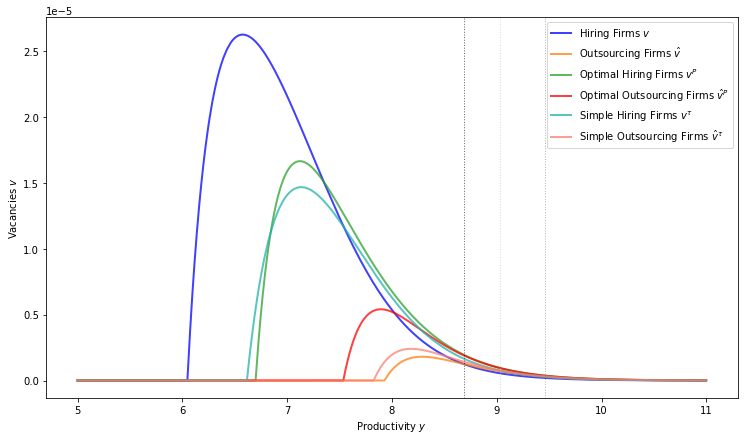

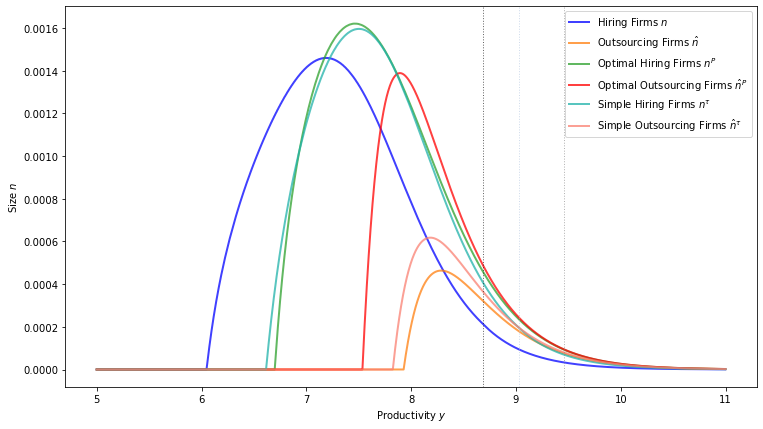

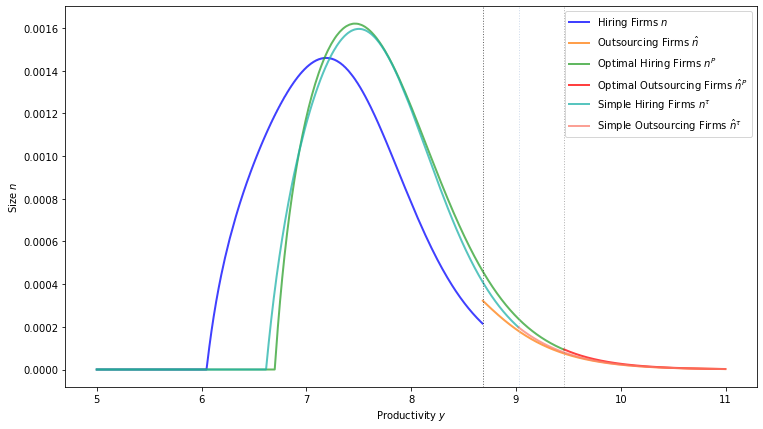

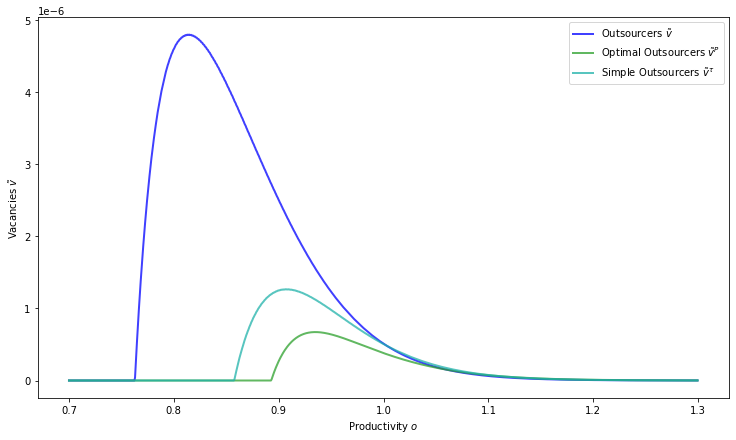

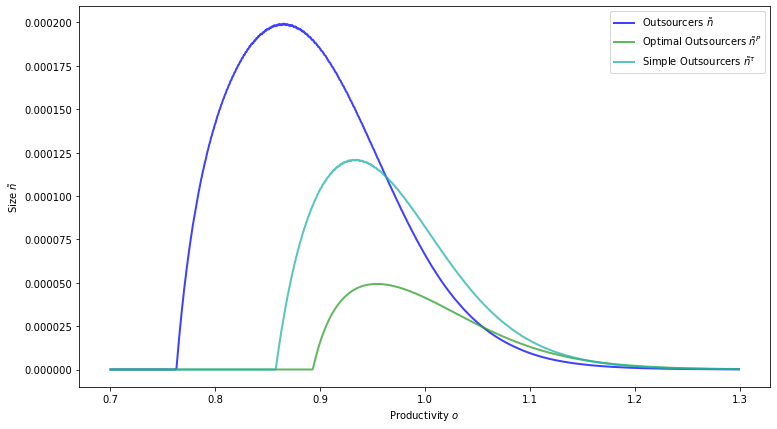

...

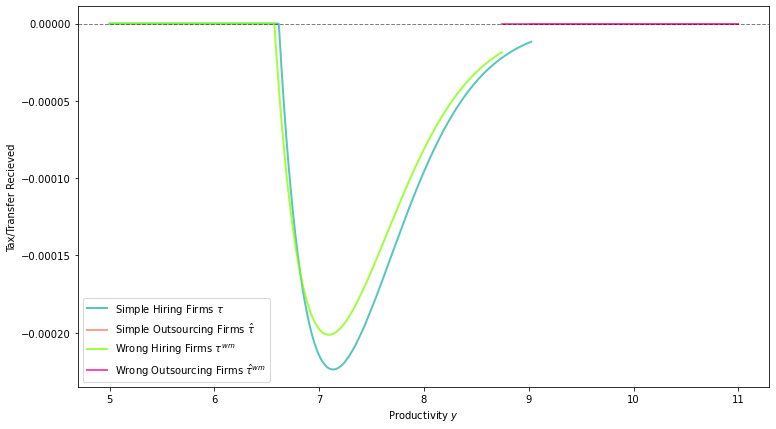

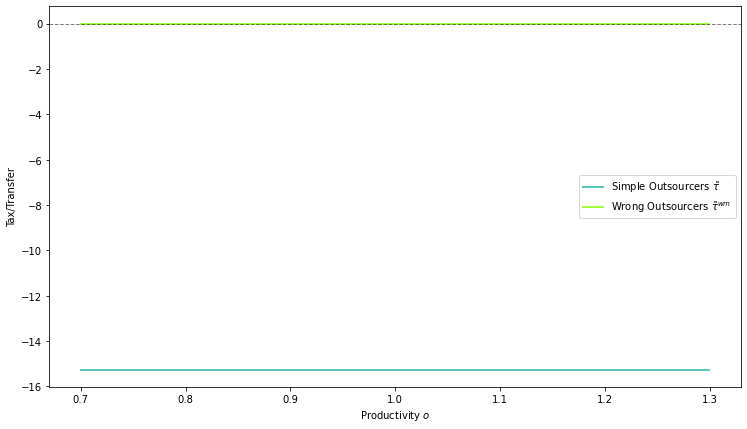

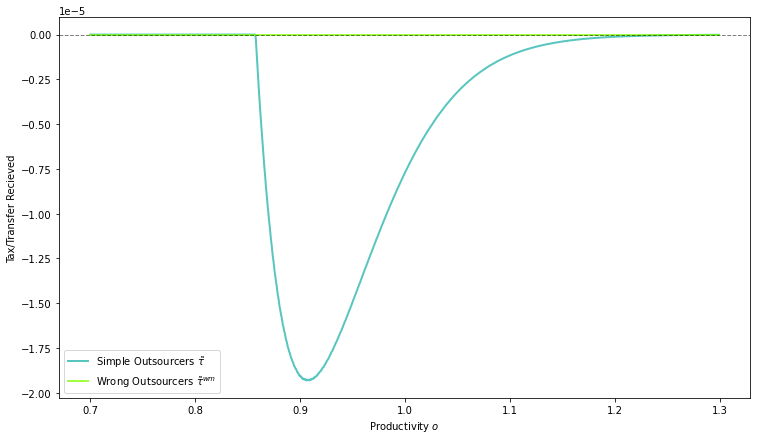

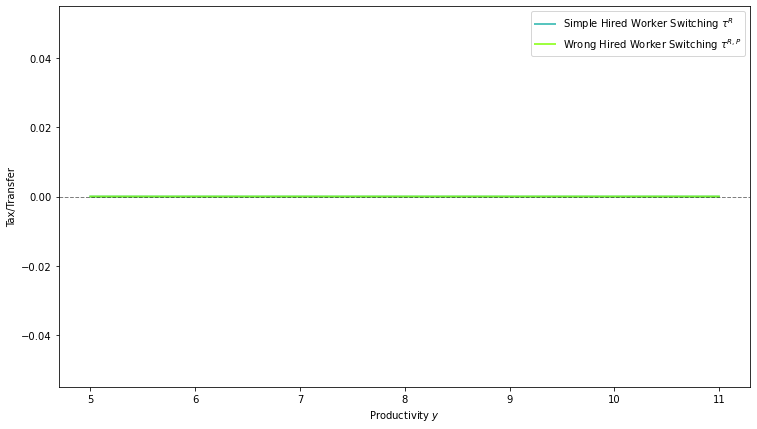

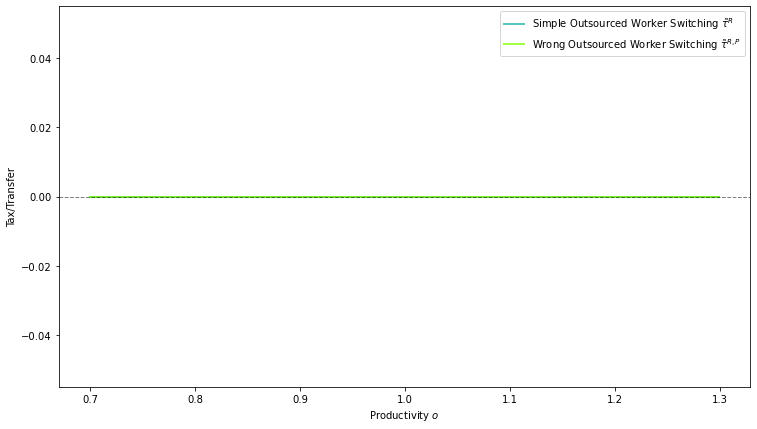

In [38]:
# Intead of optimal taxes, guess a simple tax structure with 
# No taxes on workers or outsourcing firms (default)
# Identical per vacancy taxes on all firms/outsourcers 
# See how much of the efficiency gains are captured.

# guess the eqbm without taxes
guess_simp = solution[:-1]
p_1, p_2 = solution[-1], solution[-1] - 0.01
# Set taxes at lowest to 0 and highest to largest tax (a min)
# of hiring firms and outsourcers
tau_low = 0
tau_high = min(min(tau_grid), min(tau_o_grid))
max_iter_simp = 20

# This code uses bisection to find optimal simple tax
ooj_simp, solution_simp, tau_simp = optimal_simple_tax(
    ooj, guess_simp, p_1, p_2, tau_low, tau_high,
    max_iter_simp, max_iter, tol_i, max_iter_i, slow_i, verbose, print_skip)

# Do the same for LS
guess_ls_simp = solution_ls
tau_low_ls = 0
tau_high_ls = min(tau_grid_ls)
ooj_ls_simp, solution_ls_simp, tau_ls_simp = optimal_simple_tax_ls(
    ooj, guess_ls_simp, tau_low_ls, tau_high_ls, max_iter_simp, max_iter_i, tol_i, slow_i,
    verbose, ps)

# Now solve the basline model under simple LS taxes (Wrong Model)
guess_wm = solution_simp[:-1]
p_1_wm, p_2_wm = solution_simp[-1], solution_simp[-1] + 0.1

(v_grid_wm, v_hat_grid_wm, v_o_grid_wm, n_grid_wm,
 n_hat_grid_wm, n_o_grid_wm, y_hat_wm, R_grid_wm, R_o_grid_wm, p_wm) = find_p(
    ooj_ls_simp, guess_wm, p_1_wm, p_2_wm, tol, max_iter, tol_i, max_iter_i, slow_i_tau, verbose, print_skip
)

solution_wm = (v_grid_wm, v_hat_grid_wm, v_o_grid_wm, n_grid_wm,
 n_hat_grid_wm, n_o_grid_wm, y_hat_wm, R_grid_wm, R_o_grid_wm, p_wm)

tau_compare(ooj, ooj_tau, ooj_simp, ooj_tau_ls, ooj_ls_simp,
            solution, solution_tau, solution_simp, solution_wm,
            solution_ls, solution_tau_ls, solution_ls_simp,
            save=save, file=file, folder=folder)


        Comparing baseline model to simple taxes and optimal taxes
        Unemployment: calibration 0.1251; simple 0.1853; opt 0.1742; 
        gap closed 122.4368
        UE Rate: calibration 0.0274; simple 0.0178; opt 0.0184; 
        gap closed 107.6652
        EE Rate: calibration 0.0021; simple 0.0015; opt 0.0015; 
        gap closed 107.2469
        Per New Jobs from Unemployment: calibration 65.5919; simple 73.2205;
        opt 71.9671; gap closed 119.6594
        Firms Worker Finding Probability: calibration 0.6643; simple 1.0000;
        opt 0.9870; gap closed 96.1122
        Indifferent firm y_hat: calibration 8.6840; simple 9.0260; opt 9.4610; 
        gap closed 44.0154
        Price of Outsourcing: calibration 7.9280; simple 7.8250; opt 7.5349; 
        gap closed 26.1926
        Percent of Vacancies Outsourced: calibration 0.0863; simple 0.0423; opt 0.0201; 
        gap closed 66.4170
        Percent of Jobs Outsourced: calibration 0.0723; simple 0.0385; opt 0.0156; 
  

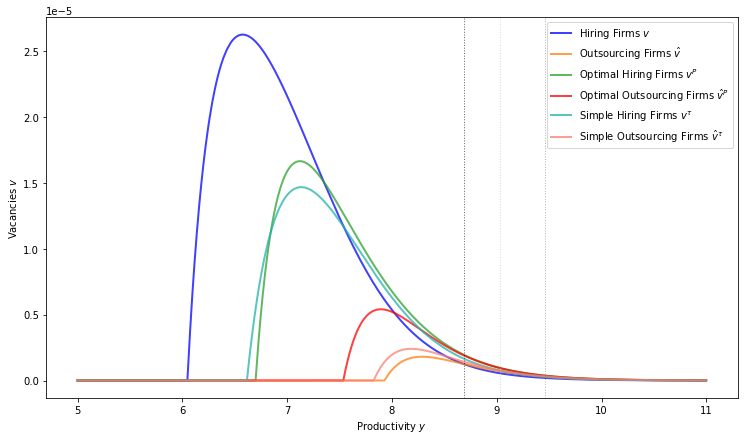

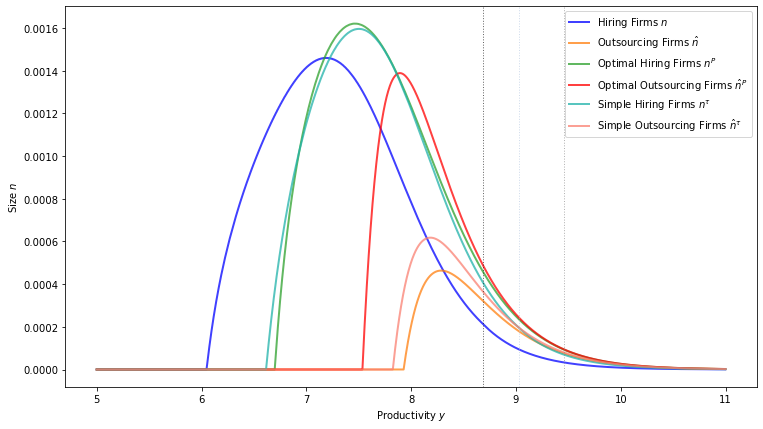

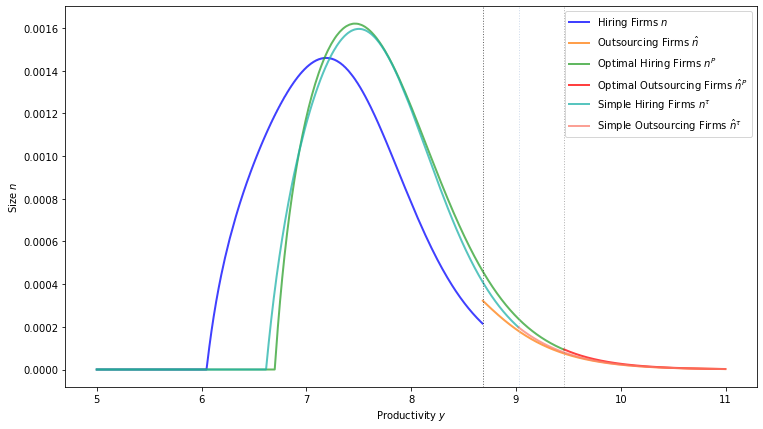

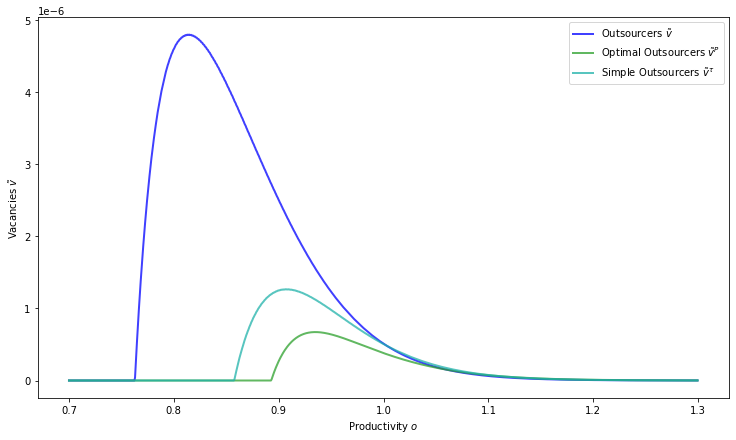

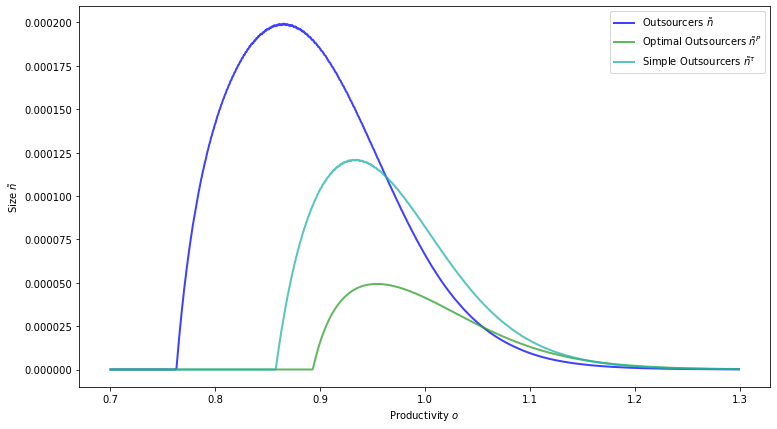

...

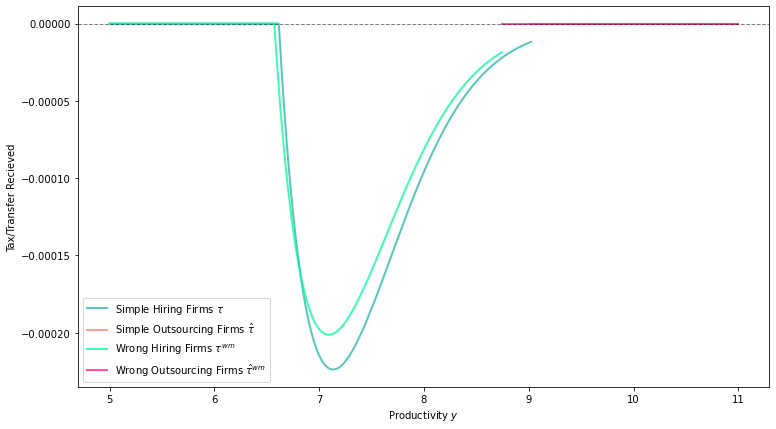

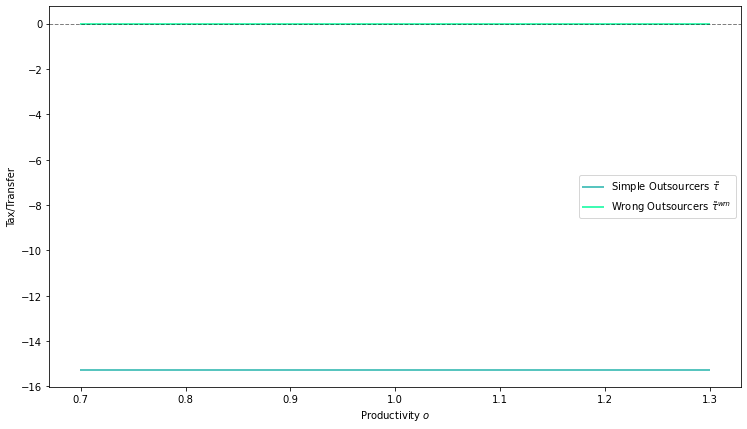

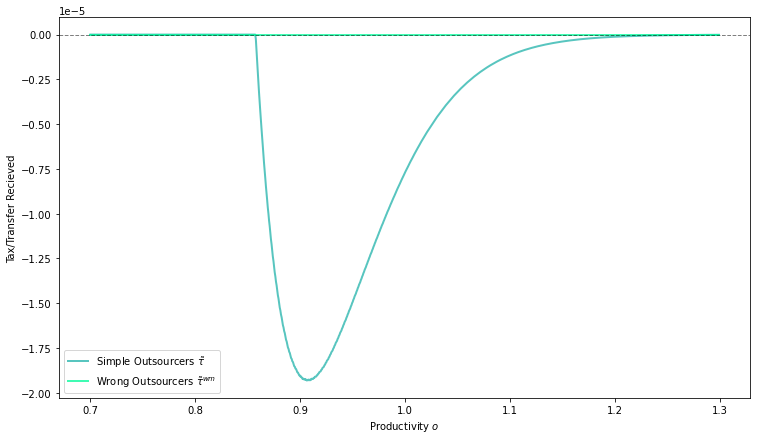

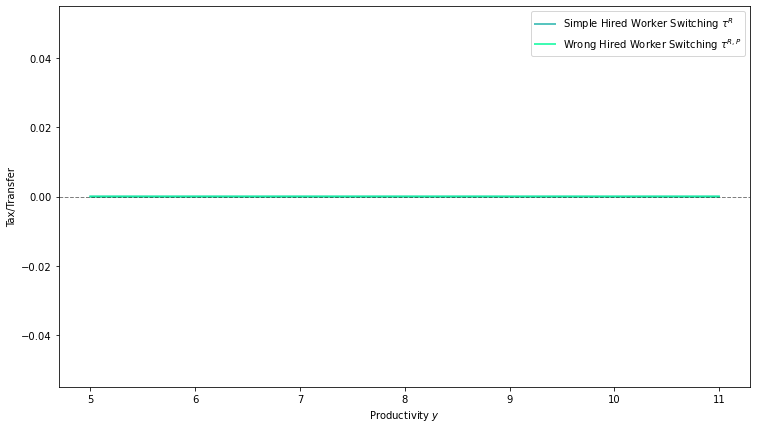

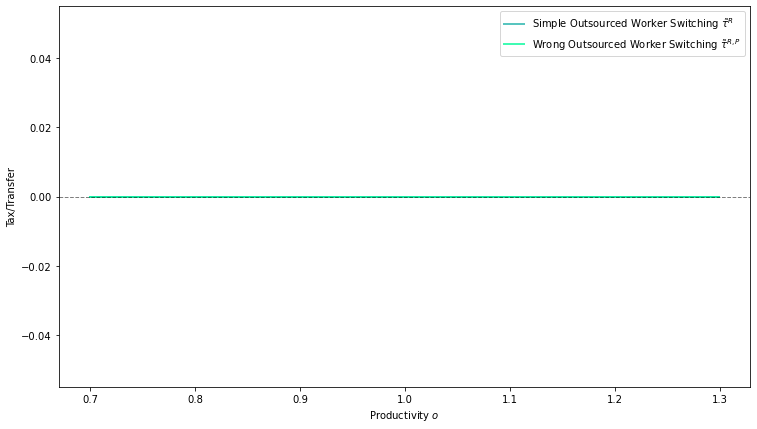

In [44]:
tau_compare(ooj, ooj_tau, ooj_simp, ooj_tau_ls, ooj_ls_simp,
            solution, solution_tau, solution_simp, solution_wm,
            solution_ls, solution_tau_ls, solution_ls_simp,
            save=save, file=file, folder=folder)

In [7]:
cdf_comp(ooj, solution, ecdf_path="../../Cleaned Data/data_ecdf_l.csv", 
         save=save, folder=folder, file=file)

graph_results(ooj, solution, save=save, folder=folder, file=file)

comp_no_outsourcers(ooj, solution, solution_p, solution_ls, solution_ls_p, save=save, file=file, folder=folder)

comp_full_bargain(ooj, ooj_fb, solution, solution_fb, save=save, file=file, folder=folder)

comp_more_productive(ooj, ooj_mp, solution, solution_mp, mult, save=save, file=file, folder=folder)

graph_tau(ooj_tau, ooj_tau_ls, solution_tau, solution_p, solution_tau_ls, solution_ls_p,
         save=save, file=file, folder=folder)

tau_compare(ooj, ooj_tau, ooj_simp, solution, solution_tau, solution_simp,
                save=save, file=file, folder=folder)


        Comparing to the Scenario without Outsourcers
        Unemployment: with 0.1251; without 0.1284; dif 2.6476
        Workers Job Finding Probability: with 0.0274; without 0.0264; 
        dif -3.7808
        Firms Worker Finding Probability: with 0.6643; without 0.6904; 
        dif 3.9294
        Unemployed Value of Search: with 1.6729; 
        without 1.6941; dif 1.2683
        Mean Wages: with 6.73; without 6.77; dif 0.5440
        Mean Flow: with 6.48; without 6.51;
        dif 0.3903
        Worker Welfare: with 6.4818; without 6.4859; 
        dif 0.0632
        Firm Welfare: with 0.2921; without 0.2801; 
        dif -4.1123
        Total Welfare: with 6.7884; without 7; 
        dif -0.0155
        Efficient Welfare: with 6.9907; without 6.9857;
        dif -0.0717
        Fraction of Efficient Welfare: with 97.1061; without 97.1606;
        dif 0.0562
        Firm Production: with 6.4136; without 6.3793; 
        dif -0.5352
        Total Production: with 7.0055; witho

Excess Demand for price 7.927972591193375 is 0.0000; QS is 0.0565; QD is 0.0565
Excess Demand for price 7.917972591193375 is 0.0035; QS is 0.0552; QD is 0.0587
Excess Demand at iter 0 is 0.0000; price is 7.9280; QS is 0.0565; QD is 0.0565 y_hat is 8.6840
Converged in 1 iterations, Excess Demand is 0.0000; price is 7.9280; QS is 0.0565; QD is 0.0565
Excess Demand for price 7.927972591193375 is -0.0038; QS is 0.0539; QD is 0.0501
Excess Demand for price 7.917972591193375 is -0.0003; QS is 0.0526; QD is 0.0523
Excess Demand at iter 0 is -0.0002; price is 7.9170; QS is 0.0525; QD is 0.0524 y_hat is 8.7290
Excess Demand at iter 1 is -0.0001; price is 7.9165; QS is 0.0525; QD is 0.0524 y_hat is 8.7290
Converged in 2 iterations, Excess Demand is -0.0001; price is 7.9165; QS is 0.0525; QD is 0.0524
Excess Demand for price 7.927972591193375 is -0.0066; QS is 0.0519; QD is 0.0453
Excess Demand for price 7.917972591193375 is -0.0036; QS is 0.0507; QD is 0.0470
Excess Demand at iter 0 is 0.0001; p

Excess Demand at iter 20 is 0.0001; price is 7.8248; QS is 0.0314; QD is 0.0315 y_hat is 9.0080
Excess Demand at iter 21 is -0.0002; price is 7.8265; QS is 0.0315; QD is 0.0313 y_hat is 9.0110
Excess Demand at iter 22 is -0.0001; price is 7.8255; QS is 0.0315; QD is 0.0313 y_hat is 9.0110
Excess Demand at iter 23 is 0.0002; price is 7.8239; QS is 0.0313; QD is 0.0316 y_hat is 9.0080
Excess Demand at iter 24 is 0.0001; price is 7.8248; QS is 0.0314; QD is 0.0315 y_hat is 9.0080
Failed to Converge. Excess Demand is 0.0001; price is 7.8248; QS is 0.0314; QD is 0.0315
Excess Demand for price 7.927972591193375 is -0.0224; QS is 0.0407; QD is 0.0183
Excess Demand for price 7.917972591193375 is -0.0205; QS is 0.0396; QD is 0.0192
Excess Demand at iter 0 is 0.0024; price is 7.8106; QS is 0.0297; QD is 0.0320 y_hat is 9.0050
Excess Demand at iter 1 is -0.0002; price is 7.8218; QS is 0.0306; QD is 0.0304 y_hat is 9.0260
Excess Demand at iter 2 is 0.0001; price is 7.8209; QS is 0.0305; QD is 0.03

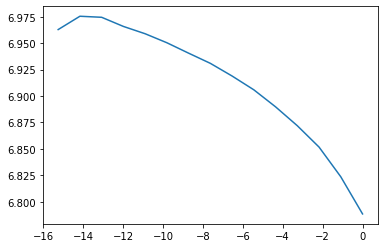

In [27]:
# Test theory that welfare is quadratically shaped in taxes (It is)
tau_pos_grid = np.linspace(0, min(min(tau_grid), min(tau_o_grid)), 15)

welfare_grid = np.empty(15)

for i, tau in enumerate(tau_pos_grid):
        
        # tau is the tax on hiring firms and outsourcing firms
        ooj_temp = copy.copy(ooj)
        ooj_temp.tau_grid = tau * np.ones(y_grid_size)
        ooj_temp.tau_o_grid = tau * np.ones(o_grid_size)

        (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
         n_o_grid, y_hat, R_grid, R_o_grid, p) = find_p(
            ooj_temp, guess, p_1, p_2, tol, max_iter, tol_i, max_iter_i, slow_i,
            verbose=verbose, print_skip=print_skip
        )
        
        solution_temp = (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
         n_o_grid, y_hat, R_grid, R_o_grid, p)
        
        guess = solution_temp[:-1]
        p_1, p_2 = p, p + 0.25
        
        # Find total flow welfare
        _, _, _, make_grids, find_y_i, C, c, c_inv, C_o, c_o, c_o_inv, q, ell = operator_factory(ooj_temp)
        y_i = find_y_i(y_hat)
        u = 1 - np.sum(n_grid[:y_i] * rm) - np.sum(n_o_grid)
        
        firm_production = (
            np.sum(n_grid[:y_i] * y_grid[:y_i] * rm) + np.sum(n_hat_grid[y_i:] * y_grid[y_i:] * rm)
        )
        total_production = firm_production + u * b * hp

        vacancy_costs = (
            np.sum(C(v_grid)[:y_i] * rm) + np.sum(C(v_hat_grid)[y_i:] * rm) + np.sum(C_o(v_o_grid) * rm_o)
        )

        tot_welfare_flow = total_production - vacancy_costs
        
        welfare_grid[i] = tot_welfare_flow
        
fig, ax = plt.subplots()
ax.plot(tau_pos_grid, welfare_grid)
plt.show()

Excess Demand for price 7.535586626596191 is 0.1448; QS is 0.0165; QD is 0.1613
Excess Demand for price 8.035586626596192 is -0.0411; QS is 0.0606; QD is 0.0195
Excess Demand at iter 0 is -0.0146; price is 7.9250; QS is 0.0459; QD is 0.0312 y_hat is 8.9810
Excess Demand at iter 1 is -0.0053; price is 7.8892; QS is 0.0418; QD is 0.0365 y_hat is 8.9180
Excess Demand at iter 2 is 0.0003; price is 7.8690; QS is 0.0397; QD is 0.0400 y_hat is 8.8820
Excess Demand at iter 3 is -0.0001; price is 7.8699; QS is 0.0398; QD is 0.0397 y_hat is 8.8850
Excess Demand at iter 4 is -0.0001; price is 7.8696; QS is 0.0398; QD is 0.0397 y_hat is 8.8850
Converged in 5 iterations, Excess Demand is -0.0001; price is 7.8696; QS is 0.0398; QD is 0.0397

        Comparing baseline model to simple taxes and optimal taxes
        Unemployment: calibration 0.1251; simple 0.1570; opt 0.1742; 
        gap closed 64.9887
        UE Rate: calibration 0.0274; simple 0.0210; opt 0.0184; 
        gap closed 71.7030
      

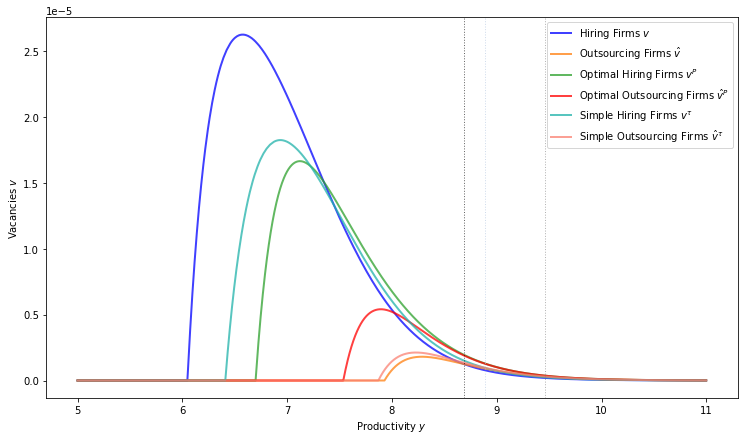

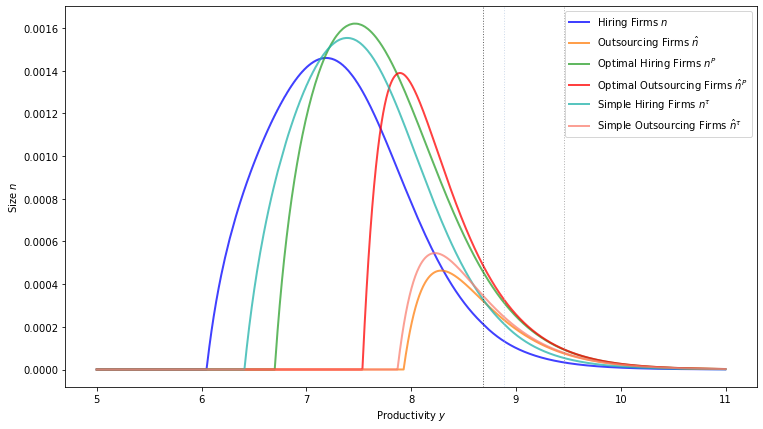

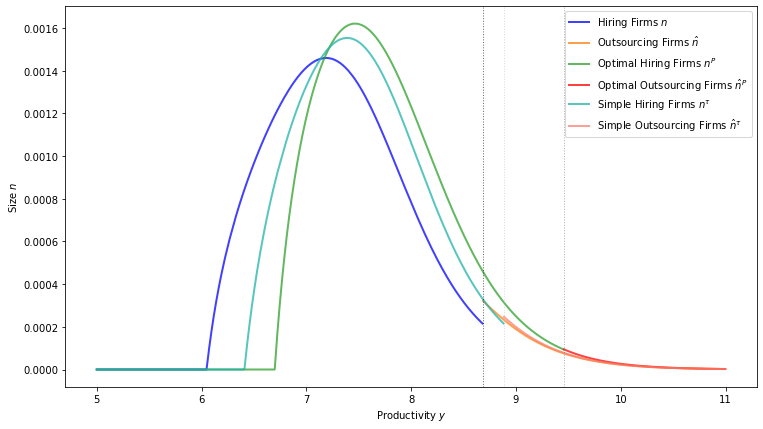

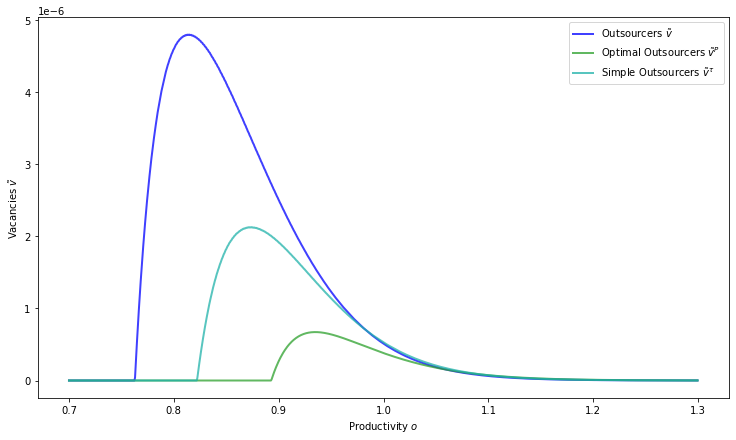

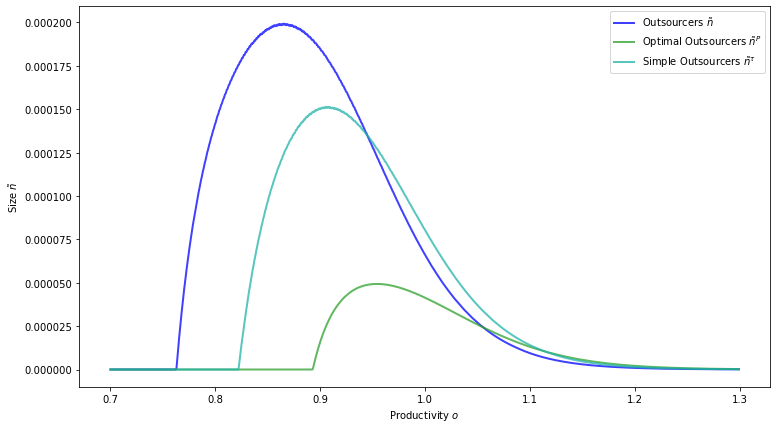

...

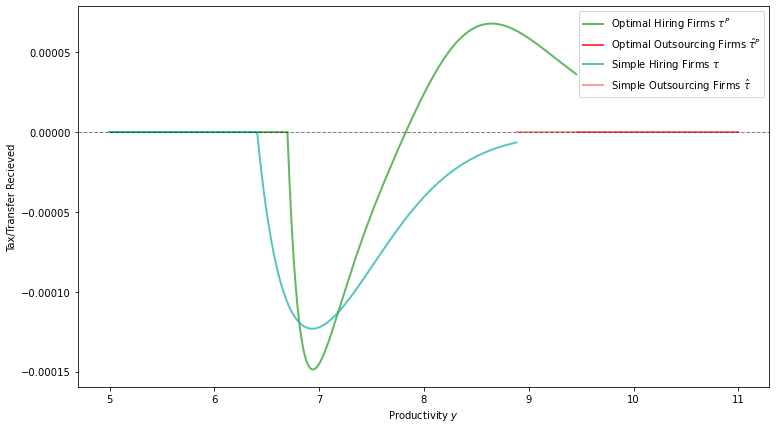

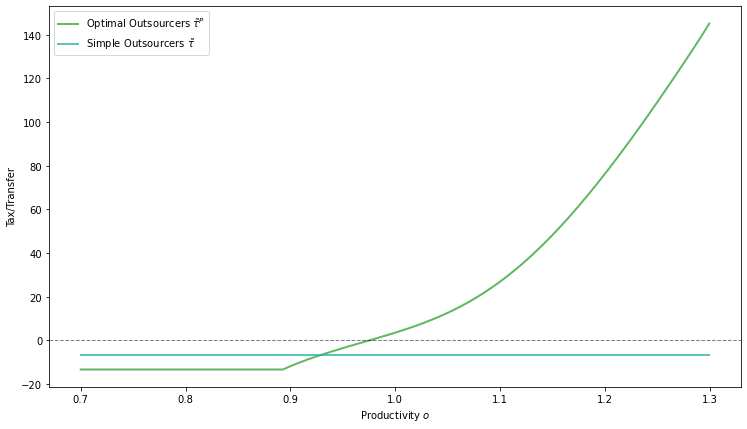

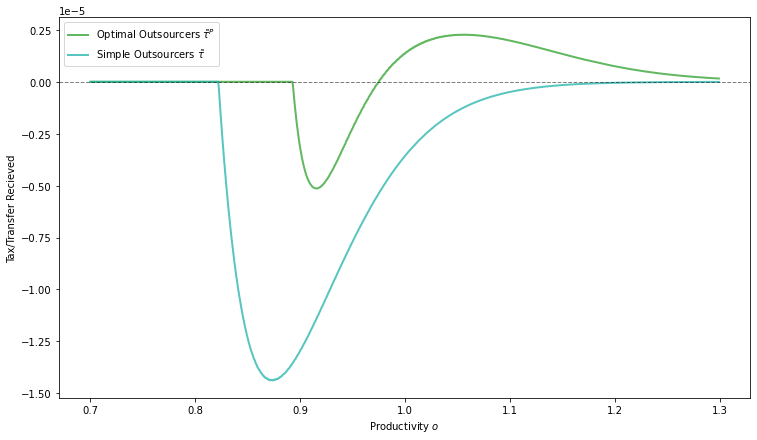

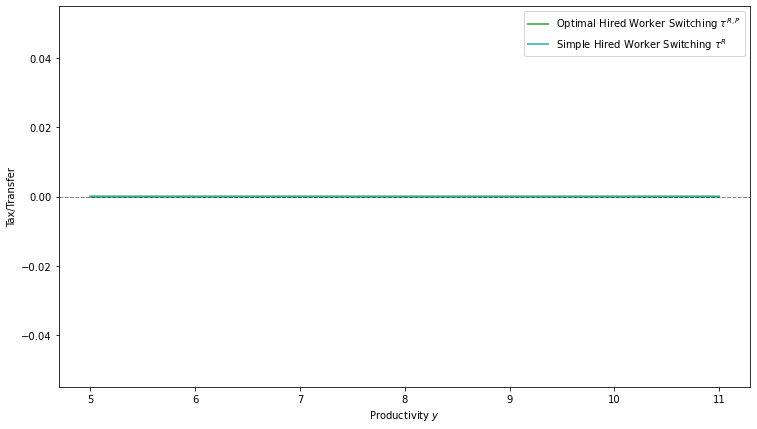

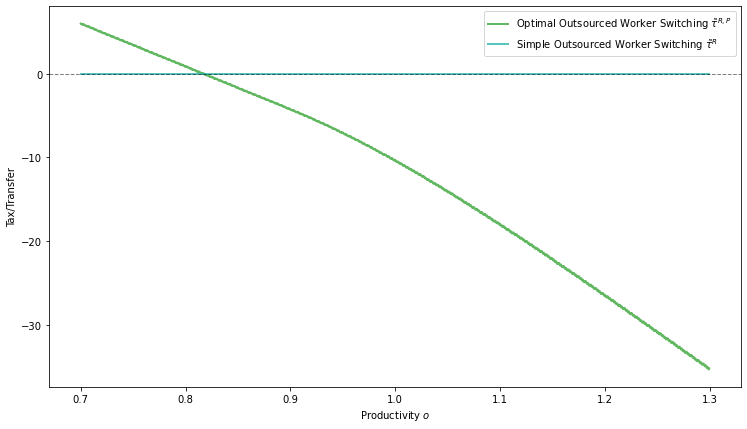

In [55]:
# Intead of optimal taxes, guess a simple tax structure with 
# No taxes on workers or outsourcing firms (default)
# Taxes on all firms/outsourcers equal to those of largest decentralized firm
# See how much of the efficiency gains are captured.
hig_n = np.argmax(n_grid)
tau = tau_grid[hig_n]
# min_tau = min(min(tau_grid), min(tau_o_grid))

ooj_simp = copy.copy(ooj)
ooj_simp.tau_grid = np.ones(y_grid_size) * tau
ooj_simp.tau_o_grid = np.ones(o_grid_size) * tau

# Find eqbm given these taxes
guess_simp = (v_grid_p, v_hat_grid_p, v_o_grid_p, n_grid_p, n_hat_grid_p, n_o_grid_p,
              y_hat_p, R_grid_p, R_o_grid_p)

p_1_simp = rho
p_2_simp = rho + 0.5
slow_i_simp = 1e-1

(v_grid_simp, v_hat_grid_simp, v_o_grid_simp, n_grid_simp,
 n_hat_grid_simp, n_o_grid_simp, y_hat_simp, R_grid_simp, R_o_grid_simp, p_simp) = find_p(
    ooj_simp, guess_simp, p_1_simp, p_2_simp, tol, max_iter, tol_i, max_iter_i, slow_i_simp, verbose, print_skip
)
                  
solution_simp = (v_grid_simp, v_hat_grid_simp, v_o_grid_simp, n_grid_simp, n_hat_grid_simp,
                 n_o_grid_simp, y_hat_simp, R_grid_simp, R_o_grid_simp, p_simp)

tau_compare(ooj, ooj_tau, ooj_simp, solution, solution_tau, solution_simp,
                save=save, file=file, folder=folder)

In [8]:
# Get functions needed from ooj
_, _, QD_QS_ED, make_grids, find_y_i, C, c, c_inv, C_o, c_o, c_o_inv, q, ell = operator_factory(ooj)

# Also ls_operator factory
_, ls_make_grids = ls_operator_factory(ooj)

# Also Planner's operator factory
solve_given_rho, iterate_p, make_grids_p, ls_iterate_p, ls_make_grids_p = operator_factory_p(ooj)

B, r, delta, xi, b = ooj.B, ooj.r, ooj.delta, ooj.xi, ooj.b
delta_o, delta_hat = ooj.delta_o, ooj.delta_hat
rm, rm_o = ooj.rm, ooj.rm_o
y_grid, o_grid = ooj.y_grid, ooj.o_grid
y_grid_size, o_grid_size = ooj.y_grid_size, ooj.o_grid_size
hp = ooj.hp
xi_bar, xi_bar_o = xi * (1 - delta), xi * (1 - delta_o)

y_i = find_y_i(y_hat)
y_i_p = find_y_i(y_hat_p)

# Make all grids
(theta, G_grid, G_o_grid, D_grid, D_o_grid, Gamma_U,
 Gamma_grid, Gamma_o_grid, w_grid, w_o_grid, nu) = make_grids(
    v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p
)

(theta_p, G_grid_p, G_o_grid_p, D_grid_p, D_o_grid_p,
 vac_ext, vac_ext_o, pos_ext, pos_ext_o) = make_grids_p(
    v_grid_p, v_o_grid_p, n_grid_p, n_o_grid_p, y_hat_p, R_grid_p, R_o_grid_p, lam_grid, iota_grid, rho
)
    
# Taxes start concave then turn convex. Can we explain this with observables?
d_tau_grid = tau_grid[1:] - tau_grid[:-1]
d2_tau_grid = d_tau_grid[1:] - d_tau_grid[:-1]
d2_tau_grid_p = d2_tau_grid[v_grid_p[1:-1] > 0]
inflection_point = np.searchsorted(d2_tau_grid_p, 0)

# 2 candidates, where v_grid < v_grid_p and where n_grid < n_grid_p
v_diff = v_grid_p - v_grid
v_diff_p = v_diff[v_grid_p > 0]
v_switch = np.searchsorted(v_diff_p, 0)

n_diff = n_grid_p - n_grid
n_diff_p = n_diff[v_grid_p > 0]
n_switch = np.searchsorted(n_diff_p, 0)

v_max = np.argmax(v_grid_p)
n_max = np.argmax(n_grid_p)

y_zero = np.searchsorted(v_grid_p, 1e-7)

G_diff = G_grid - G_grid_p
G_diff_p = G_diff[v_grid_p > 0]
G_max = np.argmax(G_diff_p)

D_G_diff = np.abs(G_grid_p - D_grid_p)
D_G_eq = np.argmin(D_G_diff)

print(1 + y_zero + inflection_point, y_zero + v_switch, y_zero + n_switch,
      v_max, n_max, y_zero + G_max, D_G_eq)
print(y_grid[1 + y_zero + inflection_point], y_grid[y_zero + v_switch], y_grid[y_zero + n_switch],
      y_grid[v_max], y_grid[n_max], y_grid[y_zero + G_max], y_grid[D_G_eq])

d_tau_o_grid = tau_o_grid[1:] - tau_o_grid[:-1]
d2_tau_o_grid = d_tau_o_grid[1:] - d_tau_o_grid[:-1]
d2_tau_o_grid_p = d2_tau_o_grid[v_o_grid_p[1:-1] > 0]
inflection_point_o = np.searchsorted(d2_tau_o_grid_p, 0)

# Try for outsourcers
v_o_diff = v_o_grid_p - v_o_grid
v_o_diff_p = v_o_diff[v_o_grid_p > 0]
v_o_switch = np.searchsorted(v_o_diff_p, 0)

n_o_diff = n_o_grid_p - n_o_grid
n_o_diff_p = n_o_diff[v_o_grid_p > 0]
n_o_switch = np.searchsorted(n_o_diff_p, 0)

v_o_max = np.argmax(v_o_grid_p)
n_o_max = np.argmax(n_o_grid_p)

o_zero = np.searchsorted(v_o_grid_p, 1e-7)

G_o_diff = G_o_grid - G_o_grid_p
G_o_diff_p = G_o_diff[v_o_grid_p > 0]
G_o_max = np.argmax(G_o_diff_p)

print(1 + o_zero + inflection_point_o, o_zero + v_o_switch, o_zero + n_o_switch, v_o_max,
      n_o_max, o_zero + G_o_max)
print(o_grid[1 + o_zero + inflection_point_o], o_grid[o_zero + v_o_switch], o_grid[o_zero + n_o_switch],
      o_grid[v_o_max], o_grid[n_o_max], o_grid[o_zero + G_o_max])

# Look at ls
d_tau_grid_ls = tau_grid_ls[1:] - tau_grid_ls[:-1]
d2_tau_grid_ls = d_tau_grid_ls[1:] - d_tau_grid_ls[:-1]
d2_tau_grid_ls_p = d2_tau_grid_ls[v_grid_ls_p[1:-1] > 0]
inflection_point_ls = np.searchsorted(d2_tau_grid_ls_p, 0)

y_zero_ls = np.searchsorted(v_grid_ls_p, 1e-7)

v_max_ls = np.argmax(v_grid_ls_p)
n_max_ls = np.argmax(n_grid_ls_p)

print(1 + y_zero_ls + inflection_point_ls, v_max_ls, n_max_ls)
print(y_grid[1 + y_zero_ls + inflection_point_ls], y_grid[v_max_ls], y_grid[n_max_ls])

NameError: name 'ooj' is not defined

In [38]:
x_0, match, bounds

(array([-19.  ,   3.5 , -28.  ,  40.  ,   0.15,   0.15,   1.  ]),
 array([6.67023982e+00, 3.78372189e-01, 6.65262165e+00, 3.91817469e-01,
        1.82525547e-03, 8.07496244e-02, 7.97199221e-02]),
 [(-25, -15), (2, 4), (-15, -5), (15, 25), (0.1, 0.2), (0.1, 0.2), (0.6, 1.0)],
 4.734860180671579)

In [3]:
# Use pandas to get data for model parameters
parameters = pd.read_csv("../../Cleaned Data/data_moments.csv")

values = parameters[["value"]].to_numpy().T[0]

[r, B, u, zeta, pi, UE, EU_h, EU_o, EE_h, EE_o, w_mean, w_o_mean, w_sd, w_o_sd,
w_25, w_o_25, w_75, w_o_75] = values

# Job loss probabilities
delta_ = EU_h
delta_o = EU_o
# (This one arbitrary)
delta_hat = EU_h

# Job finding probability
# phi = UE
# phi = 0.2

# Unemployment benefit
w_mean_overall = (1 - zeta) * w_mean + zeta * w_o_mean
b = 0.4 * w_mean_overall # Shimer (2005) and Hall (2005)
# b = 0.71 * w_mean_overall # Hall and Milgrom (2008) and Pissarides (2009)

# Arbitrary
# alpha = 0.72 # Shimer (2005)
alpha = 0.5 # Petrongolo and Pissarides (2001)
eta = alpha # Hosios Rule

gamma = 2
gamma_o = 2

# Arbitrary (but try to cover w_grid)
y_grid_size = 750
o_grid_size = 400

# Is b home production (hp = 1) or unemployment benefit (hp = 0)? 
# In second case, b comes from lump sum taxes on workers
# hp = 1
hp = 0

# # Give resonable bounds for parameters
# bounds = [(-20, -5), (2.5, 4), (-12, -0), (8, 20), (0.10, 0.30), (0.025, 0.20), (0.8, 1.2)]

# # Initial guesses (alpha = 0.5, b = 0.4, hp = 0)
# y_min = 5.0
# y_max = 11.0
# o_min = 0.7
# o_max = 1.2

# c_0_guess = -8.936223847265623 
# c_1_guess = 2.3870006843417784
# c_o_0_guess = -16.365162005116968
# c_o_1_guess = 27.776901090265348
# xi_guess = 0.10104191580097707
# phi_guess = 0.18367141055397657
# eta_o_ratio_guess = 1.0630377540829712

# Initial guesses (alpha = 0.5, b = 0.4, hp = 0, match 25/75 of wages)
y_min = 5.0
y_max = 11.0
o_min = 0.7
o_max = 1.2

c_0_guess = -8.51646449 
c_1_guess = 2.35161416
c_o_0_guess = -16.38296275
c_o_1_guess = 27.76052126
xi_guess = 0.10668943
phi_guess = 0.17600275
eta_o_ratio_guess = 1.43230616
  
# Initial guesses (alpha = 0.5, b = 0.7, hp = 1)
# y_min = 5.0
# y_max = 11.0
# o_min = 0.7
# o_max = 1.3

# c_0_guess = -21
# c_1_guess = 4.0
# c_o_0_guess = -32
# c_o_1_guess = 42
# xi_guess = 0.1
# phi_guess = 0.16
# eta_o_ratio_guess = 1

# c_0_guess = -12
# c_1_guess = 3
# c_o_0_guess = -17
# c_o_1_guess = 30
# xi_guess = 0.1
# phi_guess = 0.15
# eta_o_ratio_guess = 1


y_min = 5.0
y_max = 11.0
o_min = 0.7
o_max = 1.2

c_0_guess = -10 
c_1_guess = 2.35161416
c_o_0_guess = -20
c_o_1_guess = 27.76052126
xi_guess = 0.1
phi_guess = 0.2
eta_o_ratio_guess = 1.0

# Give resonable bounds for parameters
bounds = [(-25, -15), (2, 4), (-15, -5), (15, 25), (0.10, 0.2), (0.1, 0.20), (0.6, 1.0)]

x_0 = np.empty(7)
x_0[0], x_0[1] = c_0_guess, c_1_guess
x_0[2], x_0[3] = c_o_0_guess, c_o_1_guess
x_0[4] = xi_guess
x_0[5] = phi_guess
x_0[6] = eta_o_ratio_guess

# # Try to match
# match = np.empty(7)
# match[0] = w_mean
# match[1] = w_sd
# match[2] = w_o_mean
# match[3] = w_o_sd
# match[4] = zeta * EE_h + (1 - zeta) * EE_o
# match[5] = zeta
# match[6] = u


# Try to match 25th/75th percentiles of wages instead of mean + var
match = np.empty(7)
match[0] = w_25
match[1] = w_75
match[2] = w_o_25
match[3] = w_o_75
match[4] = zeta * EE_h + (1 - zeta) * EE_o
match[5] = zeta
match[6] = u

# Is there a good reason not to match u?
# # Instead of matching ue, try to match u if hp == 0
# if hp == 1:
#     match[6] = UE
# else:
#     match[6] = u

ValueError: too many values to unpack (expected 18)

In [4]:
# Set up minimization problem
# p_1_0 = y_max - 3
# p_2_0 = y_max - 3.5
p_1_0 = y_max - 2
p_2_0 = y_max - 3
# p_1_0 = y_max - 1
# p_2_0 = y_max - 2
tol = 1e-3
max_iter = 15
tol_i = 1e-6
max_iter_i = 1e5
slow_i = 1.5e-1
print_skip = 5
verbose = False

# Record initial guesses
v_grid_0 = np.ones(y_grid_size) * 0.9
n_grid_0 = np.ones(y_grid_size) * 0.9
v_hat_grid_0 = np.ones(y_grid_size) * 0.9
n_hat_grid_0 = np.ones(y_grid_size) * 0.9
v_o_grid_0 = np.ones(o_grid_size) * 0.9
n_o_grid_0 = np.ones(o_grid_size) * 0.9
y_hat_0 = y_max
R_grid_0 = np.minimum(np.arange(y_grid_size), o_grid_size - 1, dtype=np.int64)
R_o_grid_0 = np.minimum(np.arange(o_grid_size), y_grid_size - 1, dtype=np.int64)

guess_0 = (v_grid_0, v_hat_grid_0, v_o_grid_0, n_grid_0, n_hat_grid_0, n_o_grid_0, y_hat_0, R_grid_0, R_o_grid_0)
guess = copy.copy(guess_0)
p_1 = np.copy(p_1_0)
p_2 = np.copy(p_2_0)

# Put weights here so I can show them later
weights = np.ones_like(x_0) / len(x_0)
# If I want to up weight wage mean moments and downweight wage variance
# weights[0] = 15 / (8 * len(x_0))
# weights[1] = 15 / (8 * len(x_0))
# weights[2] = 1 / (8 * len(x_0))
# weights[3] = 1 / (8 * len(x_0))

def match_operator_factory(match, weights):  
     
    # If match mean + var 
    w_mean_data = match[0] 
    w_sd_data = match[1]
    w_o_mean_data = match[2]
    w_o_sd_data = match[3]
    EE_data = match[4] 
    zeta_data = match[5] 
    u_data = match[6]
    
#     # If matching 25 + 75 percentile
#     w_25_data = match[0] 
#     w_75_data = match[1]
#     w_o_25_data = match[2]
#     w_o_75_data = match[3]
#     EE_data = match[4] 
#     zeta_data = match[5] 
#     u_data = match[6]
    
    # Any reason not to match u?
#     if hp == 1:
#         UE_data = match[6]
#     else:
#         u_data = match[6]
    
    y_grid = np.linspace(y_min, y_max, y_grid_size, endpoint=False)
    o_grid = np.linspace(o_min, o_max, o_grid_size, endpoint=False)
    
    def func(x):

        global guess, p_1, p_2

        c_grid = np.exp(x[0] + x[1] * y_grid)
        c_o_grid = np.exp(x[2] + x[3] * o_grid)
        xi = x[4]
        phi = x[5]
        eta_o = eta * x[6]
        xi_bar, xi_bar_o = xi * (1 - delta_), xi * (1 - delta_o)

        ooj = OutsourcingOnJob(
            B, b, delta_, delta_o, delta_hat, xi, eta, eta_o, phi, alpha,
            y_min, y_max, y_grid_size, o_min, o_max, o_grid_size,
            gamma, gamma_o, c_grid, c_o_grid, hp
        )

        (v_grid, v_hat_grid, v_o_grid, n_grid,
         n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p) = find_p(
            ooj, guess, p_1, p_2, tol, max_iter, tol_i, max_iter_i, slow_i, False, print_skip
        )

        guess = (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid)
        p_1, p_2 = p, p + 0.01

        _, _, QD_QS_ED, make_grids, find_y_i, _, _, _, _, _, _, _, ell  = operator_factory(ooj)
        
        QD, QS, ED = QD_QS_ED(n_hat_grid, n_o_grid, y_hat)
        
        # If the model does not converge, do not use, reset guess
        if np.isnan(ED):
            ED = 1
        if np.abs(ED) > tol:
            print(f"c_0 {x[0]:.2f}; c_1 {x[1]:.2f}; c_o_0 {x[2]:.2f};",
                  f" c_o_1 {x[3]:.2f}; xi {x[4]:.2f}; phi {x[5]:.2f}; eta_o {x[6]:.2f}")
            p_2, p_1 = np.copy(p_2_0), np.copy(p_1_0)
            
            guess = copy.copy(guess_0)
            return np.abs(ED) * 1e10

        (theta, G_grid, G_o_grid, D_grid, D_o_grid, Gamma_U,
         Gamma_grid, Gamma_o_grid, w_grid, w_o_grid, nu) = make_grids(
            v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p
        )

        rm, rm_o = ooj.rm, ooj.rm_o

        y_i = find_y_i(y_hat)
        
        n = np.sum(n_grid[:y_i] * rm)
        n_o = np.sum(n_o_grid * rm_o)
        
        # Find mean + sd of wages: compare to data
        w_mean = np.sum(w_grid[:y_i] * n_grid[:y_i] * rm) / n
        w_o_mean = np.sum(w_o_grid * n_o_grid * rm_o) / n_o
        w_sd = np.sqrt(np.sum((w_grid[:y_i] - w_mean)**2 * n_grid[:y_i] * rm) / n)
        w_o_sd = np.sqrt(np.sum((w_o_grid - w_o_mean)**2 * n_o_grid * rm_o) / n_o)
        
        err_w = percent_diff(w_mean, w_mean_data)
        err_w_o = percent_diff(w_o_mean, w_o_mean_data)
        err_sd = percent_diff(w_sd, w_sd_data)
        err_sd_o = percent_diff(w_o_sd, w_o_sd_data)
        
#         # Find 25 + 75 of wages: compare to data
#         n_cdf = np.cumsum(n_grid[:y_i] * rm) / n
#         n_o_cdf = np.cumsum(n_o_grid * rm_o) / n_o
        
#         ind_25 = np.argmin(np.abs(n_cdf - 0.25))
#         ind_75 = np.argmin(np.abs(n_cdf - 0.75))
#         ind_25_o = np.argmin(np.abs(n_o_cdf - 0.25))
#         ind_75_o = np.argmin(np.abs(n_o_cdf - 0.75))
        
#         w_25 = w_grid[ind_25]
#         w_o_25 = w_o_grid[ind_25_o]
#         w_75 = w_grid[ind_75]
#         w_o_75 = w_o_grid[ind_75_o]
        
#         err_25 = percent_diff(w_25, w_25_data)
#         err_25_o = percent_diff(w_o_25, w_o_25_data)
#         err_75 = percent_diff(w_75, w_75_data)
#         err_75_o = percent_diff(w_o_75, w_o_75_data)
        
        # Find share of vacancies outsourcing, compare to data
        zeta = n_o / (n_o + n)
        ee_h = np.sum(n_grid[:y_i] * xi_bar * ell(theta) * D_grid[:y_i] * rm) / n
        ee_o = np.sum(n_o_grid * xi_bar_o * ell(theta) * D_o_grid * rm_o) / n_o
        ee = ((1 - zeta) * ee_h + zeta * ee_o)
#         UE = ell(theta)
        u = 1 - n - n_o
        
        err_ee = percent_diff(ee, EE_data)
        err_zeta = percent_diff(zeta, zeta_data)
        err_u = percent_diff(u, u_data)
        
        errs = np.array([err_w, err_w_o, err_sd, err_sd_o, err_ee, err_zeta, err_u])
#         errs = np.array([err_25, err_25_o, err_75, err_75_o, err_ee, err_zeta, err_u])
        
        err = np.sum(weights * errs**2)
        
        # Print if mean + sd
        print(f"""
        Error: w_mean {err_w:.5f}; w_o_mean {err_w_o:.5f}; w_sd {err_sd:.5f}; w_o_sd {err_sd_o:.5f};
        EE {err_ee:.5f}; zeta {err_zeta:.5f}; u {err_u:.3f};
        Overall {err:.5f}  
        Parameters: c_0 {x[0]:.2f}; c_1 {x[1]:.2f}; c_o_0 {x[2]:.2f}; 
        c_o_1 {x[3]:.2f}; xi {x[4]:.2f}; phi {x[5]:.2f}; eta_o {x[6]:.2f}
        """)
        
#         # Print if 25 + 75
#         print(f"""
#         Error: w_25 {err_25:.5f}; w_o_25 {err_25_o:.5f}; w_75 {err_75:.5f}; w_o_75 {err_75_o:.5f};
#         EE {err_ee:.5f}; zeta {err_zeta:.5f}; u {err_u:.3f};
#         Overall {err:.5f}  
#         Parameters: c_0 {x[0]:.2f}; c_1 {x[1]:.2f}; c_o_0 {x[2]:.2f}; 
#         c_o_1 {x[3]:.2f}; xi {x[4]:.2f}; phi {x[5]:.2f}; eta_o {x[6]:.2f}
#         """)
        
        # Is there a good reason to match ue rather than u?
#         if hp == 1:
#             err_UE = percent_diff(UE, UE_data)
#             errs = np.array([err_w, err_w_o, err_sd, err_sd_o, err_ee, err_zeta, err_UE])
#         else:
#             err_u = percent_diff(u, u_data)
#             errs = np.array([err_w, err_w_o, err_sd, err_sd_o, err_ee, err_zeta, err_u])
        
        
#         # For hp ==1, If eqbm u > .14, (cost of entry too high, not enough firms) then add 1e5 to err
#         # Also have high error if w_o_mean > w_mean
#         if hp == 1:
#             err = err + (u > .14) * 1e3

#         if hp == 1:   
#             print(f"""
#             Error: w_mean {err_w:.5f}; w_o_mean {err_w_o:.5f}; w_sd {err_sd:.5f}; w_o_sd {err_sd_o:.5f};
#             EE {err_ee:.5f}; zeta {err_zeta:.5f}; UE {err_UE:.5f}; u {u:.3f};
#             Overall {err:.5f}  
#             Parameters: c_0 {x[0]:.2f}; c_1 {x[1]:.2f}; c_o_0 {x[2]:.2f}; 
#             c_o_1 {x[3]:.2f}; xi {x[4]:.2f}; phi {x[5]:.2f}; eta_o {x[6]:.2f}
#             """)            
#         else:
#             print(f"""
#             Error: w_mean {err_w:.5f}; w_o_mean {err_w_o:.5f}; w_sd {err_sd:.5f}; w_o_sd {err_sd_o:.5f};
#             EE {err_ee:.5f}; zeta {err_zeta:.5f}; u {err_u:.3f};
#             Overall {err:.5f}  
#             Parameters: c_0 {x[0]:.2f}; c_1 {x[1]:.2f}; c_o_0 {x[2]:.2f}; 
#             c_o_1 {x[3]:.2f}; xi {x[4]:.2f}; phi {x[5]:.2f}; eta_o {x[6]:.2f}
#             """)
        
        return err
    
    return func

NameError: name 'y_max' is not defined

In [5]:
# Minimize
func = match_operator_factory(match, weights)

method = "Nelder-Mead"
# method = "Powell"
# basin = True
basin = False

if basin:
    niter_b = 10
    T = 1000
    interval = 5
    seed = 1
    if method == "Powell":
        max_iter_est = 3
        minimizer_kwargs = {"method": "Powell", "bounds": bounds, "options": {"maxiter": max_iter_est}}
    if method == "Nelder-Mead":
        max_iter_est = 50
        minimizer_kwargs = {"method": "Nelder-Mead", "options": {"maxiter": max_iter_est}}
        
    # Create custom step size
    class MyTakeStep(object):
        def __init__(self, stepsize=1):
            self.stepsize = stepsize
        def __call__(self, x):
            s = self.stepsize
            z = 0.5 * np.random.uniform(-s, s)
            z_0 = 5 * np.random.uniform(-s, s)
            x[0] -= y_min * z
            x[1] += z
            x[2] -= o_min * z_0
            x[3] += z_0
            x[4] += 0.05 * np.random.uniform(-s, s)
            x[5] += 0.05 * np.random.uniform(-s, s)
            x[6] += 0.1 * np.random.uniform(-s, s)
            return x
        
    mytakestep = MyTakeStep()
        
    result = basinhopping(func, x0=x_0, niter=niter_b, T=T, take_step=mytakestep, minimizer_kwargs=minimizer_kwargs,
                          interval=interval, disp=True, seed=seed)  
    
elif method == "Powell":
    max_iter_est = 5
    result = minimize(func, x0=x_0, method=method, bounds=bounds, options={"maxiter":max_iter_est, "disp":True})
elif method == "Nelder-Mead":
#     max_iter_est = 400
    max_iter_est = 200
    result = minimize(func, x0=x_0, method=method, options={"maxiter":max_iter_est, "disp":True})

result

Converged in 1 iterations, Excess Demand is -0.0000; price is 7.9844; QS is 0.0624; QD is 0.0624

        Error: w_25 -1.89455; w_o_25 -9.03846; w_75 7.49901; w_o_75 -0.56642;
        EE -2.09072; zeta -1.95400; u -0.513;
        Overall 21.47023  
        Parameters: c_0 -8.52; c_1 2.35; c_o_0 -16.38; 
        c_o_1 27.76; xi 0.11; phi 0.18; eta_o 1.43
        
Converged in 3 iterations, Excess Demand is -0.0006; price is 8.1827; QS is 0.0621; QD is 0.0615

        Error: w_25 0.03009; w_o_25 -6.98486; w_75 9.68915; w_o_75 1.73008;
        EE 1.13258; zeta -2.43877; u -4.334;
        Overall 24.52451  
        Parameters: c_0 -8.94; c_1 2.35; c_o_0 -16.38; 
        c_o_1 27.76; xi 0.11; phi 0.18; eta_o 1.43
        
Converged in 2 iterations, Excess Demand is 0.0009; price is 7.5704; QS is 0.0581; QD is 0.0590

        Error: w_25 -7.36114; w_o_25 -13.60706; w_75 1.39808; w_o_75 -5.72825;
        EE -6.12198; zeta -8.68419; u 5.349;
        Overall 59.37265  
        Parameters: c_0 -


        Error: w_25 -1.18981; w_o_25 -8.27941; w_75 8.30302; w_o_75 0.26250;
        EE -0.35037; zeta -5.20472; u -2.106;
        Overall 24.37456  
        Parameters: c_0 -8.57; c_1 2.35; c_o_0 -16.40; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 6 iterations, Excess Demand is -0.0002; price is 8.1715; QS is 0.0578; QD is 0.0576

        Error: w_25 -0.07553; w_o_25 -7.16012; w_75 9.65743; w_o_75 1.64908;
        EE 1.08313; zeta -9.03432; u -2.839;
        Overall 34.01608  
        Parameters: c_0 -8.66; c_1 2.32; c_o_0 -16.21; 
        c_o_1 27.70; xi 0.11; phi 0.18; eta_o 1.46
        
Converged in 1 iterations, Excess Demand is 0.0001; price is 7.9795; QS is 0.0655; QD is 0.0656

        Error: w_25 -1.67165; w_o_25 -8.66338; w_75 7.74590; w_o_75 -0.12219;
        EE -0.59661; zeta 2.60038; u -1.488;
        Overall 21.02773  
        Parameters: c_0 -8.59; c_1 2.36; c_o_0 -16.49; 
        c_o_1 27.73; xi 0.11; phi 0.18; eta_o 1.45
        
Converg

Converged in 2 iterations, Excess Demand is 0.0000; price is 8.0750; QS is 0.0649; QD is 0.0649

        Error: w_25 -1.09344; w_o_25 -8.14939; w_75 8.40612; w_o_75 0.48654;
        EE 0.14941; zeta 2.08720; u -2.255;
        Overall 21.13865  
        Parameters: c_0 -8.73; c_1 2.35; c_o_0 -16.42; 
        c_o_1 27.73; xi 0.11; phi 0.17; eta_o 1.44
        
Converged in 2 iterations, Excess Demand is 0.0006; price is 8.0099; QS is 0.0627; QD is 0.0634

        Error: w_25 -1.42441; w_o_25 -8.45193; w_75 8.14106; w_o_75 0.11561;
        EE -0.26903; zeta -1.69889; u -1.713;
        Overall 20.80655  
        Parameters: c_0 -8.59; c_1 2.35; c_o_0 -16.42; 
        c_o_1 27.73; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 2 iterations, Excess Demand is -0.0000; price is 8.0944; QS is 0.0608; QD is 0.0608

        Error: w_25 -0.85217; w_o_25 -7.93316; w_75 8.79570; w_o_75 0.72189;
        EE 0.41961; zeta -4.38240; u -2.346;
        Overall 23.77574  
        Parameters: c_0 -8.67

Converged in 1 iterations, Excess Demand is -0.0010; price is 8.0296; QS is 0.0633; QD is 0.0624

        Error: w_25 -0.21341; w_o_25 -7.84564; w_75 9.43883; w_o_75 0.76191;
        EE 0.75913; zeta -0.57821; u -3.055;
        Overall 23.07316  
        Parameters: c_0 -8.64; c_1 2.35; c_o_0 -16.40; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is -0.0000; price is 8.0195; QS is 0.0641; QD is 0.0641

        Error: w_25 -1.51401; w_o_25 -8.47681; w_75 7.97249; w_o_75 0.11382;
        EE -0.74056; zeta 0.62326; u -1.628;
        Overall 20.18707  
        Parameters: c_0 -8.64; c_1 2.35; c_o_0 -16.42; 
        c_o_1 27.72; xi 0.11; phi 0.18; eta_o 1.45
        
Converged in 1 iterations, Excess Demand is 0.0003; price is 8.0465; QS is 0.0637; QD is 0.0639

        Error: w_25 -1.28682; w_o_25 -8.31641; w_75 8.27863; w_o_75 0.29039;
        EE -0.26224; zeta -0.02680; u -2.019;
        Overall 20.51188  
        Parameters: c_0 -8.

Converged in 1 iterations, Excess Demand is -0.0009; price is 8.0317; QS is 0.0640; QD is 0.0632

        Error: w_25 -2.76952; w_o_25 -9.14235; w_75 6.71427; w_o_75 -0.58943;
        EE -0.90561; zeta 0.70107; u -0.367;
        Overall 19.73253  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.40; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is -0.0004; price is 8.0339; QS is 0.0628; QD is 0.0623

        Error: w_25 -1.41536; w_o_25 -8.44981; w_75 8.07208; w_o_75 0.15113;
        EE -0.55602; zeta -1.41423; u -1.644;
        Overall 20.51363  
        Parameters: c_0 -8.64; c_1 2.35; c_o_0 -16.40; 
        c_o_1 27.75; xi 0.11; phi 0.18; eta_o 1.45
        
Converged in 1 iterations, Excess Demand is 0.0007; price is 8.0244; QS is 0.0630; QD is 0.0637

        Error: w_25 -1.43492; w_o_25 -8.43897; w_75 8.05297; w_o_75 0.14629;
        EE -0.68641; zeta -1.04657; u -1.635;
        Overall 20.34074  
        Parameters: c_0 -

Converged in 1 iterations, Excess Demand is -0.0001; price is 8.0220; QS is 0.0633; QD is 0.0632

        Error: w_25 -1.52437; w_o_25 -8.47065; w_75 8.03539; w_o_75 -0.00471;
        EE -0.59868; zeta -0.66489; u -1.555;
        Overall 20.26608  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.40; 
        c_o_1 27.73; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is -0.0001; price is 8.0245; QS is 0.0634; QD is 0.0633

        Error: w_25 -1.52091; w_o_25 -8.44987; w_75 8.03905; w_o_75 0.01645;
        EE -0.57549; zeta -0.49502; u -1.584;
        Overall 20.20350  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.73; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is -0.0001; price is 8.0239; QS is 0.0634; QD is 0.0633

        Error: w_25 -1.52128; w_o_25 -8.45462; w_75 8.03887; w_o_75 0.01150;
        EE -0.56615; zeta -0.37577; u -1.577;
        Overall 20.19545  
        Parameters: c_0

Converged in 1 iterations, Excess Demand is 0.0002; price is 8.0247; QS is 0.0633; QD is 0.0634

        Error: w_25 -1.51825; w_o_25 -8.44522; w_75 8.04188; w_o_75 0.02865;
        EE -0.56874; zeta -0.67446; u -1.585;
        Overall 20.22727  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.73; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is 0.0009; price is 8.0253; QS is 0.0633; QD is 0.0642

        Error: w_25 -2.79348; w_o_25 -9.21322; w_75 6.61876; w_o_75 -0.66923;
        EE -0.89449; zeta -0.50223; u -0.373;
        Overall 19.73349  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.73; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is -0.0007; price is 8.0255; QS is 0.0633; QD is 0.0626

        Error: w_25 -1.51413; w_o_25 -8.43560; w_75 8.04488; w_o_75 0.03855;
        EE -0.60468; zeta -0.66004; u -1.554;
        Overall 20.19873  
        Parameters: c_0 -

Converged in 1 iterations, Excess Demand is 0.0009; price is 8.0253; QS is 0.0633; QD is 0.0642

        Error: w_25 -2.79330; w_o_25 -9.21332; w_75 6.61886; w_o_75 -0.66986;
        EE -0.90051; zeta -0.43027; u -0.374;
        Overall 19.72600  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.73; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is 0.0009; price is 8.0256; QS is 0.0633; QD is 0.0642

        Error: w_25 -2.79187; w_o_25 -9.21059; w_75 6.62037; w_o_75 -0.66688;
        EE -0.89813; zeta -0.43321; u -0.377;
        Overall 19.72001  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.73; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is 0.0009; price is 8.0257; QS is 0.0633; QD is 0.0642

        Error: w_25 -2.79244; w_o_25 -9.20977; w_75 6.61975; w_o_75 -0.66625;
        EE -0.89841; zeta -0.41936; u -0.379;
        Overall 19.71563  
        Parameters: c_0 

Converged in 1 iterations, Excess Demand is 0.0009; price is 8.0256; QS is 0.0633; QD is 0.0642

        Error: w_25 -2.79181; w_o_25 -9.21083; w_75 6.62042; w_o_75 -0.66739;
        EE -0.89871; zeta -0.44625; u -0.377;
        Overall 19.72262  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.73; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 2 iterations, Excess Demand is 0.0001; price is 8.0256; QS is 0.0633; QD is 0.0634

        Error: w_25 -1.51774; w_o_25 -8.54776; w_75 8.04237; w_o_75 0.03553;
        EE -0.56444; zeta -0.54100; u -1.594;
        Overall 20.45734  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.73; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is 0.0009; price is 8.0257; QS is 0.0633; QD is 0.0642

        Error: w_25 -2.79247; w_o_25 -9.20982; w_75 6.61972; w_o_75 -0.66620;
        EE -0.89891; zeta -0.41856; u -0.378;
        Overall 19.71565  
        Parameters: c_0 -

Converged in 1 iterations, Excess Demand is 0.0009; price is 8.0256; QS is 0.0633; QD is 0.0642

        Error: w_25 -2.79155; w_o_25 -9.21027; w_75 6.62069; w_o_75 -0.66683;
        EE -0.89857; zeta -0.45253; u -0.379;
        Overall 19.72226  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is -0.0007; price is 8.0258; QS is 0.0633; QD is 0.0626

        Error: w_25 -1.51417; w_o_25 -8.54416; w_75 8.04497; w_o_75 0.03875;
        EE -0.59386; zeta -0.61094; u -1.563;
        Overall 20.45517  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is 0.0006; price is 8.0231; QS is 0.0629; QD is 0.0635

        Error: w_25 -1.51887; w_o_25 -8.45920; w_75 8.04119; w_o_75 0.00651;
        EE -0.57383; zeta -1.16918; u -1.590;
        Overall 20.39286  
        Parameters: c_0 -

Converged in 1 iterations, Excess Demand is 0.0003; price is 8.0244; QS is 0.0632; QD is 0.0634

        Error: w_25 -1.51825; w_o_25 -8.44794; w_75 8.04182; w_o_75 0.01904;
        EE -0.56921; zeta -0.80138; u -1.592;
        Overall 20.26371  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is 0.0010; price is 8.0252; QS is 0.0633; QD is 0.0642

        Error: w_25 -2.79353; w_o_25 -9.21460; w_75 6.61860; w_o_75 -0.67161;
        EE -0.90070; zeta -0.52454; u -0.379;
        Overall 19.74276  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is 0.0009; price is 8.0256; QS is 0.0633; QD is 0.0642

        Error: w_25 -2.79152; w_o_25 -9.21037; w_75 6.62073; w_o_75 -0.66695;
        EE -0.89858; zeta -0.45116; u -0.379;
        Overall 19.72240  
        Parameters: c_0 -

Converged in 1 iterations, Excess Demand is -0.0007; price is 8.0258; QS is 0.0633; QD is 0.0626

        Error: w_25 -1.51418; w_o_25 -8.54425; w_75 8.04496; w_o_75 0.03863;
        EE -0.59398; zeta -0.61895; u -1.563;
        Overall 20.45683  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is 0.0006; price is 8.0232; QS is 0.0629; QD is 0.0635

        Error: w_25 -1.51887; w_o_25 -8.45911; w_75 8.04118; w_o_75 0.00659;
        EE -0.57396; zeta -1.16639; u -1.590;
        Overall 20.39176  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is 0.0003; price is 8.0244; QS is 0.0632; QD is 0.0634

        Error: w_25 -1.51826; w_o_25 -8.44800; w_75 8.04182; w_o_75 0.01897;
        EE -0.56921; zeta -0.80156; u -1.592;
        Overall 20.26386  
        Parameters: c_0 -8

Converged in 1 iterations, Excess Demand is 0.0010; price is 8.0252; QS is 0.0633; QD is 0.0642

        Error: w_25 -2.79353; w_o_25 -9.21462; w_75 6.61861; w_o_75 -0.67163;
        EE -0.90067; zeta -0.52671; u -0.379;
        Overall 19.74314  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is 0.0009; price is 8.0256; QS is 0.0633; QD is 0.0642

        Error: w_25 -2.79153; w_o_25 -9.21041; w_75 6.62072; w_o_75 -0.66699;
        EE -0.89855; zeta -0.45078; u -0.379;
        Overall 19.72244  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is -0.0007; price is 8.0258; QS is 0.0633; QD is 0.0626

        Error: w_25 -1.51418; w_o_25 -8.54427; w_75 8.04495; w_o_75 0.03861;
        EE -0.59399; zeta -0.61913; u -1.563;
        Overall 20.45691  
        Parameters: c_0 

Converged in 1 iterations, Excess Demand is 0.0006; price is 8.0232; QS is 0.0629; QD is 0.0635

        Error: w_25 -1.51888; w_o_25 -8.45912; w_75 8.04118; w_o_75 0.00659;
        EE -0.57395; zeta -1.16621; u -1.590;
        Overall 20.39170  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is 0.0003; price is 8.0244; QS is 0.0632; QD is 0.0634

        Error: w_25 -1.51826; w_o_25 -8.44801; w_75 8.04182; w_o_75 0.01897;
        EE -0.56924; zeta -0.80840; u -1.592;
        Overall 20.26545  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is 0.0010; price is 8.0252; QS is 0.0633; QD is 0.0642

        Error: w_25 -2.79368; w_o_25 -9.21460; w_75 6.61845; w_o_75 -0.67160;
        EE -0.90028; zeta -0.52191; u -0.379;
        Overall 19.74214  
        Parameters: c_0 -8

Converged in 1 iterations, Excess Demand is 0.0009; price is 8.0256; QS is 0.0633; QD is 0.0642

        Error: w_25 -2.79156; w_o_25 -9.21037; w_75 6.62068; w_o_75 -0.66694;
        EE -0.89852; zeta -0.44982; u -0.379;
        Overall 19.72215  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is -0.0007; price is 8.0258; QS is 0.0633; QD is 0.0626

        Error: w_25 -1.51418; w_o_25 -8.54424; w_75 8.04496; w_o_75 0.03865;
        EE -0.59397; zeta -0.61839; u -1.563;
        Overall 20.45669  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is 0.0006; price is 8.0232; QS is 0.0629; QD is 0.0635

        Error: w_25 -1.51888; w_o_25 -8.45911; w_75 8.04118; w_o_75 0.00659;
        EE -0.57395; zeta -1.16615; u -1.590;
        Overall 20.39168  
        Parameters: c_0 -

Converged in 1 iterations, Excess Demand is 0.0003; price is 8.0244; QS is 0.0632; QD is 0.0634

        Error: w_25 -1.51826; w_o_25 -8.44801; w_75 8.04182; w_o_75 0.01897;
        EE -0.56924; zeta -0.80837; u -1.592;
        Overall 20.26545  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is 0.0010; price is 8.0252; QS is 0.0633; QD is 0.0642

        Error: w_25 -2.79368; w_o_25 -9.21460; w_75 6.61845; w_o_75 -0.67160;
        EE -0.90028; zeta -0.52191; u -0.379;
        Overall 19.74214  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is 0.0009; price is 8.0256; QS is 0.0633; QD is 0.0642

        Error: w_25 -2.79156; w_o_25 -9.21037; w_75 6.62068; w_o_75 -0.66694;
        EE -0.89852; zeta -0.44983; u -0.379;
        Overall 19.72215  
        Parameters: c_0 -

Converged in 1 iterations, Excess Demand is -0.0007; price is 8.0258; QS is 0.0633; QD is 0.0626

        Error: w_25 -1.51418; w_o_25 -8.54424; w_75 8.04496; w_o_75 0.03865;
        EE -0.59397; zeta -0.61838; u -1.563;
        Overall 20.45669  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is 0.0006; price is 8.0232; QS is 0.0629; QD is 0.0635

        Error: w_25 -1.51888; w_o_25 -8.45912; w_75 8.04118; w_o_75 0.00659;
        EE -0.57395; zeta -1.16617; u -1.590;
        Overall 20.39168  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is 0.0003; price is 8.0244; QS is 0.0632; QD is 0.0634

        Error: w_25 -1.51826; w_o_25 -8.44801; w_75 8.04182; w_o_75 0.01897;
        EE -0.56924; zeta -0.80837; u -1.592;
        Overall 20.26545  
        Parameters: c_0 -8

Converged in 1 iterations, Excess Demand is 0.0010; price is 8.0252; QS is 0.0633; QD is 0.0642

        Error: w_25 -2.79368; w_o_25 -9.21460; w_75 6.61845; w_o_75 -0.67160;
        EE -0.90028; zeta -0.52191; u -0.379;
        Overall 19.74214  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is 0.0009; price is 8.0256; QS is 0.0633; QD is 0.0642

        Error: w_25 -2.79156; w_o_25 -9.21037; w_75 6.62068; w_o_75 -0.66694;
        EE -0.89852; zeta -0.44982; u -0.379;
        Overall 19.72215  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is -0.0007; price is 8.0258; QS is 0.0633; QD is 0.0626

        Error: w_25 -1.51418; w_o_25 -8.54424; w_75 8.04496; w_o_75 0.03865;
        EE -0.59397; zeta -0.61838; u -1.563;
        Overall 20.45669  
        Parameters: c_0 

Converged in 1 iterations, Excess Demand is 0.0006; price is 8.0232; QS is 0.0629; QD is 0.0635

        Error: w_25 -1.51888; w_o_25 -8.45912; w_75 8.04118; w_o_75 0.00659;
        EE -0.57395; zeta -1.16616; u -1.590;
        Overall 20.39168  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is 0.0003; price is 8.0244; QS is 0.0632; QD is 0.0634

        Error: w_25 -1.51826; w_o_25 -8.44801; w_75 8.04182; w_o_75 0.01897;
        EE -0.56924; zeta -0.80837; u -1.592;
        Overall 20.26545  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is 0.0010; price is 8.0252; QS is 0.0633; QD is 0.0642

        Error: w_25 -2.79368; w_o_25 -9.21460; w_75 6.61845; w_o_75 -0.67160;
        EE -0.90028; zeta -0.52191; u -0.379;
        Overall 19.74214  
        Parameters: c_0 -8

Converged in 1 iterations, Excess Demand is 0.0009; price is 8.0256; QS is 0.0633; QD is 0.0642

        Error: w_25 -2.79156; w_o_25 -9.21037; w_75 6.62068; w_o_75 -0.66694;
        EE -0.89852; zeta -0.44982; u -0.379;
        Overall 19.72215  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is -0.0007; price is 8.0258; QS is 0.0633; QD is 0.0626

        Error: w_25 -1.51418; w_o_25 -8.54424; w_75 8.04496; w_o_75 0.03865;
        EE -0.59397; zeta -0.61838; u -1.563;
        Overall 20.45669  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is 0.0006; price is 8.0232; QS is 0.0629; QD is 0.0635

        Error: w_25 -1.51888; w_o_25 -8.45912; w_75 8.04118; w_o_75 0.00659;
        EE -0.57395; zeta -1.16616; u -1.590;
        Overall 20.39168  
        Parameters: c_0 -

Converged in 1 iterations, Excess Demand is 0.0003; price is 8.0244; QS is 0.0632; QD is 0.0634

        Error: w_25 -1.51826; w_o_25 -8.44801; w_75 8.04182; w_o_75 0.01897;
        EE -0.56924; zeta -0.80837; u -1.592;
        Overall 20.26545  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is 0.0010; price is 8.0252; QS is 0.0633; QD is 0.0642

        Error: w_25 -2.79368; w_o_25 -9.21460; w_75 6.61845; w_o_75 -0.67160;
        EE -0.90028; zeta -0.52191; u -0.379;
        Overall 19.74214  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is 0.0009; price is 8.0256; QS is 0.0633; QD is 0.0642

        Error: w_25 -2.79156; w_o_25 -9.21037; w_75 6.62068; w_o_75 -0.66694;
        EE -0.89852; zeta -0.44982; u -0.379;
        Overall 19.72215  
        Parameters: c_0 -

Converged in 1 iterations, Excess Demand is -0.0007; price is 8.0258; QS is 0.0633; QD is 0.0626

        Error: w_25 -1.51418; w_o_25 -8.54424; w_75 8.04496; w_o_75 0.03865;
        EE -0.59397; zeta -0.61838; u -1.563;
        Overall 20.45669  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is 0.0006; price is 8.0232; QS is 0.0629; QD is 0.0635

        Error: w_25 -1.51888; w_o_25 -8.45912; w_75 8.04118; w_o_75 0.00659;
        EE -0.57395; zeta -1.16616; u -1.590;
        Overall 20.39168  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is 0.0003; price is 8.0244; QS is 0.0632; QD is 0.0634

        Error: w_25 -1.51826; w_o_25 -8.44801; w_75 8.04182; w_o_75 0.01897;
        EE -0.56924; zeta -0.80837; u -1.592;
        Overall 20.26545  
        Parameters: c_0 -8

Converged in 1 iterations, Excess Demand is 0.0010; price is 8.0252; QS is 0.0633; QD is 0.0642

        Error: w_25 -2.79368; w_o_25 -9.21460; w_75 6.61845; w_o_75 -0.67160;
        EE -0.90028; zeta -0.52191; u -0.379;
        Overall 19.74214  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is 0.0009; price is 8.0256; QS is 0.0633; QD is 0.0642

        Error: w_25 -2.79156; w_o_25 -9.21037; w_75 6.62068; w_o_75 -0.66694;
        EE -0.89852; zeta -0.44982; u -0.379;
        Overall 19.72215  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is -0.0007; price is 8.0258; QS is 0.0633; QD is 0.0626

        Error: w_25 -1.51418; w_o_25 -8.54424; w_75 8.04496; w_o_75 0.03865;
        EE -0.59397; zeta -0.61838; u -1.563;
        Overall 20.45669  
        Parameters: c_0 

Converged in 1 iterations, Excess Demand is 0.0006; price is 8.0232; QS is 0.0629; QD is 0.0635

        Error: w_25 -1.51888; w_o_25 -8.45912; w_75 8.04118; w_o_75 0.00659;
        EE -0.57395; zeta -1.16616; u -1.590;
        Overall 20.39168  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is 0.0003; price is 8.0244; QS is 0.0632; QD is 0.0634

        Error: w_25 -1.51826; w_o_25 -8.44801; w_75 8.04182; w_o_75 0.01897;
        EE -0.56924; zeta -0.80837; u -1.592;
        Overall 20.26545  
        Parameters: c_0 -8.63; c_1 2.35; c_o_0 -16.41; 
        c_o_1 27.74; xi 0.11; phi 0.18; eta_o 1.44
        
Converged in 1 iterations, Excess Demand is 0.0010; price is 8.0252; QS is 0.0633; QD is 0.0642

        Error: w_25 -2.79368; w_o_25 -9.21460; w_75 6.61845; w_o_75 -0.67160;
        EE -0.90028; zeta -0.52191; u -0.379;
        Overall 19.74214  
        Parameters: c_0 -8

 final_simplex: (array([[ -8.63134772,   2.35319051, -16.40504474,  27.73502735,
          0.10757123,   0.17620016,   1.44335743],
       [ -8.63134772,   2.35319051, -16.40504474,  27.73502735,
          0.10757123,   0.17620016,   1.44335743],
       [ -8.63134772,   2.35319051, -16.40504474,  27.73502735,
          0.10757123,   0.17620016,   1.44335743],
       [ -8.63134772,   2.35319051, -16.40504474,  27.73502735,
          0.10757123,   0.17620016,   1.44335743],
       [ -8.63134772,   2.35319051, -16.40504474,  27.73502735,
          0.10757123,   0.17620016,   1.44335743],
       [ -8.63134772,   2.35319051, -16.40504474,  27.73502735,
          0.10757123,   0.17620016,   1.44335743],
       [ -8.63134772,   2.35319051, -16.40504474,  27.73502735,
          0.10757123,   0.17620016,   1.44335743],
       [ -8.63134772,   2.35319051, -16.40504474,  27.73502735,
          0.10757123,   0.17620016,   1.44335743]]), array([19.71562787, 19.72215356, 19.72215356, 19.74213818, 19

Excess Demand for price 9.0 is -0.3335; QS is 0.3362; QD is 0.0027
Excess Demand for price 8.0 is 0.0079; QS is 0.0596; QD is 0.0675
Excess Demand at iter 0 is 0.0003; price is 8.0232; QS is 0.0628; QD is 0.0632 y_hat is 8.8970
Converged in 4 iterations, Excess Demand is 0.0001; price is 8.0243; QS is 0.0630; QD is 0.0631
Excess Demand for rho 7.824342478609677 is -0.0218; QS is 0.0218; QD is 0.0000
Excess Demand for rho 7.524342478609677 is 0.0292; QS is 0.0090; QD is 0.0382
Excess Demand at iter 0 is -0.0147; rho is 7.6960; QS is 0.0147; QD is 0.0000 y_hat is 10.9970
Excess Demand at iter 5 is 0.0002; rho is 7.6026; QS is 0.0111; QD is 0.0113 y_hat is 9.9050
Converged in 9 iterations, Excess Demand is 0.0001; price is 7.6033; QS is 0.0111; QD is 0.0112
Error at iter 0 is 0.0313
Error at iter 10000 is 0.0000
Converged in 17396 iterations
Error at iter 0 is 0.0073
Error at iter 10000 is 0.0000
Error at iter 20000 is 0.0000
Converged in 24063 iterations
Excess Demand for price 8.0243424

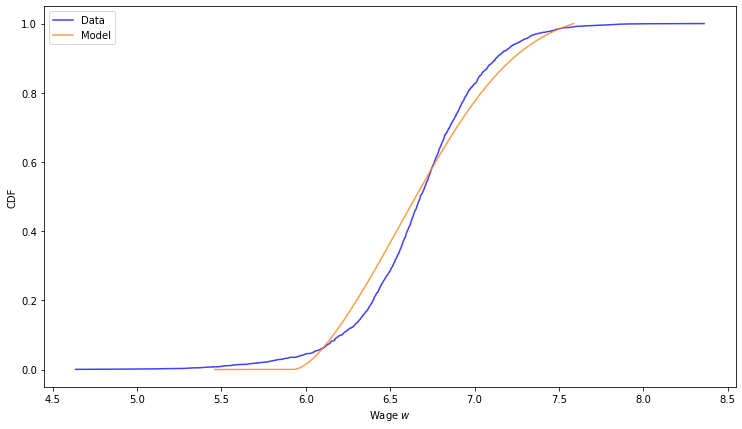

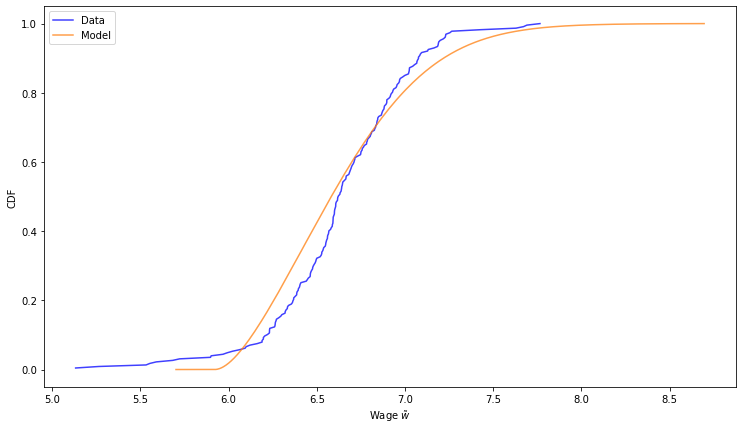

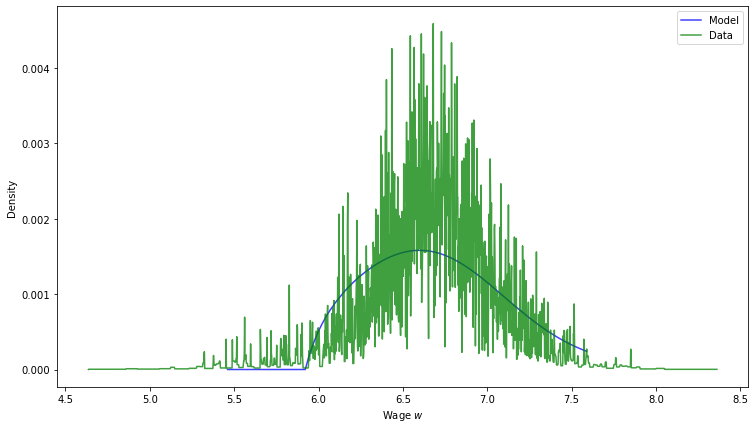

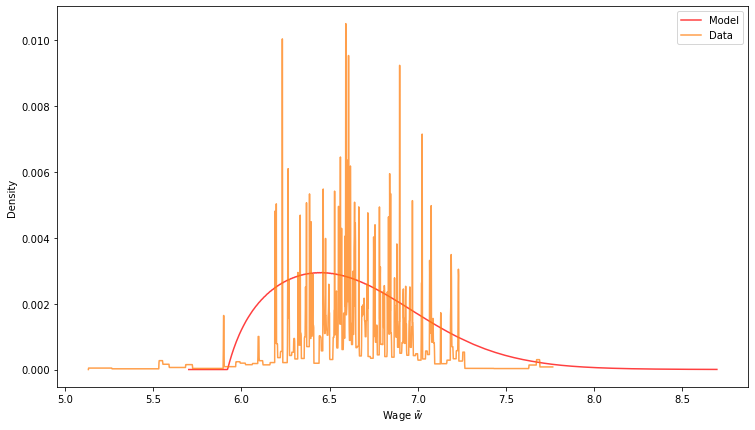

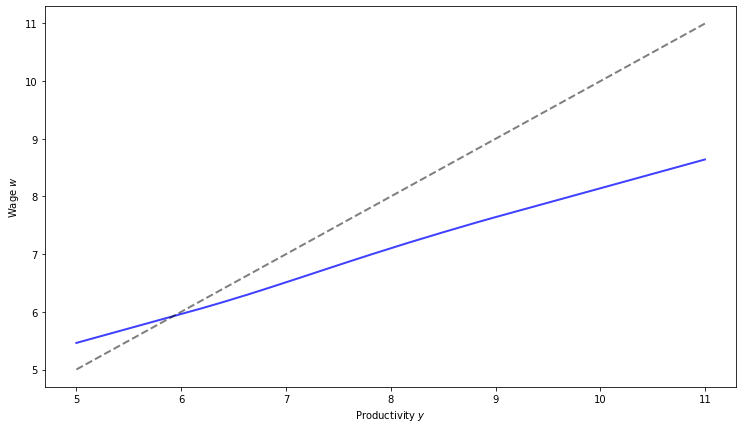

...

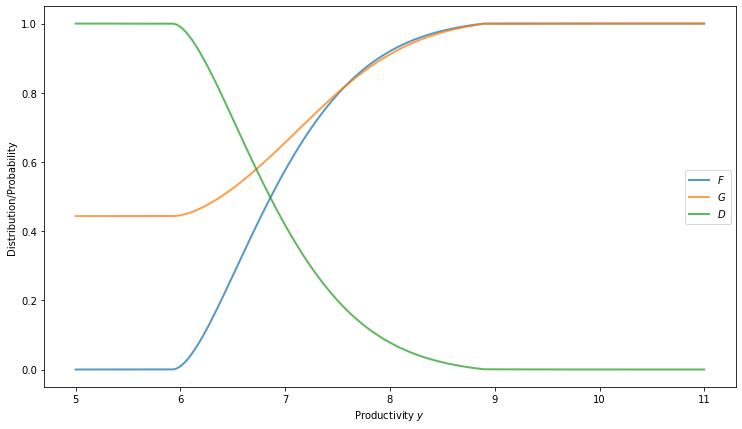

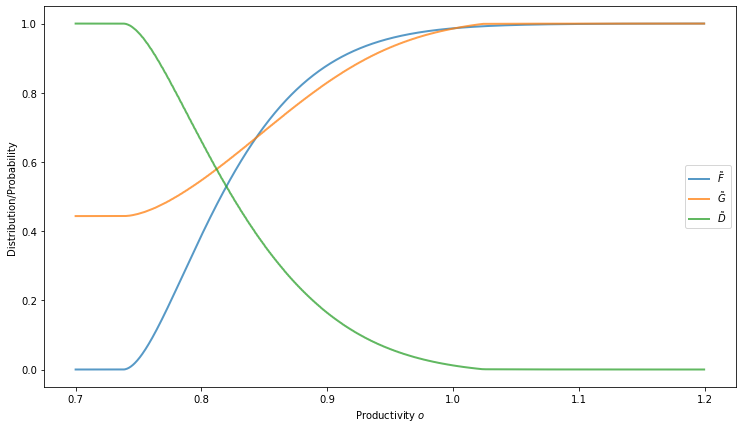

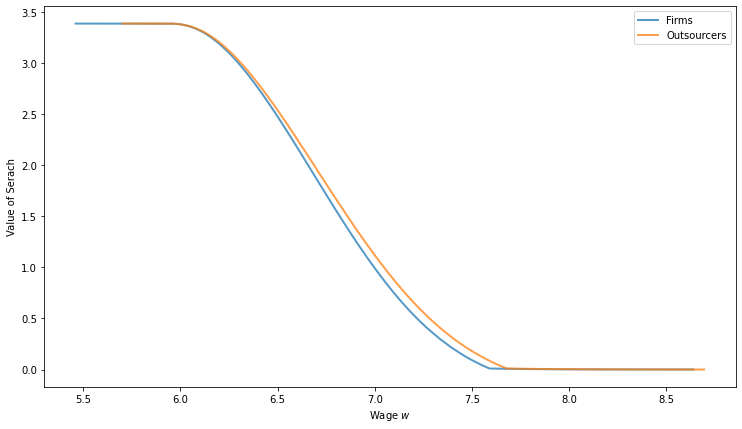

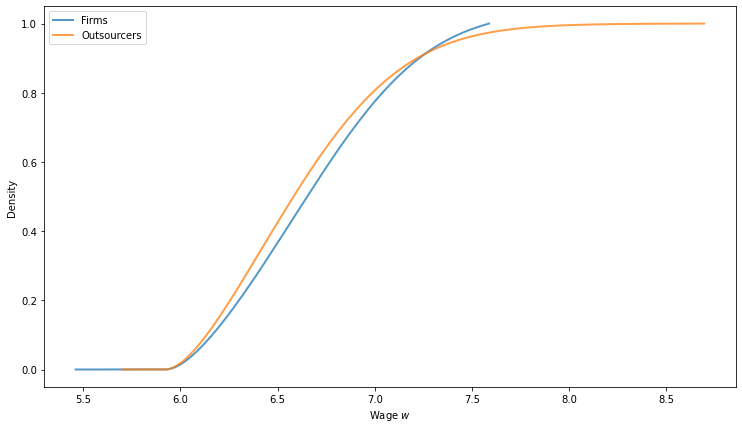

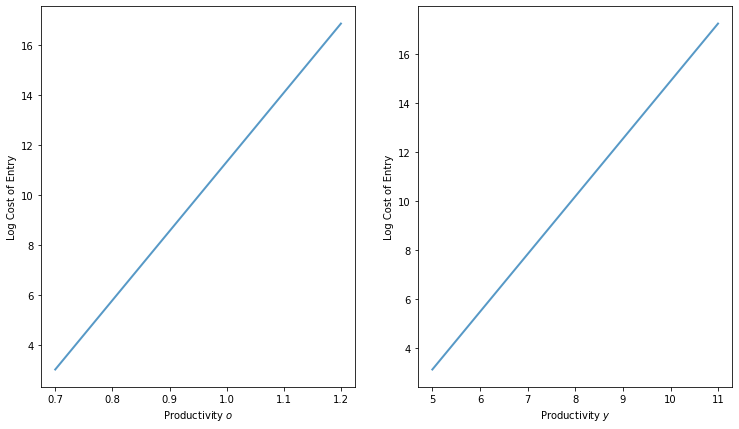


        Comparing to the Scenario without Outsourcers
        Unemployment: with 0.0787; without 0.0817; dif 3.8883
        Workers Job Finding Probability: with 0.0464; without 0.0442; 
        dif -4.6742
        Firms Worker Finding Probability: with 0.6695; without 0.7023; 
        dif 4.9034
        Unemployed Value of Search: with 3.3894; 
        without 3.4126; dif 0.6848
        Mean Wages: with 6.45; without 6.73; dif 4.3572
        Mean Flow: with 6.15; without 6.40;
        dif 4.0066
        Worker Welfare: with 6.1489; without 6.1774; 
        dif 0.4622
        Firm Welfare: with 0.3498; without 0.3354; 
        dif -4.1201
        Total Welfare: with 6.5091; without 7; 
        dif 0.0574
        Efficient Welfare: with 6.6673; without 6.6630;
        dif -0.0645
        Fraction of Efficient Welfare: with 97.6263; without 97.7455;
        dif 0.1220
        Firm Production: with 6.7627; without 6.7510; 
        dif -0.1731
        Total Production: with 6.7627; withou

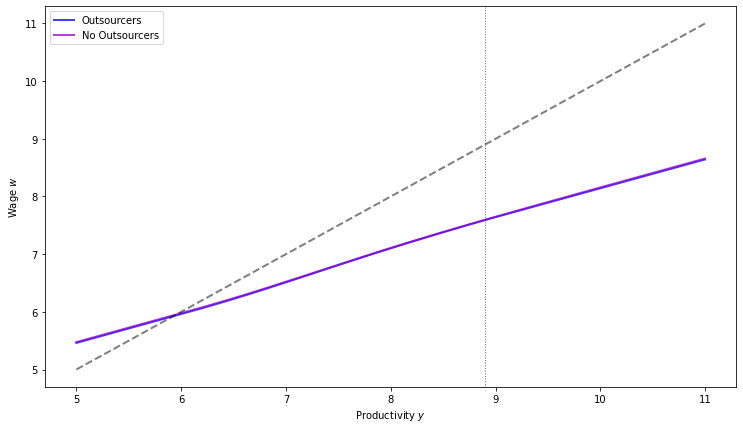

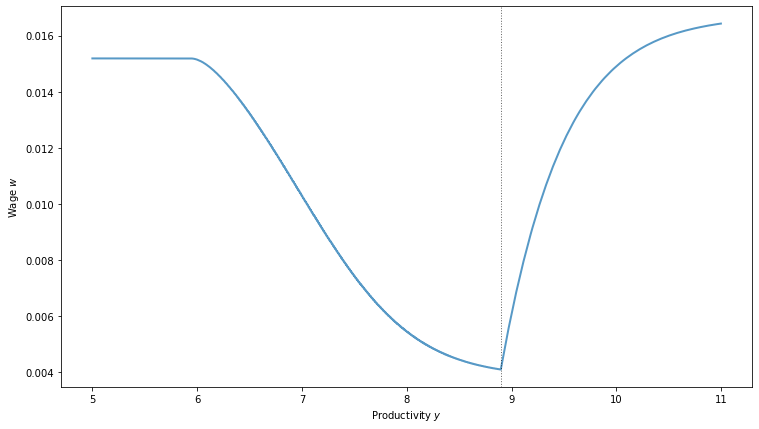

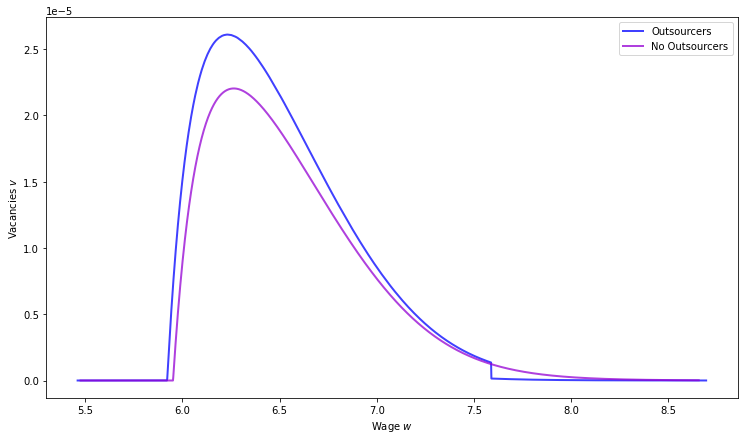

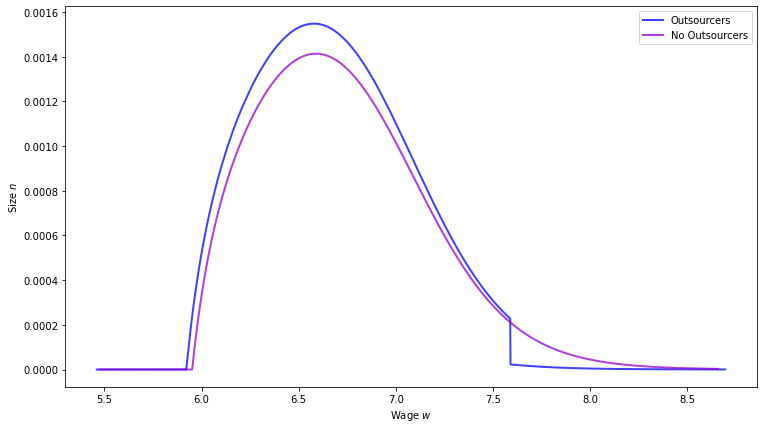

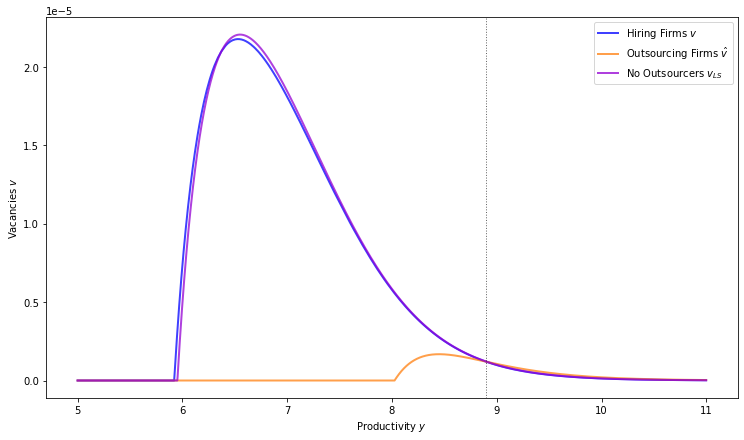

...

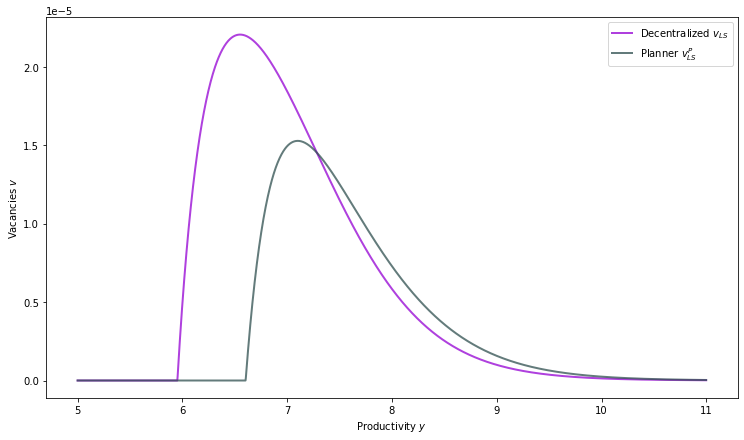

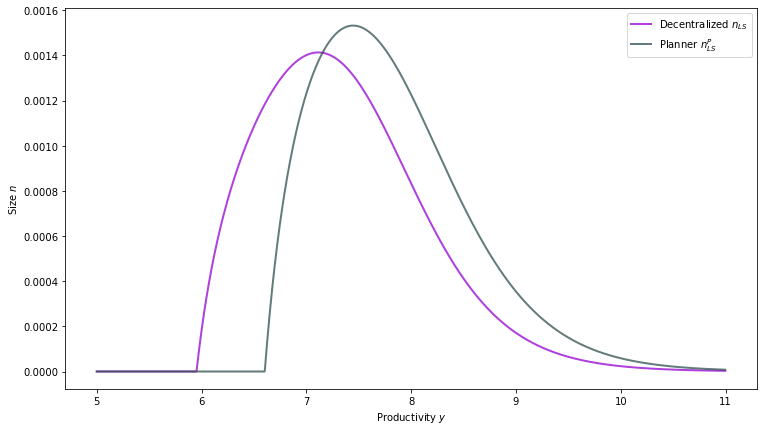

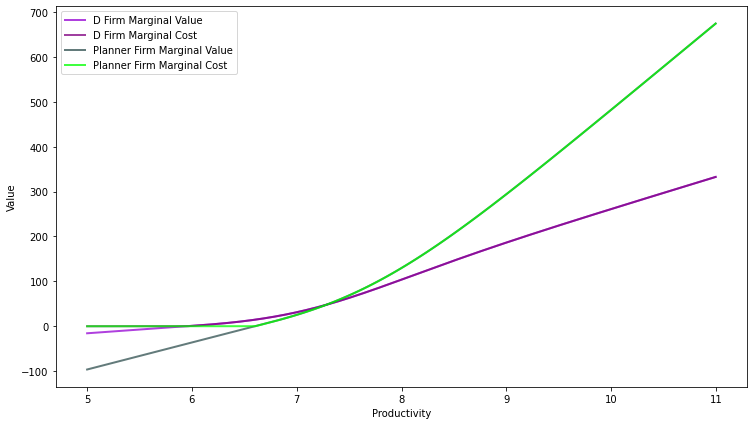

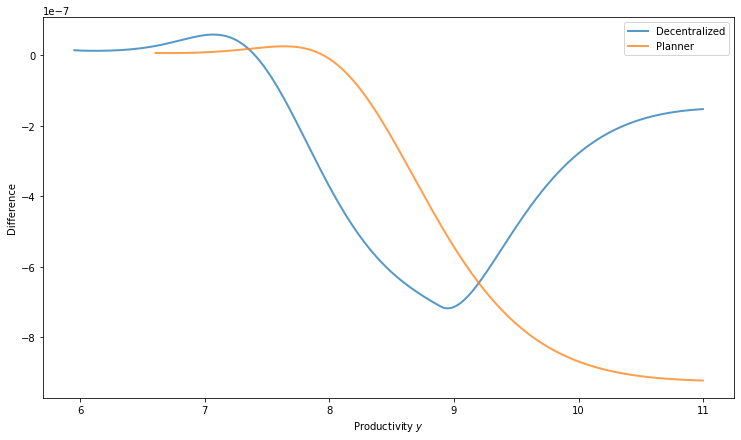

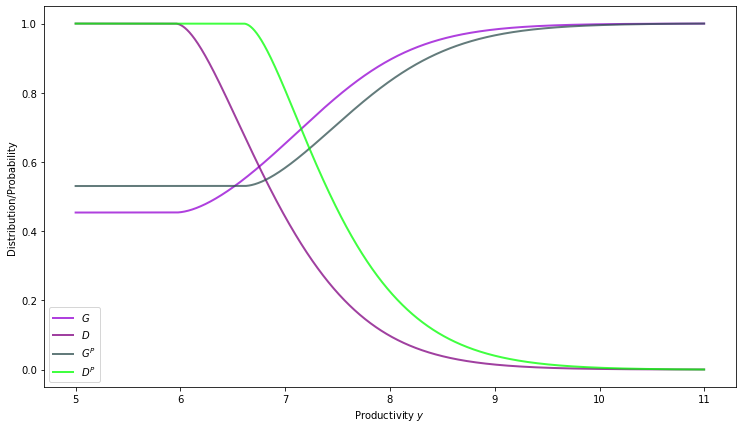


        Comparing to the Scenario with Full Bargaining with Outsourcers
        Unemployment: calibration 0.0787; full 0.0760; dif -3.3526
        UE Rate: calibration 0.0464; full 0.0482; dif 3.8705
        EE Rate: calibration 0.0018; full 0.0019; dif 2.7410
        Per New Jobs from Unemployment: calibration 68.4956; full 67.9313;
        dif -0.8238
        Firms Worker Finding Probability: calibration 0.6695; full 0.6445; 
        dif -3.7263
        Indifferent firm y_hat: calibration 8.8970; full 8.8220;
        dif -0.8430
        Price of Outsourcing: calibration 8.0243; full 7.9963; dif -0.3500
        Percent of Vacancies Outsourced: calibration 0.0906; full 0.1299;
        dif 43.3687
        Percent of Jobs Outsourced: calibration 0.0799; full 0.0925;
        dif 15.6888
        Market Tightness: calibration 0.0693; full 0.0747;
        dif 7.8909
        Unemployed Value of Search: calibration 3.3894; 
        full 3.3693; dif -0.5909
        Mean Wages: calibration 6.45

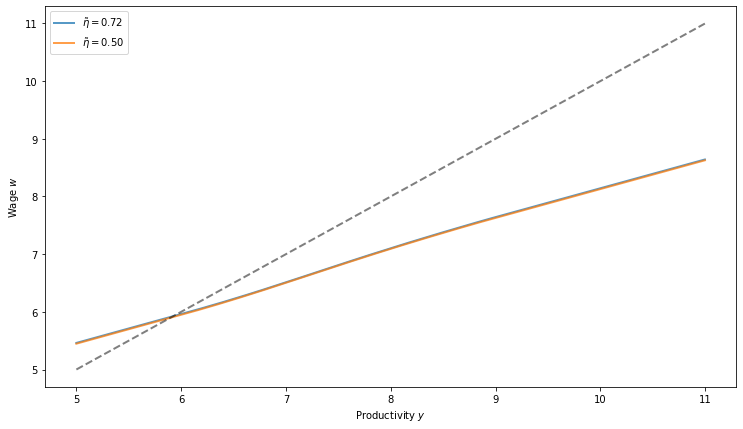

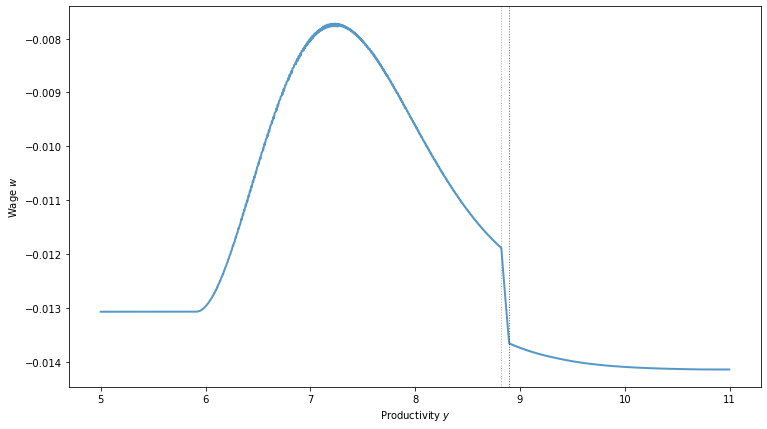

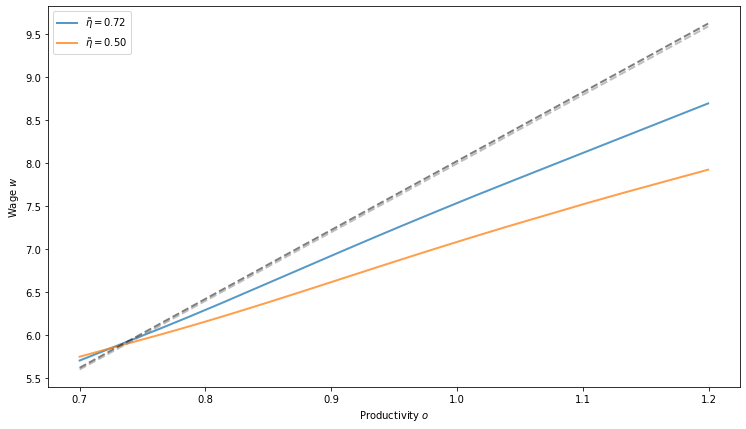

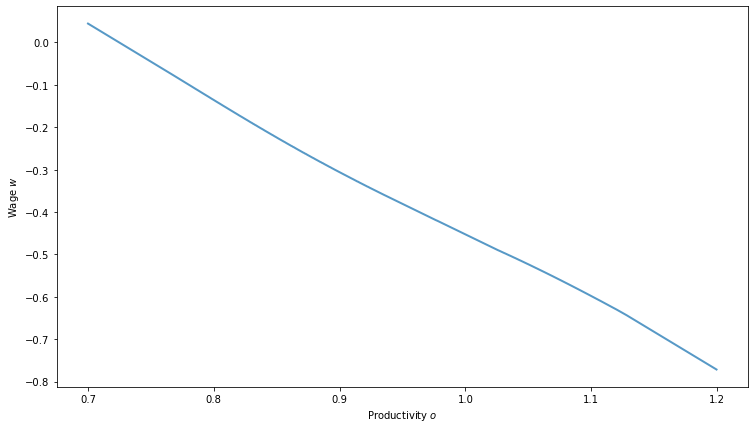

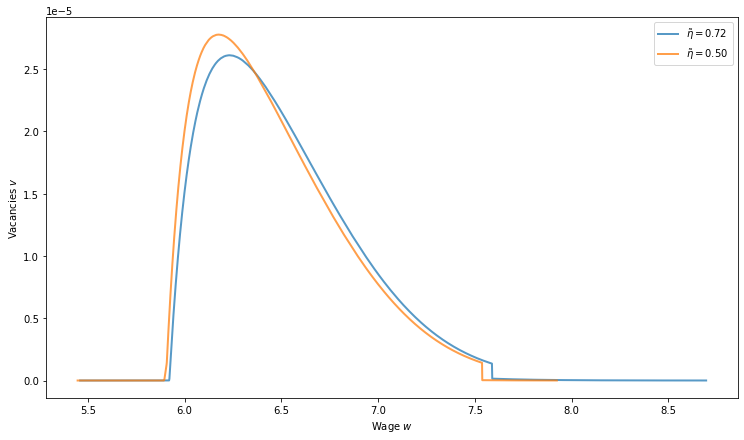

...

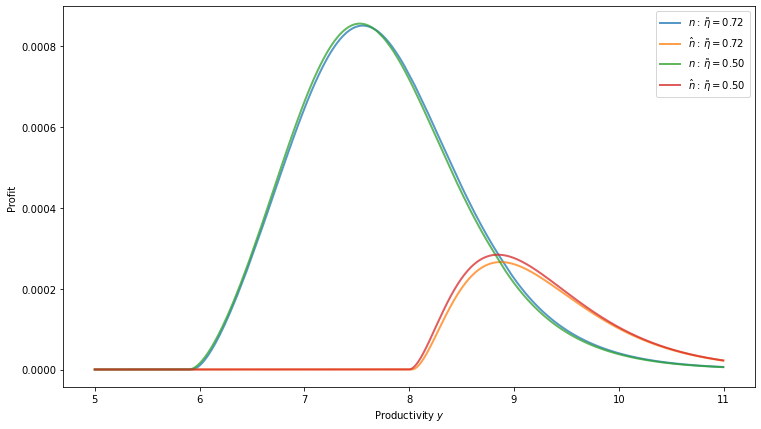

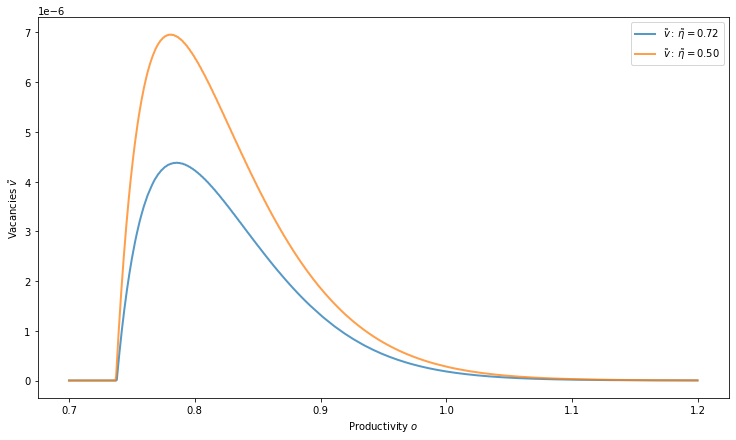

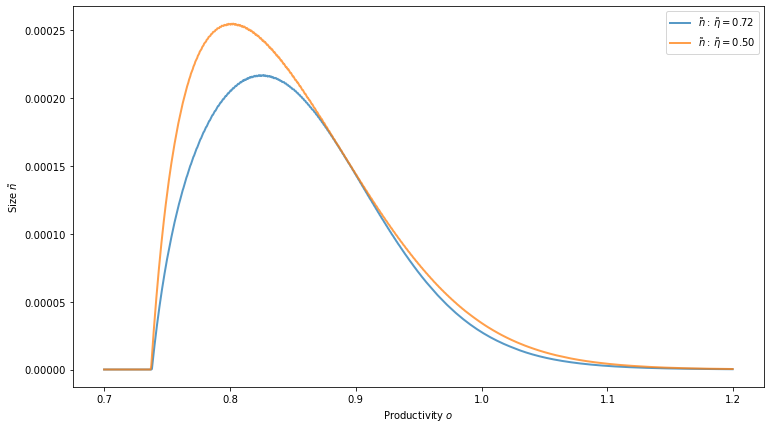

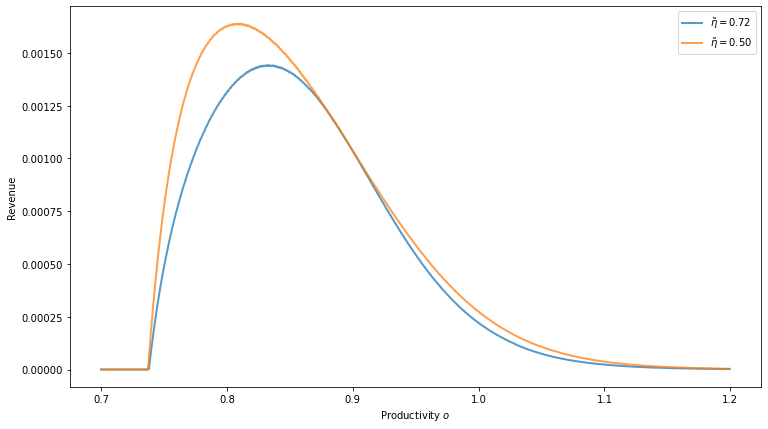

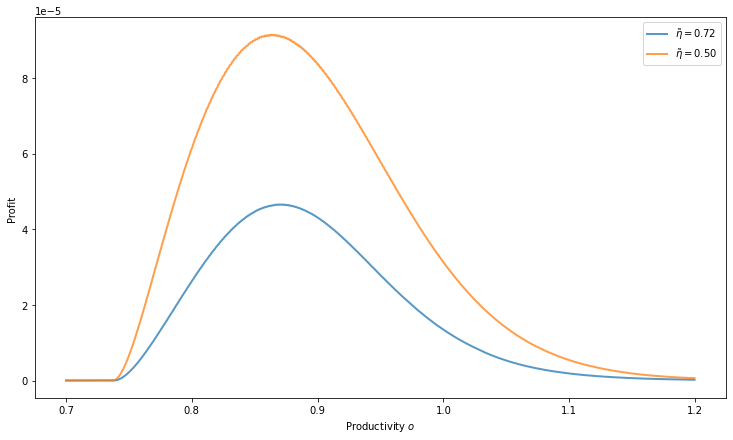


        Comparing to the Scenario with workers 1.5 more productive
        Unemployment: calibration 0.0787; mult 0.0726; dif -7.6747
        UE Rate: calibration 0.0464; mult 0.0506; dif 9.1582
        EE Rate: calibration 0.0018; mult 0.0019; dif 6.9050
        Per New Jobs from Unemployment: calibration 68.4956; mult 67.0647;
        dif -2.0889
        Firms Worker Finding Probability: calibration 0.6695; mult 0.6133; 
        dif -8.3899
        Indifferent firm y_hat: calibration 8.8970; mult 13.6830;
        dif 53.7934
        Price of Outsourcing: calibration 8.0243; mult 12.4969; dif 55.7378
        Percent of Vacancies Outsourced: calibration 0.0906; mult 0.1071;
        dif 18.1651
        Percent of Jobs Outsourced: calibration 0.0799; mult 0.0968;
        dif 21.1272
        Market Tightness: calibration 0.0693; mult 0.0825;
        dif 19.1552
        Unemployed Value of Search: calibration 3.3894; 
        full 5.4902; dif 61.9834
        Mean Wages: calibration 6.45; 

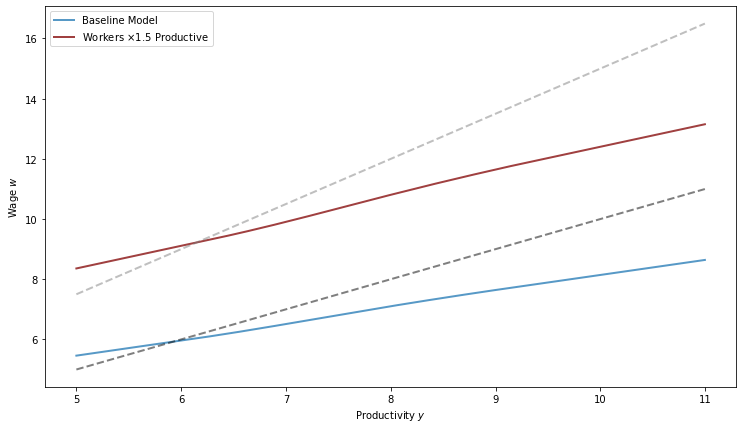

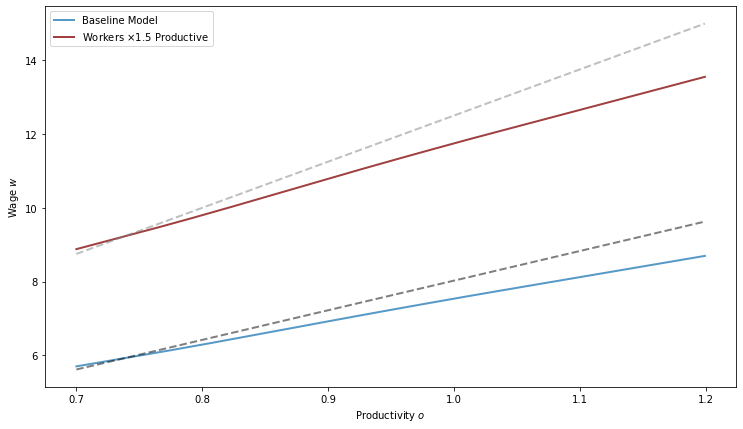

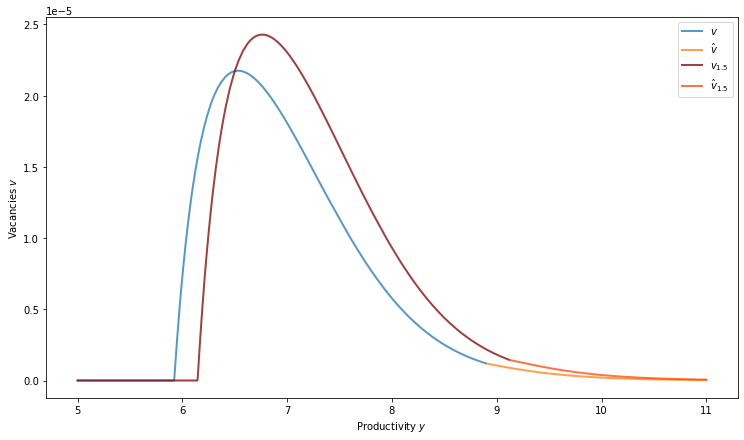

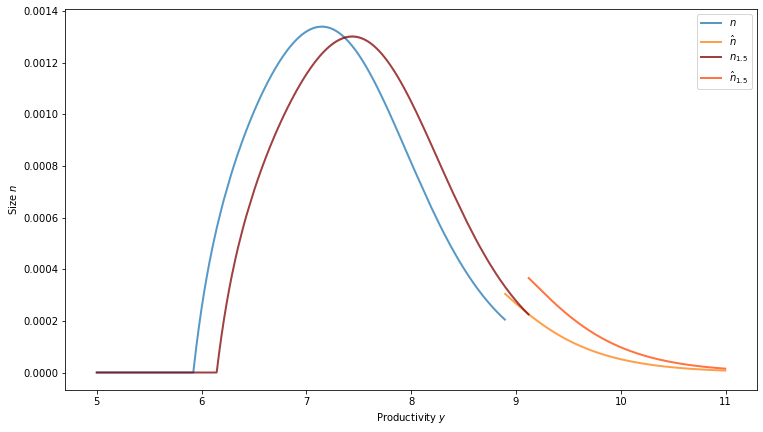

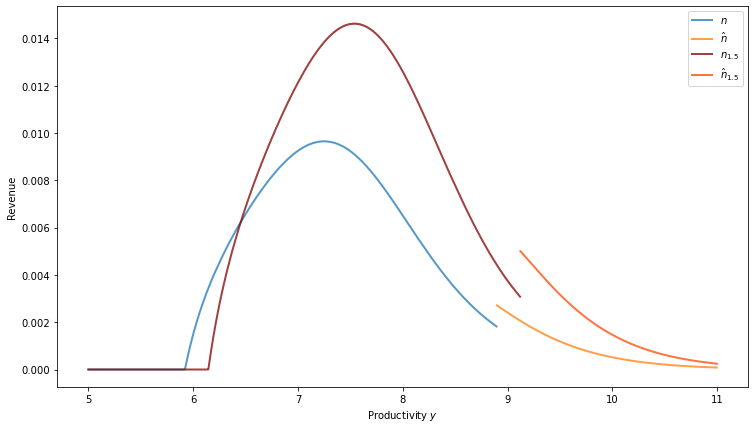

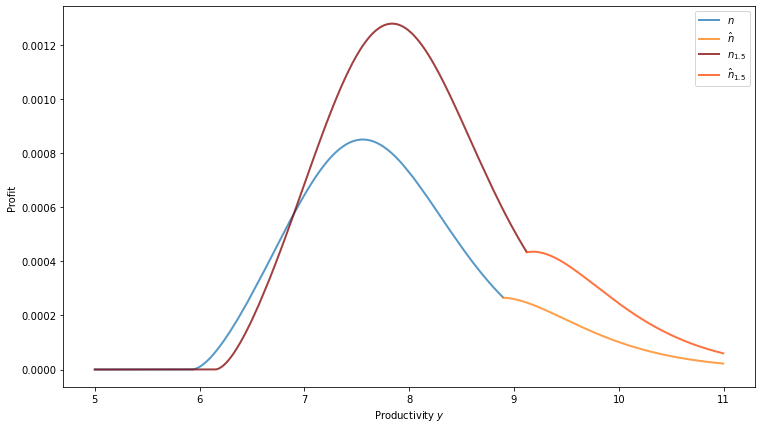

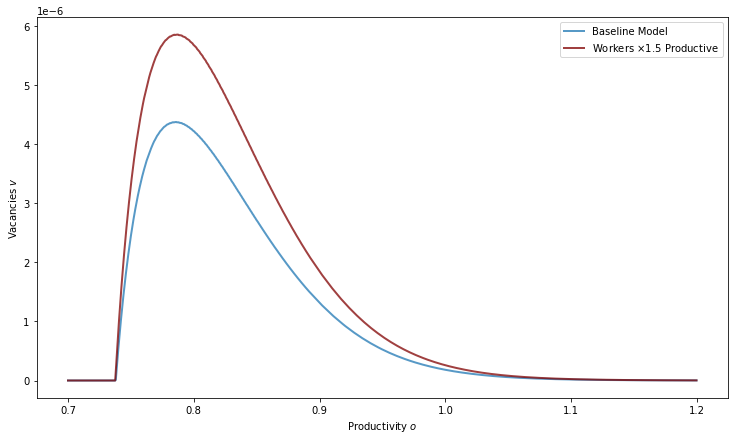

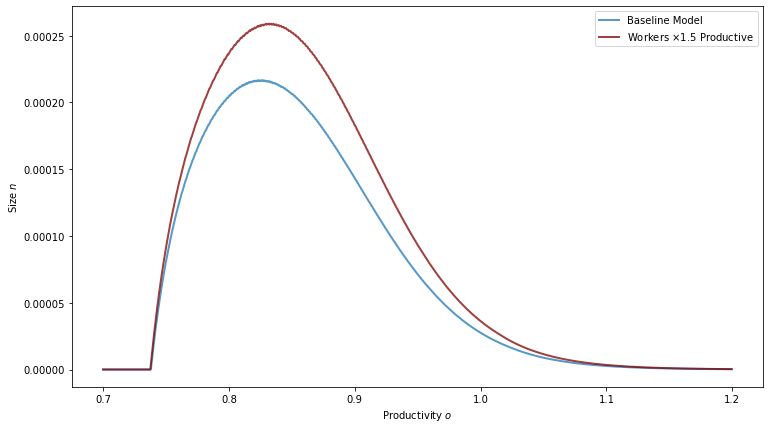

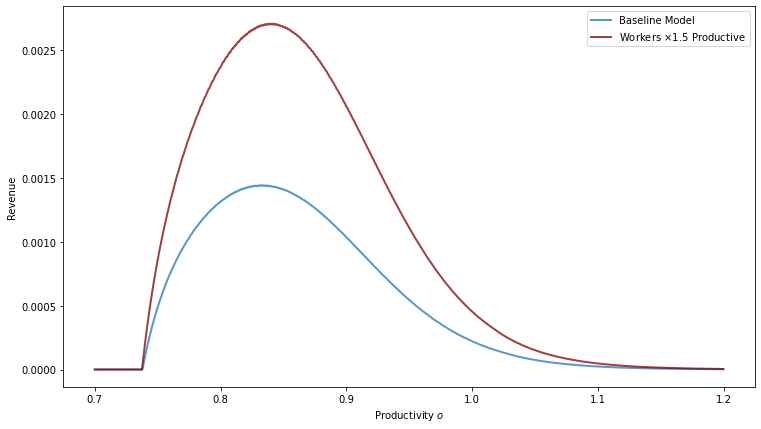

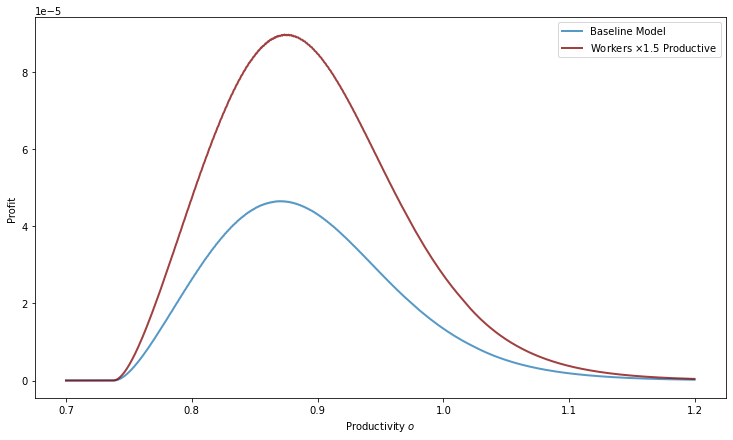

In [6]:
# Run model with final results
y_grid_size = 2000
o_grid_size = 1000

y_grid = np.linspace(y_min, y_max, y_grid_size, endpoint=False)
o_grid = np.linspace(o_min, o_max, o_grid_size, endpoint=False)

c_grid = np.exp(result.x[0] + y_grid * result.x[1])
c_o_grid = np.exp(result.x[2] + o_grid * result.x[3])
xi = result.x[4]
phi = result.x[5]
eta_o = eta * result.x[6]

# Record initial guesses
v_grid_0 = np.ones(y_grid_size) * 0.9
n_grid_0 = np.ones(y_grid_size) * 0.9
v_hat_grid_0 = np.ones(y_grid_size) * 0.9
n_hat_grid_0 = np.ones(y_grid_size) * 0.9
v_o_grid_0 = np.ones(o_grid_size) * 0.9
n_o_grid_0 = np.ones(o_grid_size) * 0.9
y_hat_0 = y_max
R_grid_0 = np.minimum(np.arange(y_grid_size), o_grid_size - 1, dtype=np.int64)
R_o_grid_0 = np.minimum(np.arange(o_grid_size), y_grid_size - 1, dtype=np.int64)

guess_0 = (v_grid_0, v_hat_grid_0, v_o_grid_0, n_grid_0, n_hat_grid_0, n_o_grid_0, y_hat_0, R_grid_0, R_o_grid_0)

tol = 1e-4
max_iter = 25
tol_i = 1e-8
max_iter_i = 1e5
slow_i = 1e-1
print_skip = 5
ps = 1e4
verbose = True

# save = True
save = False
compare = save

ooj = OutsourcingOnJob(
    B, b, delta_, delta_o, delta_hat, xi, eta, eta_o, phi, alpha,
    y_min, y_max, y_grid_size, o_min, o_max, o_grid_size,
    gamma, gamma_o, c_grid, c_o_grid, hp
)

folder=r'../../Figures/Python Simulations/Test Calibration 15'
file=r'/'
f = None
csv_path = folder + file + "Parameter Values.csv"

if save:
    os.mkdir(folder)
    f = open(folder + file + "Details.txt", "w")
    
    if method != "Powell":
        bounds = None
        
    if basin:
        hopping = (niter_b, T, interval, seed, inspect.getsource(mytakestep.__call__))
    else:
        hopping = None
        
    save_parameters(ooj, f, p_1, p_2, tol, max_iter, tol_i, max_iter_i, slow_i,
                    result=result, method=method, max_iter_est=max_iter_est,
                    hopping=hopping, bounds=bounds, weights=weights, csv_path=csv_path)
    
(v_grid, v_hat_grid, v_o_grid, n_grid,
 n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p) = find_p(
    ooj, guess_0, p_1_0, p_2_0, tol, max_iter, tol_i, max_iter_i, slow_i, verbose, print_skip
)

solution = (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p)

# Solve Planner's problem
guess_p = solution[:-1] + (np.zeros(y_grid_size), np.zeros(o_grid_size),)

rho_1, rho_2 = p - 0.2, p - 0.5
# slow_i_p = 5e-2
# max_iter_i_p = 2e5
slow_i_p = 1e-2
max_iter_i_p = 3e5
# slow_i_p = slow_i
# max_iter_i_p = max_iter_i

(v_grid_p, v_hat_grid_p, v_o_grid_p, n_grid_p, n_hat_grid_p, n_o_grid_p,
 y_hat_p, R_grid_p, R_o_grid_p, lam_grid, iota_grid, rho) = find_rho(
    ooj, guess_p, rho_1, rho_2, tol, max_iter, tol_i, max_iter_i_p, slow_i_p, verbose, print_skip
)

solution_p = (v_grid_p, v_hat_grid_p, v_o_grid_p, n_grid_p, n_hat_grid_p, n_o_grid_p,
 y_hat_p, R_grid_p, R_o_grid_p, lam_grid, iota_grid, rho)

# Solve the problem without outsourcers (use current model as guess)
guess_ls = v_grid, n_grid

v_grid_ls, n_grid_ls = ls_solve_model(ooj, guess_ls, tol_i, max_iter_i, slow_i, verbose, ps)

solution_ls = v_grid_ls, n_grid_ls

# Solve Planner's problem without outsourcers
guess_ls_p = solution_ls + (np.zeros(y_grid_size),)

v_grid_ls_p, n_grid_ls_p, lam_grid_ls = ls_solve_model_p(
    ooj, guess_ls_p, tol_i, max_iter_i, slow_i, verbose, ps)

solution_ls_p = v_grid_ls_p, n_grid_ls_p, lam_grid_ls

# Solve problem when workers have full bargaining power with outsourcer
ooj_fb = copy.copy(ooj)
ooj_fb.eta_o = ooj_fb.eta

guess_fb = solution[:-1]
p_1_fb, p_2_fb = p, p + .5

(v_grid_fb, v_hat_grid_fb, v_o_grid_fb, n_grid_fb,
 n_hat_grid_fb, n_o_grid_fb, y_hat_fb, R_grid_fb, R_o_grid_fb, p_fb) = find_p(
    ooj_fb, guess_fb, p_1_fb, p_2_fb, tol, max_iter, tol_i, max_iter_i, slow_i, verbose, print_skip
)

solution_fb = (v_grid_fb, v_hat_grid_fb, v_o_grid_fb, n_grid_fb,
 n_hat_grid_fb, n_o_grid_fb, y_hat_fb, R_grid_fb, R_o_grid_fb, p_fb)

# What if workers were more productive (but vacancy costs stayed the same)
mult = 1.5
ooj_mp = OutsourcingOnJob(
    B, b * mult, delta_, delta_o, delta_hat, xi, eta, eta_o, phi, alpha,
    y_min * mult, y_max * mult, y_grid_size, o_min, o_max, o_grid_size,
    gamma, gamma_o, c_grid, c_o_grid, hp
)

guess_mp = solution[:-1]
p_1_mp, p_2_mp = p * mult, (p + .5) * mult

(v_grid_mp, v_hat_grid_mp, v_o_grid_mp, n_grid_mp,
 n_hat_grid_mp, n_o_grid_mp, y_hat_mp, R_grid_mp, R_o_grid_mp, p_mp) = find_p(
    ooj_mp, guess_mp, p_1_mp, p_2_mp, tol, max_iter, tol_i, max_iter_i, slow_i, verbose, print_skip
)

solution_mp = (v_grid_mp, v_hat_grid_mp, v_o_grid_mp, n_grid_mp,
 n_hat_grid_mp, n_o_grid_mp, y_hat_mp, R_grid_mp, R_o_grid_mp, p_mp)

list_facts(ooj, solution, f=f, compare=compare)

cdf_comp(ooj, solution, save=save, folder=folder, file=file)

graph_results(ooj, solution, save=save, folder=folder, file=file)

comp_no_outsourcers(ooj, solution, solution_p, solution_ls, solution_ls_p,
                   save=save, f=f, folder=folder, file=file)

comp_full_bargain(ooj, ooj_fb, solution, solution_fb, save=save, f=f, folder=folder, file=file)

comp_more_productive(ooj, ooj_mp, solution, solution_mp, mult, save=save, f=f, folder=folder, file=file)

if save:
    f.close()

In [8]:
f.close()

AttributeError: 'NoneType' object has no attribute 'close'

The indifferent firm is y_hat = 9.21$. Price of outsourcing is 8.44.
Unemployment is 8.58. According to LoM, should be 8.60
Workers match with probability 4.17. Firms/Outsourcers match with probability 73.79
Total vacancies searching for workers are 0.0128. Theta is 0.0566
9 percent of vacancies searching for workers are from outsourcers, 7 percent of postions outsourced
The ue rate is 0.0417, the ee rate is 0.0022,  and 64.154148 of new jobs are from unemployment
Checking if vacancies + LoM imply right positions:
 Hiring firms largest error = 0.000001 at position 1317 
 Outsourcing firms largest error = 0.000000 at position 0
 Outsourcer largest error = 0.000002 at position 449


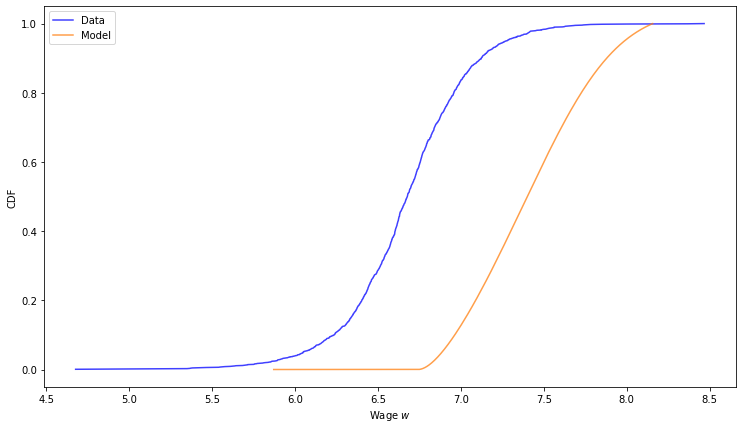

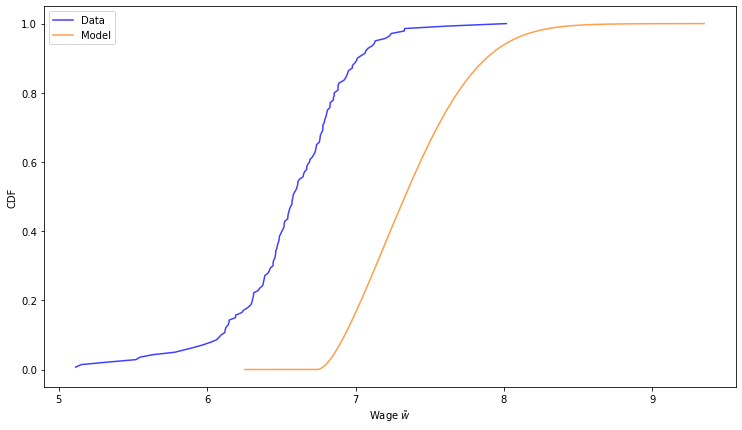

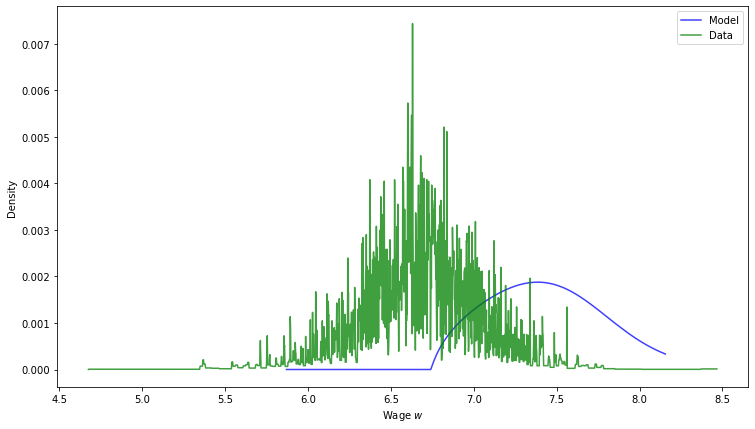

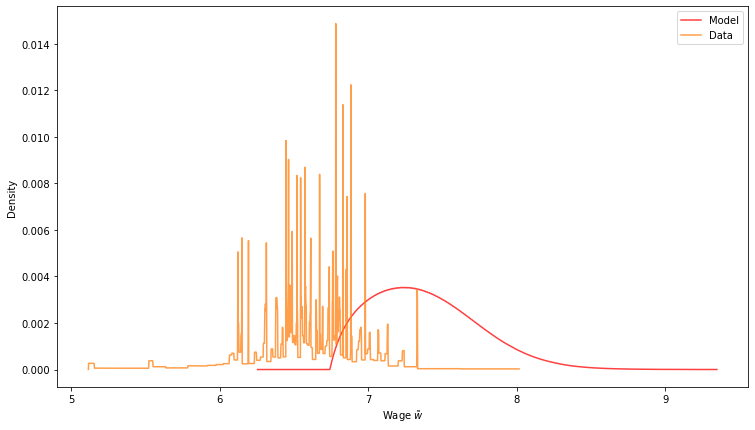

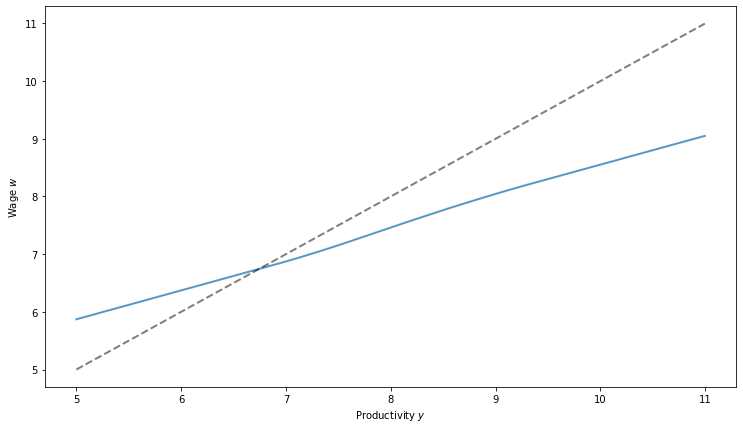

...

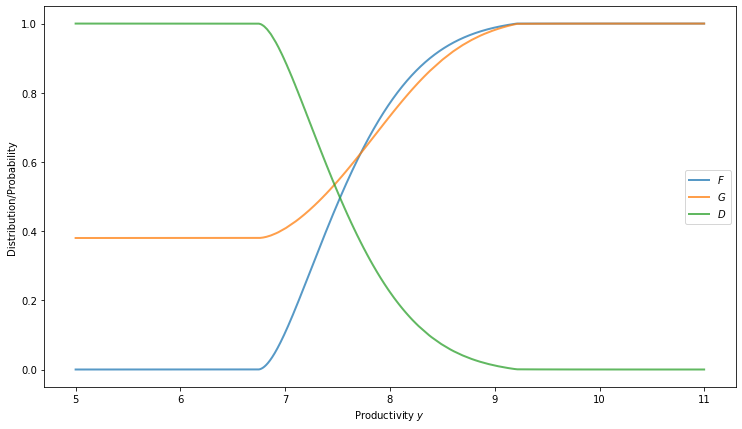

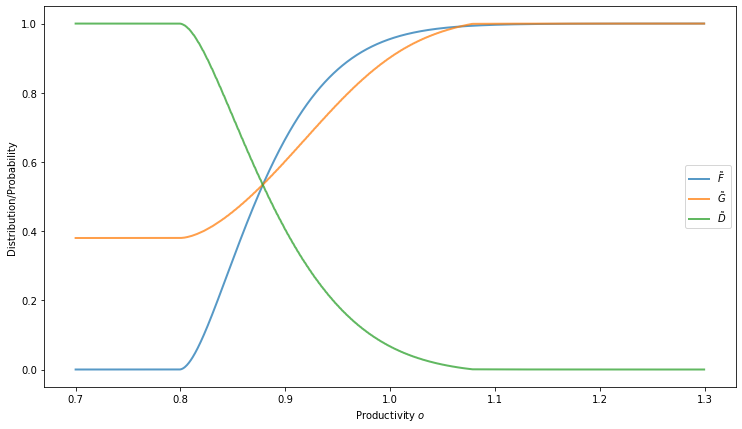

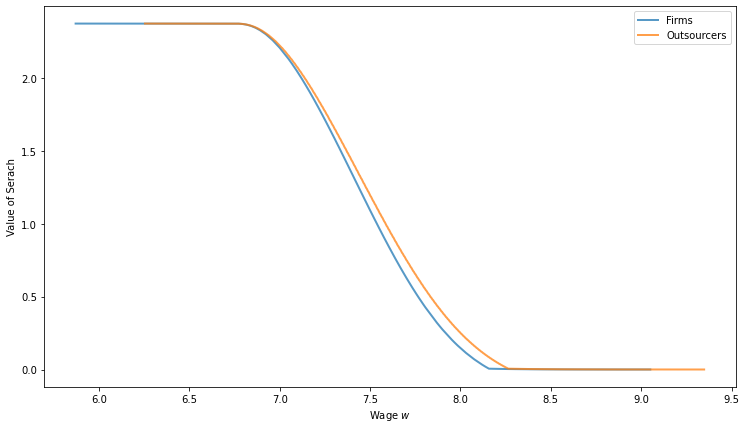

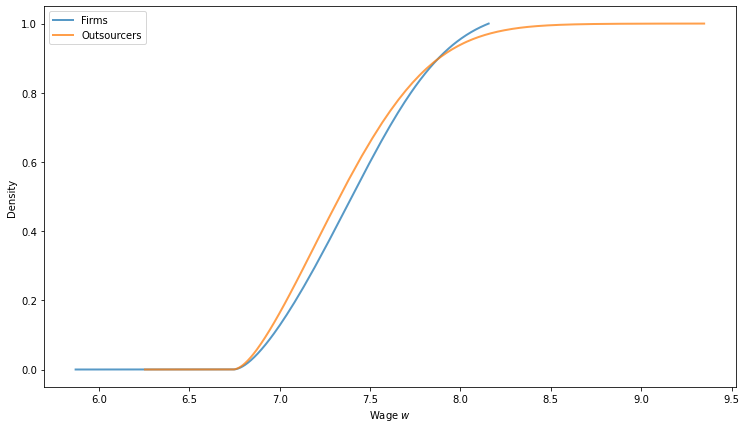

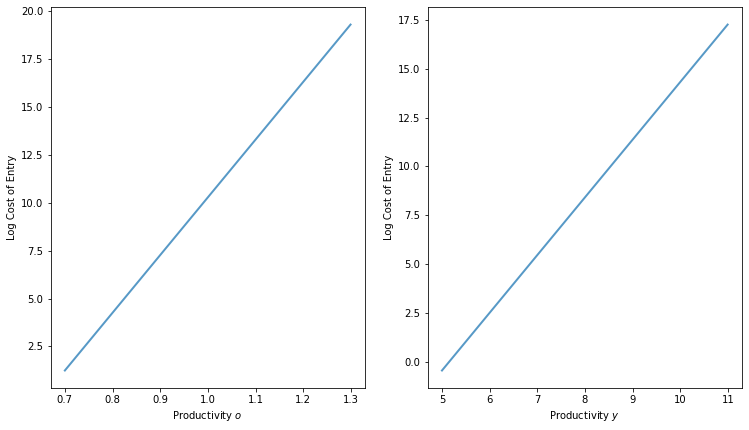


        Comparing to the Scenario without Outsourcers
        Unemployment: with 0.0858; without 0.0885; dif 3.2323
        Workers Job Finding Probability: with 0.0417; without 0.0400; 
        dif -4.2443
        Firms Worker Finding Probability: with 0.7379; without 0.7706; 
        dif 4.4324
        Unemployed Value of Search: with 2.3711; 
        without 2.3972; dif 1.0985
        Mean Value of Working: with hired 5287.75; with outsourced 5143.03; 
        without hired 5328.29; diff 0.7667 
        Mean Wages: with 7.41; without 7.45; dif 0.5607
        Mean Flow: with 7.18; without 7.21;
        dif 0.4240
        Mean Hired Wages: with 7.41; without 7.45; 
        dif 0.5275
        Worker Welfare: with 5434; without 5488; 
        dif 0.9920
        Hired Worker Welfare: with 5288; without 5328; 
        dif 0.7667
        Firm Welfare: with 86; without 80; 
        dif -6.4316
        Total Welfare: with 5523; without 5568; 
        dif 0.8130
        Efficient Welfare: wi

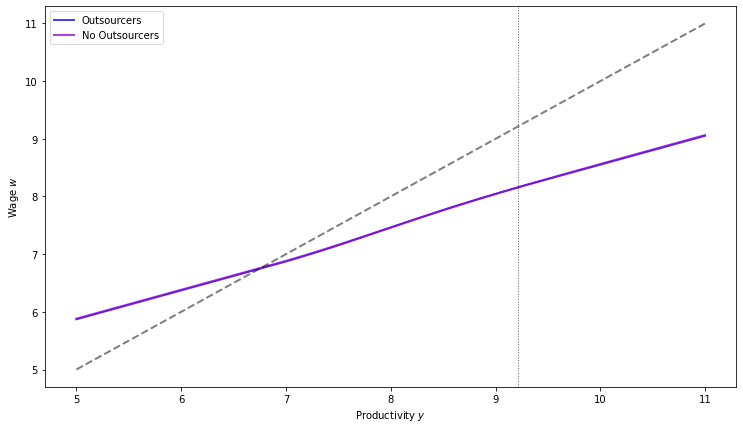

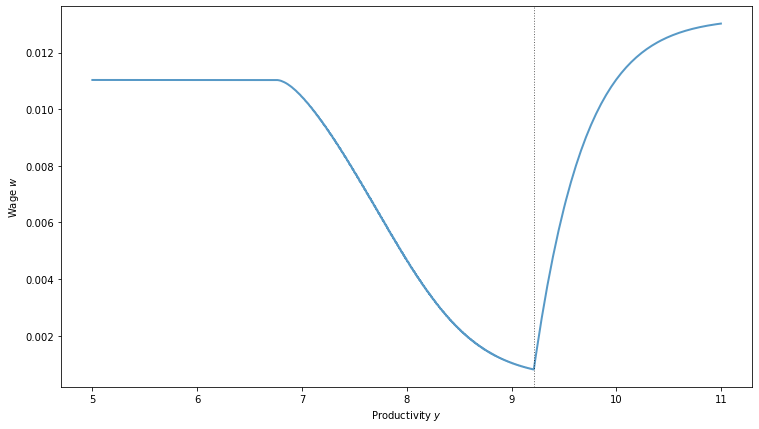

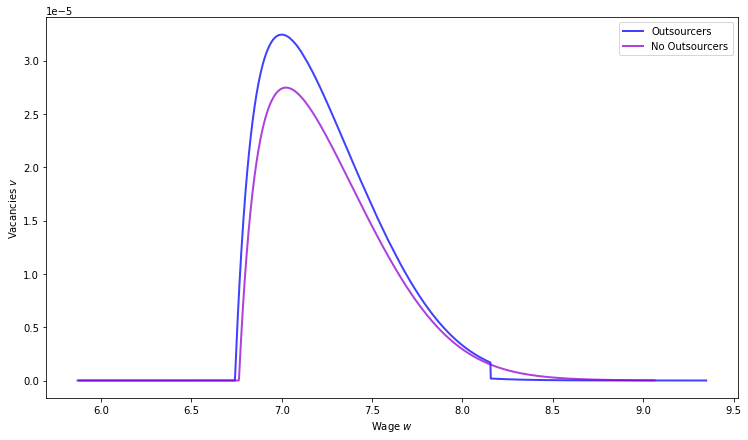

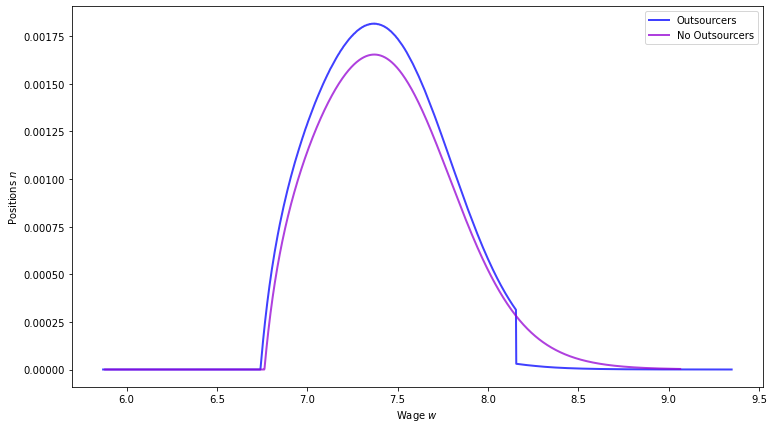

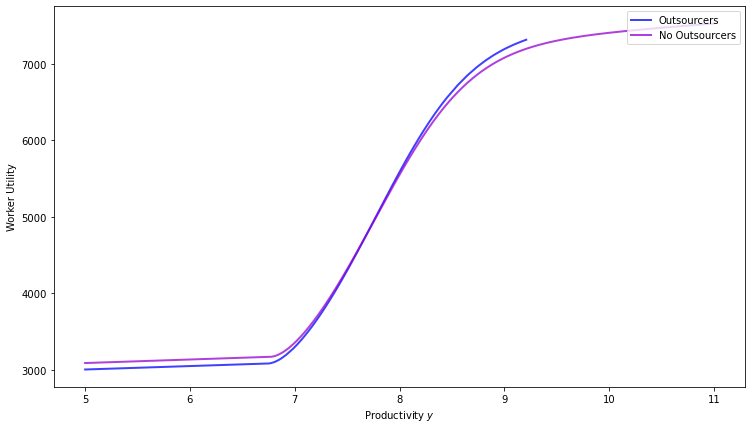

...

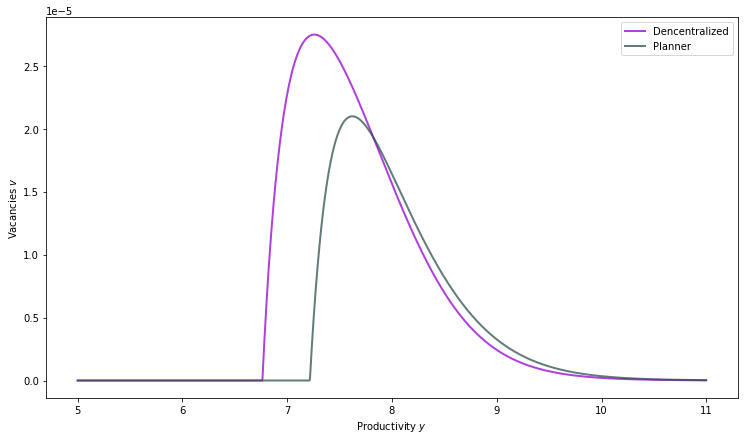

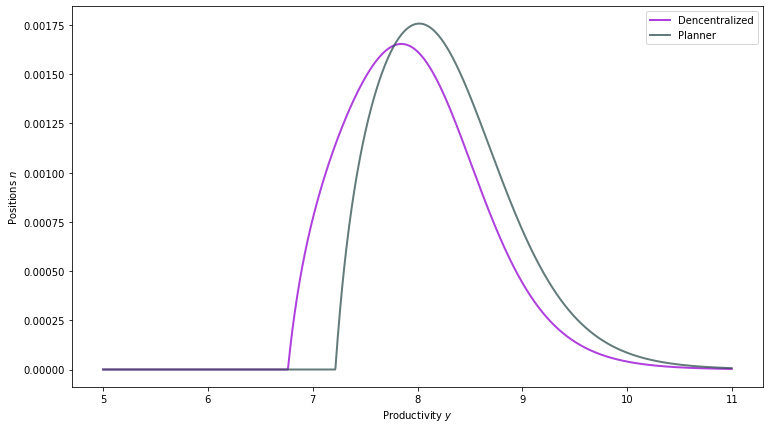

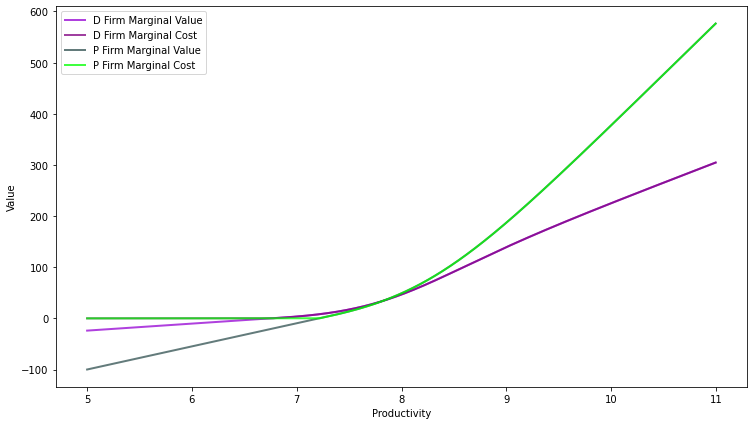

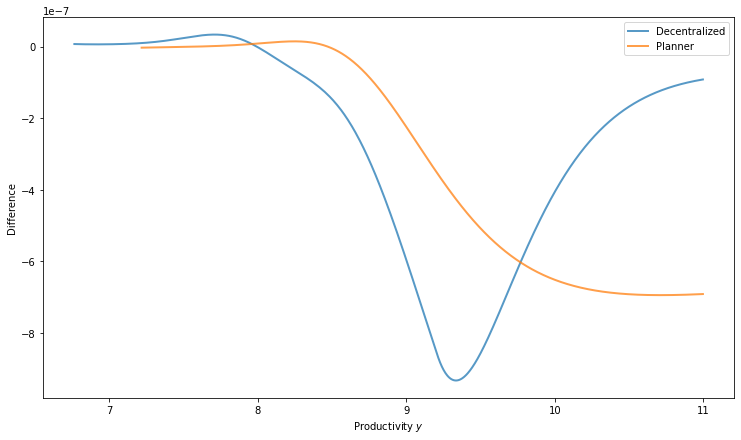

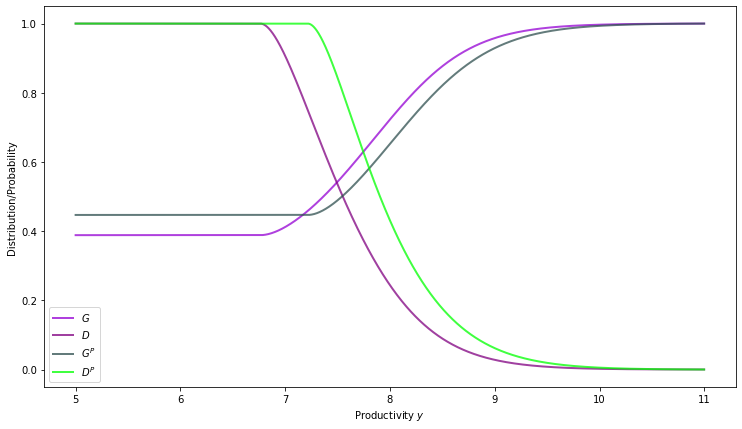


        Comparing to the Scenario with Full Bargaining with Outsourcers
        Unemployment: calibration 0.0858; full 0.0848; dif -1.1717
        UE Rate: calibration 0.0417; full 0.0422; dif 1.2009
        EE Rate: calibration 0.0022; full 0.0022; dif 0.6866
        Per New Jobs from Unemployment: calibration 64.1541; full 63.9748;
        dif -0.2796
        Firms Worker Finding Probability: calibration 0.7379; full 0.7291; 
        dif -1.1867
        Indifferent firm y_hat: calibration 9.2120; full 9.2120;
        dif 0.0000
        Price of Outsourcing: calibration 8.4351; full 8.4391; dif 0.0470
        Percent of Vacancies Outsourced: calibration 0.0865; full 0.0970;
        dif 12.1284
        Percent of Jobs Outsourced: calibration 0.0727; full 0.0728;
        dif 0.2146
        Total Vacancies: calibration 0.0128; full 0.0130;
        dif 2.0298
        Market Tightness: calibration 0.0566; full 0.0579;
        dif 2.4162
        Unemployed Value of Search: calibration 2.37

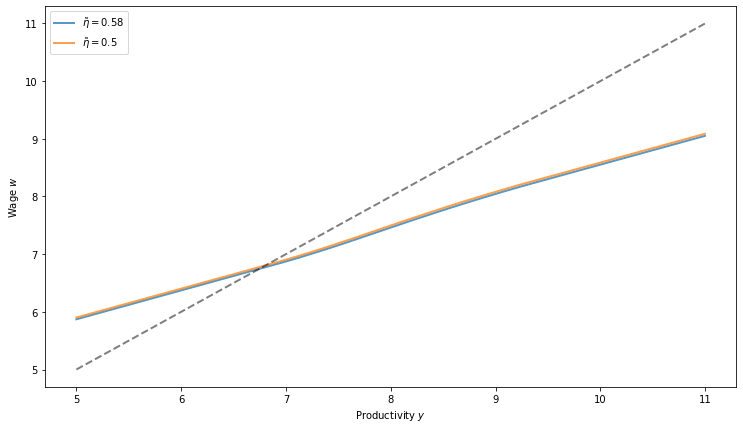

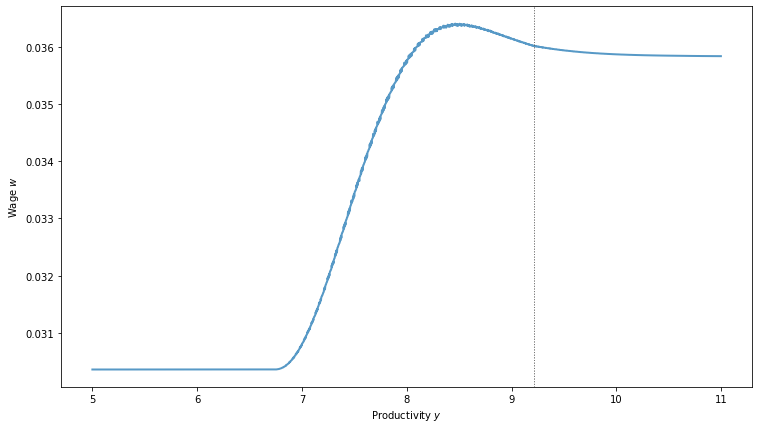

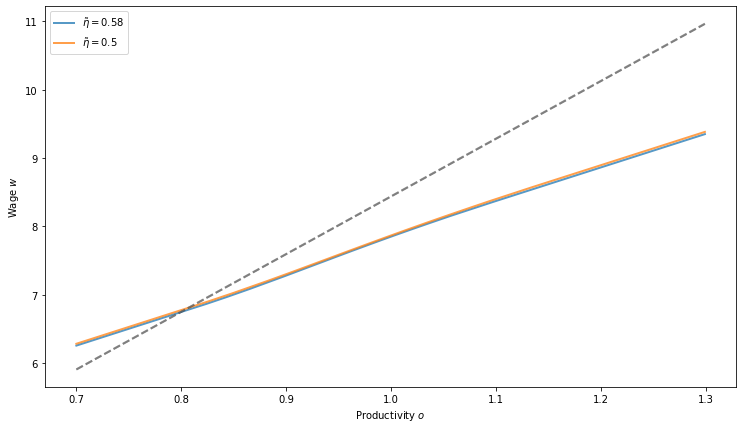

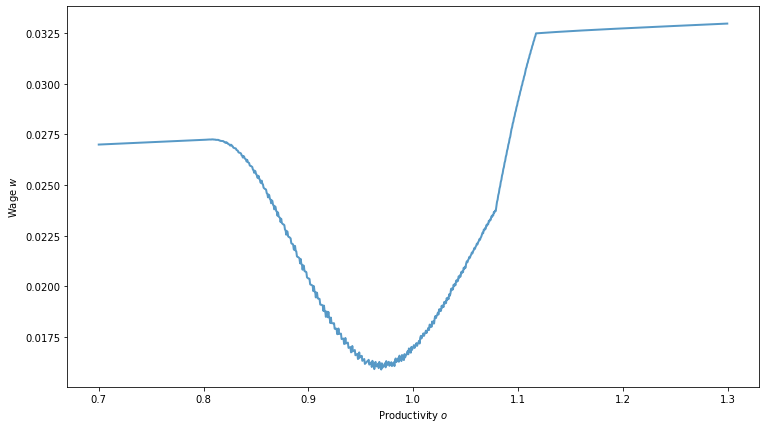

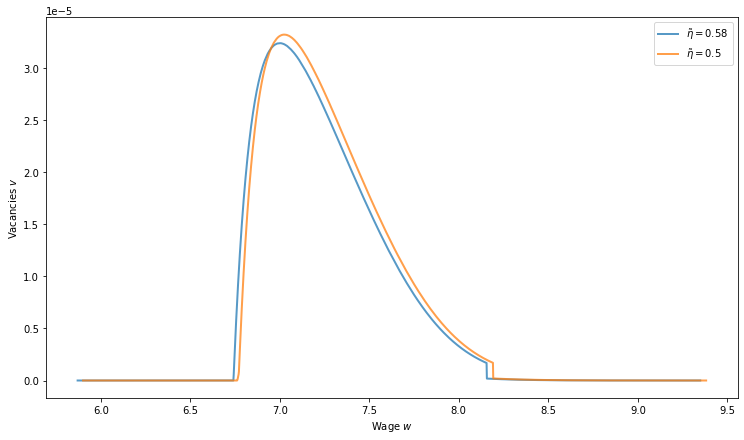

...

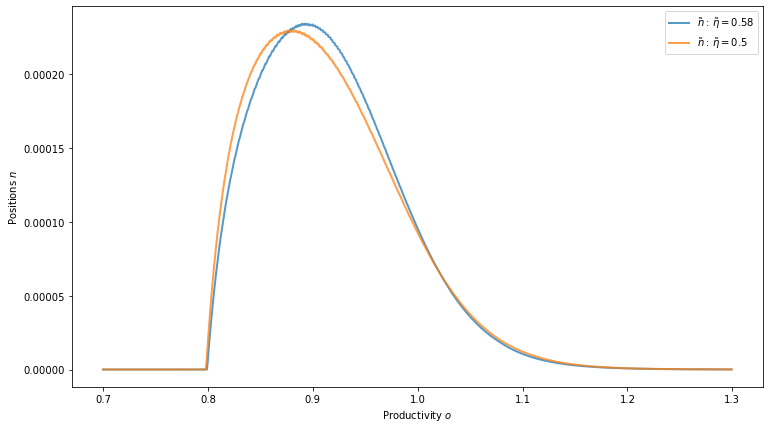

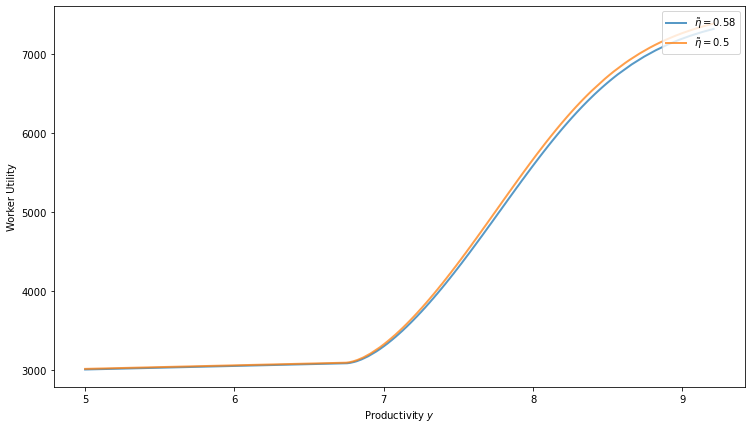

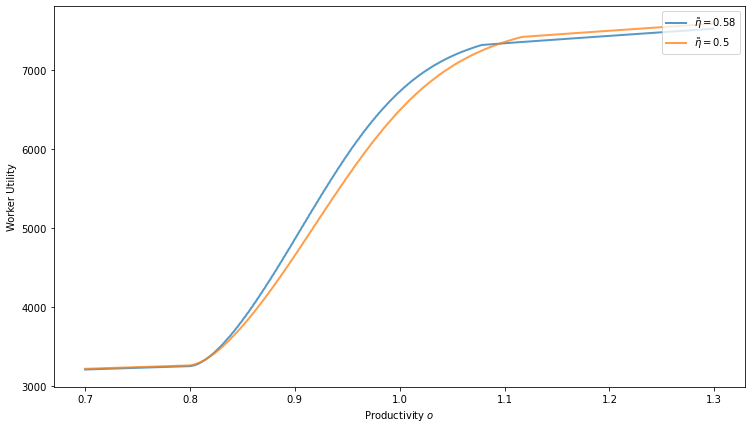

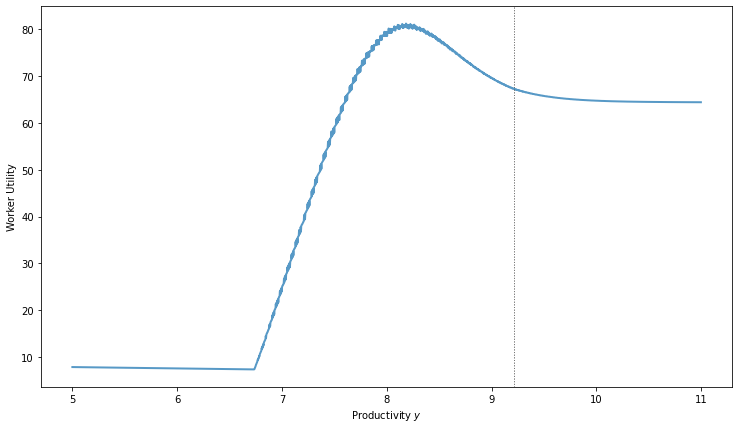

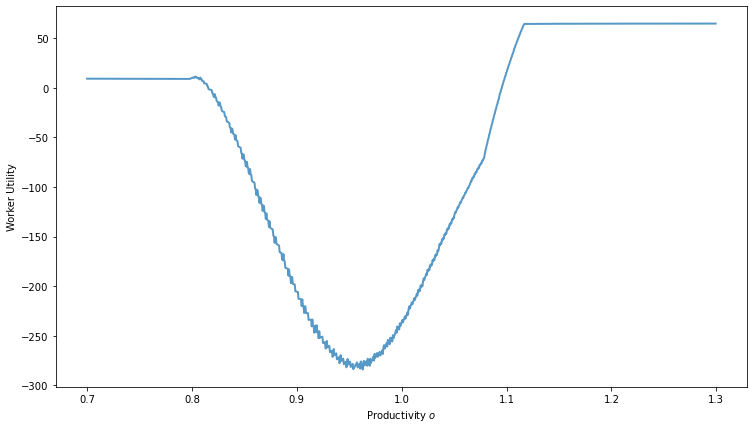


        Comparing to the Scenario with workers 1.5 more productive
        Unemployment: calibration 0.0858; mult 0.0788; dif -8.1898
        UE Rate: calibration 0.0417; mult 0.0459; dif 9.9918
        EE Rate: calibration 0.0022; mult 0.0023; dif 7.1546
        Per New Jobs from Unemployment: calibration 64.1541; mult 62.5999;
        dif -2.4226
        Firms Worker Finding Probability: calibration 0.7379; mult 0.6708; 
        dif -9.0841
        Indifferent firm y_hat: calibration 9.2120; mult 14.0655;
        dif 52.6867
        Price of Outsourcing: calibration 8.4351; mult 13.0206; dif 54.3621
        Percent of Vacancies Outsourced: calibration 0.0865; mult 0.1070;
        dif 23.7635
        Percent of Jobs Outsourced: calibration 0.0727; mult 0.0923;
        dif 26.9487
        Total Vacancies: calibration 0.0128; mult 0.0106;
        dif -17.2704
        Market Tightness: calibration 0.0566; mult 0.0684;
        dif 20.9819
        Unemployed Value of Search: calibration 2

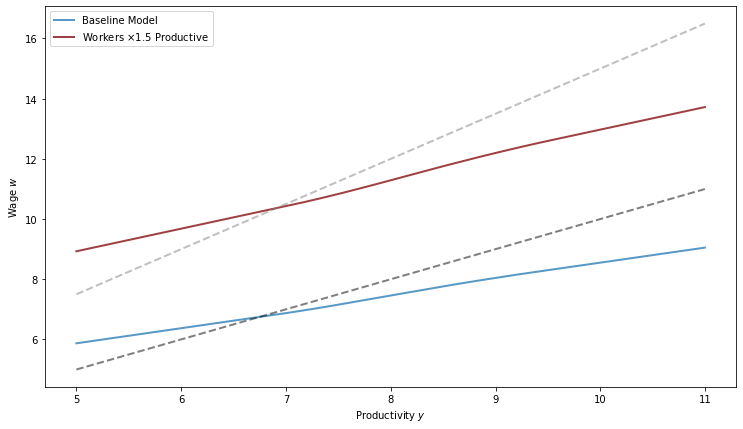

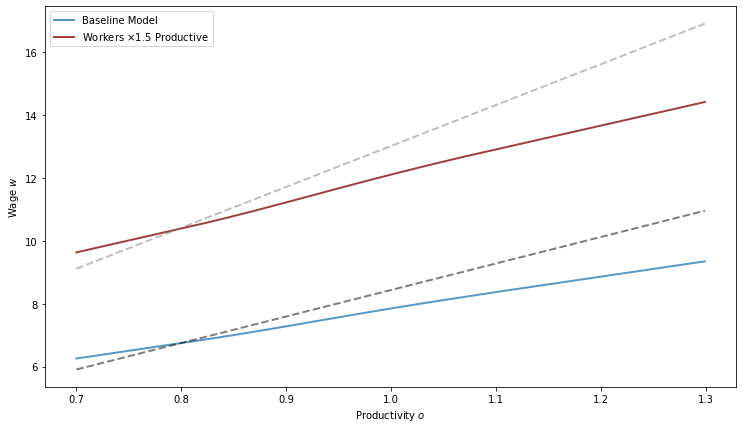

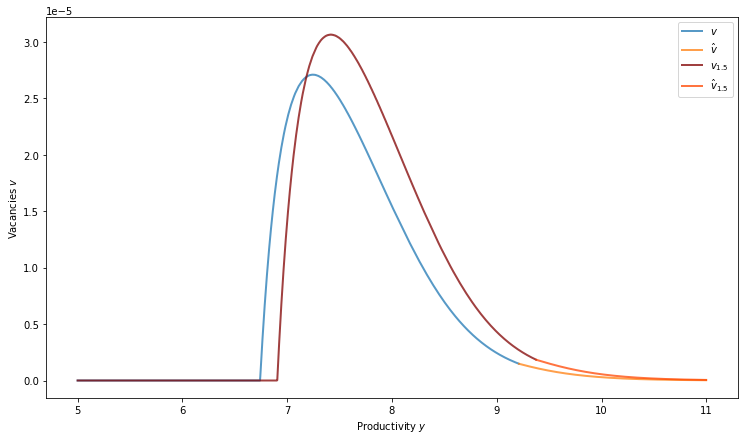

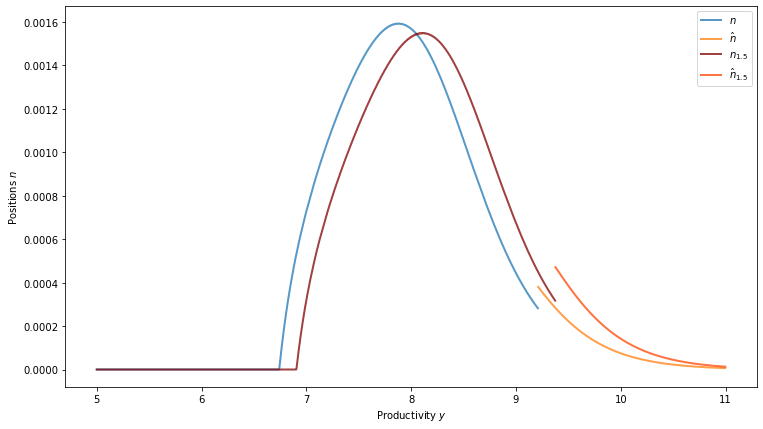

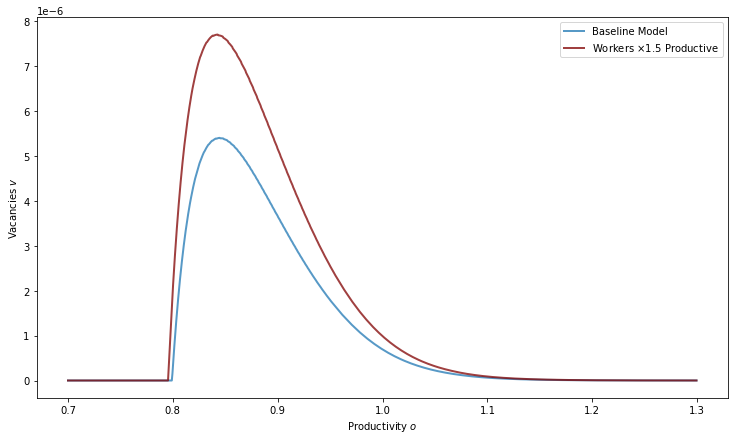

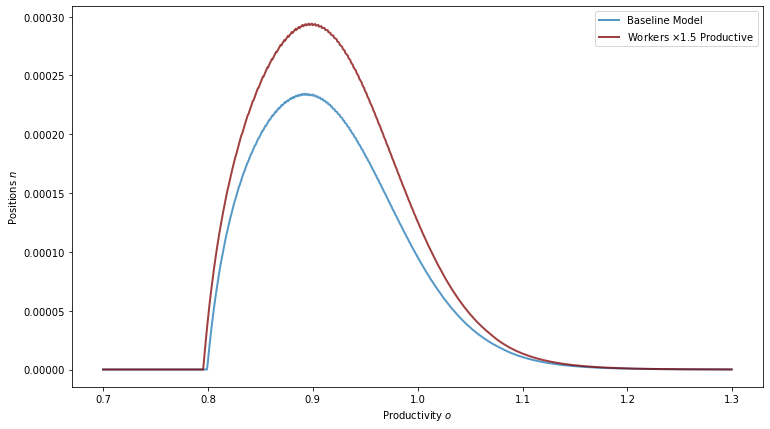

In [12]:
list_facts(ooj, solution, f=f, compare=False)

cdf_comp(ooj, solution, save=save, folder=folder, file=file)

graph_results(ooj, solution, save=save, folder=folder, file=file)

comp_no_outsourcers(ooj, solution, solution_p, solution_ls, solution_ls_p,
                   save=save, f=f, folder=folder, file=file)

comp_full_bargain(ooj, solution, solution_fb, save=save, f=f, folder=folder, file=file)

comp_more_productive(ooj, ooj_mp, solution, solution_mp, mult, save=save, f=f, folder=folder, file=file)

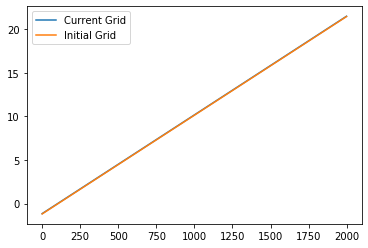

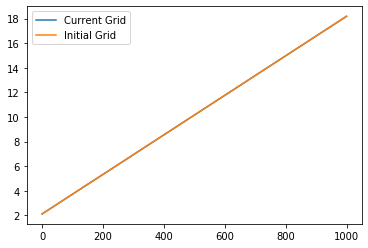

In [6]:
# Plot log c/c_o _grid vs start grids
c_grid_0 = np.exp(x_0[0] + y_grid * x_0[1])
c_o_grid_0 = np.exp(x_0[2] + o_grid * x_0[3])

plt.plot(np.log(c_grid), label = "Current Grid")
plt.plot(np.log(c_grid_0), label= "Initial Grid")
plt.legend()

plt.show()

plt.plot(np.log(c_o_grid), label = "Current Grid")
plt.plot(np.log(c_o_grid_0), label= "Initial Grid")
plt.legend()

plt.show()

In [17]:
%debug

> <ipython-input-14-571c4425a3ae>(1281)comp_no_outsourcers()
   1277         Mean Wages: with {w_grid:.2f}; {w_grid_ls:.2f}
   1278         Worker Welfare: with {w_welfare:.0f}; without {w_welfare_ls:.0f}
   1279         Firm Welfare: with {f_welfare:.0f}; without {f_welfare_ls:.0f}
   1280         Total Welfare: with {tot_welfare:.0f}; without {tot_welfare_ls:.0f}
-> 1281         """)

ipdb> tot_welfare
5204.406436460049
ipdb> tot_welfare_ls
5198.535439359514
ipdb> f_welfare
191.91811750583452
ipdb> f_welfare_ls
202.8648715488852
ipdb> w_welfare
5001.29363097702
ipdb> w_welfare_ls
4995.670567810629
ipdb> c


In [5]:
# Try out initial guess

y_grid = np.linspace(y_min, y_max, y_grid_size, endpoint=False)
o_grid = np.linspace(o_min, o_max, o_grid_size, endpoint=False)

c_grid = np.exp(x_0[0] + x_0[1] * y_grid)
c_o_grid = np.exp(x_0[2] + x_0[3] * o_grid)
xi = x_0[4]
phi = x_0[5]
eta_o = eta * x_0[6]

ooj = OutsourcingOnJob(
    B, b, delta_, delta_o, delta_hat, xi, eta, eta_o, phi, alpha,
    y_min, y_max, y_grid_size, o_min, o_max, o_grid_size,
    gamma, gamma_o, c_grid, c_o_grid, hp
)

(v_grid, v_hat_grid, v_o_grid, n_grid,
 n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p) = find_p(
    ooj, guess_0, p_1_0, p_2_0, tol, max_iter, tol_i, max_iter_i, slow_i, verbose=True, print_skip=5
) 
    
solution = (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p)

list_facts(ooj, solution)

graph_results(ooj, solution)

# solve_given_p, iterate, QD_QS_ED, make_grids, find_y_i, C, c, c_inv, C_o, c_o, c_o_inv, q, ell = operator_factory(ooj)

# (theta, G_grid, G_o_grid, D_grid, D_o_grid,
#          Gamma_U, Gamma_grid, Gamma_o_grid, w_grid, w_o_grid, nu) = make_grids(
#             v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p)

# rm, rm_o = ooj.rm, ooj.rm_o
# y_i = find_y_i(y_hat)

# zeta = np.sum(n_o_grid * rm_o) / (np.sum(n_o_grid * rm_o) + np.sum(n_grid[:y_i] * rm))
# ee_h = np.sum(n_grid[:y_i] * D_grid[:y_i] * rm) / np.sum(n_grid[:y_i] * rm)
# ee_o = np.sum(n_o_grid * D_o_grid * rm_o) / np.sum(n_o_grid * rm_o)
# ee = ((1 - zeta) * ee_h + zeta * ee_o)

# ee - match[4]

NameError: name 'y_min' is not defined

In [39]:
v_o_grid

array([0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 1.40629739e-04, 1.07104896e-03,
       1.94407305e-03, 2.76305469e-03, 3.53111367e-03, 4.25729041e-03,
       4.93387096e-03, 5.56780305e-03, 6.16142835e-03, 6.71694082e-03,
       7.25329271e-03, 7.74086015e-03, 8.19613026e-03, 8.62079702e-03,
      

In [34]:
# Find c_o_more, such that, given a callbriation of the model, if the cost of outsourcing was
# c_o_grid + c_o_more, zeta would equal .01 (as it did in 2001)
# Compare worker outcomes
call_params = pd.read_csv("../../Figures/Python Simulations/Test Calibration 8/Parameter Values.csv")

vals = call_params[["values"]].to_numpy().T[0]
(B, r, delta, delta_o, delta_hat, eta, eta_o, phi, alpha, xi, y_min, y_max, y_grid_size,
 o_min, o_max, o_grid_size, b, gamma, gamma_o, c_0, c_1, c_o_0, c_o_1, xi, alpha,
 _, _, _, _, _, _, _, _) = vals

y_grid_size, o_grid_size = int(y_grid_size), int(o_grid_size)

zeta_target = .03

y_grid = np.linspace(y_min, y_max, y_grid_size, endpoint = False)
o_grid = np.linspace(o_min, o_max, o_grid_size, endpoint = False)

c_grid = np.exp(c_0 + c_1 * y_grid)
c_o_grid_orig = np.exp(c_o_0 + c_o_1 * o_grid)

p_1_0 = y_max - 4
p_2_0 = y_max
tol = 1e-4
max_iter = 25
tol_i = 1e-8
max_iter_i = 1e5
slow_i = 1.5e-1

# Record initial guesses
v_grid_0 = np.ones(y_grid_size) / y_grid_size
n_grid_0 = np.ones(y_grid_size) / y_grid_size
v_hat_grid_0 = np.ones(y_grid_size) / y_grid_size
n_hat_grid_0 = np.ones(y_grid_size) / y_grid_size
v_o_grid_0 = np.ones(o_grid_size) / o_grid_size
n_o_grid_0 = np.ones(o_grid_size) / o_grid_size
y_hat_0 = y_max
R_grid_0 = np.minimum(np.arange(y_grid_size), o_grid_size - 1, dtype=np.int64)
R_o_grid_0 = np.minimum(np.arange(o_grid_size), y_grid_size - 1, dtype=np.int64)

guess_0 = (v_grid_0, v_hat_grid_0, v_o_grid_0, n_grid_0, n_hat_grid_0, n_o_grid_0, y_hat_0, R_grid_0, R_o_grid_0)

guess, p_1, p_2 = np.copy(guess_0), np.copy(p_1_0), np.copy(p_2_0)

def higher_cost(x):

    global guess, p_1, p_2
    
    c_o_more = x[0]

    c_o_grid = c_o_grid_orig + c_o_more

    ooj = OutsourcingOnJob(
        B, b, delta_, delta_o, delta_hat, xi, eta, eta_o, phi, alpha,
        y_min, y_max, y_grid_size, o_min, o_max, o_grid_size,
        gamma, gamma_o, c_grid, c_o_grid, hp
    )

    (v_grid, v_hat_grid, v_o_grid, n_grid,
     n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p) = find_p(
        ooj, guess, p_1, p_2, tol, max_iter, tol_i, max_iter_i, slow_i, False
    )

    guess = (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid)
    p_2, p_1 = p, p + 0.01

    _, _, QD_QS_ED, make_grids, find_y_i, _, _, _, _, _, _, _, ell  = operator_factory(ooj)

    QD, QS, ED = QD_QS_ED(n_hat_grid, n_o_grid, y_hat)

    # If the model does not converge, do not use, reset guess
    if np.abs(ED) > tol:
        print(f"c_o_more {c_o_more:.4f}")
        p_2, p_1 = np.copy(p_2_0), np.copy(p_1_0)

        guess = np.copy(guess_0)
        return np.abs(ED) * 1e10

    (theta, G_grid, G_o_grid, D_grid, D_o_grid, Gamma_U,
     Gamma_grid, Gamma_o_grid, w_grid, w_o_grid, nu) = make_grids(
        v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p
    )

    rm, rm_o = ooj.rm, ooj.rm_o

    y_i = find_y_i(y_hat)

    # Find zeta, compare to data
    n = np.sum(n_grid[:y_i] * rm)
    n_o = np.sum(n_o_grid * rm_o)
    zeta = n_o / (n_o + n)
    err = np.abs(zeta - zeta_target)

    print(f"zeta {zeta:.3f}; c_o_more {c_o_more:.4f}")

    return err

In [ ]:
# Find minimum
# method = "Nelder-Mead"
method = "Powell"

if method == "Powell":
    result_more = minimize(higher_cost, x0=50, method=method, options={"maxiter":10, "disp":True})
if method == "Nelder-Mead":
    result_more = minimize(higher_cost, x0=50, method=method, options={"maxiter":10, "disp":True})
#     result = minimize(higher_cost, x0=0, method=method, options={"maxiter":200, "disp":True})
    
result_more

Converged in 10 iterations, Excess Demand is 0.0000; price is 7.9342; QS is 0.0296; QD is 0.0297
zeta 0.054; c_o_more 50.0000
Converged in 1 iterations, Excess Demand is 0.0000; price is 7.9346; QS is 0.0296; QD is 0.0297
zeta 0.054; c_o_more 50.0000
Converged in 1 iterations, Excess Demand is 0.0000; price is 7.9353; QS is 0.0296; QD is 0.0296
zeta 0.053; c_o_more 51.0000
Converged in 1 iterations, Excess Demand is 0.0000; price is 7.9365; QS is 0.0295; QD is 0.0295
zeta 0.053; c_o_more 52.6180
Converged in 2 iterations, Excess Demand is 0.0000; price is 7.9665; QS is 0.0268; QD is 0.0269
zeta 0.048; c_o_more 103.6458
Converged in 2 iterations, Excess Demand is -0.0000; price is 8.0040; QS is 0.0239; QD is 0.0239
zeta 0.043; c_o_more 186.2106
Converged in 1 iterations, Excess Demand is -0.0000; price is 8.0392; QS is 0.0214; QD is 0.0214
zeta 0.038; c_o_more 287.7805
Converged in 2 iterations, Excess Demand is -0.0000; price is 8.0821; QS is 0.0188; QD is 0.0187
zeta 0.033; c_o_more 4

zeta 0.030; c_o_more 593.1401


In [24]:
# Run this
higher_cost(0)

Converged in 10 iterations, Excess Demand is -0.0001; price is 7.8943; QS is 0.0336; QD is 0.0336
zeta 0.061; c_o_more 0.0000


0.05124890372698395

In [29]:
%debug

> <ipython-input-25-373678f050de>(91)higher_cost()
     89     err = zeta - zeta_target
     90 
---> 91     print(f"zeta {zeta:.3f}; c_o_more {x:.4f}")
     92 
     93     return err

ipdb> x
array([0.])
ipdb> print(f"zeta {zeta:.3f}; c_o_more {x:.4f}")
*** TypeError: unsupported format string passed to numpy.ndarray.__format__
ipdb> print(f"zeta {zeta:.3f}; c_o_more {x[0]:.4f}")
zeta 0.061; c_o_more 0.0000
ipdb> c


In [41]:
# Set up code for the outsourcer's problem with on-the-job search
# Builds on Outsourcers file
# This block of code separates v_grid of hiring from v_hat_grid of outsourcing
# This block uses the false position method to update p

import numpy as np
import matplotlib.pyplot as plt
import quantecon as qe
from numba import njit, jitclass, int64, float64
from interpolation import interp
from IPython.core.debugger import set_trace
from scipy.optimize import minimize

# Set up parameter space
ooj_parameters = [
    ("B", float64),
    ("r", float64),
    ("b", float64),
    ("delta", float64),
    ("delta_o", float64),
    ("delta_hat", float64),
    ("xi", float64),
    ("eta", float64),
    ("eta_o", float64),
    ("phi", float64),
    ("y_grid", float64[:]),
    ("y_grid_size", int64),
    ("y_min", float64),
    ("y_max", float64),
    ("rm", float64),
    ("o_grid", float64[:]),
    ("o_grid_size", int64),
    ("o_min", float64),
    ("o_max", float64),
    ("rm_o", float64),
    ("phi", float64),
    ("gamma", float64),
    ("k_grid", float64[:]),
    ("gamma_o", float64),
    ("k_o_grid", float64[:])    
]

@jitclass(ooj_parameters)
class OutsourcingOnJob:
    """
    B is discount rate beta
    r is interest rate defined by beta
    b is home production
    delta is job loss rate at firm
    delta_o is job loss rate at outsourcer
    delta_hat is firm destruction rate of outsourcing firm <= delta
    xi is probability of searching on-the-job
    eta is workers bargaining power with firm
    eta_o is workers bargaining power with outsourcer
    phi is effectiveness of matching function
    y_min, y_max, y_grid_size determine firm productivity grid
    rm is to Reimann Sum approximate firm integrals
    o_min, o_max, o_grid_size determine outsourcer productivity grid
    rm_o is to Reimann Sum approximate outsourcer integrals
    gamma is steepness of marginal cost, 
    k_grid is level of entry cost
    gamma_h is steepness of marginal cost for outsourcers, 
    k_o_grid is level of cost
    """
    def __init__(
        self, B, b, delta, delta_o, delta_hat, xi, eta, eta_o, phi,
        y_min, y_max, y_grid_size, o_min, o_max, o_grid_size,
        gamma, gamma_o, k_grid, k_o_grid
    ):
        
        self.B, self.b, self.delta, self.eta, self.gamma, self.k_grid = B, b, delta, eta, gamma, k_grid
        self.delta_hat, self.eta_o, self.gamma_o, self.k_o_grid = delta_hat, eta_o, gamma_o, k_o_grid 
        self.xi, self.delta_o = xi, delta_o
        self.r = 1 / B - 1
        
#         self.y_grid = np.linspace(y_min, y_max, y_grid_size, endpoint = False)
        self.y_grid = np.linspace(y_min, y_max, y_grid_size)
        self.y_grid_size, self.y_min, self.y_max = y_grid_size, y_min, y_max    
        self.rm = (y_max - y_min) / y_grid_size
        
#         self.o_grid = np.linspace(o_min, o_max, o_grid_size, endpoint = False)
        self.o_grid = np.linspace(o_min, o_max, o_grid_size)
        self.o_grid_size, self.o_min, self.o_max = o_grid_size, o_min, o_max    
        self.rm_o = (o_max - o_min) / o_grid_size
        
        self.phi = phi
#         self.q = njit(lambda x: min(phi * x**(-1 / 2), 1))
#         self.ell = njit(lambda x: min(phi * x**(1 / 2), 1))
#         # Remember, q_p and p_p = 0 if q or p = 1
#         self.q_p = njit(lambda x: -phi / 2 * x**(-3 / 2) * (phi * x**(-1 / 2) < 1)) 
#         self.ell_p = njit(lambda x: phi / 2 * x**(1 / 2) * (phi * x**(1 / 2) < 1))


# Set up neccesary functions
def operator_factory(ooj):
    
    r, b, delta, eta, gamma, k_grid = ooj.r, ooj.b, ooj.delta, ooj.eta, ooj.gamma, ooj.k_grid
    delta_hat, eta_o, gamma_o, k_o_grid = ooj.delta_hat, ooj.eta_o, ooj.gamma_o, ooj.k_o_grid
    xi, delta_o = ooj.xi, ooj.delta_o
    phi = ooj.phi
    
    y_grid, y_grid_size, rm = ooj.y_grid, ooj.y_grid_size, ooj.rm
    o_grid, o_grid_size, rm_o = ooj.o_grid, ooj.o_grid_size, ooj.rm_o
    
    
    @njit()
    def q(theta):
        return min(phi * theta**(-1 / 2), 1)
    
    @njit()
    def ell(theta):
        return min(phi * theta**(1 / 2), 1)
    
    # Want cost of vacancy, marginal cost of vacancy, and inverse marginal cost of vacancy
    @njit()
    def C(v_grid):
        return k_grid * v_grid**gamma
    
    @njit()
    def c(v_grid):
        return k_grid * gamma * v_grid**(gamma - 1)

    @njit()
    def c_inv(c_grid):
        return (np.maximum(c_grid, 0) / (gamma * k_grid))**(1 / (gamma - 1))
        
    # Do the same for outsourcers
    @njit()
    def C_o(v_o_grid):
        return k_o_grid * v_o_grid**gamma_o

    @njit()
    def c_o(v_o_grid):
        return k_o_grid * gamma_o * v_o_grid**(gamma_o - 1)

    @njit()
    def c_o_inv(c_o_grid):
        return (np.maximum(c_o_grid, 0) / (gamma_o * k_o_grid))**(1 / (gamma_o - 1))
    
    # Given a continuous y_hat, find the nearest y_i
    @njit()
    def find_y_i(y_hat):
        return np.argmin(np.abs(y_hat - y_grid))
    
    # Given v_grid, v_o_grid, n_grid,
    # n_o_grid, y_hat, R_grid, R_o_grid, and p, find
    # Firms who directly hire hire vs those that outsource out
    # Market tightness theta
    # Distribution of vacanices F and F_o
    # Distribution of job seekers G and G_o
    # Probability of worker leaving D and D_o
    # Wages w and w_o
    @njit()
    def make_grids(v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p):    
        
        y_i = find_y_i(y_hat)
        
        # Make this here, but useful for F and G below
        n_temp = np.copy(n_grid)
        n_temp[y_i:] = 0
        
        cum_v = np.cumsum(v_grid * rm)
        cum_v_o = np.cumsum(v_o_grid * rm_o)
        cum_n = np.cumsum(n_temp * rm)
        cum_n_o = np.cumsum(n_o_grid * rm_o)
        
        # Define aggregate populations (make sure all exist)
        u = max(1 - cum_n[-1] - cum_n_o[-1], 1e-9)
        v = max(cum_v[-1], 1e-9)
        v_o = max(cum_v_o[-1], 1e-9)
        s = u + xi * (cum_n[-1] + cum_n_o[-1])
        
        # Calculate theta and pi 
        v_sum = v + v_o
        theta = v_sum / s
        pi = v_o / v_sum
        
        # Calculate distributions 
        # F is distribution of vacancies (include firms above y_hat in cdf as 1)
        F_grid = np.minimum(cum_v / v, 1)
        f_grid = v_grid / v
        f_grid[y_i:] = 0
        
        F_o_grid = cum_v_o / v_o
        f_o_grid = v_o_grid / v_o
        
        # G is distribution of job seekers (include firms above y_hat as bigger than all y firms)        
        G_grid = (u + xi * (cum_n + cum_n_o[R_grid])) / s
        G_o_grid = (u + xi * (cum_n[R_o_grid] + cum_n_o)) / s
        
        # D is probability a worker finds a better job
        D_grid = xi * ell(theta) * (1 - (1 - pi) * F_grid - pi * F_o_grid[R_grid]) 
        D_o_grid = xi * ell(theta) * (1 - (1 - pi) * F_grid[R_o_grid] - pi * F_o_grid) 
        
        # What is the value of search?
        # Store these vectors of values which will be used many times
        f_tot = c(v_grid) / G_grid * f_grid * rm
        o_tot = c_o(v_o_grid) / G_o_grid * f_o_grid * rm_o
        i_cum_f = np.cumsum(f_tot[::-1])[::-1]
        i_cum_o = np.cumsum(o_tot[::-1])[::-1]
        
        # For unemployed
        firm = eta / (1 - eta) * (1 - pi) * i_cum_f[0]
        out = eta_o / (1 - eta_o) * pi * i_cum_o[0]
        Gamma_U = ell(theta) / q(theta) * (firm + out)
        
        # For employed at a firm
        firm = eta / (1 - eta) * (1 - pi) * i_cum_f
        out = eta_o / (1 - eta_o) * pi * i_cum_o[R_grid]
        Gamma_grid = ell(theta) / q(theta) * (firm + out)
        
        # For employed at an outsourcer
        firm = eta / (1 - eta) * (1 - pi) * i_cum_f[R_o_grid]
        out = eta_o / (1 - eta_o) * pi * i_cum_o
        Gamma_o_grid = ell(theta) / q(theta) * (firm + out)
        
        # Find wages
        w_grid = eta * y_grid + (1 - eta) * (b + Gamma_U - (1 - delta) * xi * Gamma_grid) 
        w_o_grid = eta_o * p * o_grid + (1 - eta_o) * (b + Gamma_U - (1 - delta_o) * xi * Gamma_o_grid) 
        
        return (
            theta, G_grid, G_o_grid, D_grid, D_o_grid, 
            Gamma_U, Gamma_grid, Gamma_o_grid, w_grid, w_o_grid
        )
    
    # Given v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
    # n_o_grid, y_hat, R_grid, R_o_grid, and p, find new values
    @njit()
    def iterate(v_grid, v_hat_grid, v_o_grid, n_grid,
                n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p):
        
        (theta, G_grid, G_o_grid, D_grid, D_o_grid,
         Gamma_U, Gamma_grid, Gamma_o_grid, w_grid, w_o_grid) = make_grids(
            v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p)
        
        # Value of firms
        J_hire = q(theta) * G_grid * (y_grid - w_grid) / (r + delta + (1 - delta) * D_grid)
        J_out = (y_grid - p) / (r + delta_hat)
        
        # Update y_hat by finding firm closest to indifferent between hiring/outsourcing
        # Make sure J_out is non_negative at y_hat
        y_diff = np.argmin(np.abs(J_out - J_hire))
        y_zero = np.argmin(np.abs(J_out))
        y_hat_new = y_grid[max(y_diff, y_zero)]
        
        # Update vacancies
        # Hiring firms (below y_hat)
        v_grid_new = c_inv(J_hire)
        
        # Outsourcing firms (above y_hat)
        v_hat_grid_new = c_inv(J_out)
        
        # Outsourcers
        v_o_grid_new = c_o_inv(
            (o_grid * p - w_o_grid) * q(theta) * G_o_grid / (r + delta_o + (1 - delta_o) * D_o_grid)
        )
        
        # Update positions
        # Hiring firms
        n_grid_new = (1 - delta) * (1 - D_grid) * n_grid + q(theta) * G_grid * v_grid_new
        
        # Outsourcing firms
        n_hat_grid_new = (1 - delta_hat) * n_hat_grid + v_hat_grid_new
        
        # Outsourcers
        n_o_grid_new = (1 - delta_o) * (1 - D_o_grid) * n_o_grid + q(theta) * G_o_grid * v_o_grid_new
               
        # Update R_grid and R_o_grid by comparing W - U to W_o - U.
        # Note that R_grid is defined for all firms, even those above 
        # y_hat, and R_o_grid might be indiffeferent to a firm above y_hat that doesn't hire
        # Value of employment at a firm (minus value of unemployment)        
        W_min_U = (
            (1 + r) * (w_grid - b - Gamma_U + (1 - delta) * xi * Gamma_grid)
            / (r + delta + (1 - delta) * D_grid)
        )
        
        # Value of employment at an outsourcer (minus value of unemployment)
        W_o_min_U = (
            (1 + r) * (w_o_grid - b - Gamma_U + (1 - delta_o) * xi * Gamma_o_grid)
            / (r + delta_o + (1 - delta_o) * D_o_grid)
        )

        # Use these and search sorted to find new indecision rules (make sure not above all)
        R_grid_new = np.minimum(np.searchsorted(W_o_min_U, W_min_U), o_grid_size - 1)
    
        R_o_grid_new = np.minimum(np.searchsorted(W_min_U, W_o_min_U), y_grid_size - 1)
        
        return (v_grid_new, v_hat_grid_new, v_o_grid_new, n_grid_new,
                n_hat_grid_new, n_o_grid_new, y_hat_new, R_grid_new, R_o_grid_new)
    
    # Given n_grid, n_o_grid, and y_hat find excess demand for outsourcing 
    @njit()
    def QD_QS_ED(n_hat_grid, n_o_grid, y_hat):
        y_i = find_y_i(y_hat)
        QD = np.sum(n_hat_grid[y_i:] * rm) 
        QS = np.sum(n_o_grid * o_grid * rm_o)
        ED = QD - QS
        return QD, QS, ED

    @njit()
    def solve_given_p(
        p, v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
        n_o_grid, y_hat, R_grid, R_o_grid, tol, max_iter, slow
    ):

        # Set up initial loop parameters
        i = 0
        err = tol + 1    

        # Update v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, and R_o_grid
        while i < max_iter and err > tol:
            (v_grid_new, v_hat_grid_new, v_o_grid_new, n_grid_new,
                    n_hat_grid_new, n_o_grid_new, y_hat_new, R_grid_new, R_o_grid_new) = iterate(
                v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p
            )
            err_v_t = np.max(np.abs(v_grid_new - v_grid))
            err_v_h = np.max(np.abs(v_hat_grid_new - v_hat_grid))
            err_v_o = np.max(np.abs(v_o_grid_new - v_o_grid))
            err_n_t = np.max(np.abs(n_grid_new - n_grid))
            err_n_h = np.max(np.abs(n_hat_grid_new - n_hat_grid))
            err_n_o = np.max(np.abs(n_o_grid_new - n_o_grid))
            err = max(err_v_t, err_v_h, err_v_o, err_n_t, err_n_h, err_n_o)
            i += 1

            v_grid = slow * v_grid_new + (1 - slow) * v_grid
            v_hat_grid = slow * v_hat_grid_new + (1 - slow) * v_hat_grid
            v_o_grid = slow * v_o_grid_new + (1 - slow) * v_o_grid
            n_grid = slow * n_grid_new + (1 - slow) * n_grid
            n_hat_grid = slow * n_hat_grid_new + (1 - slow) * n_hat_grid
            n_o_grid = slow * n_o_grid_new + (1 - slow) * n_o_grid
            y_hat = slow * y_hat_new + (1 - slow) * y_hat 

            # To slowly adjust y_hat, R_grid, and R_o_grid (which are indexes), instead 
            # add/subtract by 1 if greater/less 
            R_grid = R_grid + 1 * (R_grid_new > R_grid) - 1 * (R_grid_new < R_grid)
            R_o_grid = R_o_grid + 1 * (R_o_grid_new > R_o_grid) - 1 * (R_o_grid_new < R_o_grid)     

        return (
            v_grid_new, v_hat_grid_new, v_o_grid_new, n_grid_new,
            n_hat_grid_new, n_o_grid_new, y_hat_new, R_grid_new, R_o_grid_new
        )        
    
    return solve_given_p, iterate, QD_QS_ED, make_grids, find_y_i, C, c, c_inv, C_o, c_o, c_o_inv, q, ell 

# Find p
def find_p(
    ooj, guess, p_low, p_high, tol, max_iter, tol_i, max_iter_i, slow_i, verbose=False, print_skip=5
):
    
    solve_given_p, _, QD_QS_ED, _, _, _, _, _, _, _, _, _, _ = operator_factory(ooj)
    
    # Find excess_demand for p_low and p_high, make sure they have opposite signs
    for p in [p_high, p_low]:
        
#         qe.tic()
        
        # Initial guesses
        (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid) = guess
        
#         set_trace()
        
        (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
         n_o_grid, y_hat, R_grid, R_o_grid) = solve_given_p(
            p, v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
            n_o_grid, y_hat, R_grid, R_o_grid, tol=tol_i, max_iter=max_iter_i, slow=slow_i
        )
        
        QD, QS, ED = QD_QS_ED(n_hat_grid, n_o_grid, y_hat)
        
        if p == p_low:
            ED_low = ED
        else:
            ED_high = ED
            
#         qe.toc()
        
        if verbose:
            print(f'Excess Demand for price {p} is {ED:.4f}; QS is {QS:.4f}; QD is {QD:.4f}')
            
            
    if ED_low < 0:
        print('Test failed, low price has negative excess demand')
    if ED_high > 0:
        print('Test failed, high price has positive excess demand')
        
        return
    
    # Reset initial guess
    (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid) = guess
    
#     set_trace()
    
    # Set up loop parameters    
    err = tol + 1
    j = 0
        
    while err > tol and j < max_iter:
        
#         qe.tic()
        
        # Update p using false position method (line between points intersects 0) 
        p = (p_low * ED_high - p_high * ED_low) / (ED_high - ED_low) 
              
        (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
         n_o_grid, y_hat, R_grid, R_o_grid) = solve_given_p(
            p, v_grid, v_hat_grid, v_o_grid, n_grid,
            n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, tol_i, max_iter_i, slow_i
        )
        
        QD, QS, ED = QD_QS_ED(n_hat_grid, n_o_grid, y_hat)
        err = np.abs(ED)
        
#         qe.toc()
        
        # If excess demand QD - QS > 0, set p_low = p and ED_low = ED, otherwise p_high = p and ED_jogh = ED
        if ED > 0:
            p_low = p
            ED_low = ED
        else:
            p_high = p
            ED_high = ED
            
        if verbose and j % print_skip == 0:
            print(
                f'Excess Demand at iter {j} is {ED:.4f}; price is {p:.4f}; QS is {QS:.4f}; QD is {QD:.4f}',
                f"y_hat is {y_hat:.4f}"
            )
            
        j += 1
    
    if j < max_iter:
        print(f'Converged in {j} iterations, Excess Demand is {ED:.4f};',
              f' price is {p:.4f}; QS is {QS:.4f}; QD is {QD:.4f}')
    if j == max_iter:
        print(f'Failed to Converge. Excess Demand is {ED:.4f}; price is {p:.4f};',
              f' QS is {QS:.4f}; QD is {QD:.4f}')
        
    return v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p

# Create a function to graph results
def graph_results(ooj, v_grid, v_hat_grid, v_o_grid, n_grid,
                  n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p,
                  save=False, height=7, 
                  folder=r'C:\Users\spspi\Dropbox\Documents\Outsourcing\Figures\Python Simulations\Test',
                  file=r'\Outsourcers OJS '):
    
    # Make sure dimensions are 1:1.77 (or 1:1.62)
    width = height * 1.77    
#     width = height * 1.62
    
    # Get data needed from ooj
    _, _, QD_QS_ED, make_grids, find_y_i, C, c, c_inv, C_o, c_o, c_o_inv, q, ell = operator_factory(ooj)
    
    (theta, G_grid, G_o_grid, D_grid, D_o_grid, Gamma_U,
     Gamma_grid, Gamma_o_grid, w_grid, w_o_grid) = make_grids(
        v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p
    )
    r, delta, xi = ooj.r, ooj.delta, ooj.xi
    delta_o, delta_hat = ooj.delta_o, ooj.delta_hat
    rm, rm_o = ooj.rm, ooj.rm_o
    y_grid, o_grid = ooj.y_grid, ooj.o_grid
    y_grid_size, o_grid_size = ooj.y_grid_size, ooj.o_grid_size
    
    y_i = find_y_i(y_hat)
        
    # Graph firm wages vs productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, w_grid, alpha=0.75)
    ax.plot(y_grid, y_grid, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $y$", ylabel="Wage $w$")
    
    if save:
        fig.savefig(folder + file + 'Firm Wages v Productivity.pdf')
    else:
        plt.show()  
        
    # Graph outsourcer wages vs productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, w_o_grid, alpha=0.75)
    ax.plot(o_grid, o_grid * p, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $o$", ylabel="Wage $w_o$")
    
    if save:
        fig.savefig(folder + file + 'Outsourcer Wages v Productivity.pdf')
    else:
        plt.show() 
        
    # Graph vacacies by wage
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid[:y_i], v_grid[:y_i], alpha=0.75, label="Firms")
    ax.plot(w_o_grid, v_o_grid, alpha=0.75, label="Outsourcers")
    ax.set(xlabel="Wage $w$", ylabel="Vacancies $v$")
    ax.legend(loc="upper left")
    
    if save:
        fig.savefig(folder + file + 'Vacancies v Wages.pdf')
    else:
        plt.show()         
    
    # Graph filled posititions by wage
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid[:y_i], n_grid[:y_i], alpha=0.75, label="Firms")
    ax.plot(w_o_grid, n_o_grid, alpha=0.75, label="Outsourcers")
    ax.set(xlabel="Wage $w$", ylabel="Positions $n$")
    ax.legend(loc="upper left")
    
    if save:
        fig.savefig(folder + file + 'Positions v Wages.pdf')
    else:
        plt.show() 
        
    # Graph firm vacancies by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, v_grid, alpha=0.75, label=r"Hiring Vacancies ${v}$")
    ax.plot(y_grid, v_hat_grid, alpha=0.75, label=r"Outsourcing Vacancies $\hat{v}$")
    ax.axvline(x=y_hat, c='k', lw=1, linestyle=':', alpha=0.6)
    ax.set(xlabel="Productivity $y$", ylabel="Vacancies")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Firm Vacancies.pdf')
    else:
        plt.show()
        
    # Graph firm postions by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, n_grid, alpha=0.75, label=r"Hiring Positions ${n}$")
    ax.plot(y_grid, n_hat_grid, alpha=0.75, label=r"Outsourcing Positions $\hat{n}$")
    ax.axvline(x=y_hat, c='k', lw=1, linestyle=':', alpha=0.6)
    ax.set(xlabel="Productivity $y$", ylabel="Positions")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Firm Positions.pdf')
    else:
        plt.show()
        
    # Graph outsourcer vacancies and filled positions by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, v_o_grid, alpha=0.75, label=r"Vacanicies $\tilde{v}$")
    ax.set(xlabel="Productivity $o$", ylabel="Vacancies")
    
    if save:
        fig.savefig(folder + file + 'Outsourcer Vacancies.pdf')
    else:
        plt.show()
        
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, n_o_grid, alpha=0.75, label=r"Positions $\tilde{n}$")
    ax.set(xlabel="Productivity $o$", ylabel="Positions")
    
    if save:
        fig.savefig(folder + file + 'Outsourcer Positions.pdf')
    else:
        plt.show()
        
    # Graph median tenure by wage
    p_stay = (1 - delta) * (1 - D_grid)
    median_tenure = np.log(.5) / np.log(p_stay)
    p_o_stay = (1 - delta_o) * (1 - D_o_grid)
    median_tenure_o = np.log(.5) / np.log(p_o_stay)
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid[:y_i], median_tenure[:y_i], alpha=0.75, label="Firms")
    ax.plot(w_o_grid, median_tenure_o, alpha=0.75, label="Outsourcers")
    ax.set(xlabel="Wage", ylabel="Median Tenure")
    ax.legend(loc="upper left")
    
    if save:
        fig.savefig(folder + file + 'Median Tenure.pdf')
    else:
        plt.show()
        
    # Graph firings (lose jobs) vs quits (find better job) by wage
    firings = delta * n_grid
    quits = (1 - delta) * D_grid * n_grid
    firings_o = delta_o * n_o_grid_p
    quits_o = (1 - delta_o) * D_o_grid * n_o_grid_p
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid[:y_i], firings[:y_i], alpha=0.75, label="Firm Firings")
    ax.plot(w_grid[:y_i], quits[:y_i], alpha=0.75, label="Firm Quits")
    ax.plot(w_o_grid, firings_o, alpha=0.75, label="Outsourcer Firings")
    ax.plot(w_o_grid, quits_o, alpha=0.75, label="Outsourcer Quits")
    ax.set(xlabel="Wage", ylabel="Number")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Firings and Quits.pdf')
    else:
        plt.show()
        
    # Graph the marginal value of a worker to each firm and marginal cost of aquiring one.
    # Do the same for outsourcers hiring
    J_hire = q(theta) * G_grid * (y_grid - w_grid) / (r + delta + (1 - delta) * D_grid)
    mc = c(v_grid)   
    
    J_out = (y_grid - p) / (r + delta_hat) 
    mc_hat = c(v_hat_grid) 
    
    O = q(theta) * G_o_grid * (p * o_grid - w_o_grid) / (r + delta_o + (1 - delta_o) * D_o_grid)
    mc_o = c_o(v_o_grid) 
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, J_hire, alpha=0.75, label="Hiring Firm Marginal Value")
    ax.plot(y_grid[y_i:], J_out[y_i:], alpha=0.75, label="Outsourcing Firm Marginal Value")
    ax.plot(y_grid, mc, alpha=0.75, label="Hiring Firm Marginal Cost")
    ax.plot(y_grid, mc_hat, alpha=0.75, label="Outsourcing Firm Marginal Cost")
    ax.plot(o_grid, O, alpha=0.75, label="Outsourcer Marginal Value")
    ax.plot(o_grid, mc_o, alpha=0.75, label="Outsourcer Marginal Cost")
    ax.set(xlabel="Productivity", ylabel="Value")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + 'M Value and Cost.pdf')
    else:
        plt.show()
        
    # Plot the differences from the above curves
    J_hire_diff = J_hire - mc
    J_out_diff = J_out - mc_hat
    O_diff = O - mc_o
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[:y_i][v_grid[:y_i] > 0],
            J_hire_diff[:y_i][v_grid[:y_i] > 0], alpha=0.75, label="Hiring Firm Diff")
    ax.plot(y_grid[y_i:], J_out_diff[y_i:], alpha=0.75, label="Outsourcing Firm Diff")
    ax.plot(o_grid[v_o_grid > 0], O_diff[v_o_grid > 0], alpha=0.75, label="Outsourcer Diff")
    ax.set(xlabel="Productivity $y$", ylabel="Difference")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + 'M Value Minus Cost.pdf')
    else:
        plt.show()
        
    # Plot the workers' indifference curve for hired vs outsourced
    o_R_grid = o_grid[R_grid]
    y_R_o_grid = y_grid[R_o_grid]
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, o_R_grid, alpha=0.75, label="Firm Indifference")
    ax.plot(y_R_o_grid, o_grid, alpha=0.75, label="Outsourcer Indifference")    
    ax.set(xlabel="Productivity $y$", ylabel="Productivity $o$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + "Worker's Indifference Curve.pdf")
    else:
        plt.show()
        
    # Plot various distribributions for the firm
    v = np.sum(v_grid[:y_i] * rm)
    F_grid = np.minimum(np.cumsum(v_grid * rm) / v, 1)
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, F_grid, alpha=0.75, label=r"$F$")  
    ax.plot(y_grid, G_grid, alpha=0.75, label=r"$G$") 
    ax.plot(y_grid, D_grid / (xi * ell(theta)), alpha=0.75, label=r"$D$")  
    ax.set(xlabel="Productivity $y$", ylabel="Distribution/Probability")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + "Firm Distributions.pdf")
    else:
        plt.show()
        
    # Plot various distribributions for the outsourcer
    v_o = np.sum(v_o_grid * rm_o)
    F_o_grid = np.cumsum(v_o_grid * rm_o) / v_o
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, F_o_grid, alpha=0.75, label=r"$\tilde{F}$")  
    ax.plot(o_grid, G_o_grid, alpha=0.75, label=r"$\tilde{G}$") 
    ax.plot(o_grid, D_o_grid / (xi * ell(theta)), alpha=0.75, label=r"$\tilde{D}$")  
    ax.set(xlabel="Productivity $y$", ylabel="Distribution/Probability")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + "Outsourcer Distributions.pdf")
    else:
        plt.show()
        
    # Graph value of search by wage
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid, Gamma_grid, alpha=0.75, label="Firms")
    ax.plot(w_o_grid, Gamma_o_grid, alpha=0.75, label="Outsourcers")
    ax.set(xlabel="Wage $w$", ylabel="Value of Serach")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Value of Search.pdf')
    else:
        plt.show()
        
# Create a function to print some facts that are useful
def list_facts(ooj, v_grid, v_hat_grid, v_o_grid, n_grid,
               n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p, f=None):
    
    _, _, QD_QS_ED, make_grids, find_y_i, C, c, c_inv, C_o, c_o, c_o_inv, q, ell = operator_factory(ooj)
    
    (theta, G_grid, G_o_grid, D_grid, D_o_grid, Gamma_U,
     Gamma_grid, Gamma_o_grid, w_grid, w_o_grid) = make_grids(
        v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p
    )
    
    delta, xi = ooj.delta, ooj.xi
    rm, rm_o = ooj.rm, ooj.rm_o
    y_grid, o_grid = ooj.y_grid, ooj.o_grid
    
    y_i = find_y_i(y_hat)
    
    print(f"The indifferent firm is y_hat = {y_hat:.2f}$. Price of outsourcing is {p:.2f}.")
    
    u = 1 - np.sum(n_grid[:y_i] * rm) - np.sum(n_o_grid * rm_o) 
    pi = np.sum(v_o_grid * rm_o) / (np.sum(v_grid[:y_i] * rm) + np.sum(v_o_grid * rm_o))
    zeta = np.sum(n_o_grid * rm_o) / (np.sum(n_grid[:y_i] * rm) + np.sum(n_o_grid * rm_o))
    e_delta = (1 - zeta) * delta + zeta * delta_o 
    u_lom = e_delta / (e_delta + ell(theta))
    tot_v = np.sum(v_grid[:y_i] * rm) + np.sum(v_o_grid * rm_o)
    
    print(f"Unemployment is {u * 100:.2f}. According to LoM, should be {u_lom * 100:.2f}")
    print(f"Workers match with probability {ell(theta) * 100:.2f}.",
          f"Firms/Outsourcers match with probability {q(theta) * 100:.2f}")
    print(f"Total vacancies searching for workers are {tot_v:.4f}. Theta is {theta:.4f}")
    print(f"{pi * 100:.0f} percent of vacancies searching for workers are from outsourcers,",
          f"{zeta * 100:.0f} percent of postions outsourced")
    
    # Document ue rate, ee rate, and percent of jobs from unemployment
    ue = ell(theta)
    ee = (
        (np.sum(n_grid[:y_i] * D_grid[:y_i] * rm) / np.sum(n_grid[:y_i] * rm) + 
         np.sum(n_o_grid * D_o_grid * rm_o) / np.sum(n_o_grid * rm_o))
    )
    per_from_u = 100 * ue * u / (ue * u + ee * (1 - u))
    print(f"The ue rate is {ue:.4f}, the ee rate is {ee:.4f},",
          f" and {per_from_u:0f} of new jobs are from unemployment")  
                       
    # Do firm/outsourcer vacancies and positions line up in steady state?
    n_ss = v_grid * q(theta) * G_grid / (delta + D_grid - delta * D_grid)
    err = max(np.abs(n_ss - n_grid))
    err_at = np.argmax(np.abs(n_ss - n_grid))
    
    n_ss_hat = v_hat_grid / delta_hat
    err_hat = max(np.abs(n_ss_hat - n_hat_grid))
    err_hat_at = np.argmax(np.abs(n_ss_hat - n_hat_grid))
    
    n_o_ss = v_o_grid * q(theta) * G_o_grid / (delta_o + D_o_grid - delta_o * D_o_grid)
    err_o = max(np.abs(n_o_ss - n_o_grid))
    err_o_at = np.argmax(np.abs(n_o_ss - n_o_grid))
    
    print(
        "Checking if vacancies + LoM imply right positions:\n",
         f"Hiring firms largest error = {err:.6f} at position {err_at} \n",
         f"Outsourcing firms largest error = {err_hat:.6f} at position {err_hat_at}\n",
         f"Outsourcer largest error = {err_o:.6f} at position {err_o_at}"
    )  
    
    # If want to save everything in an output file
    if f is not None:
        f.write(f"""
        Some facts about the model: \n
        The indifferent firm is y_hat = {y_hat:.2f}$. Price of outsourcing is {p:.2f}. \n
        Unemployment is {u * 100:.2f}. According to LoM, should be {u_lom * 100:.2f} \n
        Workers match with probability {ell(theta) * 100:.2f}. \n
        Firms/Outsourcers match with probability {q(theta) * 100:.2f} \n
        Total vacancies searching for workers are {tot_v:.4f}. Theta is {theta:.4f} \n
        {pi * 100:.0f} percent of vacancies searching for workers are from outsourcers, \n
        {zeta * 100:.0f} percent of postions outsourced \n
        The ue rate is {ue:.4f}, the ee rate is {ee:.4f} \n
        and {per_from_u:0f} of new jobs are from unemployment \n
        Checking if vacancies + LoM imply right positions:\n
        Hiring firms largest error = {err:.6f} at position {err_at} \n
        Outsourcing firms largest error = {err_hat:.6f} at position {err_hat_at}\n
        Outsourcer largest error = {err_o:.6f} at position {err_o_at}
        """)
        
def save_parameters(ooj, f, p_low, p_high, tol, max_iter, tol_i, max_iter_i, slow_i, k_names):
    
    r, b, delta, eta, gamma, k_grid = ooj.r, ooj.b, ooj.delta, ooj.eta, ooj.gamma, ooj.k_grid
    delta_hat, eta_o, gamma_o, k_o_grid = ooj.delta_hat, ooj.eta_o, ooj.gamma_o, ooj.k_o_grid
    xi, delta_o = ooj.xi, ooj.delta_o
    phi, gamma, gamma_o = ooj.phi, ooj.gamma, ooj.gamma_o
    
    y_grid, y_grid_size, rm = ooj.y_grid, ooj.y_grid_size, ooj.rm
    o_grid, o_grid_size, rm_o = ooj.o_grid, ooj.o_grid_size, ooj.rm_o
    y_min, y_max, o_min, o_max = ooj.y_min, ooj.y_max, ooj.o_min, ooj.o_max
    
    f.write(f"""
    These are the parameters used for this simulation\n:
    B = {B} \n
    r = {r} \n
    delta = {delta} \n
    delta_o = {delta_o} \n
    delta_hat = {delta_hat} \n 
    eta = {eta} \n
    eta_o = {eta_o} \n
    phi = {phi} \n 
    xi = {xi} \n
    y_min = {y_min} \n 
    y_max = {y_max} \n
    y_grid_size = {y_grid_size} \n
    o_min = {o_min} \n 
    o_max = {o_max} \n
    o_grid_size = {o_grid_size} \n
    b = {b} \n 
    gamma = {gamma} \n 
    gamma_o = {gamma_o} \n 
    """ + k_names)
    
    f.write(f"""
    The code runs using these parameters: \n
    p_low = {p_low} \n
    p_high = {p_high} \n
    tol = {tol} \n
    max_iter = {max_iter} \n
    tol_i = {tol_i} \n
    max_iter_i = {max_iter_i} \n 
    slow_i = {slow_i}    
    """)    

Excess Demand for price 12 is -0.3208; QS is 0.3208; QD is 0.0000
Excess Demand for price 10 is 2.5505; QS is 0.0190; QD is 2.5695
Excess Demand at iter 0 is -0.2538; price is 11.7766; QS is 0.2541; QD is 0.0003 y_hat is 12.0000
Excess Demand at iter 5 is -0.1037; price is 11.2501; QS is 0.1274; QD is 0.0237 y_hat is 11.8859
Excess Demand at iter 10 is -0.0237; price is 11.1020; QS is 0.1030; QD is 0.0793 y_hat is 11.6937
Excess Demand at iter 15 is -0.0057; price is 11.0724; QS is 0.0986; QD is 0.0929 y_hat is 11.6577
Failed to Converge. Excess Demand is -0.0024; price is 11.0662;  QS is 0.0978; QD is 0.0954
TOC: Elapsed: 0:02:15.11
The indifferent firm is y_hat = 11.65$. Price of outsourcing is 11.07.
Unemployment is 4.98. According to LoM, should be 4.87
Workers match with probability 8.91. Firms/Outsourcers match with probability 44.87
Total vacancies searching for workers are 0.0285. Theta is 0.1986
15 percent of vacancies searching for workers are from outsourcers, 12 percent of 

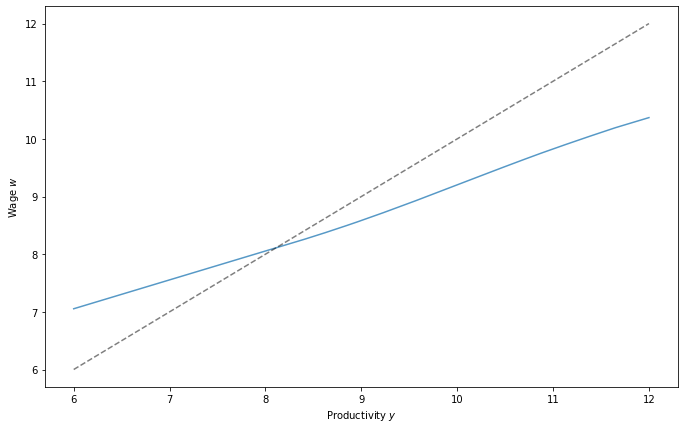

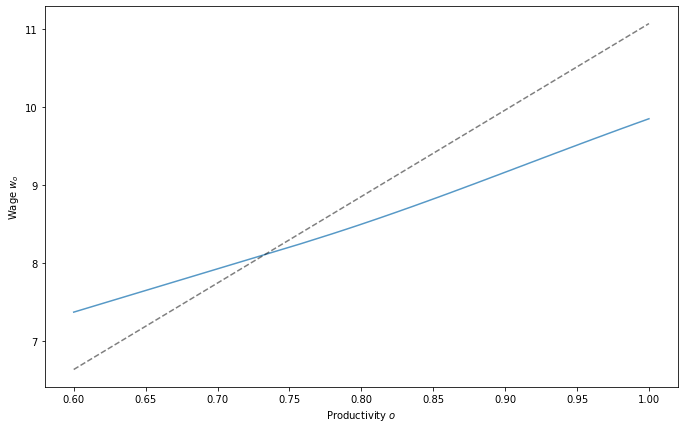

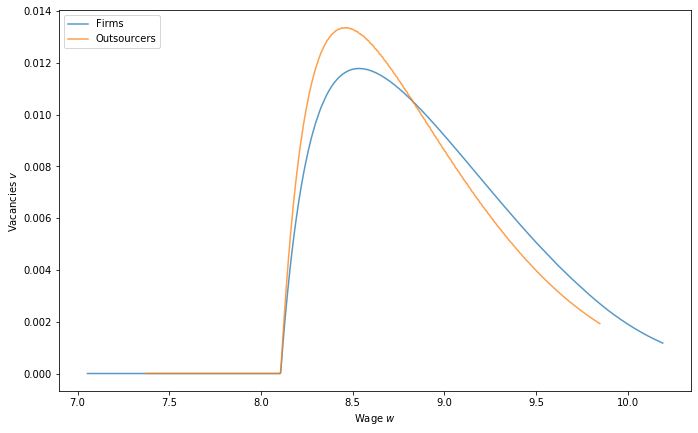

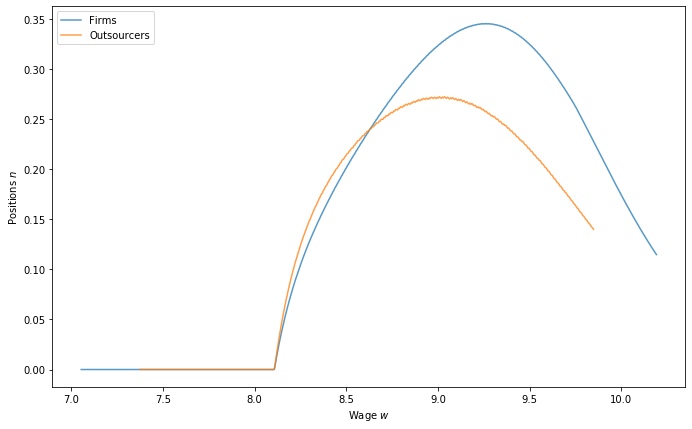

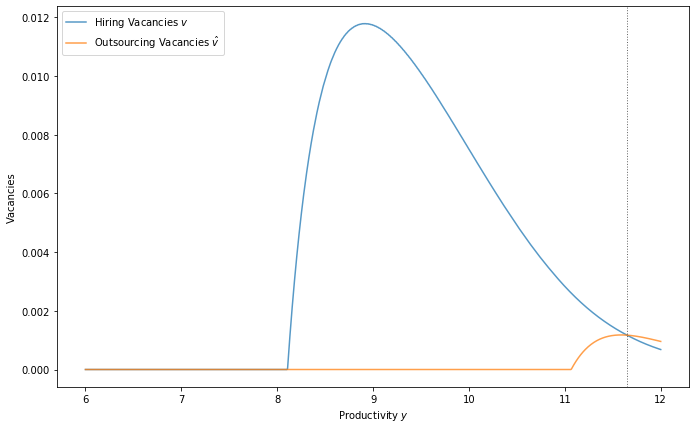

...

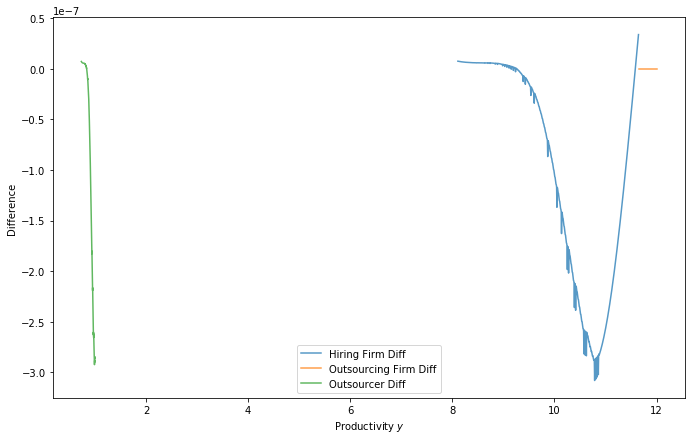

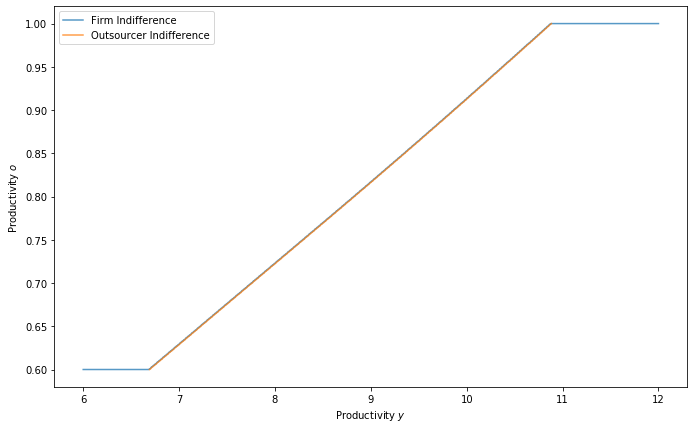

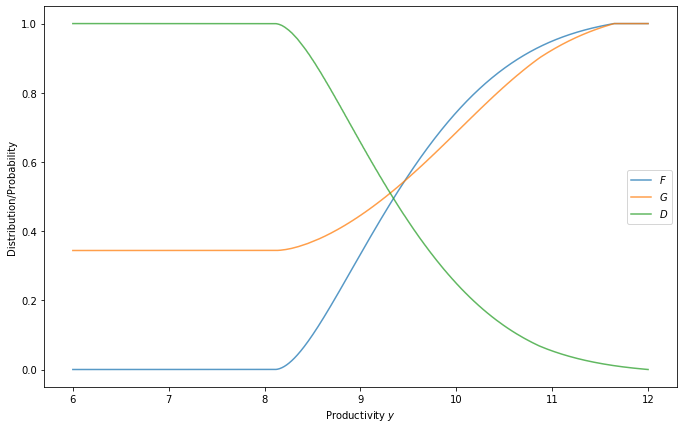

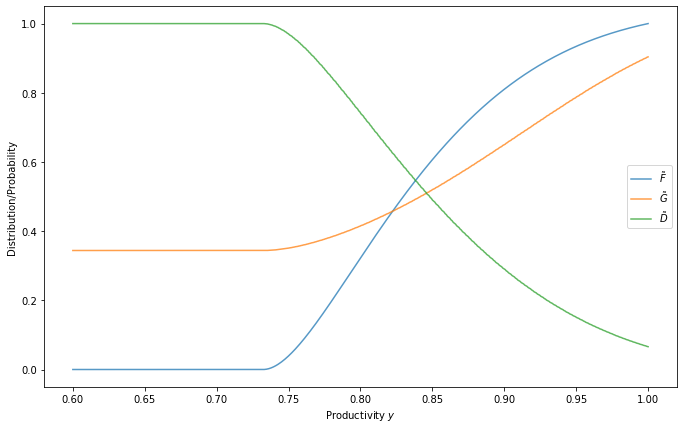

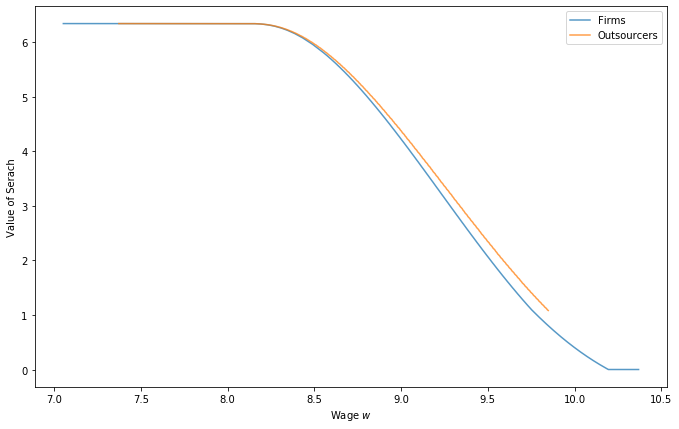

In [44]:
r = 0.000939
B = 1 / (1 + r)
delta = 0.0045
delta_o = 0.0050
delta_hat = 0.0040
xi = .1
# xi = 0
eta = 0.5
eta_o = 0.5
phi = 2e-1 
y_min = 6
y_max = 12
o_min = 0.6
o_max = 1.0
b = y_min * .4 
y_grid_size = int(1000)
# y_grid_size = 8000
o_grid_size = int(500)
gamma = 2
gamma_o = 2
k_grid = np.logspace(0, 5, y_grid_size, endpoint = False)
k_o_grid = np.logspace(0, 4, o_grid_size, endpoint = False)
# k_grid = 1e9
# k_o_grid = 1e9

p_low = 10
p_high = 12
tol = 1e-4
max_iter = 20
tol_i = 1e-6
max_iter_i = 5e4
slow_i = 1e-1
print_skip = 5
verbose = True

save = False

ooj = OutsourcingOnJob(
    B, b, delta, delta_o, delta_hat, xi, eta, eta_o, phi,
    y_min, y_max, y_grid_size, o_min, o_max, o_grid_size,
    gamma, gamma_o, k_grid, k_o_grid
)

# Record initial guesses
v_grid = np.ones(y_grid_size) / y_grid_size
n_grid = np.ones(y_grid_size) / y_grid_size
v_hat_grid = np.ones(y_grid_size) / y_grid_size
n_hat_grid = np.ones(y_grid_size) / y_grid_size
v_o_grid = np.ones(o_grid_size) / o_grid_size
n_o_grid = np.ones(o_grid_size) / o_grid_size
y_hat = 12
R_grid = np.minimum(np.arange(y_grid_size), o_grid_size - 1, dtype=np.int64)
R_o_grid = np.minimum(np.arange(o_grid_size), y_grid_size - 1, dtype=np.int64)

guess = v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid

# solve_given_p, _, _, _, _, _, _, _, _, _, _, _, _ = operator_factory(ooj)

# # Base guess on p = 12 (this almost always converges, and is in a nicer shape)
# guess = solve_given_p(
#         12, v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
#         n_o_grid, y_hat, R_grid, R_o_grid, 1e-4, 2e4, 1e-1
#     )

# print(guess[0][0])

qe.tic()
(v_grid, v_hat_grid, v_o_grid, n_grid,
 n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p) = find_p(
    ooj, guess, p_low, p_high, tol, max_iter, tol_i, max_iter_i, slow_i, verbose, print_skip
)
qe.toc()

folder=r'C:/Users/spspi/Dropbox/Documents/Outsourcing/Figures/Python Simulations/Example 2'
file=r'/'
f = None

if save:
    f = open(folder + file + "Details.txt", "w")
    k_names = """
    k_grid = np.logspace(0, 5, y_grid_size, endpoint = False) \n 
    k_o_grid = np.logspace(0, 4, o_grid_size, endpoint = False) \n    
    """
    save_parameters(ooj, f, p_low, p_high, tol, max_iter, tol_i, max_iter_i, slow_i, k_names)
    
    
list_facts(ooj, v_grid, v_hat_grid, v_o_grid, n_grid,
               n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p, f=f)

graph_results(ooj, v_grid, v_hat_grid, v_o_grid, n_grid,
              n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p, 
              save=save, folder=folder, file=file)

if save:
    f.close()

In [3]:
# Set up code for the outsourcer's problem with on-the-job search
# Builds on Outsourcers file
# This block of code separates v_grid of hiring from v_hat_grid of outsourcing
# Older version that utilizes bisection in code

import numpy as np
import matplotlib.pyplot as plt
import quantecon as qe
from numba import njit, jitclass, int64, float64
from interpolation import interp
from IPython.core.debugger import set_trace
from scipy.optimize import minimize

# Set up parameter space
ooj_parameters = [
    ("B", float64),
    ("r", float64),
    ("b", float64),
    ("delta", float64),
    ("delta_o", float64),
    ("delta_hat", float64),
    ("xi", float64),
    ("eta", float64),
    ("eta_o", float64),
    ("phi", float64),
    ("y_grid", float64[:]),
    ("y_grid_size", int64),
    ("rm", float64),
    ("o_grid", float64[:]),
    ("o_grid_size", int64),
    ("rm_o", float64),
    ("phi", float64),
    ("gamma", float64),
    ("k_grid", float64[:]),
    ("gamma_o", float64),
    ("k_o_grid", float64[:])    
]

@jitclass(ooj_parameters)
class OutsourcingOnJob:
    """
    B is discount rate beta
    r is interest rate defined by beta
    b is home production
    delta is job loss rate at firm
    delta_o is job loss rate at outsourcer
    delta_hat is firm destruction rate of outsourcing firm <= delta
    xi is probability of searching on-the-job
    eta is workers bargaining power with firm
    eta_o is workers bargaining power with outsourcer
    phi is effectiveness of matching function
    y_min, y_max, y_grid_size determine firm productivity grid
    rm is to Reimann Sum approximate firm integrals
    o_min, o_max, o_grid_size determine outsourcer productivity grid
    rm_o is to Reimann Sum approximate outsourcer integrals
    gamma is steepness of marginal cost, 
    k_grid is level of entry cost
    gamma_h is steepness of marginal cost for outsourcers, 
    k_o_grid is level of cost
    """
    def __init__(
        self, B, b, delta, delta_o, delta_hat, xi, eta, eta_o, phi,
        y_min, y_max, y_grid_size, o_min, o_max, o_grid_size,
        gamma, gamma_o, k_grid, k_o_grid
    ):
        
        self.B, self.b, self.delta, self.eta, self.gamma, self.k_grid = B, b, delta, eta, gamma, k_grid
        self.delta_hat, self.eta_o, self.gamma_o, self.k_o_grid = delta_hat, eta_o, gamma_o, k_o_grid 
        self.xi, self.delta_o = xi, delta_o
        self.r = 1 / B - 1
        
#         self.y_grid = np.linspace(y_min, y_max, y_grid_size, endpoint = False)
        self.y_grid = np.linspace(y_min, y_max, y_grid_size)
        self.y_grid_size = y_grid_size    
        self.rm = (y_max - y_min) / y_grid_size
        
#         self.o_grid = np.linspace(o_min, o_max, o_grid_size, endpoint = False)
        self.o_grid = np.linspace(o_min, o_max, o_grid_size)
        self.o_grid_size = o_grid_size    
        self.rm_o = (o_max - o_min) / o_grid_size
        
        self.phi = phi
#         self.q = njit(lambda x: min(phi * x**(-1 / 2), 1))
#         self.ell = njit(lambda x: min(phi * x**(1 / 2), 1))
#         # Remember, q_p and p_p = 0 if q or p = 1
#         self.q_p = njit(lambda x: -phi / 2 * x**(-3 / 2) * (phi * x**(-1 / 2) < 1)) 
#         self.ell_p = njit(lambda x: phi / 2 * x**(1 / 2) * (phi * x**(1 / 2) < 1))


# Set up neccesary functions
def operator_factory(ooj):
    
    r, b, delta, eta, gamma, k_grid = ooj.r, ooj.b, ooj.delta, ooj.eta, ooj.gamma, ooj.k_grid
    delta_hat, eta_o, gamma_o, k_o_grid = ooj.delta_hat, ooj.eta_o, ooj.gamma_o, ooj.k_o_grid
    xi, delta_o = ooj.xi, ooj.delta_o
    phi = ooj.phi
    
    y_grid, y_grid_size, rm = ooj.y_grid, ooj.y_grid_size, ooj.rm
    o_grid, o_grid_size, rm_o = ooj.o_grid, ooj.o_grid_size, ooj.rm_o
    
    
    @njit()
    def q(theta):
        return min(phi * theta**(-1 / 2), 1)
    
    @njit()
    def ell(theta):
        return min(phi * theta**(1 / 2), 1)
    
    # Want cost of vacancy, marginal cost of vacancy, and inverse marginal cost of vacancy
    @njit()
    def C(v_grid):
        return k_grid * v_grid**gamma
    
    @njit()
    def c(v_grid):
        return k_grid * gamma * v_grid**(gamma - 1)

    @njit()
    def c_inv(c_grid):
        return (np.maximum(c_grid, 0) / (gamma * k_grid))**(1 / (gamma - 1))
        
    # Do the same for outsourcers
    @njit()
    def C_o(v_o_grid):
        return k_o_grid * v_o_grid**gamma_o

    @njit()
    def c_o(v_o_grid):
        return k_o_grid * gamma_o * v_o_grid**(gamma_o - 1)

    @njit()
    def c_o_inv(c_o_grid):
        return (np.maximum(c_o_grid, 0) / (gamma_o * k_o_grid))**(1 / (gamma_o - 1))
    
    # Given a continuous y_hat, find the nearest y_i
    @njit()
    def find_y_i(y_hat):
        return np.argmin(np.abs(y_hat - y_grid))
    
    # Given v_grid, v_o_grid, n_grid,
    # n_o_grid, y_hat, R_grid, R_o_grid, and p, find
    # Firms who directly hire hire vs those that outsource out
    # Market tightness theta
    # Distribution of vacanices F and F_o
    # Distribution of job seekers G and G_o
    # Probability of worker leaving D and D_o
    # Wages w and w_o
    @njit()
    def make_grids(v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p):    
        
        y_i = find_y_i(y_hat)
        
        # Make this here, but useful for F and G below
        n_temp = np.copy(n_grid)
        n_temp[y_i:] = 0
        
        cum_v = np.cumsum(v_grid * rm)
        cum_v_o = np.cumsum(v_o_grid * rm_o)
        cum_n = np.cumsum(n_temp * rm)
        cum_n_o = np.cumsum(n_o_grid * rm_o)
        
        # Define aggregate populations (make sure all exist)
        u = max(1 - cum_n[-1] - cum_n_o[-1], 1e-9)
        v = max(cum_v[-1], 1e-9)
        v_o = max(cum_v_o[-1], 1e-9)
        s = u + xi * (cum_n[-1] + cum_n_o[-1])
        
        # Calculate theta and pi 
        v_sum = v + v_o
        theta = v_sum / s
        pi = v_o / v_sum
        
        # Calculate distributions 
        # F is distribution of vacancies (include firms above y_hat in cdf as 1)
        F_grid = np.minimum(cum_v / v, 1)
        f_grid = v_grid / v
        f_grid[y_i:] = 0
        
        F_o_grid = cum_v_o / v_o
        f_o_grid = v_o_grid / v_o
        
        # G is distribution of job seekers (include firms above y_hat as bigger than all y firms)        
        G_grid = (u + xi * (cum_n + cum_n_o[R_grid])) / s
        G_o_grid = (u + xi * (cum_n[R_o_grid] + cum_n_o)) / s
        
        # D is probability a worker finds a better job
        D_grid = xi * ell(theta) * (1 - (1 - pi) * F_grid - pi * F_o_grid[R_grid]) 
        D_o_grid = xi * ell(theta) * (1 - (1 - pi) * F_grid[R_o_grid] - pi * F_o_grid) 
        
        # What is the value of search?
        # Store these vectors of values which will be used many times
        f_tot = c(v_grid) / G_grid * f_grid * rm
        o_tot = c_o(v_o_grid) / G_o_grid * f_o_grid * rm_o
        i_cum_f = np.cumsum(f_tot[::-1])[::-1]
        i_cum_o = np.cumsum(o_tot[::-1])[::-1]
        
        # For unemployed
        firm = eta / (1 - eta) * (1 - pi) * i_cum_f[0]
        out = eta_o / (1 - eta_o) * pi * i_cum_o[0]
        Gamma_U = ell(theta) / q(theta) * (firm + out)
        
        # For employed at a firm
        firm = eta / (1 - eta) * (1 - pi) * i_cum_f
        out = eta_o / (1 - eta_o) * pi * i_cum_o[R_grid]
        Gamma_grid = ell(theta) / q(theta) * (firm + out)
        
        # For employed at an outsourcer
        firm = eta / (1 - eta) * (1 - pi) * i_cum_f[R_o_grid]
        out = eta_o / (1 - eta_o) * pi * i_cum_o
        Gamma_o_grid = ell(theta) / q(theta) * (firm + out)
        
        # Find wages
        w_grid = eta * y_grid + (1 - eta) * (b + Gamma_U - (1 - delta) * xi * Gamma_grid) 
        w_o_grid = eta_o * p * o_grid + (1 - eta_o) * (b + Gamma_U - (1 - delta_o) * xi * Gamma_o_grid) 
        
        return (
            theta, G_grid, G_o_grid, D_grid, D_o_grid, 
            Gamma_U, Gamma_grid, Gamma_o_grid, w_grid, w_o_grid
        )
    
    # Given v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
    # n_o_grid, y_hat, R_grid, R_o_grid, and p, find new values
    @njit()
    def iterate(v_grid, v_hat_grid, v_o_grid, n_grid,
                n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p):
        
        (theta, G_grid, G_o_grid, D_grid, D_o_grid,
         Gamma_U, Gamma_grid, Gamma_o_grid, w_grid, w_o_grid) = make_grids(
            v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p)
        
        # Value of firms
        J_hire = q(theta) * G_grid * (y_grid - w_grid) / (r + delta + (1 - delta) * D_grid)
        J_out = (y_grid - p) / (r + delta_hat)
        
        # Update y_hat by finding firm closest to indifferent between hiring/outsourcing
        # Make sure J_out is non_negative at y_hat
        y_diff = np.argmin(np.abs(J_out - J_hire))
        y_zero = np.argmin(np.abs(J_out))
        y_hat_new = y_grid[max(y_diff, y_zero)]
        
        # Update vacancies
        # Hiring firms (below y_hat)
        v_grid_new = c_inv(J_hire)
        
        # Outsourcing firms (above y_hat)
        v_hat_grid_new = c_inv(J_out)
        
        # Outsourcers
        v_o_grid_new = c_o_inv(
            (o_grid * p - w_o_grid) * q(theta) * G_o_grid / (r + delta_o + (1 - delta_o) * D_o_grid)
        )
        
        # Update positions
        # Hiring firms
        n_grid_new = (1 - delta) * (1 - D_grid) * n_grid + q(theta) * G_grid * v_grid_new
        
        # Outsourcing firms
        n_hat_grid_new = (1 - delta_hat) * n_hat_grid + v_hat_grid_new
        
        # Outsourcers
        n_o_grid_new = (1 - delta_o) * (1 - D_o_grid) * n_o_grid + q(theta) * G_o_grid * v_o_grid_new
               
        # Update R_grid and R_o_grid by comparing W - U to W_o - U.
        # Note that R_grid is defined for all firms, even those above 
        # y_hat, and R_o_grid might be indiffeferent to a firm above y_hat that doesn't hire
        # Value of employment at a firm (minus value of unemployment)        
        W_min_U = (
            (1 + r) * (w_grid - b - Gamma_U + (1 - delta) * xi * Gamma_grid)
            / (r + delta + (1 - delta) * D_grid)
        )
        
        # Value of employment at an outsourcer (minus value of unemployment)
        W_o_min_U = (
            (1 + r) * (w_o_grid - b - Gamma_U + (1 - delta_o) * xi * Gamma_o_grid)
            / (r + delta_o + (1 - delta_o) * D_o_grid)
        )

        # Use these and search sorted to find new indecision rules (make sure not above all)
        R_grid_new = np.minimum(np.searchsorted(W_o_min_U, W_min_U), o_grid_size - 1)
    
        R_o_grid_new = np.minimum(np.searchsorted(W_min_U, W_o_min_U), y_grid_size - 1)
        
        return (v_grid_new, v_hat_grid_new, v_o_grid_new, n_grid_new,
                n_hat_grid_new, n_o_grid_new, y_hat_new, R_grid_new, R_o_grid_new)
    
    # Given n_grid, n_o_grid, and y_hat find excess demand for outsourcing 
    @njit()
    def QD_QS_ED(n_hat_grid, n_o_grid, y_hat):
        y_i = find_y_i(y_hat)
        QD = np.sum(n_hat_grid[y_i:] * rm) 
        QS = np.sum(n_o_grid * o_grid * rm_o)
        ED = QD - QS
        return QD, QS, ED

    @njit()
    def solve_given_p(
        p, v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
        n_o_grid, y_hat, R_grid, R_o_grid, tol, max_iter, slow
    ):

        # Set up initial loop parameters
        i = 0
        err = tol + 1    

        # Update v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, and R_o_grid
        while i < max_iter and err > tol:
            (v_grid_new, v_hat_grid_new, v_o_grid_new, n_grid_new,
                    n_hat_grid_new, n_o_grid_new, y_hat_new, R_grid_new, R_o_grid_new) = iterate(
                v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p
            )
            err_v_t = np.max(np.abs(v_grid_new - v_grid))
            err_v_h = np.max(np.abs(v_hat_grid_new - v_hat_grid))
            err_v_o = np.max(np.abs(v_o_grid_new - v_o_grid))
            err_n_t = np.max(np.abs(n_grid_new - n_grid))
            err_n_h = np.max(np.abs(n_hat_grid_new - n_hat_grid))
            err_n_o = np.max(np.abs(n_o_grid_new - n_o_grid))
            err = max(err_v_t, err_v_h, err_v_o, err_n_t, err_n_h, err_n_o)
            i += 1

            v_grid = slow * v_grid_new + (1 - slow) * v_grid
            v_hat_grid = slow * v_hat_grid_new + (1 - slow) * v_hat_grid
            v_o_grid = slow * v_o_grid_new + (1 - slow) * v_o_grid
            n_grid = slow * n_grid_new + (1 - slow) * n_grid
            n_hat_grid = slow * n_hat_grid_new + (1 - slow) * n_hat_grid
            n_o_grid = slow * n_o_grid_new + (1 - slow) * n_o_grid
            y_hat = slow * y_hat_new + (1 - slow) * y_hat 

            # To slowly adjust y_hat, R_grid, and R_o_grid (which are indexes), instead 
            # add/subtract by 1 if greater/less 
            R_grid = R_grid + 1 * (R_grid_new > R_grid) - 1 * (R_grid_new < R_grid)
            R_o_grid = R_o_grid + 1 * (R_o_grid_new > R_o_grid) - 1 * (R_o_grid_new < R_o_grid)     

        return (
            v_grid_new, v_hat_grid_new, v_o_grid_new, n_grid_new,
            n_hat_grid_new, n_o_grid_new, y_hat_new, R_grid_new, R_o_grid_new
        )        
    
    return solve_given_p, iterate, QD_QS_ED, make_grids, find_y_i, C, c, c_inv, C_o, c_o, c_o_inv, q, ell 

# Find p
def find_p(
    ooj, guess, p_low, p_high, tol, max_iter, tol_i, max_iter_i, slow_i, verbose=True, print_skip=100
):
    
    solve_given_p, _, QD_QS_ED, _, _, _, _, _, _, _, _, _, _ = operator_factory(ooj)
    
    # Set up loop parameters    
    err = tol + 1
    j = 0
    test = []
    
    # Find excess_demand for p_low and p_high, make sure they have opposite signs
    for p in [p_low, p_high]:
#         qe.tic()
        # Initial guesses
        (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
         n_o_grid, y_hat, R_grid, R_o_grid) = guess
        
        (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
         n_o_grid, y_hat, R_grid, R_o_grid) = solve_given_p(
            p, v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
            n_o_grid, y_hat, R_grid, R_o_grid, tol=1e-2, max_iter=1e4, slow=1e-1
        )
        
        QD, QS, ED = QD_QS_ED(n_hat_grid, n_o_grid, y_hat)
        test.append(ED)
#         qe.toc()
        
        if verbose:
            print(f'Excess Demand for price {p} is {ED:.4f}; QS is {QS:.4f}; QD is {QD:.4f}')
            
#         set_trace()
            
    if np.cumprod(test)[1] > 0:
        print('Test failed, both prices have positive/negative excess demand')
        return
    
    
    # Initial guesses (reset initially)
    (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
     n_o_grid, y_hat, R_grid, R_o_grid) = guess
        
    while err > tol and j < max_iter:
#         qe.tic()
        p = (p_low + p_high) / 2    
              
        (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
         n_o_grid, y_hat, R_grid, R_o_grid) = solve_given_p(
            p, v_grid, v_hat_grid, v_o_grid, n_grid,
            n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, tol_i, max_iter_i, slow_i
        )
        
        QD, QS, ED = QD_QS_ED(n_hat_grid, n_o_grid, y_hat)
        err = np.abs(ED)
        
        # If excess demand QD - QS > 0, set p_low = p, otherwise p_high = p
        if ED > 0:
            p_low = p
        else:
            p_high = p
            
        if verbose and j % print_skip == 0:
            print(
                f'Excess Demand at iter {j} is {ED:.4f}; price is {p:.4f}; QS is {QS:.4f}; QD is {QD:.4f}',
                f"y_hat is {y_hat:.4f}"
            )
            
        j += 1
        
#         qe.toc()
        
#     # Run through one more loop with lower tolerance and more iterations
#     (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
#          n_o_grid, y_hat, R_grid, R_o_grid) = solve_given_p(
#             p, v_grid, v_hat_grid, v_o_grid, n_grid,
#             n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, 1e-8, 1e5, slow_i
#         )  
    
#     QD, QS, ED = QD_QS_ED(n_hat_grid, n_o_grid, y_hat)
#     err = np.abs(ED)
    
    if j < max_iter:
        print(f'Converged in {j} iterations, Excess Demand is {ED:.4f};',
              f' price is {p:.4f}; QS is {QS:.4f}; QD is {QD:.4f}')
    if j == max_iter:
        print(f'Failed to Converge. Excess Demand is {ED:.4f}; price is {p:.4f};',
              f' QS is {QS:.4f}; QD is {QD:.4f}')
        
    return v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p

# Create a function to graph results
def graph_results(ooj, v_grid, v_hat_grid, v_o_grid, n_grid,
                  n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p,
                  save=False, height=7, 
                  folder=r'C:\Users\spspi\Dropbox\Documents\Outsourcing\Figures\Python Simulations\Test',
                  file=r'\Outsourcers OJS '):
    
    # Make sure dimensions are 1:1.62
    width = height * 1.62
    
    # Get data needed from ooj
    _, _, QD_QS_ED, make_grids, find_y_i, C, c, c_inv, C_o, c_o, c_o_inv, q, ell = operator_factory(ooj)
    
    (theta, G_grid, G_o_grid, D_grid, D_o_grid, Gamma_U,
     Gamma_grid, Gamma_o_grid, w_grid, w_o_grid) = make_grids(
        v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p
    )
    r, delta, xi = ooj.r, ooj.delta, ooj.xi
    delta_o, delta_hat = ooj.delta_o, ooj.delta_hat
    rm, rm_o = ooj.rm, ooj.rm_o
    y_grid, o_grid = ooj.y_grid, ooj.o_grid
    y_grid_size, o_grid_size = ooj.y_grid_size, ooj.o_grid_size
    
    y_i = find_y_i(y_hat)
        
    # Graph firm wages vs productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, w_grid, alpha=0.75)
    ax.plot(y_grid, y_grid, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $y$", ylabel="Wage $w$")
    
    if save:
        fig.savefig(folder + file + 'Firm Wages v Productivity.pdf')
    else:
        plt.show()  
        
    # Graph outsourcer wages vs productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, w_o_grid, alpha=0.75)
    ax.plot(o_grid, o_grid * p, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $o$", ylabel="Wage $w_o$")
    
    if save:
        fig.savefig(folder + file + 'Outsourcer Wages v Productivity.pdf')
    else:
        plt.show() 
        
    # Graph vacacies by wage
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid[:y_i], v_grid[:y_i], alpha=0.75, label="Firms")
    ax.plot(w_o_grid, v_o_grid, alpha=0.75, label="Outsourcers")
    ax.set(xlabel="Wage $w$", ylabel="Vacancies $v$")
    ax.legend(loc="upper left")
    
    if save:
        fig.savefig(folder + file + 'Vacancies v Wages.pdf')
    else:
        plt.show()         
    
    # Graph filled posititions by wage
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid[:y_i], n_grid[:y_i], alpha=0.75, label="Firms")
    ax.plot(w_o_grid, n_o_grid, alpha=0.75, label="Outsourcers")
    ax.set(xlabel="Wage $w$", ylabel="Positions $n$")
    ax.legend(loc="upper left")
    
    if save:
        fig.savefig(folder + file + 'Positions v Wages.pdf')
    else:
        plt.show() 
        
    # Graph firm vacancies by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, v_grid, alpha=0.75, label=r"Hiring Vacancies ${v}$")
    ax.plot(y_grid, v_hat_grid, alpha=0.75, label=r"Outsourcing Vacancies $\hat{v}$")
    ax.axvline(x=y_hat, c='k', lw=1, linestyle=':', alpha=0.6)
    ax.set(xlabel="Productivity $y$", ylabel="Vacancies")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Firm Vacancies.pdf')
    else:
        plt.show()
        
    # Graph firm postions by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, n_grid, alpha=0.75, label=r"Hiring Positions ${n}$")
    ax.plot(y_grid, n_hat_grid, alpha=0.75, label=r"Outsourcing Positions $\hat{n}$")
    ax.axvline(x=y_hat, c='k', lw=1, linestyle=':', alpha=0.6)
    ax.set(xlabel="Productivity $y$", ylabel="Positions")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Firm Positions.pdf')
    else:
        plt.show()
        
    # Graph outsourcer vacancies and filled positions by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, v_o_grid_p, alpha=0.75, label=r"Vacanicies $\tilde{v}$")
    ax.set(xlabel="Productivity $o$", ylabel="Vacancies")
    
    if save:
        fig.savefig(folder + file + 'Outsourcer Vacancies.pdf')
    else:
        plt.show()
        
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, n_o_grid_p, alpha=0.75, label=r"Positions $\tilde{n}$")
    ax.set(xlabel="Productivity $o$", ylabel="Positions")
    
    if save:
        fig.savefig(folder + file + 'Outsourcer Positions.pdf')
    else:
        plt.show()
        
    # Graph median tenure by wage
    p_stay = (1 - delta) * (1 - D_grid)
    median_tenure = np.log(.5) / np.log(p_stay)
    p_o_stay = (1 - delta_o) * (1 - D_o_grid)
    median_tenure_o = np.log(.5) / np.log(p_o_stay)
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid[:y_i], median_tenure[:y_i], alpha=0.75, label="Firms")
    ax.plot(w_o_grid, median_tenure_o, alpha=0.75, label="Outsourcers")
    ax.set(xlabel="Wage", ylabel="Median Tenure")
    ax.legend(loc="upper left")
    
    if save:
        fig.savefig(folder + file + 'Median Tenure.pdf')
    else:
        plt.show()
        
    # Graph firings (lose jobs) vs quits (find better job) by wage
    firings = delta * n_grid
    quits = (1 - delta) * D_grid * n_grid
    firings_o = delta_o * n_o_grid_p
    quits_o = (1 - delta_o) * D_o_grid * n_o_grid_p
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid[:y_i], firings[:y_i], alpha=0.75, label="Firm Firings")
    ax.plot(w_grid[:y_i], quits[:y_i], alpha=0.75, label="Firm Quits")
    ax.plot(w_o_grid, firings_o, alpha=0.75, label="Outsourcer Firings")
    ax.plot(w_o_grid, quits_o, alpha=0.75, label="Outsourcer Quits")
    ax.set(xlabel="Wage", ylabel="Number")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Firings and Quits.pdf')
    else:
        plt.show()
        
    # Graph the marginal value of a worker to each firm and marginal cost of aquiring one.
    # Do the same for outsourcers hiring
    J_hire = q(theta) * G_grid * (y_grid - w_grid) / (r + delta + (1 - delta) * D_grid)
    mc = c(v_grid)   
    
    J_out = (y_grid - p) / (r + delta_hat) 
    mc_hat = c(v_hat_grid) 
    
    O = q(theta) * G_o_grid * (p * o_grid - w_o_grid) / (r + delta_o + (1 - delta_o) * D_o_grid)
    mc_o = c_o(v_o_grid) 
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, J_hire, alpha=0.75, label="Hiring Firm Marginal Value")
    ax.plot(y_grid[y_i:], J_out[y_i:], alpha=0.75, label="Outsourcing Firm Marginal Value")
    ax.plot(y_grid, mc, alpha=0.75, label="Hiring Firm Marginal Cost")
    ax.plot(y_grid, mc_hat, alpha=0.75, label="Outsourcing Firm Marginal Cost")
    ax.plot(o_grid, O, alpha=0.75, label="Outsourcer Marginal Value")
    ax.plot(o_grid, mc_o, alpha=0.75, label="Outsourcer Marginal Cost")
    ax.set(xlabel="Productivity", ylabel="Value")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + 'M Value and Cost.pdf')
    else:
        plt.show()
        
    # Plot the differences from the above curves
    J_hire_diff = J_hire - mc
    J_out_diff = J_out - mc_hat
    O_diff = O - mc_o
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[:y_i][v_grid[:y_i] > 0],
            J_hire_diff[:y_i][v_grid[:y_i] > 0], alpha=0.75, label="Hiring Firm Diff")
    ax.plot(y_grid[y_i:], J_out_diff[y_i:], alpha=0.75, label="Outsourcing Firm Diff")
    ax.plot(o_grid[v_o_grid > 0], O_diff[v_o_grid > 0], alpha=0.75, label="Outsourcer Diff")
    ax.set(xlabel="Productivity $y$", ylabel="Difference")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + 'M Value Minus Cost.pdf')
    else:
        plt.show()
        
    # Plot the workers' indifference curve for hired vs outsourced
    o_R_grid = o_grid[R_grid]
    y_R_o_grid = y_grid[R_o_grid]
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, o_R_grid, alpha=0.75, label="Firm Indifference")
    ax.plot(y_R_o_grid, o_grid, alpha=0.75, label="Outsourcer Indifference")    
    ax.set(xlabel="Productivity $y$", ylabel="Productivity $o$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + "Worker's Indifference Curve.pdf")
    else:
        plt.show()
        
    # Plot various distribributions for the firm
    v = np.sum(v_grid[:y_i] * rm)
    F_grid = np.minimum(np.cumsum(v_grid * rm) / v, 1)
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, F_grid, alpha=0.75, label=r"$F$")  
    ax.plot(y_grid, G_grid, alpha=0.75, label=r"$G$") 
    ax.plot(y_grid, D_grid / (xi * ell(theta)), alpha=0.75, label=r"$D$")  
    ax.set(xlabel="Productivity $y$", ylabel="Distribution/Probability")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + "Firm Distributions.pdf")
    else:
        plt.show()
        
    # Plot various distribributions for the outsourcer
    v_o = np.sum(v_o_grid * rm_o)
    F_o_grid = np.cumsum(v_o_grid * rm_o) / v_o
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, F_o_grid, alpha=0.75, label=r"$\tilde{F}$")  
    ax.plot(o_grid, G_o_grid, alpha=0.75, label=r"$\tilde{G}$") 
    ax.plot(o_grid, D_o_grid / (xi * ell(theta)), alpha=0.75, label=r"$\tilde{D}$")  
    ax.set(xlabel="Productivity $y$", ylabel="Distribution/Probability")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + "Outsourcer Distributions.pdf")
    else:
        plt.show()
        
    # Graph value of search by wage
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid, Gamma_grid, alpha=0.75, label="Firms")
    ax.plot(w_o_grid, Gamma_o_grid, alpha=0.75, label="Outsourcers")
    ax.set(xlabel="Wage $w$", ylabel="Value of Serach")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Value of Search.pdf')
    else:
        plt.show()
        
# Create a function to print some facts that are useful
def list_facts(ooj, v_grid, v_hat_grid, v_o_grid, n_grid,
               n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p, f=None):
    
    _, _, QD_QS_ED, make_grids, find_y_i, C, c, c_inv, C_o, c_o, c_o_inv, q, ell = operator_factory(ooj)
    
    (theta, G_grid, G_o_grid, D_grid, D_o_grid, Gamma_U,
     Gamma_grid, Gamma_o_grid, w_grid, w_o_grid) = make_grids(
        v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p
    )
    
    delta, xi = ooj.delta, ooj.xi
    rm, rm_o = ooj.rm, ooj.rm_o
    y_grid, o_grid = ooj.y_grid, ooj.o_grid
    
    y_i = find_y_i(y_hat)
    
    print(f"The indifferent firm is y_hat = {y_hat:.2f}$. Price of outsourcing is {p:.2f}.")
    
    u = 1 - np.sum(n_grid[:y_i] * rm) - np.sum(n_o_grid * rm_o) 
    pi = np.sum(v_o_grid * rm_o) / (np.sum(v_grid[:y_i] * rm) + np.sum(v_o_grid * rm_o))
    zeta = np.sum(n_o_grid * rm_o) / (np.sum(n_grid[:y_i] * rm) + np.sum(n_o_grid * rm_o))
    e_delta = (1 - zeta) * delta + zeta * delta_o 
    u_lom = e_delta / (e_delta + ell(theta))
    tot_v = np.sum(v_grid[:y_i] * rm) + np.sum(v_o_grid * rm_o)
    
    print(f"Unemployment is {u * 100:.2f}. According to LoM, should be {u_lom * 100:.2f}")
    print(f"Workers match with probability {ell(theta) * 100:.2f}.",
          f"Firms/Outsourcers match with probability {q(theta) * 100:.2f}")
    print(f"Total vacancies searching for workers are {tot_v:.4f}. Theta is {theta:.4f}")
    print(f"{pi * 100:.0f} percent of vacancies searching for workers are from outsourcers,",
          f"{zeta * 100:.0f} percent of postions outsourced")
    
    # Document ue rate, ee rate, and percent of jobs from unemployment
    ue = ell(theta)
    ee = (
        (np.sum(n_grid[:y_i] * D_grid[:y_i] * rm) / np.sum(n_grid[:y_i] * rm) + 
         np.sum(n_o_grid * D_o_grid * rm_o) / np.sum(n_o_grid * rm_o))
    )
    per_from_u = 100 * ue * u / (ue * u + ee * (1 - u))
    print(f"The ue rate is {ue:.4f}, the ee rate is {ee:.4f},",
          f" and {per_from_u:0f} of new jobs are from unemployment")  
                       
    # Do firm/outsourcer vacancies and positions line up in steady state?
    n_ss = v_grid * q(theta) * G_grid / (delta + D_grid - delta * D_grid)
    err = max(np.abs(n_ss - n_grid))
    err_at = np.argmax(np.abs(n_ss - n_grid))
    
    n_ss_hat = v_hat_grid / delta_hat
    err_hat = max(np.abs(n_ss_hat - n_hat_grid))
    err_hat_at = np.argmax(np.abs(n_ss_hat - n_hat_grid))
    
    n_o_ss = v_o_grid * q(theta) * G_o_grid / (delta_o + D_o_grid - delta_o * D_o_grid)
    err_o = max(np.abs(n_o_ss - n_o_grid))
    err_o_at = np.argmax(np.abs(n_o_ss - n_o_grid))
    
    print(
        "Checking if vacancies + LoM imply right positions:\n",
         f"Hiring firms largest error = {err:.6f} at position {err_at} \n",
         f"Outsourcing firms largest error = {err_hat:.6f} at position {err_hat_at}\n",
         f"Outsourcer largest error = {err_o:.6f} at position {err_o_at}"
    )  
    
    # If want to save everything in an output file
    if f is not None:
        f.write(f"""
        Some facts about the model: \n
        The indifferent firm is y_hat = {y_hat:.2f}$. Price of outsourcing is {p:.2f}. \n
        Unemployment is {u * 100:.2f}. According to LoM, should be {u_lom * 100:.2f} \n
        Workers match with probability {ell(theta) * 100:.2f}. \n
        Firms/Outsourcers match with probability {q(theta) * 100:.2f} \n
        Total vacancies searching for workers are {tot_v:.4f}. Theta is {theta:.4f} \n
        {pi * 100:.0f} percent of vacancies searching for workers are from outsourcers, \n
        {zeta * 100:.0f} percent of postions outsourced \n
        The ue rate is {ue:.4f}, the ee rate is {ee:.4f} \n
        and {per_from_u:0f} of new jobs are from unemployment \n
        Checking if vacancies + LoM imply right positions:\n
        Hiring firms largest error = {err:.6f} at position {err_at} \n
        Outsourcing firms largest error = {err_hat:.6f} at position {err_hat_at}\n
        Outsourcer largest error = {err_o:.6f} at position {err_o_at}
        """)
        
def save_parameters(ooj, f, p_low, p_high, tol, max_iter, tol_i, max_iter_i, slow_i, k_names):
    
    r, b, delta, eta, gamma, k_grid = ooj.r, ooj.b, ooj.delta, ooj.eta, ooj.gamma, ooj.k_grid
    delta_hat, eta_o, gamma_o, k_o_grid = ooj.delta_hat, ooj.eta_o, ooj.gamma_o, ooj.k_o_grid
    xi, delta_o = ooj.xi, ooj.delta_o
    phi, gamma, gamma_o = ooj.phi, ooj.gamma, ooj.gamma_o
    
    y_grid, y_grid_size, rm = ooj.y_grid, ooj.y_grid_size, ooj.rm
    o_grid, o_grid_size, rm_o = ooj.o_grid, ooj.o_grid_size, ooj.rm_o
    y_min, y_max, o_min, o_max = ooj.y_min, ooj.y_max, ooj.o_min, ooj.o_max
    
    f.write(f"""
    These are the parameters used for this simulation\n:
    B = {B} \n
    r = {r} \n
    delta = {delta} \n
    delta_o = {delta_o} \n
    delta_hat = {delta_hat} \n 
    eta = {eta} \n
    eta_o = {eta_o} \n
    phi = {phi} \n 
    xi = {xi} \n
    y_min = {y_min} \n 
    y_max = {y_max} \n
    y_grid_size = {y_grid_size} \n
    o_min = {o_min} \n 
    o_max = {o_max} \n
    o_grid_size = {o_grid_size} \n
    b = {b} \n 
    gamma = {gamma} \n 
    gamma_o = {gamma_o} \n 
    """ + k_names)
    
    f.write(f"""
    The code runs using these parameters: \n
    p_low = {p_low} \n
    p_high = {p_high} \n
    tol = {tol} \n
    max_iter = {max_iter} \n
    tol_i = {tol_i} \n
    max_iter_i = {max_iter_i} \n 
    slow_i = {slow_i}    
    """)    

In [59]:
# Set up code for the outsourcer's problem with on-the-job search
# Builds on Outsourcers file
# This block of code separates v_grid of hiring from v_hat_grid of outsourcing
# This file does not have find_p in operator_factory

import numpy as np
import matplotlib.pyplot as plt
import quantecon as qe
from numba import njit, vectorize
from IPython.core.debugger import set_trace

class OutsourcingOnJob:
    """
    B is discount rate beta
    r is interest rate defined by beta
    b is home production
    delta is job loss rate at firm
    delta_o is job loss rate at outsourcer
    delta_hat is firm destruction rate of outsourcing firm <= delta
    xi is probability of searching on-the-job
    eta is workers bargaining power with firm
    eta_o is workers bargaining power with outsourcer
    phi is effectiveness of matching function
    y_min, y_max, y_grid_size determine firm productivity grid
    rm is to Reimann Sum approximate firm integrals
    o_min, o_max, o_grid_size determine outsourcer productivity grid
    rm_o is to Reimann Sum approximate outsourcer integrals
    gamma is steepness of marginal cost, k_grid is level of entry cost
    gamma_h is steepness of marginal cost for outsourcers, k_o_grid is level of cost
    q is matching function of firms
    ell is matching function of workerso
    """
    def __init__(
        self, B, b, delta, delta_o, delta_hat, xi, eta, eta_o, phi,
        y_min, y_max, y_grid_size, o_min, o_max, o_grid_size,
        gamma, gamma_o, k_grid, k_o_grid
    ):
        
        self.B, self.b, self.delta, self.eta, self.gamma, self.k_grid = B, b, delta, eta, gamma, k_grid
        self.delta_hat, self.eta_o, self.gamma_o, self.k_o_grid = delta_hat, eta_o, gamma_o, k_o_grid 
        self.xi, self.delta_o = xi, delta_o
        self.r = 1 / B - 1
        
        self.y_grid = np.linspace(y_min, y_max, y_grid_size, endpoint = False)
        self.y_grid_size = y_grid_size    
        self.rm = (y_max - y_min) / y_grid_size
        self.y_min, self.y_max = y_min, y_max
        
        self.o_grid = np.linspace(o_min, o_max, o_grid_size, endpoint = False)
        self.o_grid_size = o_grid_size    
        self.rm_o = (o_max - o_min) / o_grid_size
        self.o_min, self.o_max = o_min, o_max
        
        self.phi = phi
        self.q = njit(lambda x: min(phi * x**(-1 / 2), 1))
        self.ell = njit(lambda x: min(phi * x**(1 / 2), 1))
#         # Remember, q_p and p_p = 0 if q or p = 1
#         self.q_p = njit(lambda x: -phi / 2 * x**(-3 / 2) * (phi * x**(-1 / 2) < 1)) 
#         self.ell_p = njit(lambda x: phi / 2 * x**(1 / 2) * (phi * x**(1 / 2) < 1))


# Set up neccesary functions
def operator_factory(ooj):
    
    r, b, delta, eta, gamma, k_grid = ooj.r, ooj.b, ooj.delta, ooj.eta, ooj.gamma, ooj.k_grid
    delta_hat, eta_o, gamma_o, k_o_grid = ooj.delta_hat, ooj.eta_o, ooj.gamma_o, ooj.k_o_grid
    xi, delta_o = ooj.xi, ooj.delta_o
    q, ell = ooj.q, ooj.ell
    
    y_grid, y_grid_size, rm = ooj.y_grid, ooj.y_grid_size, ooj.rm
    o_grid, o_grid_size, rm_o = ooj.o_grid, ooj.o_grid_size, ooj.rm_o
    
    # Want cost of vacancy, marginal cost of vacancy, and inverse marginal cost of vacancy
    @njit()
    def C(v_grid):
        return k_grid * v_grid**gamma
    
    @njit()
    def c(v_grid):
        return k_grid * gamma * v_grid**(gamma - 1)

    @njit()
    def c_inv(c_grid):
        return (np.maximum(c_grid, 0) / (gamma * k_grid))**(1 / (gamma - 1))
        
    # Do the same for outsourcers
    @njit()
    def C_o(v_o_grid):
        return k_o_grid * v_o_grid**gamma_o

    @njit()
    def c_o(v_o_grid):
        return k_o_grid * gamma_o * v_o_grid**(gamma_o - 1)

    @njit()
    def c_o_inv(c_o_grid):
        return (np.maximum(c_o_grid, 0) / (gamma_o * k_o_grid))**(1 / (gamma_o - 1))
    
    # Given a continuous y_hat, find the nearest y_i
    @njit()
    def find_y_i(y_hat):
        return np.argmin(np.abs(y_hat - y_grid))
    
    # Given v_grid, v_o_grid, n_grid,
    # n_o_grid, y_hat, R_grid, R_o_grid, and p, find
    # Firms who directly hire hire vs those that outsource out
    # Market tightness theta
    # Distribution of vacanices F and F_o
    # Distribution of job seekers G and G_o
    # Probability of worker leaving D and D_o
    # Wages w and w_o
    @njit()
    def make_grids(v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p):    
        
        y_i = find_y_i(y_hat)
        
        # Define aggregate populations (make sure all exist)
        u = max(1 - np.sum(n_grid[:y_i] * rm) - np.sum(n_o_grid * rm_o), 1e-9)
        v = max(np.sum(v_grid[:y_i] * rm), 1e-9)
        v_o = max(np.sum(v_o_grid * rm_o), 1e-9)
        s = (u + xi * (np.sum(n_grid[:y_i] * rm) + np.sum(n_o_grid * rm_o)))
        
        # Calculate theta and pi 
        v_sum = v + v_o
        theta = v_sum / s
        pi = v_o / v_sum
        
        # Calculate distributions 
        # F is distribution of vacancies (include firms above y_hat in cdf as 1)
        F_grid = np.minimum(np.cumsum(v_grid * rm) / v, 1)
        f_grid = v_grid / v
        f_grid[y_i:] = 0
        
        F_o_grid = np.cumsum(v_o_grid * rm_o) / v_o
        f_o_grid = v_o_grid / v_o
        
        # G is distribution of job seekers (include firms above y_hat as bigger than all y firms)
        n_temp = np.copy(n_grid)
        n_temp[y_i:] = 0
        G_grid = (
            (u + xi * (np.cumsum(n_temp * rm)
                       + np.array([np.sum(n_o_grid[:R] * rm_o) for R in R_grid]))) 
            / s
        )
        G_o_grid = (
            (u + xi * (np.array([np.sum(n_temp[:R_o] * rm) for R_o in R_o_grid]) 
                       + np.cumsum(n_o_grid * rm_o))) 
            / s
        )
        
        # D is probability a worker finds a better job
        D_grid = xi * ell(theta) * (1 - (1 - pi) * F_grid - pi * F_o_grid[R_grid]) 
        D_o_grid = xi * ell(theta) * (1 - (1 - pi) * F_grid[R_o_grid] - pi * F_o_grid) 
        
        # What is the value of search?
        # Store these vectors of values which will be used many times
        f_tot = c(v_grid) / G_grid * f_grid * rm
        o_tot = c_o(v_o_grid) / G_o_grid * f_o_grid * rm_o
        
        # For unemployed
        firm = eta / (1 - eta) * (1 - pi) * np.sum(f_tot)
        out = eta_o / (1 - eta_o) * pi * np.sum(o_tot)
        Gamma_U = ell(theta) / q(theta) * (firm + out)
        
        # For employed at a firm
        firm = eta / (1 - eta) * (1 - pi) * np.cumsum(f_tot[::-1])[::-1]
        out = eta_o / (1 - eta_o) * pi * np.array([np.sum(o_tot[R:]) for R in R_grid])
        Gamma_grid = ell(theta) / q(theta) * (firm + out)
        
        # For employed at an outsourcer
        firm = eta / (1 - eta) * (1 - pi) * np.array([np.sum(f_tot[R_o:]) for R_o in R_o_grid])
        out = eta_o / (1 - eta_o) * pi * np.cumsum(o_tot[::-1])[::-1]
        Gamma_o_grid = ell(theta) / q(theta) * (firm + out)
        
        # Find wages
        w_grid = eta * y_grid + (1 - eta) * (b + Gamma_U - (1 - delta) * xi * Gamma_grid) 
        w_o_grid = eta_o * p * o_grid + (1 - eta_o) * (b + Gamma_U - (1 - delta_o) * xi * Gamma_o_grid) 
        
        return (
            theta, G_grid, G_o_grid, D_grid, D_o_grid, 
            Gamma_U, Gamma_grid, Gamma_o_grid, w_grid, w_o_grid
        )
    
    # Given v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
    # n_o_grid, y_hat, R_grid, R_o_grid, and p, find new values
    @njit()
    def iterate(v_grid, v_hat_grid, v_o_grid, n_grid,
                n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p):
        
        (theta, G_grid, G_o_grid, D_grid, D_o_grid,
         Gamma_U, Gamma_grid, Gamma_o_grid, w_grid, w_o_grid) = make_grids(
            v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p)
        
        # Value of firms
        J_hire = q(theta) * G_grid * (y_grid - w_grid) / (r + delta + (1 - delta) * D_grid)
        J_out = (y_grid - p) / (r + delta_hat)
        
        # Update y_hat by finding firm closest to indifferent between hiring/outsourcing
        # Make sure J_out is non_negative at y_hat
        y_diff = np.argmin(np.abs(J_out - J_hire))
        y_zero = np.argmin(np.abs(J_out))
        y_hat_new = y_grid[max(y_diff, y_zero)]
        
        # Update vacancies
        # Hiring firms (below y_hat)
        v_grid_new = c_inv(J_hire)
        
        # Outsourcing firms (above y_hat)
        v_hat_grid_new = c_inv(J_out)
        
        # Outsourcers
        v_o_grid_new = c_o_inv(
            (o_grid * p - w_o_grid) * q(theta) * G_o_grid / (r + delta_o + (1 - delta_o) * D_o_grid)
        )
        
        # Update positions
        # Hiring firms
        n_grid_new = (1 - delta) * (1 - D_grid) * n_grid + q(theta) * G_grid * v_grid_new
        
        # Outsourcing firms
        n_hat_grid_new = (1 - delta_hat) * n_hat_grid + v_hat_grid_new
        
        # Outsourcers
        n_o_grid_new = (1 - delta_o) * (1 - D_o_grid) * n_o_grid + q(theta) * G_o_grid * v_o_grid_new
               
        # Update R_grid and R_o_grid by comparing W - U to W_o - U.
        # Note that R_grid is defined for all firms, even those above 
        # y_hat, and R_o_grid might be indiffeferent to a firm above y_hat that doesn't hire
        # Value of employment at a firm (minus value of unemployment)        
        W_min_U = (
            (1 + r) * (w_grid - b - Gamma_U + (1 - delta) * xi * Gamma_grid)
            / (r + delta + (1 - delta) * D_grid)
        )
        
        # Value of employment at an outsourcer (minus value of unemployment)
        W_o_min_U = (
            (1 + r) * (w_o_grid - b - Gamma_U + (1 - delta_o) * xi * Gamma_o_grid)
            / (r + delta_o + (1 - delta_o) * D_o_grid)
        )

        # Use these and search sorted to find new indecision rules (make sure not above all)
        R_grid_new = np.minimum(np.searchsorted(W_o_min_U, W_min_U), o_grid_size - 1)
    
        R_o_grid_new = np.minimum(np.searchsorted(W_min_U, W_o_min_U), y_grid_size - 1)
        
        return (v_grid_new, v_hat_grid_new, v_o_grid_new, n_grid_new,
                n_hat_grid_new, n_o_grid_new, y_hat_new, R_grid_new, R_o_grid_new)
    
    # Given n_grid, n_o_grid, and y_hat find excess demand for outsourcing 
    @njit()
    def QD_QS_ED(n_hat_grid, n_o_grid, y_hat):
        y_i = find_y_i(y_hat)
        QD = np.sum(n_hat_grid[y_i:] * rm) 
        QS = np.sum(n_o_grid * o_grid * rm_o)
        ED = QD - QS
        return QD, QS, ED
    
    return iterate, QD_QS_ED, make_grids, find_y_i, C, c, c_inv, C_o, c_o, c_o_inv 

# @njit()
def solve_given_p(
    ooj, p, v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
    n_o_grid, y_hat, R_grid, R_o_grid, tol, max_iter, slow, verbose=False
):
    
    iterate, _, make_grids, _, _, _, _, _, _, _ = operator_factory(ooj)
    
    # Set up initial loop parameters
    i = 0
    err = tol + 1    
    
    # Update v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, and R_o_grid
    while i < max_iter and err > tol:
        (v_grid_new, v_hat_grid_new, v_o_grid_new, n_grid_new,
                n_hat_grid_new, n_o_grid_new, y_hat_new, R_grid_new, R_o_grid_new) = iterate(
            v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p
        )
        err_v_t = np.max(np.abs(v_grid_new - v_grid))
        err_v_h = np.max(np.abs(v_hat_grid_new - v_hat_grid))
        err_v_o = np.max(np.abs(v_o_grid_new - v_o_grid))
        err_n_t = np.max(np.abs(n_grid_new - n_grid))
        err_n_h = np.max(np.abs(n_hat_grid_new - n_hat_grid))
        err_n_o = np.max(np.abs(n_o_grid_new - n_o_grid))
        err = max(err_v_t, err_v_h, err_v_o, err_n_t, err_n_h, err_n_o)
        i += 1
        
        v_grid = slow * v_grid_new + (1 - slow) * v_grid
        v_hat_grid = slow * v_hat_grid_new + (1 - slow) * v_hat_grid
        v_o_grid = slow * v_o_grid_new + (1 - slow) * v_o_grid
        n_grid = slow * n_grid_new + (1 - slow) * n_grid
        n_hat_grid = slow * n_hat_grid_new + (1 - slow) * n_hat_grid
        n_o_grid = slow * n_o_grid_new + (1 - slow) * n_o_grid
        y_hat = slow * y_hat_new + (1 - slow) * y_hat 
        
        # To slowly adjust y_hat, R_grid, and R_o_grid (which are indexes), instead 
        # add/subtract by 1 if greater/less 
        R_grid = R_grid + 1 * (R_grid_new > R_grid) - 1 * (R_grid_new < R_grid)
        R_o_grid = R_o_grid + 1 * (R_o_grid_new > R_o_grid) - 1 * (R_o_grid_new < R_o_grid)
        

    if verbose:
        (theta, G_grid, G_o_grid, D_grid, D_o_grid,
         Gamma_U, Gamma_grid, Gamma_o_grid, w_grid, w_o_grid) = make_grids(
            v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p)
        (theta_new, G_grid_new, G_o_grid_new, D_grid_new, D_o_grid_new,
         Gamma_U_new, Gamma_grid_new, Gamma_o_grid_new, w_grid_new, w_o_grid_new) = make_grids(
            v_grid_new, v_o_grid_new, n_grid_new, n_o_grid_new, y_hat_new, R_grid_new, R_o_grid_new, p)
        
        theta_diff = theta - theta_new
        J_hire = (ooj.q(theta) * G_grid * (ooj.y_grid - w_grid)
                  / (ooj.r + ooj.delta + (1 - ooj.delta) * D_grid))
        J_hire_new = (ooj.q(theta_new) * G_grid_new * (ooj.y_grid - w_grid_new)
                      / (ooj.r + ooj.delta + (1 - ooj.delta) * D_grid_new))
#         J_diff = max(np.abs(J_hire_new - J_hire))
        
        print(f"error is {err:.4f}, went through {i} iterations")
        print(f"y_hat is {y_hat:.4f}, y_hat_new is {y_hat_new:.4f}")
        print(f"The difference in theta and theta_new is {theta_diff:.4f}")
        fig, ax = plt.subplots(figsize=(10, 7))
        ax.plot(ooj.y_grid, J_hire, alpha=0.75, label="old J_hire")
        ax.plot(ooj.y_grid, J_hire_new, alpha=0.75, label="new J_hire")
        ax.legend()
        plt.show()       
        
    return (
        v_grid_new, v_hat_grid_new, v_o_grid_new, n_grid_new,
        n_hat_grid_new, n_o_grid_new, y_hat_new, R_grid_new, R_o_grid_new
    )

# Find p
def find_p(
    ooj, p_low, p_high, tol, max_iter, tol_i, max_iter_i, slow_i, verbose=True, print_skip=100
):
    
    iterate, QD_QS_ED, _, _, _, _, _, _, _, _ = operator_factory(ooj)
    
    y_grid, y_grid_size = ooj.y_grid, ooj.y_grid_size  
    o_grid, o_grid_size = ooj.o_grid, ooj.o_grid_size 
    
    # Set up loop parameters    
    err = tol + 1
    j = 0
    test = []
    
    # Find excess_demand for p_low and p_high, make sure they have opposite signs
    for p in [p_low, p_high]:
        # Initial guesses
        v_grid = np.ones(y_grid_size) / y_grid_size
        n_grid = np.ones(y_grid_size) / y_grid_size
        v_hat_grid = np.ones(y_grid_size) / y_grid_size
        n_hat_grid = np.ones(y_grid_size) / y_grid_size
        v_o_grid = np.ones(o_grid_size) / o_grid_size
        n_o_grid = np.ones(o_grid_size) / o_grid_size
        y_hat = p
        R_grid = np.minimum(np.arange(y_grid_size), o_grid_size - 1, dtype=np.int64)
        R_o_grid = np.minimum(np.arange(o_grid_size), y_grid_size - 1, dtype=np.int64)
        
        (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
         n_o_grid, y_hat, R_grid, R_o_grid) = solve_given_p(
            ooj, p, v_grid, v_hat_grid, v_o_grid, n_grid,
            n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, tol_i, max_iter_i, slow_i
        )
        
        QD, QS, ED = QD_QS_ED(n_hat_grid, n_o_grid, y_hat)
        test.append(ED)
        
        if verbose:
            print(f'Excess Demand for price {p} is {ED:.4f}; QS is {QS:.4f}; QD is {QD:.4f}')
            
#         set_trace()
            
    if np.cumprod(test)[1] > 0:
        print('Test failed, both prices have positive/negative excess demand')
        return
    
    # Initial guesses (reset initially)
#         if j <= 5:
    v_grid = np.ones(y_grid_size) / y_grid_size
    n_grid = np.ones(y_grid_size) / y_grid_size
    v_hat_grid = np.ones(y_grid_size) / y_grid_size
    n_hat_grid = np.ones(y_grid_size) / y_grid_size
    v_o_grid = np.ones(o_grid_size) / o_grid_size
    n_o_grid = np.ones(o_grid_size) / o_grid_size
    y_hat = p
    R_grid = np.minimum(np.arange(y_grid_size), o_grid_size - 1, dtype=np.int64)
    R_o_grid = np.minimum(np.arange(o_grid_size), y_grid_size - 1, dtype=np.int64)
        
    while err > tol and j < max_iter:
        p = (p_low + p_high) / 2    
              
        (v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid,
         n_o_grid, y_hat, R_grid, R_o_grid) = solve_given_p(
            ooj, p, v_grid, v_hat_grid, v_o_grid, n_grid,
            n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, tol_i, max_iter_i, slow_i
        )
        
        QD, QS, ED = QD_QS_ED(n_hat_grid, n_o_grid, y_hat)
        err = np.abs(ED)
        
        # If excess demand QD - QS > 0, set p_low = p, otherwise p_high = p
        if ED > 0:
            p_low = p
        else:
            p_high = p
            
        if verbose and j % print_skip == 0:
            print(
                f'Excess Demand at iter {j} is {ED:.4f}; price is {p:.4f}; QS is {QS:.4f}; QD is {QD:.4f}',
                f"y_hat is {y_hat:.4f}"
            )
            
        j += 1
        
    
    if j < max_iter:
        print(f'Converged in {j} iterations, Excess Demand is {ED:.4f};',
              f' price is {p:.4f}; QS is {QS:.4f}; QD is {QD:.4f}')
    if j == max_iter:
        print(f'Failed to Converge. Excess Demand is {ED:.4f}; price is {p:.4f};',
              f' QS is {QS:.4f}; QD is {QD:.4f}')
        
    return v_grid, v_hat_grid, v_o_grid, n_grid, n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p

# Create a function to graph results
def graph_results(ooj, v_grid, v_hat_grid, v_o_grid, n_grid,
                  n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p,
                  save=False, height=7, 
                  folder=r'C:\Users\spspi\Dropbox\Documents\Outsourcing\Figures\Python Simulations\Test',
                  file=r'\Outsourcers OJS '):
    
    # Make sure dimensions are 1:1.62
    width = height * 1.62
    
    # Get data needed from ooj
    _, QD_QS_ED, make_grids, find_y_i, C, c, c_inv, C_o, c_o, c_o_inv = operator_factory(ooj)
    
    (theta, G_grid, G_o_grid, D_grid, D_o_grid, Gamma_U,
     Gamma_grid, Gamma_o_grid, w_grid, w_o_grid) = make_grids(
        v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p
    )
    r, delta, xi, q, ell = ooj.r, ooj.delta, ooj.xi, ooj.q, ooj.ell
    delta_o, delta_hat = ooj.delta_o, ooj.delta_hat
    rm, rm_o = ooj.rm, ooj.rm_o
    y_grid, o_grid = ooj.y_grid, ooj.o_grid
    y_grid_size, o_grid_size = ooj.y_grid_size, ooj.o_grid_size
    
    y_i = find_y_i(y_hat)
    
    # Because firms and outsourcers may have different grid sizes, comparing 
    # plots directly may be misleading. To solve this, scale outsourcing
    # vacancies and positions to match relative grid sizes
    mult = o_grid_size / y_grid_size
    v_o_grid_p = v_o_grid * mult
    n_o_grid_p = n_o_grid * mult
        
    # Graph firm wages vs productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, w_grid, alpha=0.75)
    ax.plot(y_grid, y_grid, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $y$", ylabel="Wage $w$")
    
    if save:
        fig.savefig(folder + file + 'Firm Wages v Productivity.pdf')
    else:
        plt.show()  
        
    # Graph outsourcer wages vs productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, w_o_grid, alpha=0.75)
    ax.plot(o_grid, o_grid * p, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $o$", ylabel="Wage $w_o$")
    
    if save:
        fig.savefig(folder + file + 'Outsourcer Wages v Productivity.pdf')
    else:
        plt.show() 
        
    # Graph vacacies by wage
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid[:y_i], v_grid[:y_i], alpha=0.75, label="Firms")
    ax.plot(w_o_grid, v_o_grid_p, alpha=0.75, label="Outsourcers")
    ax.set(xlabel="Wage $w$", ylabel="Vacancies $v$")
    ax.legend(loc="upper left")
    
    if save:
        fig.savefig(folder + file + 'Vacancies v Wages.pdf')
    else:
        plt.show()         
    
    # Graph filled posititions by wage
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid[:y_i], n_grid[:y_i], alpha=0.75, label="Firms")
    ax.plot(w_o_grid, n_o_grid_p, alpha=0.75, label="Outsourcers")
    ax.set(xlabel="Wage $w$", ylabel="Positions $n$")
    ax.legend(loc="upper left")
    
    if save:
        fig.savefig(folder + file + 'Positions v Wages.pdf')
    else:
        plt.show() 
        
    # Graph firm vacancies by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, v_grid, alpha=0.75, label=r"Hiring Vacancies ${v}$")
    ax.plot(y_grid, v_hat_grid, alpha=0.75, label=r"Outsourcing Vacancies $\hat{v}$")
    ax.axvline(x=y_hat, c='k', lw=1, linestyle=':', alpha=0.6)
    ax.set(xlabel="Productivity $y$", ylabel="Vacancies")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Firm Vacancies.pdf')
    else:
        plt.show()
        
    # Graph firm postions by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, n_grid, alpha=0.75, label=r"Hiring Positions ${n}$")
    ax.plot(y_grid, n_hat_grid, alpha=0.75, label=r"Outsourcing Positions $\hat{n}$")
    ax.axvline(x=y_hat, c='k', lw=1, linestyle=':', alpha=0.6)
    ax.set(xlabel="Productivity $y$", ylabel="Positions")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Firm Positions.pdf')
    else:
        plt.show()
        
    # Graph outsourcer vacancies and filled positions by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, v_o_grid_p, alpha=0.75, label=r"Vacanicies $\tilde{v}$")
    ax.set(xlabel="Productivity $o$", ylabel="Vacancies")
    
    if save:
        fig.savefig(folder + file + 'Outsourcer Vacancies.pdf')
    else:
        plt.show()
        
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, n_o_grid_p, alpha=0.75, label=r"Positions $\tilde{n}$")
    ax.set(xlabel="Productivity $o$", ylabel="Positions")
    
    if save:
        fig.savefig(folder + file + 'Outsourcer Positions.pdf')
    else:
        plt.show()
        
    # Graph median tenure by wage
    p_stay = (1 - delta) * (1 - D_grid)
    median_tenure = np.log(.5) / np.log(p_stay)
    p_o_stay = (1 - delta_o) * (1 - D_o_grid)
    median_tenure_o = np.log(.5) / np.log(p_o_stay)
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid[:y_i], median_tenure[:y_i], alpha=0.75, label="Firms")
    ax.plot(w_o_grid, median_tenure_o, alpha=0.75, label="Outsourcers")
    ax.set(xlabel="Wage", ylabel="Median Tenure")
    ax.legend(loc="upper left")
    
    if save:
        fig.savefig(folder + file + 'Median Tenure.pdf')
    else:
        plt.show()
        
    # Graph firings (lose jobs) vs quits (find better job) by wage
    firings = delta * n_grid
    quits = (1 - delta) * D_grid * n_grid
    firings_o = delta_o * n_o_grid_p
    quits_o = (1 - delta_o) * D_o_grid * n_o_grid_p
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid[:y_i], firings[:y_i], alpha=0.75, label="Firm Firings")
    ax.plot(w_grid[:y_i], quits[:y_i], alpha=0.75, label="Firm Quits")
    ax.plot(w_o_grid, firings_o, alpha=0.75, label="Outsourcer Firings")
    ax.plot(w_o_grid, quits_o, alpha=0.75, label="Outsourcer Quits")
    ax.set(xlabel="Wage", ylabel="Number")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Firings and Quits.pdf')
    else:
        plt.show()
        
    # Graph the marginal value of a worker to each firm and marginal cost of aquiring one.
    # Do the same for outsourcers hiring
    J_hire = q(theta) * G_grid * (y_grid - w_grid) / (r + delta + (1 - delta) * D_grid)
    mc = c(v_grid)   
    
    J_out = (y_grid - p) / (r + delta_hat) 
    mc_hat = c(v_hat_grid) 
    
    O = q(theta) * G_o_grid * (p * o_grid - w_o_grid) / (r + delta_o + (1 - delta_o) * D_o_grid)
    mc_o = c_o(v_o_grid) 
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, J_hire, alpha=0.75, label="Hiring Firm Marginal Value")
    ax.plot(y_grid[y_i:], J_out[y_i:], alpha=0.75, label="Outsourcing Firm Marginal Value")
    ax.plot(y_grid, mc, alpha=0.75, label="Hiring Firm Marginal Cost")
    ax.plot(y_grid, mc_hat, alpha=0.75, label="Outsourcing Firm Marginal Cost")
    ax.plot(o_grid, O, alpha=0.75, label="Outsourcer Marginal Value")
    ax.plot(o_grid, mc_o, alpha=0.75, label="Outsourcer Marginal Cost")
    ax.set(xlabel="Productivity", ylabel="Value")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + 'M Value and Cost.pdf')
    else:
        plt.show()
        
    # Plot the differences from the above curves
    J_hire_diff = J_hire - mc
    J_out_diff = J_out - mc_hat
    O_diff = O - mc_o
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[:y_i][v_grid[:y_i] > 0],
            J_hire_diff[:y_i][v_grid[:y_i] > 0], alpha=0.75, label="Hiring Firm Diff")
    ax.plot(y_grid[y_i:], J_out_diff[y_i:], alpha=0.75, label="Outsourcing Firm Diff")
    ax.plot(o_grid[v_o_grid > 0], O_diff[v_o_grid > 0], alpha=0.75, label="Outsourcer Diff")
    ax.set(xlabel="Productivity $y$", ylabel="Difference")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + 'M Value Minus Cost.pdf')
    else:
        plt.show()
        
    # Plot the workers' indifference curve for hired vs outsourced
    o_R_grid = o_grid[R_grid]
    y_R_o_grid = y_grid[R_o_grid]
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, o_R_grid, alpha=0.75, label="Firm Indifference")
    ax.plot(y_R_o_grid, o_grid, alpha=0.75, label="Outsourcer Indifference")    
    ax.set(xlabel="Productivity $y$", ylabel="Productivity $o$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + "Worker's Indifference Curve.pdf")
    else:
        plt.show()
        
    # Plot various distribributions for the firm
    v = np.sum(v_grid[:y_i] * rm)
    F_grid = np.minimum(np.cumsum(v_grid * rm) / v, 1)
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, F_grid, alpha=0.75, label=r"$F$")  
    ax.plot(y_grid, G_grid, alpha=0.75, label=r"$G$") 
    ax.plot(y_grid, D_grid / (xi * ell(theta)), alpha=0.75, label=r"$D$")  
    ax.set(xlabel="Productivity $y$", ylabel="Distribution/Probability")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + "Firm Distributions.pdf")
    else:
        plt.show()
        
    # Plot various distribributions for the outsourcer
    v_o = np.sum(v_o_grid * rm_o)
    F_o_grid = np.cumsum(v_o_grid * rm_o) / v_o
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, F_o_grid, alpha=0.75, label=r"$\tilde{F}$")  
    ax.plot(o_grid, G_o_grid, alpha=0.75, label=r"$\tilde{G}$") 
    ax.plot(o_grid, D_o_grid / (xi * ell(theta)), alpha=0.75, label=r"$\tilde{D}$")  
    ax.set(xlabel="Productivity $y$", ylabel="Distribution/Probability")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + "Outsourcer Distributions.pdf")
    else:
        plt.show()
        
    # Graph value of search by wage
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid, Gamma_grid, alpha=0.75, label="Firms")
    ax.plot(w_o_grid, Gamma_o_grid, alpha=0.75, label="Outsourcers")
    ax.set(xlabel="Wage $w$", ylabel="Value of Serach")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Value of Search.pdf')
    else:
        plt.show()
        
# Create a function to print some facts that are useful
def list_facts(ooj, v_grid, v_hat_grid, v_o_grid, n_grid,
               n_hat_grid, n_o_grid, y_hat, R_grid, R_o_grid, p, f=None):
    
    _, QD_QS_ED, make_grids, find_y_i, C, c, c_inv, C_o, c_o, c_o_inv = operator_factory(ooj)
    
    (theta, G_grid, G_o_grid, D_grid, D_o_grid, Gamma_U,
     Gamma_grid, Gamma_o_grid, w_grid, w_o_grid) = make_grids(
        v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p
    )
    
    delta, xi, q, ell = ooj.delta, ooj.xi, ooj.q, ooj.ell
    rm, rm_o = ooj.rm, ooj.rm_o
    y_grid, o_grid = ooj.y_grid, ooj.o_grid
    
    y_i = find_y_i(y_hat)
    
    print(f"The indifferent firm is y_hat = {y_hat:.2f}$. Price of outsourcing is {p:.2f}.")
    
    u = 1 - np.sum(n_grid[:y_i] * rm) - np.sum(n_o_grid * rm_o) 
    pi = np.sum(v_o_grid * rm_o) / (np.sum(v_grid[:y_i] * rm) + np.sum(v_o_grid * rm_o))
    zeta = np.sum(n_o_grid * rm_o) / (np.sum(n_grid[:y_i] * rm) + np.sum(n_o_grid * rm_o))
    e_delta = (1 - zeta) * delta + zeta * delta_o 
    u_lom = e_delta / (e_delta + ell(theta))
    tot_v = np.sum(v_grid[:y_i] * rm) + np.sum(v_o_grid * rm_o)
    
    print(f"Unemployment is {u * 100:.2f}. According to LoM, should be {u_lom * 100:.2f}")
    print(f"Workers match with probability {ell(theta) * 100:.2f}.",
          f"Firms/Outsourcers match with probability {q(theta) * 100:.2f}")
    print(f"Total vacancies searching for workers are {tot_v:.4f}. Theta is {theta:.4f}")
    print(f"{pi * 100:.0f} percent of vacancies searching for workers are from outsourcers,",
          f"{zeta * 100:.0f} percent of postions outsourced")
    
    # Document ue rate, ee rate, and percent of jobs from unemployment
    ue = ell(theta)
    ee = (
        (np.sum(n_grid[:y_i] * D_grid[:y_i] * rm) / np.sum(n_grid[:y_i] * rm) + 
         np.sum(n_o_grid * D_o_grid * rm_o) / np.sum(n_o_grid * rm_o))
    )
    per_from_u = 100 * ue * u / (ue * u + ee * (1 - u))
    print(f"The ue rate is {ue:.4f}, the ee rate is {ee:.4f},",
          f" and {per_from_u:0f} of new jobs are from unemployment")  
                       
    # Do firm/outsourcer vacancies and positions line up in steady state?
    n_ss = v_grid * q(theta) * G_grid / (delta + D_grid - delta * D_grid)
    err = max(np.abs(n_ss - n_grid))
    err_at = np.argmax(np.abs(n_ss - n_grid))
    
    n_ss_hat = v_hat_grid / delta_hat
    err_hat = max(np.abs(n_ss_hat - n_hat_grid))
    err_hat_at = np.argmax(np.abs(n_ss_hat - n_hat_grid))
    
    n_o_ss = v_o_grid * q(theta) * G_o_grid / (delta_o + D_o_grid - delta_o * D_o_grid)
    err_o = max(np.abs(n_o_ss - n_o_grid))
    err_o_at = np.argmax(np.abs(n_o_ss - n_o_grid))
    
    print(
        "Checking if vacancies + LoM imply right positions:\n",
         f"Hiring firms largest error = {err:.6f} at position {err_at} \n",
         f"Outsourcing firms largest error = {err_hat:.6f} at position {err_hat_at}\n",
         f"Outsourcer largest error = {err_o:.6f} at position {err_o_at}"
    )  
    
    # If want to save everything in an output file
    if f is not None:
        f.write(f"""
        Some facts about the model: \n
        The indifferent firm is y_hat = {y_hat:.2f}$. Price of outsourcing is {p:.2f}. \n
        Unemployment is {u * 100:.2f}. According to LoM, should be {u_lom * 100:.2f} \n
        Workers match with probability {ell(theta) * 100:.2f}. \n
        Firms/Outsourcers match with probability {q(theta) * 100:.2f} \n
        Total vacancies searching for workers are {tot_v:.4f}. Theta is {theta:.4f} \n
        {pi * 100:.0f} percent of vacancies searching for workers are from outsourcers, \n
        {zeta * 100:.0f} percent of postions outsourced \n
        The ue rate is {ue:.4f}, the ee rate is {ee:.4f} \n
        and {per_from_u:0f} of new jobs are from unemployment \n
        Checking if vacancies + LoM imply right positions:\n
        Hiring firms largest error = {err:.6f} at position {err_at} \n
        Outsourcing firms largest error = {err_hat:.6f} at position {err_hat_at}\n
        Outsourcer largest error = {err_o:.6f} at position {err_o_at}
        """)
        
def save_parameters(ooj, f, p_low, p_high, tol, max_iter, tol_i, max_iter_i, slow_i, k_names):
    
    r, b, delta, eta, gamma, k_grid = ooj.r, ooj.b, ooj.delta, ooj.eta, ooj.gamma, ooj.k_grid
    delta_hat, eta_o, gamma_o, k_o_grid = ooj.delta_hat, ooj.eta_o, ooj.gamma_o, ooj.k_o_grid
    xi, delta_o = ooj.xi, ooj.delta_o
    phi, gamma, gamma_o = ooj.phi, ooj.gamma, ooj.gamma_o
    
    y_grid, y_grid_size, rm = ooj.y_grid, ooj.y_grid_size, ooj.rm
    o_grid, o_grid_size, rm_o = ooj.o_grid, ooj.o_grid_size, ooj.rm_o
    y_min, y_max, o_min, o_max = ooj.y_min, ooj.y_max, ooj.o_min, ooj.o_max
    
    f.write(f"""
    These are the parameters used for this simulation\n:
    B = {B} \n
    r = {r} \n
    delta = {delta} \n
    delta_o = {delta_o} \n
    delta_hat = {delta_hat} \n 
    eta = {eta} \n
    eta_o = {eta_o} \n
    phi = {phi} \n 
    xi = {xi} \n
    y_min = {y_min} \n 
    y_max = {y_max} \n
    y_grid_size = {y_grid_size} \n
    o_min = {o_min} \n 
    o_max = {o_max} \n
    o_grid_size = {o_grid_size} \n
    b = {b} \n 
    gamma = {gamma} \n 
    gamma_o = {gamma_o} \n 
    """ + k_names)
    
    f.write(f"""
    The code runs using these parameters: \n
    p_low = {p_low} \n
    p_high = {p_high} \n
    tol = {tol} \n
    max_iter = {max_iter} \n
    tol_i = {tol_i} \n
    max_iter_i = {max_iter_i} \n 
    slow_i = {slow_i}    
    """)    

In [285]:
# This is a simple model (without outsourcers) with on the job search.
# Builds on the file in Baseline.

import numpy as np
import matplotlib.pyplot as plt
import quantecon as qe
from numba import njit, prange, vectorize
from IPython.core.debugger import set_trace
    
class BaselineOnJob:    
    """
    B is discount rate beta
    r is interest rate defined by beta
    b is home production
    delta is job loss rate
    xi is probability searh on the job
    eta is worker bargaining power    
    phi is effectiveness of matching function
    q is firm's matching function, worker's is p=theta*q(theta)
    y_min, y_max, y_grid_size determine productivity grid
    rm is the Reimann Sum multiplier to estimate integrals
    gamma is steepness of marginal cost, k_grid is distribution of firm entry costs
    q is matching function of firms
    ell is matching function of workers    
    """
    
    def __init__(self, B, b, delta, xi, eta, phi, y_min, y_max, y_grid_size, gamma, k_grid):
        
        self.B, self.b, self.delta, self.xi = B, b, delta, xi 
        self.eta, self.gamma, self.k_grid = eta, gamma, k_grid
        self.r = 1 / B - 1
        
        self.y_grid = np.linspace(y_min, y_max, y_grid_size, endpoint = False)
        self.y_grid_size = y_grid_size 
        self.rm = (y_max - y_min) / y_grid_size
        
        self.q = njit(lambda x: min(phi * x**(-1 / 2), 1))
        self.ell = njit(lambda x: min(phi * x**(1 / 2), 1))
        self.q_p = njit(lambda x: -phi / 2 * x**(-3 / 2))
        
# Given a class, set up functions
def operator_factory(boj):
    "The functions to solve a case of BaselineOnJob"
    
    B, r, b, delta, xi = boj.B, boj.r, boj.b, boj.delta, boj.xi
    eta, gamma, k_grid = boj.eta, boj.gamma, boj.k_grid
    y_grid, y_grid_size = boj.y_grid, boj.y_grid_size
    q, ell = boj.q, boj.ell
    rm = boj.rm
    
    # Want cost of vacancy, marginal cost of vacancy, and inverse marginal cost of vacancy
    @njit()
    def C(v_grid):
        return k_grid * v_grid**gamma

    @njit()
    def c(v_grid):
        return k_grid * gamma * v_grid**(gamma - 1)

    @njit()
    def c_inv(c_grid):
        c_grid[c_grid < 0] = 0
        return (c_grid / gamma / k_grid)**(1 / (gamma - 1))
    
    # Given v_grid and n_grid find theta, the firms a worker would leave for F_bar_grid
    # workers a firm can hire G_grid, and wages w_grid
    @njit()
    def make_grids(v_grid, n_grid):
        # Define aggregate populations
        u = 1 - np.sum(n_grid * rm)
        v = np.sum(v_grid * rm)
        s = (u + xi * (1 - u))
        
        # Calculate theta
        theta = v / s
        
        # Calculate distributions 
        F_grid = np.cumsum(v_grid * rm) / v
        F_bar_grid = 1 - F_grid
        f_grid = v_grid / v
        G_grid = (u + xi * np.cumsum(n_grid * rm)) / s
        
        # Calculate value of search
        search = c(v_grid) / G_grid * f_grid * rm
        Gamma_U = eta / (1 - eta) * ell(theta) / q(theta) * np.sum(search)
        # This goes from y to y_bar
        Gamma = eta / (1 - eta) * ell(theta) / q(theta) * np.cumsum(search[::-1])[::-1]
        # Find wages
        w_grid = eta * y_grid + (1 - eta) * (b + Gamma_U - (1 - delta) * xi * Gamma)        
        
        return theta, F_bar_grid, G_grid, w_grid

    # Find next v_grid and n_grid
    @njit()
    def iterate(v_grid, n_grid):
        
        theta, F_bar_grid, G_grid, w_grid = make_grids(v_grid, n_grid)
        
        # Find out how many vacancies each firm wants to create using firms' FOC
        v_grid_new = c_inv(
            (y_grid - w_grid) * q(theta) * G_grid / (r + delta + (1 - delta) * xi * ell(theta) * F_bar_grid)
        )
        
        # Use LOM to guess n_grid_new
        n_grid_new = (1 - delta) * (1 - xi * ell(theta) * F_bar_grid) * n_grid + q(theta) * G_grid * v_grid
        
        return v_grid_new, n_grid_new
    
    return iterate, make_grids, C, c, c_inv

def solve_model(boj, tol=1e-4, max_iter=1000, verbose=True, print_skip=25, slow=1e-3):
    
    iterate, _, _, _, _ = operator_factory(boj)
    
    # Set up initial guesses and loop parameters
    size = boj.y_grid_size
    v_grid = np.ones(size) / size
    n_grid = np.ones(size) / size
    i = 0
    err = tol + 1    
    
    # Update v_grid and u each period
    while i < max_iter and err > tol:
        v_grid_new, n_grid_new = iterate(v_grid, n_grid)
        err_v = np.max(np.abs(v_grid_new - v_grid))
        err_n = np.max(np.abs(n_grid_new - n_grid))
        err = max(err_v, err_n)
        i += 1
        
        if verbose and i % print_skip == 0:
            print(f'Error at iter {i} is {err}')
        
        v_grid = slow * v_grid_new + (1 - slow) * v_grid 
        n_grid = slow * n_grid_new + (1 - slow) * n_grid 
        
    if i == max_iter:
        print("Failed to Converge")
        
    if verbose and i < max_iter:
        print(f'Converged in {i} iterations')
    
    return v_grid_new, n_grid_new      
    
# Create a function to graph results
def graph_results(boj, v_grid, n_grid, save=False, height=7, 
                  folder=r'C:\Users\spspi\Dropbox\Documents\Outsourcing\Figures\Python Simulations\Test',
                  file=r'\Baseline OJS '):
    
    # Make sure dimensions are 1:1.62
    width = height * 1.62
    
    # Get data needed from boj
    _, make_grids, C, c, c_inv = operator_factory(boj)
    theta, F_bar_grid, G_grid, w_grid = make_grids(v_grid, n_grid)
    r, delta, xi, q, ell = boj.r, boj.delta, boj.xi, boj.q, boj.ell
    k_grid = boj.k_grid
    y_grid = boj.y_grid
    
    # Graph wages vs productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, w_grid, alpha=0.75)
    ax.set(xlabel="Productivity $y$", ylabel="Wage $w$")
    
    if save:
        fig.savefig(folder + file + 'Wages v Productivity.pdf')
    else:
        plt.show()  
        
    
    # Graph filled posititions by wage
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid, n_grid, alpha=0.75)
    ax.set(xlabel="Wage $w$", ylabel="Positions $n$")
    
    if save:
        fig.savefig(folder + file + 'Positions v Wages.pdf')
    else:
        plt.show() 
        
    # Graph vacancies and filled positions by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, v_grid, alpha=0.75, label="Vacanicies $v$")
    ax.plot(y_grid, n_grid, alpha=0.75, label="Positions $n$")
    ax.set(xlabel="Productivity $y$", ylabel="Size")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Vacancies and Positions.pdf')
    else:
        plt.show()
        
    # Graph median tenure by productivity
    p_stay = (1 - delta) * (1 - xi * ell(theta) * F_bar_grid)
    median_tenure = np.log(.5) / np.log(p_stay)
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, median_tenure, alpha=0.75)
    ax.set(xlabel="Productivity $y$", ylabel="Median Tenure")
    
    if save:
        fig.savefig(folder + file + 'Median Tenure.pdf')
    else:
        plt.show()
        
    # Graph firings (lose jobs) vs quits (find better job) by productivity
    firings = delta * n_grid
    quits = (1 - delta) * xi * ell(theta) * F_bar_grid * n_grid
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, firings, alpha=0.75, label="Firings")
    ax.plot(y_grid, quits, alpha=0.75, label="Quits")
    ax.set(xlabel="Productivity $y$", ylabel="Number")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Firings and Quits.pdf')
    else:
        plt.show()
        
    # Graph the marginal value of a worker to each firm and marginal cost of aquiring one
    dJ_dn = ((1 + r) * (y_grid - w_grid) 
             / (r + delta + (1 - delta) * xi * ell(theta) * F_bar_grid))
    mc = (1 + r) * c(v_grid) / (q(theta) * G_grid)    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, dJ_dn, alpha=0.75, label="Firm Marginal Value")
    ax.plot(y_grid, mc, alpha=0.75, label="Firm Marginal Cost")
    ax.set(xlabel="Productivity $y$", ylabel="Value")
    ax.legend(loc = "upper left")
    
    if save:
        fig.savefig(folder + file + 'Firm M Value and Cost.pdf')
    else:
        plt.show()
        
    # Graph the marginal value of a worker to each firm minus the marginal cost of aquiring one
    # Where v > 0
    diff = dJ_dn - mc
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[v_grid > 0], diff[v_grid > 0], alpha=0.75, label="Firm Marginal Value")
    ax.set(xlabel="Productivity $y$", ylabel="Value")
#     ax.legend(loc = "upper left")
    
    if save:
        fig.savefig(folder + file + 'Firm M Value minus Cost.pdf')
    else:
        plt.show()
        
    # Graph the distributions of vacancies F and job seekers G   
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, 1 - F_bar_grid, alpha=0.75, label="$F$")
    ax.plot(y_grid, G_grid, alpha=0.75, label="G")
    ax.set(xlabel="Productivity $y$", ylabel="Density")
    ax.legend(loc = "upper left")
    
    if save:
        fig.savefig(folder + file + 'Distributions.pdf')
    else:
        plt.show()
        
# Create a function to print some facts that are useful
def list_facts(boj, v_grid, n_grid):
    
    _, make_grids, _, _, _ = operator_factory(boj)
    delta, xi, q, ell = boj.delta, boj.xi, boj.q, boj.ell
    rm = boj.rm
    
    theta, F_bar_grid, G_grid, w_grid = make_grids(v_grid, n_grid)
    
    u = 1 - np.sum(n_grid * boj.rm)
    u_lom = delta / (delta + ell(theta))
    print(f"Unemployment is {u:.4f}. According to LoM, should be {u_lom:.4f}")
    print(f"Workers match with probability {ell(theta):.4f}. Firms match with probability {q(theta):.4f}")
    
    # Document ue rate, ee rate, and percent of jobs from unemployment
    ue = ell(theta)
    ee = xi * ell(theta) * np.sum(n_grid * F_bar_grid * rm) / np.sum(n_grid * rm)
    per_from_u = 100 * ue * u / (ue * u + ee * (1 - u))
    print(f"The ue rate is {ue:.4f}, the ee rate is {ee:.4f}, and {per_from_u:0f} of new jobs are from unemployment")

Error at iter 20000 is 1.4124797991788007e-05
Error at iter 40000 is 1.5700819216979411e-07
Converged in 52241 iterations
Unemployment is 0.2107. According to LoM, should be 0.0542
Workers match with probability 0.0786. Firms match with probability 1.0000
The ue rate is 0.0786, the ee rate is 0.0031, and 87.226135 of new jobs are from unemployment


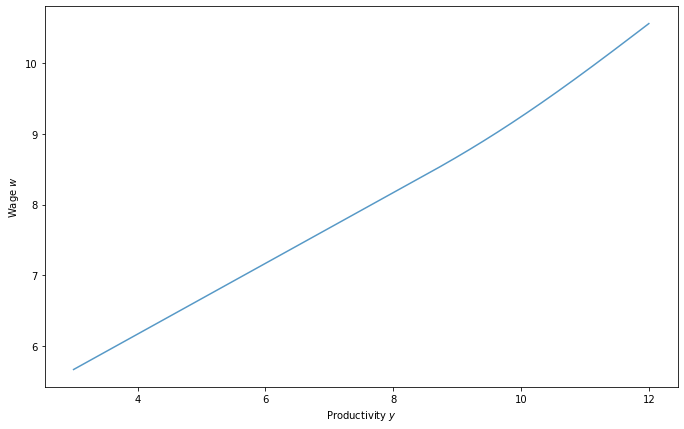

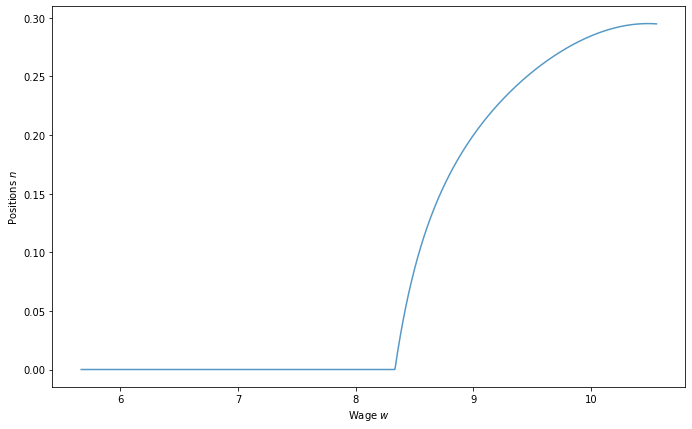

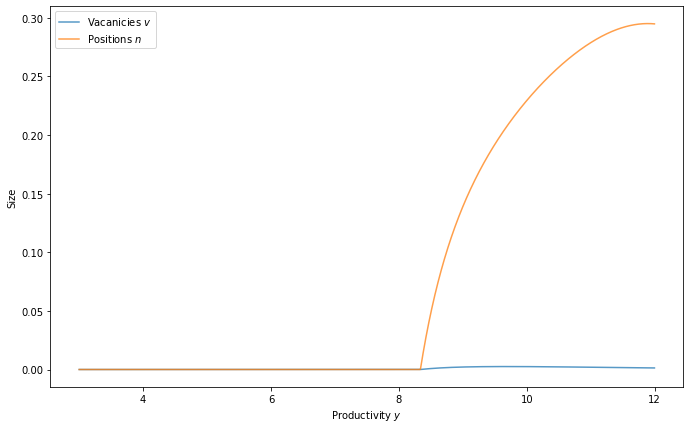

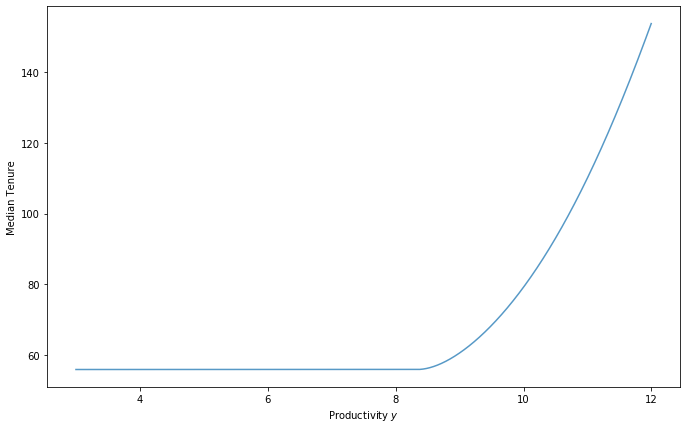

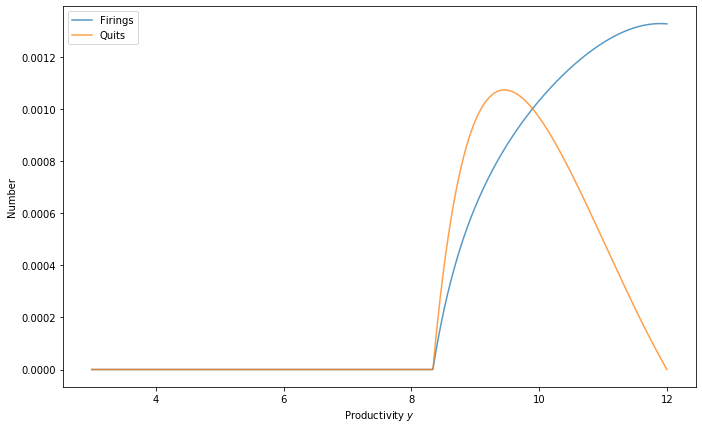

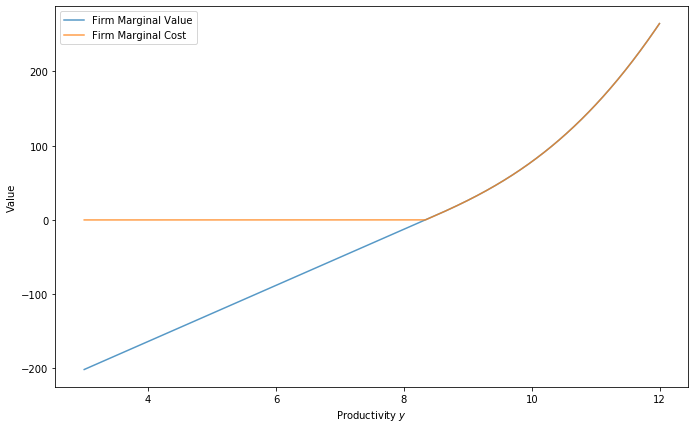

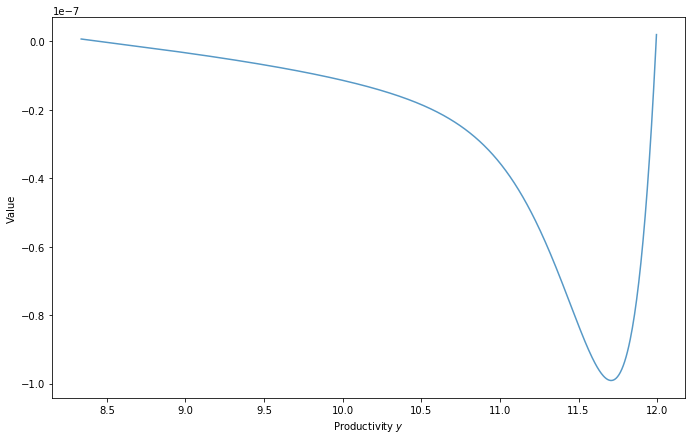

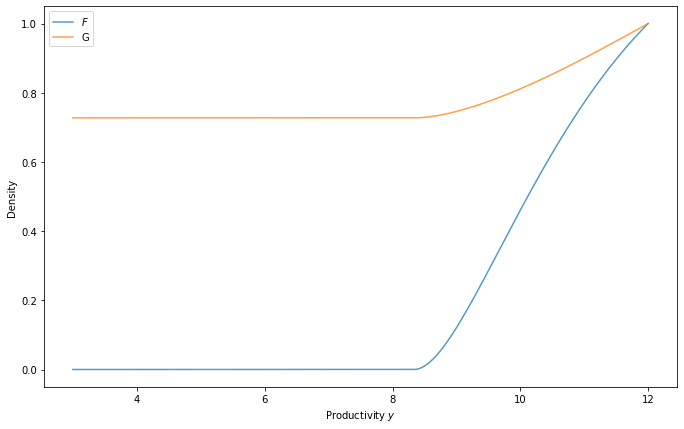

In [286]:
r = 0.000939
B = 1 / (1 + r)
delta = 0.0045
xi = .1
# xi = 0
eta = 0.5
phi = 5e-1 
y_min = 3
y_max = 12
b = y_min * .4 
y_grid_size = 2000
# y_grid_size = 8000
gamma = 2
# gamma = 1.5
k_grid = np.logspace(1, 5, y_grid_size, endpoint = False)
# k_grid = 5e2
# k_grid = np.linspace(1, 15, y_grid_size, endpoint = False)**2

boj = BaselineOnJob(B, b, delta, xi, eta, phi, y_min, y_max, y_grid_size, gamma, k_grid)

v_grid, n_grid = solve_model(boj, tol=1e-8, print_skip=2e4, max_iter=2e5, slow=5e-2)

list_facts(boj, v_grid, n_grid)

graph_results(boj, v_grid, n_grid)

[0.92286041 0.92290624 0.92295205 ... 0.9699995  0.96999975 0.97      ] [ 8.63441112  8.63975637  8.64510429 ... 22.75618816 22.75638078
 22.75657306]


In [3]:
# Set up code for the outsourcer's problem with on-the-job search
# Builds on Outsourcers file

import numpy as np
import matplotlib.pyplot as plt
import quantecon as qe
from numba import njit, prange, vectorize, int32, float64
from IPython.core.debugger import set_trace

class OutsourcingOnJob:
    """
    B is discount rate beta
    r is interest rate defined by beta
    b is home production
    delta is job loss rate at firm
    delta_o is job loss rate at outsourcer
    delta_hat is firm destruction rate of outsourcing firm <= delta
    xi is probability of searching on-the-job
    eta is workers bargaining power with firm
    eta_o is workers bargaining power with outsourcer
    phi is effectiveness of matching function
    y_min, y_max, y_grid_size determine firm productivity grid
    rm is to Reimann Sum approximate firm integrals
    o_min, o_max, o_grid_size determine outsourcer productivity grid
    rm_o is to Reimann Sum approximate outsourcer integrals
    gamma is steepness of marginal cost, k_grid is level of entry cost
    gamma_h is steepness of marginal cost for outsourcers, k_o_grid is level of cost
    q is matching function of firms
    ell is matching function of workerso
    """
    def __init__(
        self, B, b, delta, delta_o, delta_hat, xi, eta, eta_o, phi,
        y_min, y_max, y_grid_size, o_min, o_max, o_grid_size,
        gamma, gamma_o, k_grid, k_o_grid
    ):
        
        self.B, self.b, self.delta, self.eta, self.gamma, self.k_grid = B, b, delta, eta, gamma, k_grid
        self.delta_hat, self.eta_o, self.gamma_o, self.k_o_grid = delta_hat, eta_o, gamma_o, k_o_grid 
        self.xi, self.delta_o = xi, delta_o
        self.r = 1 / B - 1
        
        self.y_grid = np.linspace(y_min, y_max, y_grid_size, endpoint = False)
        self.y_grid_size = y_grid_size    
        self.rm = (y_max - y_min) / y_grid_size
        
        self.o_grid = np.linspace(o_min, o_max, o_grid_size, endpoint = False)
        self.o_grid_size = o_grid_size    
        self.rm_o = (o_max - o_min) / o_grid_size
        
        self.q = njit(lambda x: min(phi * x**(-1 / 2), 1))
        self.ell = njit(lambda x: min(phi * x**(1 / 2), 1))
#         # Remember, q_p and p_p = 0 if q or p = 1
#         self.q_p = njit(lambda x: -phi / 2 * x**(-3 / 2) * (phi * x**(-1 / 2) < 1)) 
#         self.ell_p = njit(lambda x: phi / 2 * x**(1 / 2) * (phi * x**(1 / 2) < 1))


# Set up neccesary functions
def operator_factory(ooj):
    
    r, b, delta, eta, gamma, k_grid = ooj.r, ooj.b, ooj.delta, ooj.eta, ooj.gamma, ooj.k_grid
    delta_hat, eta_o, gamma_o, k_o_grid = ooj.delta_hat, ooj.eta_o, ooj.gamma_o, ooj.k_o_grid
    xi, delta_o = ooj.xi, ooj.delta_o
    q, ell = ooj.q, ooj.ell
    
    y_grid, y_grid_size, rm = ooj.y_grid, ooj.y_grid_size, ooj.rm
    o_grid, o_grid_size, rm_o = ooj.o_grid, ooj.o_grid_size, ooj.rm_o
    
    # Want cost of vacancy, marginal cost of vacancy, and inverse marginal cost of vacancy
    @njit()
    def C(v_grid):
        return k_grid * v_grid**gamma
    
    @njit()
    def c(v_grid):
        return k_grid * gamma * v_grid**(gamma - 1)

    @njit()
    def c_inv(c_grid):
        return (np.maximum(c_grid, 0) / (gamma * k_grid))**(1 / (gamma - 1))
        
    # Do the same for outsourcers
    @njit()
    def C_o(v_o_grid):
        return k_o_grid * v_o_grid**gamma_o

    @njit()
    def c_o(v_o_grid):
        return k_o_grid * gamma_o * v_o_grid**(gamma_o - 1)

    @njit()
    def c_o_inv(c_o_grid):
        return (np.maximum(c_o_grid, 0) / (gamma_o * k_o_grid))**(1 / (gamma_o - 1))
    
    # Given v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, and p, find
    # Firms who directly hire hire vs those that outsource out
    # Market tightness theta
    # Distribution of vacanices F and F_o
    # Distribution of job seekers G and G_o
    # Probability of worker leaving D and D_o
    # Wages w and w_o
    @njit()
    def make_grids(v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p):           
        
        # Define aggregate populations (make sure all exist)
        u = max(1 - np.sum(n_grid[:y_hat] * rm) - np.sum(n_o_grid * rm_o), 1e-9)
        v_tilde = max(np.sum(v_grid[:y_hat] * rm), 1e-9)
        v_o = max(np.sum(v_o_grid * rm_o), 1e-9)
        s = (u + xi * (np.sum(n_grid[:y_hat] * rm) + np.sum(n_o_grid * rm_o)))
        
        # Calculate theta and pi 
        v_sum = v_tilde + v_o
        theta = v_sum / s
        pi = v_o / v_sum
        
        # Calculate distributions 
        # F is distribution of vacancies (include firms above y_hat in cdf as 1)
        F_grid = np.minimum(np.cumsum(v_grid * rm) / v_tilde, 1)
        f_grid = v_grid / v_tilde
        f_grid[y_hat:] = 0
        
        F_o_grid = np.cumsum(v_o_grid * rm_o) / v_o
        f_o_grid = v_o_grid / v_o
        
        # G is distribution of job seekers (include firms above y_hat as bigger than all y firms)
        n_temp = np.copy(n_grid)
        n_temp[y_hat:] = 0
        G_grid = (
            (u + xi * (np.cumsum(n_temp * rm)
                       + np.array([np.sum(n_o_grid[:R] * rm_o) for R in R_grid]))) 
            / s
        )
        G_o_grid = (
            (u + xi * (np.array([np.sum(n_temp[:R_o] * rm) for R_o in R_o_grid]) 
                       + np.cumsum(n_o_grid * rm_o))) 
            / s
        )
        
        # D is probability a worker finds a better job
        D_grid = xi * ell(theta) * (1 - (1 - pi) * F_grid - pi * F_o_grid[R_grid]) 
        D_o_grid = xi * ell(theta) * (1 - (1 - pi) * F_grid[R_o_grid] - pi * F_o_grid) 
        
        # What is the value of search?
        # Store these vectors of values which will be used many times
        f_tot = c(v_grid) / G_grid * f_grid * rm
        o_tot = c_o(v_o_grid) / G_o_grid * f_o_grid * rm_o
        
        # For unemployed
        firm = eta / (1 - eta) * (1 - pi) * np.sum(f_tot)
        out = eta_o / (1 - eta_o) * pi * np.sum(o_tot)
        Gamma_U = ell(theta) / q(theta) * (firm + out)
        
        # For employed at a firm
        firm = eta / (1 - eta) * (1 - pi) * np.cumsum(f_tot[::-1])[::-1]
        out = eta_o / (1 - eta_o) * pi * np.array([np.sum(o_tot[R:]) for R in R_grid])
        Gamma_grid = ell(theta) / q(theta) * (firm + out)
        
        # For employed at an outsourcer
        firm = eta / (1 - eta) * (1 - pi) * np.array([np.sum(f_tot[R_o:]) for R_o in R_o_grid])
        out = eta_o / (1 - eta_o) * pi * np.cumsum(o_tot[::-1])[::-1]
        Gamma_o_grid = ell(theta) / q(theta) * (firm + out)
        
        # Find wages
        w_grid = eta * y_grid + (1 - eta) * (b + Gamma_U - (1 - delta) * xi * Gamma_grid) 
        w_o_grid = eta_o * p * o_grid + (1 - eta_o) * (b + Gamma_U - (1 - delta_o) * xi * Gamma_o_grid) 
        
        return (
            theta, G_grid, G_o_grid, D_grid, D_o_grid, 
            Gamma_U, Gamma_grid, Gamma_o_grid, w_grid, w_o_grid
        )
    
    # Given v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, and p, find new values
    @njit()
    def iterate(v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p):
        
        (theta, G_grid, G_o_grid, D_grid, D_o_grid,
         Gamma_U, Gamma_grid, Gamma_o_grid, w_grid, w_o_grid) = make_grids(
            v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p)
        
        v_grid_new = np.empty(y_grid_size)
        n_grid_new = np.empty(y_grid_size)
        
        # Value of firms
        J_hire = q(theta) * G_grid * (y_grid - w_grid) / (r + delta + (1 - delta) * D_grid)
        J_out = (y_grid - p) / (r + delta_hat)
        
        # Update y_hat by finding firm closest to indifferent between hiring/outsourcing
        # Make sure J_out is non_negative at y_hat
#         y_hat_new = min(np.searchsorted(J_out - np.maximum(J_hire, 0), 0), y_grid_size - 1)
        y_diff = np.argmin(np.abs(J_out - J_hire))
        y_zero = np.argmin(np.abs(J_out))
        y_hat_new = max(y_diff, y_zero)
        
        # Update vacancies
        # Hiring firms (below y_hat)
        v_grid_new[:y_hat] = c_inv(J_hire)[:y_hat]
        
        # Outsourcing firms (above y_hat)
        v_grid_new[y_hat:] = c_inv(J_out)[y_hat:]
        
        # Outsourcers
        v_o_grid_new = c_o_inv(
            (o_grid * p - w_o_grid) * q(theta) * G_o_grid / (r + delta_o + (1 - delta_o) * D_o_grid)
        )
        
        # Update positions
        # Hiring firms
        n_temp = (1 - delta) * (1 - D_grid) * n_grid + q(theta) * G_grid * v_grid_new
        n_grid_new[:y_hat] = n_temp[:y_hat]
        
        # Outsourcing firms
        n_grid_new[y_hat:] = (1 - delta_hat) * n_grid[y_hat:] + v_grid_new[y_hat:]
        
        # Outsourcers
        n_o_grid_new = (1 - delta_o) * (1 - D_o_grid) * n_o_grid + q(theta) * G_o_grid * v_o_grid_new
               
        # Update R_grid and R_o_grid by comparing W - U to W_o - U.
        # Note that R_grid is defined for all firms, even those above 
        # y_hat, and R_o_grid might be indiffeferent to a firm above y_hat that doesn't hire
        # Value of employment at a firm (minus value of unemployment)        
        W_min_U = (
            (1 + r) * (w_grid - b - Gamma_U + (1 - delta) * xi * Gamma_grid)
            / (r + delta + (1 - delta) * D_grid)
        )
        
        # Value of employment at an outsourcer (minus value of unemployment)
        W_o_min_U = (
            (1 + r) * (w_o_grid - b - Gamma_U + (1 - delta_o) * xi * Gamma_o_grid)
            / (r + delta_o + (1 - delta_o) * D_o_grid)
        )
                
        # Use these to find new indecision rules
#         R_grid_new = np.array(
#             [np.argmin(np.abs(W_min_U[i] - W_o_min_U)) for i in np.arange(y_grid_size)]
#         )
#         R_o_grid_new = np.array(
#             [np.argmin(np.abs(W_min_U - W_o_min_U[i])) for i in np.arange(o_grid_size)]
#         )

        # Use these and search sorted to find new indecision rules (make sure not above all)
        R_grid_new = np.minimum(np.searchsorted(W_o_min_U, W_min_U), o_grid_size - 1)
    
        R_o_grid_new = np.minimum(np.searchsorted(W_min_U, W_o_min_U), y_grid_size - 1)
        
        return v_grid_new, v_o_grid_new, n_grid_new, n_o_grid_new, y_hat_new, R_grid_new, R_o_grid_new
    
    # Given n_grid, n_o_grid, and y_hat find excess demand for outsourcing 
    @njit()
    def QD_QS(n_grid, n_o_grid, y_hat):
        QD = np.sum(n_grid[y_hat:] * rm) 
        QS = np.sum(n_o_grid * o_grid * rm_o)
        return QD, QS
    
    return iterate, QD_QS, make_grids, C, c, c_inv, C_o, c_o, c_o_inv 

# @njit()
def solve_given_p(
    ooj, p, v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, tol, max_iter, slow, verbose=False
):
    
    iterate, _, make_grids, _, _, _, _, _, _ = operator_factory(ooj)
    
    # Set up initial loop parameters
    i = 0
    err = tol + 1    
    
    # Update v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, and R_o_grid
    while i < max_iter and err > tol:
        (v_grid_new, v_o_grid_new, n_grid_new, n_o_grid_new,
         y_hat_new, R_grid_new, R_o_grid_new) = iterate(
            v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p
        )
        err_v = np.max(np.abs(v_grid_new - v_grid))
        err_v_o = np.max(np.abs(v_o_grid_new - v_o_grid))
        err_n = np.max(np.abs(n_grid_new - n_grid))
        err_n_o = np.max(np.abs(n_o_grid_new - n_o_grid))
        err = max(err_v, err_v_o, err_n, err_n_o)
        i += 1
        
        v_grid = slow * v_grid_new + (1 - slow) * v_grid
        v_o_grid = slow * v_o_grid_new + (1 - slow) * v_o_grid
        n_grid = slow * n_grid_new + (1 - slow) * n_grid
        n_o_grid = slow * n_o_grid_new + (1 - slow) * n_o_grid
#         n_grid = n_grid_new
#         n_o_grid = n_o_grid_new
        
        # To slowly adjust y_hat, R_grid, and R_o_grid (which are indexes), instead 
        # add/subtract by 1/5 if greater/less (depend on size)
#         y_pos = 1 * (y_hat_new > y_hat) + 4 * (y_hat_new - y_hat > 50)
#         y_neg = 1 * (y_hat_new < y_hat) + 4 * (y_hat_new - y_hat < -50)
#         y_hat = y_hat + y_pos - y_neg
        
#         R_pos = 1 * (R_grid_new > R_grid) + 4 * (R_grid_new - R_grid > 50)
#         R_neg = 1 * (R_grid_new < R_grid) + 4 * (R_grid_new - R_grid < -50)
#         R_grid = R_grid + R_pos - R_neg
        
#         R_o_pos = 1 * (R_o_grid_new > R_o_grid) + 4 * (R_o_grid_new - R_o_grid > 50)
#         R_o_neg = 1 * (R_o_grid_new < R_o_grid) + 4 * (R_o_grid_new - R_o_grid < -50)
#         R_o_grid = R_o_grid + R_o_pos - R_o_neg
        
        # To slowly adjust y_hat, R_grid, and R_o_grid (which are indexes), instead 
        # add/subtract by 1 if greater/less 
        y_hat = y_hat + 1 * (y_hat_new > y_hat) - 1 * (y_hat_new < y_hat)
        R_grid = R_grid + 1 * (R_grid_new > R_grid) - 1 * (R_grid_new < R_grid)
        R_o_grid = R_o_grid + 1 * (R_o_grid_new > R_o_grid) - 1 * (R_o_grid_new < R_o_grid)

    if verbose:
        (theta, G_grid, G_o_grid, D_grid, D_o_grid,
         Gamma_U, Gamma_grid, Gamma_o_grid, w_grid, w_o_grid) = make_grids(
            v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p)
        (theta_new, G_grid_new, G_o_grid_new, D_grid_new, D_o_grid_new,
         Gamma_U_new, Gamma_grid_new, Gamma_o_grid_new, w_grid_new, w_o_grid_new) = make_grids(
            v_grid_new, v_o_grid_new, n_grid_new, n_o_grid_new, y_hat_new, R_grid_new, R_o_grid_new, p)
        
        theta_diff = theta - theta_new
        J_hire = (ooj.q(theta) * G_grid * (ooj.y_grid - w_grid)
                  / (ooj.r + ooj.delta + (1 - ooj.delta) * D_grid))
        J_hire_new = (ooj.q(theta_new) * G_grid_new * (ooj.y_grid - w_grid_new)
                      / (ooj.r + ooj.delta + (1 - ooj.delta) * D_grid_new))
#         J_diff = max(np.abs(J_hire_new - J_hire))
        
        print(f"error is {err:.4f}, went through {i} iterations")
        print(f"The difference in theta and theta_new is {theta_diff:.4f}")
        fig, ax = plt.subplots(figsize=(10, 7))
        ax.plot(ooj.y_grid, J_hire, alpha=0.75, label="old")
        ax.plot(ooj.y_grid, J_hire_new, alpha=0.75, label="new")
        ax.legend()
        plt.show()       
        
    return (
        v_grid_new, v_o_grid_new, n_grid_new, n_o_grid_new, y_hat_new, R_grid_new, R_o_grid_new
    )

# Find p
def find_p(
    ooj, p_low, p_high, tol, max_iter, tol_i, max_iter_i, slow_i, verbose=True, print_skip=100
):
    
    iterate, QD_QS, _, _, _, _, _, _, _ = operator_factory(ooj)
    
    y_grid, y_grid_size = ooj.y_grid, ooj.y_grid_size  
    o_grid, o_grid_size = ooj.o_grid, ooj.o_grid_size 
    
    # Set up loop parameters    
    err = tol + 1
    j = 0
    test = []
    
    # Find excess_demand for p_low and p_high, make sure they have opposite signs
    for p in [p_low, p_high]:
        # Initial guesses
        v_grid = np.ones(y_grid_size) / y_grid_size
        n_grid = np.ones(y_grid_size) / y_grid_size
        v_o_grid = np.ones(o_grid_size) / o_grid_size
        n_o_grid = np.ones(o_grid_size) / o_grid_size
#         y_hat = np.intc(y_grid_size / 2)
        y_hat = np.argmin(np.abs(p - y_grid))
        R_grid = np.minimum(np.arange(y_grid_size), o_grid_size - 1, dtype=np.int64)
        R_o_grid = np.minimum(np.arange(o_grid_size), y_grid_size - 1, dtype=np.int64)
        
        v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid = solve_given_p(
            ooj, p, v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, tol_i, max_iter_i, slow_i
        )
        QD, QS = QD_QS(n_grid, n_o_grid, y_hat)
        test.append(QD - QS)
        
        if verbose:
            print(f'Excess Demand for price {p} is {QD - QS:.4f}; QS is {QS:.4f}; QD is {QD:.4f}')
            
#         set_trace()
            
    if np.cumprod(test)[1] > 0:
        print('Test failed, both prices have positive/negative excess demand')
        return
        
    while err > tol and j < max_iter:
        p = (p_low + p_high) / 2
        
#         # Initial guesses (reset initially)
#         if j <= 5:
        v_grid = np.ones(y_grid_size) / y_grid_size
        n_grid = np.ones(y_grid_size) / y_grid_size
        v_o_grid = np.ones(o_grid_size) / o_grid_size
        n_o_grid = np.ones(o_grid_size) / o_grid_size
#             y_hat = np.intc(y_grid_size / 2)
        y_hat = np.argmin(np.abs(p - y_grid))
        R_grid = np.minimum(np.arange(y_grid_size), o_grid_size - 1, dtype=np.int64)
        R_o_grid = np.minimum(np.arange(o_grid_size), y_grid_size - 1, dtype=np.int64)
              
        v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid = solve_given_p(
    ooj, p, v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, tol_i, max_iter_i, slow_i
)
        QD, QS = QD_QS(n_grid, n_o_grid, y_hat)
        ed = QD - QS
        err = np.abs(ed)
        
        # If excess demand QD - QS > 0, set p_low = p, otherwise p_high = p
        if ed > 0:
            p_low = p
        else:
            p_high = p
            
        if verbose and j % print_skip == 0:
            print(
                f'Excess Demand at iter {j} is {ed:.4f}; price is {p:.4f}; QS is {QS:.4f}; QD is {QD:.4f}',
                f"y_hat is {y_grid[y_hat]}"
            )
            
        j += 1
        
#     # Run one more loop with 10 times the iterations, 1/100 the tolerance
#     if verbose:
#         print(
#             f'Excess Demand at iter {j} is {ed:.4f}; price is {p:.4f}; QS is {QS:.4f}; QD is {QD:.4f}',
#             f"y_hat is {y_grid[y_hat]}\n One more loop..."
#         )
            
#     v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid = solve_given_p(
#     ooj, p, v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid,
#         tol_i / 100, max_iter_i * 10, slow_i
# )
#     QD, QS = QD_QS(n_grid, n_o_grid, y_hat)
#     ed = QD - QS
    
    if j < max_iter:
        print(f'Converged in {j} iterations, Excess Demand is {ed:.4f};',
              f' price is {p:.4f}; QS is {QS:.4f}; QD is {QD:.4f}')
    if j == max_iter:
        print(f'Failed to Converge. Excess Demand is {ed:.4f}; price is {p:.4f};',
              f' QS is {QS:.4f}; QD is {QD:.4f}')
        
    return v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p

# Create a function to graph results
def graph_results(ooj, v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p,
                  save=False, height=7, 
                  folder=r'C:\Users\spspi\Dropbox\Documents\Outsourcing\Figures\Python Simulations\Test',
                  file=r'\Outsourcers OJS '):
    
    # Make sure dimensions are 1:1.62
    width = height * 1.62
    
    # Get data needed from ooj
    _, QD_QS, make_grids, C, c, c_inv, C_o, c_o, c_o_inv = operator_factory(ooj)
    
    (theta, G_grid, G_o_grid, D_grid, D_o_grid, Gamma_U,
     Gamma_grid, Gamma_o_grid, w_grid, w_o_grid) = make_grids(
        v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p
    )
    r, delta, xi, q, ell = ooj.r, ooj.delta, ooj.xi, ooj.q, ooj.ell
    delta_o, delta_hat = ooj.delta_o, ooj.delta_hat
    rm, rm_o = ooj.rm, ooj.rm_o
    y_grid, o_grid = ooj.y_grid, ooj.o_grid
    y_grid_size, o_grid_size = ooj.y_grid_size, ooj.o_grid_size
    
    # Because firms and outsourcers may have different grid sizes, comparing 
    # plots directly may be misleading. To solve this, scale outsourcing
    # vacancies and positions to match relative grid sizes
    mult = o_grid_size / y_grid_size
    v_o_grid_p = v_o_grid * mult
    n_o_grid_p = n_o_grid * mult
        
    # Graph firm wages vs productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, w_grid, alpha=0.75)
    ax.plot(y_grid, y_grid, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $y$", ylabel="Wage $w$")
    
    if save:
        fig.savefig(folder + file + 'Firm Wages v Productivity.pdf')
    else:
        plt.show()  
        
    # Graph outsourcer wages vs productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, w_o_grid, alpha=0.75)
    ax.plot(o_grid, o_grid * p, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $o$", ylabel="Wage $w_o$")
    
    if save:
        fig.savefig(folder + file + 'Outsourcer Wages v Productivity.pdf')
    else:
        plt.show() 
        
    # Graph vacacies by wage
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid[:y_hat], v_grid[:y_hat], alpha=0.75, label="Firms")
    ax.plot(w_o_grid, v_o_grid_p, alpha=0.75, label="Outsourcers")
    ax.set(xlabel="Wage $w$", ylabel="Vacancies $v$")
    ax.legend(loc="upper left")
    
    if save:
        fig.savefig(folder + file + 'Vacancies v Wages.pdf')
    else:
        plt.show()         
    
    # Graph filled posititions by wage
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid[:y_hat], n_grid[:y_hat], alpha=0.75, label="Firms")
    ax.plot(w_o_grid, n_o_grid_p, alpha=0.75, label="Outsourcers")
    ax.set(xlabel="Wage $w$", ylabel="Positions $n$")
    ax.legend(loc="upper left")
    
    if save:
        fig.savefig(folder + file + 'Positions v Wages.pdf')
    else:
        plt.show() 
        
    # Graph firm vacancies by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, v_grid, alpha=0.75, label="Vacancies $v$")
#     ax.plot(y_grid, n_grid, alpha=0.75, label="Positions $n$")
    ax.axvline(x=y_grid[y_hat], c='k', lw=1, linestyle=':', alpha=0.6)
    ax.set(xlabel="Productivity $y$", ylabel="Vacancies")
#     ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Firm Vacancies.pdf')
    else:
        plt.show()
        
    # Graph firm postions by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, n_grid, alpha=0.75, label="Positions $n$")
    ax.axvline(x=y_grid[y_hat], c='k', lw=1, linestyle=':', alpha=0.6)
    ax.set(xlabel="Productivity $y$", ylabel="Positions")
#     ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Firm Positions.pdf')
    else:
        plt.show()
        
    # Graph outsourcer vacancies and filled positions by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, v_o_grid_p, alpha=0.75, label=r"Vacanicies $\breve{v}$")
#     ax.plot(o_grid, n_o_grid_p, alpha=0.75, label=r"Positions $\breve{n}$")
    ax.set(xlabel="Productivity $o$", ylabel="Vacancies")
#     ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Outsourcer Vacancies.pdf')
    else:
        plt.show()
        
    fig, ax = plt.subplots(figsize=(width, height))
#     ax.plot(o_grid, v_o_grid_p, alpha=0.75, label=r"Vacanicies $\breve{v}$")
    ax.plot(o_grid, n_o_grid_p, alpha=0.75, label=r"Positions $\breve{n}$")
    ax.set(xlabel="Productivity $o$", ylabel="Positions")
#     ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Outsourcer Positions.pdf')
    else:
        plt.show()
        
    # Graph median tenure by wage
    p_stay = (1 - delta) * (1 - D_grid)
    median_tenure = np.log(.5) / np.log(p_stay)
    p_o_stay = (1 - delta_o) * (1 - D_o_grid)
    median_tenure_o = np.log(.5) / np.log(p_o_stay)
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid[:y_hat], median_tenure[:y_hat], alpha=0.75, label="Firms")
    ax.plot(w_o_grid, median_tenure_o, alpha=0.75, label="Outsourcers")
    ax.set(xlabel="Wage", ylabel="Median Tenure")
    ax.legend(loc="upper left")
    
    if save:
        fig.savefig(folder + file + 'Median Tenure.pdf')
    else:
        plt.show()
        
    # Graph firings (lose jobs) vs quits (find better job) by wage
    firings = delta * n_grid
    quits = (1 - delta) * D_grid * n_grid
    firings_o = delta_o * n_o_grid_p
    quits_o = (1 - delta_o) * D_o_grid * n_o_grid_p
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid[:y_hat], firings[:y_hat], alpha=0.75, label="Firm Firings")
    ax.plot(w_grid[:y_hat], quits[:y_hat], alpha=0.75, label="Firm Quits")
    ax.plot(w_o_grid, firings_o, alpha=0.75, label="Outsourcer Firings")
    ax.plot(w_o_grid, quits_o, alpha=0.75, label="Outsourcer Quits")
    ax.set(xlabel="Wage", ylabel="Number")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Firings and Quits.pdf')
    else:
        plt.show()
        
    # Graph the marginal value of a worker to each firm and marginal cost of aquiring one.
    # Do the same for outsourcers hiring
    J_hire = q(theta) * G_grid * (y_grid - w_grid) / (r + delta + (1 - delta) * D_grid)
    J_out = (y_grid - p) / (r + delta_hat)
    mc = c(v_grid)    
    
    O = q(theta) * G_o_grid * (p * o_grid - w_o_grid) / (r + delta_o + (1 - delta_o) * D_o_grid)
    mc_o = c_o(v_o_grid) 
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, J_hire, alpha=0.75, label="Hiring Firm Marginal Value")
    ax.plot(y_grid[y_hat:], J_out[y_hat:], alpha=0.75, label="Outsourcing Firm Marginal Value")
    ax.plot(y_grid, mc, alpha=0.75, label="Firm Marginal Cost")
    ax.plot(o_grid, O, alpha=0.75, label="Outsourcer Marginal Value")
    ax.plot(o_grid, mc_o, alpha=0.75, label="Outsourcer Marginal Cost")
    ax.set(xlabel="Productivity $y$", ylabel="Value")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + 'M Value and Cost.pdf')
    else:
        plt.show()
        
    # Plot the differences from the above curves
    J_hire_diff = J_hire - mc
    J_out_diff = J_out - mc
    O_diff = O - mc_o
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[v_grid > 0], J_hire_diff[v_grid > 0], alpha=0.75, label="Hiring Firm Diff")
    ax.plot(y_grid[y_hat:], J_out_diff[y_hat:], alpha=0.75, label="Outsourcing Firm Diff")
    ax.plot(o_grid[v_o_grid > 0], O_diff[v_o_grid > 0], alpha=0.75, label="Outsourcer Diff")
    ax.set(xlabel="Productivity $y$", ylabel="Difference")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + 'M Value Minus Cost.pdf')
    else:
        plt.show()
        
    # Plot the workers' indifference curve for hired vs outsourced
    o_R_grid = o_grid[R_grid]
    y_R_o_grid = y_grid[R_o_grid]
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, o_R_grid, alpha=0.75, label="Firm Indifference")
    ax.plot(y_R_o_grid, o_grid, alpha=0.75, label="Outsourcer Indifference")    
    ax.set(xlabel="Productivity $y$", ylabel="Productivity $o$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + "Worker's Indifference Curve.pdf")
    else:
        plt.show()
        
    # Plot various distribributions for the firm
    v_tilde = np.sum(v_grid[:y_hat] * rm)
    F_grid = np.minimum(np.cumsum(v_grid * rm) / v_tilde, 1)
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, F_grid, alpha=0.75, label=r"$F$")  
    ax.plot(y_grid, G_grid, alpha=0.75, label=r"$G$") 
    ax.plot(y_grid, D_grid / (xi * ell(theta)), alpha=0.75, label=r"$D$")  
    ax.set(xlabel="Productivity $y$", ylabel="Distribution/Probability")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + "Firm Distributions.pdf")
    else:
        plt.show()
        
    # Plot various distribributions for the outsourcer
    v_o = np.sum(v_o_grid * rm_o)
    F_o_grid = np.cumsum(v_o_grid * rm_o) / v_o
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, F_o_grid, alpha=0.75, label=r"$\breve{F}$")  
    ax.plot(o_grid, G_o_grid, alpha=0.75, label=r"$\breve{G}$") 
    ax.plot(o_grid, D_o_grid / (xi * ell(theta)), alpha=0.75, label=r"$\breve{D}$")  
    ax.set(xlabel="Productivity $y$", ylabel="Distribution/Probability")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + "Outsourcer Distributions.pdf")
    else:
        plt.show()
        
    # Graph value of search by wage
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid, Gamma_grid, alpha=0.75, label="Firms")
    ax.plot(w_o_grid, Gamma_o_grid, alpha=0.75, label="Outsourcers")
    ax.set(xlabel="Wage $w$", ylabel="Value of Serach")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Value of Search.pdf')
    else:
        plt.show()
        
# Create a function to print some facts that are useful
def list_facts(ooj, v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p):
    
    _, QD_QS, make_grids, C, c, c_inv, C_o, c_o, c_o_inv = operator_factory(ooj)
    
    (theta, G_grid, G_o_grid, D_grid, D_o_grid, Gamma_U,
     Gamma_grid, Gamma_o_grid, w_grid, w_o_grid) = make_grids(
        v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p
    )
    delta, xi, q, ell = ooj.delta, ooj.xi, ooj.q, ooj.ell
    rm, rm_o = ooj.rm, ooj.rm_o
    y_grid, o_grid = ooj.y_grid, ooj.o_grid
    
    print(f"The indifferent firm is y_hat = {y_grid[y_hat]:.2f}$. Price of outsourcing is {p:.2f}.")
    
    u = 1 - np.sum(n_grid[:y_hat] * rm) - np.sum(n_o_grid * rm_o) 
    pi = np.sum(v_o_grid * rm_o) / (np.sum(v_grid[:y_hat] * rm) + np.sum(v_o_grid * rm_o))
    zeta = np.sum(n_o_grid * rm_o) / (np.sum(n_grid[:y_hat] * rm) + np.sum(n_o_grid * rm_o))
    e_delta = (1 - zeta) * delta + zeta * delta_o 
    u_lom = e_delta / (e_delta + ell(theta))
    tot_v = np.sum(v_grid[:y_hat] * rm) + np.sum(v_o_grid * rm_o)
    print(f"Unemployment is {u * 100:.2f}. According to LoM, should be {u_lom * 100:.2f}")
    print(f"Workers match with probability {ell(theta) * 100:.2f}.",
          f"Firms/Outsourcers match with probability {q(theta) * 100:.2f}")
    print(f"Total vacancies searching for workers are {tot_v:.4f}. Theta is {theta:.4f}")
    print(f"{pi * 100:.0f} percent of vacancies searching for workers are from outsourcers,",
          f"{zeta * 100:.0f} percent of postions outsourced")
    
    # Document ue rate, ee rate, and percent of jobs from unemployment
    ue = ell(theta)
    ee = (
        (np.sum(n_grid[:y_hat] * D_grid[:y_hat] * rm) / np.sum(n_grid[:y_hat] * rm) + 
         np.sum(n_o_grid * D_o_grid * rm_o) / np.sum(n_o_grid * rm_o))
    )
    per_from_u = 100 * ue * u / (ue * u + ee * (1 - u))
    print(f"The ue rate is {ue:.2f}, the ee rate is {ee:.2f},",
          f" and {per_from_u:0f} of new jobs are from unemployment")  
                       
    # Do firm/outsourcer vacancies and positions line up in steady state?
    n_ss_tilde = v_grid[:y_hat] * q(theta) * G_grid[:y_hat] / delta
    n_tilde = n_grid[:y_hat]
    if y_hat > min(y_grid):
        err_tilde = max(np.abs(n_ss_tilde - n_tilde))
        err_tilde_at = np.argmax(np.abs(n_ss_tilde - n_tilde))
    else:
        err_tilde = 0
        err_tilde_at = 0
    
    n_ss_hat = v_grid[y_hat:] / delta_hat
    n_hat = n_grid[y_hat:]
    if y_hat < max(y_grid):
        err_hat = max(np.abs(n_ss_hat - n_hat))
        err_hat_at = np.argmax(np.abs(n_ss_hat - n_hat))
    else:
        err_hat = 0
        err_hat_at = 0
    
    n_o_ss = v_o_grid * q(theta) * G_o_grid / delta_o
    n_o = v_o_grid
    err_o = max(np.abs(n_o_ss - n_o))
    err_o_at = np.argmax(np.abs(n_o_ss - n_o))
    
    print(
        "Checking if vacancies + LoM imply right positions:\n",
         f"Hiring firms large error = {err_tilde:.6f} at position {err_tilde_at} \n",
         f"Outsourcing firms largest error = {err_hat:.6f} at position {err_hat_at}\n",
         f"Outsourcer largest error = {err_o:.6f} at position {err_o_at}"
    )                       

Excess Demand for price 6 is 10633.7864; QS is 0.0045; QD is 10633.7909
Excess Demand for price 12 is -0.0508; QS is 0.0508; QD is 0.0000
Excess Demand at iter 0 is 96.2567; price is 9.0000; QS is 0.0007; QD is 96.2574 y_hat is 9.222
Excess Demand at iter 5 is -0.0155; price is 11.5312; QS is 0.0224; QD is 0.0069 y_hat is 11.994
Excess Demand at iter 10 is -0.0126; price is 11.4697; QS is 0.0206; QD is 0.0080 y_hat is 11.994
Failed to Converge. Excess Demand is 0.0671; price is 11.4684;  QS is 0.0204; QD is 0.0875
The indifferent firm is y_hat = 11.84$. Price of outsourcing is 11.47.
Unemployment is 12.53. According to LoM, should be 7.19
Workers match with probability 5.82. Firms/Outsourcers match with probability 68.68
Total vacancies searching for workers are 0.0180. Theta is 0.0848
3 percent of vacancies searching for workers are from outsourcers, 3 percent of postions outsourced
The ue rate is 0.06, the ee rate is 0.01,  and 59.786348 of new jobs are from unemployment
Checking if 

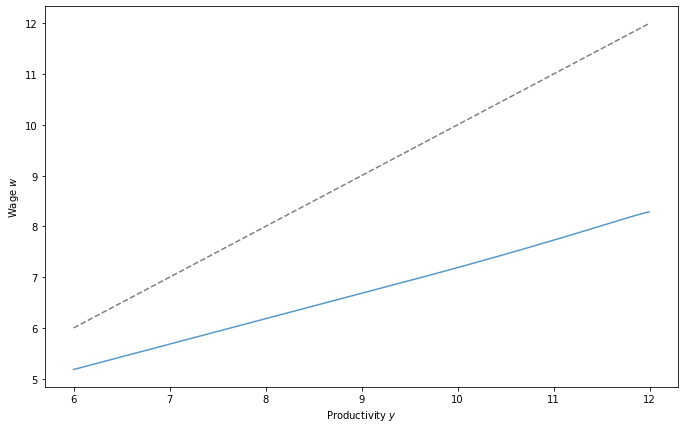

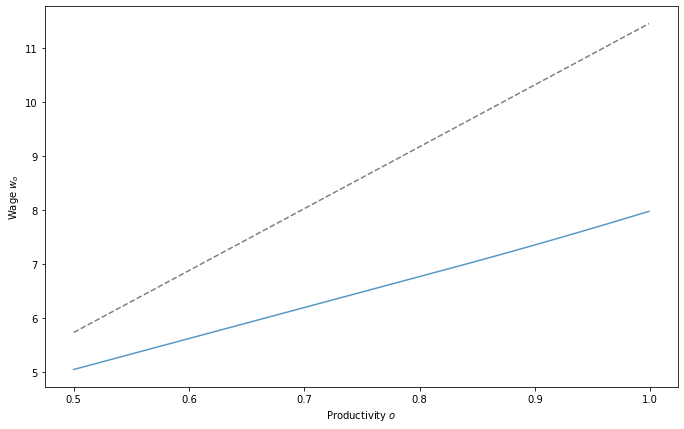

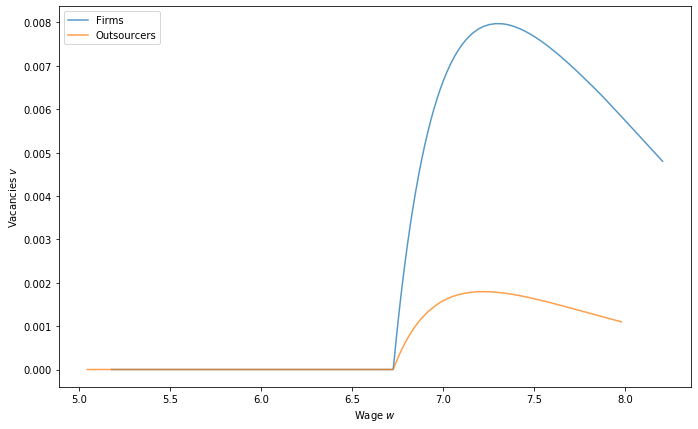

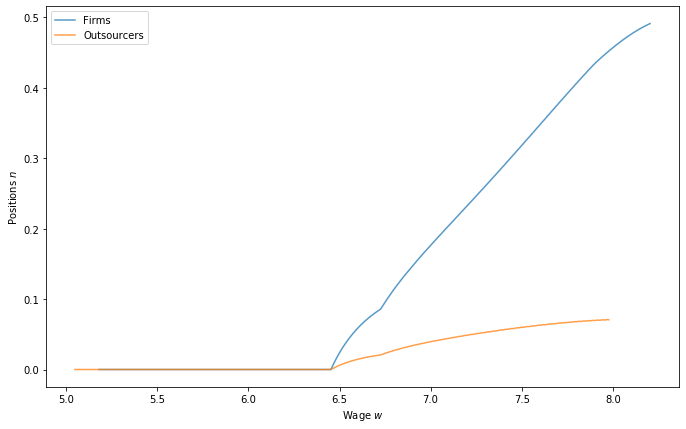

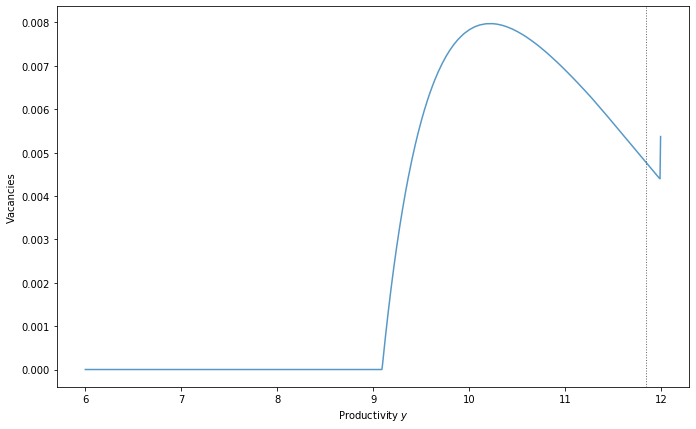

...

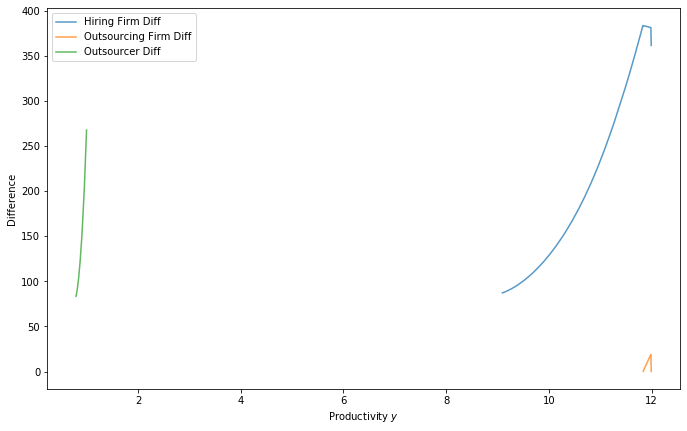

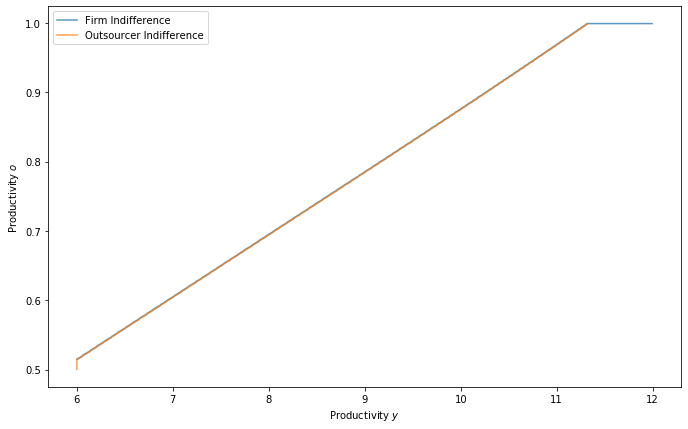

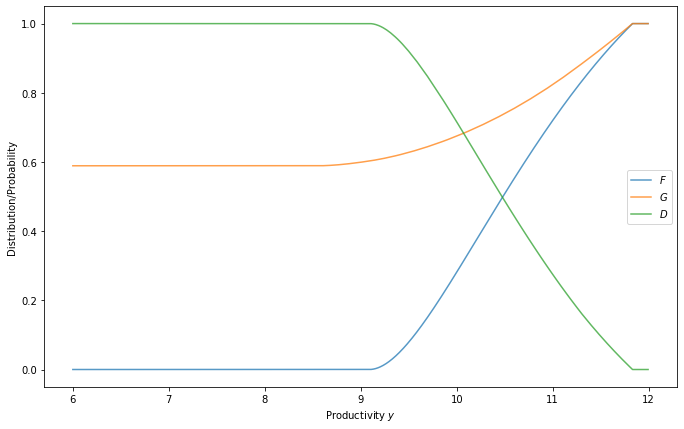

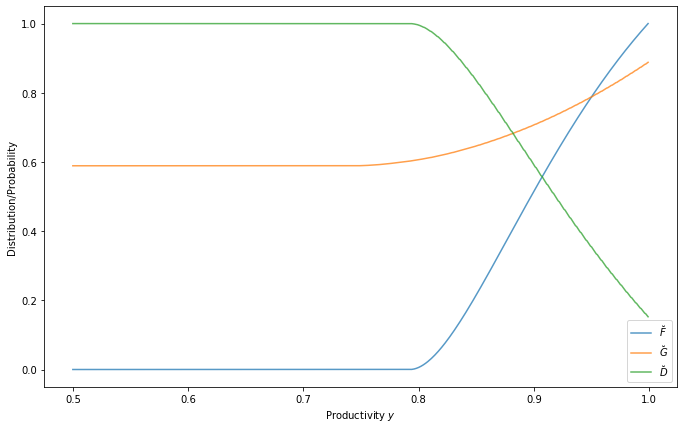

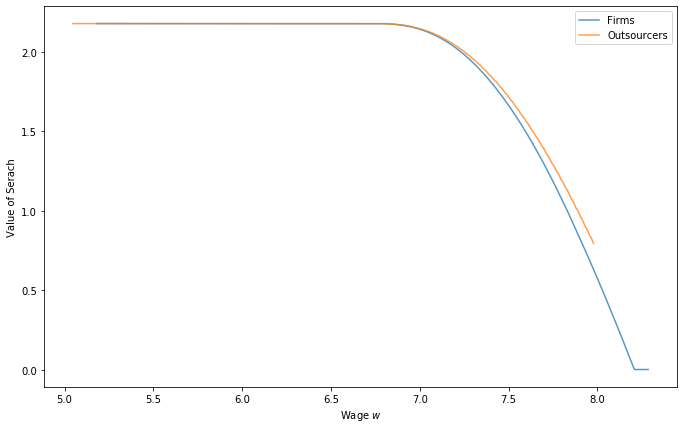

In [4]:
r = 0.000939
B = 1 / (1 + r)
delta = 0.0045
delta_o = 0.0050
delta_hat = 0.0040
xi = .1
# xi = 0
eta = 0.5
eta_o = 0.5
phi = 2e-1 
y_min = 6
y_max = 12
o_min = 0.5
o_max = 1.0
b = y_min * .4 
y_grid_size = 1000
# y_grid_size = 8000
o_grid_size = 500
gamma = 2
gamma_o = 2
k_grid = np.logspace(0, 4, y_grid_size, endpoint = False)
k_o_grid = np.logspace(0, 4, o_grid_size, endpoint = False)
# k_grid = 1e9
# k_o_grid = 1e9

p_low = 6
p_high = 12
tol = 1e-4
max_iter = 15
tol_i = 1e-4
max_iter_i = 3e4
slow_i = 5e-2
print_skip = 5
verbose = True

save = True

ooj = OutsourcingOnJob(
    B, b, delta, delta_o, delta_hat, xi, eta, eta_o, phi,
    y_min, y_max, y_grid_size, o_min, o_max, o_grid_size,
    gamma, gamma_o, k_grid, k_o_grid
)

v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p = find_p(
    ooj, p_low, p_high, tol, max_iter, tol_i, max_iter_i, slow_i, verbose, print_skip
)

list_facts(ooj, v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p)

graph_results(ooj, v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p,
             save=save)

In [92]:
%debug

> <ipython-input-90-7e7ce390805f>(278)solve_given_p()
    276         (v_grid_new, v_o_grid_new, n_grid_new, n_o_grid_new,
    277          y_hat_new, R_grid_new, R_o_grid_new) = iterate(
--> 278             v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p
    279         )
    280         err_v = np.max(np.abs(v_grid_new - v_grid))

ipdb> n_grid
array([5.59848004e-01, 5.60860001e-01, 5.61884123e-01, 5.62921801e-01,
       5.63973379e-01, 5.65039214e-01, 5.66119682e-01, 5.67215222e-01,
       5.68326342e-01, 5.69453567e-01, 5.70597350e-01, 5.71758092e-01,
       5.72936308e-01, 5.74132525e-01, 5.75347385e-01, 5.76581413e-01,
       5.77835142e-01, 5.79109145e-01, 5.80404010e-01, 5.81720330e-01,
       5.83058713e-01, 5.84419773e-01, 5.85804138e-01, 5.87212443e-01,
       5.88645336e-01, 5.90103473e-01, 5.91587525e-01, 5.93098169e-01,
       5.94636097e-01, 5.96202010e-01, 5.97796622e-01, 5.99420657e-01,
       6.01074854e-01, 6.02759961e-01, 6.04476741e-01, 6.06225969e-01

ipdb> v_grid
array([4.64062701e-03, 4.66459216e-03, 4.68929218e-03, 4.71487332e-03,
       4.74116300e-03, 4.76810250e-03, 4.79563462e-03, 4.82371504e-03,
       4.85231986e-03, 4.88139785e-03, 4.91084152e-03, 4.94055721e-03,
       4.97054930e-03, 5.00082142e-03, 5.03147765e-03, 5.06247825e-03,
       5.09378859e-03, 5.12541060e-03, 5.15734597e-03, 5.18959624e-03,
       5.22216280e-03, 5.25504693e-03, 5.28824982e-03, 5.32177262e-03,
       5.35561638e-03, 5.38978216e-03, 5.42427096e-03, 5.45908377e-03,
       5.49422160e-03, 5.52968541e-03, 5.56547621e-03, 5.60159500e-03,
       5.63804280e-03, 5.67482065e-03, 5.71192963e-03, 5.74937082e-03,
       5.78714536e-03, 5.82525441e-03, 5.86369919e-03, 5.90248095e-03,
       5.94160096e-03, 5.98106058e-03, 6.02086119e-03, 6.06100423e-03,
       6.10149120e-03, 6.14232364e-03, 6.18350317e-03, 6.22503144e-03,
       6.26691019e-03, 6.30932191e-03, 6.35246932e-03, 6.39599371e-03,
       6.43989701e-03, 6.48418117e-03, 6.52884826e-03, 6.5739004

ipdb> n_o_grid
array([6.68183578e-01, 6.66463636e-01, 6.64777812e-01, 6.63126782e-01,
       6.61512492e-01, 6.59934630e-01, 6.58394226e-01, 6.56893515e-01,
       6.55431832e-01, 6.54016246e-01, 6.52653555e-01, 6.51336488e-01,
       6.50064898e-01, 6.48841076e-01, 6.47667522e-01, 6.46546925e-01,
       6.45482136e-01, 6.44476171e-01, 6.43534853e-01, 6.42660852e-01,
       6.41860788e-01, 6.41140469e-01, 6.40505919e-01, 6.39964643e-01,
       6.39523720e-01, 6.39189825e-01, 6.38968476e-01, 6.38866138e-01,
       6.38886788e-01, 6.39031997e-01, 6.39302967e-01, 6.39707459e-01,
       6.40242599e-01, 6.40908321e-01, 6.41712359e-01, 6.42652391e-01,
       6.43722925e-01, 6.44928678e-01, 6.46280948e-01, 6.47756851e-01,
       6.49390954e-01, 6.51151007e-01, 6.53057368e-01, 6.55115933e-01,
       6.57296138e-01, 6.59640643e-01, 6.62139294e-01, 6.64766463e-01,
       6.67523675e-01, 6.70484525e-01, 6.73586548e-01, 6.76826138e-01,
       6.80204985e-01, 6.83724808e-01, 6.87438310e-01, 6.91422

ipdb> c


The indifferent firm is y_hat = 11.87$. Price of outsourcing is 11.44.
Unemployment is 7.19. According to LoM, should be 6.45
Workers match with probability 6.66. Firms/Outsourcers match with probability 60.09
Total vacancies searching for workers are 0.0183. Theta is 0.1108
29 percent of vacancies searching for workers are from outsourcers, 19 percent of postions outsourced
The ue rate is 0.07, the ee rate is 0.01,  and 43.378050 of new jobs are from unemployment
Checking if vacancies + LoM imply right positions:
 Hiring firms large error = 0.228368 at position 764 
 Outsourcing firms largest error = 0.000000 at position 0
 Outsourcer largest error = 3.325461 at position 69


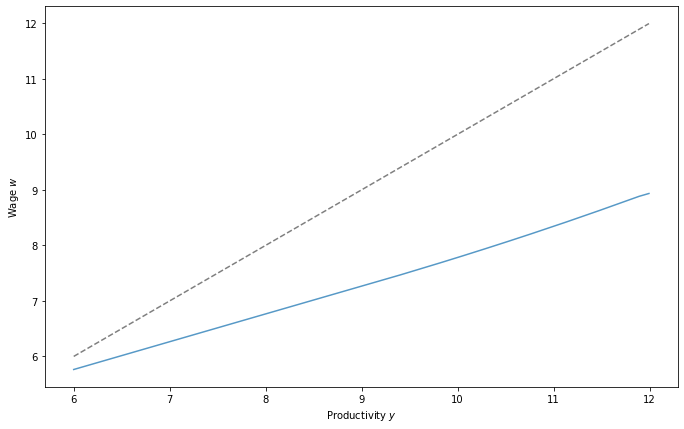

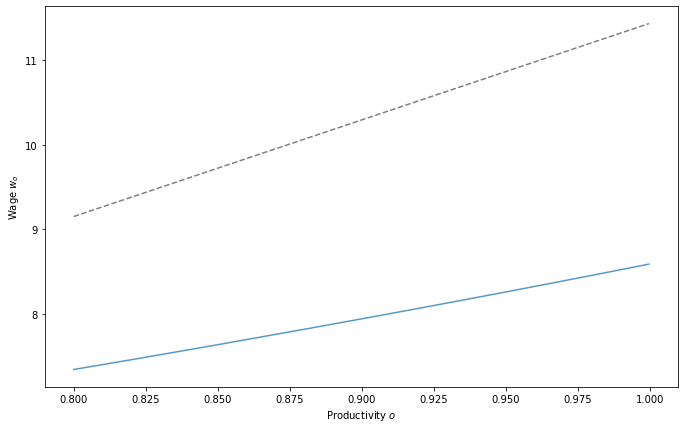

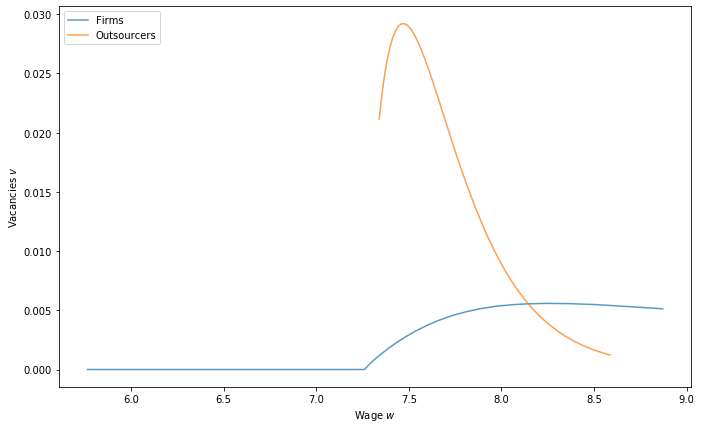

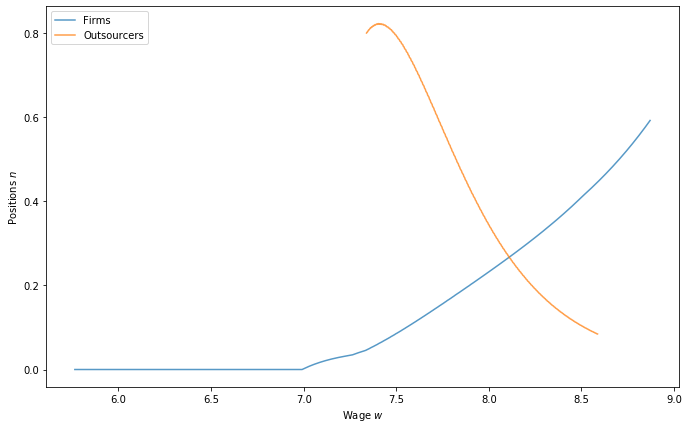

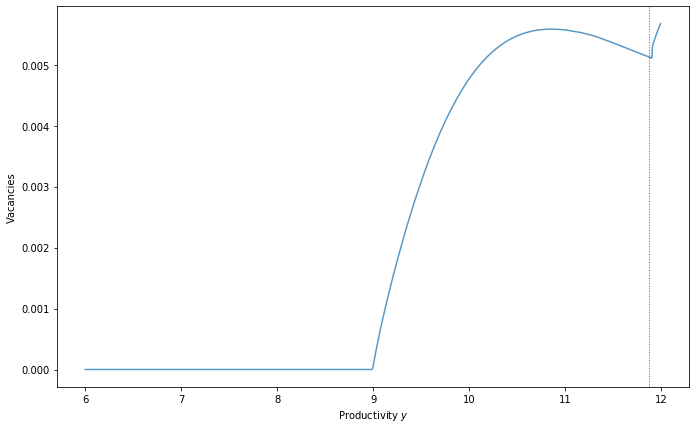

...

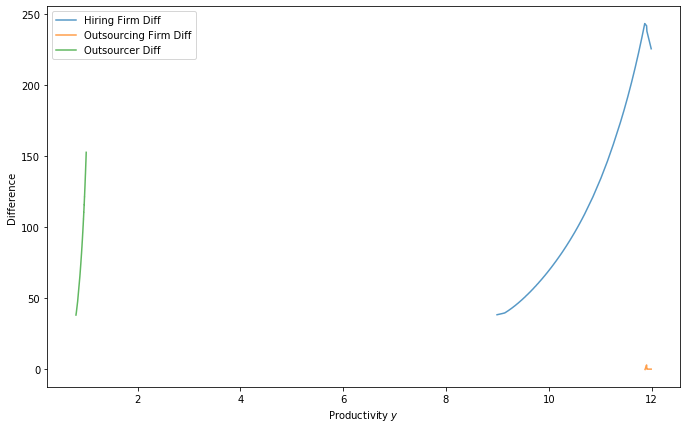

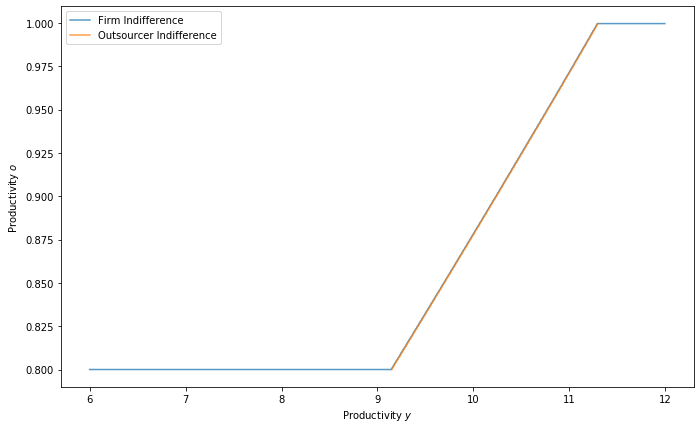

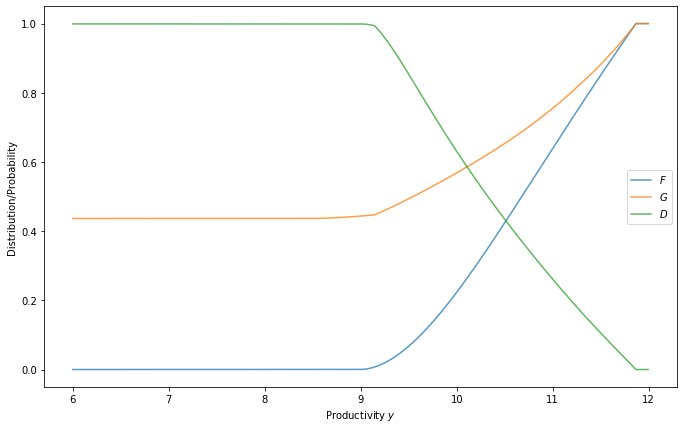

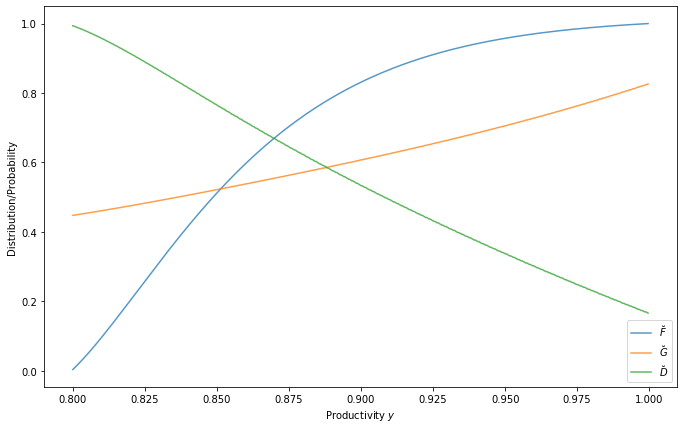

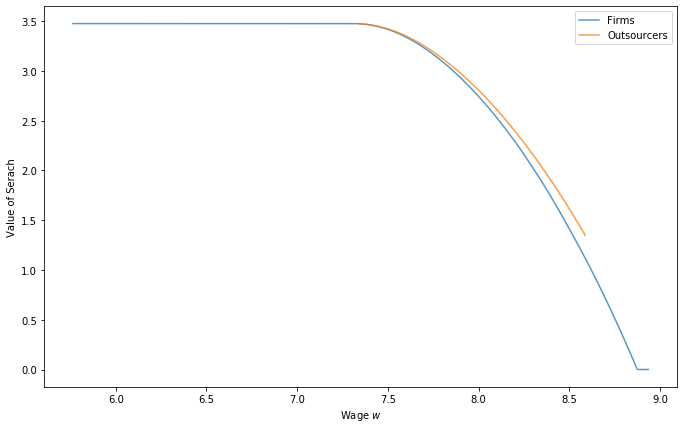

In [45]:
list_facts(ooj, v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p)

graph_results(ooj, v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p)

In [9]:
x = np.array([1, 2, 5, 11], dtype=np.int32)
y = np.linspace(1, 10, 10)

np.searchsorted(y, x)
np.searchsorted?

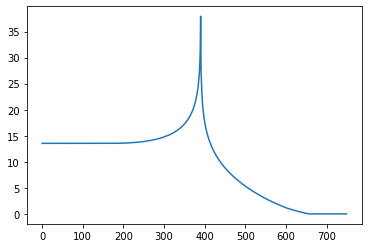

In [15]:
_, QD_QS, make_grids, C, c, c_inv, C_o, c_o, c_o_inv = operator_factory(ooj)

(theta, G_grid, G_o_grid, D_grid, D_o_grid, Gamma_U,
     Gamma_grid, Gamma_o_grid, w_grid, w_o_grid) = make_grids(
        v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p
    )

plt.plot(Gamma_grid)

error is 0.0001, went through 19678 iterations
The difference in theta and theta_new is -0.0000


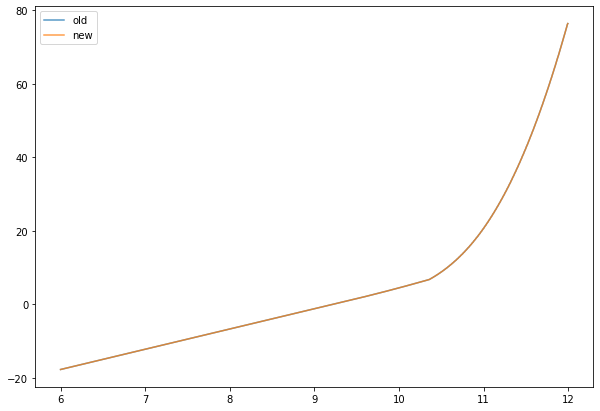

In [33]:
tol = 1e-4
max_iter = 2e4
slow = 5e-2
verbose = True

y_grid, y_grid_size = ooj.y_grid, ooj.y_grid_size  
o_grid, o_grid_size = ooj.o_grid, ooj.o_grid_size 

p = 13

v_grid = np.ones(y_grid_size) / y_grid_size
n_grid = np.ones(y_grid_size) / y_grid_size
v_o_grid = np.ones(o_grid_size) / o_grid_size
n_o_grid = np.ones(o_grid_size) / o_grid_size
# y_hat = np.intc(y_grid_size / 2)
y_hat = np.argmin(np.abs(p - y_grid))
R_grid = np.intc(np.minimum(np.arange(y_grid_size), o_grid_size))
R_o_grid = np.intc(np.minimum(np.arange(o_grid_size), y_grid_size))


iterate, QD_QS, make_grids, _, _, _, _, _, _ = operator_factory(ooj)
# iterate(v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p)

v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid = solve_given_p(
    ooj, p, v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, tol, max_iter, slow, verbose
)

In [226]:
# (0.14081766803897883, 0.1435855960231627)
QD_QS(n_grid, n_o_grid, y_hat)

(0.13963359516781232, 0.14367798173932175)

In [19]:
rm, rm_o = ooj.rm, ooj.rm_o
y_hat_n = y_hat - 1

u = max(1 - np.sum(n_grid[:y_hat_n] * rm) - np.sum(n_o_grid * rm_o), 1e-9)
v_tilde = max(np.sum(v_grid[:y_hat_n] * rm), 1e-9)
v_o = max(np.sum(v_o_grid * rm_o), 1e-9)
s = (u + xi * (np.sum(n_grid[:y_hat_n] * rm) + np.sum(n_o_grid * rm_o)))

# Calculate theta and pi 
v_sum = v_tilde + v_o
theta = v_sum / s
theta
# 0.0967115611243406
# 0.09885978251244253
# 0.09465534417167097
ooj.q(0.09885978251244253), ooj.q(0.0967115611243406), ooj.q(0.09465534417167097)


(0.6360923467412612, 0.643118198017034, 0.6500659613748727)

In [59]:
(theta, G_grid, G_o_grid, D_grid, D_o_grid,
         Gamma_U, Gamma_grid, Gamma_o_grid, w_grid, w_o_grid) = make_grids(
            v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p)

J_hire = ooj.q(theta) * G_grid * (y_grid - w_grid) / (r + delta + (1 - delta) * D_grid)
J_out = (y_grid - p) / (r + delta_hat)
    
min(np.searchsorted(J_out - np.maximum(J_hire, 0), 0), y_grid_size - 1), np.argmin(np.abs(J_out - np.maximum(J_hire, 0))), y_hat

(708, 707, 0)

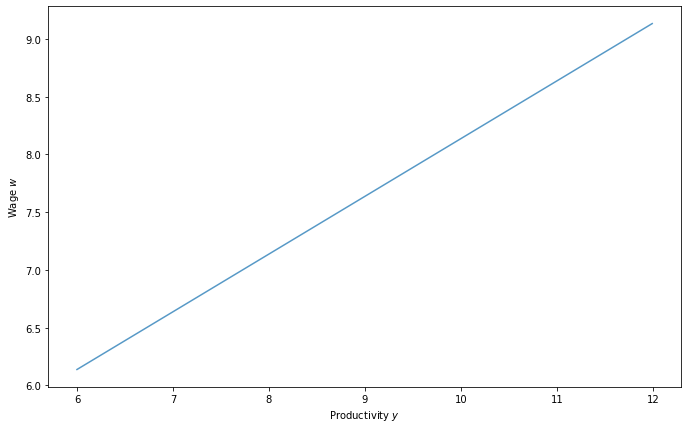

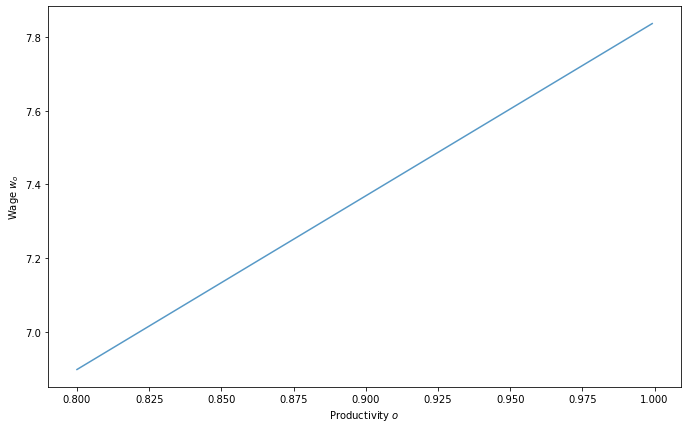

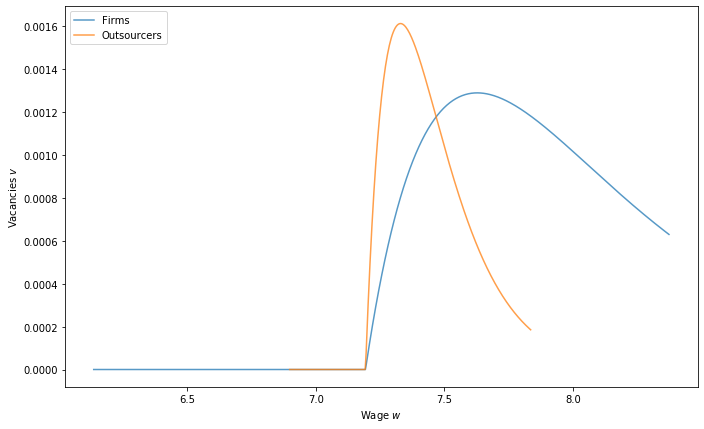

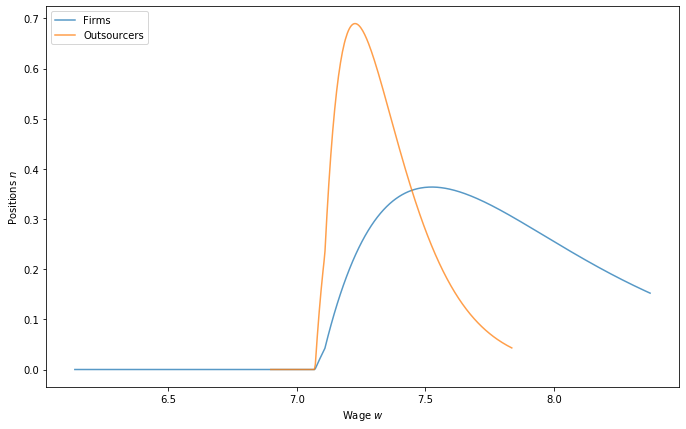

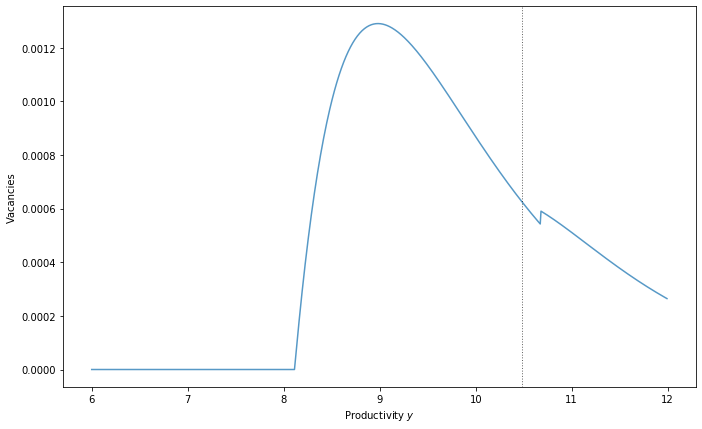

...

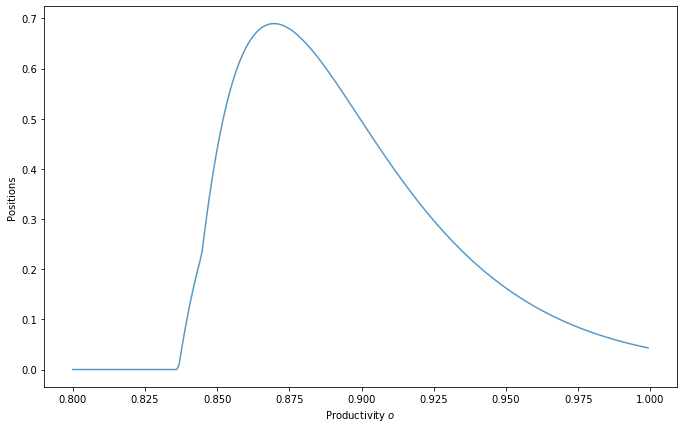

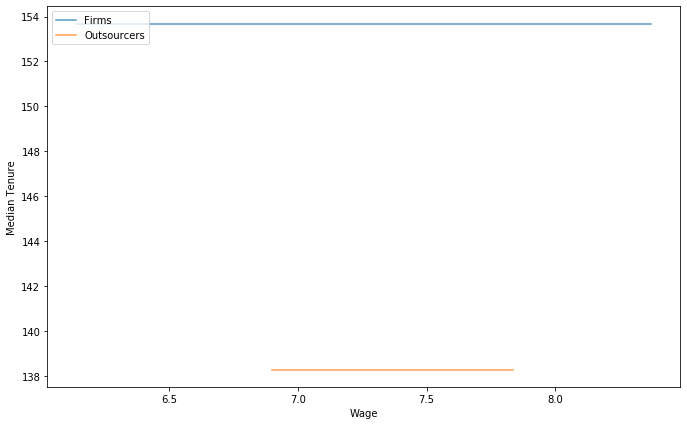

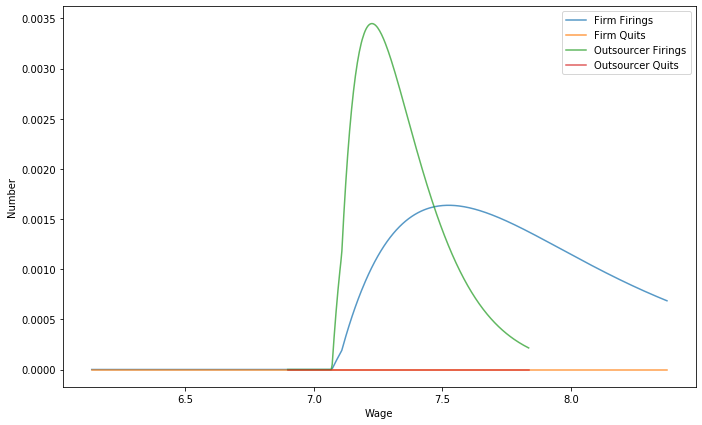

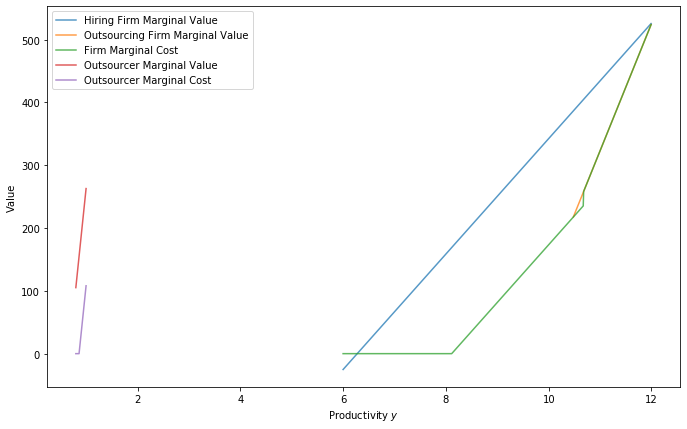

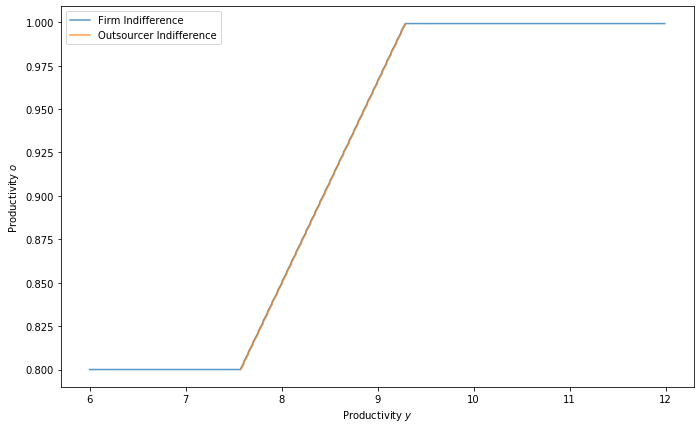

C:\Users\spspi\Anaconda3\lib\site-packages\ipykernel_launcher.py:614: RuntimeWarning: invalid value encountered in true_divide


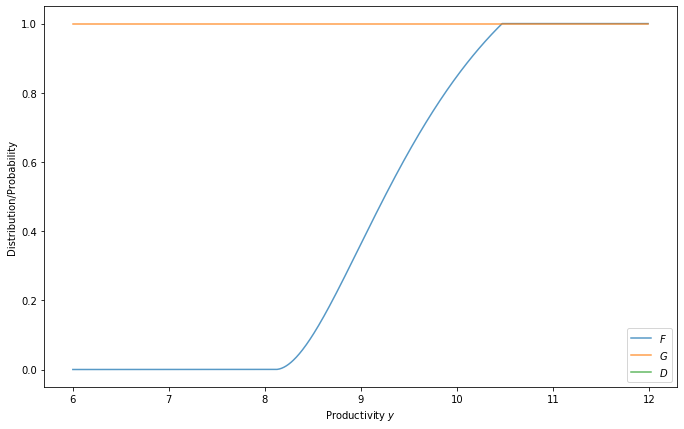

C:\Users\spspi\Anaconda3\lib\site-packages\ipykernel_launcher.py:630: RuntimeWarning: invalid value encountered in true_divide


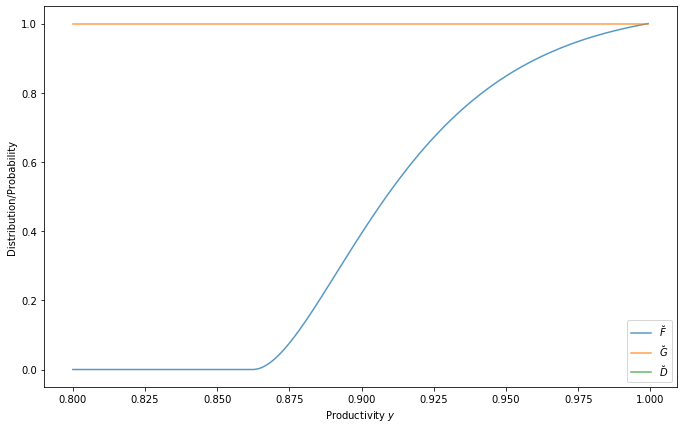

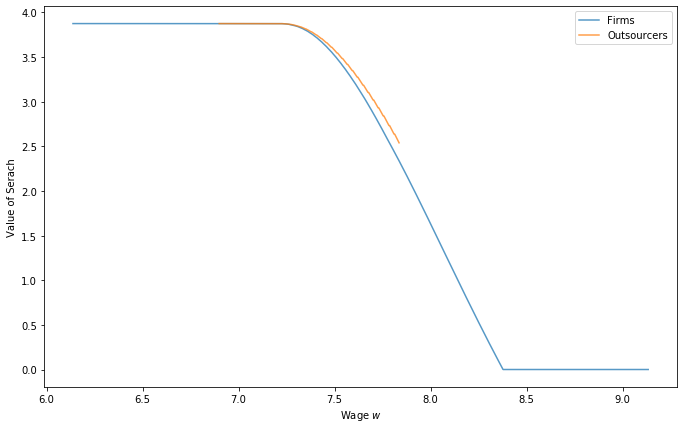

(0.16781707225120004, 0.14329024979847024)

In [229]:
iterate, QD_QS, make_grids, _, _, _, _, _, _ = operator_factory(ooj)
v_grid_new, v_o_grid_new, n_grid_new, n_o_grid_new, y_hat_new, R_grid_new, R_o_grid_new = iterate(
    v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p)

graph_results(ooj, v_grid_new, v_o_grid_new, n_grid_new, n_o_grid_new, y_hat_new, R_grid_new, R_o_grid_new, p)

QD_QS(n_grid_new, n_o_grid_new, y_hat_new)

error is 0.0119, went through 10000 iterations
The difference in theta and theta_new is -0.0600


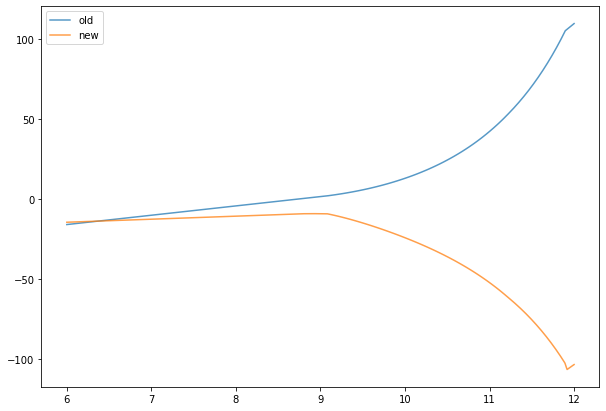

The indifferent firm is y_hat = 11.92$. Price of outsourcing is 11.37.
Unemployment is 1.66. According to LoM, should be 4.44
Workers match with probability 9.85. Firms/Outsourcers match with probability 40.61
Total vacancies searching for workers are 0.0279. Theta is 0.2425
31 percent of vacancies searching for workers are from outsourcers, 16 percent of postions outsourced
The ue rate is 0.10, the ee rate is 0.01,  and 15.963256 of new jobs are from unemployment
Checking if vacancies + LoM imply right positions:
 Hiring firms large error = 0.949235 at position 7871 
 Outsourcing firms largest error = 0.000000 at position 0
 Outsourcer largest error = 1.565387 at position 52


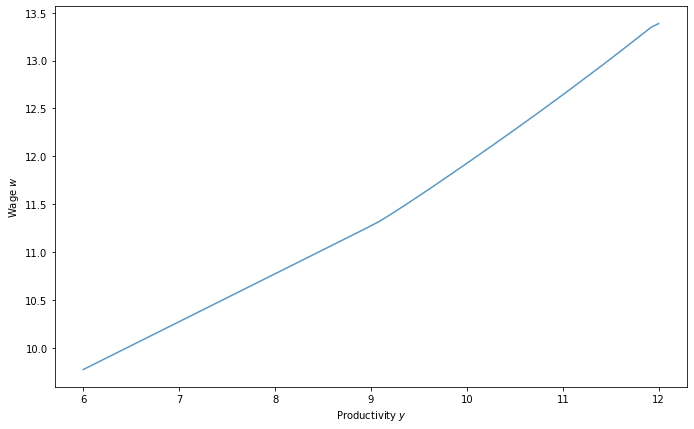

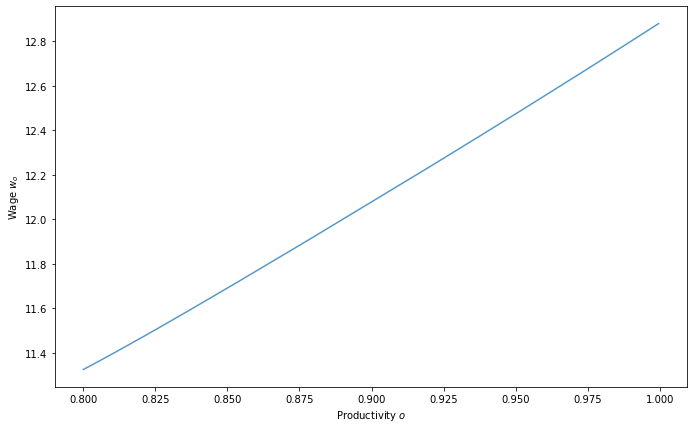

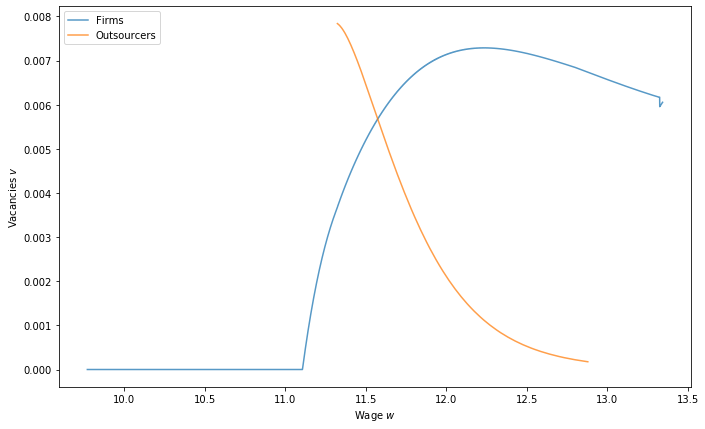

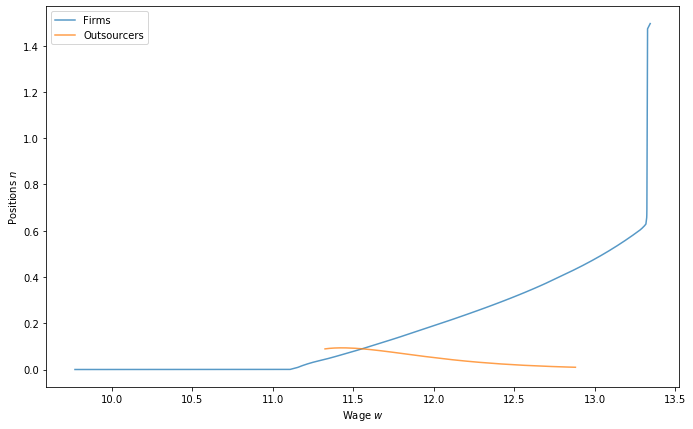

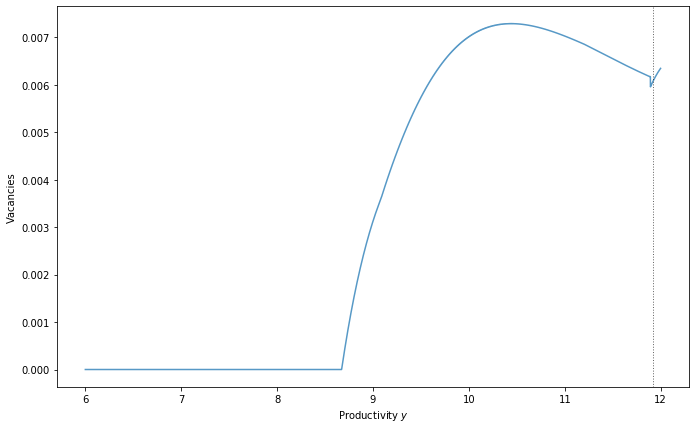

...

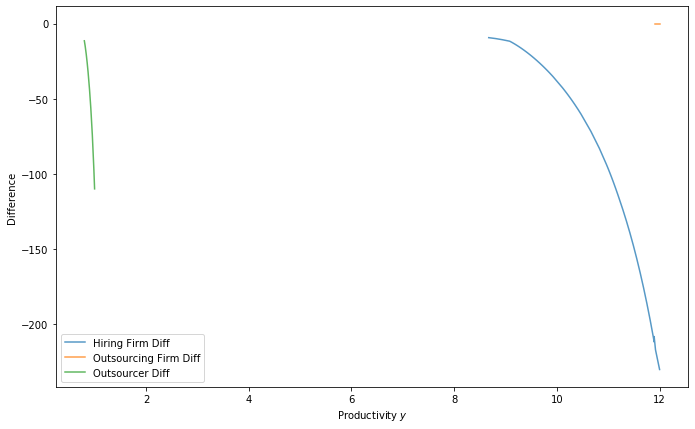

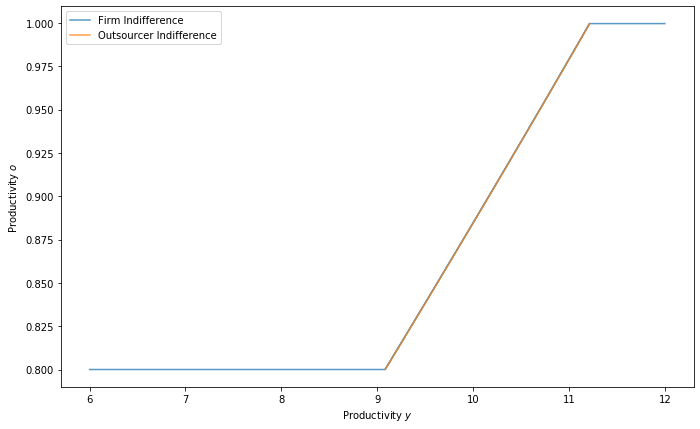

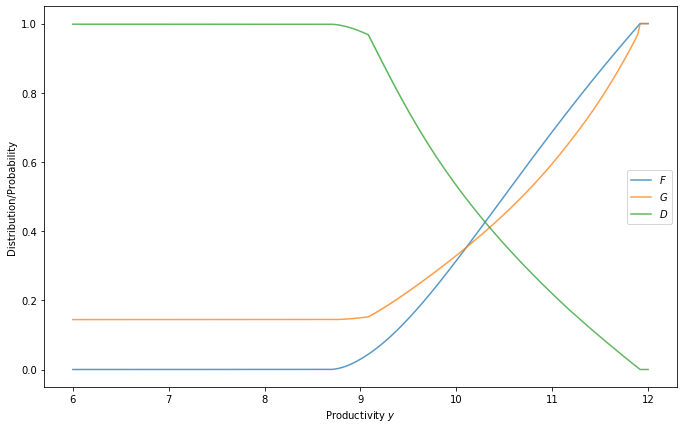

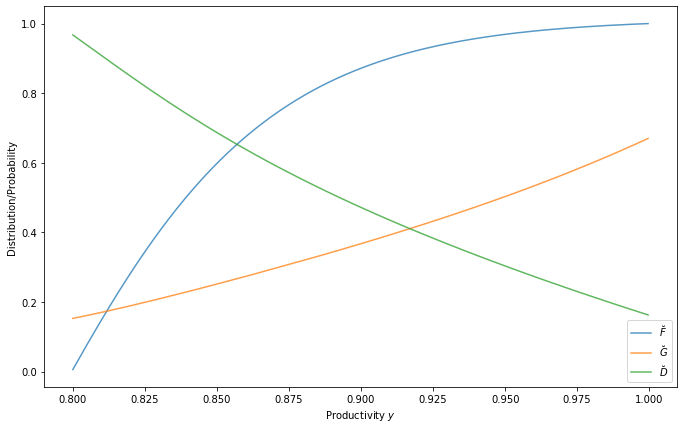

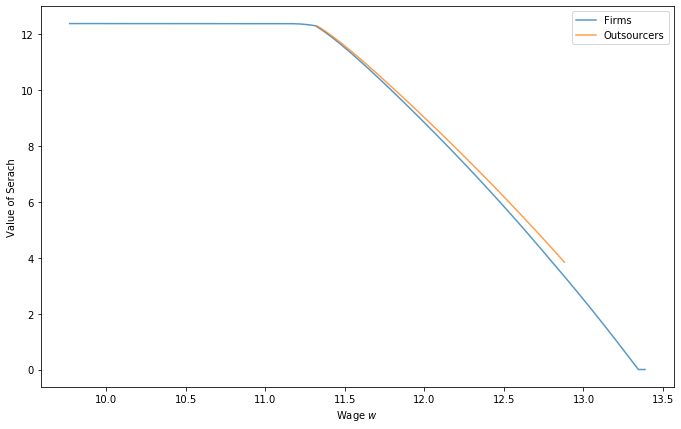

In [24]:
tol = 1e-4
max_iter = 1e4
slow = 1e-2
verbose = True

v_grid_new, v_o_grid_new, n_grid_new, n_o_grid_new, y_hat_new, R_grid_new, R_o_grid_new = solve_given_p(
    ooj, p, v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, tol, max_iter, slow, verbose
)

list_facts(ooj, v_grid_new, v_o_grid_new, n_grid_new, n_o_grid_new, y_hat_new, R_grid_new, R_o_grid_new, p)

graph_results(ooj, v_grid_new, v_o_grid_new, n_grid_new, n_o_grid_new, y_hat_new, R_grid_new, R_o_grid_new, p)

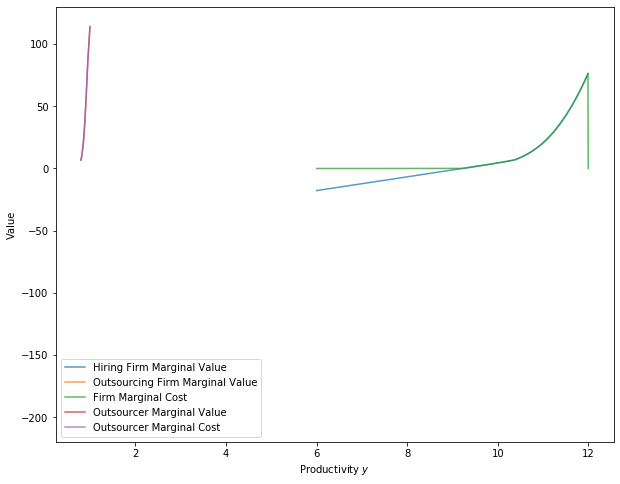

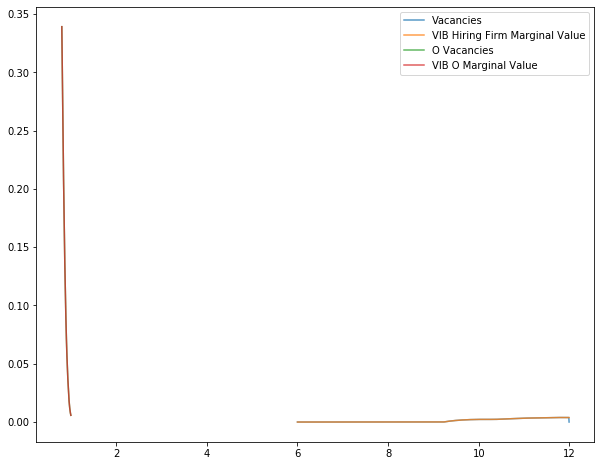

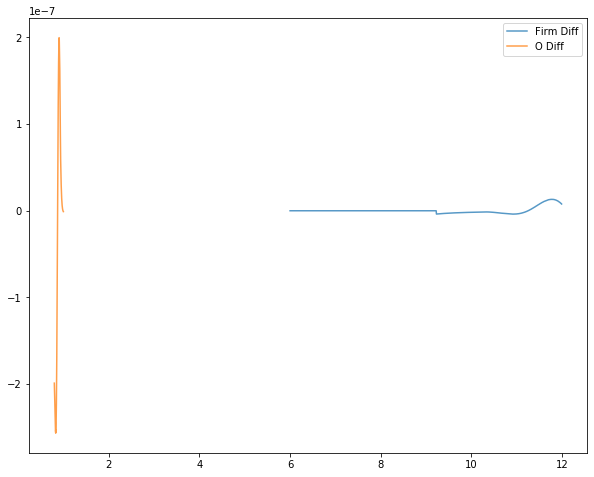

In [37]:
iterate, QD_QS, make_grids, C, c, c_inv, C_o, c_o, c_o_inv = operator_factory(ooj)

(theta, G_grid, G_o_grid, D_grid, D_o_grid,
         Gamma_U, Gamma_grid, Gamma_o_grid, w_grid, w_o_grid) = make_grids(
            v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, p)

# (theta, G_grid, G_o_grid, D_grid, D_o_grid,
#          Gamma_U, Gamma_grid, Gamma_o_grid, w_grid, w_o_grid) = make_grids(
#             v_grid_new, v_o_grid_new, n_grid_new, n_o_grid_new, y_hat_new, R_grid_new, R_o_grid_new, p)

q = ooj.q
y_grid, o_grid = ooj.y_grid, ooj.o_grid

J_hire = q(theta) * G_grid * (y_grid - w_grid) / (r + delta + (1 - delta) * D_grid)
J_out = (y_grid - p) / (r + delta_hat)
mc = c(v_grid)    

O = q(theta) * G_o_grid * (p * o_grid - w_o_grid) / (r + delta_o + (1 - delta_o) * D_o_grid)
mc_o = c_o(v_o_grid) 

fig, ax = plt.subplots(figsize=(10,8))
ax.plot(y_grid, J_hire, alpha=0.75, label="Hiring Firm Marginal Value")
ax.plot(y_grid[y_hat:], J_out[y_hat:], alpha=0.75, label="Outsourcing Firm Marginal Value")
ax.plot(y_grid, mc, alpha=0.75, label="Firm Marginal Cost")
ax.plot(o_grid, O, alpha=0.75, label="Outsourcer Marginal Value")
ax.plot(o_grid, mc_o, alpha=0.75, label="Outsourcer Marginal Cost")
ax.set(xlabel="Productivity $y$", ylabel="Value")
ax.legend(loc="best")

plt.show()

fig, ax = plt.subplots(figsize=(10,8))
ax.plot(y_grid, v_grid, alpha=0.75, label="Vacancies")
ax.plot(y_grid, c_inv(J_hire), alpha=0.75, label="VIB Hiring Firm Marginal Value")
ax.plot(o_grid, v_o_grid, alpha=0.75, label="O Vacancies")
ax.plot(o_grid, c_o_inv(O), alpha=0.75, label="VIB O Marginal Value")
ax.legend(loc="best")

plt.show()

fig, ax = plt.subplots(figsize=(10,8))
ax.plot(y_grid[:y_hat], v_grid[:y_hat] - c_inv(J_hire)[:y_hat], alpha=0.75, label="Firm Diff")
ax.plot(o_grid, v_o_grid - c_o_inv(O), alpha=0.75, label="O Diff")
ax.legend(loc="best")

plt.show()

In [64]:
# Set up code for the outsourcer's problem with on-the-job search
# Builds on Outsourcers file

import numpy as np
import matplotlib.pyplot as plt
import quantecon as qe
from numba import njit, prange, vectorize, int32, float64
from IPython.core.debugger import set_trace

class OutsourcingOnJob:
    """
    B is discount rate beta
    r is interest rate defined by beta
    b is home production
    delta is job loss rate at firm
    delta_o is job loss rate at outsourcer
    delta_hat is firm destruction rate of outsourcing firm <= delta
    xi is probability of searching on-the-job
    eta is workers bargaining power with firm
    eta_o is workers bargaining power with outsourcer
    phi is effectiveness of matching function
    y_min, y_max, y_grid_size determine firm productivity grid
    rm is to Reimann Sum approximate firm integrals
    o_min, o_max, o_grid_size determine outsourcer productivity grid
    rm_o is to Reimann Sum approximate outsourcer integrals
    gamma is steepness of marginal cost, k_grid is level of entry cost
    gamma_h is steepness of marginal cost for outsourcers, k_o_grid is level of cost
    q is matching function of firms
    ell is matching function of workerso
    """
    def __init__(
        self, B, b, delta, delta_o, delta_hat, xi, eta, eta_o, phi,
        y_min, y_max, y_grid_size, o_min, o_max, o_grid_size,
        gamma, gamma_o, k_grid, k_o_grid
    ):
        
        self.B, self.b, self.delta, self.eta, self.gamma, self.k_grid = B, b, delta, eta, gamma, k_grid
        self.delta_hat, self.eta_o, self.gamma_o, self.k_o_grid = delta_hat, eta_o, gamma_o, k_o_grid 
        self.xi, self.delta_o = xi, delta_o
        self.r = 1 / B - 1
        
        self.y_grid = np.linspace(y_min, y_max, y_grid_size, endpoint = False)
        self.y_grid_size = y_grid_size    
        self.rm = (y_max - y_min) / y_grid_size
        
        self.o_grid = np.linspace(o_min, o_max, o_grid_size, endpoint = False)
        self.o_grid_size = o_grid_size    
        self.rm_o = (o_max - o_min) / o_grid_size
        
        self.q = njit(lambda x: min(phi * x**(-1 / 2), 1))
        self.ell = njit(lambda x: min(phi * x**(1 / 2), 1))
#         # Remember, q_p and p_p = 0 if q or p = 1
#         self.q_p = njit(lambda x: -phi / 2 * x**(-3 / 2) * (phi * x**(-1 / 2) < 1)) 
#         self.ell_p = njit(lambda x: phi / 2 * x**(1 / 2) * (phi * x**(1 / 2) < 1))


# Set up neccesary functions
def operator_factory(ooj):
    
    r, b, delta, eta, gamma, k_grid = ooj.r, ooj.b, ooj.delta, ooj.eta, ooj.gamma, ooj.k_grid
    delta_hat, eta_o, gamma_o, k_o_grid = ooj.delta_hat, ooj.eta_o, ooj.gamma_o, ooj.k_o_grid
    xi, delta_o = ooj.xi, ooj.delta_o
    q, ell = ooj.q, ooj.ell
    
    y_grid, y_grid_size, rm = ooj.y_grid, ooj.y_grid_size, ooj.rm
    o_grid, o_grid_size, rm_o = ooj.o_grid, ooj.o_grid_size, ooj.rm_o
    
    # Want cost of vacancy, marginal cost of vacancy, and inverse marginal cost of vacancy
    @njit()
    def C(v_grid):
        return k_grid * v_grid**gamma
    
    @njit()
    def c(v_grid):
        return k_grid * gamma * v_grid**(gamma - 1)

    @njit()
    def c_inv(c_grid):
        return (np.maximum(c_grid, 0) / (gamma * k_grid))**(1 / (gamma - 1))
        
    # Do the same for outsourcers
    @njit()
    def C_o(v_o_grid):
        return k_o_grid * v_o_grid**gamma_o

    @njit()
    def c_o(v_o_grid):
        return k_o_grid * gamma_o * v_o_grid**(gamma_o - 1)

    @njit()
    def c_o_inv(c_o_grid):
        return (np.maximum(c_o_grid, 0) / (gamma_o * k_o_grid))**(1 / (gamma_o - 1))
    
    # Given v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, theta, and p, find
    # Firms who directly hire hire vs those that outsource out
    # Distribution of vacanices F and F_o
    # Distribution of job seekers G and G_o
    # Probability of worker leaving D and D_o
    # Wages w and w_o
    @njit()
    def make_grids(v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, theta, p):           
        
        # Define aggregate populations (make sure all exist)
        u = max(1 - np.sum(n_grid[:y_hat] * rm) - np.sum(n_o_grid * rm_o), 1e-9)
        v_tilde = max(np.sum(v_grid[:y_hat] * rm), 1e-9)
        v_o = max(np.sum(v_o_grid * rm_o), 1e-9)
        s = (u + xi * (np.sum(n_grid[:y_hat] * rm) + np.sum(n_o_grid * rm_o)))
        
        # Calculate pi 
        v_sum = v_tilde + v_o
        pi = v_o / v_sum
        
        # Calculate distributions 
        # F is distribution of vacancies (include firms above y_hat in cdf as 1)
        F_grid = np.minimum(np.cumsum(v_grid * rm) / v_tilde, 1)
        f_grid = v_grid / v_tilde
        f_grid[y_hat:] = 0
        
        F_o_grid = np.cumsum(v_o_grid * rm_o) / v_o
        f_o_grid = v_o_grid / v_o
        
        # G is distribution of job seekers (include firms above y_hat as bigger than all y firms)
        n_temp = np.copy(n_grid)
        n_temp[y_hat:] = 0
        G_grid = (
            (u + xi * (np.cumsum(n_temp * rm)
                       + np.array([np.sum(n_o_grid[:R] * rm_o) for R in R_grid]))) 
            / s
        )
        G_o_grid = (
            (u + xi * (np.array([np.sum(n_temp[:R_o] * rm) for R_o in R_o_grid]) 
                       + np.cumsum(n_o_grid * rm_o))) 
            / s
        )
        
        # D is probability a worker finds a better job
        D_grid = xi * ell(theta) * (1 - (1 - pi) * F_grid - pi * F_o_grid[R_grid]) 
        D_o_grid = xi * ell(theta) * (1 - (1 - pi) * F_grid[R_o_grid] - pi * F_o_grid) 
        
        # What is the value of search?
        # Store these vectors of values which will be used many times
        f_tot = c(v_grid) / G_grid * f_grid * rm
        o_tot = c_o(v_o_grid) / G_o_grid * f_o_grid * rm_o
        
        # For unemployed
        firm = eta / (1 - eta) * (1 - pi) * np.sum(f_tot)
        out = eta_o / (1 - eta_o) * pi * np.sum(o_tot)
        Gamma_U = ell(theta) / q(theta) * (firm + out)
        
        # For employed at a firm
        firm = eta / (1 - eta) * (1 - pi) * np.cumsum(f_tot[::-1])[::-1]
        out = eta_o / (1 - eta_o) * pi * np.array([np.sum(o_tot[R:]) for R in R_grid])
        Gamma_grid = ell(theta) / q(theta) * (firm + out)
        
        # For employed at an outsourcer
        firm = eta / (1 - eta) * (1 - pi) * np.array([np.sum(f_tot[R_o:]) for R_o in R_o_grid])
        out = eta_o / (1 - eta_o) * pi * np.cumsum(o_tot[::-1])[::-1]
        Gamma_o_grid = ell(theta) / q(theta) * (firm + out)
        
        # Find wages
        w_grid = eta * y_grid + (1 - eta) * (b + Gamma_U - (1 - delta) * xi * Gamma_grid) 
        w_o_grid = eta_o * p * o_grid + (1 - eta_o) * (b + Gamma_U - (1 - delta_o) * xi * Gamma_o_grid) 
        
        return (
            G_grid, G_o_grid, D_grid, D_o_grid, 
            Gamma_U, Gamma_grid, Gamma_o_grid, w_grid, w_o_grid
        )
    
    # Given v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, and p, find new values
    @njit()
    def iterate(v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, theta, p):
        
        (G_grid, G_o_grid, D_grid, D_o_grid,
         Gamma_U, Gamma_grid, Gamma_o_grid, w_grid, w_o_grid) = make_grids(
            v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, theta, p)
        
        v_grid_new = np.empty(y_grid_size)
        n_grid_new = np.empty(y_grid_size)
        
        # Value of firms
        J_hire = q(theta) * G_grid * (y_grid - w_grid) / (r + delta + (1 - delta) * D_grid)
        J_out = (y_grid - p) / (r + delta_hat)
        
        # Update y_hat by finding firm closest to indifferent between hiring/outsourcing
        # Make sure J_out is non_negative at y_hat
#         y_hat_new = min(np.searchsorted(J_out - np.maximum(J_hire, 0), 0), y_grid_size - 1)
        y_diff = np.argmin(np.abs(J_out - J_hire))
        y_zero = np.argmin(np.abs(J_out))
        y_hat_new = max(y_diff, y_zero)
        
        # Update vacancies
        # Hiring firms (below y_hat)
        v_grid_new[:y_hat] = c_inv(J_hire)[:y_hat]
        
        # Outsourcing firms (above y_hat)
        v_grid_new[y_hat:] = c_inv(J_out)[y_hat:]
        
        # Outsourcers
        v_o_grid_new = c_o_inv(
            (o_grid * p - w_o_grid) * q(theta) * G_o_grid / (r + delta_o + (1 - delta_o) * D_o_grid)
        )
        
        # Update positions
        # Hiring firms
        n_temp = (1 - delta) * (1 - D_grid) * n_grid + q(theta) * G_grid * v_grid_new
        n_grid_new[:y_hat] = n_temp[:y_hat]
        
        # Outsourcing firms
        n_grid_new[y_hat:] = (1 - delta_hat) * n_grid[y_hat:] + v_grid_new[y_hat:]
        
        # Outsourcers
        n_o_grid_new = (1 - delta_o) * (1 - D_o_grid) * n_o_grid + q(theta) * G_o_grid * v_o_grid_new
               
        # Update R_grid and R_o_grid by comparing W - U to W_o - U.
        # Note that R_grid is defined for all firms, even those above 
        # y_hat, and R_o_grid might be indiffeferent to a firm above y_hat that doesn't hire
        # Value of employment at a firm (minus value of unemployment)        
        W_min_U = (
            (1 + r) * (w_grid - b - Gamma_U + (1 - delta) * xi * Gamma_grid)
            / (r + delta + (1 - delta) * D_grid)
        )
        
        # Value of employment at an outsourcer (minus value of unemployment)
        W_o_min_U = (
            (1 + r) * (w_o_grid - b - Gamma_U + (1 - delta_o) * xi * Gamma_o_grid)
            / (r + delta_o + (1 - delta_o) * D_o_grid)
        )
                
        # Use these to find new indecision rules
#         R_grid_new = np.array(
#             [np.argmin(np.abs(W_min_U[i] - W_o_min_U)) for i in np.arange(y_grid_size)]
#         )
#         R_o_grid_new = np.array(
#             [np.argmin(np.abs(W_min_U - W_o_min_U[i])) for i in np.arange(o_grid_size)]
#         )

        # Use these and search sorted to find new indecision rules (make sure not above all)
        R_grid_new = np.minimum(np.searchsorted(W_o_min_U, W_min_U), o_grid_size - 1)
    
        R_o_grid_new = np.minimum(np.searchsorted(W_min_U, W_o_min_U), y_grid_size - 1)
        
        # Update theta
        u = max(1 - np.sum(n_grid_new[:y_hat] * rm) - np.sum(n_o_grid_new * rm_o), 1e-9)
        v_tilde = max(np.sum(v_grid_new[:y_hat] * rm), 1e-9)
        v_o = max(np.sum(v_o_grid_new * rm_o), 1e-9)
        s = (u + xi * (np.sum(n_grid_new[:y_hat] * rm) + np.sum(n_o_grid_new * rm_o)))
        theta_new = (v_tilde + v_o) / (u + xi * (1 - u))
        
        return (v_grid_new, v_o_grid_new, n_grid_new, n_o_grid_new,
                y_hat_new, R_grid_new, R_o_grid_new, theta_new)
    
    # Given n_grid, n_o_grid, and y_hat find excess demand for outsourcing 
    @njit()
    def QD_QS(n_grid, n_o_grid, y_hat):
        QD = np.sum(n_grid[y_hat:] * rm) 
        QS = np.sum(n_o_grid * o_grid * rm_o)
        return QD, QS
    
    return iterate, QD_QS, make_grids, C, c, c_inv, C_o, c_o, c_o_inv 

# @njit()
def solve_given_p(
    ooj, p, v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, theta, tol, max_iter, slow, verbose=False
):
    
    iterate, _, make_grids, _, _, _, _, _, _ = operator_factory(ooj)
    
    # Set up initial loop parameters
    i = 0
    err = tol + 1    
    
    # Update v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, and theta
    while i < max_iter and err > tol:
        (v_grid_new, v_o_grid_new, n_grid_new, n_o_grid_new,
         y_hat_new, R_grid_new, R_o_grid_new, theta_new) = iterate(
            v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, theta, p
        )
        err_v = np.max(np.abs(v_grid_new - v_grid))
        err_v_o = np.max(np.abs(v_o_grid_new - v_o_grid))
        err_n = np.max(np.abs(n_grid_new - n_grid))
        err_n_o = np.max(np.abs(n_o_grid_new - n_o_grid))
        err = max(err_v, err_v_o, err_n, err_n_o)
        i += 1
        
        v_grid = slow * v_grid_new + (1 - slow) * v_grid
        v_o_grid = slow * v_o_grid_new + (1 - slow) * v_o_grid
        n_grid = slow * n_grid_new + (1 - slow) * n_grid
        n_o_grid = slow * n_o_grid_new + (1 - slow) * n_o_grid
        theta = slow * theta_new + (1 - slow) * theta
        
        # To slowly adjust y_hat, R_grid, and R_o_grid (which are indexes), instead 
        # add/subtract by 1/5 if greater/less (depend on size)
#         y_pos = 1 * (y_hat_new > y_hat) + 4 * (y_hat_new - y_hat > 50)
#         y_neg = 1 * (y_hat_new < y_hat) + 4 * (y_hat_new - y_hat < -50)
#         y_hat = y_hat + y_pos - y_neg
        
#         R_pos = 1 * (R_grid_new > R_grid) + 4 * (R_grid_new - R_grid > 50)
#         R_neg = 1 * (R_grid_new < R_grid) + 4 * (R_grid_new - R_grid < -50)
#         R_grid = R_grid + R_pos - R_neg
        
#         R_o_pos = 1 * (R_o_grid_new > R_o_grid) + 4 * (R_o_grid_new - R_o_grid > 50)
#         R_o_neg = 1 * (R_o_grid_new < R_o_grid) + 4 * (R_o_grid_new - R_o_grid < -50)
#         R_o_grid = R_o_grid + R_o_pos - R_o_neg
        
        # To slowly adjust y_hat, R_grid, and R_o_grid (which are indexes), instead 
        # add/subtract by 1 if greater/less 
        y_hat = y_hat + 1 * (y_hat_new > y_hat) - 1 * (y_hat_new < y_hat)
        R_grid = R_grid + 1 * (R_grid_new > R_grid) - 1 * (R_grid_new < R_grid)
        R_o_grid = R_o_grid + 1 * (R_o_grid_new > R_o_grid) - 1 * (R_o_grid_new < R_o_grid)

    if verbose:
        (G_grid, G_o_grid, D_grid, D_o_grid,
         Gamma_U, Gamma_grid, Gamma_o_grid, w_grid, w_o_grid) = make_grids(
            v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, theta, p)
        (G_grid_new, G_o_grid_new, D_grid_new, D_o_grid_new,
         Gamma_U_new, Gamma_grid_new, Gamma_o_grid_new, w_grid_new, w_o_grid_new) = make_grids(
            v_grid_new, v_o_grid_new, n_grid_new, n_o_grid_new, y_hat_new, R_grid_new, R_o_grid_new, theta_new, p)
        
        theta_diff = theta - theta_new
        J_hire = (ooj.q(theta) * G_grid * (ooj.y_grid - w_grid)
                  / (ooj.r + ooj.delta + (1 - ooj.delta) * D_grid))
        J_hire_new = (ooj.q(theta_new) * G_grid_new * (ooj.y_grid - w_grid_new)
                      / (ooj.r + ooj.delta + (1 - ooj.delta) * D_grid_new))
#         J_diff = max(np.abs(J_hire_new - J_hire))
        
        print(f"error is {err:.4f}, went through {i} iterations")
        print(f"y_hat is {y_hat:.4f}, y_hat_new is {y_hat_new:.4f}")
        print(f"The difference in theta and theta_new is {theta_diff:.4f}")
        fig, ax = plt.subplots(figsize=(10, 7))
        ax.plot(ooj.y_grid, J_hire, alpha=0.75, label="old")
        ax.plot(ooj.y_grid, J_hire_new, alpha=0.75, label="new")
        ax.legend()
        plt.show()       
        
    return (
        v_grid_new, v_o_grid_new, n_grid_new, n_o_grid_new, y_hat, R_grid_new, R_o_grid_new, theta_new
    )

# Find p
def find_p(
    ooj, p_low, p_high, tol, max_iter, tol_i, max_iter_i, slow_i, verbose=True, print_skip=100
):
    
    iterate, QD_QS, _, _, _, _, _, _, _ = operator_factory(ooj)
    
    xi, rm, rm_o = ooj.xi, ooj.rm, ooj.rm_o
    y_grid, y_grid_size = ooj.y_grid, ooj.y_grid_size  
    o_grid, o_grid_size = ooj.o_grid, ooj.o_grid_size 
    
    # Set up loop parameters    
    err = tol + 1
    j = 0
    test = []
    
    # Find excess_demand for p_low and p_high, make sure they have opposite signs
    for p in [p_low, p_high]:
        # Initial guesses
        v_grid = np.ones(y_grid_size) / y_grid_size
        n_grid = np.ones(y_grid_size) / y_grid_size
        v_o_grid = np.ones(o_grid_size) / o_grid_size
        n_o_grid = np.ones(o_grid_size) / o_grid_size
#         y_hat = np.intc(y_grid_size / 2)
        y_hat = np.argmin(np.abs(p - y_grid))
        R_grid = np.minimum(np.arange(y_grid_size), o_grid_size - 1, dtype=np.int64)
        R_o_grid = np.minimum(np.arange(o_grid_size), y_grid_size - 1, dtype=np.int64)
        v_tot = np.sum(v_grid_new[:y_hat] * rm) + np.sum(v_o_grid_new * rm_o)
        u = 1 - np.sum(n_grid_new[:y_hat] * rm) + np.sum(n_o_grid_new * rm_o)
        theta = v_tot / (u + xi * (1 - u))
        
        v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, theta = solve_given_p(
            ooj, p, v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, theta, tol_i, max_iter_i, slow_i
        )
        QD, QS = QD_QS(n_grid, n_o_grid, y_hat)
        test.append(QD - QS)
        
        if verbose:
            print(f'Excess Demand for price {p} is {QD - QS:.4f}; QS is {QS:.4f}; QD is {QD:.4f}')
            
#         set_trace()
            
    if np.cumprod(test)[1] > 0:
        print('Test failed, both prices have positive/negative excess demand')
        return
        
    while err > tol and j < max_iter:
        p = (p_low + p_high) / 2
        
#         # Initial guesses (reset initially)
#         if j <= 5:
        v_grid = np.ones(y_grid_size) / y_grid_size
        n_grid = np.ones(y_grid_size) / y_grid_size
        v_o_grid = np.ones(o_grid_size) / o_grid_size
        n_o_grid = np.ones(o_grid_size) / o_grid_size
#             y_hat = np.intc(y_grid_size / 2)
        y_hat = np.argmin(np.abs(p - y_grid))
        R_grid = np.minimum(np.arange(y_grid_size), o_grid_size - 1, dtype=np.int64)
        R_o_grid = np.minimum(np.arange(o_grid_size), y_grid_size - 1, dtype=np.int64)
        v_tot = np.sum(v_grid_new[:y_hat] * rm) + np.sum(v_o_grid_new * rm_o)
        u = 1 - np.sum(n_grid_new[:y_hat] * rm) + np.sum(n_o_grid_new * rm_o)
        theta = v_tot / (u + xi * (1 - u))
              
        v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, theta = solve_given_p(
    ooj, p, v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, theta, tol_i, max_iter_i, slow_i
)
        QD, QS = QD_QS(n_grid, n_o_grid, y_hat)
        ed = QD - QS
        err = np.abs(ed)
        
        # If excess demand QD - QS > 0, set p_low = p, otherwise p_high = p
        if ed > 0:
            p_low = p
        else:
            p_high = p
            
        if verbose and j % print_skip == 0:
            print(
                f'Excess Demand at iter {j} is {ed:.4f}; price is {p:.4f}; QS is {QS:.4f}; QD is {QD:.4f}',
                f"y_hat is {y_grid[y_hat]}"
            )
            
        j += 1
        
#     # Run one more loop with 10 times the iterations, 1/100 the tolerance
#     if verbose:
#         print(
#             f'Excess Demand at iter {j} is {ed:.4f}; price is {p:.4f}; QS is {QS:.4f}; QD is {QD:.4f}',
#             f"y_hat is {y_grid[y_hat]}\n One more loop..."
#         )
            
#     v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid = solve_given_p(
#     ooj, p, v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid,
#         tol_i / 100, max_iter_i * 10, slow_i
# )
#     QD, QS = QD_QS(n_grid, n_o_grid, y_hat)
#     ed = QD - QS
    
    if j < max_iter:
        print(f'Converged in {j} iterations, Excess Demand is {ed:.4f};',
              f' price is {p:.4f}; QS is {QS:.4f}; QD is {QD:.4f}')
    if j == max_iter:
        print(f'Failed to Converge. Excess Demand is {ed:.4f}; price is {p:.4f};',
              f' QS is {QS:.4f}; QD is {QD:.4f}')
        
    return v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, theta, p

# Create a function to graph results
def graph_results(ooj, v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, theta, p,
                  save=False, height=7, 
                  folder=r'C:\Users\spspi\Dropbox\Documents\Outsourcing\Figures\Python Simulations\Test',
                  file=r'\Outsourcers OJS '):
    
    # Make sure dimensions are 1:1.62
    width = height * 1.62
    
    # Get data needed from ooj
    _, QD_QS, make_grids, C, c, c_inv, C_o, c_o, c_o_inv = operator_factory(ooj)
    
    (G_grid, G_o_grid, D_grid, D_o_grid, Gamma_U,
     Gamma_grid, Gamma_o_grid, w_grid, w_o_grid) = make_grids(
        v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, theta, p
    )
    r, delta, xi, q, ell = ooj.r, ooj.delta, ooj.xi, ooj.q, ooj.ell
    delta_o, delta_hat = ooj.delta_o, ooj.delta_hat
    rm, rm_o = ooj.rm, ooj.rm_o
    y_grid, o_grid = ooj.y_grid, ooj.o_grid
    y_grid_size, o_grid_size = ooj.y_grid_size, ooj.o_grid_size
    
    # Because firms and outsourcers may have different grid sizes, comparing 
    # plots directly may be misleading. To solve this, scale outsourcing
    # vacancies and positions to match relative grid sizes
    mult = o_grid_size / y_grid_size
    v_o_grid_p = v_o_grid * mult
    n_o_grid_p = n_o_grid * mult
        
    # Graph firm wages vs productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, w_grid, alpha=0.75)
    ax.plot(y_grid, y_grid, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $y$", ylabel="Wage $w$")
    
    if save:
        fig.savefig(folder + file + 'Firm Wages v Productivity.pdf')
    else:
        plt.show()  
        
    # Graph outsourcer wages vs productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, w_o_grid, alpha=0.75)
    ax.plot(o_grid, o_grid * p, alpha=0.5, c="k", ls="--")
    ax.set(xlabel="Productivity $o$", ylabel="Wage $w_o$")
    
    if save:
        fig.savefig(folder + file + 'Outsourcer Wages v Productivity.pdf')
    else:
        plt.show() 
        
    # Graph vacacies by wage
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid[:y_hat], v_grid[:y_hat], alpha=0.75, label="Firms")
    ax.plot(w_o_grid, v_o_grid_p, alpha=0.75, label="Outsourcers")
    ax.set(xlabel="Wage $w$", ylabel="Vacancies $v$")
    ax.legend(loc="upper left")
    
    if save:
        fig.savefig(folder + file + 'Vacancies v Wages.pdf')
    else:
        plt.show()         
    
    # Graph filled posititions by wage
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid[:y_hat], n_grid[:y_hat], alpha=0.75, label="Firms")
    ax.plot(w_o_grid, n_o_grid_p, alpha=0.75, label="Outsourcers")
    ax.set(xlabel="Wage $w$", ylabel="Positions $n$")
    ax.legend(loc="upper left")
    
    if save:
        fig.savefig(folder + file + 'Positions v Wages.pdf')
    else:
        plt.show() 
        
    # Graph firm vacancies by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, v_grid, alpha=0.75, label="Vacancies $v$")
#     ax.plot(y_grid, n_grid, alpha=0.75, label="Positions $n$")
    ax.axvline(x=y_grid[y_hat], c='k', lw=1, linestyle=':', alpha=0.6)
    ax.set(xlabel="Productivity $y$", ylabel="Vacancies")
#     ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Firm Vacancies.pdf')
    else:
        plt.show()
        
    # Graph firm postions by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, n_grid, alpha=0.75, label="Positions $n$")
    ax.axvline(x=y_grid[y_hat], c='k', lw=1, linestyle=':', alpha=0.6)
    ax.set(xlabel="Productivity $y$", ylabel="Positions")
#     ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Firm Positions.pdf')
    else:
        plt.show()
        
    # Graph outsourcer vacancies and filled positions by productivity
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, v_o_grid_p, alpha=0.75, label=r"Vacanicies $\breve{v}$")
#     ax.plot(o_grid, n_o_grid_p, alpha=0.75, label=r"Positions $\breve{n}$")
    ax.set(xlabel="Productivity $o$", ylabel="Vacancies")
#     ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Outsourcer Vacancies.pdf')
    else:
        plt.show()
        
    fig, ax = plt.subplots(figsize=(width, height))
#     ax.plot(o_grid, v_o_grid_p, alpha=0.75, label=r"Vacanicies $\breve{v}$")
    ax.plot(o_grid, n_o_grid_p, alpha=0.75, label=r"Positions $\breve{n}$")
    ax.set(xlabel="Productivity $o$", ylabel="Positions")
#     ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Outsourcer Positions.pdf')
    else:
        plt.show()
        
    # Graph median tenure by wage
    p_stay = (1 - delta) * (1 - D_grid)
    median_tenure = np.log(.5) / np.log(p_stay)
    p_o_stay = (1 - delta_o) * (1 - D_o_grid)
    median_tenure_o = np.log(.5) / np.log(p_o_stay)
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid[:y_hat], median_tenure[:y_hat], alpha=0.75, label="Firms")
    ax.plot(w_o_grid, median_tenure_o, alpha=0.75, label="Outsourcers")
    ax.set(xlabel="Wage", ylabel="Median Tenure")
    ax.legend(loc="upper left")
    
    if save:
        fig.savefig(folder + file + 'Median Tenure.pdf')
    else:
        plt.show()
        
    # Graph firings (lose jobs) vs quits (find better job) by wage
    firings = delta * n_grid
    quits = (1 - delta) * D_grid * n_grid
    firings_o = delta_o * n_o_grid
    quits_o = (1 - delta_o) * D_o_grid * n_o_grid
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid[:y_hat], firings[:y_hat], alpha=0.75, label="Firm Firings")
    ax.plot(w_grid[:y_hat], quits[:y_hat], alpha=0.75, label="Firm Quits")
    ax.plot(w_o_grid, firings_o, alpha=0.75, label="Outsourcer Firings")
    ax.plot(w_o_grid, quits_o, alpha=0.75, label="Outsourcer Quits")
    ax.set(xlabel="Wage", ylabel="Number")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Firings and Quits.pdf')
    else:
        plt.show()
        
    # Graph the marginal value of a worker to each firm and marginal cost of aquiring one.
    # Do the same for outsourcers hiring
    J_hire = q(theta) * G_grid * (y_grid - w_grid) / (r + delta + (1 - delta) * D_grid)
    J_out = (y_grid - p) / (r + delta_hat)
    mc = c(v_grid)    
    
    O = q(theta) * G_o_grid * (p * o_grid - w_o_grid) / (r + delta_o + (1 - delta_o) * D_o_grid)
    mc_o = c_o(v_o_grid) 
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, J_hire, alpha=0.75, label="Hiring Firm Marginal Value")
    ax.plot(y_grid[y_hat:], J_out[y_hat:], alpha=0.75, label="Outsourcing Firm Marginal Value")
    ax.plot(y_grid, mc, alpha=0.75, label="Firm Marginal Cost")
    ax.plot(o_grid, O, alpha=0.75, label="Outsourcer Marginal Value")
    ax.plot(o_grid, mc_o, alpha=0.75, label="Outsourcer Marginal Cost")
    ax.set(xlabel="Productivity $y$", ylabel="Value")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + 'M Value and Cost.pdf')
    else:
        plt.show()
        
    # Plot the differences from the above curves
    J_hire_diff = J_hire - mc
    J_out_diff = J_out - mc
    O_diff = O - mc_o
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid[v_grid > 0], J_hire_diff[v_grid > 0], alpha=0.75, label="Hiring Firm Diff")
    ax.plot(y_grid[y_hat:], J_out_diff[y_hat:], alpha=0.75, label="Outsourcing Firm Diff")
    ax.plot(o_grid[v_o_grid > 0], O_diff[v_o_grid > 0], alpha=0.75, label="Outsourcer Diff")
    ax.set(xlabel="Productivity $y$", ylabel="Difference")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + 'M Value Minus Cost.pdf')
    else:
        plt.show()
        
    # Plot the workers' indifference curve for hired vs outsourced
    o_R_grid = o_grid[R_grid]
    y_R_o_grid = y_grid[R_o_grid]
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, o_R_grid, alpha=0.75, label="Firm Indifference")
    ax.plot(y_R_o_grid, o_grid, alpha=0.75, label="Outsourcer Indifference")    
    ax.set(xlabel="Productivity $y$", ylabel="Productivity $o$")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + "Worker's Indifference Curve.pdf")
    else:
        plt.show()
        
    # Plot various distribributions for the firm
    v_tilde = np.sum(v_grid[:y_hat] * rm)
    F_grid = np.minimum(np.cumsum(v_grid * rm) / v_tilde, 1)
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(y_grid, F_grid, alpha=0.75, label=r"$F$")  
    ax.plot(y_grid, G_grid, alpha=0.75, label=r"$G$") 
    ax.plot(y_grid, D_grid / (xi * ell(theta)), alpha=0.75, label=r"$D$")  
    ax.set(xlabel="Productivity $y$", ylabel="Distribution/Probability")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + "Firm Distributions.pdf")
    else:
        plt.show()
        
    # Plot various distribributions for the outsourcer
    v_o = np.sum(v_o_grid * rm_o)
    F_o_grid = np.cumsum(v_o_grid * rm_o) / v_o
    
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(o_grid, F_o_grid, alpha=0.75, label=r"$\breve{F}$")  
    ax.plot(o_grid, G_o_grid, alpha=0.75, label=r"$\breve{G}$") 
    ax.plot(o_grid, D_o_grid / (xi * ell(theta)), alpha=0.75, label=r"$\breve{D}$")  
    ax.set(xlabel="Productivity $y$", ylabel="Distribution/Probability")
    ax.legend(loc="best")
    
    if save:
        fig.savefig(folder + file + "Outsourcer Distributions.pdf")
    else:
        plt.show()
        
    # Graph value of search by wage
    fig, ax = plt.subplots(figsize=(width, height))
    ax.plot(w_grid, Gamma_grid, alpha=0.75, label="Firms")
    ax.plot(w_o_grid, Gamma_o_grid, alpha=0.75, label="Outsourcers")
    ax.set(xlabel="Wage $w$", ylabel="Value of Serach")
    ax.legend()
    
    if save:
        fig.savefig(folder + file + 'Value of Search.pdf')
    else:
        plt.show()
        
# Create a function to print some facts that are useful
def list_facts(ooj, v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, theta, p):
    
    _, QD_QS, make_grids, C, c, c_inv, C_o, c_o, c_o_inv = operator_factory(ooj)
    
    (G_grid, G_o_grid, D_grid, D_o_grid, Gamma_U,
     Gamma_grid, Gamma_o_grid, w_grid, w_o_grid) = make_grids(
        v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, theta, p
    )
    delta, xi, q, ell = ooj.delta, ooj.xi, ooj.q, ooj.ell
    rm, rm_o = ooj.rm, ooj.rm_o
    y_grid, o_grid = ooj.y_grid, ooj.o_grid
    
    print(f"The indifferent firm is y_hat = {y_grid[y_hat]:.2f}$. Price of outsourcing is {p:.2f}.")
    
    u = 1 - np.sum(n_grid[:y_hat] * rm) - np.sum(n_o_grid * rm_o) 
    pi = np.sum(v_o_grid * rm_o) / (np.sum(v_grid[:y_hat] * rm) + np.sum(v_o_grid * rm_o))
    zeta = np.sum(n_o_grid * rm_o) / (np.sum(n_grid[:y_hat] * rm) + np.sum(n_o_grid * rm_o))
    e_delta = (1 - zeta) * delta + zeta * delta_o 
    u_lom = e_delta / (e_delta + ell(theta))
    tot_v = np.sum(v_grid[:y_hat] * rm) + np.sum(v_o_grid * rm_o)
    print(f"Unemployment is {u * 100:.2f}. According to LoM, should be {u_lom * 100:.2f}")
    print(f"Workers match with probability {ell(theta) * 100:.2f}.",
          f"Firms/Outsourcers match with probability {q(theta) * 100:.2f}")
    print(f"Total vacancies searching for workers are {tot_v:.4f}. Theta is {theta:.4f}")
    print(f"{pi * 100:.0f} percent of vacancies searching for workers are from outsourcers,",
          f"{zeta * 100:.0f} percent of postions outsourced")
    
    # Document ue rate, ee rate, and percent of jobs from unemployment
    ue = ell(theta)
    ee = (
        (np.sum(n_grid[:y_hat] * D_grid[:y_hat] * rm) / np.sum(n_grid[:y_hat] * rm) + 
         np.sum(n_o_grid * D_o_grid * rm_o) / np.sum(n_o_grid * rm_o))
    )
    per_from_u = 100 * ue * u / (ue * u + ee * (1 - u))
    print(f"The ue rate is {ue:.2f}, the ee rate is {ee:.2f},",
          f" and {per_from_u:0f} of new jobs are from unemployment")  
                       
    # Do firm/outsourcer vacancies and positions line up in steady state?
    n_ss_tilde = v_grid[:y_hat] * q(theta) * G_grid[:y_hat] / delta
    n_tilde = n_grid[:y_hat]
    if y_hat > min(y_grid):
        err_tilde = max(np.abs(n_ss_tilde - n_tilde))
        err_tilde_at = np.argmax(np.abs(n_ss_tilde - n_tilde))
    else:
        err_tilde = 0
        err_tilde_at = 0
    
    n_ss_hat = v_grid[y_hat:] / delta_hat
    n_hat = n_grid[y_hat:]
    if y_hat < max(y_grid):
        err_hat = max(np.abs(n_ss_hat - n_hat))
        err_hat_at = np.argmax(np.abs(n_ss_hat - n_hat))
    else:
        err_hat = 0
        err_hat_at = 0
    
    n_o_ss = v_o_grid * q(theta) * G_o_grid / delta_o
    n_o = v_o_grid
    err_o = max(np.abs(n_o_ss - n_o))
    err_o_at = np.argmax(np.abs(n_o_ss - n_o))
    
    print(
        "Checking if vacancies + LoM imply right positions:\n",
         f"Hiring firms large error = {err_tilde:.6f} at position {err_tilde_at} \n",
         f"Outsourcing firms largest error = {err_hat:.6f} at position {err_hat_at}\n",
         f"Outsourcer largest error = {err_o:.6f} at position {err_o_at}"
    )                       

Excess Demand for price 6 is 1631.1999; QS is 0.0044; QD is 1631.2042
Excess Demand for price 12 is -0.2770; QS is 0.2770; QD is 0.0000
Excess Demand at iter 0 is 43.6082; price is 9.0000; QS is 0.0170; QD is 43.6251 y_hat is 9.204
Excess Demand at iter 5 is 0.0697; price is 11.3438; QS is 0.1366; QD is 0.2063 y_hat is 11.850000000000001
Failed to Converge. Excess Demand is -0.0094; price is 11.3848;  QS is 0.1419; QD is 0.1325
The indifferent firm is y_hat = 11.90$. Price of outsourcing is 11.38.
Unemployment is 4.65. According to LoM, should be 4.84
Workers match with probability 9.02. Firms/Outsourcers match with probability 44.37
Total vacancies searching for workers are 0.0299. Theta is 0.2032
32 percent of vacancies searching for workers are from outsourcers, 17 percent of postions outsourced
The ue rate is 0.09, the ee rate is 0.01,  and 35.935629 of new jobs are from unemployment
Checking if vacancies + LoM imply right positions:
 Hiring firms large error = 0.393775 at position

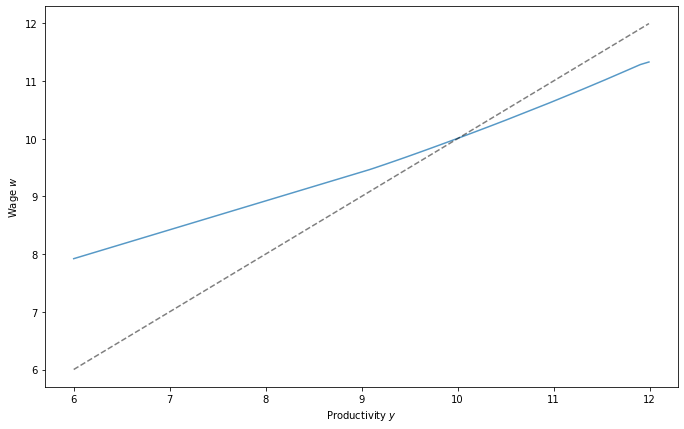

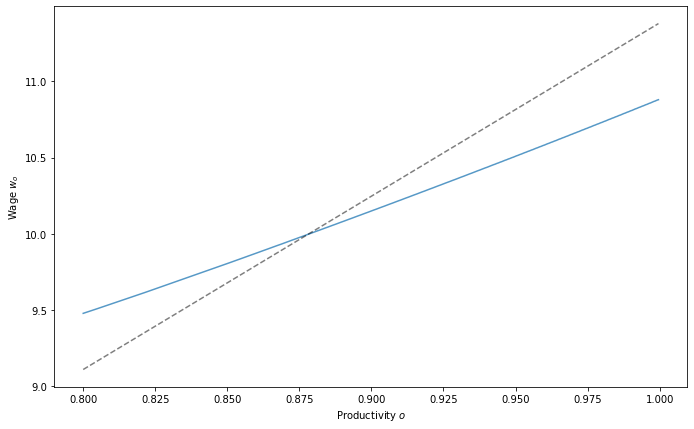

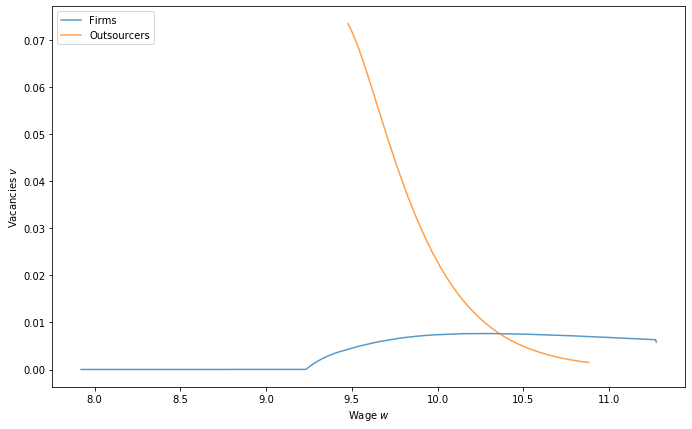

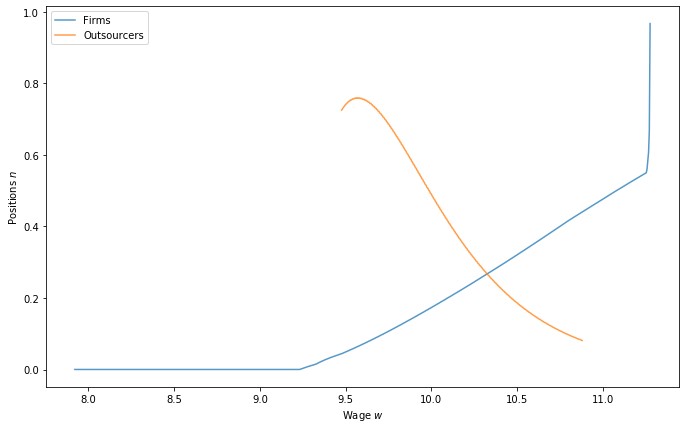

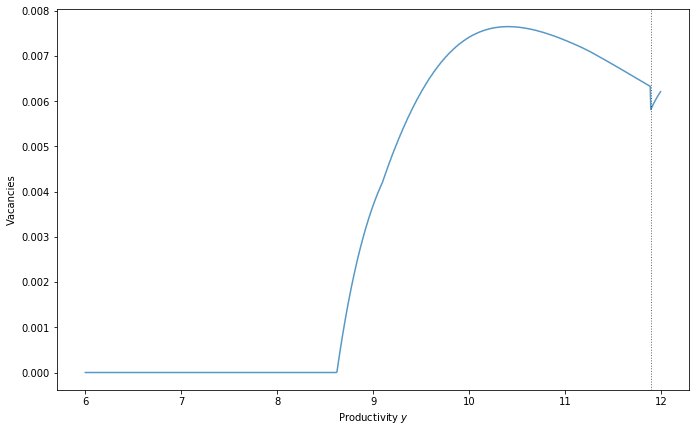

...

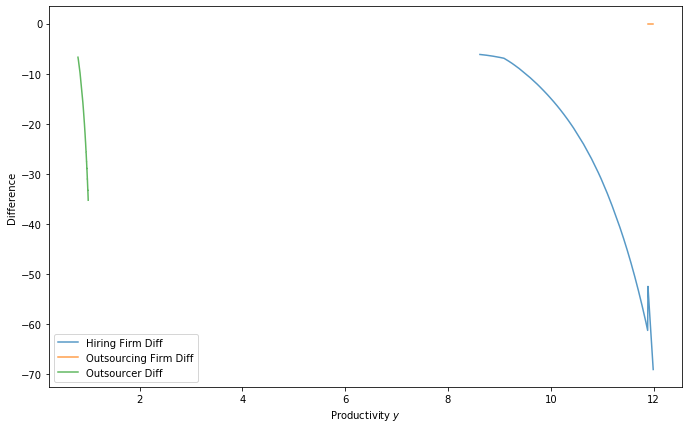

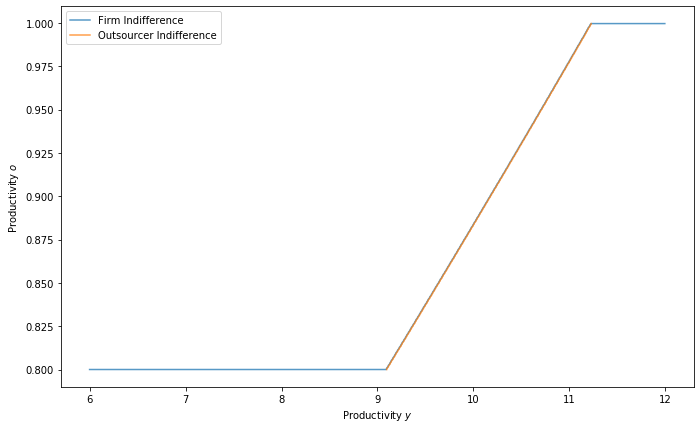

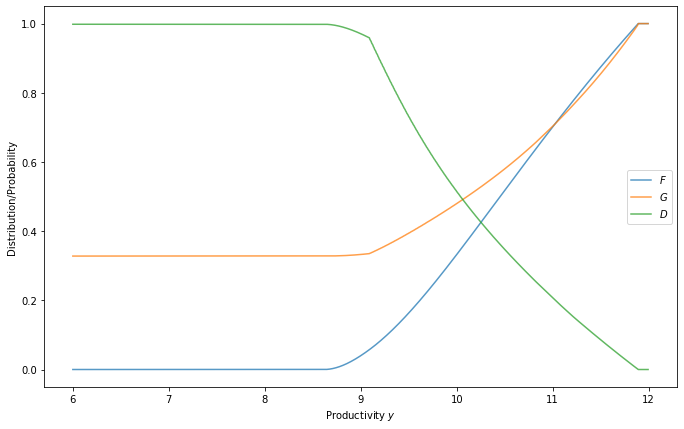

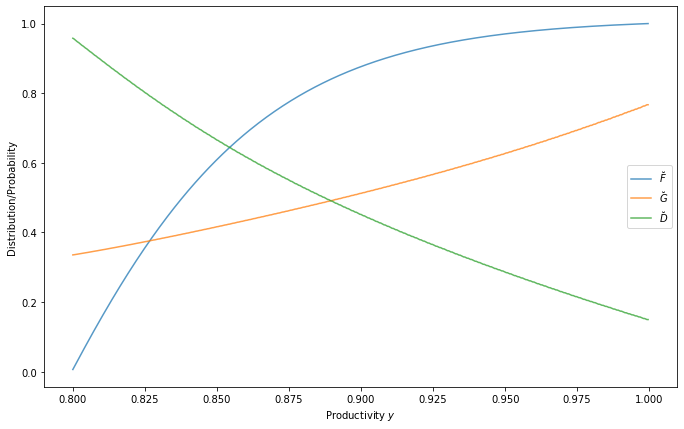

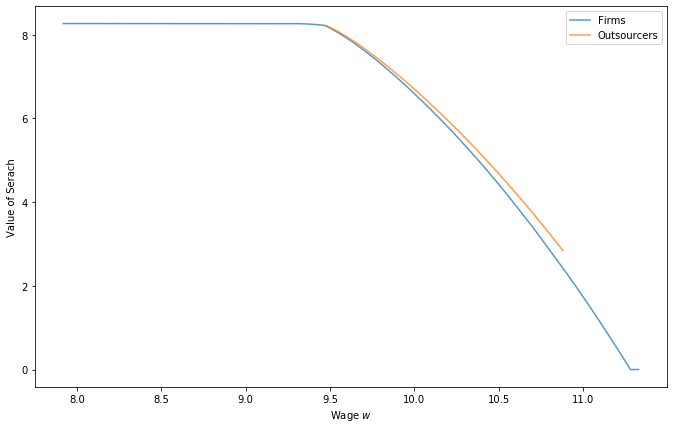

In [65]:
r = 0.000939
B = 1 / (1 + r)
delta = 0.0045
delta_o = 0.0050
delta_hat = 0.0040
xi = .1
# xi = 0
eta = 0.5
eta_o = 0.5
phi = 2e-1 
y_min = 6
y_max = 12
o_min = 0.8
o_max = 1.0
b = y_min * .4 
y_grid_size = 1000
# y_grid_size = 8000
o_grid_size = 500
gamma = 2
gamma_o = 2
k_grid = np.logspace(1, 4, y_grid_size, endpoint = False)
k_o_grid = np.logspace(1, 4, o_grid_size, endpoint = False)
# k_grid = 1e9
# k_o_grid = 1e9

p_low = 6
p_high = 12
tol = 1e-4
max_iter = 10
tol_i = 1e-4
max_iter_i = 5e4
slow_i = 1e-2
print_skip = 5
verbose = True

save = False

ooj = OutsourcingOnJob(
    B, b, delta, delta_o, delta_hat, xi, eta, eta_o, phi,
    y_min, y_max, y_grid_size, o_min, o_max, o_grid_size,
    gamma, gamma_o, k_grid, k_o_grid
)

v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, theta, p = find_p(
    ooj, p_low, p_high, tol, max_iter, tol_i, max_iter_i, slow_i, verbose, print_skip
)

list_facts(ooj, v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, theta, p)

graph_results(ooj, v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, theta, p,
             save=save)

error is 0.0331, went through 10000 iterations
y_hat is 982.0000, y_hat_new is 981.0000
The difference in theta and theta_new is 0.0210


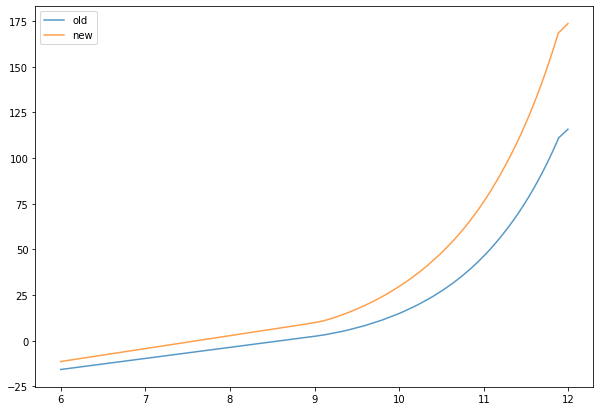

The indifferent firm is y_hat = 11.89$. Price of outsourcing is 11.38.
Unemployment is 5.41. According to LoM, should be 5.40
Workers match with probability 8.04. Firms/Outsourcers match with probability 49.77
Total vacancies searching for workers are 0.0231. Theta is 0.1615
30 percent of vacancies searching for workers are from outsourcers, 17 percent of postions outsourced
The ue rate is 0.08, the ee rate is 0.01,  and 37.600104 of new jobs are from unemployment
Checking if vacancies + LoM imply right positions:
 Hiring firms large error = 0.171625 at position 725 
 Outsourcing firms largest error = 0.000000 at position 0
 Outsourcer largest error = 3.216710 at position 37


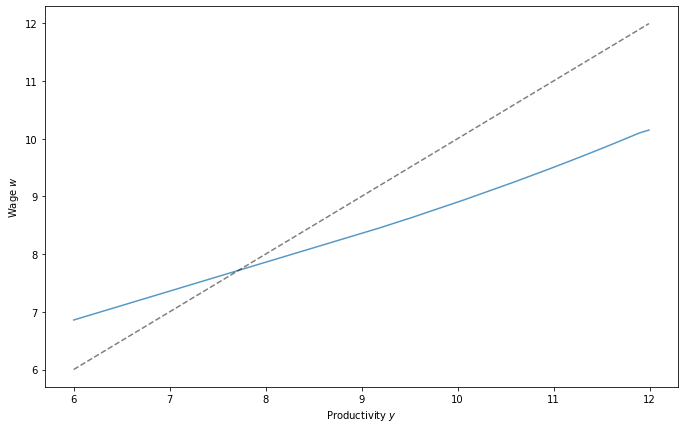

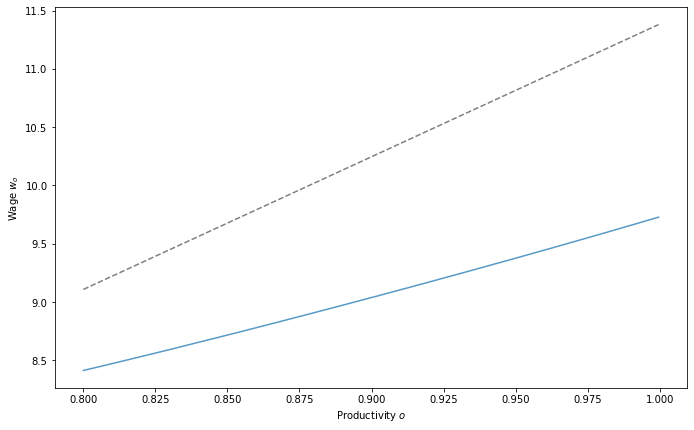

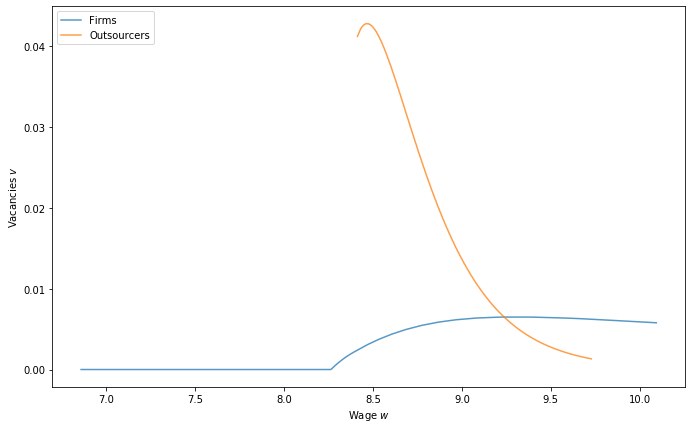

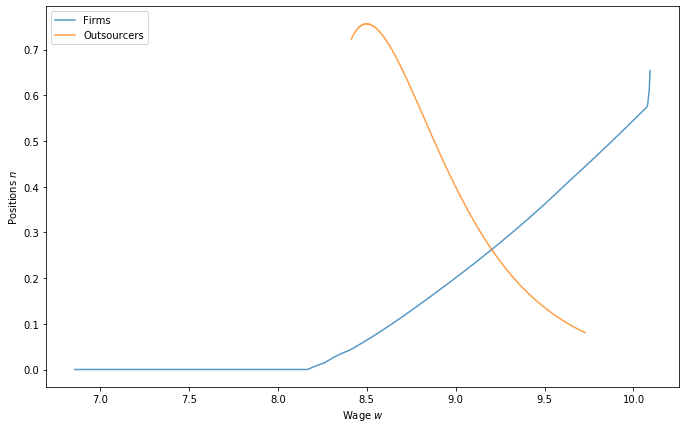

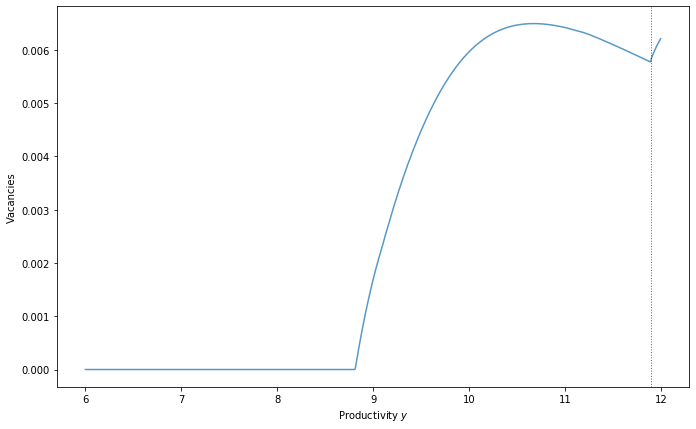

...

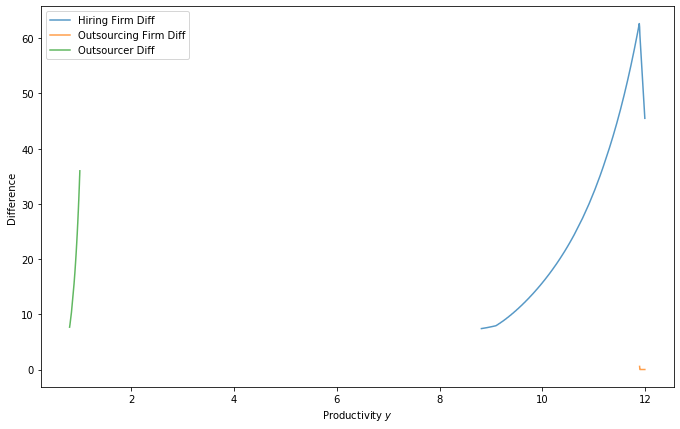

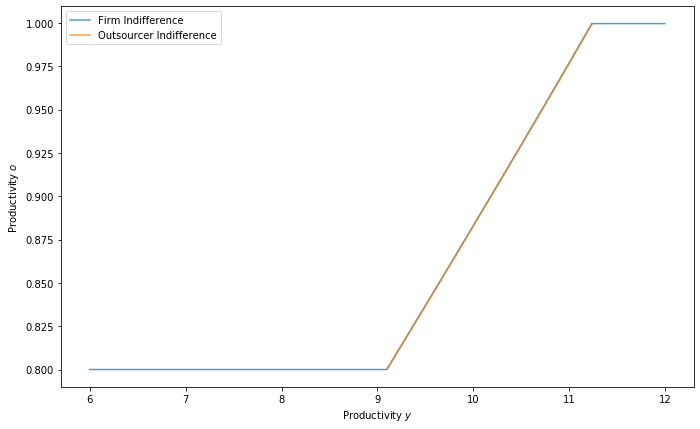

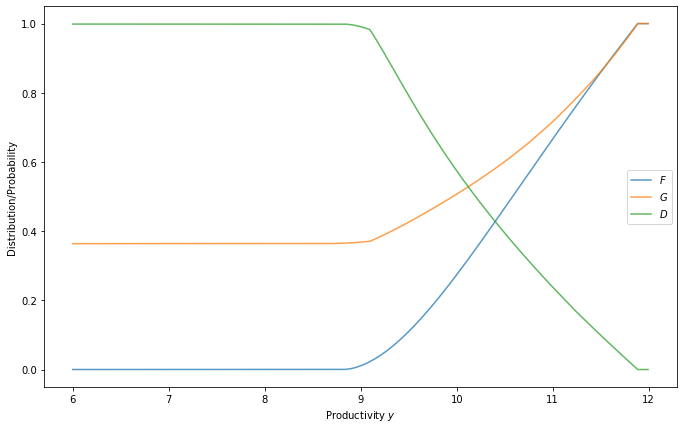

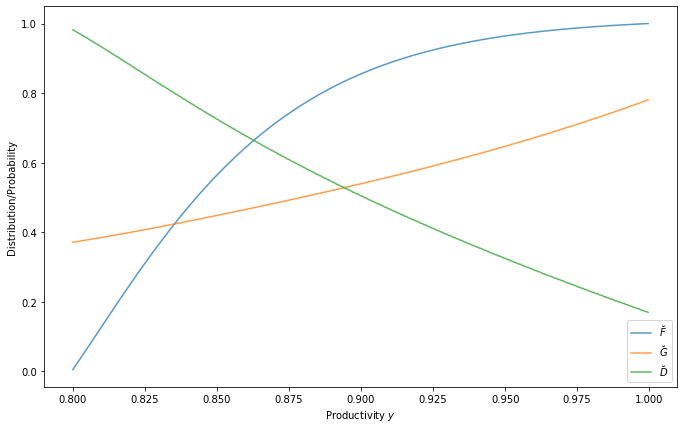

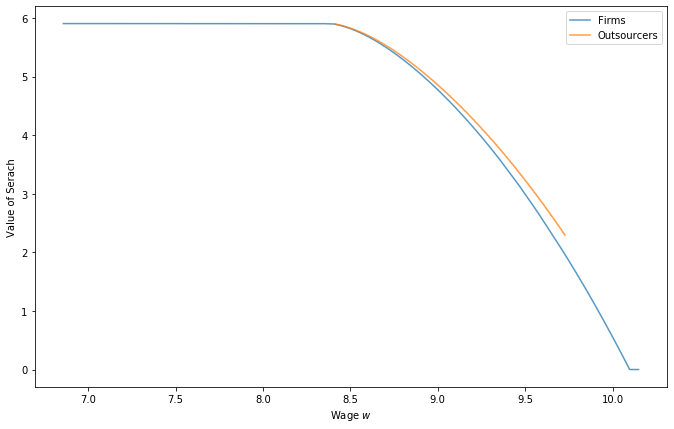

In [66]:
tol = 1e-4
max_iter = 1e4
slow = 1e-2
verbose = True

v_grid_new, v_o_grid_new, n_grid_new, n_o_grid_new, y_hat_new, R_grid_new, R_o_grid_new, theta_new = solve_given_p(
    ooj, p, v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, theta, tol, max_iter, slow, verbose
)

list_facts(ooj, v_grid_new, v_o_grid_new, n_grid_new, n_o_grid_new, y_hat_new, R_grid_new, R_o_grid_new, theta_new, p)

graph_results(ooj, v_grid_new, v_o_grid_new, n_grid_new, n_o_grid_new, y_hat_new, R_grid_new, R_o_grid_new, theta_new, p)

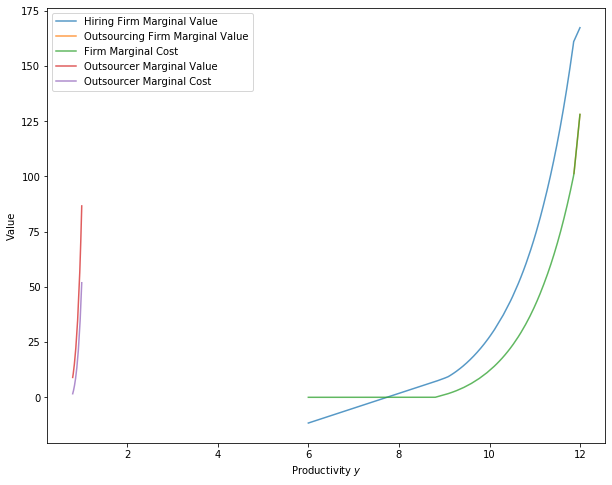

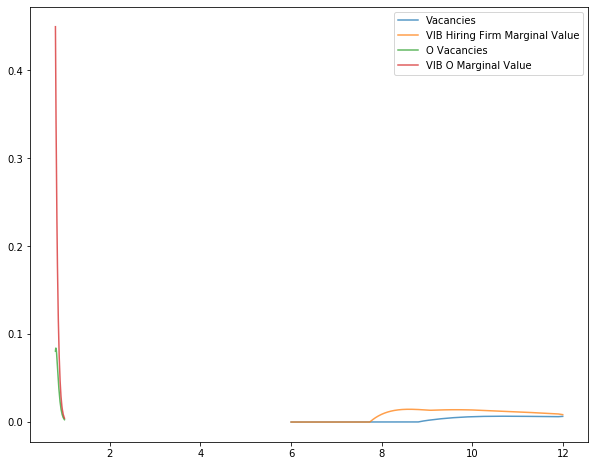

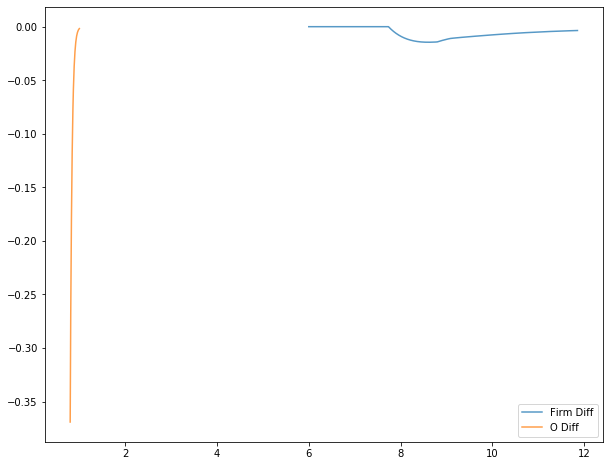

In [55]:
iterate, QD_QS, make_grids, C, c, c_inv, C_o, c_o, c_o_inv = operator_factory(ooj)

( G_grid, G_o_grid, D_grid, D_o_grid,
         Gamma_U, Gamma_grid, Gamma_o_grid, w_grid, w_o_grid) = make_grids(
            v_grid, v_o_grid, n_grid, n_o_grid, y_hat, R_grid, R_o_grid, theta, p)

# (G_grid, G_o_grid, D_grid, D_o_grid,
#          Gamma_U, Gamma_grid, Gamma_o_grid, w_grid, w_o_grid) = make_grids(
#             v_grid_new, v_o_grid_new, n_grid_new, n_o_grid_new, y_hat_new, R_grid_new, R_o_grid_new, theta_new, p)

q = ooj.q
y_grid, o_grid = ooj.y_grid, ooj.o_grid

J_hire = q(theta) * G_grid * (y_grid - w_grid) / (r + delta + (1 - delta) * D_grid)
J_out = (y_grid - p) / (r + delta_hat)
mc = c(v_grid)    

O = q(theta) * G_o_grid * (p * o_grid - w_o_grid) / (r + delta_o + (1 - delta_o) * D_o_grid)
mc_o = c_o(v_o_grid) 

fig, ax = plt.subplots(figsize=(10,8))
ax.plot(y_grid, J_hire, alpha=0.75, label="Hiring Firm Marginal Value")
ax.plot(y_grid[y_hat:], J_out[y_hat:], alpha=0.75, label="Outsourcing Firm Marginal Value")
ax.plot(y_grid, mc, alpha=0.75, label="Firm Marginal Cost")
ax.plot(o_grid, O, alpha=0.75, label="Outsourcer Marginal Value")
ax.plot(o_grid, mc_o, alpha=0.75, label="Outsourcer Marginal Cost")
ax.set(xlabel="Productivity $y$", ylabel="Value")
ax.legend(loc="best")

plt.show()

fig, ax = plt.subplots(figsize=(10,8))
ax.plot(y_grid, v_grid, alpha=0.75, label="Vacancies")
ax.plot(y_grid, c_inv(J_hire), alpha=0.75, label="VIB Hiring Firm Marginal Value")
ax.plot(o_grid, v_o_grid, alpha=0.75, label="O Vacancies")
ax.plot(o_grid, c_o_inv(O), alpha=0.75, label="VIB O Marginal Value")
ax.legend(loc="best")

plt.show()

fig, ax = plt.subplots(figsize=(10,8))
ax.plot(y_grid[:y_hat], v_grid[:y_hat] - c_inv(J_hire)[:y_hat], alpha=0.75, label="Firm Diff")
ax.plot(o_grid, v_o_grid - c_o_inv(O), alpha=0.75, label="O Diff")
ax.legend(loc="best")

plt.show()